In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'N1_3.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain]
x_val = xval
y_val = [yval,yval]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM, fx

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 890)      3186200     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 33)       29403       lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        68          dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/Desktop/New folder/model checkpoint/N1_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik},loss_weights=[0.5,0.5],optimizer= 'Adam')

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 11501200.00000, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00002: val_loss improved from 11501200.00000 to 9144879.00000, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00003: val_loss improved from 9144879.00000 to 8079184.00000, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00004: val_loss improved from 8079184.00000 to 7836356.00000, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00005: val_loss improved from 7836356.00000 to 7673494.00000, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00006: val_loss did not improve from 7673494.00000

Epoch 00007: val_loss did not improve from 7673494.00000

Epoch 00008: val_loss did not improve from 7673494.00000

E


Epoch 00103: val_loss did not improve from 2012721.50000

Epoch 00104: val_loss did not improve from 2012721.50000

Epoch 00105: val_loss did not improve from 2012721.50000

Epoch 00106: val_loss improved from 2012721.50000 to 1747519.62500, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00107: val_loss did not improve from 1747519.62500

Epoch 00108: val_loss did not improve from 1747519.62500

Epoch 00109: val_loss improved from 1747519.62500 to 1451811.75000, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00110: val_loss did not improve from 1451811.75000

Epoch 00111: val_loss did not improve from 1451811.75000

Epoch 00112: val_loss did not improve from 1451811.75000

Epoch 00113: val_loss did not improve from 1451811.75000

Epoch 00114: val_loss did not improve from 1451811.75000

Epoch 00115: val_loss improved from 1451811.75000 to 814887.81250, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\


Epoch 00224: val_loss improved from 215411.70312 to 215101.67188, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00225: val_loss did not improve from 215101.67188

Epoch 00226: val_loss did not improve from 215101.67188

Epoch 00227: val_loss did not improve from 215101.67188

Epoch 00228: val_loss did not improve from 215101.67188

Epoch 00229: val_loss did not improve from 215101.67188

Epoch 00230: val_loss did not improve from 215101.67188

Epoch 00231: val_loss did not improve from 215101.67188

Epoch 00232: val_loss did not improve from 215101.67188

Epoch 00233: val_loss did not improve from 215101.67188

Epoch 00234: val_loss did not improve from 215101.67188

Epoch 00235: val_loss did not improve from 215101.67188

Epoch 00236: val_loss did not improve from 215101.67188

Epoch 00237: val_loss did not improve from 215101.67188

Epoch 00238: val_loss did not improve from 215101.67188

Epoch 00239: val_loss did not improve from 215101.67188

Epo


Epoch 00352: val_loss did not improve from 179750.67188

Epoch 00353: val_loss did not improve from 179750.67188

Epoch 00354: val_loss did not improve from 179750.67188

Epoch 00355: val_loss did not improve from 179750.67188

Epoch 00356: val_loss did not improve from 179750.67188

Epoch 00357: val_loss did not improve from 179750.67188

Epoch 00358: val_loss did not improve from 179750.67188

Epoch 00359: val_loss did not improve from 179750.67188

Epoch 00360: val_loss did not improve from 179750.67188

Epoch 00361: val_loss did not improve from 179750.67188

Epoch 00362: val_loss did not improve from 179750.67188

Epoch 00363: val_loss did not improve from 179750.67188

Epoch 00364: val_loss did not improve from 179750.67188

Epoch 00365: val_loss did not improve from 179750.67188

Epoch 00366: val_loss did not improve from 179750.67188

Epoch 00367: val_loss did not improve from 179750.67188

Epoch 00368: val_loss did not improve from 179750.67188

Epoch 00369: val_loss did not 


Epoch 00476: val_loss did not improve from 135893.84375

Epoch 00477: val_loss did not improve from 135893.84375

Epoch 00478: val_loss did not improve from 135893.84375

Epoch 00479: val_loss improved from 135893.84375 to 134056.75000, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00480: val_loss did not improve from 134056.75000

Epoch 00481: val_loss did not improve from 134056.75000

Epoch 00482: val_loss improved from 134056.75000 to 133841.96875, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00483: val_loss did not improve from 133841.96875

Epoch 00484: val_loss did not improve from 133841.96875

Epoch 00485: val_loss did not improve from 133841.96875

Epoch 00486: val_loss did not improve from 133841.96875

Epoch 00487: val_loss did not improve from 133841.96875

Epoch 00488: val_loss did not improve from 133841.96875

Epoch 00489: val_loss did not improve from 133841.96875

Epoch 00490: val_loss did not imp


Epoch 00601: val_loss did not improve from 106755.61719

Epoch 00602: val_loss did not improve from 106755.61719

Epoch 00603: val_loss did not improve from 106755.61719

Epoch 00604: val_loss did not improve from 106755.61719

Epoch 00605: val_loss did not improve from 106755.61719

Epoch 00606: val_loss did not improve from 106755.61719

Epoch 00607: val_loss did not improve from 106755.61719

Epoch 00608: val_loss did not improve from 106755.61719

Epoch 00609: val_loss did not improve from 106755.61719

Epoch 00610: val_loss did not improve from 106755.61719

Epoch 00611: val_loss did not improve from 106755.61719

Epoch 00612: val_loss did not improve from 106755.61719

Epoch 00613: val_loss did not improve from 106755.61719

Epoch 00614: val_loss did not improve from 106755.61719

Epoch 00615: val_loss did not improve from 106755.61719

Epoch 00616: val_loss did not improve from 106755.61719

Epoch 00617: val_loss did not improve from 106755.61719

Epoch 00618: val_loss did not 


Epoch 00728: val_loss did not improve from 78227.89062

Epoch 00729: val_loss did not improve from 78227.89062

Epoch 00730: val_loss did not improve from 78227.89062

Epoch 00731: val_loss did not improve from 78227.89062

Epoch 00732: val_loss did not improve from 78227.89062

Epoch 00733: val_loss did not improve from 78227.89062

Epoch 00734: val_loss did not improve from 78227.89062

Epoch 00735: val_loss did not improve from 78227.89062

Epoch 00736: val_loss did not improve from 78227.89062

Epoch 00737: val_loss did not improve from 78227.89062

Epoch 00738: val_loss did not improve from 78227.89062

Epoch 00739: val_loss did not improve from 78227.89062

Epoch 00740: val_loss improved from 78227.89062 to 75383.04688, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 00741: val_loss did not improve from 75383.04688

Epoch 00742: val_loss did not improve from 75383.04688

Epoch 00743: val_loss did not improve from 75383.04688

Epoch 00744: val_los


Epoch 00861: val_loss did not improve from 53120.18359

Epoch 00862: val_loss did not improve from 53120.18359

Epoch 00863: val_loss did not improve from 53120.18359

Epoch 00864: val_loss did not improve from 53120.18359

Epoch 00865: val_loss did not improve from 53120.18359

Epoch 00866: val_loss did not improve from 53120.18359

Epoch 00867: val_loss did not improve from 53120.18359

Epoch 00868: val_loss did not improve from 53120.18359

Epoch 00869: val_loss did not improve from 53120.18359

Epoch 00870: val_loss did not improve from 53120.18359

Epoch 00871: val_loss did not improve from 53120.18359

Epoch 00872: val_loss did not improve from 53120.18359

Epoch 00873: val_loss did not improve from 53120.18359

Epoch 00874: val_loss did not improve from 53120.18359

Epoch 00875: val_loss did not improve from 53120.18359

Epoch 00876: val_loss did not improve from 53120.18359

Epoch 00877: val_loss did not improve from 53120.18359

Epoch 00878: val_loss did not improve from 5312


Epoch 00989: val_loss did not improve from 33426.23828

Epoch 00990: val_loss did not improve from 33426.23828

Epoch 00991: val_loss did not improve from 33426.23828

Epoch 00992: val_loss did not improve from 33426.23828

Epoch 00993: val_loss did not improve from 33426.23828

Epoch 00994: val_loss did not improve from 33426.23828

Epoch 00995: val_loss did not improve from 33426.23828

Epoch 00996: val_loss did not improve from 33426.23828

Epoch 00997: val_loss did not improve from 33426.23828

Epoch 00998: val_loss did not improve from 33426.23828

Epoch 00999: val_loss improved from 33426.23828 to 31307.00586, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 01000: val_loss did not improve from 31307.00586

Epoch 01001: val_loss did not improve from 31307.00586

Epoch 01002: val_loss did not improve from 31307.00586

Epoch 01003: val_loss did not improve from 31307.00586

Epoch 01004: val_loss did not improve from 31307.00586

Epoch 01005: val_los


Epoch 01112: val_loss did not improve from 15488.37305

Epoch 01113: val_loss did not improve from 15488.37305

Epoch 01114: val_loss did not improve from 15488.37305

Epoch 01115: val_loss did not improve from 15488.37305

Epoch 01116: val_loss did not improve from 15488.37305

Epoch 01117: val_loss did not improve from 15488.37305

Epoch 01118: val_loss did not improve from 15488.37305

Epoch 01119: val_loss did not improve from 15488.37305

Epoch 01120: val_loss did not improve from 15488.37305

Epoch 01121: val_loss did not improve from 15488.37305

Epoch 01122: val_loss did not improve from 15488.37305

Epoch 01123: val_loss did not improve from 15488.37305

Epoch 01124: val_loss did not improve from 15488.37305

Epoch 01125: val_loss did not improve from 15488.37305

Epoch 01126: val_loss improved from 15488.37305 to 13065.59180, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 01127: val_loss did not improve from 13065.59180

Epoch 01128: val_los


Epoch 01248: val_loss did not improve from 2811.92798

Epoch 01249: val_loss did not improve from 2811.92798

Epoch 01250: val_loss did not improve from 2811.92798

Epoch 01251: val_loss did not improve from 2811.92798

Epoch 01252: val_loss did not improve from 2811.92798

Epoch 01253: val_loss improved from 2811.92798 to 2370.39453, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 01254: val_loss did not improve from 2370.39453

Epoch 01255: val_loss did not improve from 2370.39453

Epoch 01256: val_loss did not improve from 2370.39453

Epoch 01257: val_loss did not improve from 2370.39453

Epoch 01258: val_loss did not improve from 2370.39453

Epoch 01259: val_loss did not improve from 2370.39453

Epoch 01260: val_loss did not improve from 2370.39453

Epoch 01261: val_loss did not improve from 2370.39453

Epoch 01262: val_loss did not improve from 2370.39453

Epoch 01263: val_loss did not improve from 2370.39453

Epoch 01264: val_loss did not improve


Epoch 01391: val_loss did not improve from 899.76910

Epoch 01392: val_loss did not improve from 899.76910

Epoch 01393: val_loss did not improve from 899.76910

Epoch 01394: val_loss did not improve from 899.76910

Epoch 01395: val_loss did not improve from 899.76910

Epoch 01396: val_loss did not improve from 899.76910

Epoch 01397: val_loss did not improve from 899.76910

Epoch 01398: val_loss did not improve from 899.76910

Epoch 01399: val_loss did not improve from 899.76910

Epoch 01400: val_loss did not improve from 899.76910

Epoch 01401: val_loss did not improve from 899.76910

Epoch 01402: val_loss did not improve from 899.76910

Epoch 01403: val_loss did not improve from 899.76910

Epoch 01404: val_loss did not improve from 899.76910

Epoch 01405: val_loss did not improve from 899.76910

Epoch 01406: val_loss did not improve from 899.76910

Epoch 01407: val_loss did not improve from 899.76910

Epoch 01408: val_loss did not improve from 899.76910

Epoch 01409: val_loss did n


Epoch 01543: val_loss did not improve from 899.76910

Epoch 01544: val_loss did not improve from 899.76910

Epoch 01545: val_loss did not improve from 899.76910

Epoch 01546: val_loss did not improve from 899.76910

Epoch 01547: val_loss did not improve from 899.76910

Epoch 01548: val_loss did not improve from 899.76910

Epoch 01549: val_loss did not improve from 899.76910

Epoch 01550: val_loss did not improve from 899.76910

Epoch 01551: val_loss did not improve from 899.76910

Epoch 01552: val_loss did not improve from 899.76910

Epoch 01553: val_loss did not improve from 899.76910

Epoch 01554: val_loss did not improve from 899.76910

Epoch 01555: val_loss did not improve from 899.76910

Epoch 01556: val_loss did not improve from 899.76910

Epoch 01557: val_loss did not improve from 899.76910

Epoch 01558: val_loss did not improve from 899.76910

Epoch 01559: val_loss did not improve from 899.76910

Epoch 01560: val_loss did not improve from 899.76910

Epoch 01561: val_loss did n


Epoch 01695: val_loss did not improve from 899.76910

Epoch 01696: val_loss did not improve from 899.76910

Epoch 01697: val_loss did not improve from 899.76910

Epoch 01698: val_loss did not improve from 899.76910

Epoch 01699: val_loss did not improve from 899.76910

Epoch 01700: val_loss did not improve from 899.76910

Epoch 01701: val_loss did not improve from 899.76910

Epoch 01702: val_loss did not improve from 899.76910

Epoch 01703: val_loss did not improve from 899.76910

Epoch 01704: val_loss did not improve from 899.76910

Epoch 01705: val_loss did not improve from 899.76910

Epoch 01706: val_loss did not improve from 899.76910

Epoch 01707: val_loss did not improve from 899.76910

Epoch 01708: val_loss did not improve from 899.76910

Epoch 01709: val_loss did not improve from 899.76910

Epoch 01710: val_loss did not improve from 899.76910

Epoch 01711: val_loss did not improve from 899.76910

Epoch 01712: val_loss did not improve from 899.76910

Epoch 01713: val_loss did n


Epoch 01847: val_loss did not improve from 899.76910

Epoch 01848: val_loss did not improve from 899.76910

Epoch 01849: val_loss did not improve from 899.76910

Epoch 01850: val_loss did not improve from 899.76910

Epoch 01851: val_loss did not improve from 899.76910

Epoch 01852: val_loss did not improve from 899.76910

Epoch 01853: val_loss did not improve from 899.76910

Epoch 01854: val_loss did not improve from 899.76910

Epoch 01855: val_loss did not improve from 899.76910

Epoch 01856: val_loss did not improve from 899.76910

Epoch 01857: val_loss did not improve from 899.76910

Epoch 01858: val_loss did not improve from 899.76910

Epoch 01859: val_loss did not improve from 899.76910

Epoch 01860: val_loss did not improve from 899.76910

Epoch 01861: val_loss did not improve from 899.76910

Epoch 01862: val_loss did not improve from 899.76910

Epoch 01863: val_loss did not improve from 899.76910

Epoch 01864: val_loss did not improve from 899.76910

Epoch 01865: val_loss did n


Epoch 01999: val_loss did not improve from 899.76910

Epoch 02000: val_loss did not improve from 899.76910

Epoch 02001: val_loss did not improve from 899.76910

Epoch 02002: val_loss did not improve from 899.76910

Epoch 02003: val_loss did not improve from 899.76910

Epoch 02004: val_loss did not improve from 899.76910

Epoch 02005: val_loss did not improve from 899.76910

Epoch 02006: val_loss did not improve from 899.76910

Epoch 02007: val_loss did not improve from 899.76910

Epoch 02008: val_loss did not improve from 899.76910

Epoch 02009: val_loss did not improve from 899.76910

Epoch 02010: val_loss did not improve from 899.76910

Epoch 02011: val_loss did not improve from 899.76910

Epoch 02012: val_loss did not improve from 899.76910

Epoch 02013: val_loss did not improve from 899.76910

Epoch 02014: val_loss did not improve from 899.76910

Epoch 02015: val_loss did not improve from 899.76910

Epoch 02016: val_loss did not improve from 899.76910

Epoch 02017: val_loss did n


Epoch 02151: val_loss did not improve from 899.76910

Epoch 02152: val_loss did not improve from 899.76910

Epoch 02153: val_loss did not improve from 899.76910

Epoch 02154: val_loss did not improve from 899.76910

Epoch 02155: val_loss did not improve from 899.76910

Epoch 02156: val_loss did not improve from 899.76910

Epoch 02157: val_loss did not improve from 899.76910

Epoch 02158: val_loss did not improve from 899.76910

Epoch 02159: val_loss did not improve from 899.76910

Epoch 02160: val_loss did not improve from 899.76910

Epoch 02161: val_loss did not improve from 899.76910

Epoch 02162: val_loss did not improve from 899.76910

Epoch 02163: val_loss did not improve from 899.76910

Epoch 02164: val_loss did not improve from 899.76910

Epoch 02165: val_loss did not improve from 899.76910

Epoch 02166: val_loss did not improve from 899.76910

Epoch 02167: val_loss did not improve from 899.76910

Epoch 02168: val_loss did not improve from 899.76910

Epoch 02169: val_loss did n


Epoch 02303: val_loss did not improve from 899.76910

Epoch 02304: val_loss did not improve from 899.76910

Epoch 02305: val_loss did not improve from 899.76910

Epoch 02306: val_loss did not improve from 899.76910

Epoch 02307: val_loss did not improve from 899.76910

Epoch 02308: val_loss did not improve from 899.76910

Epoch 02309: val_loss did not improve from 899.76910

Epoch 02310: val_loss did not improve from 899.76910

Epoch 02311: val_loss did not improve from 899.76910

Epoch 02312: val_loss did not improve from 899.76910

Epoch 02313: val_loss did not improve from 899.76910

Epoch 02314: val_loss did not improve from 899.76910

Epoch 02315: val_loss did not improve from 899.76910

Epoch 02316: val_loss did not improve from 899.76910

Epoch 02317: val_loss did not improve from 899.76910

Epoch 02318: val_loss did not improve from 899.76910

Epoch 02319: val_loss did not improve from 899.76910

Epoch 02320: val_loss did not improve from 899.76910

Epoch 02321: val_loss did n


Epoch 02455: val_loss did not improve from 899.76910

Epoch 02456: val_loss did not improve from 899.76910

Epoch 02457: val_loss did not improve from 899.76910

Epoch 02458: val_loss did not improve from 899.76910

Epoch 02459: val_loss did not improve from 899.76910

Epoch 02460: val_loss did not improve from 899.76910

Epoch 02461: val_loss did not improve from 899.76910

Epoch 02462: val_loss did not improve from 899.76910

Epoch 02463: val_loss did not improve from 899.76910

Epoch 02464: val_loss did not improve from 899.76910

Epoch 02465: val_loss did not improve from 899.76910

Epoch 02466: val_loss did not improve from 899.76910

Epoch 02467: val_loss did not improve from 899.76910

Epoch 02468: val_loss did not improve from 899.76910

Epoch 02469: val_loss did not improve from 899.76910

Epoch 02470: val_loss did not improve from 899.76910

Epoch 02471: val_loss did not improve from 899.76910

Epoch 02472: val_loss did not improve from 899.76910

Epoch 02473: val_loss did n


Epoch 02607: val_loss did not improve from 899.76910

Epoch 02608: val_loss did not improve from 899.76910

Epoch 02609: val_loss did not improve from 899.76910

Epoch 02610: val_loss did not improve from 899.76910

Epoch 02611: val_loss did not improve from 899.76910

Epoch 02612: val_loss did not improve from 899.76910

Epoch 02613: val_loss did not improve from 899.76910

Epoch 02614: val_loss did not improve from 899.76910

Epoch 02615: val_loss did not improve from 899.76910

Epoch 02616: val_loss did not improve from 899.76910

Epoch 02617: val_loss did not improve from 899.76910

Epoch 02618: val_loss did not improve from 899.76910

Epoch 02619: val_loss did not improve from 899.76910

Epoch 02620: val_loss did not improve from 899.76910

Epoch 02621: val_loss did not improve from 899.76910

Epoch 02622: val_loss did not improve from 899.76910

Epoch 02623: val_loss did not improve from 899.76910

Epoch 02624: val_loss did not improve from 899.76910

Epoch 02625: val_loss did n


Epoch 02759: val_loss did not improve from 899.76910

Epoch 02760: val_loss did not improve from 899.76910

Epoch 02761: val_loss did not improve from 899.76910

Epoch 02762: val_loss did not improve from 899.76910

Epoch 02763: val_loss did not improve from 899.76910

Epoch 02764: val_loss did not improve from 899.76910

Epoch 02765: val_loss did not improve from 899.76910

Epoch 02766: val_loss did not improve from 899.76910

Epoch 02767: val_loss did not improve from 899.76910

Epoch 02768: val_loss did not improve from 899.76910

Epoch 02769: val_loss did not improve from 899.76910

Epoch 02770: val_loss did not improve from 899.76910

Epoch 02771: val_loss did not improve from 899.76910

Epoch 02772: val_loss did not improve from 899.76910

Epoch 02773: val_loss did not improve from 899.76910

Epoch 02774: val_loss did not improve from 899.76910

Epoch 02775: val_loss did not improve from 899.76910

Epoch 02776: val_loss did not improve from 899.76910

Epoch 02777: val_loss did n


Epoch 02911: val_loss did not improve from 899.76910

Epoch 02912: val_loss did not improve from 899.76910

Epoch 02913: val_loss did not improve from 899.76910

Epoch 02914: val_loss did not improve from 899.76910

Epoch 02915: val_loss did not improve from 899.76910

Epoch 02916: val_loss did not improve from 899.76910

Epoch 02917: val_loss did not improve from 899.76910

Epoch 02918: val_loss did not improve from 899.76910

Epoch 02919: val_loss did not improve from 899.76910

Epoch 02920: val_loss did not improve from 899.76910

Epoch 02921: val_loss did not improve from 899.76910

Epoch 02922: val_loss did not improve from 899.76910

Epoch 02923: val_loss did not improve from 899.76910

Epoch 02924: val_loss did not improve from 899.76910

Epoch 02925: val_loss did not improve from 899.76910

Epoch 02926: val_loss did not improve from 899.76910

Epoch 02927: val_loss did not improve from 899.76910

Epoch 02928: val_loss did not improve from 899.76910

Epoch 02929: val_loss did n


Epoch 03063: val_loss did not improve from 899.76910

Epoch 03064: val_loss did not improve from 899.76910

Epoch 03065: val_loss did not improve from 899.76910

Epoch 03066: val_loss did not improve from 899.76910

Epoch 03067: val_loss did not improve from 899.76910

Epoch 03068: val_loss did not improve from 899.76910

Epoch 03069: val_loss did not improve from 899.76910

Epoch 03070: val_loss did not improve from 899.76910

Epoch 03071: val_loss did not improve from 899.76910

Epoch 03072: val_loss did not improve from 899.76910

Epoch 03073: val_loss did not improve from 899.76910

Epoch 03074: val_loss did not improve from 899.76910

Epoch 03075: val_loss did not improve from 899.76910

Epoch 03076: val_loss did not improve from 899.76910

Epoch 03077: val_loss did not improve from 899.76910

Epoch 03078: val_loss did not improve from 899.76910

Epoch 03079: val_loss did not improve from 899.76910

Epoch 03080: val_loss did not improve from 899.76910

Epoch 03081: val_loss did n


Epoch 03215: val_loss did not improve from 899.76910

Epoch 03216: val_loss did not improve from 899.76910

Epoch 03217: val_loss did not improve from 899.76910

Epoch 03218: val_loss did not improve from 899.76910

Epoch 03219: val_loss did not improve from 899.76910

Epoch 03220: val_loss did not improve from 899.76910

Epoch 03221: val_loss did not improve from 899.76910

Epoch 03222: val_loss did not improve from 899.76910

Epoch 03223: val_loss did not improve from 899.76910

Epoch 03224: val_loss did not improve from 899.76910

Epoch 03225: val_loss did not improve from 899.76910

Epoch 03226: val_loss did not improve from 899.76910

Epoch 03227: val_loss did not improve from 899.76910

Epoch 03228: val_loss did not improve from 899.76910

Epoch 03229: val_loss did not improve from 899.76910

Epoch 03230: val_loss did not improve from 899.76910

Epoch 03231: val_loss did not improve from 899.76910

Epoch 03232: val_loss did not improve from 899.76910

Epoch 03233: val_loss did n


Epoch 03367: val_loss did not improve from 899.76910

Epoch 03368: val_loss did not improve from 899.76910

Epoch 03369: val_loss did not improve from 899.76910

Epoch 03370: val_loss did not improve from 899.76910

Epoch 03371: val_loss did not improve from 899.76910

Epoch 03372: val_loss did not improve from 899.76910

Epoch 03373: val_loss did not improve from 899.76910

Epoch 03374: val_loss did not improve from 899.76910

Epoch 03375: val_loss did not improve from 899.76910

Epoch 03376: val_loss did not improve from 899.76910

Epoch 03377: val_loss did not improve from 899.76910

Epoch 03378: val_loss did not improve from 899.76910

Epoch 03379: val_loss did not improve from 899.76910

Epoch 03380: val_loss did not improve from 899.76910

Epoch 03381: val_loss did not improve from 899.76910

Epoch 03382: val_loss did not improve from 899.76910

Epoch 03383: val_loss did not improve from 899.76910

Epoch 03384: val_loss did not improve from 899.76910

Epoch 03385: val_loss did n


Epoch 03519: val_loss did not improve from 899.76910

Epoch 03520: val_loss did not improve from 899.76910

Epoch 03521: val_loss did not improve from 899.76910

Epoch 03522: val_loss did not improve from 899.76910

Epoch 03523: val_loss did not improve from 899.76910

Epoch 03524: val_loss did not improve from 899.76910

Epoch 03525: val_loss did not improve from 899.76910

Epoch 03526: val_loss did not improve from 899.76910

Epoch 03527: val_loss did not improve from 899.76910

Epoch 03528: val_loss did not improve from 899.76910

Epoch 03529: val_loss did not improve from 899.76910

Epoch 03530: val_loss did not improve from 899.76910

Epoch 03531: val_loss did not improve from 899.76910

Epoch 03532: val_loss did not improve from 899.76910

Epoch 03533: val_loss did not improve from 899.76910

Epoch 03534: val_loss did not improve from 899.76910

Epoch 03535: val_loss did not improve from 899.76910

Epoch 03536: val_loss did not improve from 899.76910

Epoch 03537: val_loss did n


Epoch 03671: val_loss did not improve from 899.76910

Epoch 03672: val_loss did not improve from 899.76910

Epoch 03673: val_loss did not improve from 899.76910

Epoch 03674: val_loss did not improve from 899.76910

Epoch 03675: val_loss did not improve from 899.76910

Epoch 03676: val_loss did not improve from 899.76910

Epoch 03677: val_loss did not improve from 899.76910

Epoch 03678: val_loss did not improve from 899.76910

Epoch 03679: val_loss did not improve from 899.76910

Epoch 03680: val_loss did not improve from 899.76910

Epoch 03681: val_loss did not improve from 899.76910

Epoch 03682: val_loss did not improve from 899.76910

Epoch 03683: val_loss did not improve from 899.76910

Epoch 03684: val_loss did not improve from 899.76910

Epoch 03685: val_loss did not improve from 899.76910

Epoch 03686: val_loss did not improve from 899.76910

Epoch 03687: val_loss did not improve from 899.76910

Epoch 03688: val_loss did not improve from 899.76910

Epoch 03689: val_loss did n


Epoch 03823: val_loss did not improve from 899.76910

Epoch 03824: val_loss did not improve from 899.76910

Epoch 03825: val_loss did not improve from 899.76910

Epoch 03826: val_loss did not improve from 899.76910

Epoch 03827: val_loss did not improve from 899.76910

Epoch 03828: val_loss did not improve from 899.76910

Epoch 03829: val_loss did not improve from 899.76910

Epoch 03830: val_loss did not improve from 899.76910

Epoch 03831: val_loss did not improve from 899.76910

Epoch 03832: val_loss did not improve from 899.76910

Epoch 03833: val_loss did not improve from 899.76910

Epoch 03834: val_loss did not improve from 899.76910

Epoch 03835: val_loss did not improve from 899.76910

Epoch 03836: val_loss did not improve from 899.76910

Epoch 03837: val_loss did not improve from 899.76910

Epoch 03838: val_loss did not improve from 899.76910

Epoch 03839: val_loss did not improve from 899.76910

Epoch 03840: val_loss did not improve from 899.76910

Epoch 03841: val_loss did n


Epoch 03975: val_loss did not improve from 899.76910

Epoch 03976: val_loss did not improve from 899.76910

Epoch 03977: val_loss did not improve from 899.76910

Epoch 03978: val_loss did not improve from 899.76910

Epoch 03979: val_loss did not improve from 899.76910

Epoch 03980: val_loss did not improve from 899.76910

Epoch 03981: val_loss did not improve from 899.76910

Epoch 03982: val_loss did not improve from 899.76910

Epoch 03983: val_loss did not improve from 899.76910

Epoch 03984: val_loss did not improve from 899.76910

Epoch 03985: val_loss did not improve from 899.76910

Epoch 03986: val_loss did not improve from 899.76910

Epoch 03987: val_loss did not improve from 899.76910

Epoch 03988: val_loss did not improve from 899.76910

Epoch 03989: val_loss did not improve from 899.76910

Epoch 03990: val_loss did not improve from 899.76910

Epoch 03991: val_loss did not improve from 899.76910

Epoch 03992: val_loss did not improve from 899.76910

Epoch 03993: val_loss did n


Epoch 04127: val_loss did not improve from 899.76910

Epoch 04128: val_loss did not improve from 899.76910

Epoch 04129: val_loss did not improve from 899.76910

Epoch 04130: val_loss did not improve from 899.76910

Epoch 04131: val_loss did not improve from 899.76910

Epoch 04132: val_loss did not improve from 899.76910

Epoch 04133: val_loss did not improve from 899.76910

Epoch 04134: val_loss did not improve from 899.76910

Epoch 04135: val_loss did not improve from 899.76910

Epoch 04136: val_loss did not improve from 899.76910

Epoch 04137: val_loss did not improve from 899.76910

Epoch 04138: val_loss did not improve from 899.76910

Epoch 04139: val_loss did not improve from 899.76910

Epoch 04140: val_loss did not improve from 899.76910

Epoch 04141: val_loss did not improve from 899.76910

Epoch 04142: val_loss did not improve from 899.76910

Epoch 04143: val_loss did not improve from 899.76910

Epoch 04144: val_loss did not improve from 899.76910

Epoch 04145: val_loss did n


Epoch 04279: val_loss did not improve from 899.76910

Epoch 04280: val_loss did not improve from 899.76910

Epoch 04281: val_loss did not improve from 899.76910

Epoch 04282: val_loss did not improve from 899.76910

Epoch 04283: val_loss did not improve from 899.76910

Epoch 04284: val_loss did not improve from 899.76910

Epoch 04285: val_loss did not improve from 899.76910

Epoch 04286: val_loss did not improve from 899.76910

Epoch 04287: val_loss did not improve from 899.76910

Epoch 04288: val_loss did not improve from 899.76910

Epoch 04289: val_loss did not improve from 899.76910

Epoch 04290: val_loss did not improve from 899.76910

Epoch 04291: val_loss did not improve from 899.76910

Epoch 04292: val_loss did not improve from 899.76910

Epoch 04293: val_loss did not improve from 899.76910

Epoch 04294: val_loss did not improve from 899.76910

Epoch 04295: val_loss did not improve from 899.76910

Epoch 04296: val_loss did not improve from 899.76910

Epoch 04297: val_loss did n


Epoch 04431: val_loss did not improve from 899.76910

Epoch 04432: val_loss did not improve from 899.76910

Epoch 04433: val_loss did not improve from 899.76910

Epoch 04434: val_loss did not improve from 899.76910

Epoch 04435: val_loss did not improve from 899.76910

Epoch 04436: val_loss did not improve from 899.76910

Epoch 04437: val_loss did not improve from 899.76910

Epoch 04438: val_loss did not improve from 899.76910

Epoch 04439: val_loss did not improve from 899.76910

Epoch 04440: val_loss did not improve from 899.76910

Epoch 04441: val_loss did not improve from 899.76910

Epoch 04442: val_loss did not improve from 899.76910

Epoch 04443: val_loss did not improve from 899.76910

Epoch 04444: val_loss did not improve from 899.76910

Epoch 04445: val_loss did not improve from 899.76910

Epoch 04446: val_loss did not improve from 899.76910

Epoch 04447: val_loss did not improve from 899.76910

Epoch 04448: val_loss did not improve from 899.76910

Epoch 04449: val_loss did n


Epoch 04583: val_loss did not improve from 899.76910

Epoch 04584: val_loss did not improve from 899.76910

Epoch 04585: val_loss did not improve from 899.76910

Epoch 04586: val_loss did not improve from 899.76910

Epoch 04587: val_loss did not improve from 899.76910

Epoch 04588: val_loss did not improve from 899.76910

Epoch 04589: val_loss did not improve from 899.76910

Epoch 04590: val_loss did not improve from 899.76910

Epoch 04591: val_loss did not improve from 899.76910

Epoch 04592: val_loss did not improve from 899.76910

Epoch 04593: val_loss did not improve from 899.76910

Epoch 04594: val_loss did not improve from 899.76910

Epoch 04595: val_loss did not improve from 899.76910

Epoch 04596: val_loss did not improve from 899.76910

Epoch 04597: val_loss did not improve from 899.76910

Epoch 04598: val_loss did not improve from 899.76910

Epoch 04599: val_loss did not improve from 899.76910

Epoch 04600: val_loss did not improve from 899.76910

Epoch 04601: val_loss did n


Epoch 04735: val_loss did not improve from 899.76910

Epoch 04736: val_loss did not improve from 899.76910

Epoch 04737: val_loss did not improve from 899.76910

Epoch 04738: val_loss did not improve from 899.76910

Epoch 04739: val_loss did not improve from 899.76910

Epoch 04740: val_loss did not improve from 899.76910

Epoch 04741: val_loss did not improve from 899.76910

Epoch 04742: val_loss did not improve from 899.76910

Epoch 04743: val_loss did not improve from 899.76910

Epoch 04744: val_loss did not improve from 899.76910

Epoch 04745: val_loss did not improve from 899.76910

Epoch 04746: val_loss did not improve from 899.76910

Epoch 04747: val_loss did not improve from 899.76910

Epoch 04748: val_loss did not improve from 899.76910

Epoch 04749: val_loss did not improve from 899.76910

Epoch 04750: val_loss did not improve from 899.76910

Epoch 04751: val_loss did not improve from 899.76910

Epoch 04752: val_loss did not improve from 899.76910

Epoch 04753: val_loss did n


Epoch 04887: val_loss did not improve from 899.76910

Epoch 04888: val_loss did not improve from 899.76910

Epoch 04889: val_loss did not improve from 899.76910

Epoch 04890: val_loss did not improve from 899.76910

Epoch 04891: val_loss did not improve from 899.76910

Epoch 04892: val_loss did not improve from 899.76910

Epoch 04893: val_loss did not improve from 899.76910

Epoch 04894: val_loss did not improve from 899.76910

Epoch 04895: val_loss did not improve from 899.76910

Epoch 04896: val_loss did not improve from 899.76910

Epoch 04897: val_loss did not improve from 899.76910

Epoch 04898: val_loss did not improve from 899.76910

Epoch 04899: val_loss did not improve from 899.76910

Epoch 04900: val_loss did not improve from 899.76910

Epoch 04901: val_loss did not improve from 899.76910

Epoch 04902: val_loss did not improve from 899.76910

Epoch 04903: val_loss did not improve from 899.76910

Epoch 04904: val_loss did not improve from 899.76910

Epoch 04905: val_loss did n


Epoch 05039: val_loss did not improve from 899.76910

Epoch 05040: val_loss did not improve from 899.76910

Epoch 05041: val_loss did not improve from 899.76910

Epoch 05042: val_loss did not improve from 899.76910

Epoch 05043: val_loss did not improve from 899.76910

Epoch 05044: val_loss did not improve from 899.76910

Epoch 05045: val_loss did not improve from 899.76910

Epoch 05046: val_loss did not improve from 899.76910

Epoch 05047: val_loss did not improve from 899.76910

Epoch 05048: val_loss did not improve from 899.76910

Epoch 05049: val_loss did not improve from 899.76910

Epoch 05050: val_loss did not improve from 899.76910

Epoch 05051: val_loss did not improve from 899.76910

Epoch 05052: val_loss did not improve from 899.76910

Epoch 05053: val_loss did not improve from 899.76910

Epoch 05054: val_loss did not improve from 899.76910

Epoch 05055: val_loss did not improve from 899.76910

Epoch 05056: val_loss did not improve from 899.76910

Epoch 05057: val_loss did n


Epoch 05191: val_loss did not improve from 899.76910

Epoch 05192: val_loss did not improve from 899.76910

Epoch 05193: val_loss did not improve from 899.76910

Epoch 05194: val_loss did not improve from 899.76910

Epoch 05195: val_loss did not improve from 899.76910

Epoch 05196: val_loss did not improve from 899.76910

Epoch 05197: val_loss did not improve from 899.76910

Epoch 05198: val_loss did not improve from 899.76910

Epoch 05199: val_loss did not improve from 899.76910

Epoch 05200: val_loss did not improve from 899.76910

Epoch 05201: val_loss did not improve from 899.76910

Epoch 05202: val_loss did not improve from 899.76910

Epoch 05203: val_loss did not improve from 899.76910

Epoch 05204: val_loss did not improve from 899.76910

Epoch 05205: val_loss did not improve from 899.76910

Epoch 05206: val_loss did not improve from 899.76910

Epoch 05207: val_loss did not improve from 899.76910

Epoch 05208: val_loss did not improve from 899.76910

Epoch 05209: val_loss did n


Epoch 05343: val_loss did not improve from 899.76910

Epoch 05344: val_loss did not improve from 899.76910

Epoch 05345: val_loss did not improve from 899.76910

Epoch 05346: val_loss did not improve from 899.76910

Epoch 05347: val_loss did not improve from 899.76910

Epoch 05348: val_loss did not improve from 899.76910

Epoch 05349: val_loss did not improve from 899.76910

Epoch 05350: val_loss did not improve from 899.76910

Epoch 05351: val_loss did not improve from 899.76910

Epoch 05352: val_loss did not improve from 899.76910

Epoch 05353: val_loss did not improve from 899.76910

Epoch 05354: val_loss did not improve from 899.76910

Epoch 05355: val_loss did not improve from 899.76910

Epoch 05356: val_loss did not improve from 899.76910

Epoch 05357: val_loss did not improve from 899.76910

Epoch 05358: val_loss did not improve from 899.76910

Epoch 05359: val_loss did not improve from 899.76910

Epoch 05360: val_loss did not improve from 899.76910

Epoch 05361: val_loss did n


Epoch 05495: val_loss did not improve from 899.76910

Epoch 05496: val_loss did not improve from 899.76910

Epoch 05497: val_loss did not improve from 899.76910

Epoch 05498: val_loss did not improve from 899.76910

Epoch 05499: val_loss did not improve from 899.76910

Epoch 05500: val_loss did not improve from 899.76910

Epoch 05501: val_loss did not improve from 899.76910

Epoch 05502: val_loss did not improve from 899.76910

Epoch 05503: val_loss did not improve from 899.76910

Epoch 05504: val_loss did not improve from 899.76910

Epoch 05505: val_loss did not improve from 899.76910

Epoch 05506: val_loss did not improve from 899.76910

Epoch 05507: val_loss did not improve from 899.76910

Epoch 05508: val_loss did not improve from 899.76910

Epoch 05509: val_loss did not improve from 899.76910

Epoch 05510: val_loss did not improve from 899.76910

Epoch 05511: val_loss did not improve from 899.76910

Epoch 05512: val_loss did not improve from 899.76910

Epoch 05513: val_loss did n


Epoch 05647: val_loss did not improve from 899.76910

Epoch 05648: val_loss did not improve from 899.76910

Epoch 05649: val_loss did not improve from 899.76910

Epoch 05650: val_loss did not improve from 899.76910

Epoch 05651: val_loss did not improve from 899.76910

Epoch 05652: val_loss did not improve from 899.76910

Epoch 05653: val_loss did not improve from 899.76910

Epoch 05654: val_loss did not improve from 899.76910

Epoch 05655: val_loss did not improve from 899.76910

Epoch 05656: val_loss did not improve from 899.76910

Epoch 05657: val_loss did not improve from 899.76910

Epoch 05658: val_loss did not improve from 899.76910

Epoch 05659: val_loss did not improve from 899.76910

Epoch 05660: val_loss did not improve from 899.76910

Epoch 05661: val_loss did not improve from 899.76910

Epoch 05662: val_loss did not improve from 899.76910

Epoch 05663: val_loss did not improve from 899.76910

Epoch 05664: val_loss did not improve from 899.76910

Epoch 05665: val_loss did n


Epoch 05799: val_loss did not improve from 899.76910

Epoch 05800: val_loss did not improve from 899.76910

Epoch 05801: val_loss did not improve from 899.76910

Epoch 05802: val_loss did not improve from 899.76910

Epoch 05803: val_loss did not improve from 899.76910

Epoch 05804: val_loss did not improve from 899.76910

Epoch 05805: val_loss did not improve from 899.76910

Epoch 05806: val_loss did not improve from 899.76910

Epoch 05807: val_loss did not improve from 899.76910

Epoch 05808: val_loss did not improve from 899.76910

Epoch 05809: val_loss did not improve from 899.76910

Epoch 05810: val_loss did not improve from 899.76910

Epoch 05811: val_loss did not improve from 899.76910

Epoch 05812: val_loss did not improve from 899.76910

Epoch 05813: val_loss did not improve from 899.76910

Epoch 05814: val_loss did not improve from 899.76910

Epoch 05815: val_loss did not improve from 899.76910

Epoch 05816: val_loss did not improve from 899.76910

Epoch 05817: val_loss did n


Epoch 05951: val_loss did not improve from 899.76910

Epoch 05952: val_loss did not improve from 899.76910

Epoch 05953: val_loss did not improve from 899.76910

Epoch 05954: val_loss did not improve from 899.76910

Epoch 05955: val_loss did not improve from 899.76910

Epoch 05956: val_loss did not improve from 899.76910

Epoch 05957: val_loss did not improve from 899.76910

Epoch 05958: val_loss did not improve from 899.76910

Epoch 05959: val_loss did not improve from 899.76910

Epoch 05960: val_loss did not improve from 899.76910

Epoch 05961: val_loss did not improve from 899.76910

Epoch 05962: val_loss did not improve from 899.76910

Epoch 05963: val_loss did not improve from 899.76910

Epoch 05964: val_loss did not improve from 899.76910

Epoch 05965: val_loss did not improve from 899.76910

Epoch 05966: val_loss did not improve from 899.76910

Epoch 05967: val_loss did not improve from 899.76910

Epoch 05968: val_loss did not improve from 899.76910

Epoch 05969: val_loss did n


Epoch 06103: val_loss did not improve from 899.76910

Epoch 06104: val_loss did not improve from 899.76910

Epoch 06105: val_loss did not improve from 899.76910

Epoch 06106: val_loss did not improve from 899.76910

Epoch 06107: val_loss improved from 899.76910 to 897.37317, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 06108: val_loss did not improve from 897.37317

Epoch 06109: val_loss improved from 897.37317 to 881.50623, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 06110: val_loss did not improve from 881.50623

Epoch 06111: val_loss did not improve from 881.50623

Epoch 06112: val_loss did not improve from 881.50623

Epoch 06113: val_loss did not improve from 881.50623

Epoch 06114: val_loss did not improve from 881.50623

Epoch 06115: val_loss did not improve from 881.50623

Epoch 06116: val_loss did not improve from 881.50623

Epoch 06117: val_loss did not improve from 881.50623

Epoch 06118: val_loss did n


Epoch 06249: val_loss did not improve from 868.35785

Epoch 06250: val_loss did not improve from 868.35785

Epoch 06251: val_loss did not improve from 868.35785

Epoch 06252: val_loss did not improve from 868.35785

Epoch 06253: val_loss did not improve from 868.35785

Epoch 06254: val_loss did not improve from 868.35785

Epoch 06255: val_loss did not improve from 868.35785

Epoch 06256: val_loss did not improve from 868.35785

Epoch 06257: val_loss did not improve from 868.35785

Epoch 06258: val_loss did not improve from 868.35785

Epoch 06259: val_loss did not improve from 868.35785

Epoch 06260: val_loss did not improve from 868.35785

Epoch 06261: val_loss did not improve from 868.35785

Epoch 06262: val_loss did not improve from 868.35785

Epoch 06263: val_loss did not improve from 868.35785

Epoch 06264: val_loss did not improve from 868.35785

Epoch 06265: val_loss did not improve from 868.35785

Epoch 06266: val_loss did not improve from 868.35785

Epoch 06267: val_loss did n


Epoch 06401: val_loss did not improve from 868.35785

Epoch 06402: val_loss did not improve from 868.35785

Epoch 06403: val_loss did not improve from 868.35785

Epoch 06404: val_loss did not improve from 868.35785

Epoch 06405: val_loss did not improve from 868.35785

Epoch 06406: val_loss did not improve from 868.35785

Epoch 06407: val_loss did not improve from 868.35785

Epoch 06408: val_loss did not improve from 868.35785

Epoch 06409: val_loss did not improve from 868.35785

Epoch 06410: val_loss did not improve from 868.35785

Epoch 06411: val_loss did not improve from 868.35785

Epoch 06412: val_loss did not improve from 868.35785

Epoch 06413: val_loss did not improve from 868.35785

Epoch 06414: val_loss did not improve from 868.35785

Epoch 06415: val_loss did not improve from 868.35785

Epoch 06416: val_loss did not improve from 868.35785

Epoch 06417: val_loss did not improve from 868.35785

Epoch 06418: val_loss did not improve from 868.35785

Epoch 06419: val_loss did n


Epoch 06546: val_loss did not improve from 847.46454

Epoch 06547: val_loss did not improve from 847.46454

Epoch 06548: val_loss did not improve from 847.46454

Epoch 06549: val_loss did not improve from 847.46454

Epoch 06550: val_loss did not improve from 847.46454

Epoch 06551: val_loss did not improve from 847.46454

Epoch 06552: val_loss did not improve from 847.46454

Epoch 06553: val_loss did not improve from 847.46454

Epoch 06554: val_loss did not improve from 847.46454

Epoch 06555: val_loss did not improve from 847.46454

Epoch 06556: val_loss did not improve from 847.46454

Epoch 06557: val_loss did not improve from 847.46454

Epoch 06558: val_loss did not improve from 847.46454

Epoch 06559: val_loss did not improve from 847.46454

Epoch 06560: val_loss did not improve from 847.46454

Epoch 06561: val_loss did not improve from 847.46454

Epoch 06562: val_loss did not improve from 847.46454

Epoch 06563: val_loss did not improve from 847.46454

Epoch 06564: val_loss did n


Epoch 06695: val_loss did not improve from 818.46527

Epoch 06696: val_loss did not improve from 818.46527

Epoch 06697: val_loss did not improve from 818.46527

Epoch 06698: val_loss did not improve from 818.46527

Epoch 06699: val_loss did not improve from 818.46527

Epoch 06700: val_loss did not improve from 818.46527

Epoch 06701: val_loss did not improve from 818.46527

Epoch 06702: val_loss did not improve from 818.46527

Epoch 06703: val_loss did not improve from 818.46527

Epoch 06704: val_loss did not improve from 818.46527

Epoch 06705: val_loss did not improve from 818.46527

Epoch 06706: val_loss did not improve from 818.46527

Epoch 06707: val_loss did not improve from 818.46527

Epoch 06708: val_loss did not improve from 818.46527

Epoch 06709: val_loss did not improve from 818.46527

Epoch 06710: val_loss did not improve from 818.46527

Epoch 06711: val_loss did not improve from 818.46527

Epoch 06712: val_loss did not improve from 818.46527

Epoch 06713: val_loss did n


Epoch 06846: val_loss did not improve from 818.17529

Epoch 06847: val_loss improved from 818.17529 to 809.09412, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 06848: val_loss did not improve from 809.09412

Epoch 06849: val_loss did not improve from 809.09412

Epoch 06850: val_loss did not improve from 809.09412

Epoch 06851: val_loss did not improve from 809.09412

Epoch 06852: val_loss did not improve from 809.09412

Epoch 06853: val_loss did not improve from 809.09412

Epoch 06854: val_loss did not improve from 809.09412

Epoch 06855: val_loss did not improve from 809.09412

Epoch 06856: val_loss did not improve from 809.09412

Epoch 06857: val_loss did not improve from 809.09412

Epoch 06858: val_loss did not improve from 809.09412

Epoch 06859: val_loss did not improve from 809.09412

Epoch 06860: val_loss did not improve from 809.09412

Epoch 06861: val_loss did not improve from 809.09412

Epoch 06862: val_loss did not improve from 809.09412




Epoch 06991: val_loss did not improve from 789.68341

Epoch 06992: val_loss did not improve from 789.68341

Epoch 06993: val_loss did not improve from 789.68341

Epoch 06994: val_loss did not improve from 789.68341

Epoch 06995: val_loss did not improve from 789.68341

Epoch 06996: val_loss did not improve from 789.68341

Epoch 06997: val_loss did not improve from 789.68341

Epoch 06998: val_loss did not improve from 789.68341

Epoch 06999: val_loss did not improve from 789.68341

Epoch 07000: val_loss did not improve from 789.68341

Epoch 07001: val_loss did not improve from 789.68341

Epoch 07002: val_loss did not improve from 789.68341

Epoch 07003: val_loss did not improve from 789.68341

Epoch 07004: val_loss did not improve from 789.68341

Epoch 07005: val_loss did not improve from 789.68341

Epoch 07006: val_loss did not improve from 789.68341

Epoch 07007: val_loss did not improve from 789.68341

Epoch 07008: val_loss did not improve from 789.68341

Epoch 07009: val_loss did n


Epoch 07139: val_loss did not improve from 749.28448

Epoch 07140: val_loss did not improve from 749.28448

Epoch 07141: val_loss did not improve from 749.28448

Epoch 07142: val_loss did not improve from 749.28448

Epoch 07143: val_loss did not improve from 749.28448

Epoch 07144: val_loss did not improve from 749.28448

Epoch 07145: val_loss did not improve from 749.28448

Epoch 07146: val_loss did not improve from 749.28448

Epoch 07147: val_loss did not improve from 749.28448

Epoch 07148: val_loss did not improve from 749.28448

Epoch 07149: val_loss did not improve from 749.28448

Epoch 07150: val_loss did not improve from 749.28448

Epoch 07151: val_loss did not improve from 749.28448

Epoch 07152: val_loss did not improve from 749.28448

Epoch 07153: val_loss did not improve from 749.28448

Epoch 07154: val_loss did not improve from 749.28448

Epoch 07155: val_loss did not improve from 749.28448

Epoch 07156: val_loss did not improve from 749.28448

Epoch 07157: val_loss did n


Epoch 07288: val_loss did not improve from 707.66302

Epoch 07289: val_loss did not improve from 707.66302

Epoch 07290: val_loss did not improve from 707.66302

Epoch 07291: val_loss did not improve from 707.66302

Epoch 07292: val_loss did not improve from 707.66302

Epoch 07293: val_loss did not improve from 707.66302

Epoch 07294: val_loss did not improve from 707.66302

Epoch 07295: val_loss did not improve from 707.66302

Epoch 07296: val_loss did not improve from 707.66302

Epoch 07297: val_loss did not improve from 707.66302

Epoch 07298: val_loss did not improve from 707.66302

Epoch 07299: val_loss improved from 707.66302 to 704.01251, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 07300: val_loss did not improve from 704.01251

Epoch 07301: val_loss did not improve from 704.01251

Epoch 07302: val_loss did not improve from 704.01251

Epoch 07303: val_loss did not improve from 704.01251

Epoch 07304: val_loss did not improve from 704.01251




Epoch 07436: val_loss improved from 693.28833 to 671.25787, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 07437: val_loss did not improve from 671.25787

Epoch 07438: val_loss did not improve from 671.25787

Epoch 07439: val_loss did not improve from 671.25787

Epoch 07440: val_loss did not improve from 671.25787

Epoch 07441: val_loss did not improve from 671.25787

Epoch 07442: val_loss did not improve from 671.25787

Epoch 07443: val_loss did not improve from 671.25787

Epoch 07444: val_loss did not improve from 671.25787

Epoch 07445: val_loss did not improve from 671.25787

Epoch 07446: val_loss did not improve from 671.25787

Epoch 07447: val_loss did not improve from 671.25787

Epoch 07448: val_loss did not improve from 671.25787

Epoch 07449: val_loss did not improve from 671.25787

Epoch 07450: val_loss did not improve from 671.25787

Epoch 07451: val_loss did not improve from 671.25787

Epoch 07452: val_loss did not improve from 671.25787




Epoch 07582: val_loss did not improve from 631.97687

Epoch 07583: val_loss did not improve from 631.97687

Epoch 07584: val_loss did not improve from 631.97687

Epoch 07585: val_loss did not improve from 631.97687

Epoch 07586: val_loss did not improve from 631.97687

Epoch 07587: val_loss did not improve from 631.97687

Epoch 07588: val_loss did not improve from 631.97687

Epoch 07589: val_loss did not improve from 631.97687

Epoch 07590: val_loss did not improve from 631.97687

Epoch 07591: val_loss did not improve from 631.97687

Epoch 07592: val_loss did not improve from 631.97687

Epoch 07593: val_loss did not improve from 631.97687

Epoch 07594: val_loss did not improve from 631.97687

Epoch 07595: val_loss did not improve from 631.97687

Epoch 07596: val_loss did not improve from 631.97687

Epoch 07597: val_loss did not improve from 631.97687

Epoch 07598: val_loss improved from 631.97687 to 624.28571, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt




Epoch 07727: val_loss did not improve from 596.57764

Epoch 07728: val_loss did not improve from 596.57764

Epoch 07729: val_loss did not improve from 596.57764

Epoch 07730: val_loss did not improve from 596.57764

Epoch 07731: val_loss did not improve from 596.57764

Epoch 07732: val_loss did not improve from 596.57764

Epoch 07733: val_loss did not improve from 596.57764

Epoch 07734: val_loss did not improve from 596.57764

Epoch 07735: val_loss did not improve from 596.57764

Epoch 07736: val_loss did not improve from 596.57764

Epoch 07737: val_loss did not improve from 596.57764

Epoch 07738: val_loss did not improve from 596.57764

Epoch 07739: val_loss did not improve from 596.57764

Epoch 07740: val_loss did not improve from 596.57764

Epoch 07741: val_loss did not improve from 596.57764

Epoch 07742: val_loss did not improve from 596.57764

Epoch 07743: val_loss did not improve from 596.57764

Epoch 07744: val_loss did not improve from 596.57764

Epoch 07745: val_loss did n


Epoch 07873: val_loss did not improve from 561.05341

Epoch 07874: val_loss did not improve from 561.05341

Epoch 07875: val_loss did not improve from 561.05341

Epoch 07876: val_loss did not improve from 561.05341

Epoch 07877: val_loss did not improve from 561.05341

Epoch 07878: val_loss did not improve from 561.05341

Epoch 07879: val_loss did not improve from 561.05341

Epoch 07880: val_loss did not improve from 561.05341

Epoch 07881: val_loss did not improve from 561.05341

Epoch 07882: val_loss did not improve from 561.05341

Epoch 07883: val_loss did not improve from 561.05341

Epoch 07884: val_loss did not improve from 561.05341

Epoch 07885: val_loss did not improve from 561.05341

Epoch 07886: val_loss did not improve from 561.05341

Epoch 07887: val_loss did not improve from 561.05341

Epoch 07888: val_loss did not improve from 561.05341

Epoch 07889: val_loss did not improve from 561.05341

Epoch 07890: val_loss did not improve from 561.05341

Epoch 07891: val_loss did n


Epoch 08018: val_loss did not improve from 539.02594

Epoch 08019: val_loss did not improve from 539.02594

Epoch 08020: val_loss did not improve from 539.02594

Epoch 08021: val_loss did not improve from 539.02594

Epoch 08022: val_loss did not improve from 539.02594

Epoch 08023: val_loss did not improve from 539.02594

Epoch 08024: val_loss did not improve from 539.02594

Epoch 08025: val_loss did not improve from 539.02594

Epoch 08026: val_loss did not improve from 539.02594

Epoch 08027: val_loss did not improve from 539.02594

Epoch 08028: val_loss did not improve from 539.02594

Epoch 08029: val_loss did not improve from 539.02594

Epoch 08030: val_loss did not improve from 539.02594

Epoch 08031: val_loss did not improve from 539.02594

Epoch 08032: val_loss did not improve from 539.02594

Epoch 08033: val_loss did not improve from 539.02594

Epoch 08034: val_loss did not improve from 539.02594

Epoch 08035: val_loss did not improve from 539.02594

Epoch 08036: val_loss did n


Epoch 08160: val_loss did not improve from 505.15808

Epoch 08161: val_loss did not improve from 505.15808

Epoch 08162: val_loss did not improve from 505.15808

Epoch 08163: val_loss did not improve from 505.15808

Epoch 08164: val_loss did not improve from 505.15808

Epoch 08165: val_loss did not improve from 505.15808

Epoch 08166: val_loss did not improve from 505.15808

Epoch 08167: val_loss did not improve from 505.15808

Epoch 08168: val_loss did not improve from 505.15808

Epoch 08169: val_loss did not improve from 505.15808

Epoch 08170: val_loss did not improve from 505.15808

Epoch 08171: val_loss did not improve from 505.15808

Epoch 08172: val_loss did not improve from 505.15808

Epoch 08173: val_loss did not improve from 505.15808

Epoch 08174: val_loss did not improve from 505.15808

Epoch 08175: val_loss did not improve from 505.15808

Epoch 08176: val_loss did not improve from 505.15808

Epoch 08177: val_loss did not improve from 505.15808

Epoch 08178: val_loss did n


Epoch 08311: val_loss did not improve from 499.86957

Epoch 08312: val_loss did not improve from 499.86957

Epoch 08313: val_loss did not improve from 499.86957

Epoch 08314: val_loss did not improve from 499.86957

Epoch 08315: val_loss did not improve from 499.86957

Epoch 08316: val_loss did not improve from 499.86957

Epoch 08317: val_loss did not improve from 499.86957

Epoch 08318: val_loss did not improve from 499.86957

Epoch 08319: val_loss did not improve from 499.86957

Epoch 08320: val_loss did not improve from 499.86957

Epoch 08321: val_loss did not improve from 499.86957

Epoch 08322: val_loss did not improve from 499.86957

Epoch 08323: val_loss did not improve from 499.86957

Epoch 08324: val_loss did not improve from 499.86957

Epoch 08325: val_loss did not improve from 499.86957

Epoch 08326: val_loss did not improve from 499.86957

Epoch 08327: val_loss did not improve from 499.86957

Epoch 08328: val_loss did not improve from 499.86957

Epoch 08329: val_loss did n


Epoch 08459: val_loss did not improve from 450.36615

Epoch 08460: val_loss improved from 450.36615 to 449.28101, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 08461: val_loss did not improve from 449.28101

Epoch 08462: val_loss did not improve from 449.28101

Epoch 08463: val_loss did not improve from 449.28101

Epoch 08464: val_loss did not improve from 449.28101

Epoch 08465: val_loss did not improve from 449.28101

Epoch 08466: val_loss did not improve from 449.28101

Epoch 08467: val_loss did not improve from 449.28101

Epoch 08468: val_loss did not improve from 449.28101

Epoch 08469: val_loss did not improve from 449.28101

Epoch 08470: val_loss did not improve from 449.28101

Epoch 08471: val_loss did not improve from 449.28101

Epoch 08472: val_loss did not improve from 449.28101

Epoch 08473: val_loss did not improve from 449.28101

Epoch 08474: val_loss did not improve from 449.28101

Epoch 08475: val_loss did not improve from 449.28101




Epoch 08608: val_loss did not improve from 442.08585

Epoch 08609: val_loss did not improve from 442.08585

Epoch 08610: val_loss did not improve from 442.08585

Epoch 08611: val_loss did not improve from 442.08585

Epoch 08612: val_loss did not improve from 442.08585

Epoch 08613: val_loss did not improve from 442.08585

Epoch 08614: val_loss did not improve from 442.08585

Epoch 08615: val_loss did not improve from 442.08585

Epoch 08616: val_loss did not improve from 442.08585

Epoch 08617: val_loss did not improve from 442.08585

Epoch 08618: val_loss did not improve from 442.08585

Epoch 08619: val_loss did not improve from 442.08585

Epoch 08620: val_loss did not improve from 442.08585

Epoch 08621: val_loss did not improve from 442.08585

Epoch 08622: val_loss did not improve from 442.08585

Epoch 08623: val_loss improved from 442.08585 to 438.68164, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 08624: val_loss did not improve from 438.68164




Epoch 08754: val_loss did not improve from 406.08212

Epoch 08755: val_loss did not improve from 406.08212

Epoch 08756: val_loss did not improve from 406.08212

Epoch 08757: val_loss did not improve from 406.08212

Epoch 08758: val_loss did not improve from 406.08212

Epoch 08759: val_loss did not improve from 406.08212

Epoch 08760: val_loss did not improve from 406.08212

Epoch 08761: val_loss did not improve from 406.08212

Epoch 08762: val_loss did not improve from 406.08212

Epoch 08763: val_loss did not improve from 406.08212

Epoch 08764: val_loss did not improve from 406.08212

Epoch 08765: val_loss did not improve from 406.08212

Epoch 08766: val_loss did not improve from 406.08212

Epoch 08767: val_loss did not improve from 406.08212

Epoch 08768: val_loss did not improve from 406.08212

Epoch 08769: val_loss did not improve from 406.08212

Epoch 08770: val_loss did not improve from 406.08212

Epoch 08771: val_loss did not improve from 406.08212

Epoch 08772: val_loss did n


Epoch 08906: val_loss improved from 406.08212 to 390.47272, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 08907: val_loss did not improve from 390.47272

Epoch 08908: val_loss did not improve from 390.47272

Epoch 08909: val_loss did not improve from 390.47272

Epoch 08910: val_loss did not improve from 390.47272

Epoch 08911: val_loss did not improve from 390.47272

Epoch 08912: val_loss did not improve from 390.47272

Epoch 08913: val_loss did not improve from 390.47272

Epoch 08914: val_loss did not improve from 390.47272

Epoch 08915: val_loss did not improve from 390.47272

Epoch 08916: val_loss did not improve from 390.47272

Epoch 08917: val_loss did not improve from 390.47272

Epoch 08918: val_loss did not improve from 390.47272

Epoch 08919: val_loss did not improve from 390.47272

Epoch 08920: val_loss did not improve from 390.47272

Epoch 08921: val_loss did not improve from 390.47272

Epoch 08922: val_loss did not improve from 390.47272




Epoch 09054: val_loss did not improve from 377.83096

Epoch 09055: val_loss did not improve from 377.83096

Epoch 09056: val_loss did not improve from 377.83096

Epoch 09057: val_loss did not improve from 377.83096

Epoch 09058: val_loss did not improve from 377.83096

Epoch 09059: val_loss did not improve from 377.83096

Epoch 09060: val_loss did not improve from 377.83096

Epoch 09061: val_loss did not improve from 377.83096

Epoch 09062: val_loss did not improve from 377.83096

Epoch 09063: val_loss did not improve from 377.83096

Epoch 09064: val_loss did not improve from 377.83096

Epoch 09065: val_loss did not improve from 377.83096

Epoch 09066: val_loss did not improve from 377.83096

Epoch 09067: val_loss did not improve from 377.83096

Epoch 09068: val_loss did not improve from 377.83096

Epoch 09069: val_loss did not improve from 377.83096

Epoch 09070: val_loss did not improve from 377.83096

Epoch 09071: val_loss did not improve from 377.83096

Epoch 09072: val_loss did n


Epoch 09206: val_loss did not improve from 377.83096

Epoch 09207: val_loss improved from 377.83096 to 376.26105, saving model to C:/Users/Asus/Desktop/New folder/model checkpoint\N1_ckpt

Epoch 09208: val_loss did not improve from 376.26105

Epoch 09209: val_loss did not improve from 376.26105

Epoch 09210: val_loss did not improve from 376.26105

Epoch 09211: val_loss did not improve from 376.26105

Epoch 09212: val_loss did not improve from 376.26105

Epoch 09213: val_loss did not improve from 376.26105

Epoch 09214: val_loss did not improve from 376.26105

Epoch 09215: val_loss did not improve from 376.26105

Epoch 09216: val_loss did not improve from 376.26105

Epoch 09217: val_loss did not improve from 376.26105

Epoch 09218: val_loss did not improve from 376.26105

Epoch 09219: val_loss did not improve from 376.26105

Epoch 09220: val_loss did not improve from 376.26105

Epoch 09221: val_loss did not improve from 376.26105

Epoch 09222: val_loss did not improve from 376.26105




Epoch 09354: val_loss did not improve from 361.12836

Epoch 09355: val_loss did not improve from 361.12836

Epoch 09356: val_loss did not improve from 361.12836

Epoch 09357: val_loss did not improve from 361.12836

Epoch 09358: val_loss did not improve from 361.12836

Epoch 09359: val_loss did not improve from 361.12836

Epoch 09360: val_loss did not improve from 361.12836

Epoch 09361: val_loss did not improve from 361.12836

Epoch 09362: val_loss did not improve from 361.12836

Epoch 09363: val_loss did not improve from 361.12836

Epoch 09364: val_loss did not improve from 361.12836

Epoch 09365: val_loss did not improve from 361.12836

Epoch 09366: val_loss did not improve from 361.12836

Epoch 09367: val_loss did not improve from 361.12836

Epoch 09368: val_loss did not improve from 361.12836

Epoch 09369: val_loss did not improve from 361.12836

Epoch 09370: val_loss did not improve from 361.12836

Epoch 09371: val_loss did not improve from 361.12836

Epoch 09372: val_loss did n


Epoch 09505: val_loss did not improve from 358.78073

Epoch 09506: val_loss did not improve from 358.78073

Epoch 09507: val_loss did not improve from 358.78073

Epoch 09508: val_loss did not improve from 358.78073

Epoch 09509: val_loss did not improve from 358.78073

Epoch 09510: val_loss did not improve from 358.78073

Epoch 09511: val_loss did not improve from 358.78073

Epoch 09512: val_loss did not improve from 358.78073

Epoch 09513: val_loss did not improve from 358.78073

Epoch 09514: val_loss did not improve from 358.78073

Epoch 09515: val_loss did not improve from 358.78073

Epoch 09516: val_loss did not improve from 358.78073

Epoch 09517: val_loss did not improve from 358.78073

Epoch 09518: val_loss did not improve from 358.78073

Epoch 09519: val_loss did not improve from 358.78073

Epoch 09520: val_loss did not improve from 358.78073

Epoch 09521: val_loss did not improve from 358.78073

Epoch 09522: val_loss did not improve from 358.78073

Epoch 09523: val_loss did n


Epoch 09657: val_loss did not improve from 358.78073

Epoch 09658: val_loss did not improve from 358.78073

Epoch 09659: val_loss did not improve from 358.78073

Epoch 09660: val_loss did not improve from 358.78073

Epoch 09661: val_loss did not improve from 358.78073

Epoch 09662: val_loss did not improve from 358.78073

Epoch 09663: val_loss did not improve from 358.78073

Epoch 09664: val_loss did not improve from 358.78073

Epoch 09665: val_loss did not improve from 358.78073

Epoch 09666: val_loss did not improve from 358.78073

Epoch 09667: val_loss did not improve from 358.78073

Epoch 09668: val_loss did not improve from 358.78073

Epoch 09669: val_loss did not improve from 358.78073

Epoch 09670: val_loss did not improve from 358.78073

Epoch 09671: val_loss did not improve from 358.78073

Epoch 09672: val_loss did not improve from 358.78073

Epoch 09673: val_loss did not improve from 358.78073

Epoch 09674: val_loss did not improve from 358.78073

Epoch 09675: val_loss did n


Epoch 09806: val_loss did not improve from 344.70752

Epoch 09807: val_loss did not improve from 344.70752

Epoch 09808: val_loss did not improve from 344.70752

Epoch 09809: val_loss did not improve from 344.70752

Epoch 09810: val_loss did not improve from 344.70752

Epoch 09811: val_loss did not improve from 344.70752

Epoch 09812: val_loss did not improve from 344.70752

Epoch 09813: val_loss did not improve from 344.70752

Epoch 09814: val_loss did not improve from 344.70752

Epoch 09815: val_loss did not improve from 344.70752

Epoch 09816: val_loss did not improve from 344.70752

Epoch 09817: val_loss did not improve from 344.70752

Epoch 09818: val_loss did not improve from 344.70752

Epoch 09819: val_loss did not improve from 344.70752

Epoch 09820: val_loss did not improve from 344.70752

Epoch 09821: val_loss did not improve from 344.70752

Epoch 09822: val_loss did not improve from 344.70752

Epoch 09823: val_loss did not improve from 344.70752

Epoch 09824: val_loss did n


Epoch 09955: val_loss did not improve from 315.52570

Epoch 09956: val_loss did not improve from 315.52570

Epoch 09957: val_loss did not improve from 315.52570

Epoch 09958: val_loss did not improve from 315.52570

Epoch 09959: val_loss did not improve from 315.52570

Epoch 09960: val_loss did not improve from 315.52570

Epoch 09961: val_loss did not improve from 315.52570

Epoch 09962: val_loss did not improve from 315.52570

Epoch 09963: val_loss did not improve from 315.52570

Epoch 09964: val_loss did not improve from 315.52570

Epoch 09965: val_loss did not improve from 315.52570

Epoch 09966: val_loss did not improve from 315.52570

Epoch 09967: val_loss did not improve from 315.52570

Epoch 09968: val_loss did not improve from 315.52570

Epoch 09969: val_loss did not improve from 315.52570

Epoch 09970: val_loss did not improve from 315.52570

Epoch 09971: val_loss did not improve from 315.52570

Epoch 09972: val_loss did not improve from 315.52570

Epoch 09973: val_loss did n

In [23]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [26]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

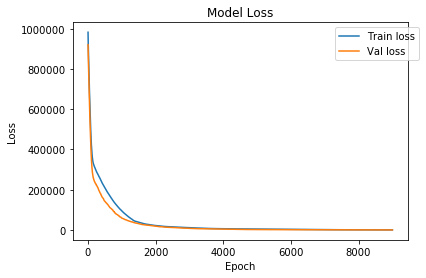

In [27]:
#Plot Model Loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

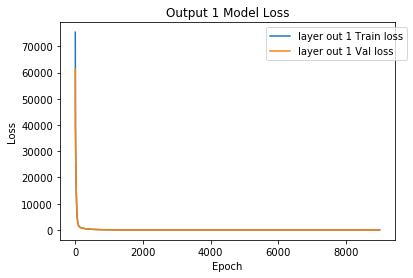

In [28]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

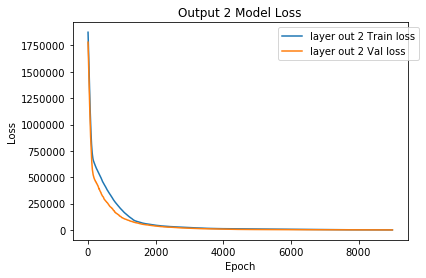

In [29]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [24]:
#load ground truth

ytest2 = np.zeros((34,1))
for i in range(34):
    ytest2[i] =  ytest[i][0]
    
ytest2 =ytest2.reshape(34,)
ytest2

array([5198.42249651, 5194.6744963 , 5199.35428418, 5198.16304631,
       5200.55128288, 5200.36296698, 5198.66678661, 5199.85823223,
       5198.48072027, 5196.17462049, 5199.22284709, 5198.80978237,
       5200.24083499, 5199.44009644, 5198.30189713, 5198.00431992,
       5199.02014396, 5198.57463453, 5198.46699483, 5200.08659665,
       5200.0496129 , 5199.77837776, 5201.38508644, 5199.08330901,
       5198.46959549, 5199.75579138, 5199.3527392 , 5198.40678699,
       5199.35840974, 5197.68945599, 5197.7088677 , 5198.43479647,
       5197.88806821, 5198.43469126])

In [25]:
#Load ground truth sequence

fleet_Rul_File = "ytestT.csv"
fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)
#fleet_RUL = fleet_RUL*(thrmax-thrmin) + thrmin
fleet_RUL_np = np.zeros((34,24))
for i in range(34):
    for j in range(24):
        fleet_RUL_np[i][j] = fleet_RUL[i][j]

fleet_RUL_np.shape

(34, 24)

In [26]:
#Prediction

#Make 100 predictions and calculate average RMSE

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)

    #RMSE with AU

    #Predicted RUL for each Fleet
    mean_Fleet_All = np.zeros((tens_draw.shape[1],tens_draw.shape[2]))
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for s in range(tens_draw.shape[2]):
        for y in range(tens_draw.shape[1]):
            for x in range(tens_draw.shape[0]):
                mean_Fleet[x] = tens_draw[x,y,s]
            mean_Fleet_All[y][s] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    mean_Fleet_All1 = np.zeros((tens_draw1.shape[1],tens_draw1.shape[2]))
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for s in range(tens_draw1.shape[2]):
        for y in range(tens_draw1.shape[1]):
            for x in range(tens_draw1.shape[0]):
                mean_Fleet1[x] = tens_draw1[x,y,s]
            mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(fleet_RUL_np, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1

#Average RMSE with AU & EU

np.mean(rmse),np.mean(rmse1)

(20.40376832423691, 27.113603191351725)

In [27]:
#Calculate Mean & Std of prediction with AU

pad = 24
fleet_NUM = np.arange(0,pad,1)

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [28]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
mean1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        mean1[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

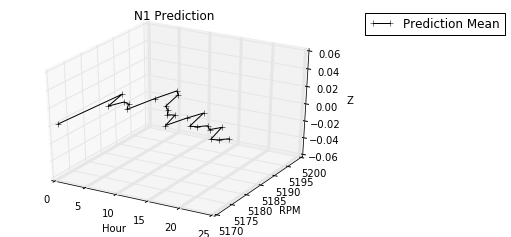

In [29]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("N1 Prediction")
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.tiff',bbox_inches='tight')
plt.show()

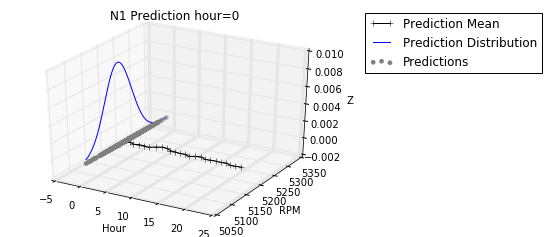

In [30]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("N1 Prediction hour=%i" % i)
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_2.tiff',bbox_inches='tight')
plt.show()

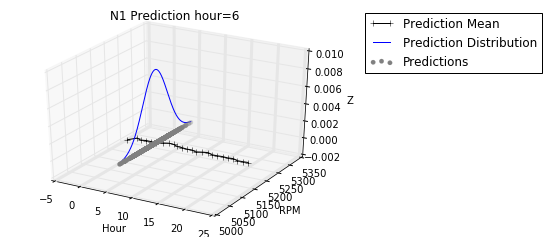

In [31]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 5

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_3.tiff',bbox_inches='tight')
plt.show()

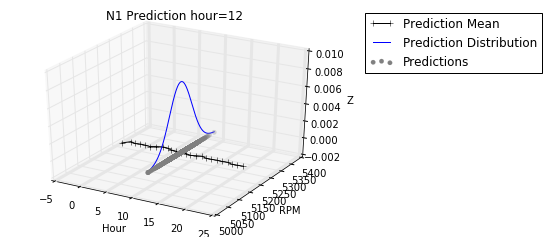

In [32]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 11

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_4.tiff',bbox_inches='tight')
plt.show()

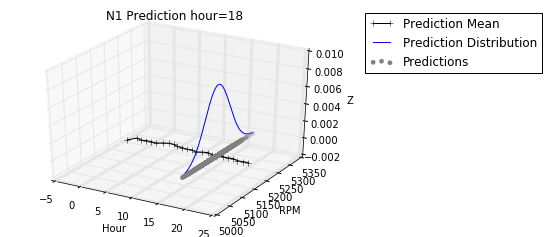

In [33]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_5.tiff',bbox_inches='tight')
plt.show()

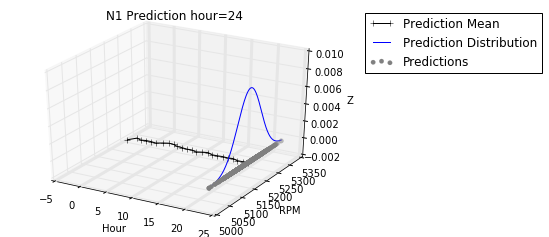

In [34]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 23

ax.set_title("N1 Prediction hour=%i" % (i+1))
ax.set_xlabel('Hour')
ax.set_ylabel('RPM')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,24,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",color='black',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_6.tiff',bbox_inches='tight')
plt.show()

In [35]:
#Load date of prediction

date = "date.csv"
date = pd.read_csv(date, skiprows = 0,header = None)
date = date.to_numpy()

In [36]:
#Load hour of prediction

hour_NUM = ['8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am']

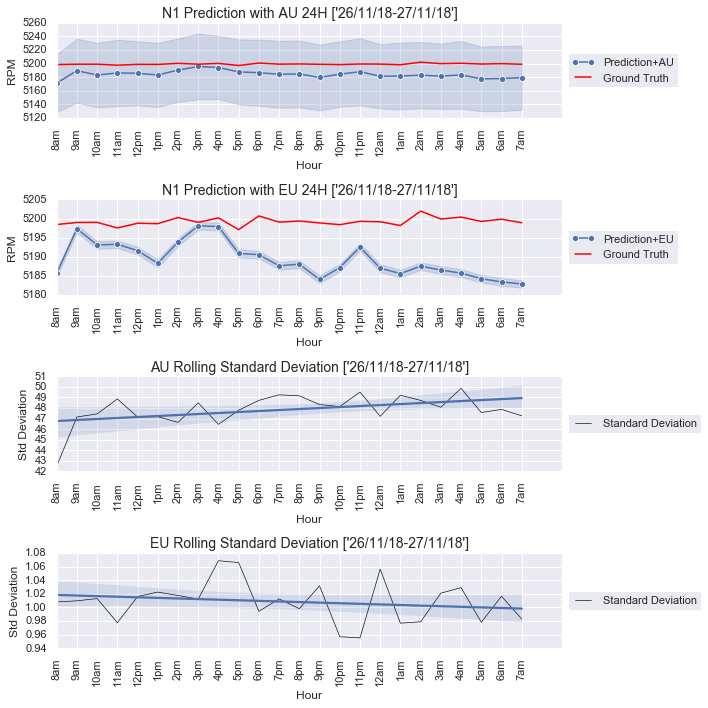

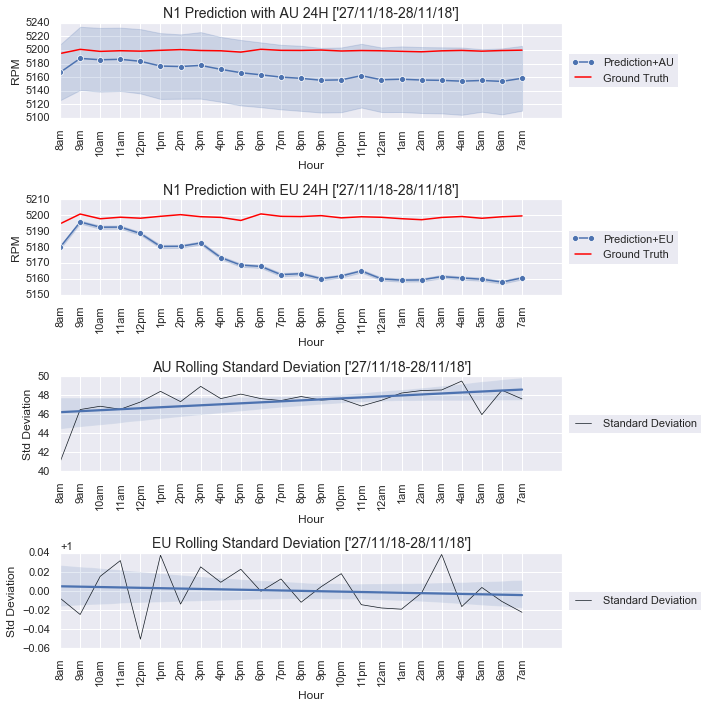

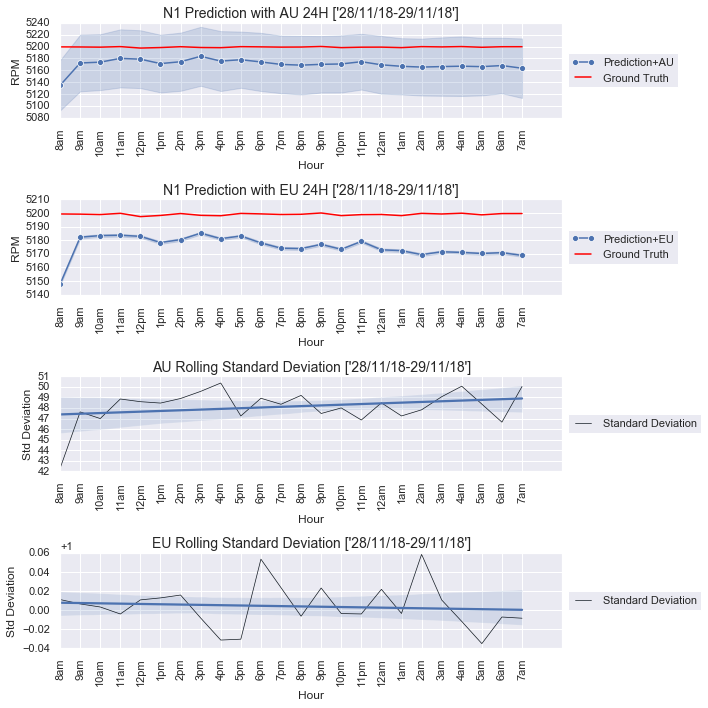

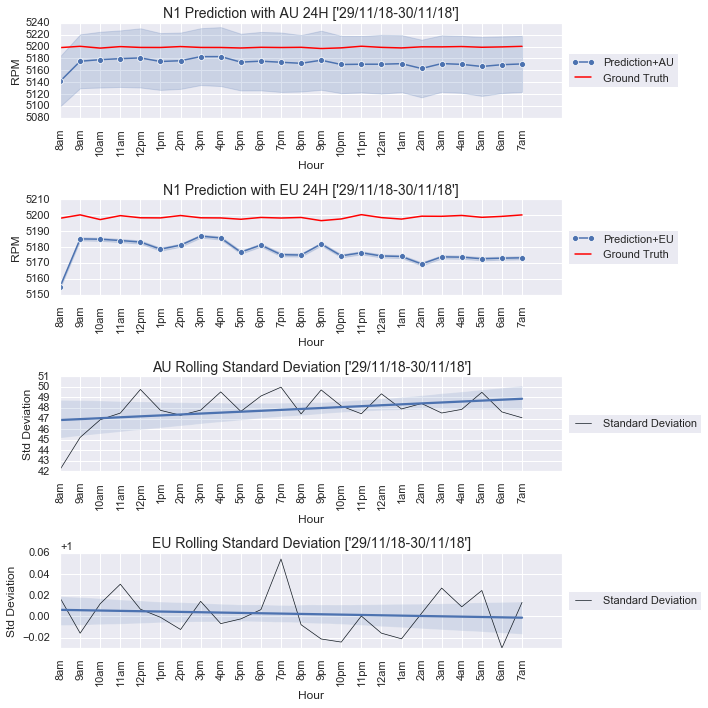

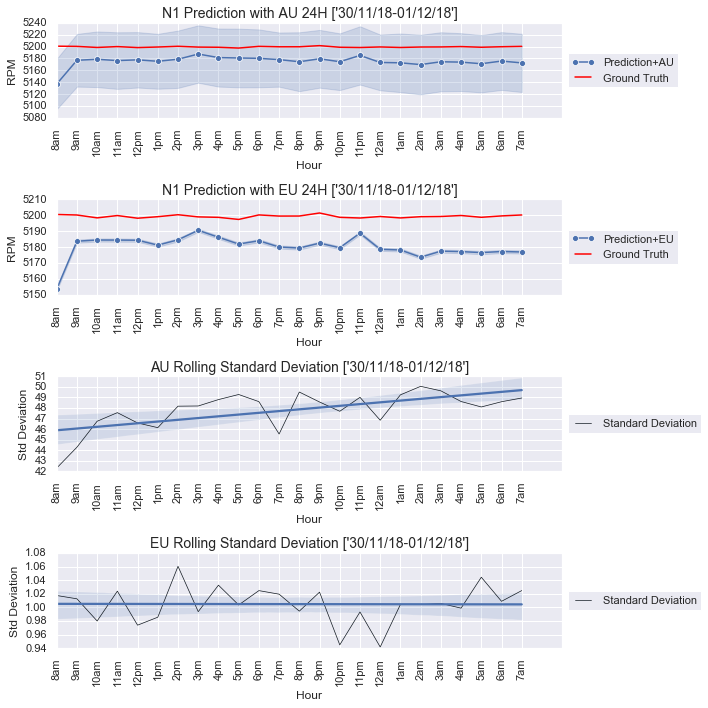

...

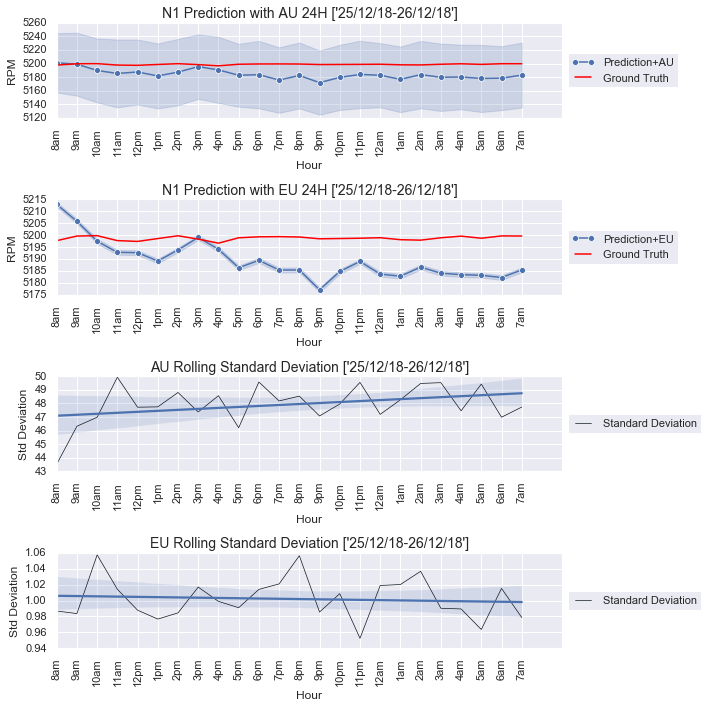

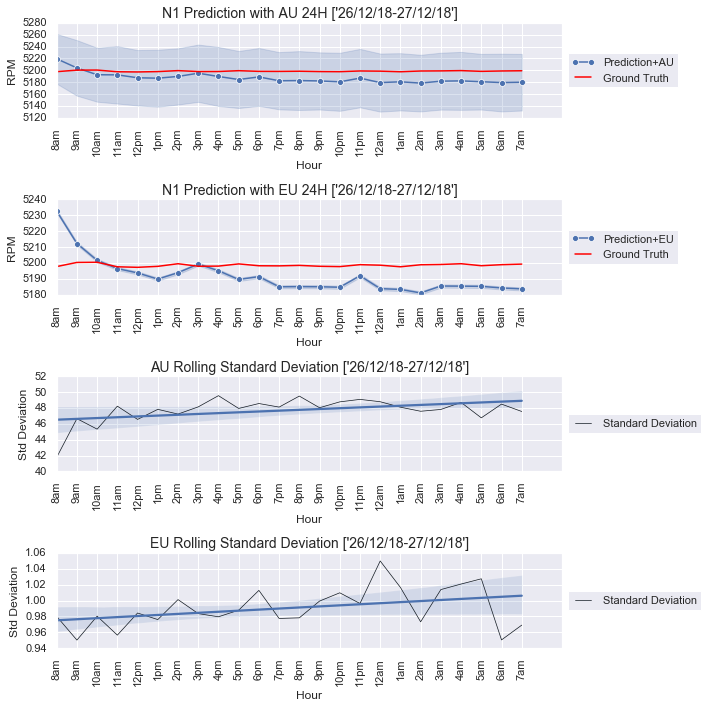

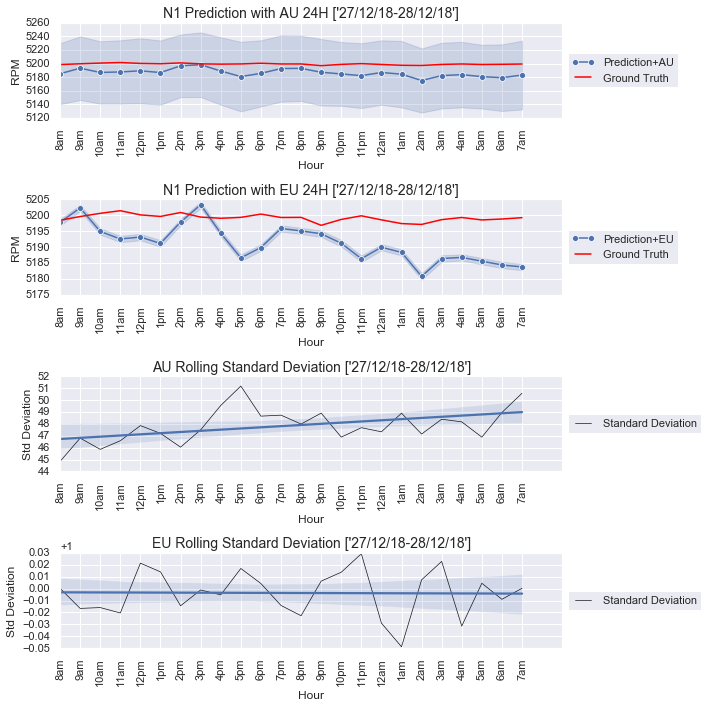

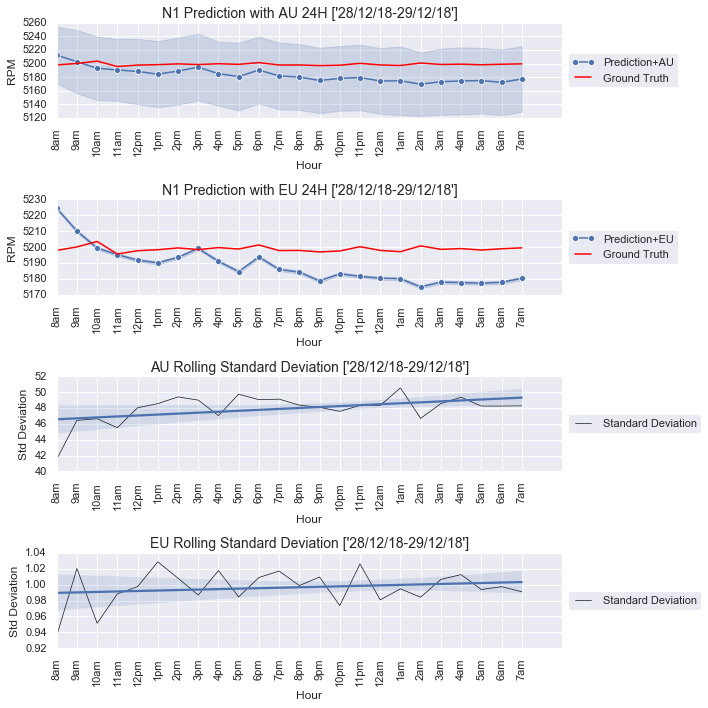

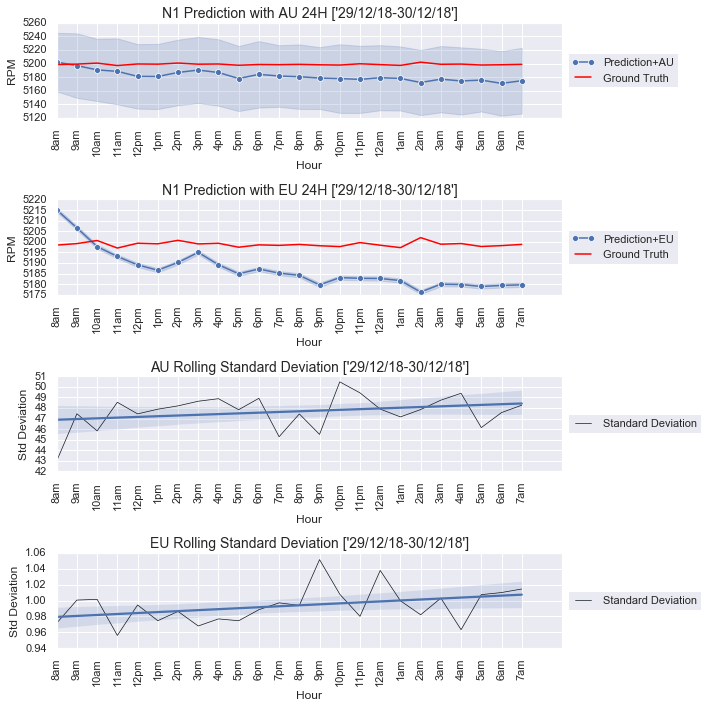

In [37]:
#Prediction Visualization

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set()
for B in range(34):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','RPM']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Hour','RPM']
    
    max_Seq_Arrange1.columns = ['Hour','RPM']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Hour','RPM']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Hour','RPM']
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'])
    gs = gridspec.GridSpec(4,1)
    fig = plt.figure(figsize=(10,10))
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="Prediction+AU")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('N1 Prediction with AU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[1])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="Prediction+EU")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth")
    plt.title('N1 Prediction with EU 24H ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    

    ax = fig.add_subplot(gs[2])
    ax.plot('Hour', 'RPM', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'],scatter = False)
    plt.title('AU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[3])
    ax.plot('Hour', 'RPM', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Hour'],med_Std_Arrange['RPM'],scatter = False)
    plt.title('EU Rolling Standard Deviation ' +str(date[B]),fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

In [24]:
#SHAP cannot be used with model with probabilistic layers. So, define non probabilistic f'x

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 890)           3186200   
_________________________________________________________________
dense_2 (Dense)              (None, 24, 33)            29403     
_________________________________________________________________
dense_3 (Dense)              (None, 24, 1)             34        
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,215,637
Trainable params: 3,215,637
Non-trainable params: 0
_________________________________________________________________


In [25]:
#Extract only "Mean" weights, exclude "Standard Deviation" weights

a = model.layers[3].get_weights()

b = np.zeros((len(a[0]),1))
for x in range(len(a[0])):
    b[x] = a[0][x][0]
    
d = np.zeros(1)
for x in range(1):
    d[x] = a[1][x]
    
c = [b,d]

In [26]:
#Transfer weights from fx to f'x

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(c)

In [27]:
#Prediction with f'x

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [28]:
#Import SHAP & initialized JS for f'x explanation

import shap
shap.initjs()

In [40]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [41]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

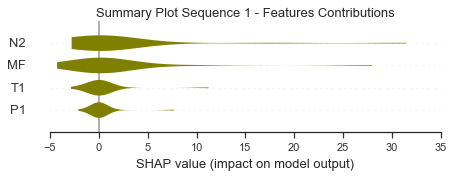

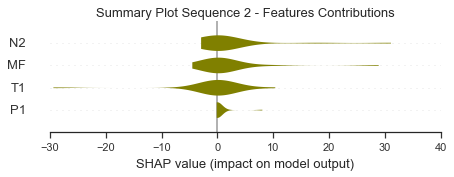

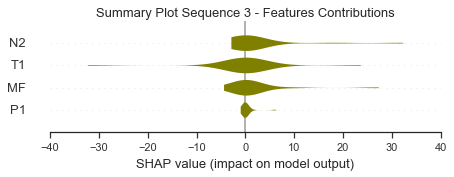

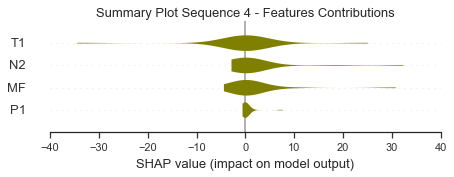

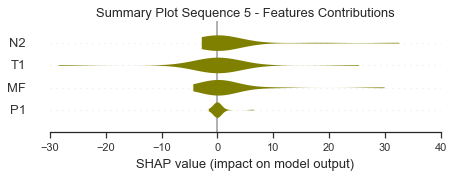

...

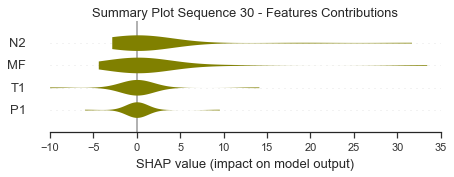

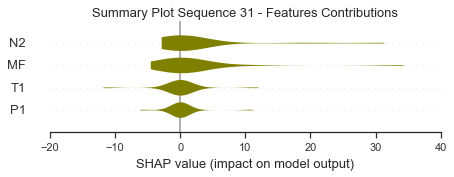

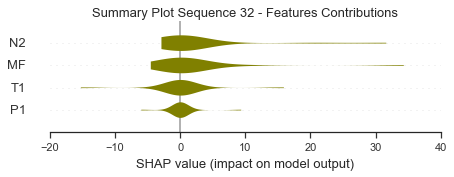

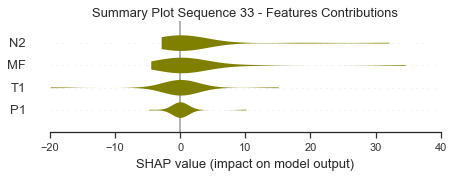

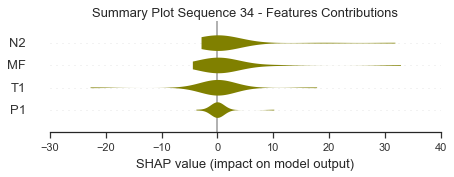

In [45]:
#SHAP Summmary Plot

sns.set_style('ticks')
instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="violin", color='olive')
    plt.title("Summary Plot Sequence %i - Features Contributions" %(i+1),fontsize=13)
    plt.figure
    plt.show()

In [46]:
#SHAP Force Plot

import seaborn as sns
sns.set_style("ticks")
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    # Per individual array 
    for j in range(24):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,4),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


3 1


3 2


3 3


3 4


3 5


3 6


3 7


3 8


3 9


3 10


3 11


3 12


3 13


3 14


3 15


3 16


3 17


3 18


3 19


3 20


3 21


3 22


3 23


3 24


4 1


4 2


4 3


4 4


4 5


4 6


4 7


4 8


4 9


4 10


4 11


4 12


4 13


4 14


4 15


4 16


4 17


4 18


4 19


4 20


4 21


4 22


4 23


4 24


5 1


5 2


5 3


5 4


5 5


5 6


5 7


5 8


5 9


5 10


5 11


5 12


5 13


5 14


5 15


5 16


5 17


5 18


5 19


5 20


5 21


5 22


5 23


5 24


6 1


6 2


6 3


6 4


6 5


6 6


6 7


6 8


6 9


6 10


6 11


6 12


6 13


6 14


6 15


6 16


6 17


6 18


6 19


6 20


6 21


6 22


6 23


6 24


7 1


7 2


7 3


7 4


7 5


7 6


7 7


7 8


7 9


7 10


7 11


7 12


7 13


7 14


7 15


7 16


7 17


7 18


7 19


7 20


7 21


7 22


7 23


7 24


8 1


8 2


8 3


8 4


8 5


8 6


8 7


8 8


8 9


8 10


8 11


8 12


8 13


8 14


8 15


8 16


8 17


8 18


8 19


8 20


8 21


8 22


8 23


8 24


9 1


9 2


9 3


9 4


9 5


9 6


9 7


9 8


9 9


9 10


9 11


9 12


9 13


9 14


9 15


9 16


9 17


9 18


9 19


9 20


9 21


9 22


9 23


9 24


10 1


10 2


10 3


10 4


10 5


10 6


10 7


10 8


10 9


10 10


10 11


10 12


10 13


10 14


10 15


10 16


10 17


10 18


10 19


10 20


10 21


10 22


10 23


10 24


11 1


11 2


11 3


11 4


11 5


11 6


11 7


11 8


11 9


11 10


11 11


11 12


11 13


11 14


11 15


11 16


11 17


11 18


11 19


11 20


11 21


11 22


11 23


11 24


12 1


12 2


12 3


12 4


12 5


12 6


12 7


12 8


12 9


12 10


12 11


12 12


12 13


12 14


12 15


12 16


12 17


12 18


12 19


12 20


12 21


12 22


12 23


12 24


13 1


13 2


13 3


13 4


13 5


13 6


13 7


13 8


13 9


13 10


13 11


13 12


13 13


13 14


13 15


13 16


13 17


13 18


13 19


13 20


13 21


13 22


13 23


13 24


14 1


14 2


14 3


14 4


14 5


14 6


14 7


14 8


14 9


14 10


14 11


14 12


14 13


14 14


14 15


14 16


14 17


14 18


14 19


14 20


14 21


14 22


14 23


14 24


15 1


15 2


15 3


15 4


15 5


15 6


15 7


15 8


15 9


15 10


15 11


15 12


15 13


15 14


15 15


15 16


15 17


15 18


15 19


15 20


15 21


15 22


15 23


15 24


16 1


16 2


16 3


16 4


16 5


16 6


16 7


16 8


16 9


16 10


16 11


16 12


16 13


16 14


16 15


16 16


16 17


16 18


16 19


16 20


16 21


16 22


16 23


16 24


17 1


17 2


17 3


17 4


17 5


17 6


17 7


17 8


17 9


17 10


17 11


17 12


17 13


17 14


17 15


17 16


17 17


17 18


17 19


17 20


17 21


17 22


17 23


17 24


18 1


18 2


18 3


18 4


18 5


18 6


18 7


18 8


18 9


18 10


18 11


18 12


18 13


18 14


18 15


18 16


18 17


18 18


18 19


18 20


18 21


18 22


18 23


18 24


19 1


19 2


19 3


19 4


19 5


19 6


19 7


19 8


19 9


19 10


19 11


19 12


19 13


19 14


19 15


19 16


19 17


19 18


19 19


19 20


19 21


19 22


19 23


19 24


20 1


20 2


20 3


20 4


20 5


20 6


20 7


20 8


20 9


20 10


20 11


20 12


20 13


20 14


20 15


20 16


20 17


20 18


20 19


20 20


20 21


20 22


20 23


20 24


21 1


21 2


21 3


21 4


21 5


21 6


21 7


21 8


21 9


21 10


21 11


21 12


21 13


21 14


21 15


21 16


21 17


21 18


21 19


21 20


21 21


21 22


21 23


21 24


22 1


22 2


22 3


22 4


22 5


22 6


22 7


22 8


22 9


22 10


22 11


22 12


22 13


22 14


22 15


22 16


22 17


22 18


22 19


22 20


22 21


22 22


22 23


22 24


23 1


23 2


23 3


23 4


23 5


23 6


23 7


23 8


23 9


23 10


23 11


23 12


23 13


23 14


23 15


23 16


23 17


23 18


23 19


23 20


23 21


23 22


23 23


23 24


24 1


24 2


24 3


24 4


24 5


24 6


24 7


24 8


24 9


24 10


24 11


24 12


24 13


24 14


24 15


24 16


24 17


24 18


24 19


24 20


24 21


24 22


24 23


24 24


25 1


25 2


25 3


25 4


25 5


25 6


25 7


25 8


25 9


25 10


25 11


25 12


25 13


25 14


25 15


25 16


25 17


25 18


25 19


25 20


25 21


25 22


25 23


25 24


26 1


26 2


26 3


26 4


26 5


26 6


26 7


26 8


26 9


26 10


26 11


26 12


26 13


26 14


26 15


26 16


26 17


26 18


26 19


26 20


26 21


26 22


26 23


26 24


27 1


27 2


27 3


27 4


27 5


27 6


27 7


27 8


27 9


27 10


27 11


27 12


27 13


27 14


27 15


27 16


27 17


27 18


27 19


27 20


27 21


27 22


27 23


27 24


28 1


28 2


28 3


28 4


28 5


28 6


28 7


28 8


28 9


28 10


28 11


28 12


28 13


28 14


28 15


28 16


28 17


28 18


28 19


28 20


28 21


28 22


28 23


28 24


29 1


29 2


29 3


29 4


29 5


29 6


29 7


29 8


29 9


29 10


29 11


29 12


29 13


29 14


29 15


29 16


29 17


29 18


29 19


29 20


29 21


29 22


29 23


29 24


30 1


30 2


30 3


30 4


30 5


30 6


30 7


30 8


30 9


30 10


30 11


30 12


30 13


30 14


30 15


30 16


30 17


30 18


30 19


30 20


30 21


30 22


30 23


30 24


31 1


31 2


31 3


31 4


31 5


31 6


31 7


31 8


31 9


31 10


31 11


31 12


31 13


31 14


31 15


31 16


31 17


31 18


31 19


31 20


31 21


31 22


31 23


31 24


32 1


32 2


32 3


32 4


32 5


32 6


32 7


32 8


32 9


32 10


32 11


32 12


32 13


32 14


32 15


32 16


32 17


32 18


32 19


32 20


32 21


32 22


32 23


32 24


33 1


33 2


33 3


33 4


33 5


33 6


33 7


33 8


33 9


33 10


33 11


33 12


33 13


33 14


33 15


33 16


33 17


33 18


33 19


33 20


33 21


33 22


33 23


33 24


34 1


34 2


34 3


34 4


34 5


34 6


34 7


34 8


34 9


34 10


34 11


34 12


34 13


34 14


34 15


34 16


34 17


34 18


34 19


34 20


34 21


34 22


34 23


34 24


Contribution: [ 7.71339741 11.23073864 31.45846132  9.32164916]


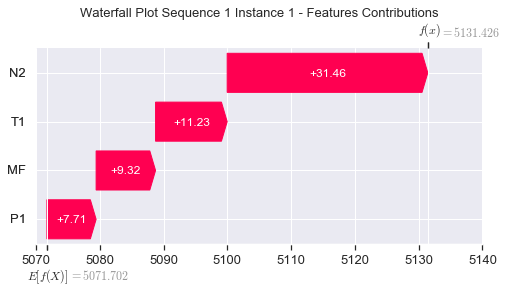

None

Contribution: [0.01301207 0.04095011 0.14952468 0.07765092]


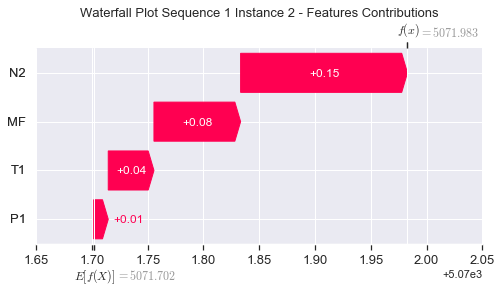

None

Contribution: [-0.03696536  0.04509968  0.17855161  0.24357293]


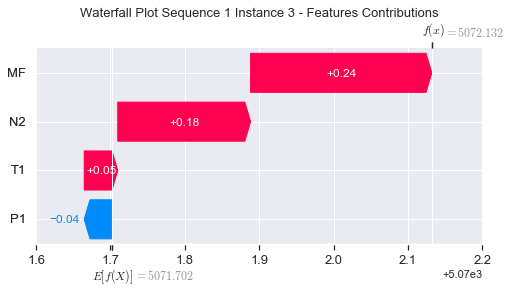

None

Contribution: [-0.05162064  0.02471797  0.06581357  0.12229907]


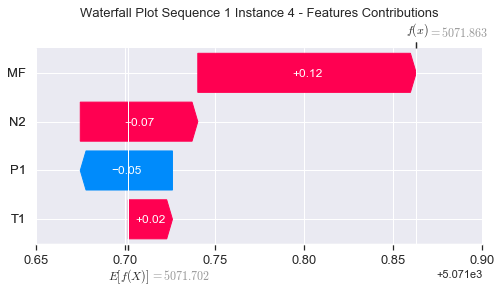

None

Contribution: [-0.01037247  0.04643571  0.14973052  0.18008774]


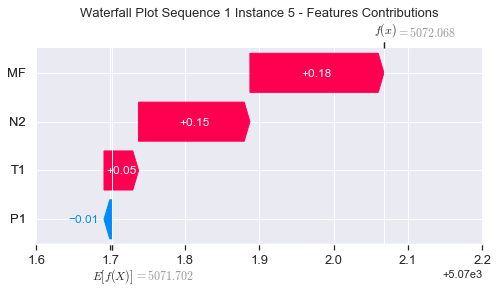

None

Contribution: [0.00303507 0.03401398 0.1245548  0.13810605]


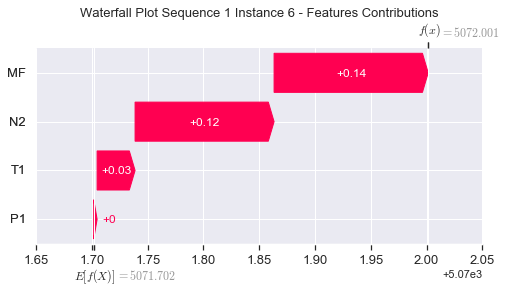

None

Contribution: [0.01097424 0.03086059 0.12007537 0.12318346]


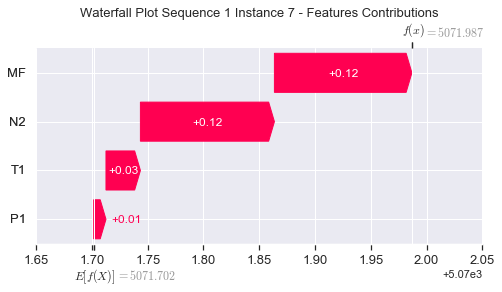

None

Contribution: [0.00675166 0.03707608 0.12983869 0.13532567]


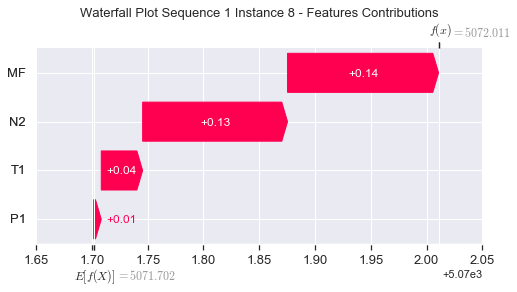

None

Contribution: [-0.00082643  0.03780617  0.13692579  0.1491306 ]


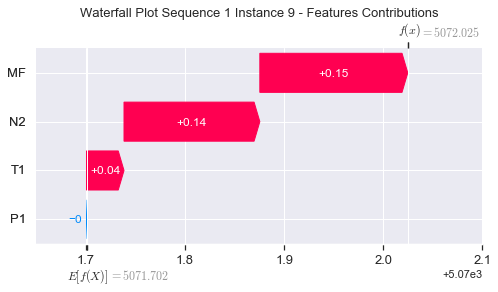

None

Contribution: [-0.00466897  0.04096131  0.13558628  0.1463953 ]


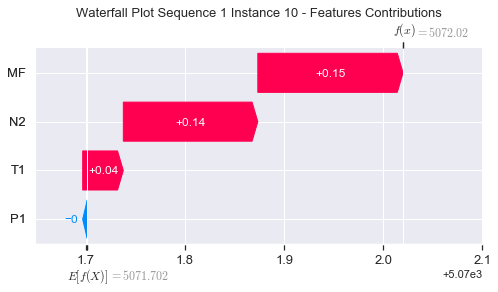

None

Contribution: [-0.00816485  0.03920125  0.13081599  0.13715523]


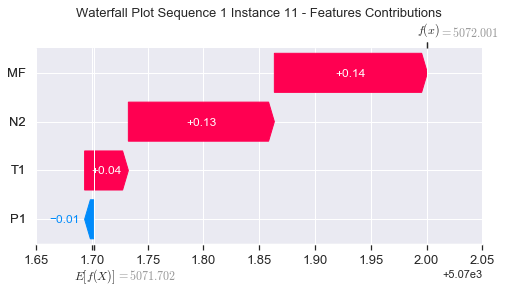

None

Contribution: [-0.00594933  0.0487071   0.13150143  0.14798332]


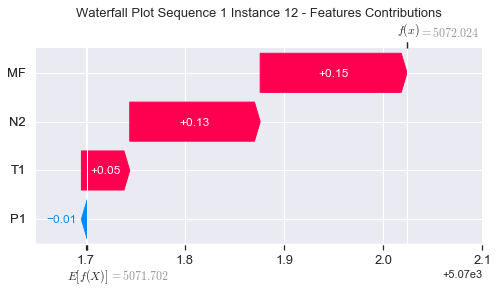

None

Contribution: [-0.00611856  0.04663204  0.12847687  0.14516198]


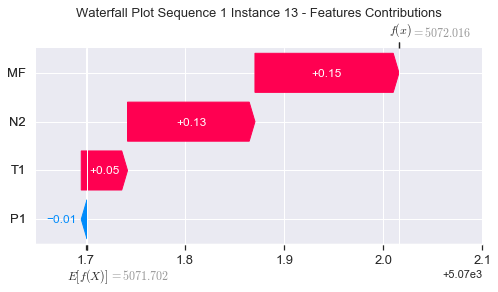

None

Contribution: [-0.00641219  0.04739971  0.12841508  0.14679713]


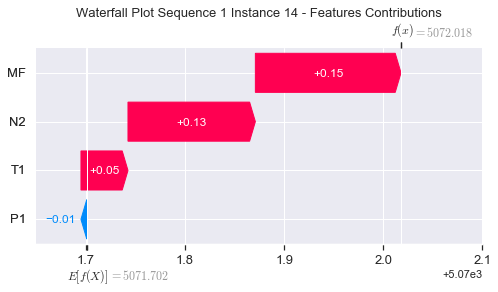

None

Contribution: [-0.00696728  0.04599508  0.12529955  0.14365308]


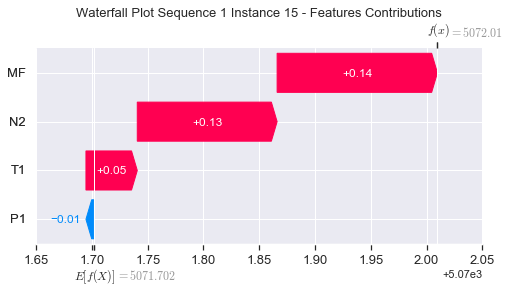

None

Contribution: [-0.01998361  0.03718163  0.11455532  0.10643135]


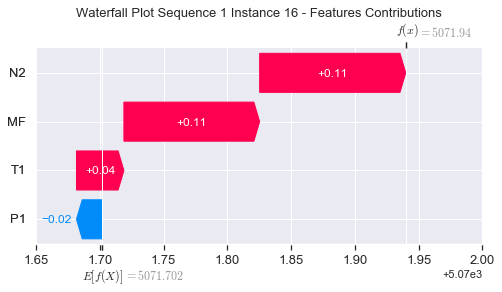

None

Contribution: [-0.00335552  0.03961265  0.11794234  0.13358427]


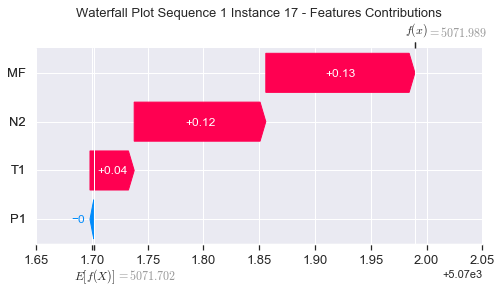

None

Contribution: [0.00934389 0.01987929 0.06520706 0.06307927]


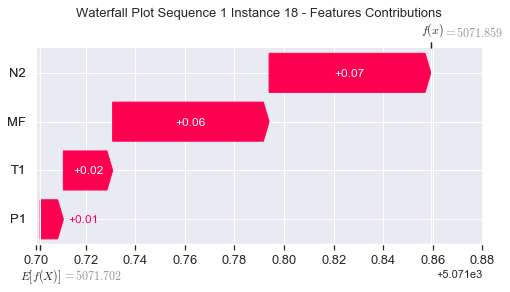

None

Contribution: [0.03785902 0.02621691 0.11343063 0.07662711]


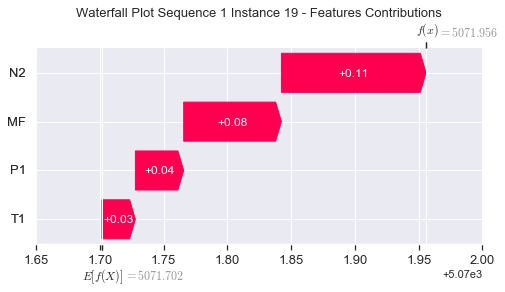

None

Contribution: [-0.09738771  0.17325612  0.51235262  0.68346996]


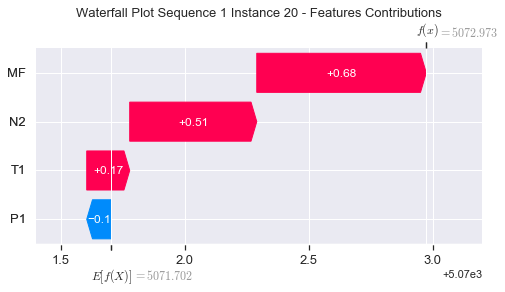

None

Contribution: [-0.13332497 -0.06838142 -0.35641318 -0.28679388]


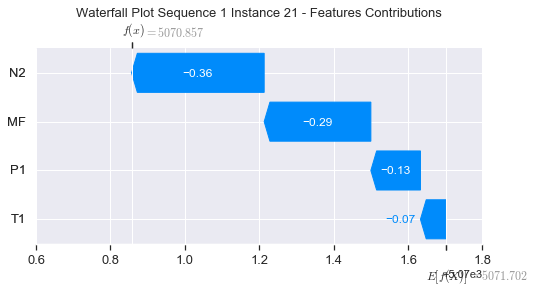

None

Contribution: [ 0.99205346 -0.99693429 -2.79263855 -4.27875674]


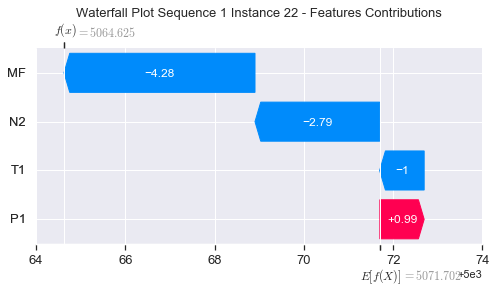

None

Contribution: [0.11463705 0.77396231 3.50029369 3.61259863]


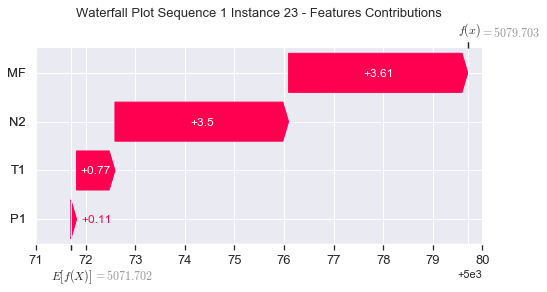

None

Contribution: [-2.10807138 -2.85934453 17.71822749 27.95460952]


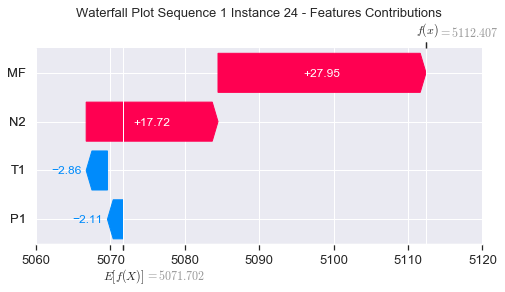

None

Contribution: [ 8.04957586 10.35977413 31.0931443   9.33697683]


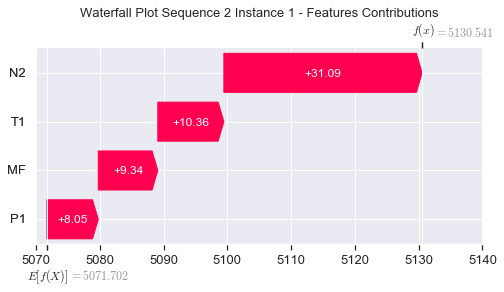

None

Contribution: [0.01060177 0.04440603 0.1452623  0.07403869]


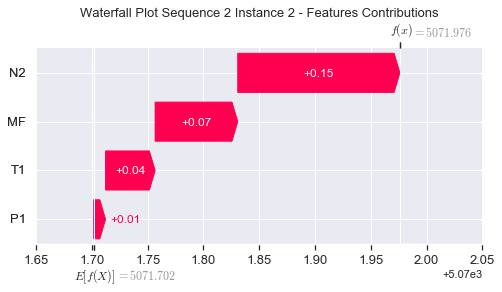

None

Contribution: [-0.0380869   0.04386075  0.17542921  0.24289046]


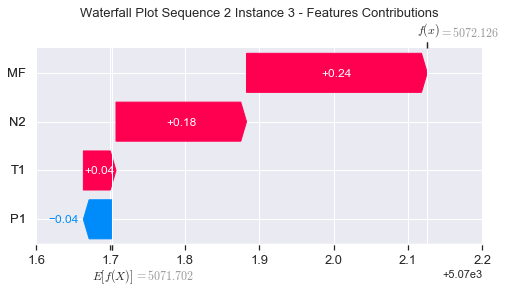

None

Contribution: [-0.05217262  0.02547241  0.06699786  0.12203733]


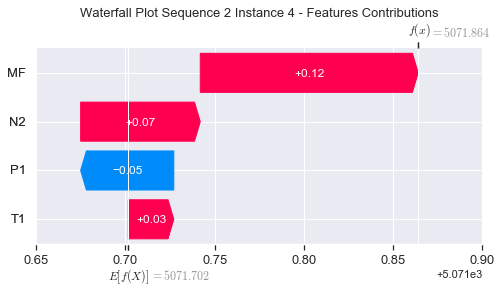

None

Contribution: [-0.01106211  0.04023276  0.15267199  0.18641392]


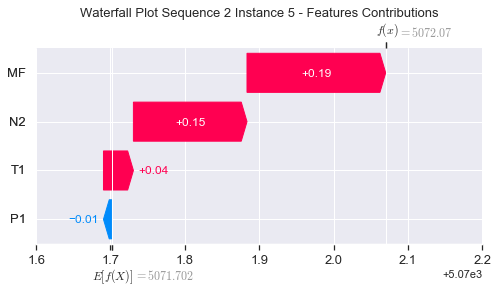

None

Contribution: [0.00222449 0.03230376 0.12693836 0.14192095]


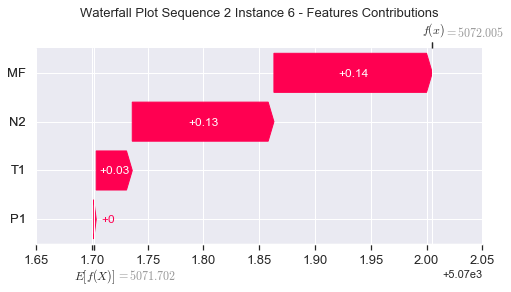

None

Contribution: [0.00963769 0.03556137 0.12282125 0.12686043]


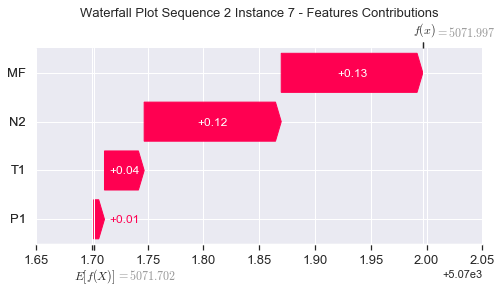

None

Contribution: [0.00449745 0.05181626 0.13328778 0.13917457]


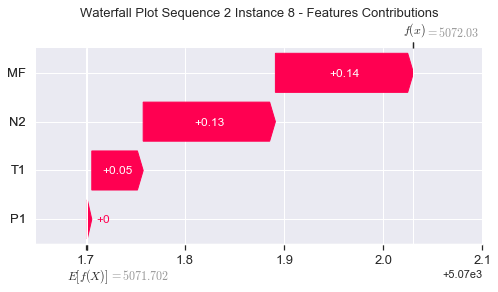

None

Contribution: [-0.00378798  0.06645483  0.1397943   0.15393311]


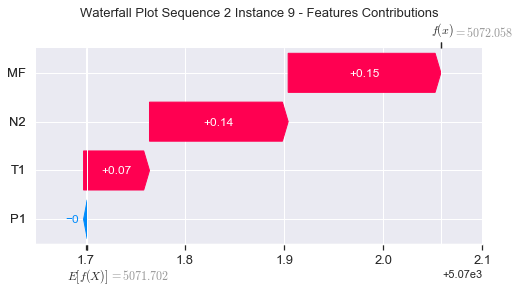

None

Contribution: [-0.00794046  0.07180735  0.13709346  0.14856334]


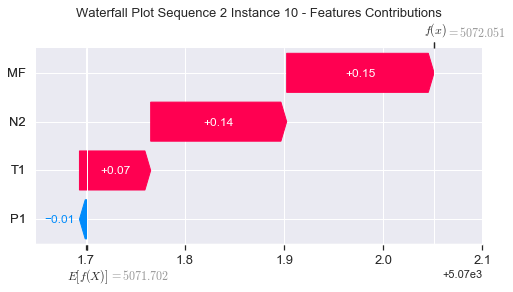

None

Contribution: [-0.01115055  0.0714997   0.13334535  0.13999415]


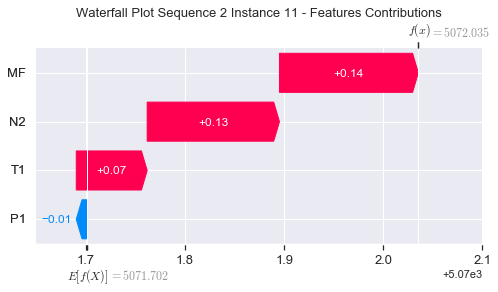

None

Contribution: [-0.00720224  0.08049532  0.13464073  0.15288086]


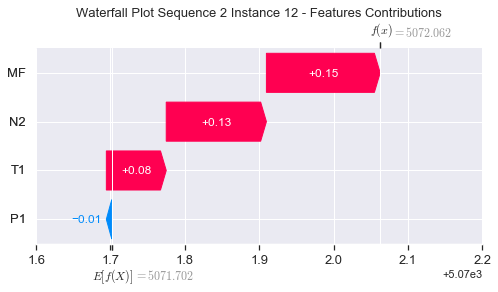

None

Contribution: [-0.00709433  0.07855948  0.13104763  0.14916779]


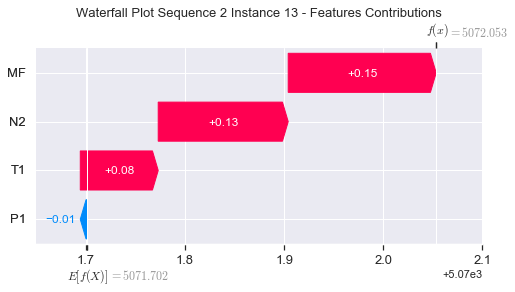

None

Contribution: [-0.00775895  0.08102573  0.1309193   0.1501775 ]


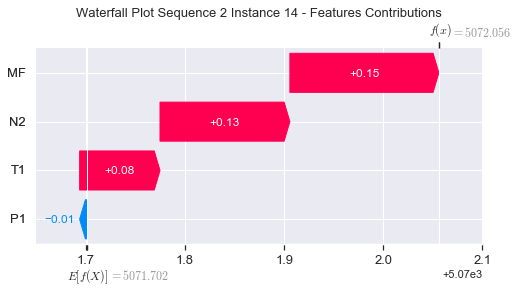

None

Contribution: [-0.00801018  0.07861912  0.12788187  0.14802622]


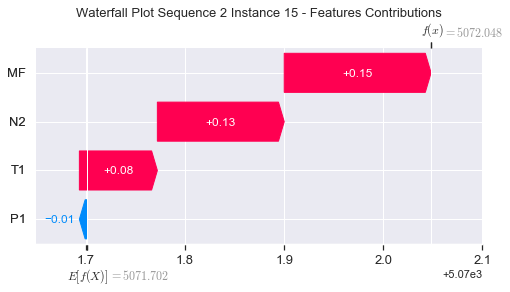

None

Contribution: [-0.02239472  0.07083246  0.11567633  0.11022085]


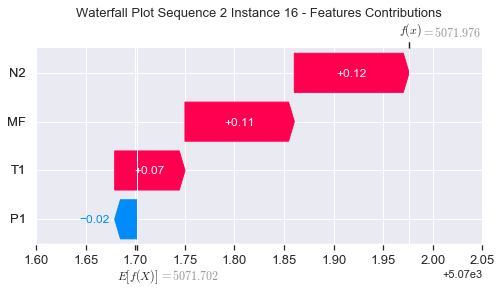

None

Contribution: [-0.00376998  0.07479379  0.11766486  0.13446204]


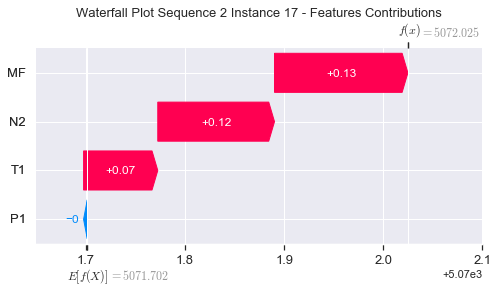

None

Contribution: [0.0098805  0.06059161 0.06035855 0.05749451]


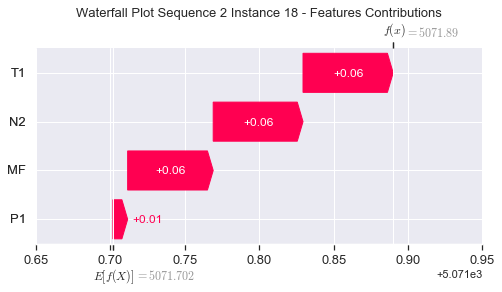

None

Contribution: [0.03973804 0.0654702  0.11705863 0.08013239]


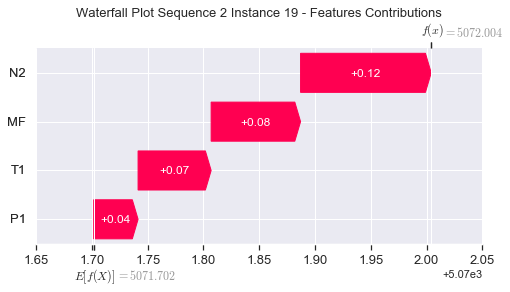

None

Contribution: [-0.10326718  0.16308327  0.53894503  0.72156342]


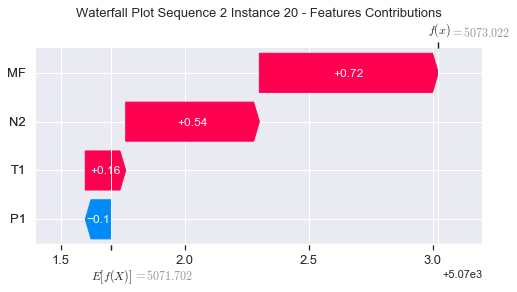

None

Contribution: [-0.13336448 -0.03002287 -0.40041422 -0.33270217]


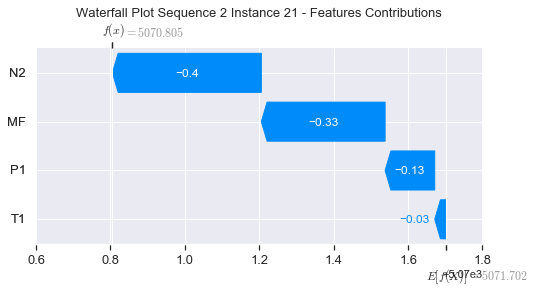

None

Contribution: [ 0.98418134  0.02103094 -2.93208988 -4.50817893]


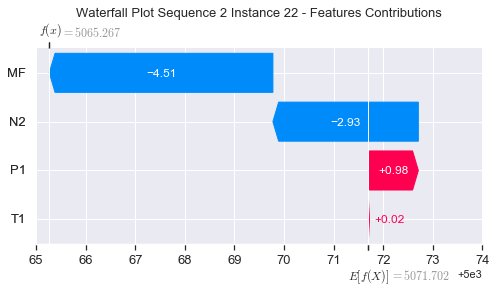

None

Contribution: [-0.03623917  1.57063515  3.63821879  3.77014744]


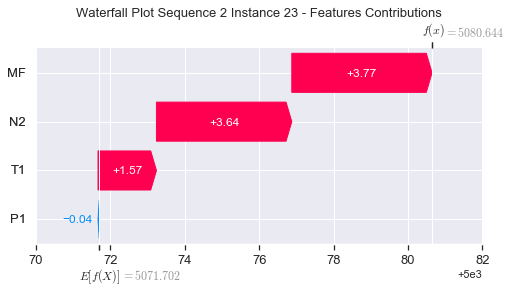

None

Contribution: [ -0.10104892 -29.40733591  17.99918847  28.89086173]


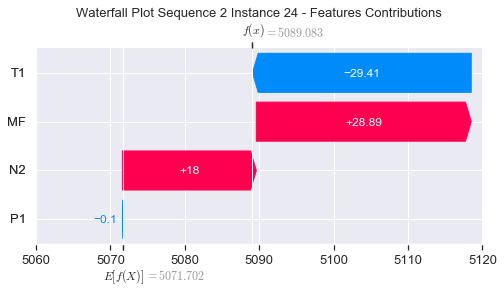

None

Contribution: [ 6.29967394 23.65228987 32.32286508  9.49059109]


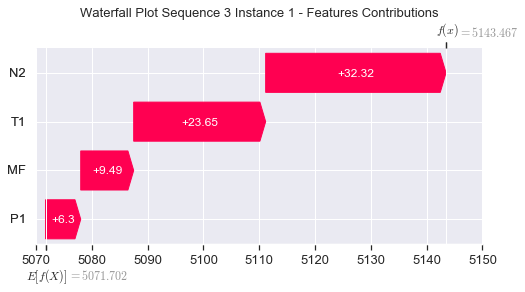

None

Contribution: [0.01323427 0.02175854 0.15769083 0.08084349]


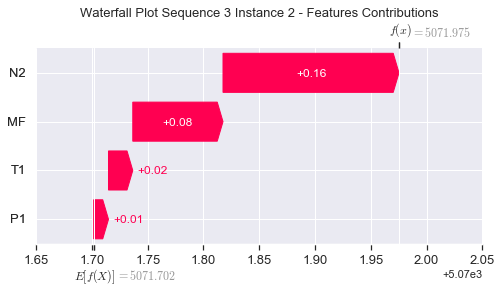

None

Contribution: [-0.03769478  0.02763008  0.18295955  0.25107232]


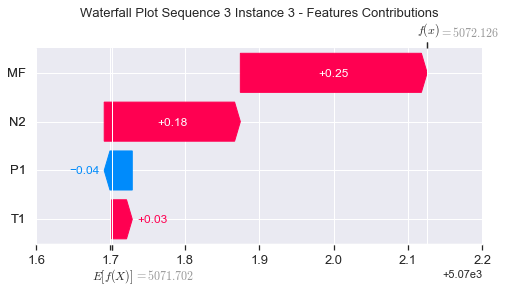

None

Contribution: [-0.05354018  0.01070842  0.07129688  0.12958107]


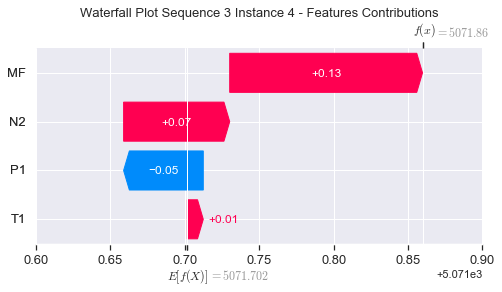

None

Contribution: [-0.01138778  0.03548384  0.1562709   0.18861017]


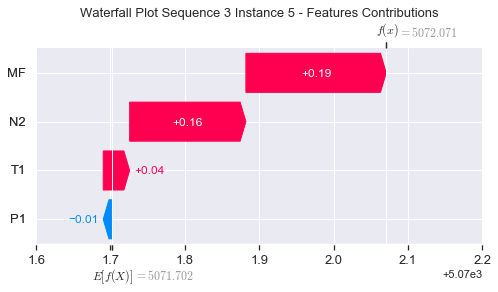

None

Contribution: [0.00205546 0.0314897  0.12950437 0.14460042]


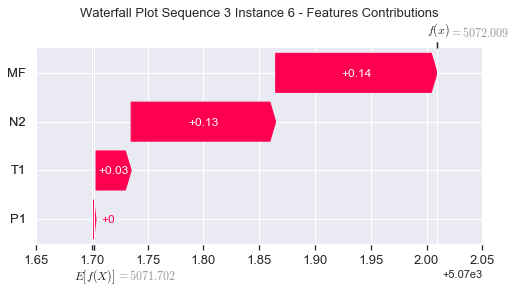

None

Contribution: [0.0091423  0.03669915 0.12699757 0.13260644]


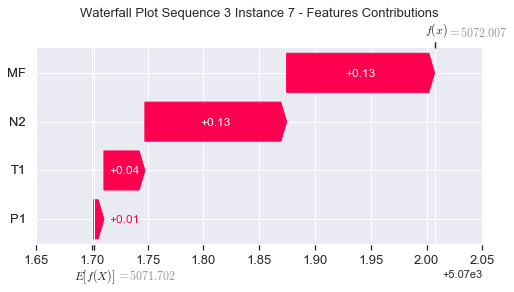

None

Contribution: [0.00362721 0.05499416 0.13861582 0.14811306]


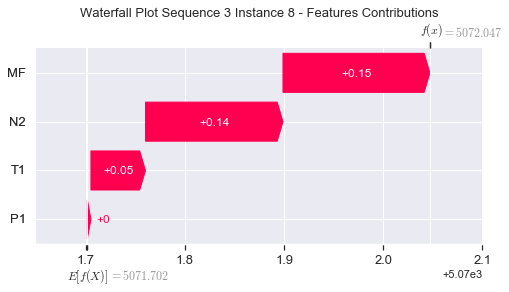

None

Contribution: [-0.00501923  0.06647924  0.14552721  0.16486791]


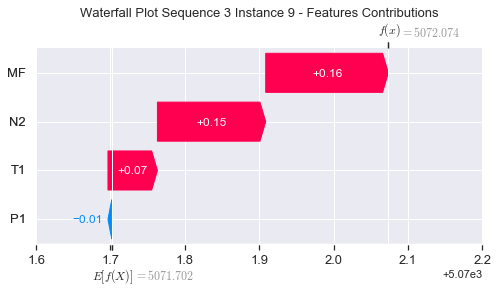

None

Contribution: [-0.00732735  0.06619265  0.14238913  0.1583945 ]


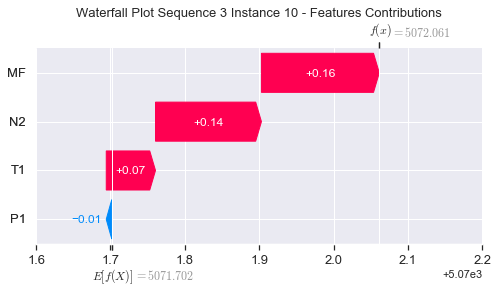

None

Contribution: [-0.01077597  0.06956073  0.13767728  0.14977381]


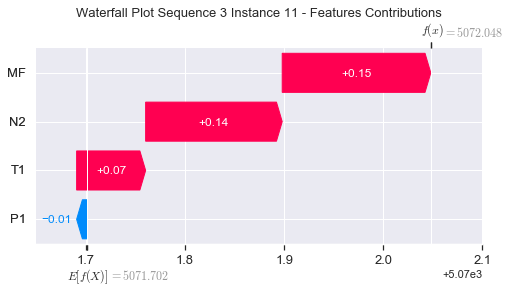

None

Contribution: [-0.00763257  0.08052828  0.13768965  0.1580016 ]


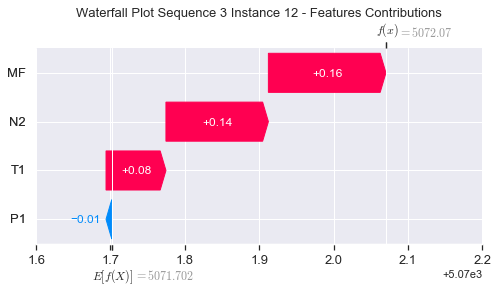

None

Contribution: [-0.007638    0.0796705   0.13405966  0.15442255]


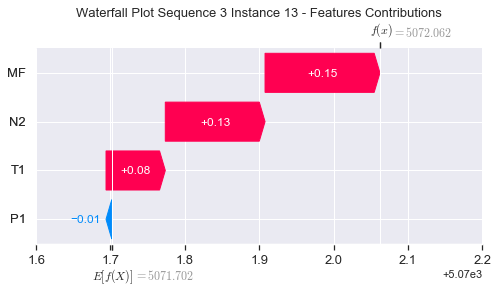

None

Contribution: [-0.00866993  0.07742529  0.13307027  0.15455752]


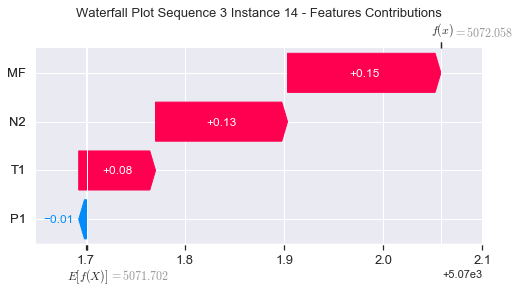

None

Contribution: [-0.0084776   0.07962455  0.12985744  0.15156879]


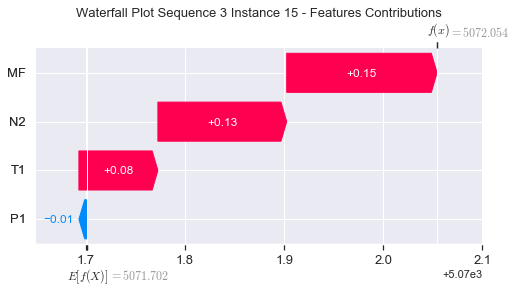

None

Contribution: [-0.02076346  0.07127257  0.11720621  0.11136527]


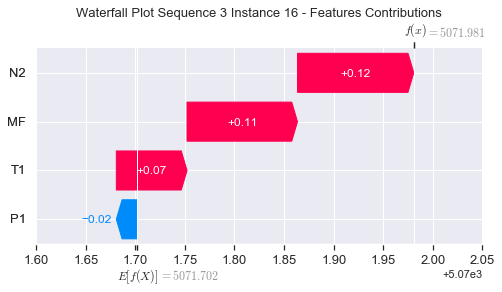

None

Contribution: [-0.00436473  0.0751321   0.12152048  0.13995455]


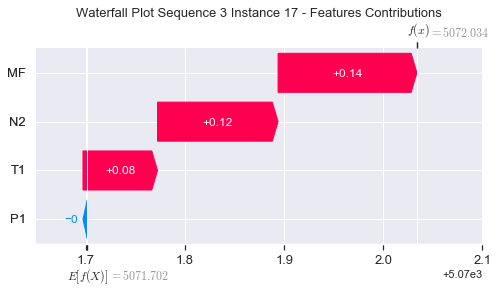

None

Contribution: [0.00750129 0.0618245  0.06671459 0.06757086]


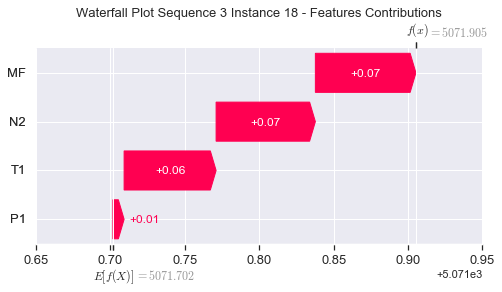

None

Contribution: [0.04082357 0.06824765 0.10899495 0.07171604]


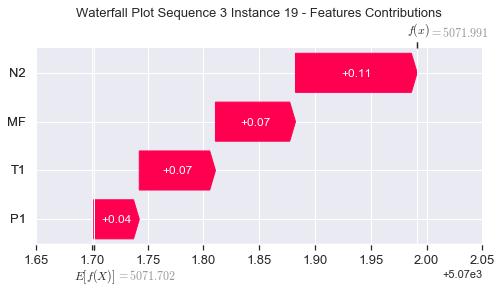

None

Contribution: [-0.09540288  0.15718245  0.52132176  0.69225895]


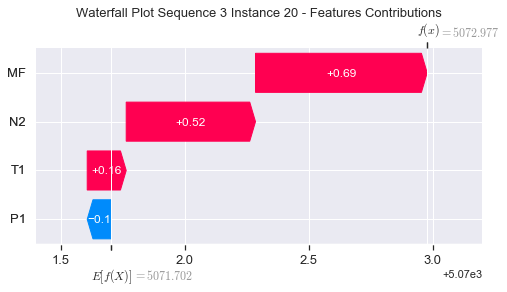

None

Contribution: [-0.13973711 -0.01848352 -0.34873412 -0.2659221 ]


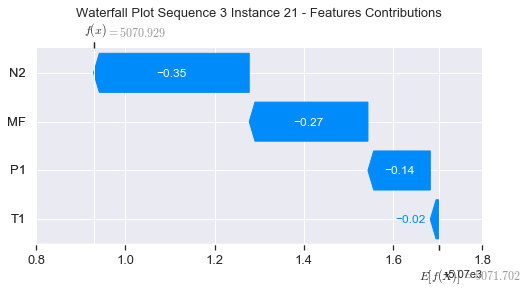

None

Contribution: [ 0.97422689  0.08022117 -2.86193518 -4.3658781 ]


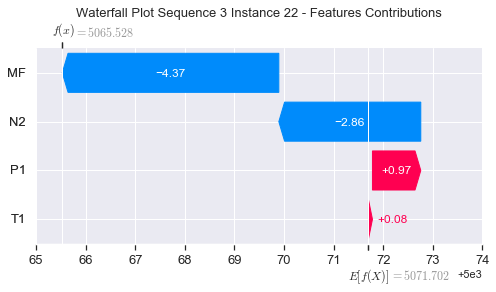

None

Contribution: [0.02074981 1.73522602 3.50975033 3.56572083]


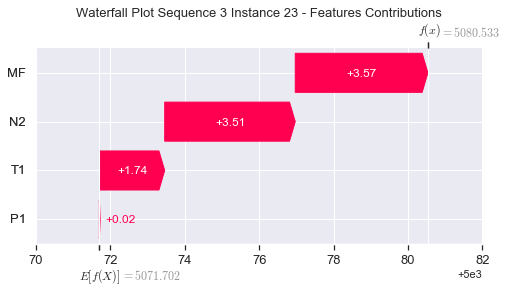

None

Contribution: [ -0.95768494 -32.23813212  18.24553168  27.33118513]


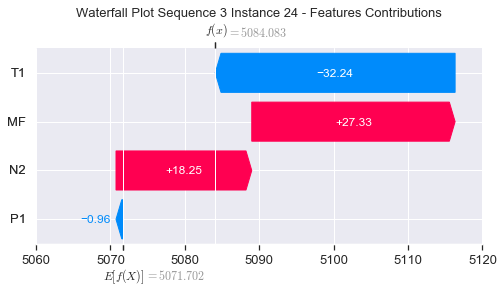

None

Contribution: [ 7.63768114 25.08384665 32.34336677  9.0860423 ]


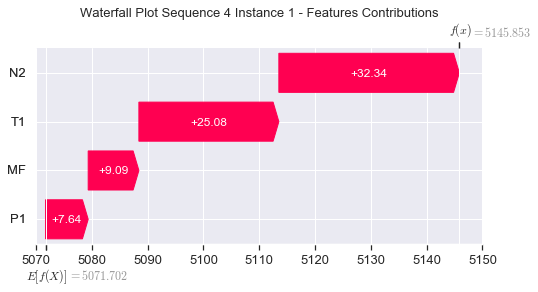

None

Contribution: [0.0145508  0.02088081 0.15935987 0.08229599]


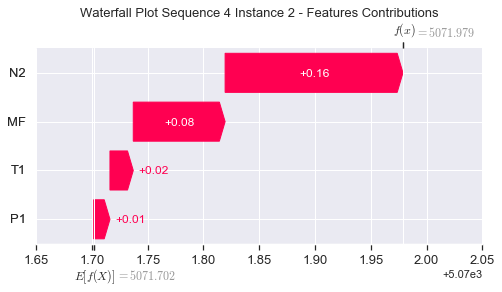

None

Contribution: [-0.03740085  0.02779558  0.18328389  0.25213667]


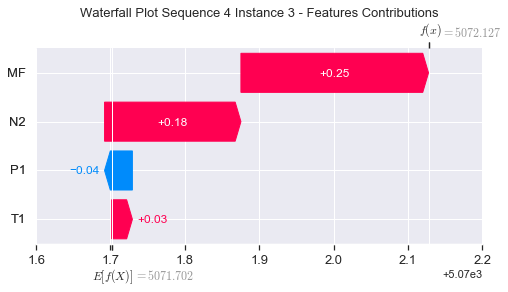

None

Contribution: [-0.05368212  0.01226255  0.07151264  0.12975968]


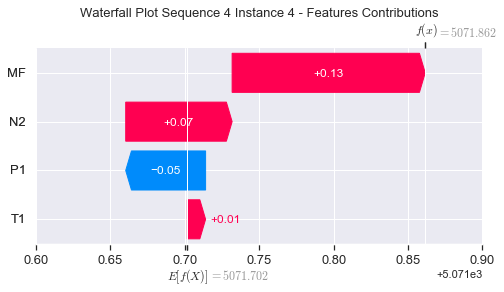

None

Contribution: [-0.01148717  0.0346755   0.15679656  0.1896757 ]


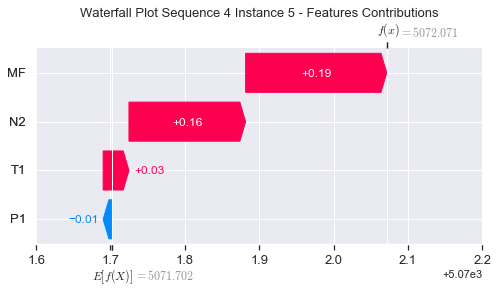

None

Contribution: [0.00211049 0.03089662 0.12989473 0.14536593]


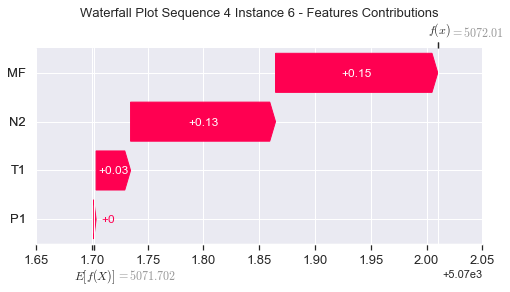

None

Contribution: [0.00939965 0.03735331 0.12774735 0.13327303]


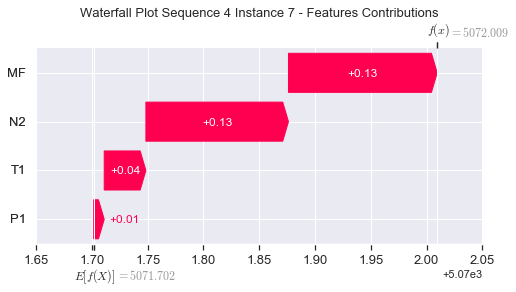

None

Contribution: [0.0037607  0.05747531 0.13951793 0.1481294 ]


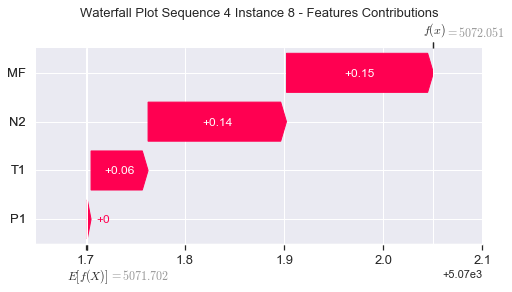

None

Contribution: [-0.00528297  0.07093553  0.14601575  0.16190353]


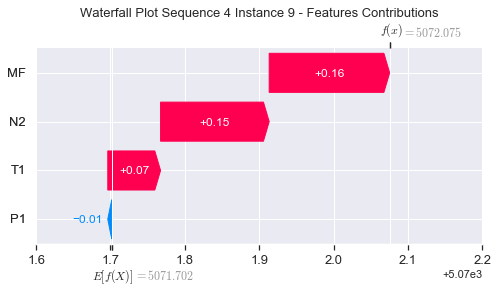

None

Contribution: [-0.00721457  0.07973503  0.14343558  0.15723093]


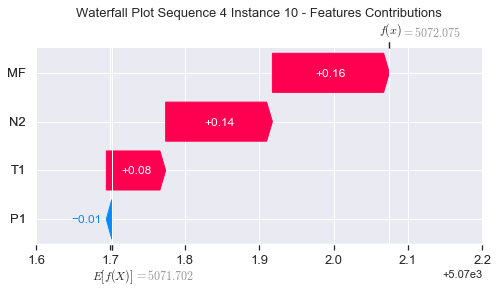

None

Contribution: [-0.01117407  0.07733439  0.13792841  0.14569562]


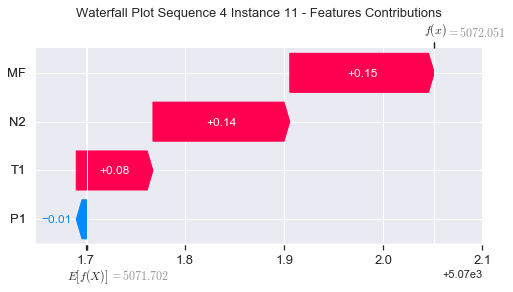

None

Contribution: [-0.00780248  0.08460773  0.13818451  0.15761555]


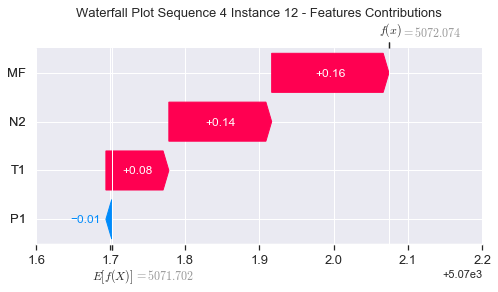

None

Contribution: [-0.00779068  0.08344191  0.13440348  0.15379777]


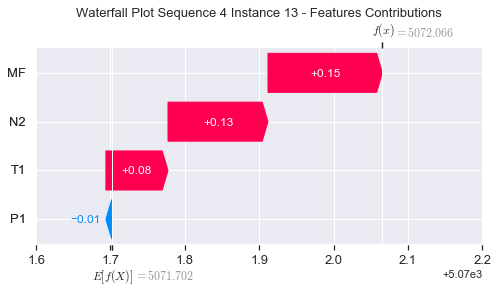

None

Contribution: [-0.00846031  0.08164695  0.13302079  0.14937314]


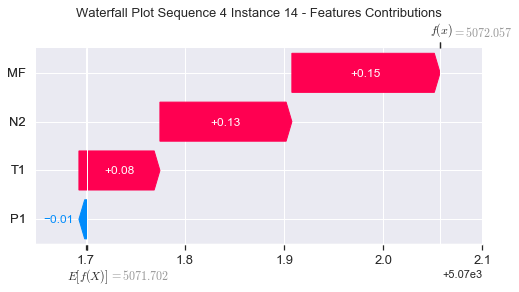

None

Contribution: [-0.0085223   0.08362809  0.13039494  0.15071545]


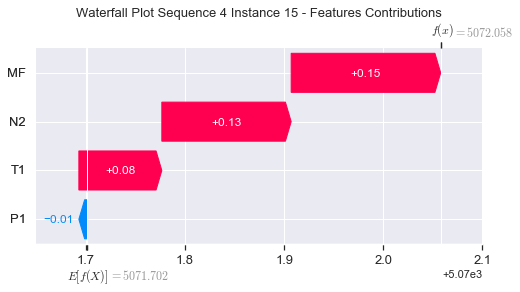

None

Contribution: [-0.02134072  0.07534569  0.11827582  0.11563472]


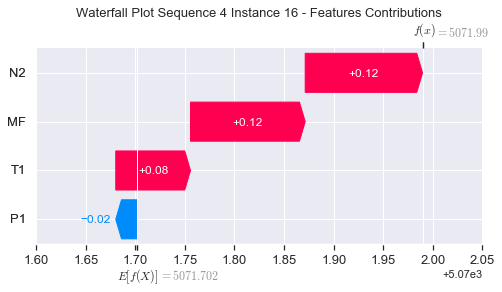

None

Contribution: [-0.00437966  0.07903211  0.12212042  0.13882421]


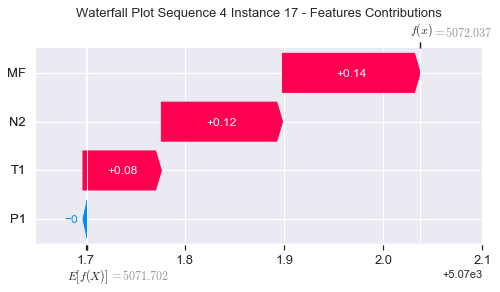

None

Contribution: [0.00721829 0.06726064 0.06796667 0.06667563]


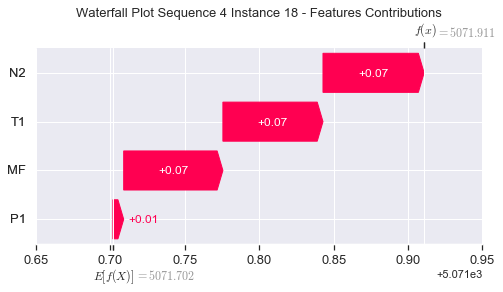

None

Contribution: [0.04093516 0.06825252 0.10866934 0.07362587]


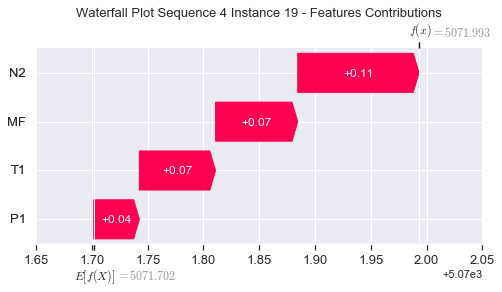

None

Contribution: [-0.09449741  0.15483239  0.5177471   0.68906162]


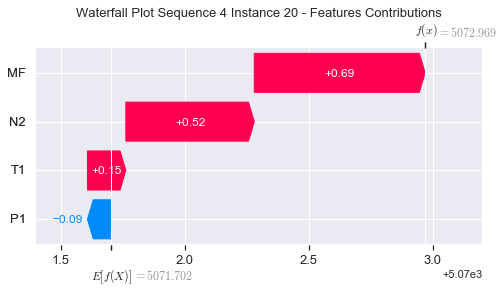

None

Contribution: [-0.14097078 -0.01259056 -0.33876124 -0.25815452]


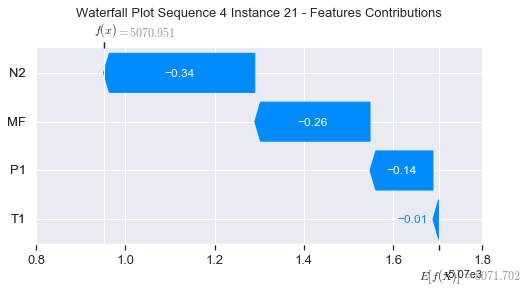

None

Contribution: [ 0.96572453  0.15666699 -2.84021794 -4.3968782 ]


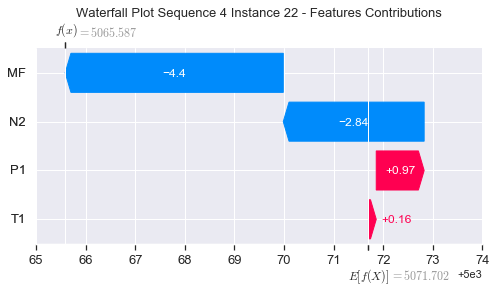

None

Contribution: [0.01655274 1.84007599 3.48573121 3.52837739]


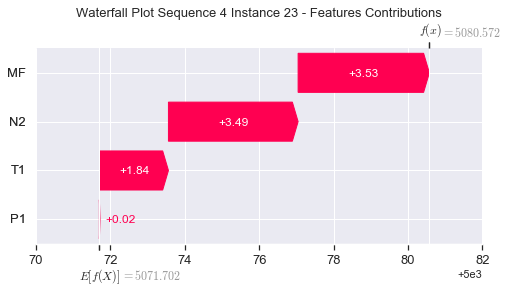

None

Contribution: [ -0.58163292 -34.46518803  18.41860437  30.81161802]


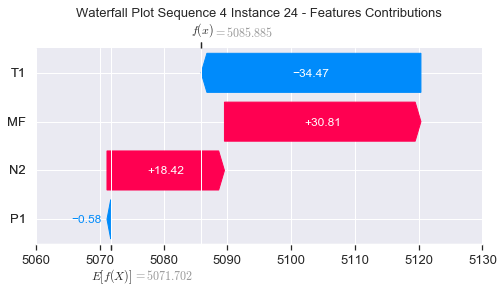

None

Contribution: [ 6.54109478 25.39566848 32.58627776  9.68348179]


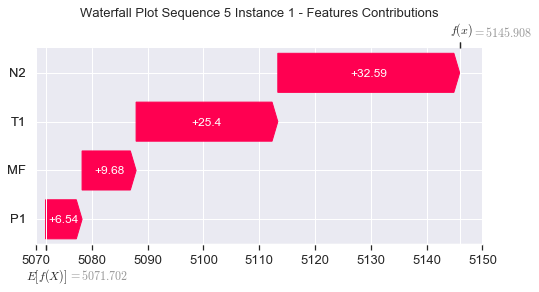

None

Contribution: [0.0137622  0.0197155  0.15938922 0.08258572]


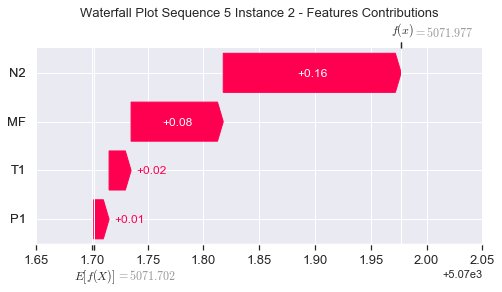

None

Contribution: [-0.03719618  0.02708369  0.18334243  0.25306145]


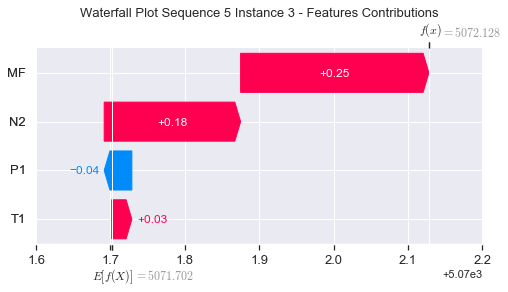

None

Contribution: [-0.05320995  0.01216277  0.07078898  0.12949519]


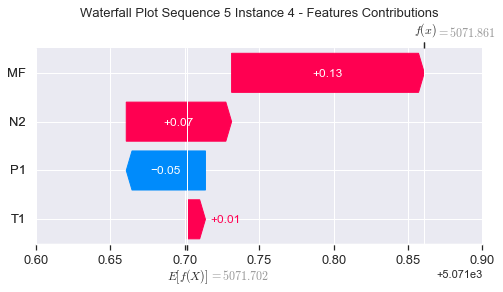

None

Contribution: [-0.01112345  0.03493786  0.15616817  0.18961887]


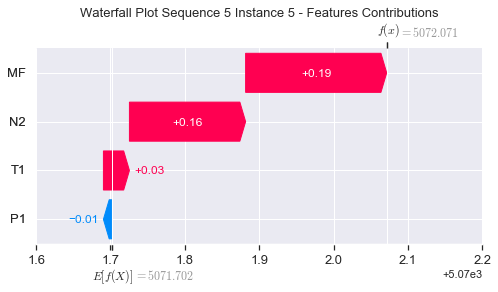

None

Contribution: [0.00212112 0.03120323 0.12952845 0.14499295]


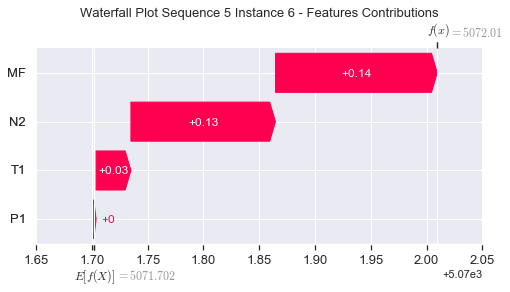

None

Contribution: [0.00906487 0.03660405 0.12730234 0.13251503]


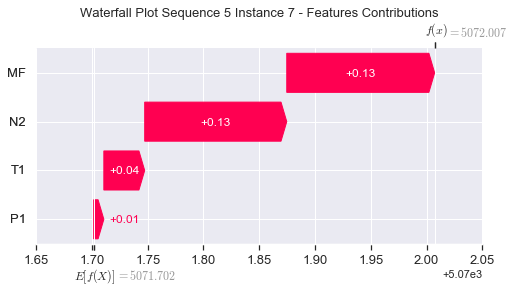

None

Contribution: [0.0034017  0.05490813 0.13901251 0.14699735]


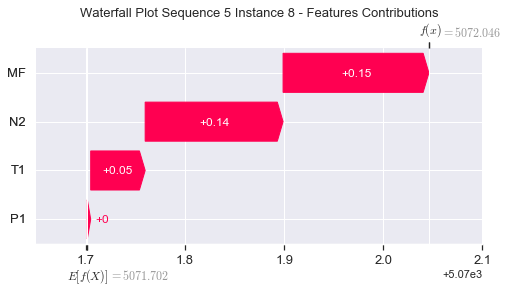

None

Contribution: [-0.00480491  0.06719439  0.14594988  0.16244763]


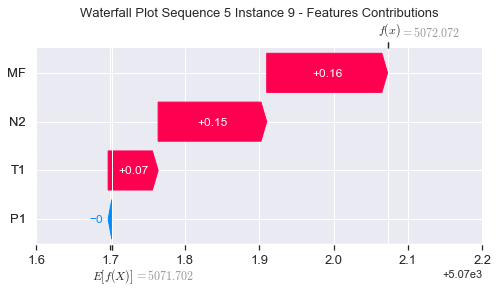

None

Contribution: [-0.00787564  0.07250431  0.1434106   0.15894327]


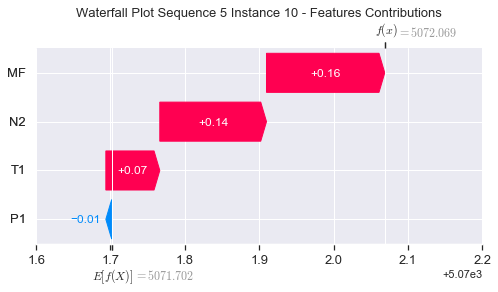

None

Contribution: [-0.01066646  0.06966721  0.13792237  0.14743511]


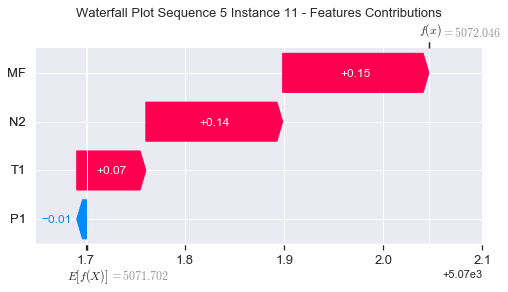

None

Contribution: [-0.00787931  0.07905776  0.13781579  0.15664445]


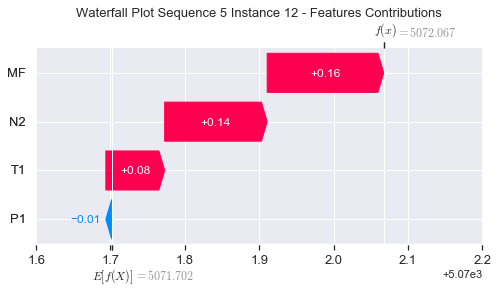

None

Contribution: [-0.0078702   0.07844961  0.13416556  0.15292036]


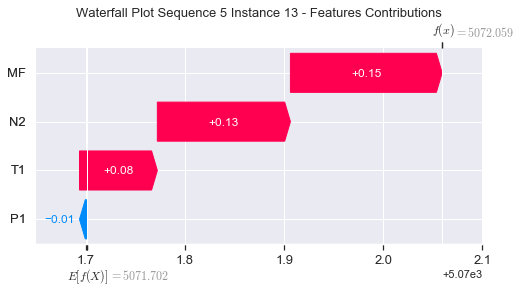

None

Contribution: [-0.00819097  0.07779034  0.13252787  0.15019113]


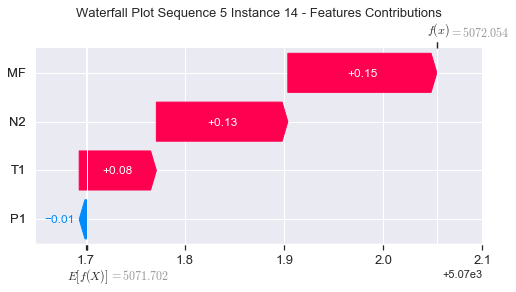

None

Contribution: [-0.00854412  0.07761598  0.1297499   0.14949554]


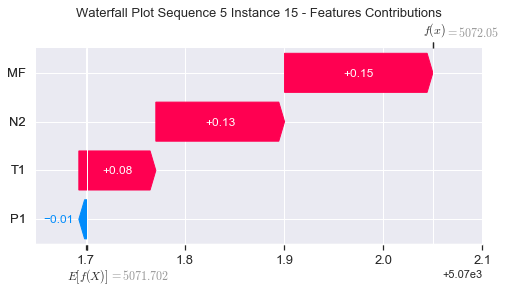

None

Contribution: [-0.02012888  0.07129941  0.11687823  0.1051693 ]


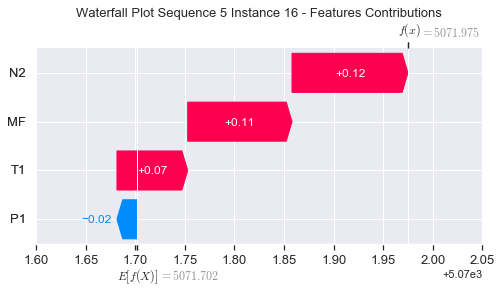

None

Contribution: [-0.00442722  0.07325353  0.12226246  0.13902272]


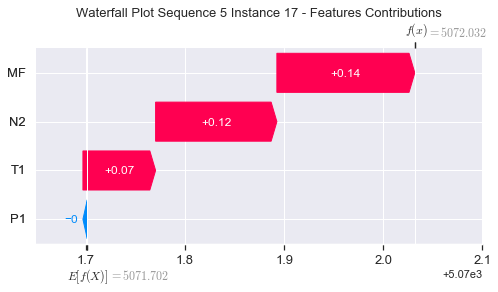

None

Contribution: [0.00697424 0.05926832 0.06898891 0.06847954]


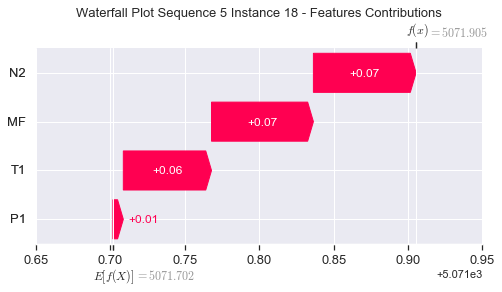

None

Contribution: [0.04003275 0.06491619 0.10872892 0.07060983]


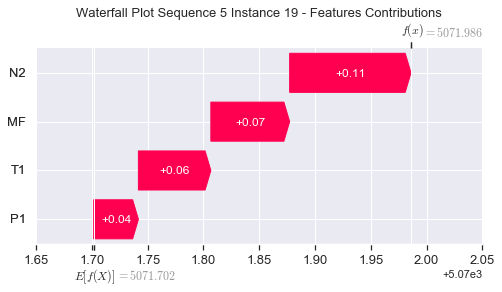

None

Contribution: [-0.09352493  0.15624784  0.51332913  0.68225077]


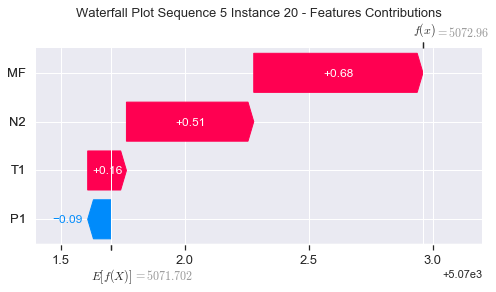

None

Contribution: [-0.14151625 -0.01809177 -0.33118029 -0.24883775]


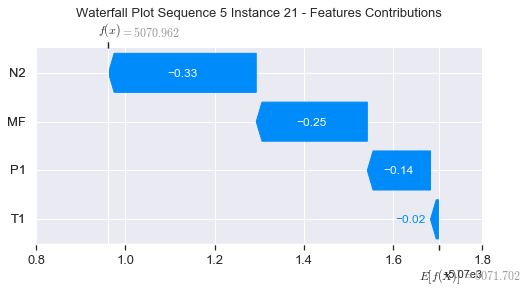

None

Contribution: [ 0.97429095 -0.05057074 -2.81737536 -4.33032685]


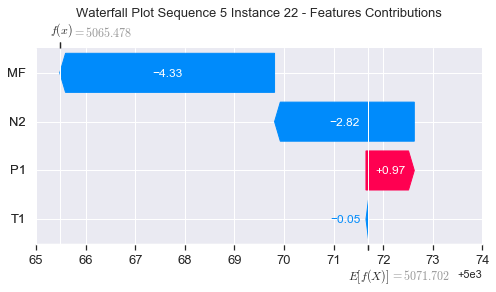

None

Contribution: [0.07472211 1.62598537 3.45915199 3.49933579]


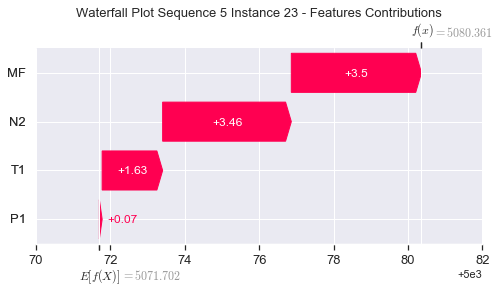

None

Contribution: [ -1.55725518 -28.50255264  18.36113762  29.94486911]


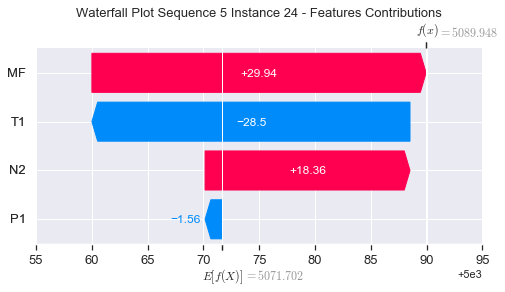

None

Contribution: [ 7.80172601 24.28916426 32.38259115  9.64315605]


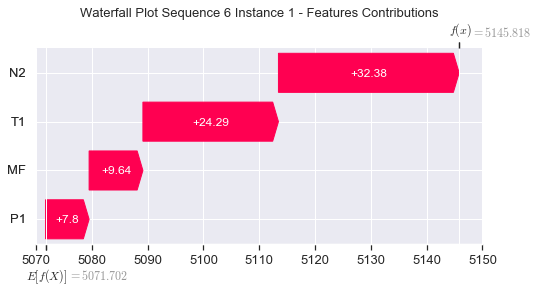

None

Contribution: [0.01338596 0.02314315 0.15582089 0.07957593]


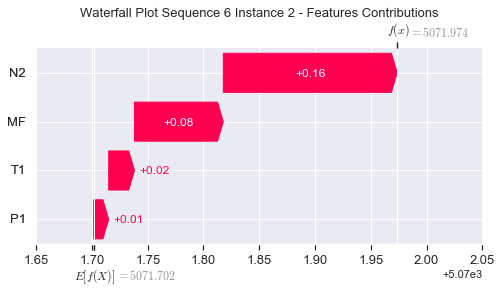

None

Contribution: [-0.0378352   0.03204629  0.1804662   0.24932513]


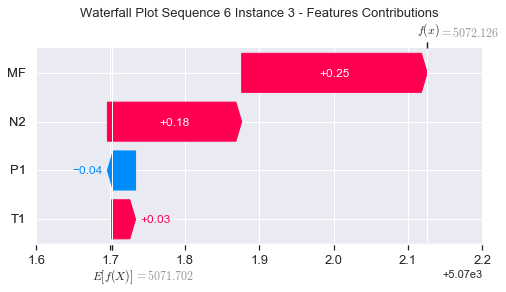

None

Contribution: [-0.05361254  0.01370981  0.07154515  0.12886426]


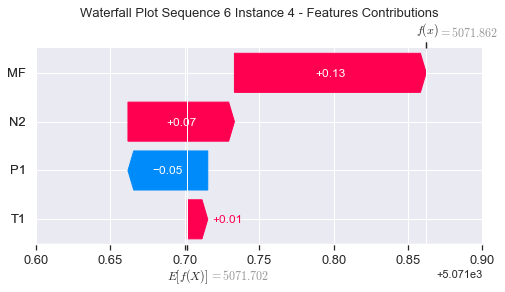

None

Contribution: [-0.01164799  0.03786046  0.15674526  0.18988175]


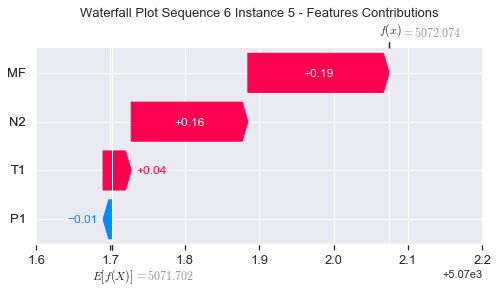

None

Contribution: [0.0018146  0.03206851 0.13043849 0.14613088]


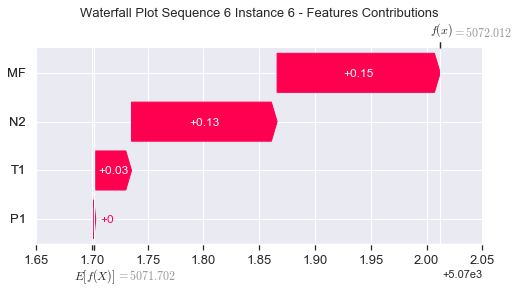

None

Contribution: [0.0089374  0.03768934 0.12833716 0.13426424]


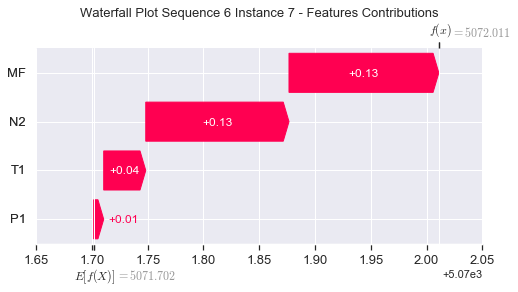

None

Contribution: [0.00336582 0.05714735 0.1398281  0.14926456]


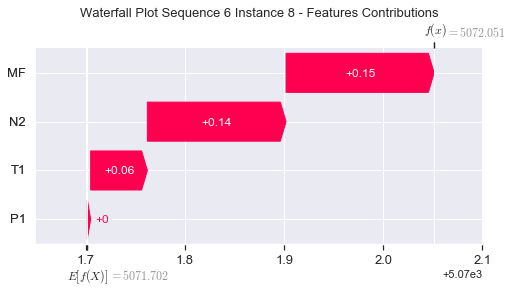

None

Contribution: [-0.00538462  0.07327897  0.14675598  0.16598763]


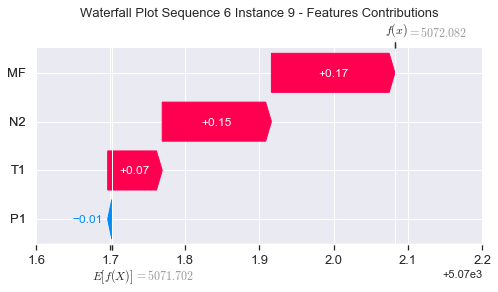

None

Contribution: [-0.0087011   0.07674961  0.14357537  0.15777539]


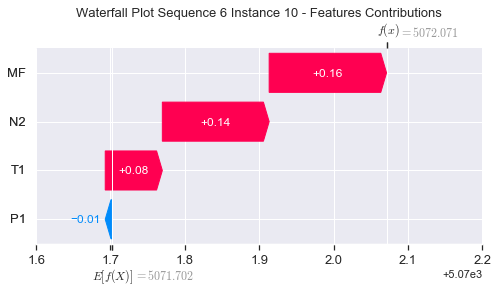

None

Contribution: [-0.01170057  0.07963692  0.13862177  0.1513485 ]


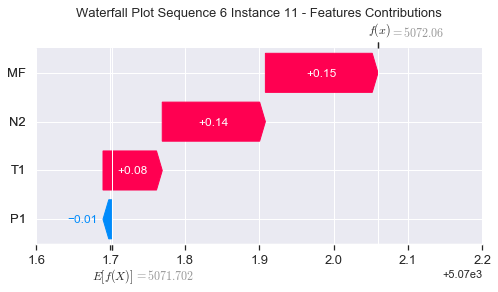

None

Contribution: [-0.00809929  0.08737007  0.13923383  0.15972412]


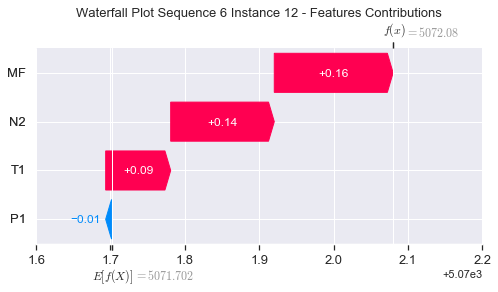

None

Contribution: [-0.00798614  0.08675455  0.13532496  0.15567359]


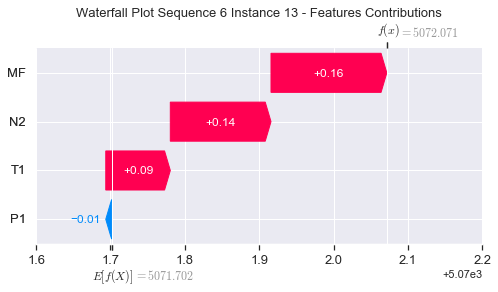

None

Contribution: [-0.00853693  0.08415171  0.13474098  0.15471821]


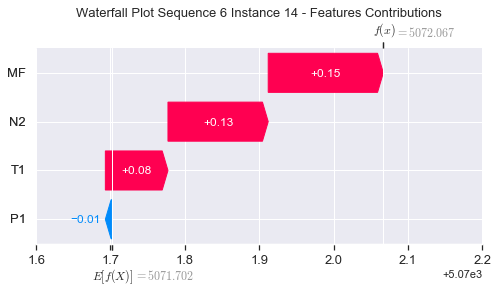

None

Contribution: [-0.00871998  0.08730581  0.13131239  0.1534657 ]


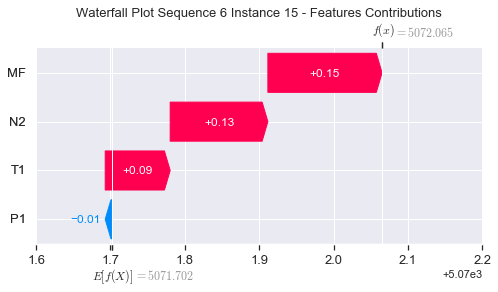

None

Contribution: [-0.02209013  0.08466456  0.11899879  0.11916206]


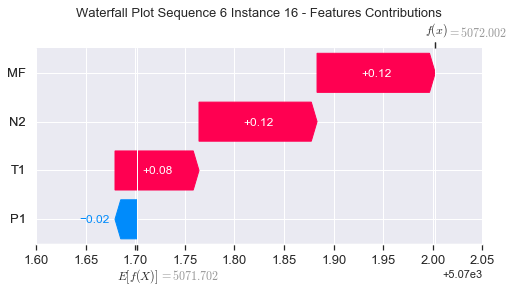

None

Contribution: [-0.00444262  0.0850201   0.1220016   0.14049154]


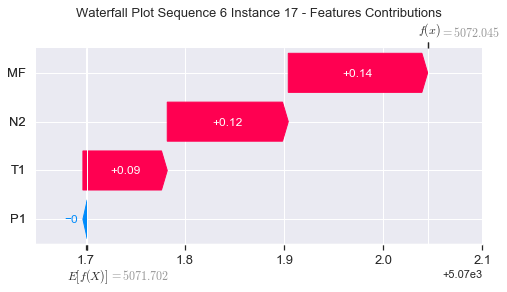

None

Contribution: [0.00765617 0.07544743 0.06601771 0.06679869]


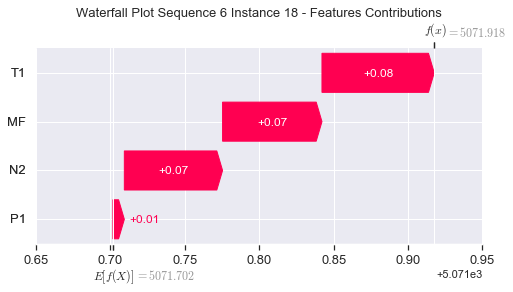

None

Contribution: [0.04068009 0.08188801 0.10955001 0.07283264]


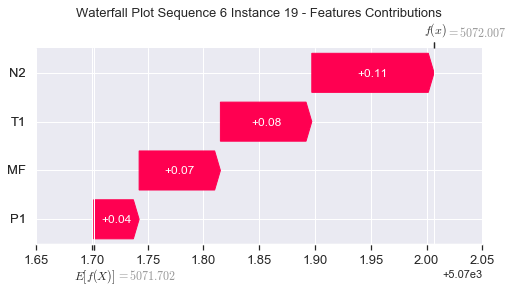

None

Contribution: [-0.09704839  0.15273858  0.5283628   0.70164038]


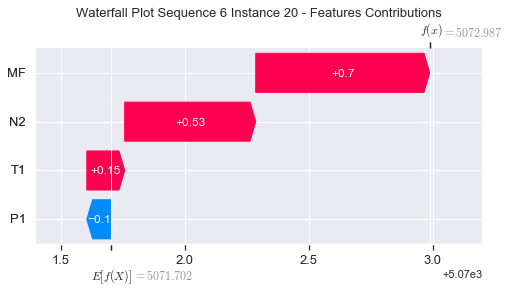

None

Contribution: [-0.140158   -0.00872241 -0.35943179 -0.27411355]


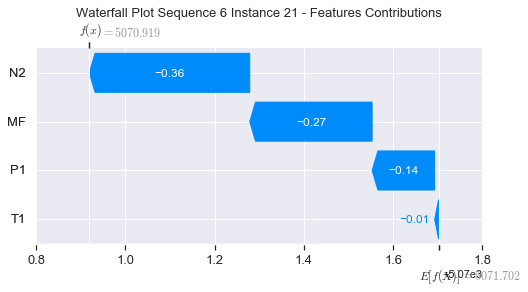

None

Contribution: [ 0.96455816  0.45266339 -2.9085982  -4.38215082]


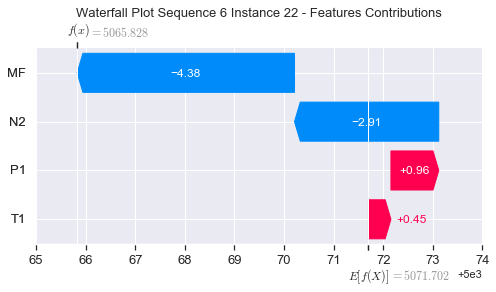

None

Contribution: [-0.0430917   2.14448872  3.55594686  3.6106735 ]


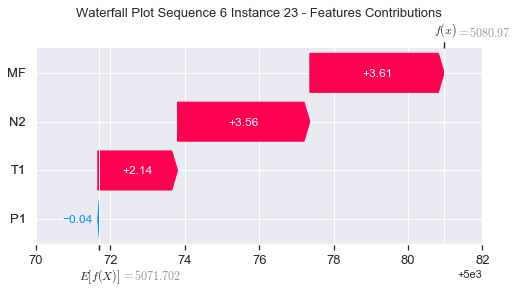

None

Contribution: [ -0.25736307 -42.8081238   18.98708626  27.42824178]


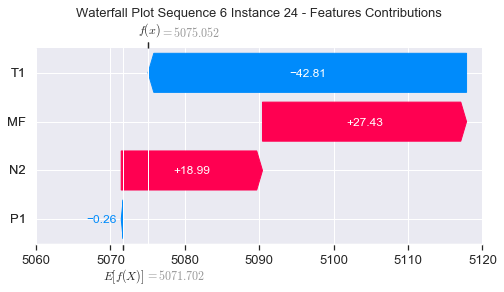

None

Contribution: [ 6.9919962  30.56558113 33.11088196  9.41460927]


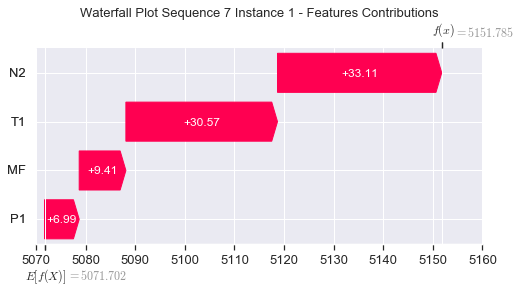

None

Contribution: [0.01401892 0.01187008 0.16281143 0.08267638]


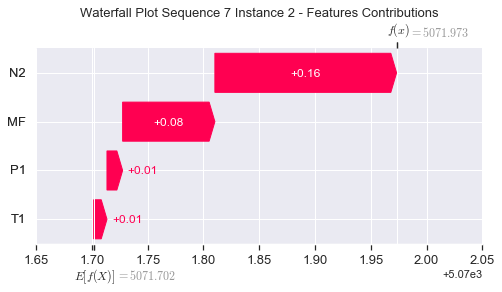

None

Contribution: [-0.03808823  0.02297202  0.18464799  0.25469233]


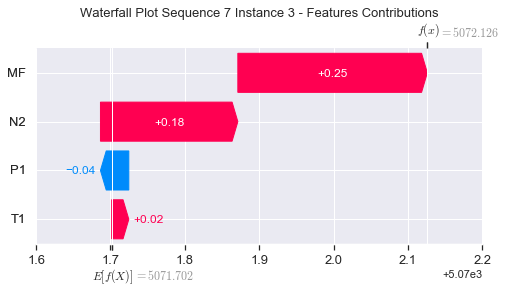

None

Contribution: [-0.05420434  0.00709079  0.0734727   0.13340246]


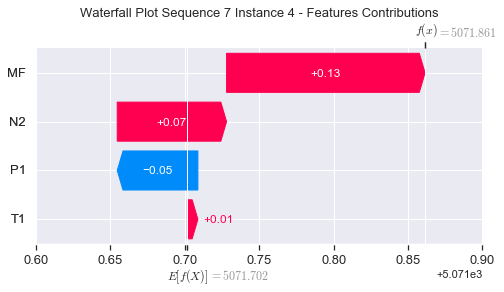

None

Contribution: [-0.01182383  0.0316258   0.15916448  0.19379695]


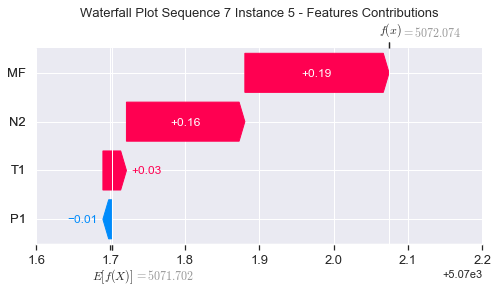

None

Contribution: [0.00179802 0.02996976 0.13157313 0.14761705]


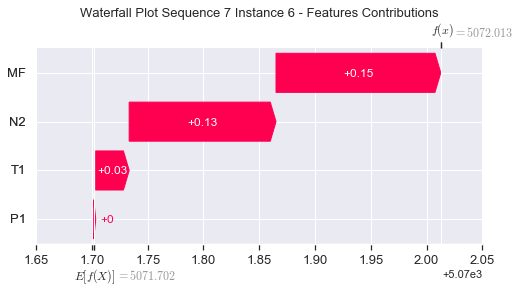

None

Contribution: [0.0085226  0.03913456 0.13035559 0.13657667]


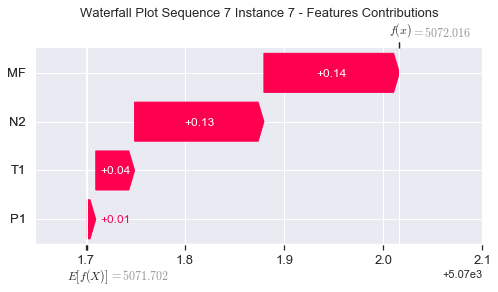

None

Contribution: [0.00252028 0.06292015 0.14274994 0.15246861]


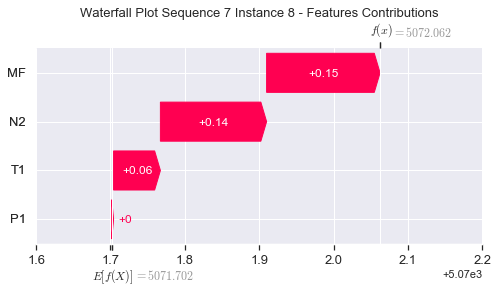

None

Contribution: [-0.00634188  0.07780284  0.14962775  0.16671771]


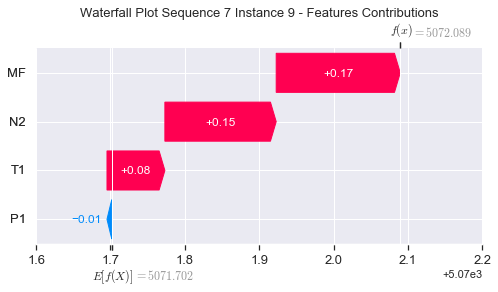

None

Contribution: [-0.00809511  0.08288676  0.14646448  0.16161027]


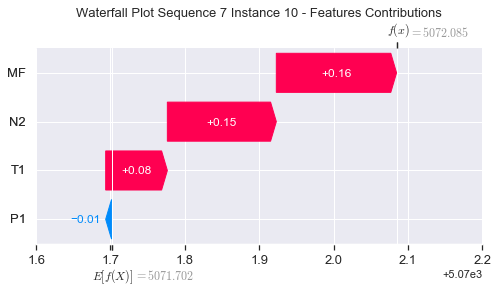

None

Contribution: [-0.01167125  0.08701259  0.14176963  0.15418528]


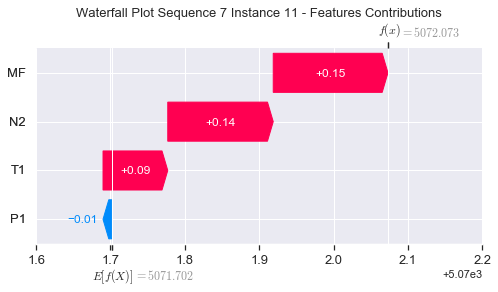

None

Contribution: [-0.00873656  0.09411251  0.14079185  0.1611352 ]


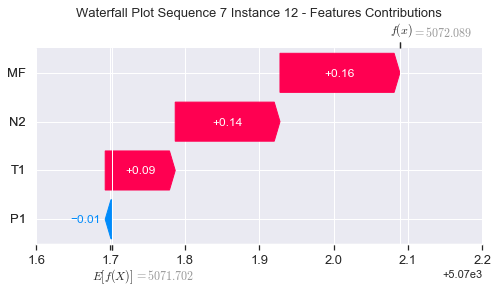

None

Contribution: [-0.00860925  0.09313379  0.13674803  0.15663505]


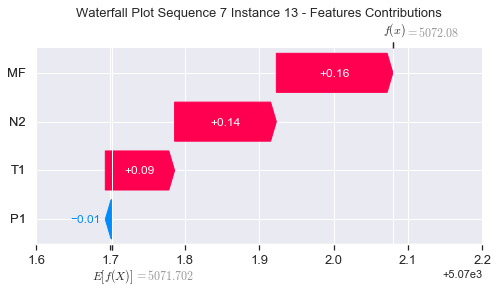

None

Contribution: [-0.00915572  0.08816402  0.13566787  0.15609708]


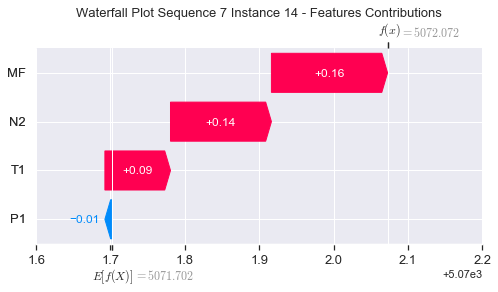

None

Contribution: [-0.00927726  0.09342612  0.13228126  0.15416233]


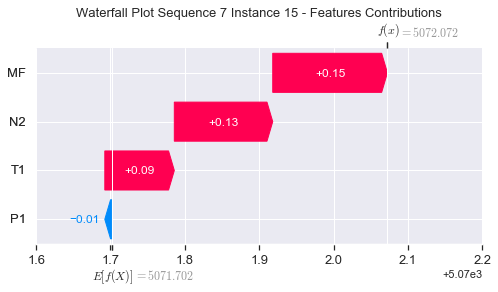

None

Contribution: [-0.0211575   0.08824798  0.11919249  0.11522209]


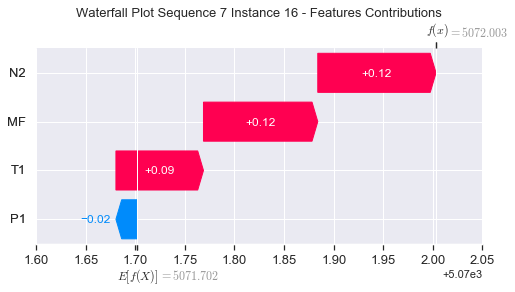

None

Contribution: [-0.00516905  0.08833126  0.12406498  0.14255617]


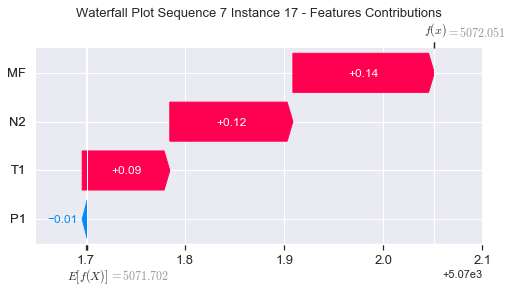

None

Contribution: [0.00575521 0.07869944 0.06989757 0.07224737]


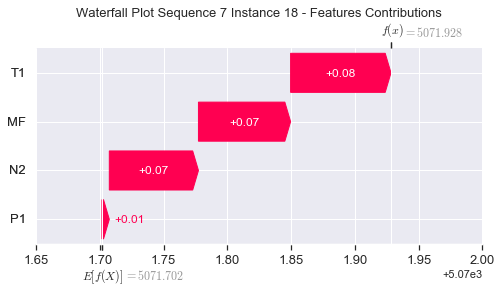

None

Contribution: [0.04116375 0.08407516 0.10614042 0.06772451]


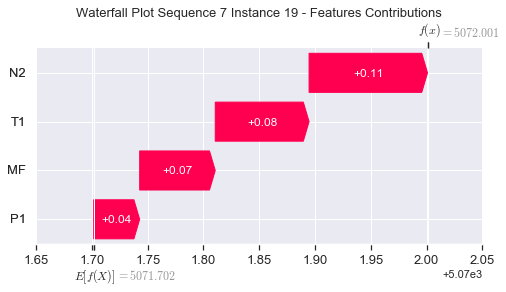

None

Contribution: [-0.09178099  0.15205424  0.51755274  0.68509483]


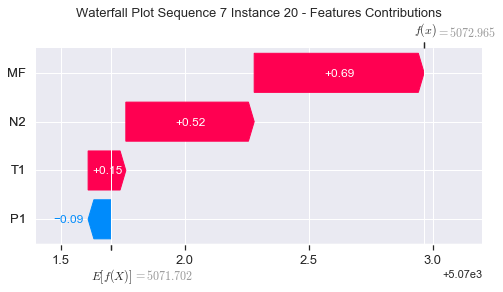

None

Contribution: [-0.14036783 -0.00448269 -0.33124901 -0.2405975 ]


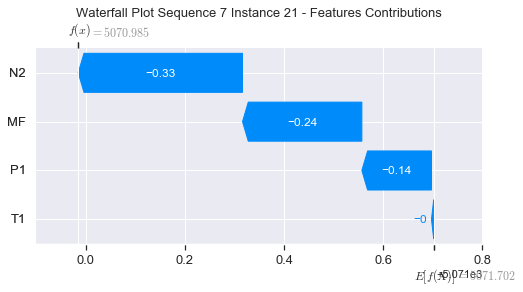

None

Contribution: [ 0.93889533  0.39364869 -2.85204904 -4.28847131]


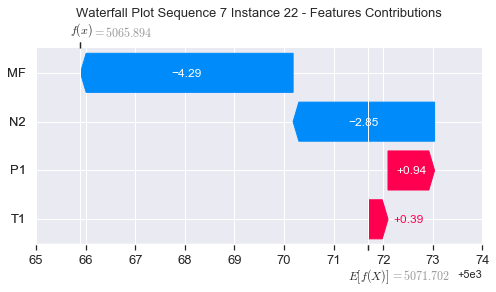

None

Contribution: [-0.0756576   2.16155405  3.4774687   3.51450223]


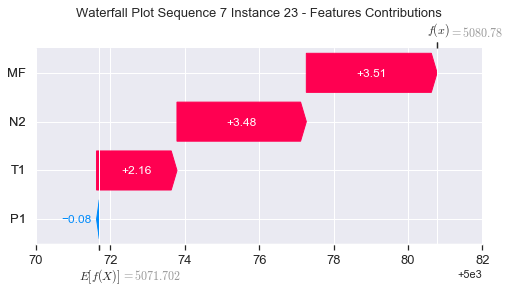

None

Contribution: [ -0.12421285 -41.8440291   18.51782686  26.39031379]


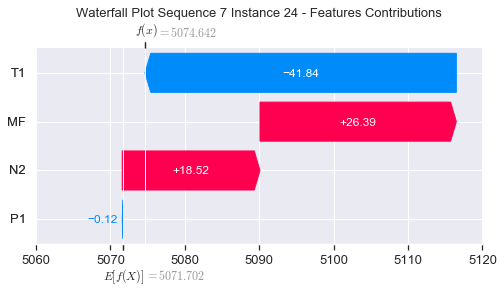

None

Contribution: [ 6.72277426 29.10382771 32.89559098  9.48612221]


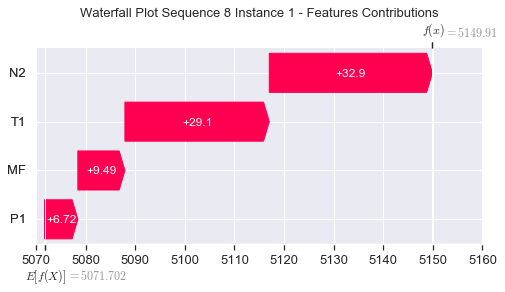

None

Contribution: [0.01441787 0.01691921 0.16435945 0.08381669]


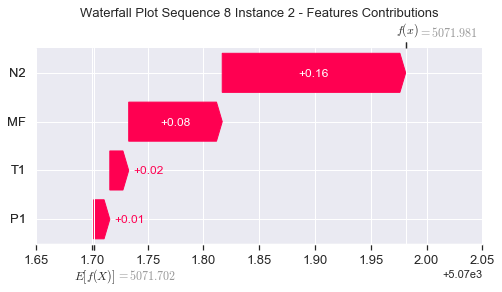

None

Contribution: [-0.0372676   0.01947006  0.18753169  0.2573947 ]


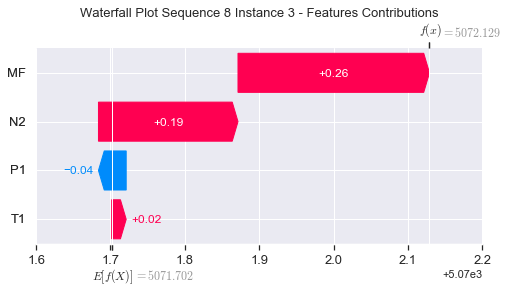

None

Contribution: [-0.05338691  0.00710561  0.07255844  0.13222379]


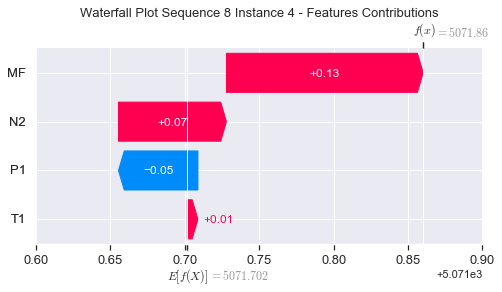

None

Contribution: [-0.01070238  0.03082191  0.15767583  0.18397102]


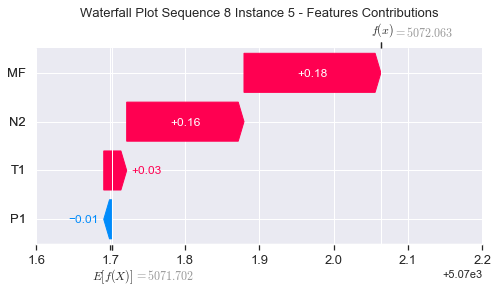

None

Contribution: [0.00214018 0.02997922 0.13016602 0.14459177]


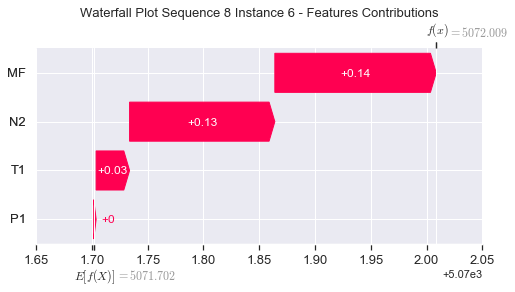

None

Contribution: [0.00879894 0.03659933 0.12833537 0.13431783]


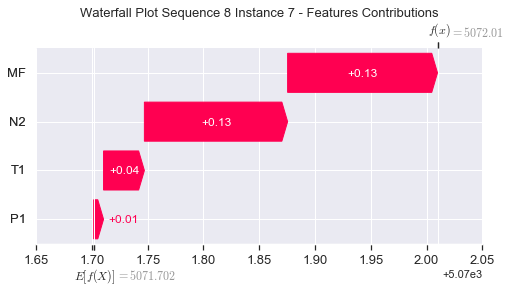

None

Contribution: [0.00264309 0.05606013 0.14061779 0.15178181]


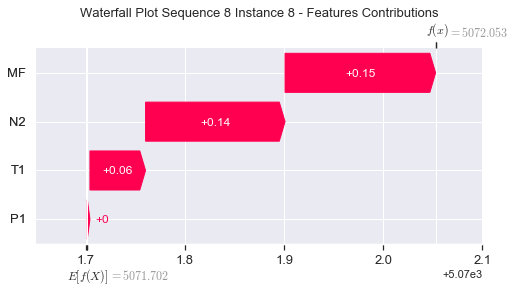

None

Contribution: [-0.00590323  0.07193034  0.14664852  0.16353423]


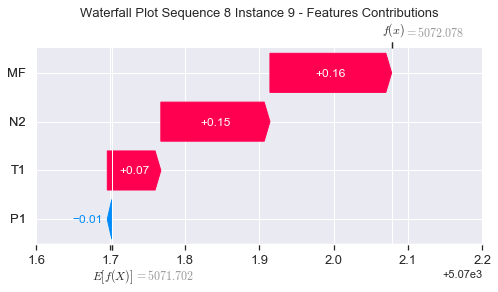

None

Contribution: [-0.00982673  0.08251665  0.1443148   0.16667619]


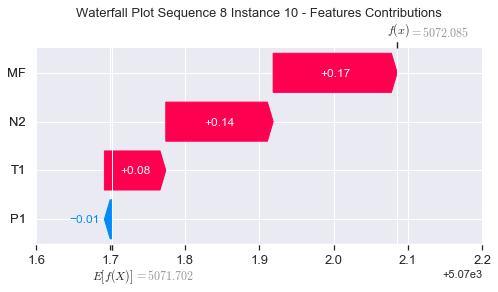

None

Contribution: [-0.01005277  0.07057959  0.13719921  0.14419053]


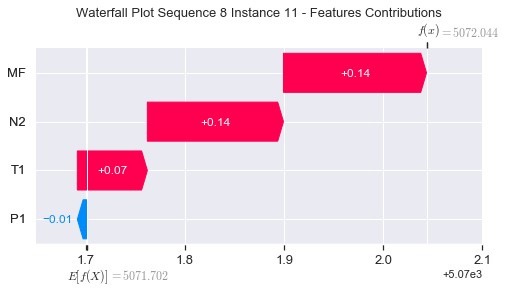

None

Contribution: [-0.00749831  0.0736717   0.13762107  0.15642334]


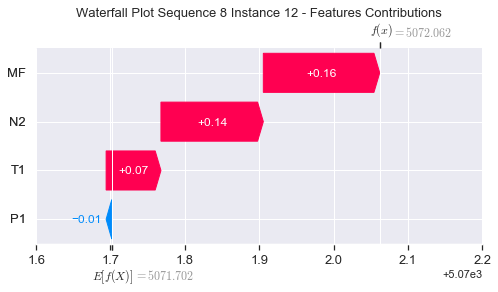

None

Contribution: [-0.00774875  0.07434634  0.13417945  0.15398376]


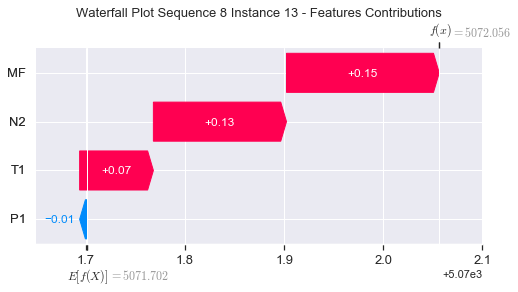

None

Contribution: [-0.00824166  0.07451271  0.13279085  0.14980263]


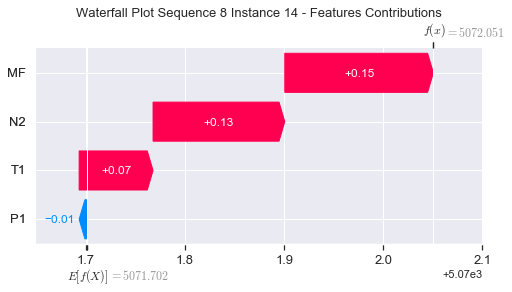

None

Contribution: [-0.00823948  0.07346719  0.12950356  0.14946352]


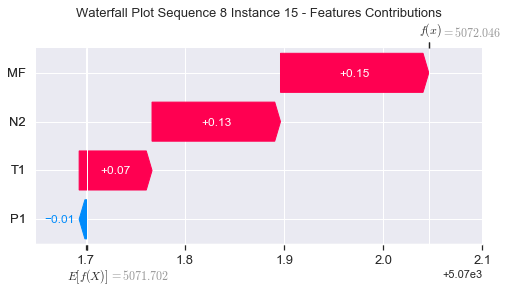

None

Contribution: [-0.01970401  0.06814405  0.117327    0.11185088]


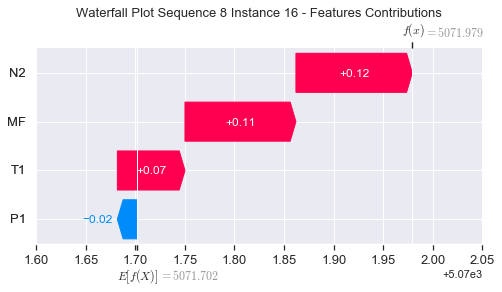

None

Contribution: [-0.00412948  0.06813386  0.12229622  0.13782652]


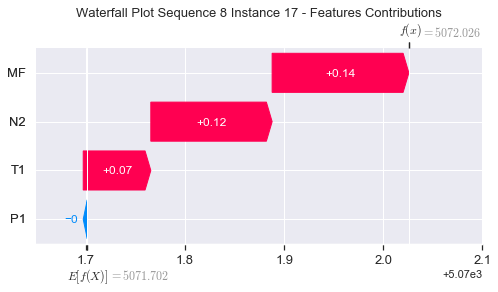

None

Contribution: [0.00690548 0.05268915 0.07063185 0.06904557]


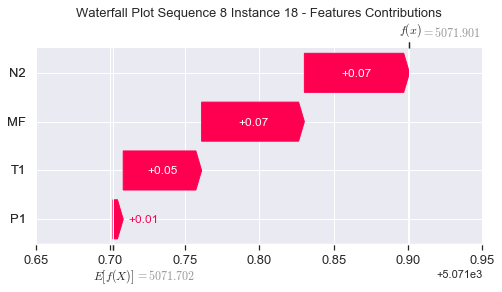

None

Contribution: [0.04102407 0.06088706 0.10399018 0.06708262]


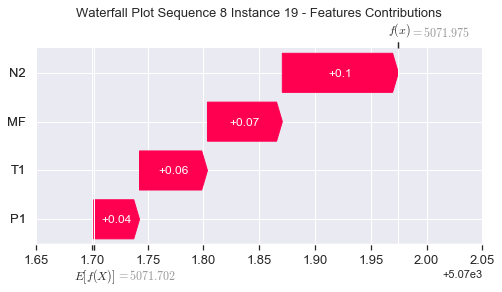

None

Contribution: [-0.08997942  0.15544726  0.50241295  0.66465957]


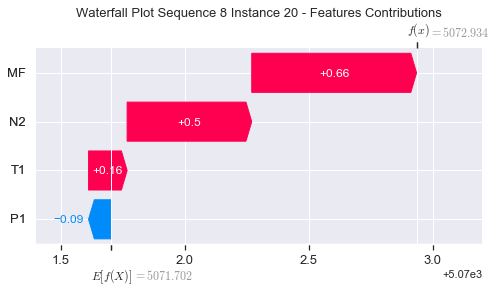

None

Contribution: [-0.14458433 -0.01903871 -0.30704783 -0.21769082]


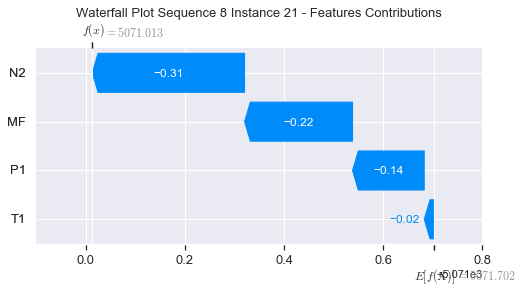

None

Contribution: [ 0.98228632 -0.27283829 -2.77918974 -4.20174838]


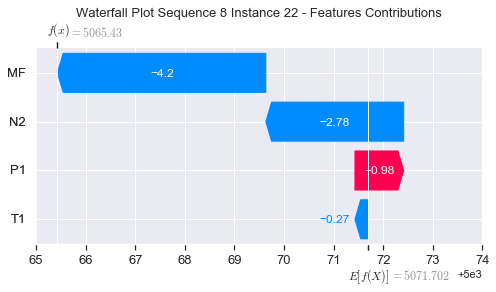

None

Contribution: [0.24403668 1.38112541 3.3810709  3.37095158]


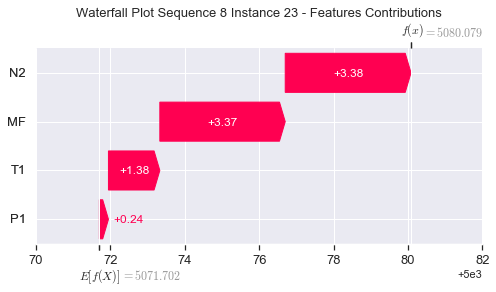

None

Contribution: [ -2.29770826 -22.54721164  18.62385109  27.40545067]


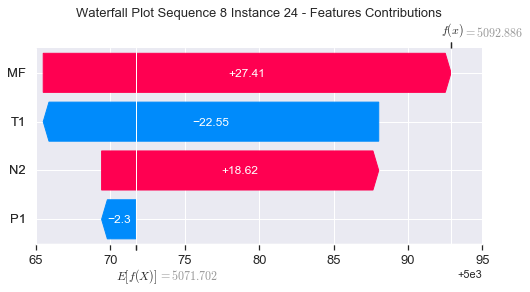

None

Contribution: [ 7.65985656 21.13600965 32.19832708  9.15886692]


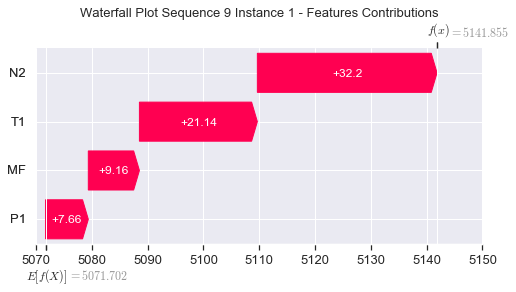

None

Contribution: [0.01420881 0.03453692 0.15595992 0.07893769]


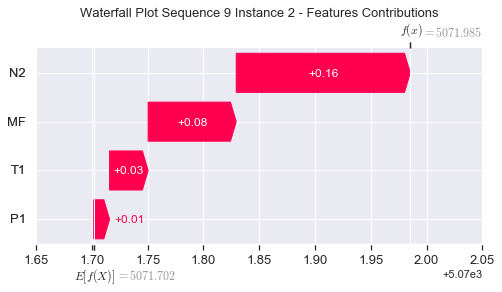

None

Contribution: [-0.03764851  0.03138868  0.18200954  0.24855924]


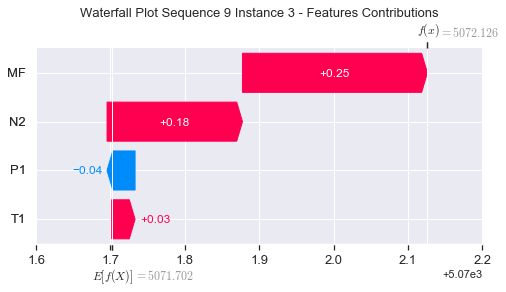

None

Contribution: [-0.05283669  0.01896285  0.06910803  0.1250803 ]


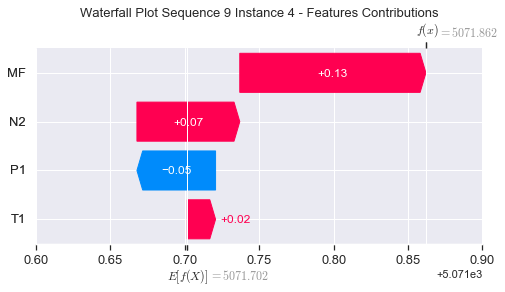

None

Contribution: [-0.01113438  0.03949545  0.15443661  0.18756705]


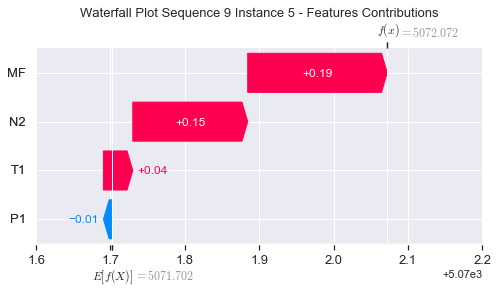

None

Contribution: [0.00222142 0.03218593 0.12841299 0.14340355]


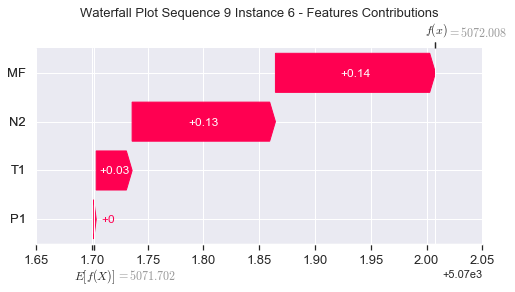

None

Contribution: [0.00949015 0.03535284 0.1256063  0.13062451]


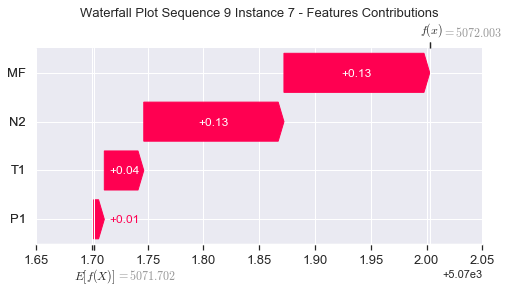

None

Contribution: [0.00442666 0.05084971 0.13676004 0.14459228]


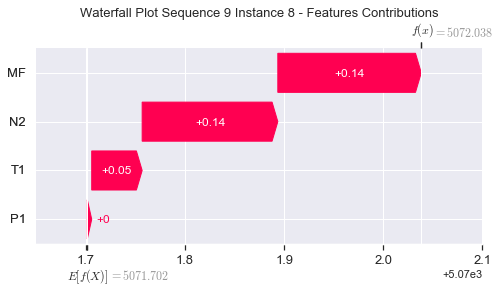

None

Contribution: [-0.00306375  0.0606333   0.14359724  0.16011817]


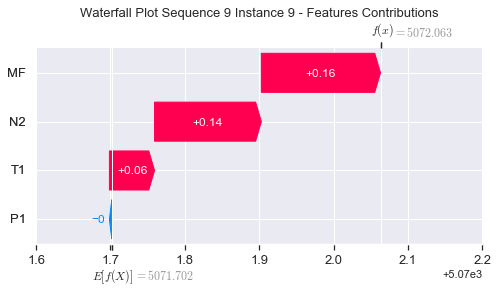

None

Contribution: [-0.00658576  0.06407466  0.14056199  0.15005826]


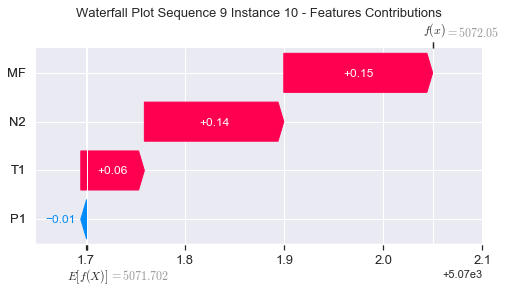

None

Contribution: [-0.00981532  0.06414206  0.13589519  0.14409485]


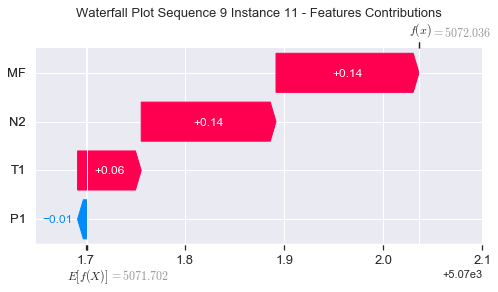

None

Contribution: [-0.00721518  0.07407564  0.13599901  0.1547831 ]


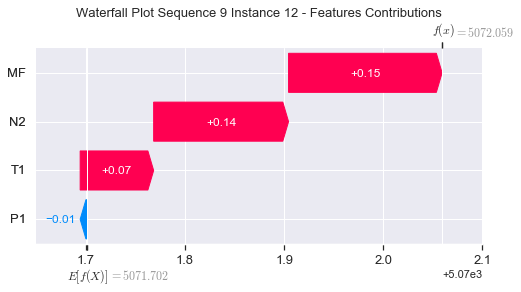

None

Contribution: [-0.00718877  0.07305129  0.13237159  0.15102457]


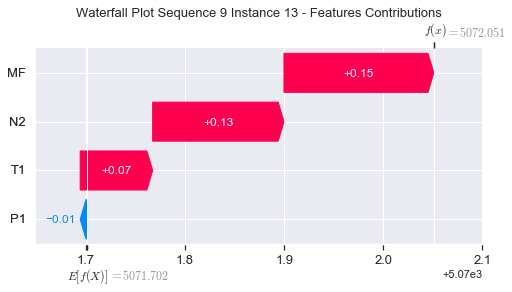

None

Contribution: [-0.00744016  0.07487665  0.13097095  0.14573874]


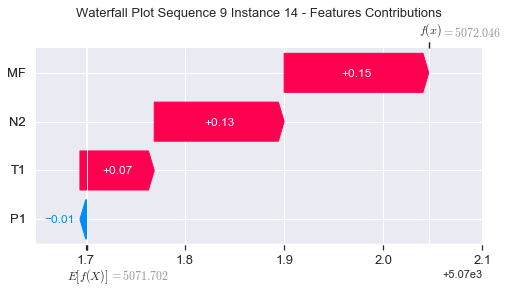

None

Contribution: [-0.00791809  0.07345171  0.12855955  0.1484971 ]


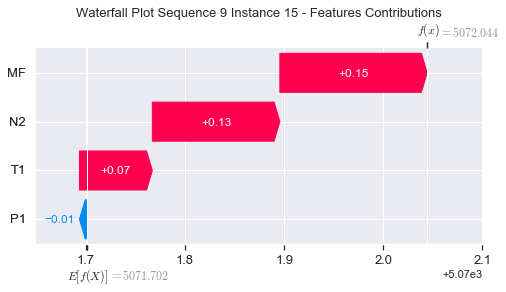

None

Contribution: [-0.02034352  0.07174782  0.11622306  0.10872728]


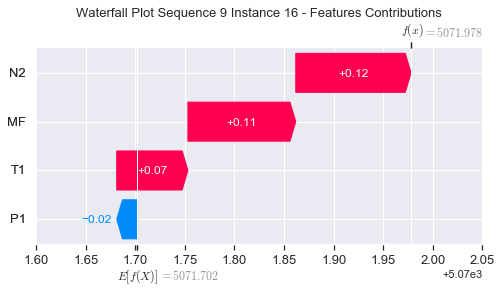

None

Contribution: [-0.00370042  0.0695534   0.12038265  0.13737127]


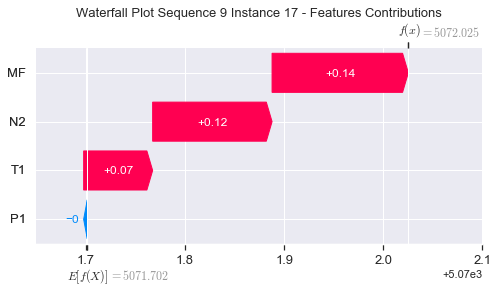

None

Contribution: [0.00864696 0.0566123  0.06569707 0.06429314]


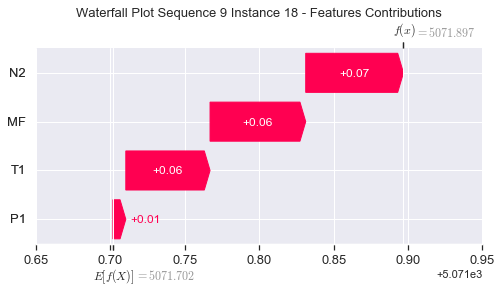

None

Contribution: [0.04153335 0.05670956 0.10786189 0.06567661]


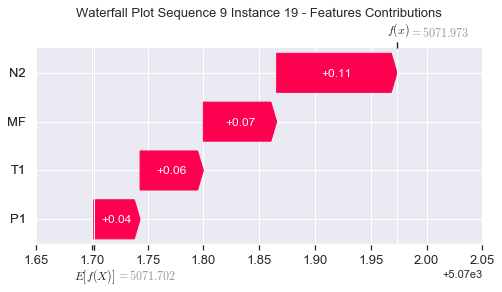

None

Contribution: [-0.09811119  0.15849071  0.51913688  0.69174813]


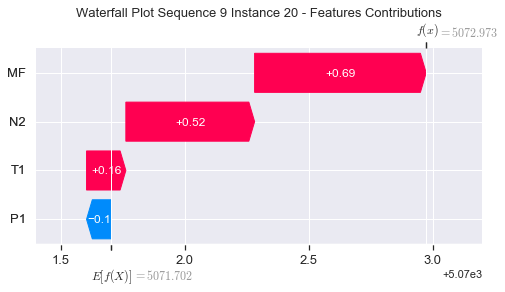

None

Contribution: [-0.14601467 -0.02339439 -0.34791248 -0.27037305]


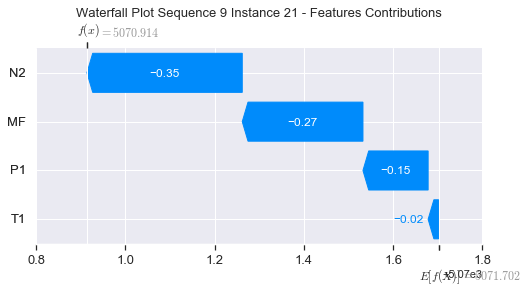

None

Contribution: [ 1.05327301 -0.07627523 -2.87343249 -4.47850899]


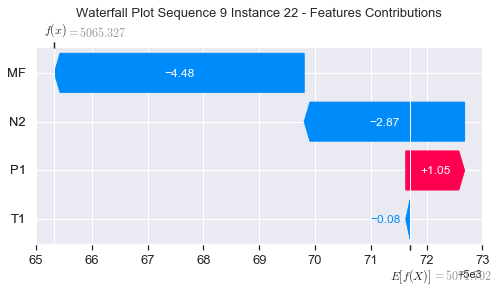

None

Contribution: [0.25839337 1.61482473 3.51212982 3.55181874]


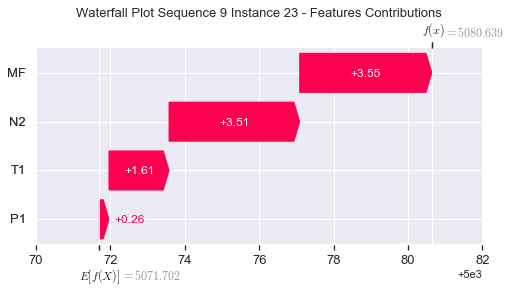

None

Contribution: [ -3.48869667 -29.26810368  19.04810501  32.27964252]


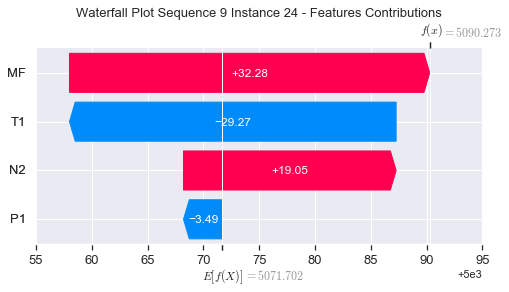

None

Contribution: [ 9.18169041 24.80383579 32.36151176  9.56843221]


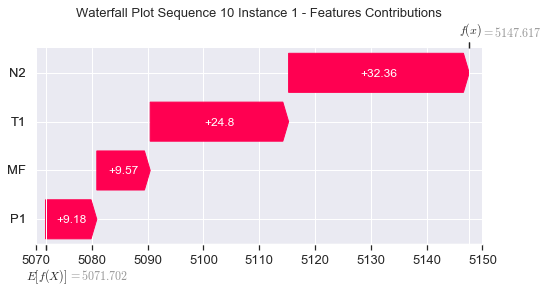

None

Contribution: [0.01614974 0.02358317 0.15598182 0.08205703]


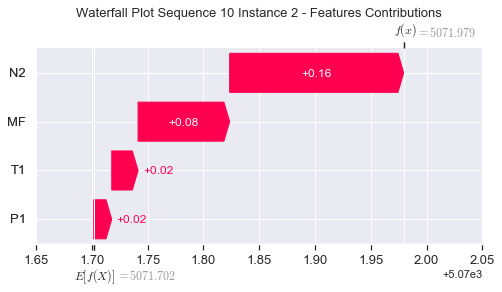

None

Contribution: [-0.0379765   0.03134048  0.18000929  0.24920063]


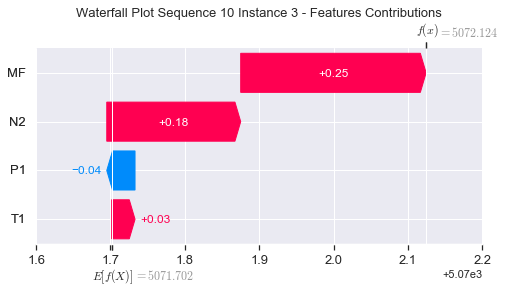

None

Contribution: [-0.05376323  0.01409894  0.07123748  0.1282469 ]


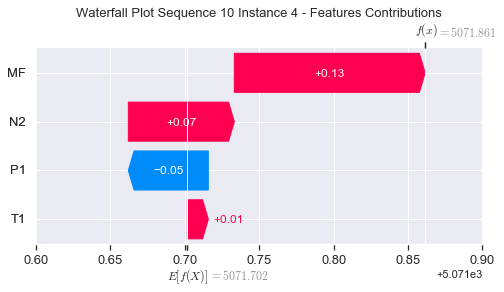

None

Contribution: [-0.01197284  0.04108723  0.15541721  0.18931205]


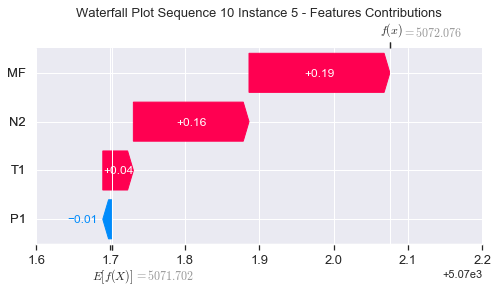

None

Contribution: [0.00214901 0.03172291 0.12983263 0.14608407]


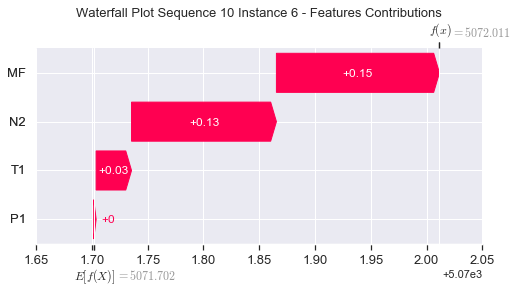

None

Contribution: [0.01015054 0.03746087 0.12775425 0.13298343]


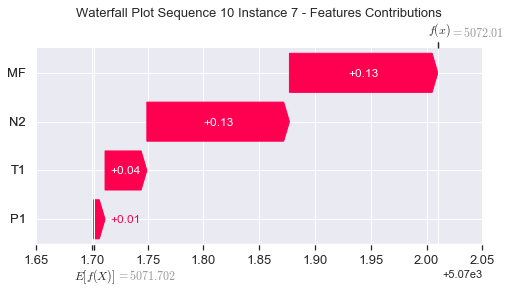

None

Contribution: [0.00639068 0.05572613 0.13879002 0.14480093]


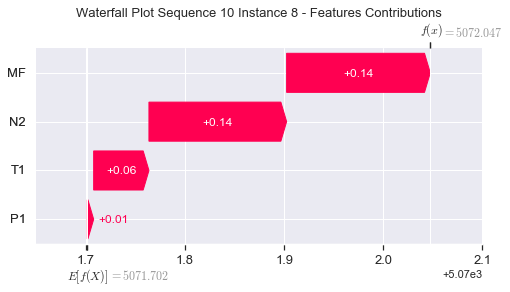

None

Contribution: [-0.00053848  0.06292513  0.14466527  0.15396047]


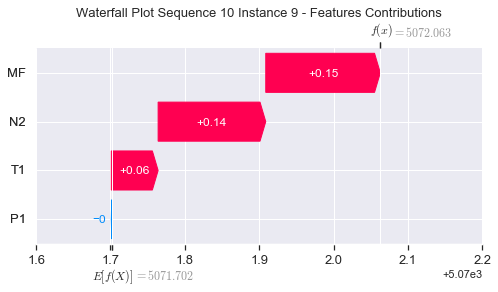

None

Contribution: [-0.00504941  0.06405357  0.14122785  0.14839366]


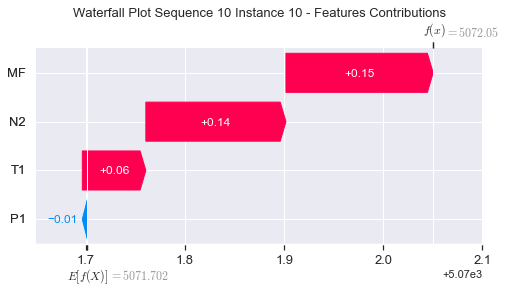

None

Contribution: [-0.00741034  0.05813754  0.13503031  0.12914689]


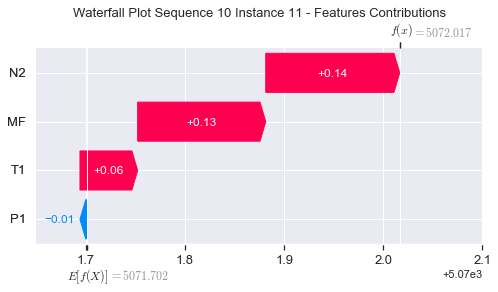

None

Contribution: [-0.00653085  0.08375015  0.13614774  0.14812677]


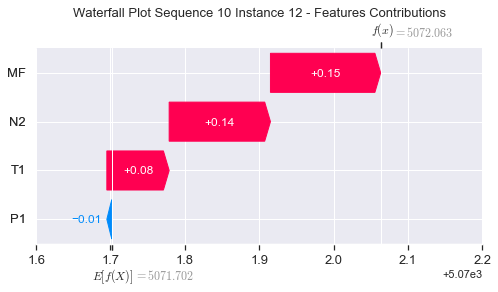

None

Contribution: [-0.00661361  0.08342738  0.13265213  0.14608622]


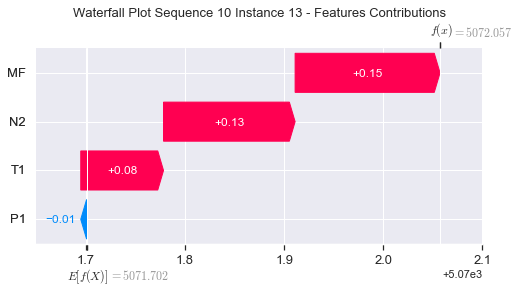

None

Contribution: [-0.00701348  0.07371736  0.13220789  0.1483574 ]


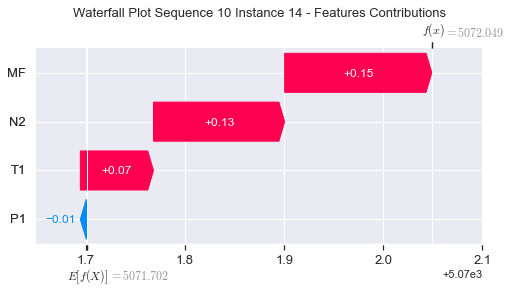

None

Contribution: [-0.00752701  0.08492595  0.12958182  0.14523072]


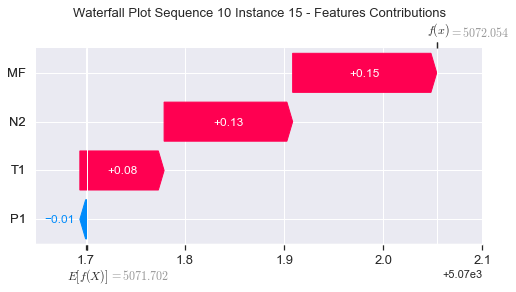

None

Contribution: [-0.02166353  0.1071691   0.11713221  0.10822064]


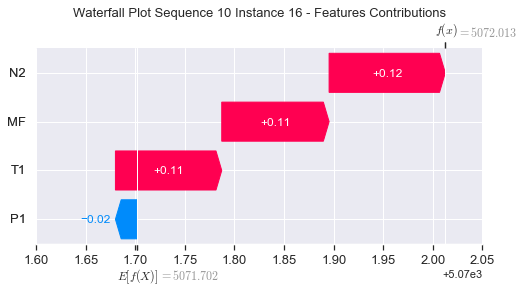

None

Contribution: [-0.00271027  0.08488228  0.12086768  0.13388556]


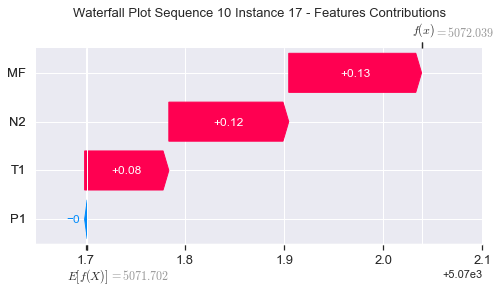

None

Contribution: [0.0100201  0.07627232 0.06539242 0.0593437 ]


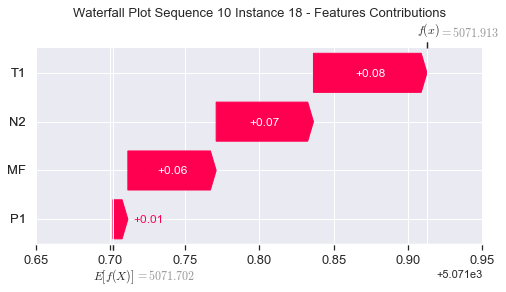

None

Contribution: [0.04446897 0.10296163 0.10553407 0.05891396]


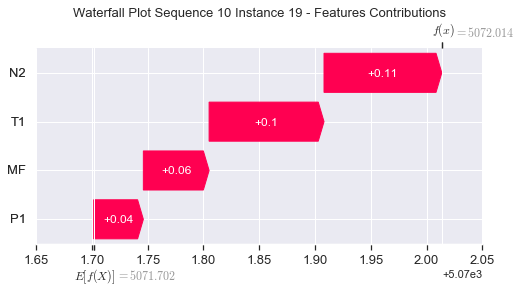

None

Contribution: [-0.10114836  0.14658071  0.52395735  0.69939058]


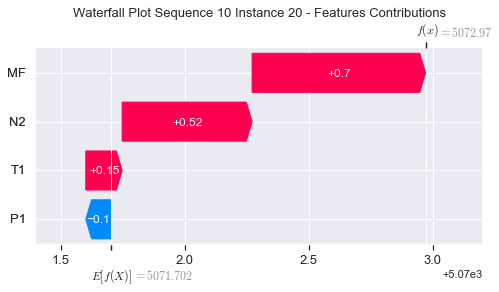

None

Contribution: [-0.15813564 -0.00922363 -0.34439361 -0.26399033]


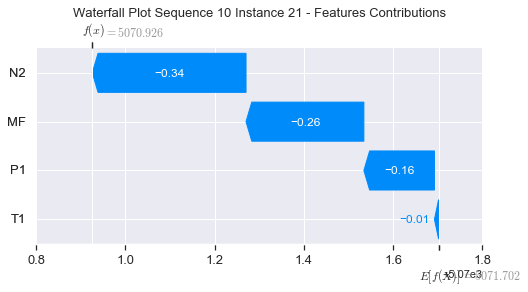

None

Contribution: [ 1.15866806  0.31418345 -2.89794516 -4.55661578]


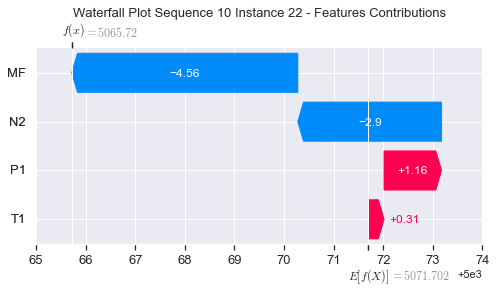

None

Contribution: [0.59778472 2.14744709 3.51292186 3.51365803]


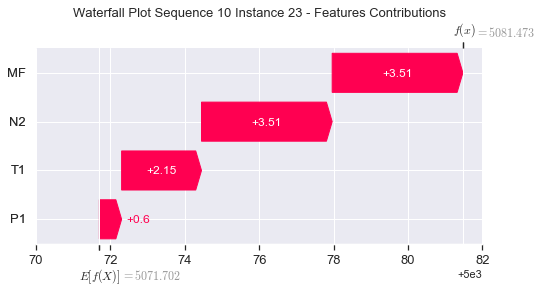

None

Contribution: [ -6.03940547 -38.25638663  18.92243049  31.73719713]


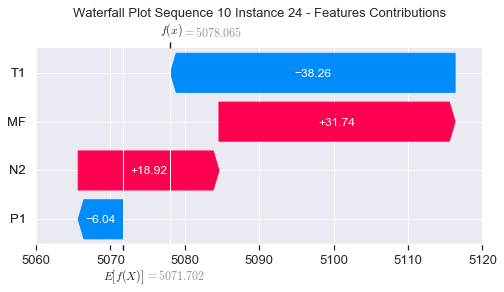

None

Contribution: [ 9.08809546 23.75379373 31.9253021   9.16406927]


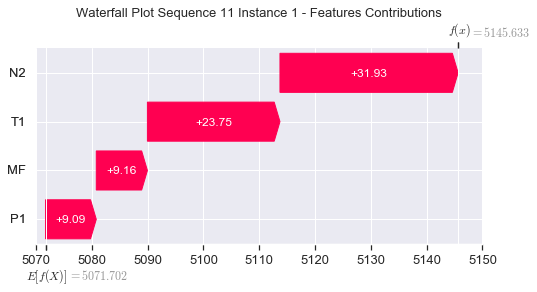

None

Contribution: [0.01992246 0.01911877 0.15986298 0.08481802]


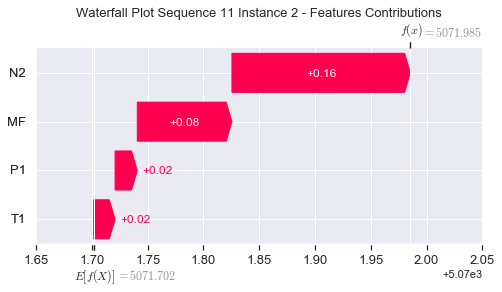

None

Contribution: [-0.03749654  0.03146035  0.18389297  0.25419359]


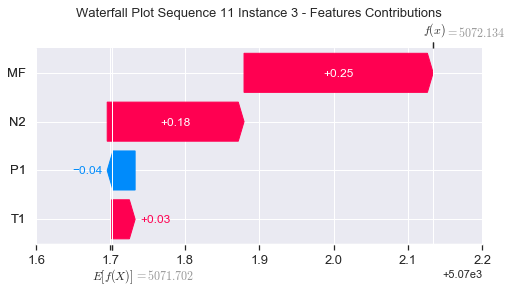

None

Contribution: [-0.05358003  0.01928817  0.06879942  0.12830833]


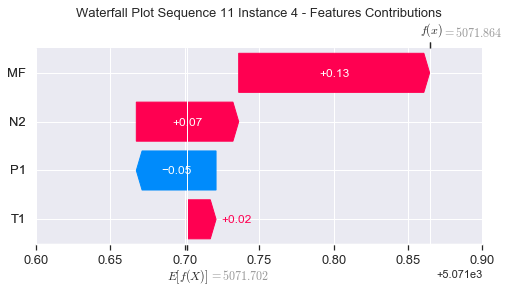

None

Contribution: [-0.01133875  0.04147528  0.15312251  0.18725748]


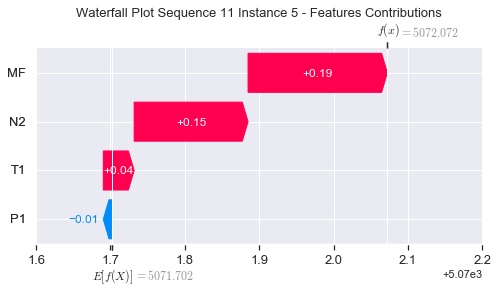

None

Contribution: [0.00329929 0.0328245  0.12739683 0.14253789]


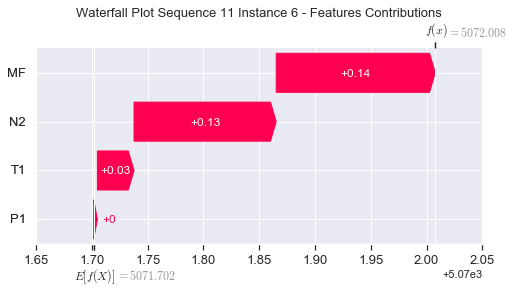

None

Contribution: [0.01219138 0.03340188 0.12512956 0.12922279]


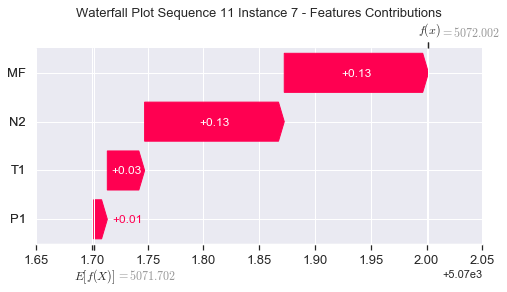

None

Contribution: [0.00885783 0.0441632  0.13597806 0.14151211]


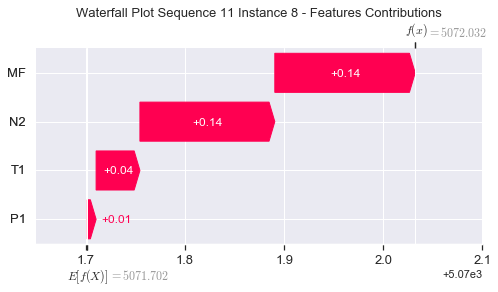

None

Contribution: [-0.00067534  0.0515522   0.14253769  0.15971781]


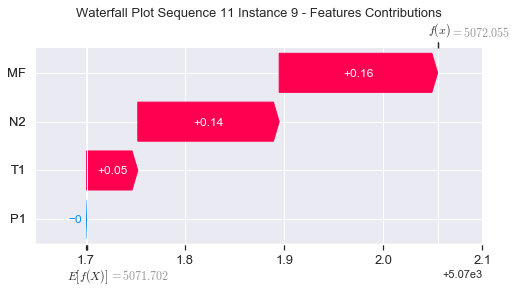

None

Contribution: [-0.00371389  0.05389964  0.13971162  0.1539016 ]


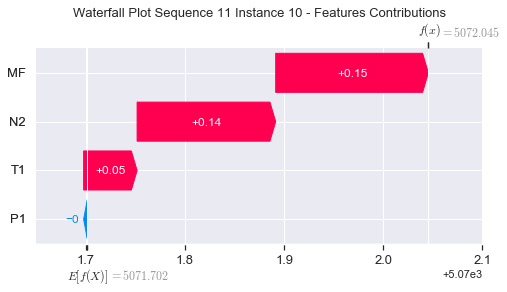

None

Contribution: [-0.00688843  0.05356776  0.13435107  0.14201171]


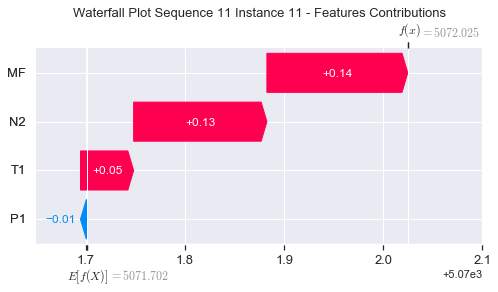

None

Contribution: [-0.00530077  0.05911291  0.1340131   0.14782386]


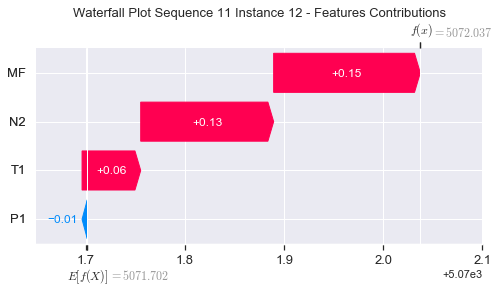

None

Contribution: [-0.00559896  0.05757786  0.13075344  0.14487975]


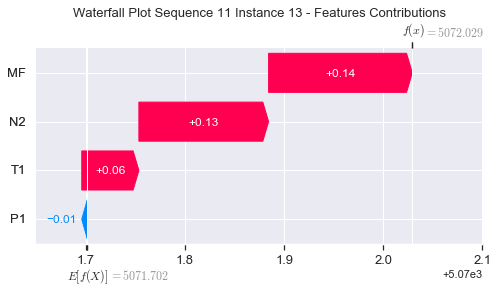

None

Contribution: [-0.00627607  0.05625512  0.12985466  0.14373471]


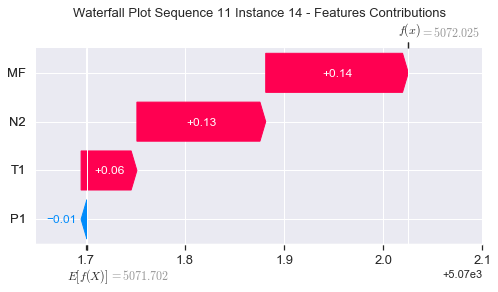

None

Contribution: [-0.00629588  0.05626763  0.12672687  0.14151684]


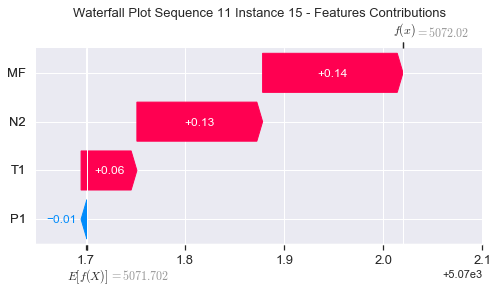

None

Contribution: [-0.01604528  0.05256943  0.11593787  0.10334668]


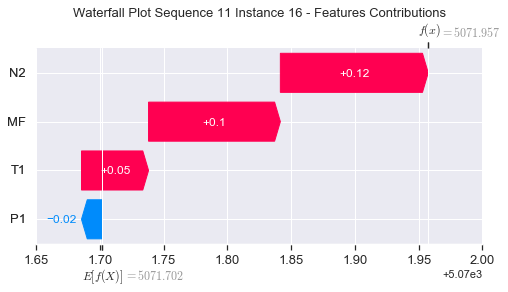

None

Contribution: [-0.00239066  0.05023989  0.12103842  0.13364757]


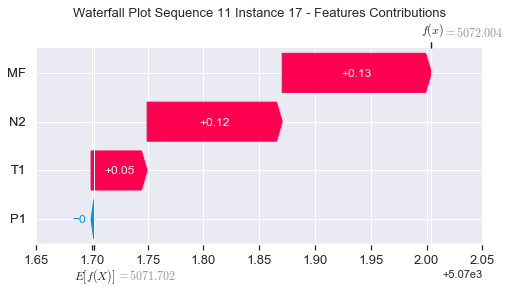

None

Contribution: [0.00962279 0.03350054 0.07033837 0.06436036]


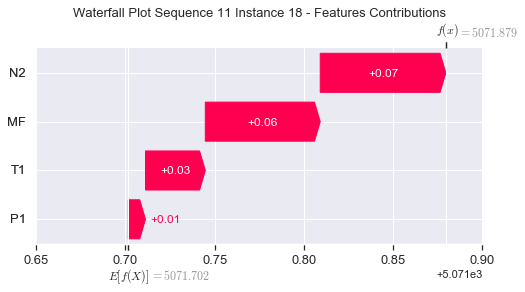

None

Contribution: [0.04644583 0.03294206 0.10278811 0.05144324]


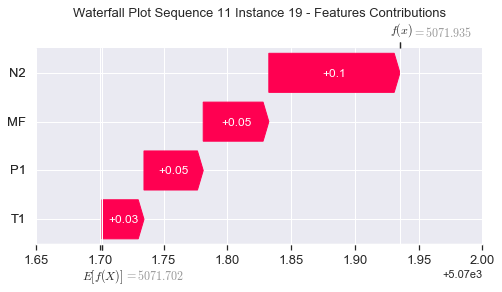

None

Contribution: [-0.09492121  0.1599133   0.49344016  0.65941477]


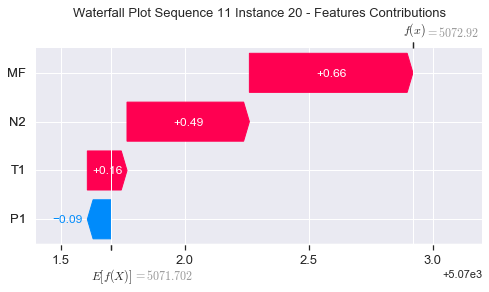

None

Contribution: [-0.15581469 -0.0376467  -0.29775597 -0.22522404]


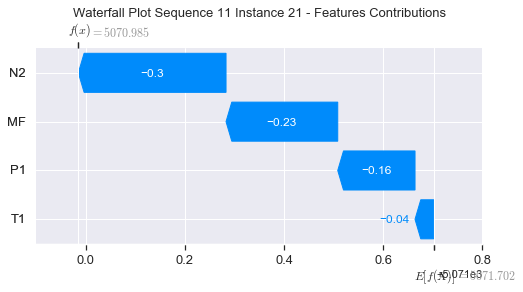

None

Contribution: [ 1.14482186 -0.70228686 -2.71954009 -4.41265247]


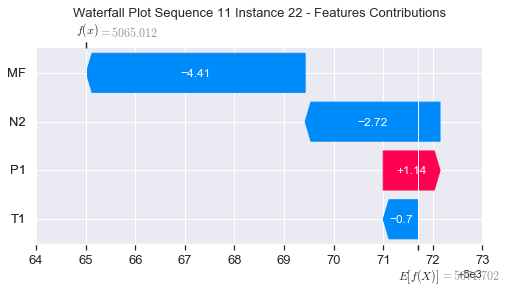

None

Contribution: [0.69504206 0.99776872 3.34282046 3.34005817]


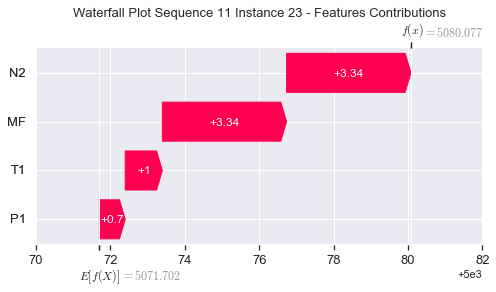

None

Contribution: [-7.85778767 -9.80398287 18.19999715 36.98139797]


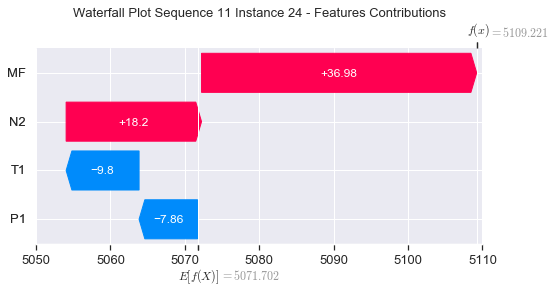

None

Contribution: [11.33989215 14.01301941 30.97918377  9.68017106]


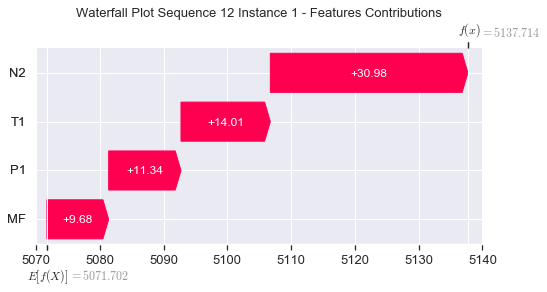

None

Contribution: [0.01844937 0.03684179 0.14600851 0.07952945]


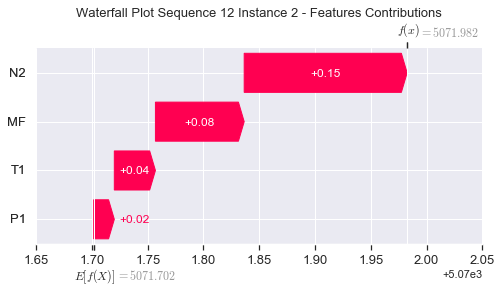

None

Contribution: [-0.03868578  0.04104167  0.17593217  0.2441462 ]


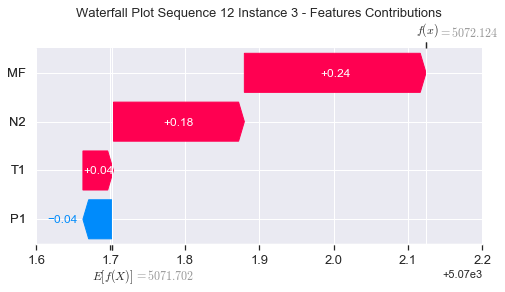

None

Contribution: [-0.05266804  0.02271408  0.06658121  0.12550036]


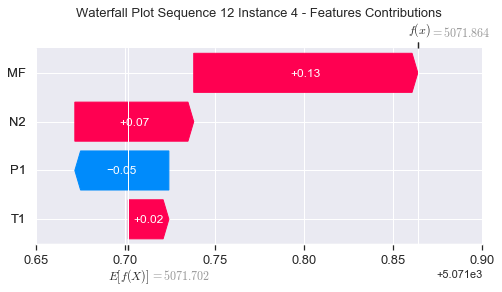

None

Contribution: [-0.01130665  0.04407161  0.15052233  0.18381157]


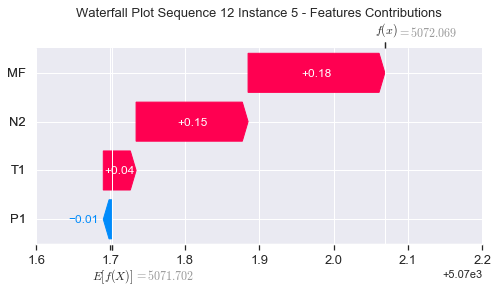

None

Contribution: [0.00309504 0.0331991  0.12589162 0.14100402]


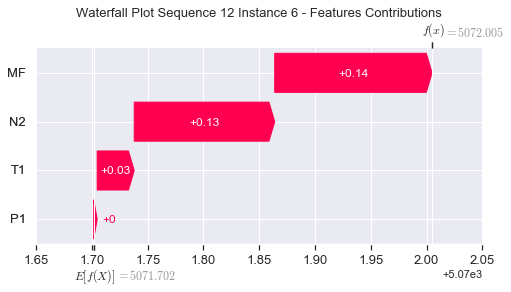

None

Contribution: [0.01217886 0.03306865 0.1225446  0.1257661 ]


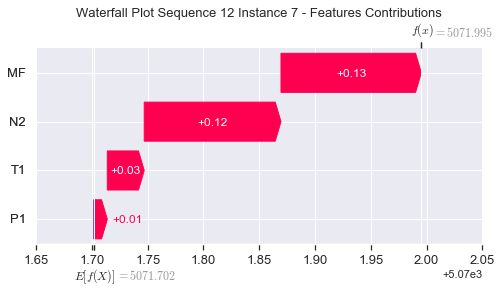

None

Contribution: [0.00895269 0.04349776 0.13277345 0.13628827]


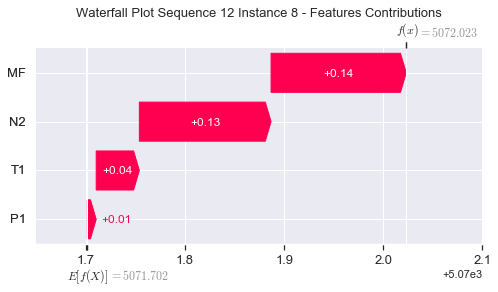

None

Contribution: [0.00036663 0.05254917 0.13961241 0.15131854]


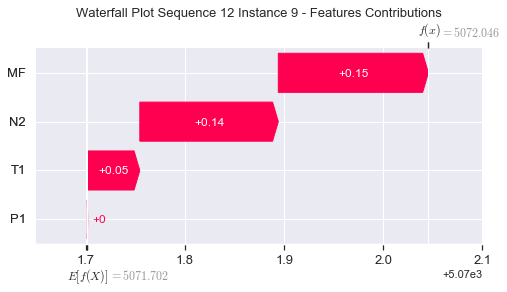

None

Contribution: [-0.00264551  0.05414989  0.13652903  0.14200248]


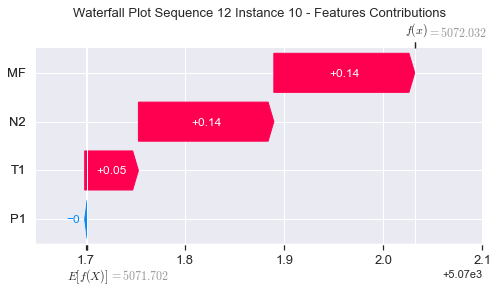

None

Contribution: [-0.0076863   0.05262573  0.13248466  0.13689259]


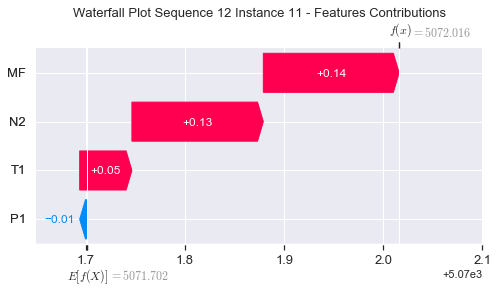

None

Contribution: [-0.00529448  0.06247361  0.13270179  0.14548176]


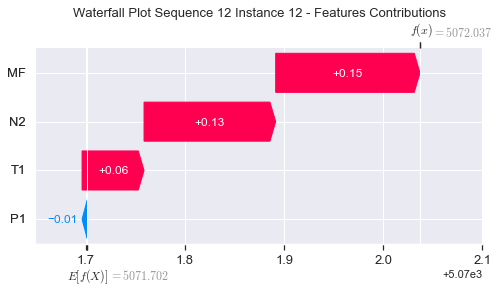

None

Contribution: [-0.00537425  0.06123898  0.12938237  0.1420609 ]


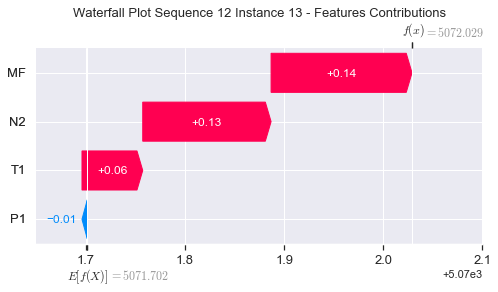

None

Contribution: [-0.00588101  0.06435573  0.12873669  0.13909757]


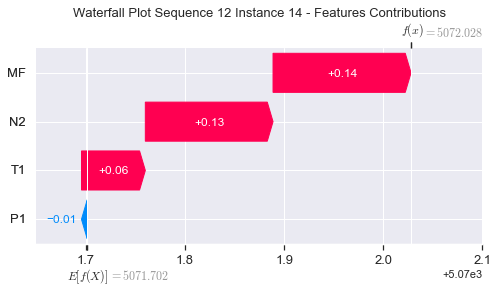

None

Contribution: [-0.00617978  0.06097739  0.12578952  0.13969876]


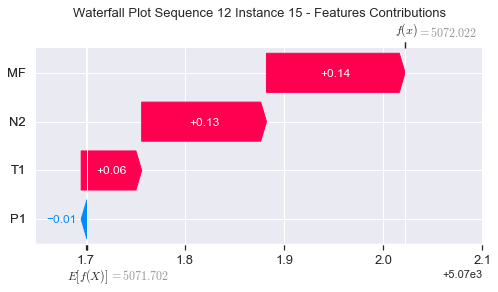

None

Contribution: [-0.01809742  0.05812176  0.11439286  0.10247171]


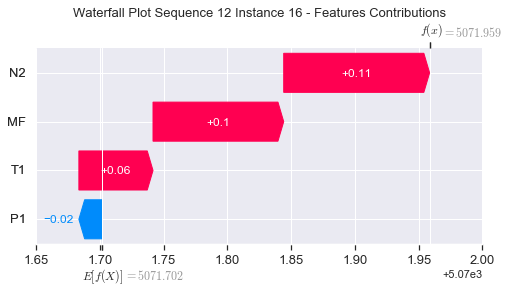

None

Contribution: [-0.0018474   0.05716472  0.11803898  0.1279002 ]


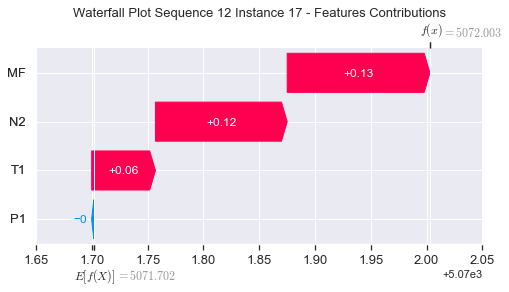

None

Contribution: [0.01145616 0.04113062 0.06466741 0.05446521]


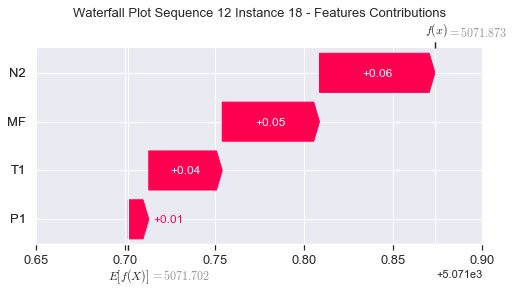

None

Contribution: [0.04400119 0.04839375 0.10950304 0.06849832]


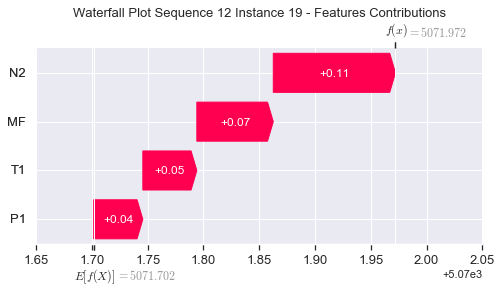

None

Contribution: [-0.10329308  0.16212773  0.51300191  0.69165477]


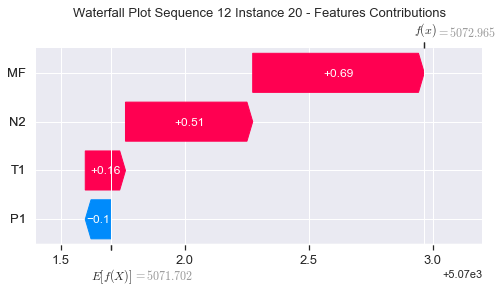

None

Contribution: [-0.15303868 -0.03893727 -0.34645546 -0.28582289]


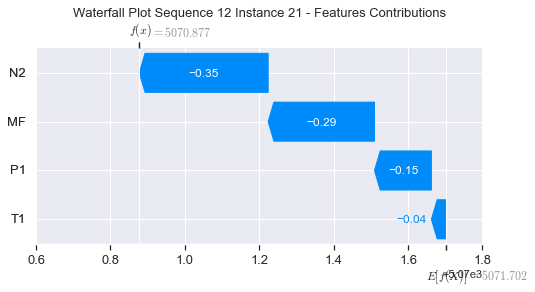

None

Contribution: [ 1.17073295 -0.50020144 -2.83538505 -4.56710495]


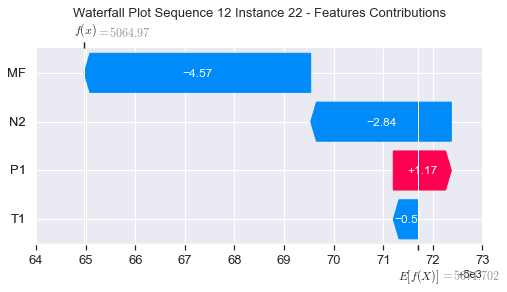

None

Contribution: [0.61295118 1.19464122 3.49726727 3.56212086]


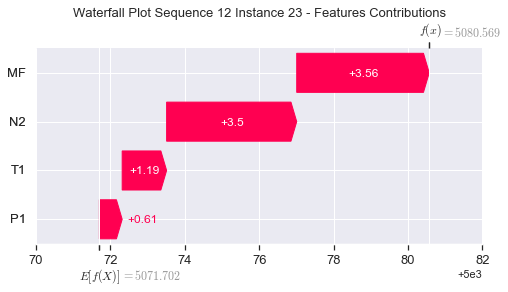

None

Contribution: [ -7.0425602  -14.93414853  19.3342788   38.29876265]


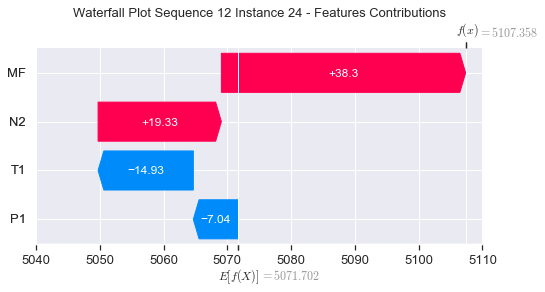

None

Contribution: [10.41741754 14.9671779  31.48061201 10.11113594]


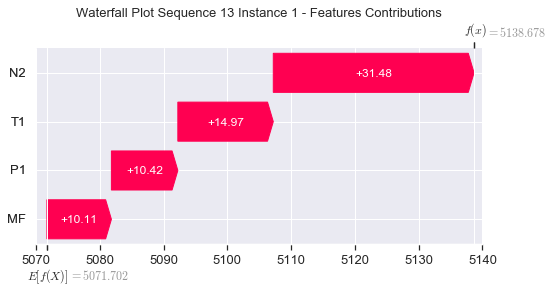

None

Contribution: [0.01764543 0.02978337 0.14753886 0.07817096]


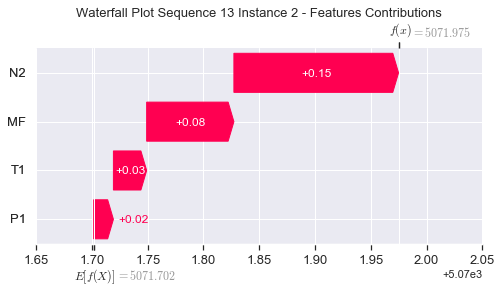

None

Contribution: [-0.03764167  0.04055833  0.17722091  0.24262029]


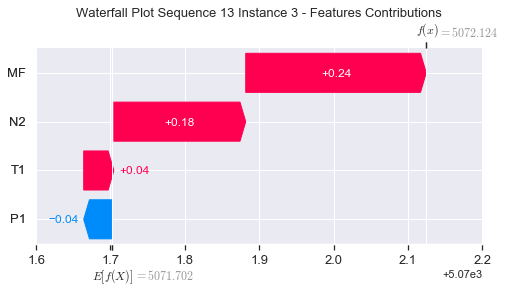

None

Contribution: [-0.05217379  0.02287309  0.0666452   0.12492535]


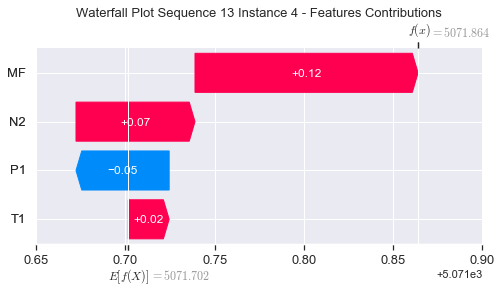

None

Contribution: [-0.01097093  0.04221669  0.15081788  0.18341992]


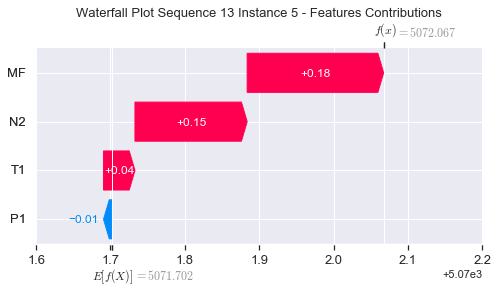

None

Contribution: [0.00308422 0.0327656  0.12563908 0.1398151 ]


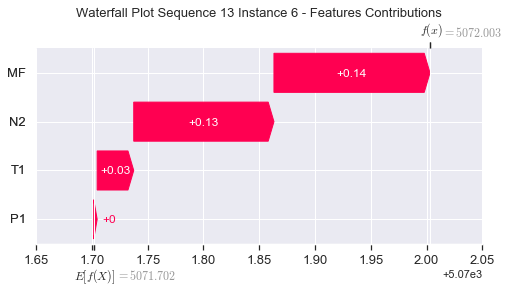

None

Contribution: [0.01164282 0.03269974 0.12219654 0.12588077]


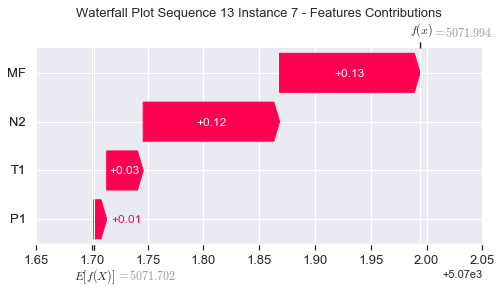

None

Contribution: [0.00782983 0.04318827 0.13266802 0.1381302 ]


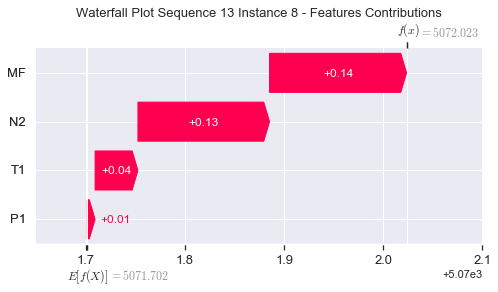

None

Contribution: [0.00026304 0.05094403 0.13913869 0.15011976]


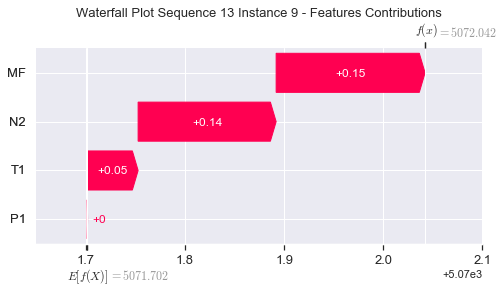

None

Contribution: [-0.00377697  0.06149053  0.13716039  0.14815568]


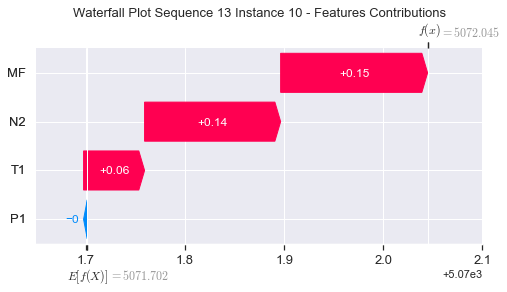

None

Contribution: [-0.00733211  0.04994654  0.13141637  0.13470214]


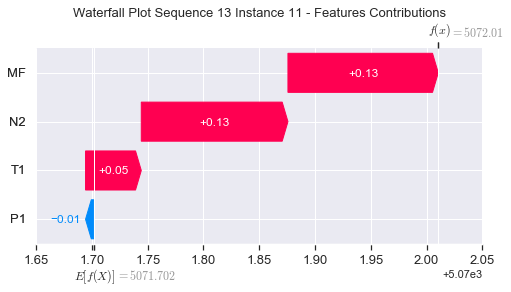

None

Contribution: [-0.0054598   0.05567828  0.13176203  0.14640761]


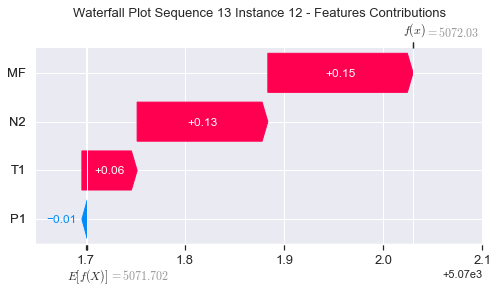

None

Contribution: [-0.00562924  0.0549011   0.12855717  0.14295551]


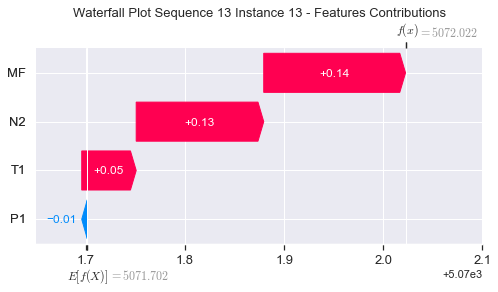

None

Contribution: [-0.00619858  0.05241179  0.12787413  0.14043292]


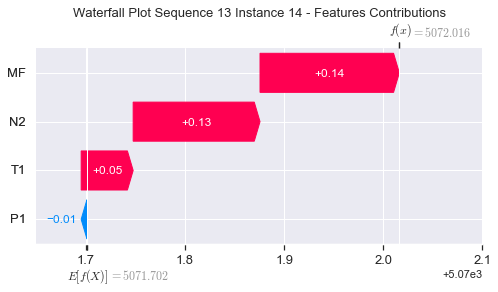

None

Contribution: [-0.00654267  0.05387045  0.12535042  0.14150982]


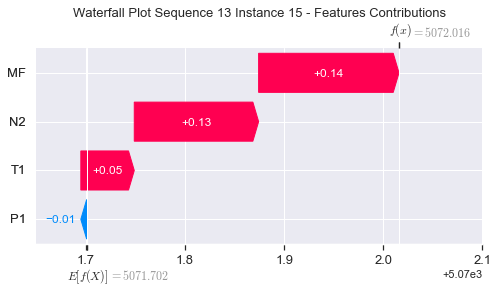

None

Contribution: [-0.01859002  0.04792659  0.11460048  0.10861315]


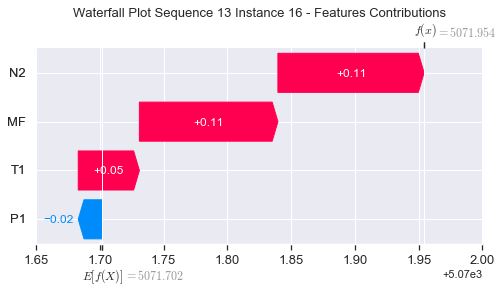

None

Contribution: [-0.00261683  0.04906389  0.11839992  0.13110271]


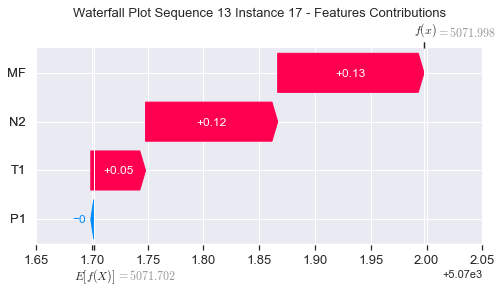

None

Contribution: [0.00981357 0.03166216 0.06671143 0.06091116]


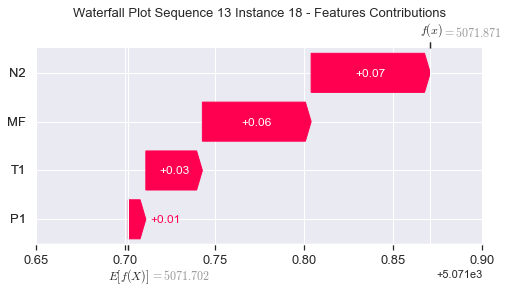

None

Contribution: [0.04079551 0.03876234 0.10889571 0.06838176]


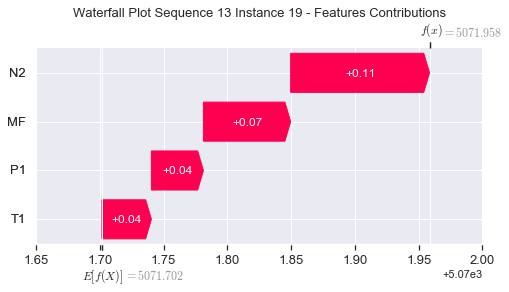

None

Contribution: [-0.09745857  0.16304812  0.50347183  0.67598513]


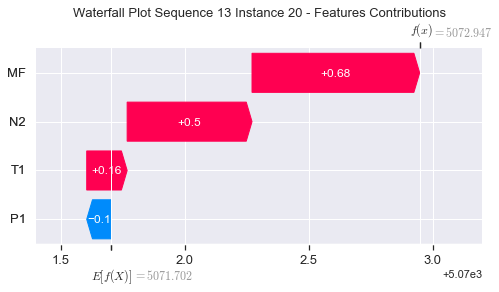

None

Contribution: [-0.14461954 -0.04623313 -0.33294571 -0.27159328]


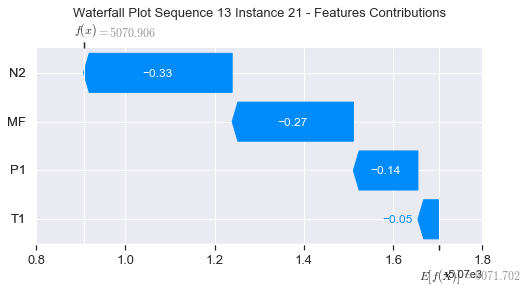

None

Contribution: [ 1.08341957 -0.74642054 -2.7875664  -4.51306667]


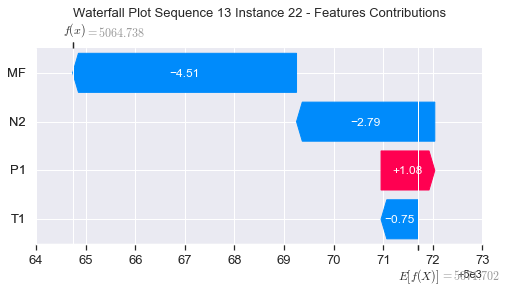

None

Contribution: [0.40714185 0.9466211  3.45141385 3.5128567 ]


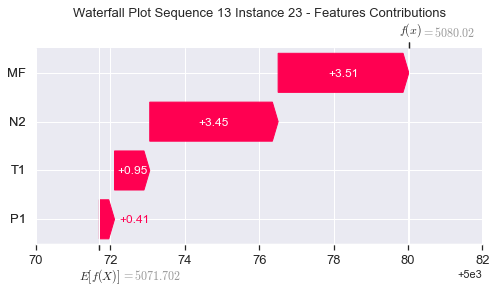

None

Contribution: [-4.86751979 -8.42458073 19.07865865 35.67498913]


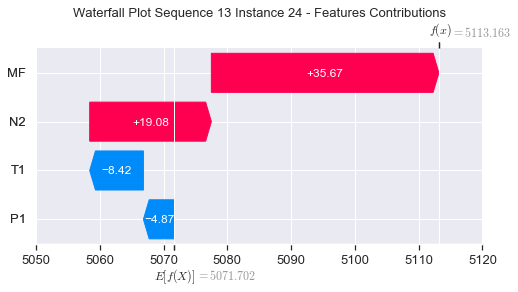

None

Contribution: [ 9.63526722 11.51641117 31.3859944   9.43260961]


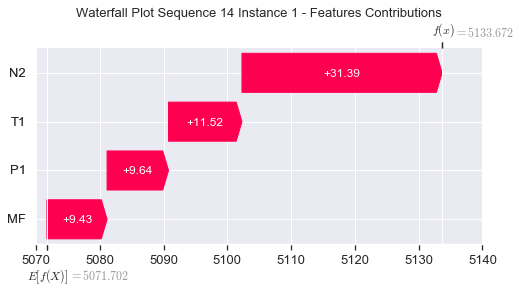

None

Contribution: [0.01552455 0.03915196 0.14726677 0.08123342]


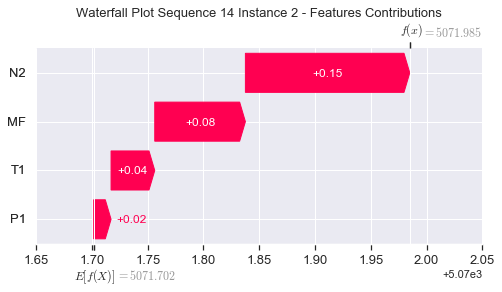

None

Contribution: [-0.03761859  0.04630542  0.1760764   0.24262459]


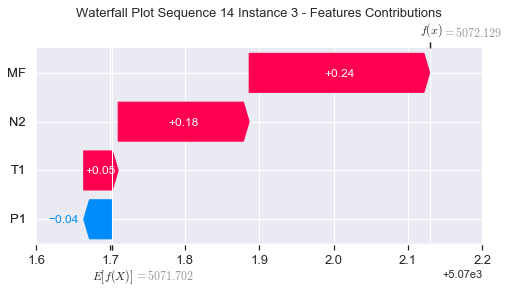

None

Contribution: [-0.05212519  0.02710875  0.06542535  0.12598203]


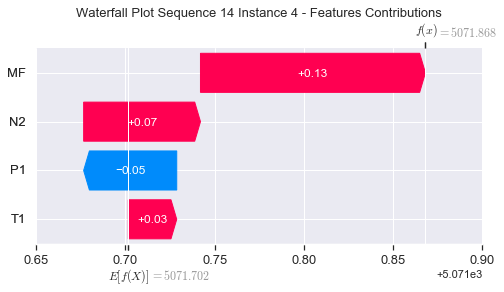

None

Contribution: [-0.01092687  0.04738766  0.14934788  0.18201229]


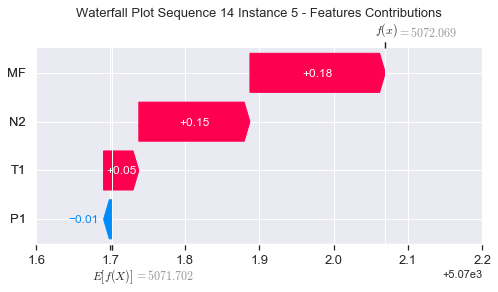

None

Contribution: [0.0031354  0.03414114 0.12478406 0.13899399]


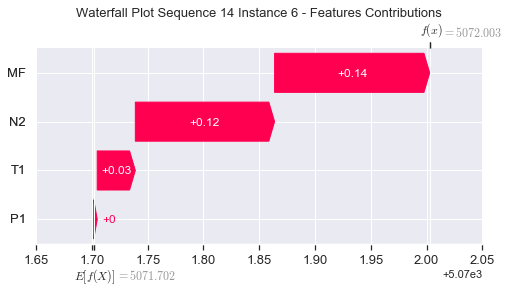

None

Contribution: [0.0119502  0.03122501 0.12064699 0.12359926]


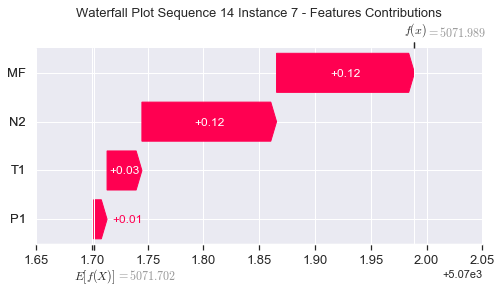

None

Contribution: [0.00852796 0.03790958 0.13036962 0.13438733]


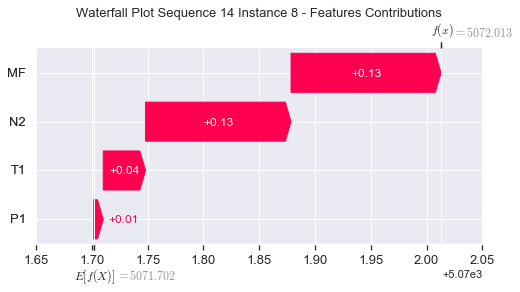

None

Contribution: [0.00065502 0.04089806 0.13711333 0.14892537]


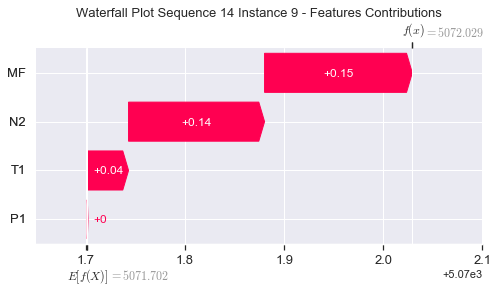

None

Contribution: [-0.00334403  0.04175373  0.13486943  0.14286422]


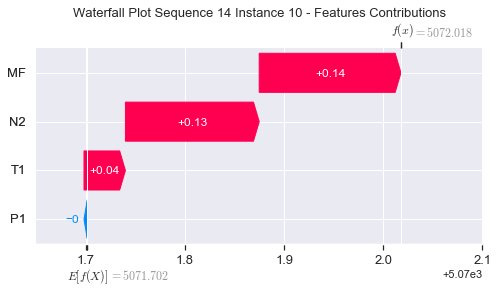

None

Contribution: [-0.00766278  0.04053299  0.13041074  0.13615742]


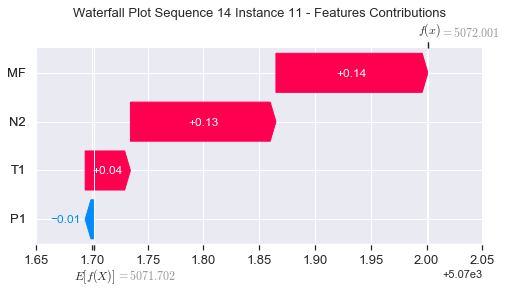

None

Contribution: [-0.00519784  0.05171657  0.13095118  0.14476669]


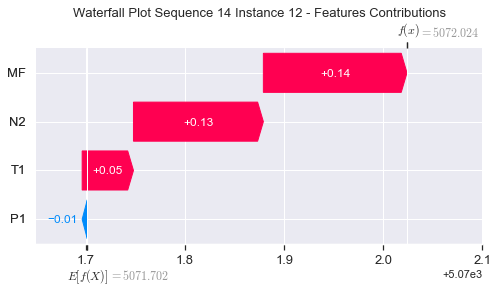

None

Contribution: [-0.0053469   0.05047075  0.12788164  0.14155333]


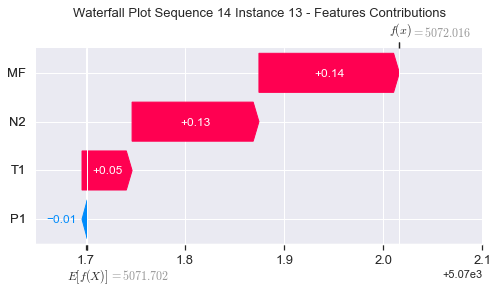

None

Contribution: [-0.00606572  0.05104466  0.12785074  0.14339476]


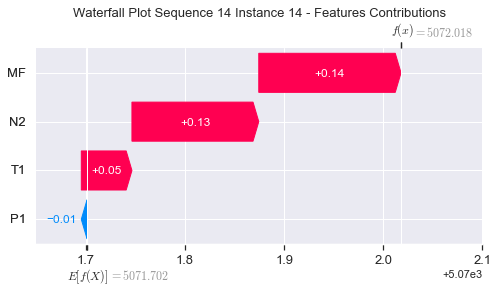

None

Contribution: [-0.00627752  0.05101113  0.12474953  0.14040284]


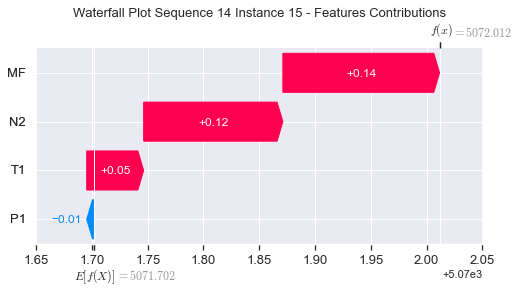

None

Contribution: [-0.01906706  0.04915291  0.11360393  0.10452441]


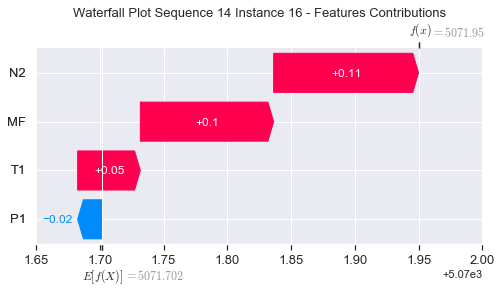

None

Contribution: [-0.00227463  0.04725036  0.11702382  0.12914151]


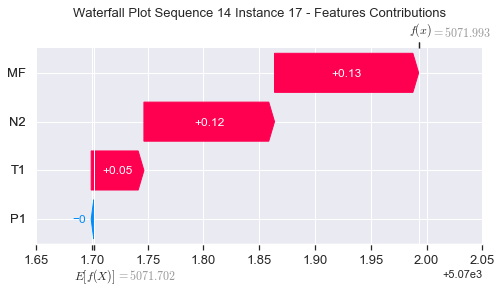

None

Contribution: [0.01098958 0.03013175 0.06341201 0.05621963]


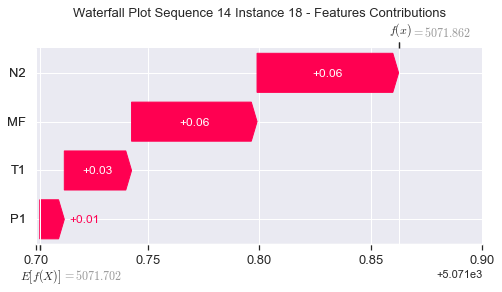

None

Contribution: [0.04318314 0.03994707 0.1100588  0.06754529]


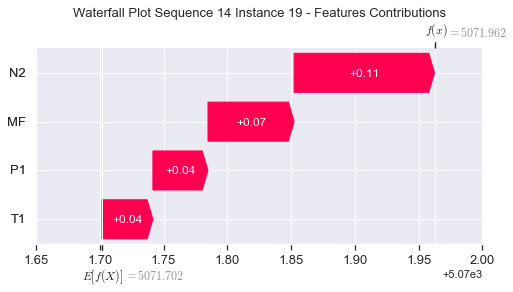

None

Contribution: [-0.10181816  0.16663099  0.51394039  0.69153774]


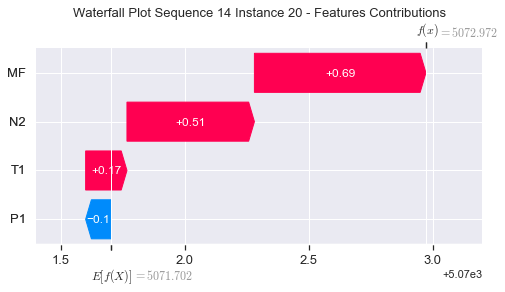

None

Contribution: [-0.14483351 -0.05196948 -0.35687924 -0.2970468 ]


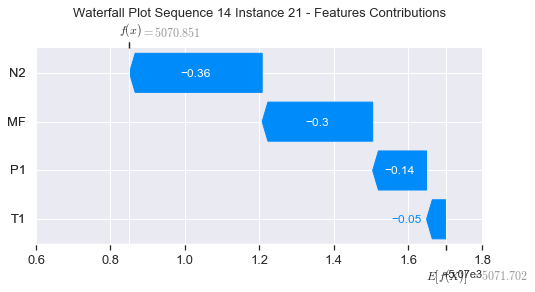

None

Contribution: [ 1.11273889 -0.6997573  -2.84806186 -4.55559139]


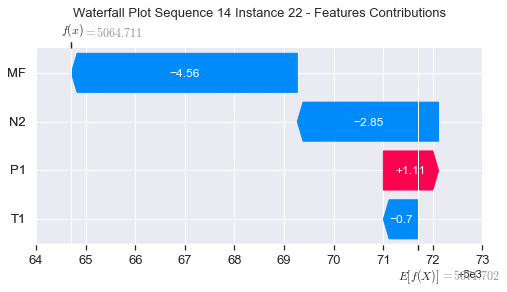

None

Contribution: [0.4132564  1.02832397 3.52467053 3.61296363]


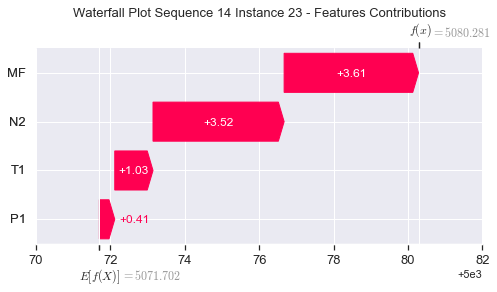

None

Contribution: [ -4.97926562 -11.10092408  18.97923722  33.96729527]


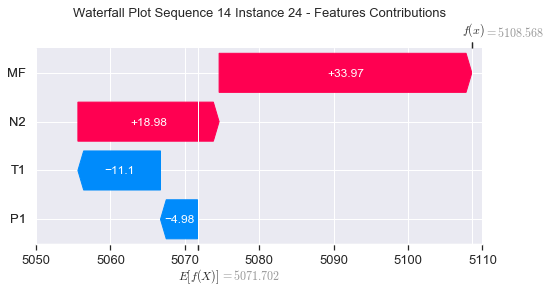

None

Contribution: [ 9.46618769 13.14346083 31.23420224  9.26512402]


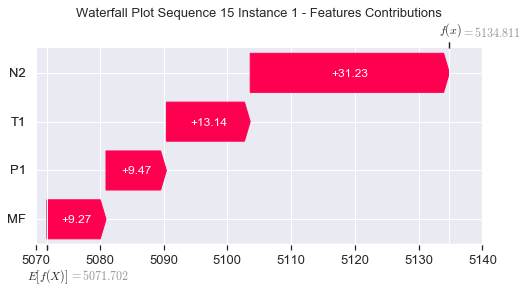

None

Contribution: [0.01636239 0.03610056 0.14952494 0.08056684]


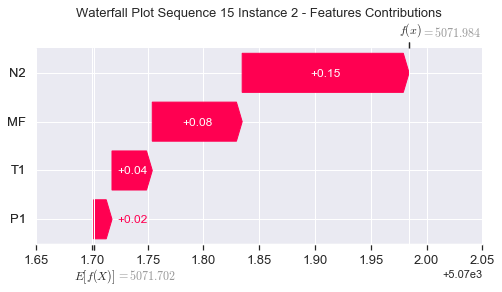

None

Contribution: [-0.03780067  0.04294761  0.17814511  0.24419464]


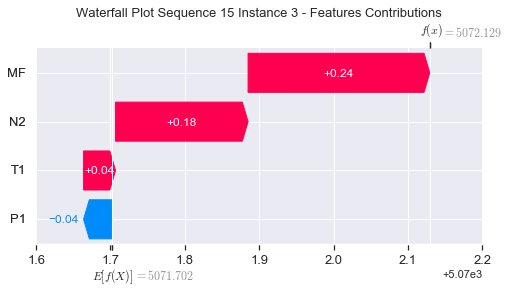

None

Contribution: [-0.05214144  0.02196731  0.06636809  0.12374437]


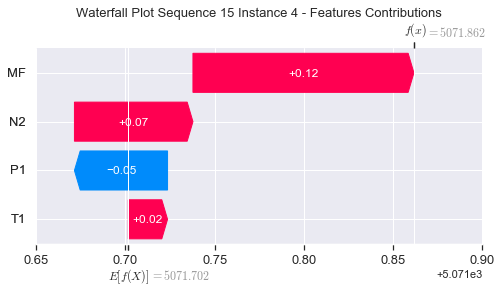

None

Contribution: [-0.01088864  0.04453711  0.1501223   0.1828153 ]


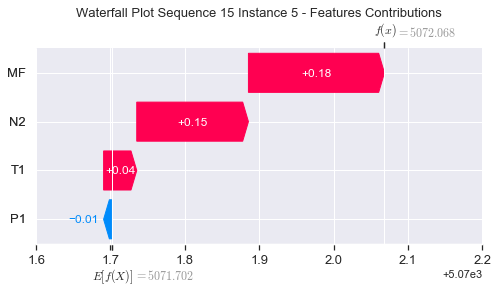

None

Contribution: [0.00323624 0.03318511 0.1250965  0.13950715]


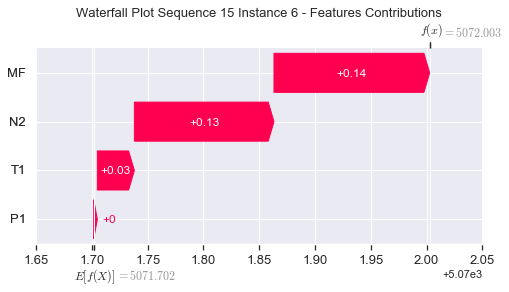

None

Contribution: [0.01201068 0.03206928 0.12130219 0.12424025]


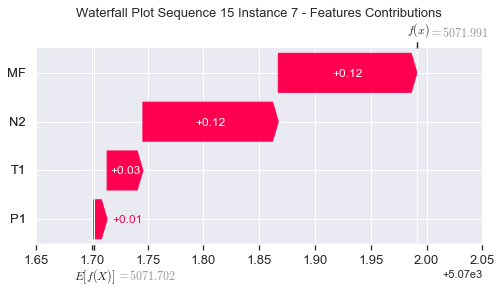

None

Contribution: [0.00835868 0.04108877 0.13121901 0.13514235]


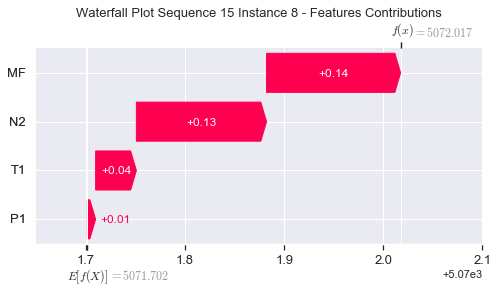

None

Contribution: [-0.00020765  0.04667562  0.13788282  0.14939096]


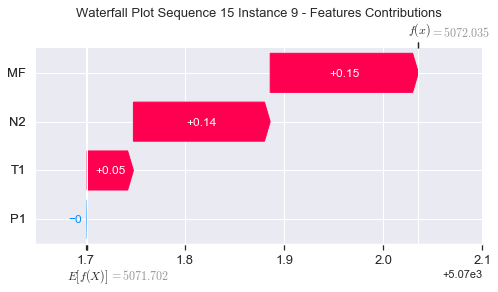

None

Contribution: [-0.00337694  0.04847579  0.13549702  0.1434842 ]


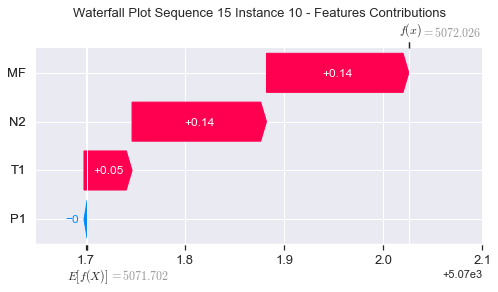

None

Contribution: [-0.00803963  0.0483183   0.1311802   0.13750445]


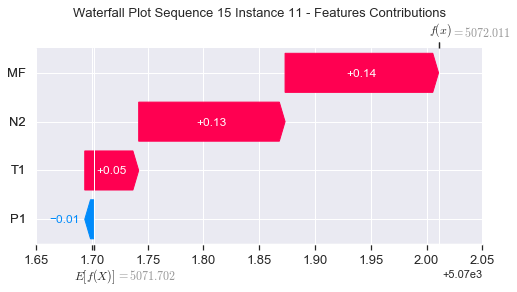

None

Contribution: [-0.00536426  0.0533302   0.1312827   0.14611256]


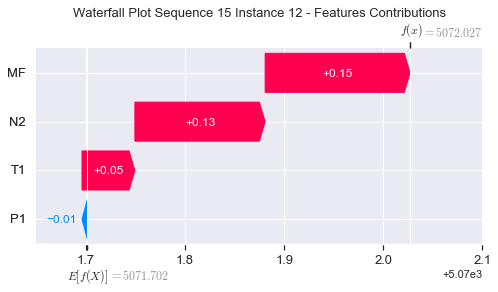

None

Contribution: [-0.00549081  0.05199116  0.12806687  0.14251139]


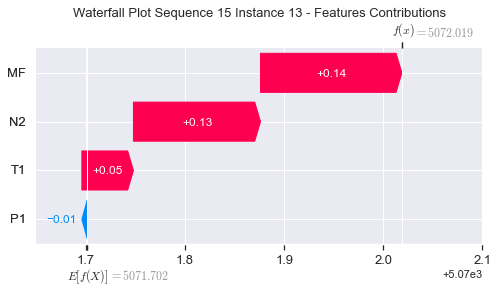

None

Contribution: [-0.00593227  0.05593438  0.12719308  0.13901414]


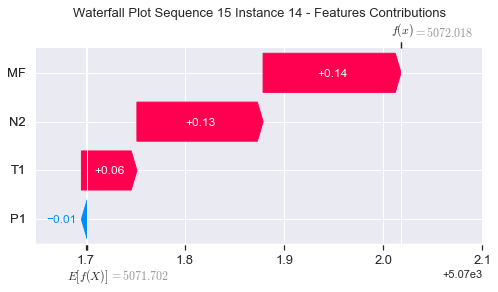

None

Contribution: [-0.00635032  0.05231687  0.12460006  0.14019592]


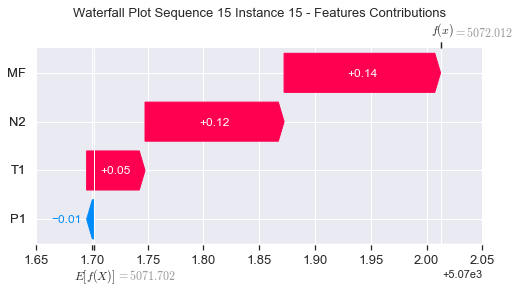

None

Contribution: [-0.01851944  0.04369608  0.11365859  0.10432515]


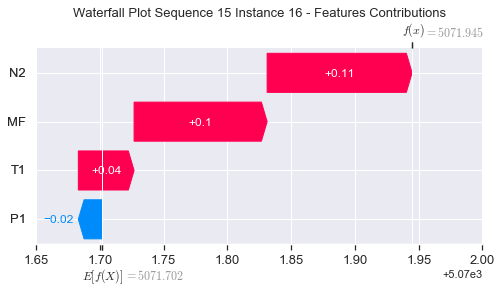

None

Contribution: [-0.00239639  0.04751249  0.11729235  0.12937552]


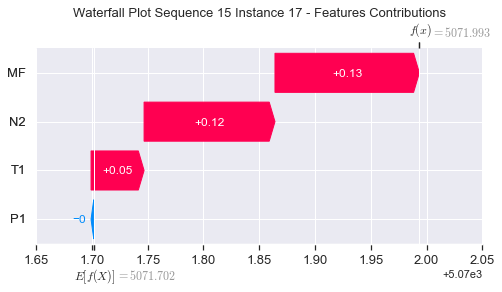

None

Contribution: [0.01062454 0.03034478 0.06426631 0.05723577]


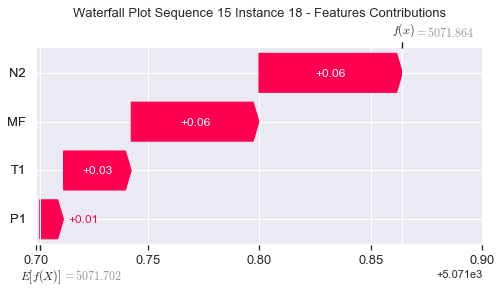

None

Contribution: [0.04307867 0.03402591 0.10958605 0.06901294]


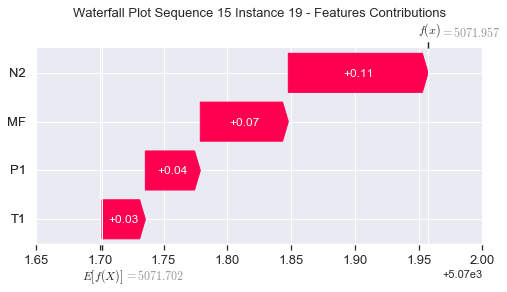

None

Contribution: [-0.10030651  0.16602109  0.51060503  0.68611919]


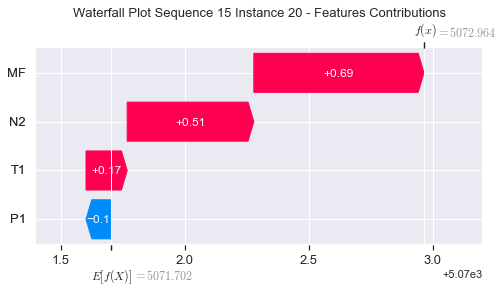

None

Contribution: [-0.14456392 -0.05119418 -0.34800372 -0.28479286]


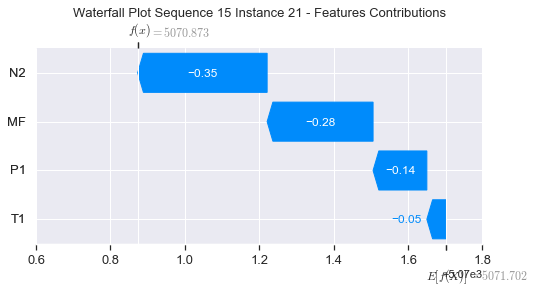

None

Contribution: [ 1.08996398 -0.74268941 -2.82439307 -4.47225999]


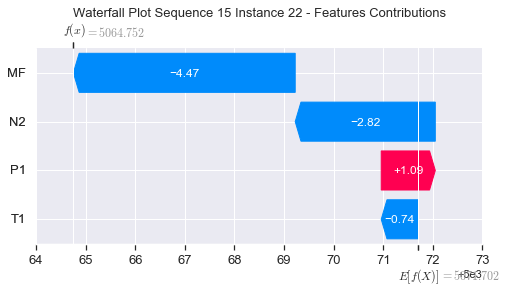

None

Contribution: [0.39310397 0.98233443 3.49922134 3.57609324]


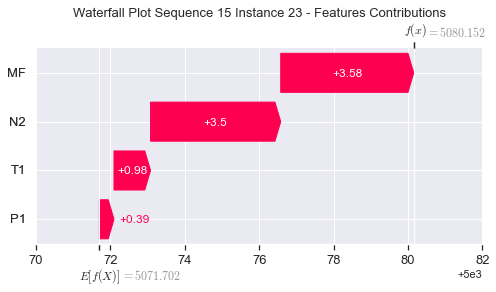

None

Contribution: [ -5.10930309 -10.06853945  19.18313166  35.76961462]


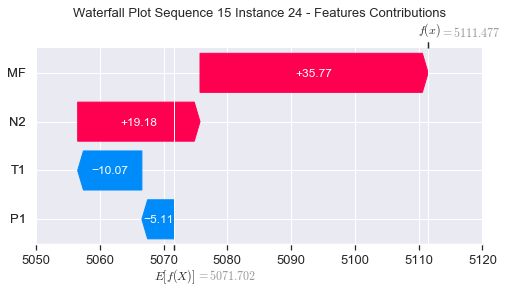

None

Contribution: [10.13056637 12.73606134 31.39168027 10.00959052]


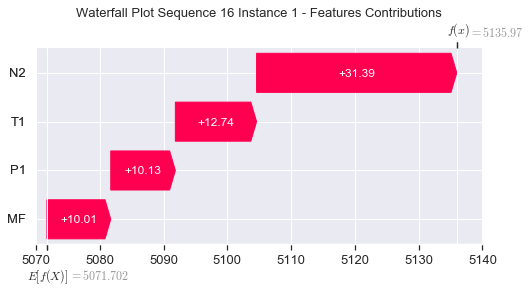

None

Contribution: [0.01438857 0.03899292 0.14555963 0.07589419]


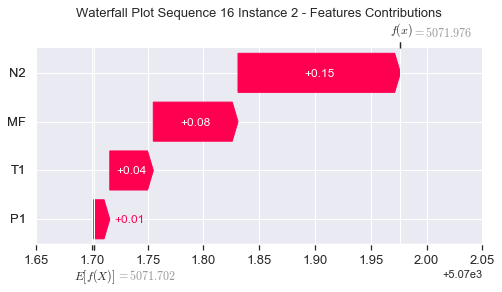

None

Contribution: [-0.03758119  0.04405198  0.17547506  0.2418327 ]


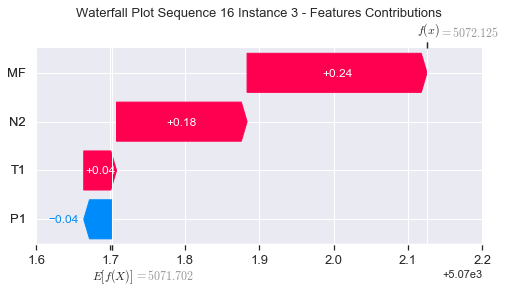

None

Contribution: [-0.05230655  0.02548962  0.06631935  0.12314885]


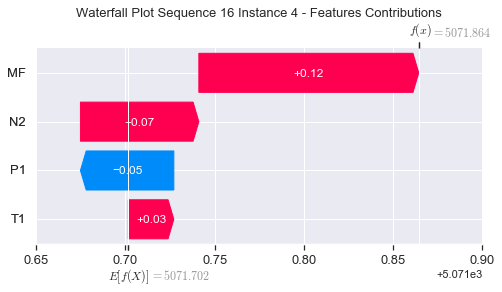

None

Contribution: [-0.01114102  0.04387089  0.15024835  0.18391713]


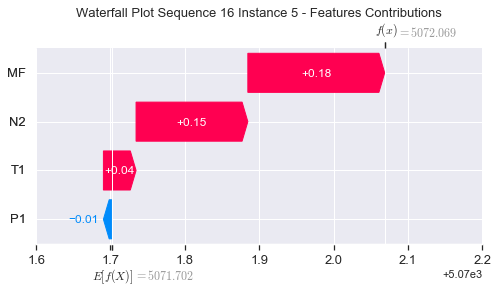

None

Contribution: [0.00305191 0.03319949 0.12555184 0.14030703]


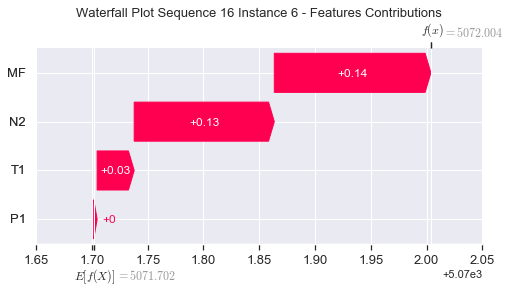

None

Contribution: [0.01178559 0.03257768 0.12193036 0.12511556]


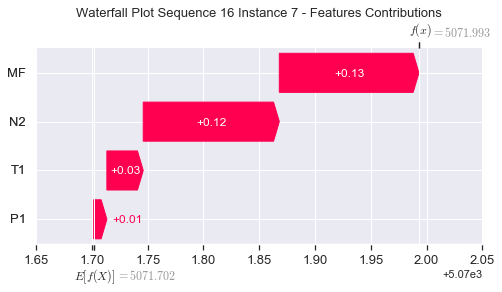

None

Contribution: [0.00822856 0.0427742  0.13187268 0.13564522]


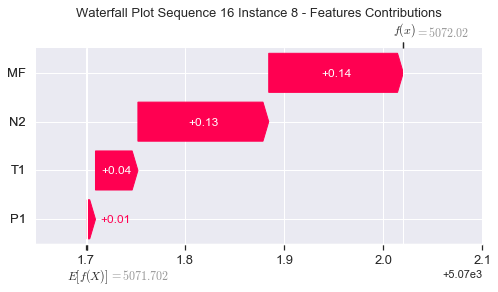

None

Contribution: [-0.00033845  0.05257001  0.13843481  0.14882343]


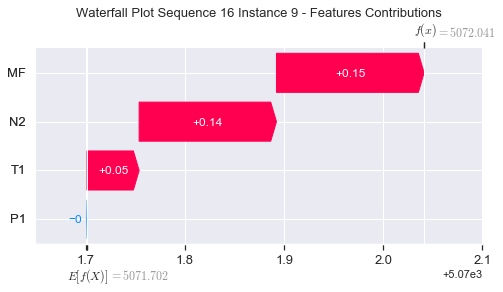

None

Contribution: [-0.00407749  0.05070625  0.13599319  0.14431535]


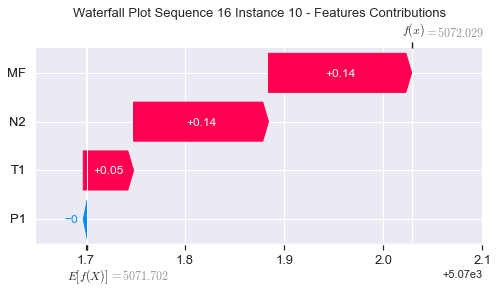

None

Contribution: [-0.00811777  0.05713854  0.13122281  0.13366246]


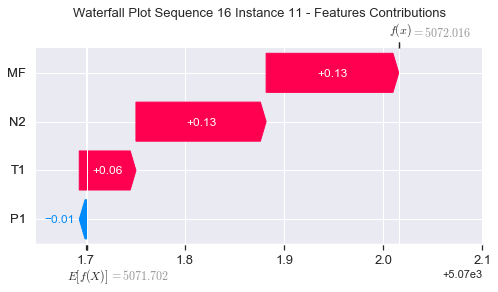

None

Contribution: [-0.00548378  0.05811     0.13138727  0.1439965 ]


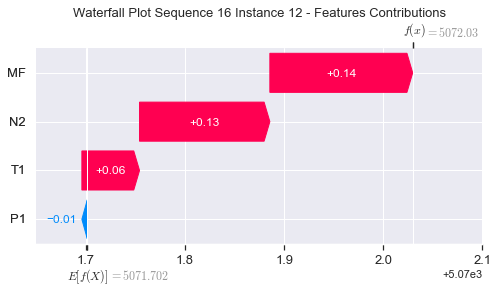

None

Contribution: [-0.00562513  0.0564906   0.12834543  0.14120539]


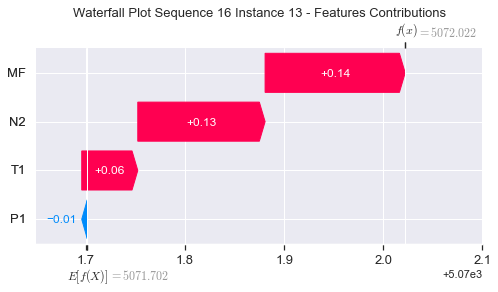

None

Contribution: [-0.00644818  0.05766081  0.12828664  0.1433236 ]


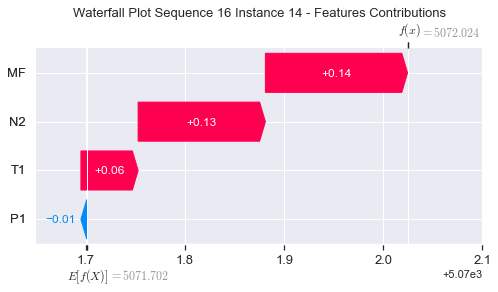

None

Contribution: [-0.00652696  0.05675819  0.12539892  0.14091463]


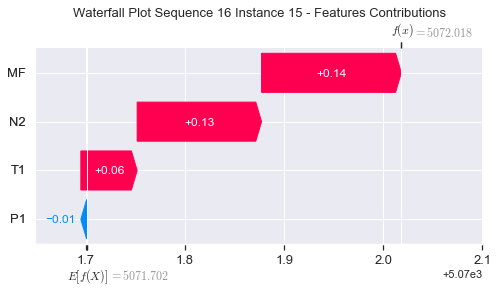

None

Contribution: [-0.01964391  0.05326863  0.1147299   0.11129067]


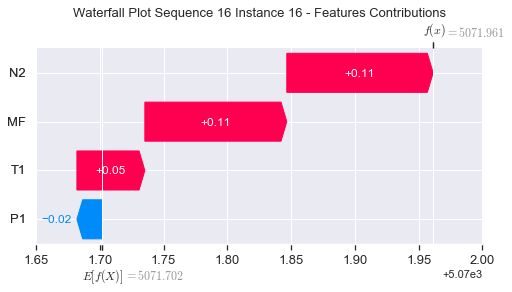

None

Contribution: [-0.00245133  0.05156562  0.11746152  0.12988788]


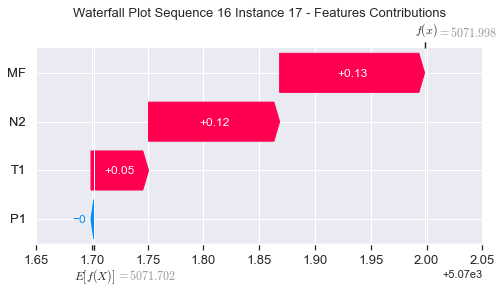

None

Contribution: [0.01078558 0.0352546  0.06367454 0.05690843]


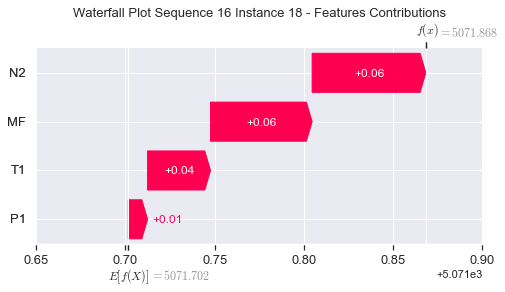

None

Contribution: [0.04328634 0.04255909 0.11056264 0.06543148]


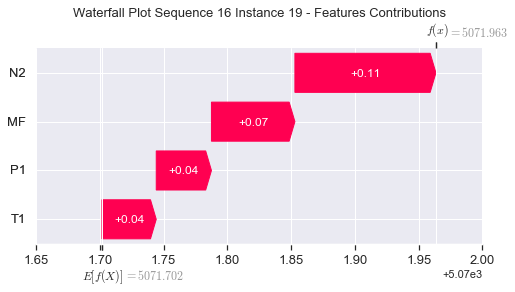

None

Contribution: [-0.10163152  0.16555821  0.51543155  0.69161077]


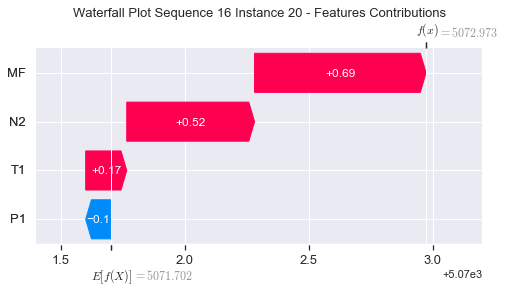

None

Contribution: [-0.14496587 -0.04702565 -0.35595881 -0.2910604 ]


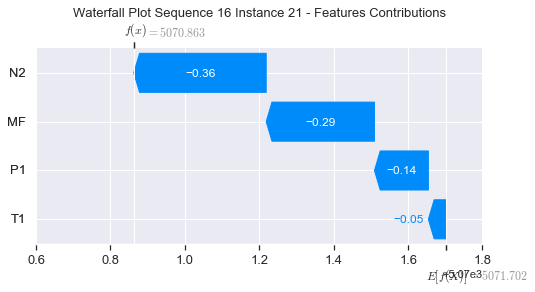

None

Contribution: [ 1.10150578 -0.58254706 -2.84226145 -4.48561035]


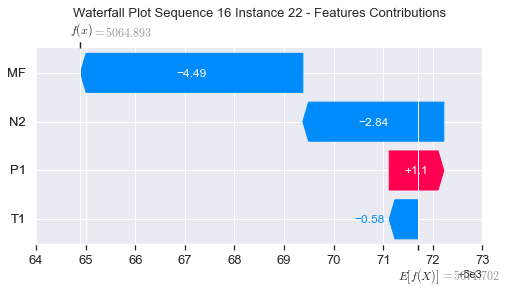

None

Contribution: [0.39004706 1.11971778 3.52152376 3.60675533]


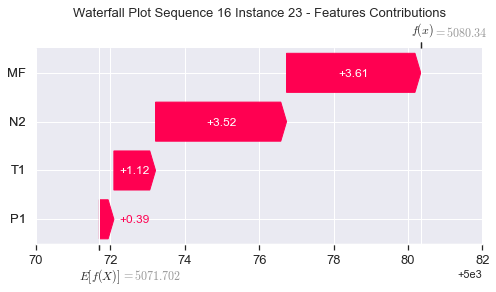

None

Contribution: [ -5.13101802 -13.47261376  18.88837257  33.92106632]


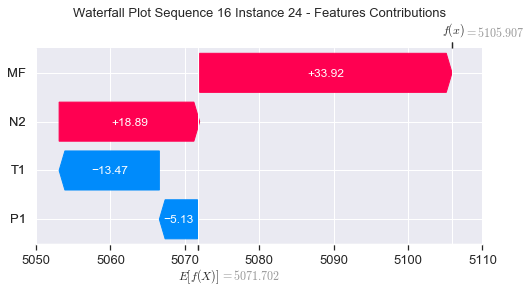

None

Contribution: [ 9.99858759 13.35594325 31.44927524  9.84798688]


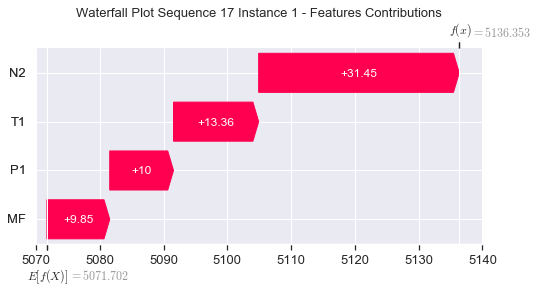

None

Contribution: [0.01470562 0.0322933  0.14644111 0.07697968]


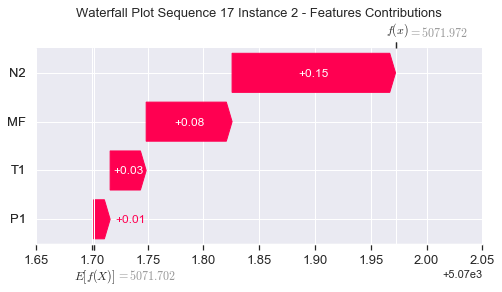

None

Contribution: [-0.03871877  0.04088033  0.17619268  0.24257784]


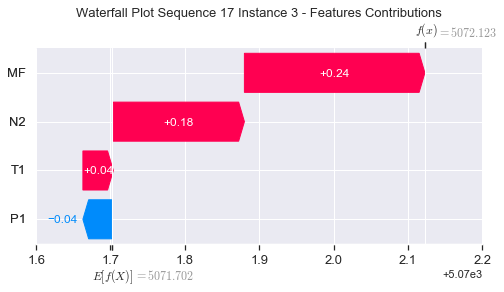

None

Contribution: [-0.05267351  0.02158148  0.06770475  0.12847457]


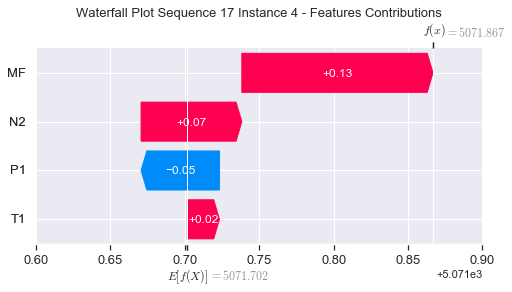

None

Contribution: [-0.01138254  0.04160845  0.15151272  0.18489738]


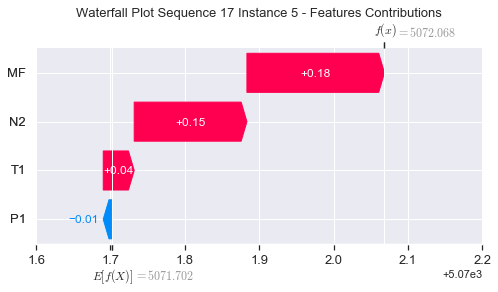

None

Contribution: [0.00281077 0.03267542 0.12628948 0.14100087]


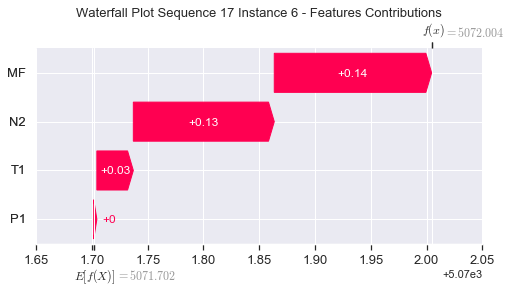

None

Contribution: [0.01147981 0.03360487 0.1226657  0.12649593]


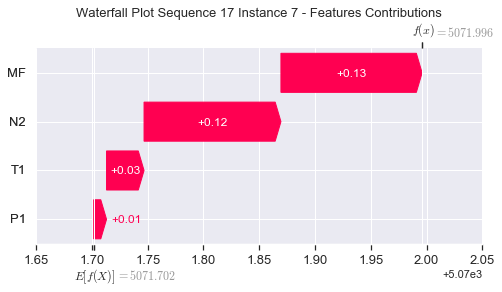

None

Contribution: [0.00771602 0.04582772 0.13301517 0.13859909]


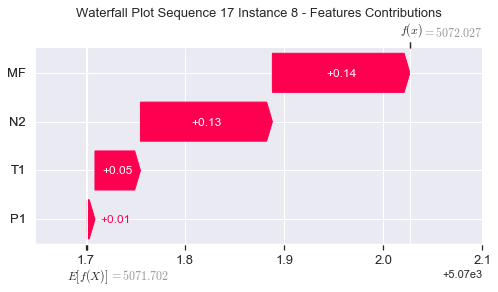

None

Contribution: [-0.00072417  0.05594267  0.14000387  0.15279329]


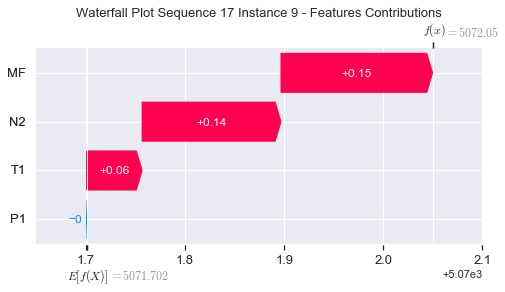

None

Contribution: [-0.00466476  0.05576793  0.13665536  0.1473168 ]


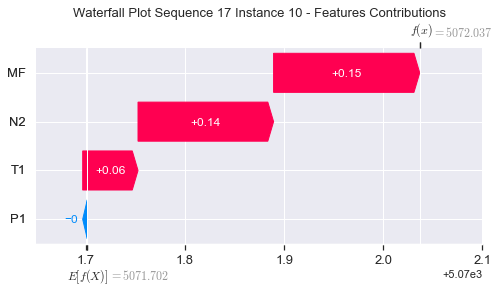

None

Contribution: [-0.00860434  0.05735509  0.13279086  0.13897316]


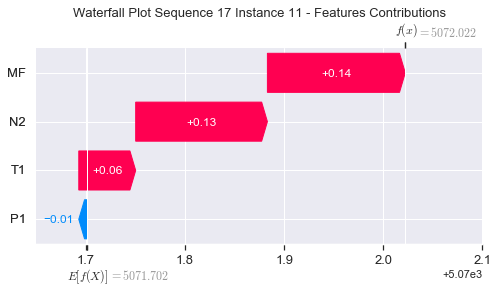

None

Contribution: [-0.00569819  0.06361266  0.13268893  0.14872045]


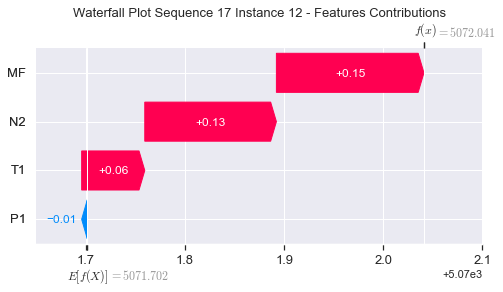

None

Contribution: [-0.00578153  0.06234822  0.12948273  0.14555909]


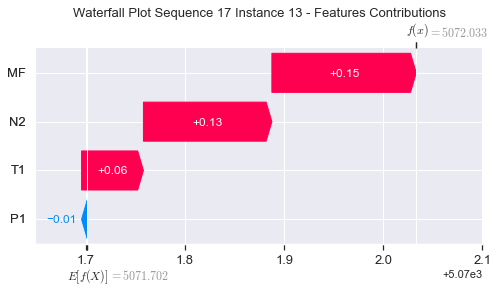

None

Contribution: [-0.00684024  0.06543625  0.12916122  0.14718649]


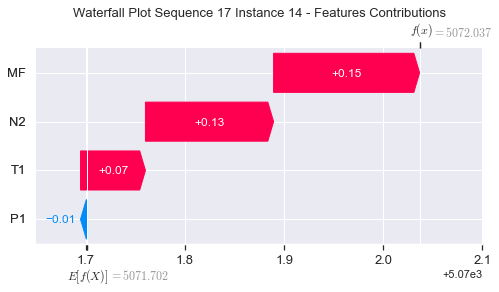

None

Contribution: [-0.00657644  0.06197817  0.12579158  0.14386856]


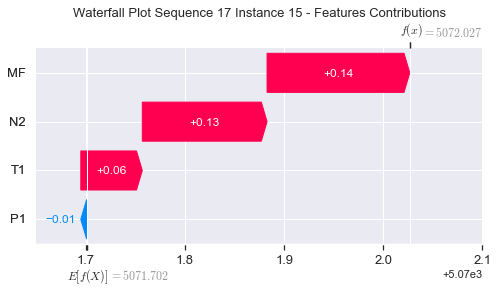

None

Contribution: [-0.01878629  0.05277018  0.11414961  0.10795964]


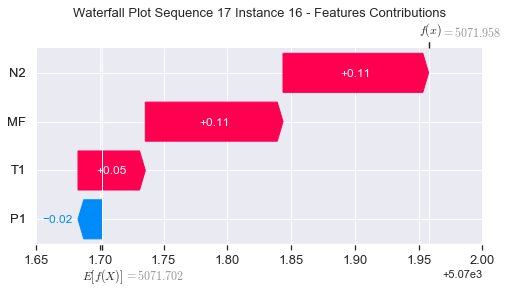

None

Contribution: [-0.00247307  0.05745033  0.11767723  0.13291878]


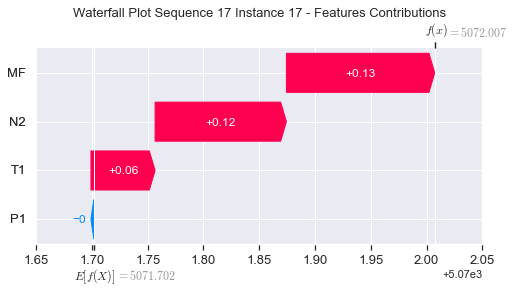

None

Contribution: [0.01090941 0.04108154 0.06301705 0.05986745]


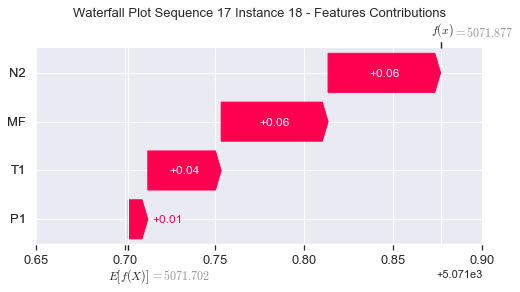

None

Contribution: [0.04373825 0.04190823 0.11053768 0.07219869]


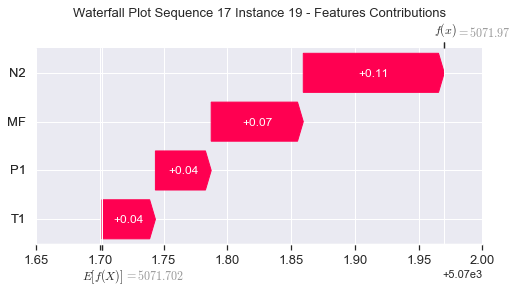

None

Contribution: [-0.1028076   0.16475436  0.52012077  0.69486272]


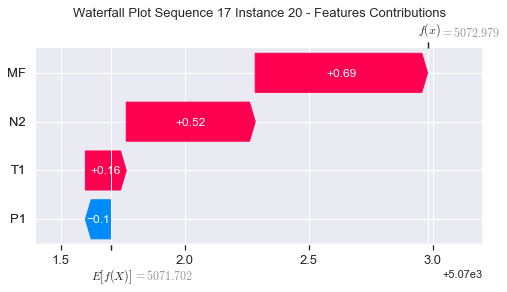

None

Contribution: [-0.14680355 -0.0419712  -0.3620479  -0.29019304]


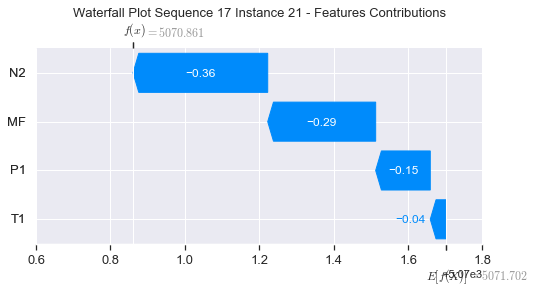

None

Contribution: [ 1.11612059 -0.4796169  -2.87722119 -4.44383416]


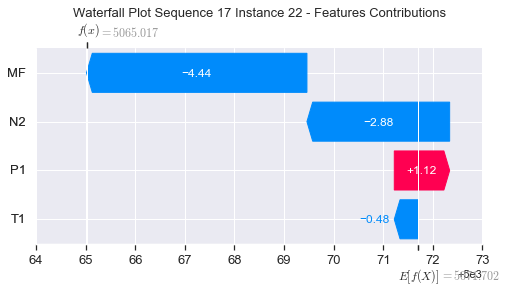

None

Contribution: [0.39945415 1.19484053 3.54660584 3.61516111]


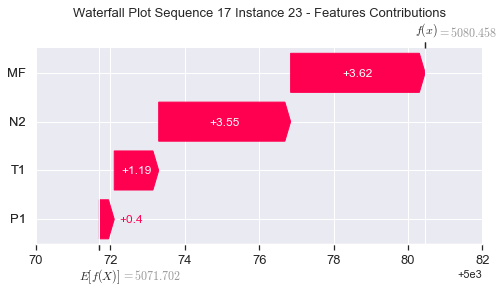

None

Contribution: [ -5.49654791 -16.36349641  19.35169823  32.72549774]


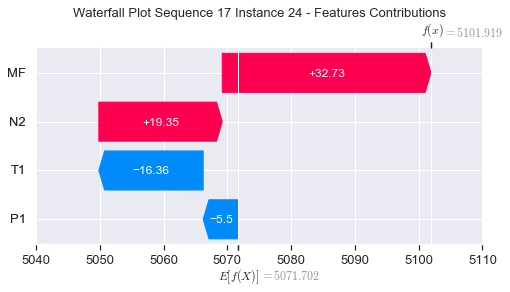

None

Contribution: [10.97559254 15.98734045 31.55948644  9.93968176]


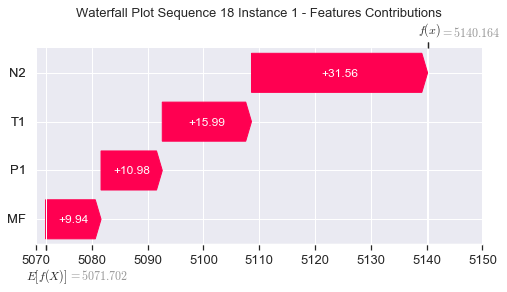

None

Contribution: [0.01583422 0.03162244 0.14806326 0.07648466]


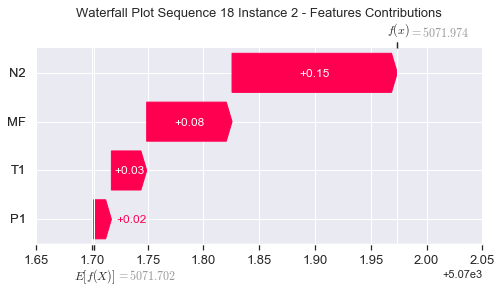

None

Contribution: [-0.03851782  0.04038782  0.17675233  0.24315799]


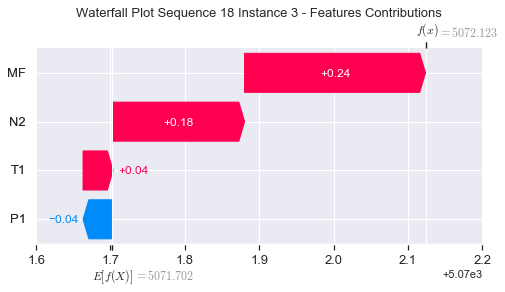

None

Contribution: [-0.05251794  0.01932624  0.06752855  0.12549718]


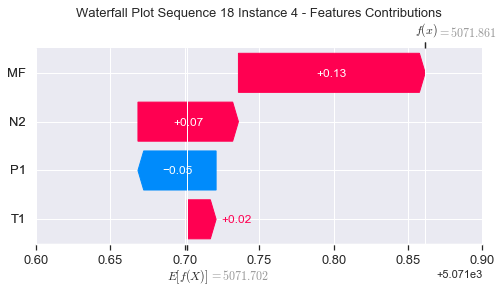

None

Contribution: [-0.01124969  0.04194898  0.15094087  0.18462899]


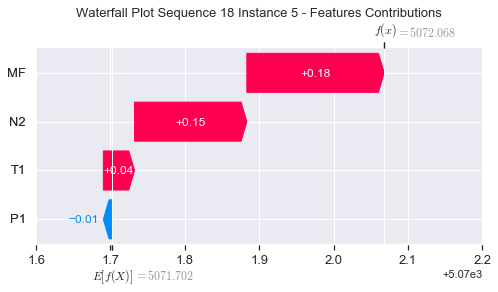

None

Contribution: [0.00305939 0.03291561 0.12615427 0.14124107]


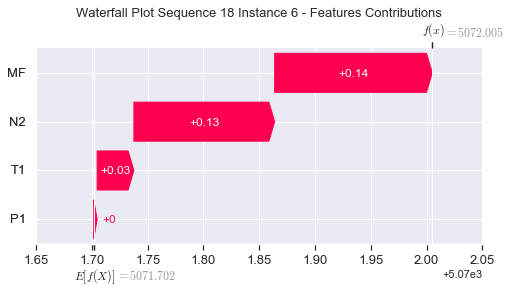

None

Contribution: [0.01197733 0.03307324 0.12317926 0.12662568]


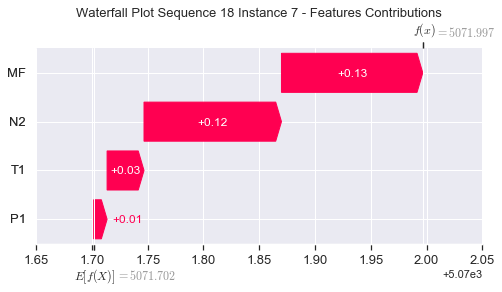

None

Contribution: [0.00837576 0.04367995 0.13318552 0.13716123]


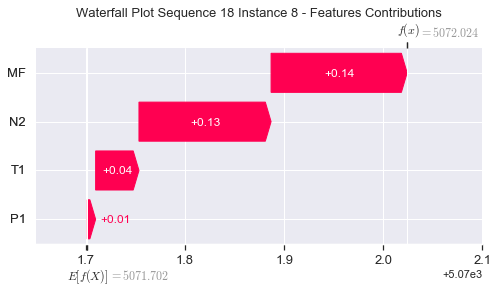

None

Contribution: [-0.00017319  0.05022736  0.13944851  0.15109719]


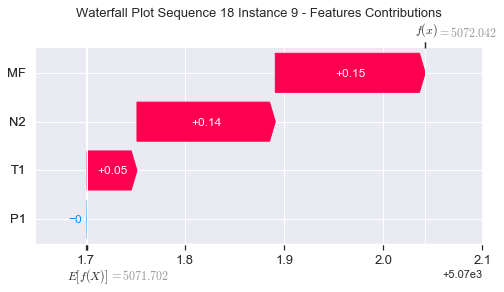

None

Contribution: [-0.00348218  0.05330498  0.13701275  0.1466954 ]


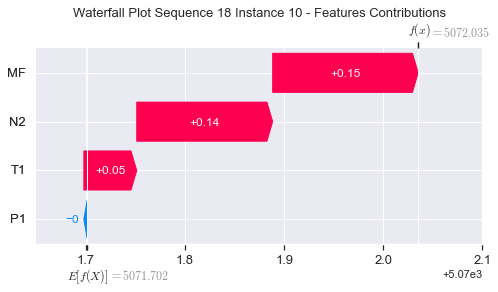

None

Contribution: [-0.00794224  0.05096392  0.13166509  0.13470002]


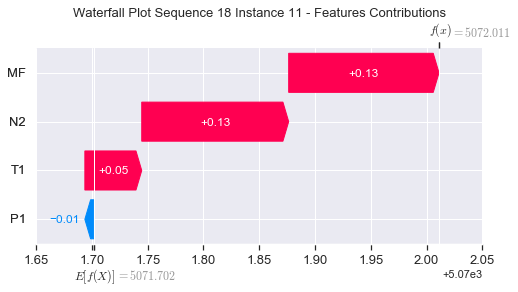

None

Contribution: [-0.00500542  0.05697062  0.13138264  0.14144979]


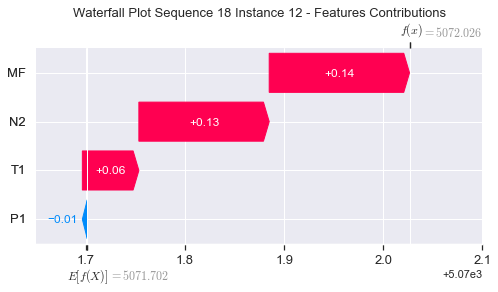

None

Contribution: [-0.00523723  0.05599717  0.12831749  0.13917592]


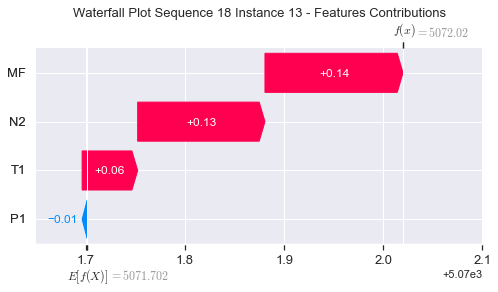

None

Contribution: [-0.00633858  0.05372999  0.12833471  0.14366558]


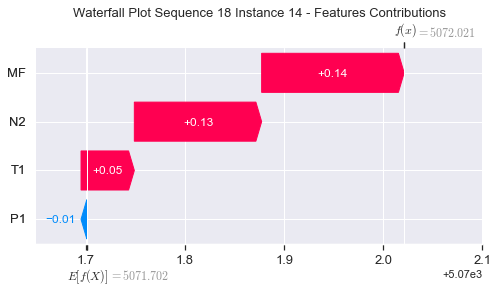

None

Contribution: [-0.00620801  0.05583165  0.12506925  0.13895028]


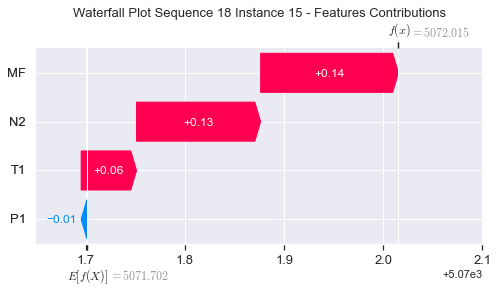

None

Contribution: [-0.0188998   0.04608756  0.11464286  0.10960202]


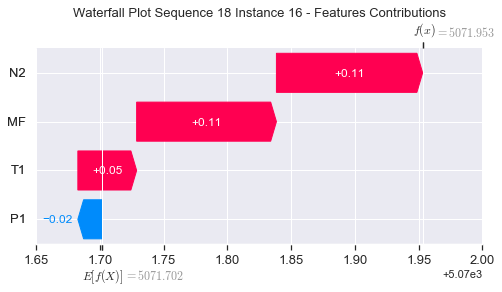

None

Contribution: [-0.00194401  0.05113989  0.11762982  0.12891602]


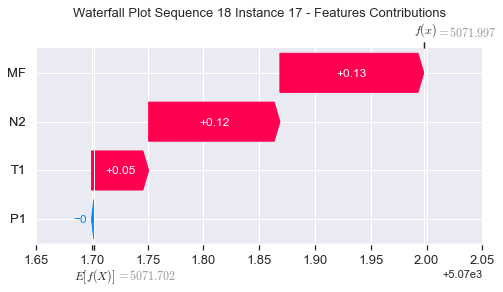

None

Contribution: [0.01106328 0.03466226 0.06454682 0.05738049]


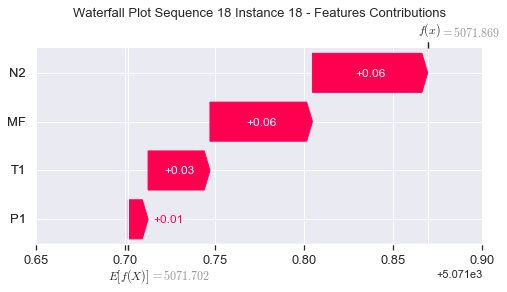

None

Contribution: [0.04434939 0.03936511 0.10777005 0.06497833]


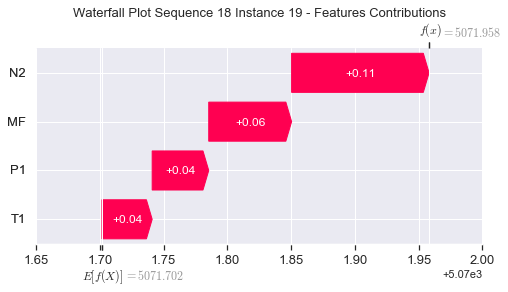

None

Contribution: [-0.10090827  0.16280007  0.51141035  0.6842156 ]


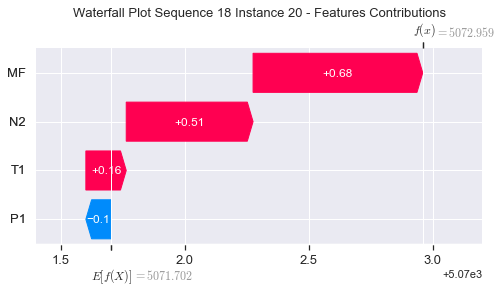

None

Contribution: [-0.1503224  -0.04348469 -0.34360545 -0.27229318]


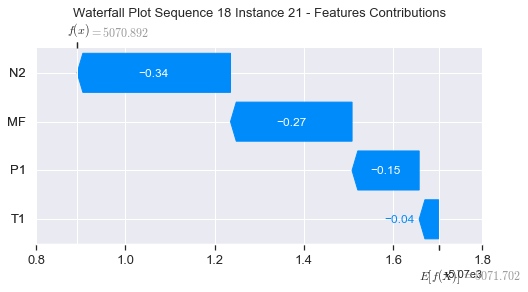

None

Contribution: [ 1.12591851 -0.57388521 -2.83817453 -4.42979821]


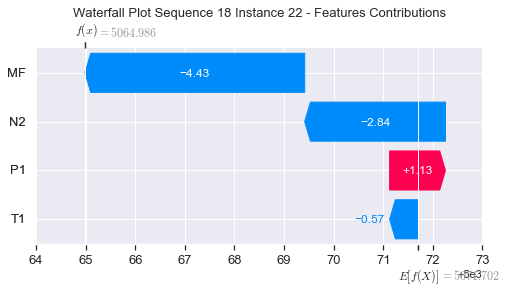

None

Contribution: [0.49271135 1.12134969 3.49016378 3.53944017]


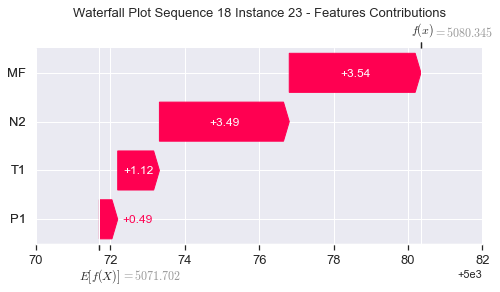

None

Contribution: [ -5.83058176 -14.38316149  19.1839678   32.39614735]


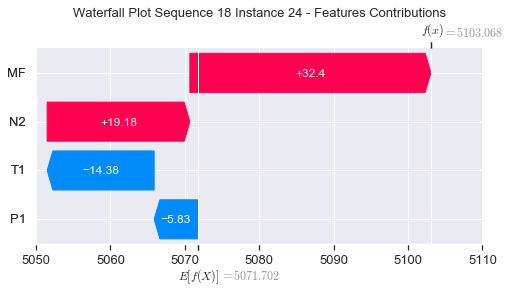

None

Contribution: [11.34520575 14.55542272 31.47517894  9.7326307 ]


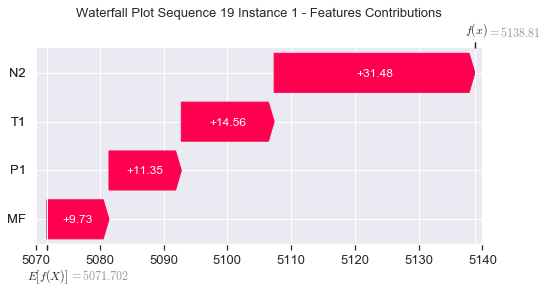

None

Contribution: [0.01653693 0.0336621  0.14652617 0.07629779]


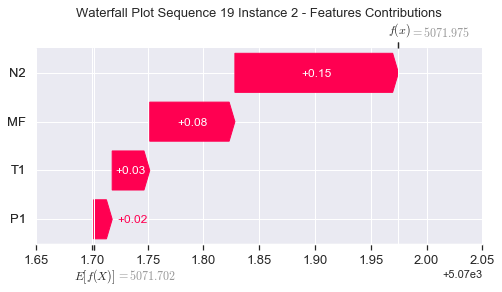

None

Contribution: [-0.03793672  0.0410443   0.17599397  0.24141742]


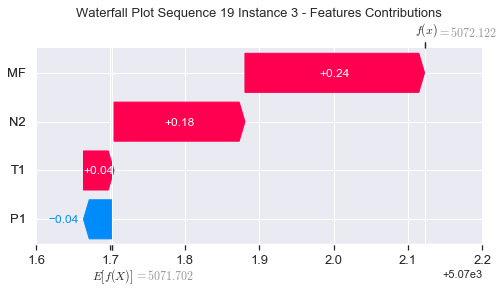

None

Contribution: [-0.05267119  0.02093397  0.06775569  0.12635736]


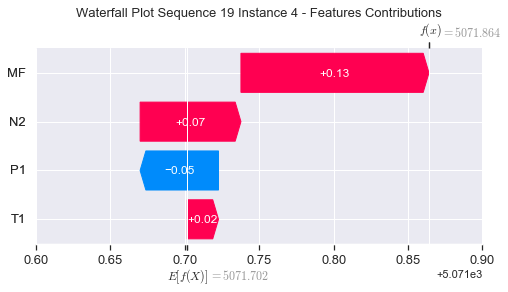

None

Contribution: [-0.01145202  0.04239371  0.1513076   0.18535923]


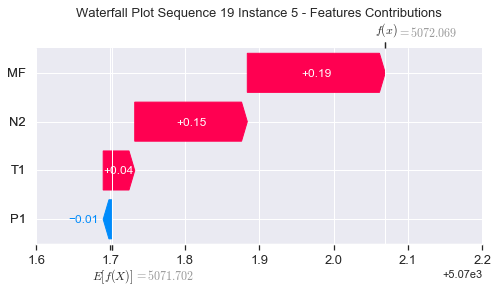

None

Contribution: [0.00291975 0.03285323 0.12619643 0.14092573]


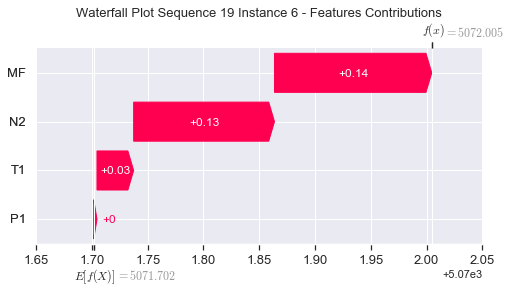

None

Contribution: [0.01179918 0.03324489 0.12299485 0.12681087]


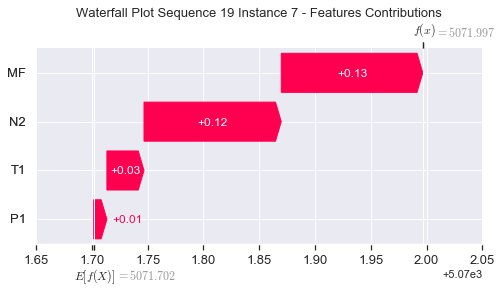

None

Contribution: [0.00818094 0.04460586 0.13323184 0.13840361]


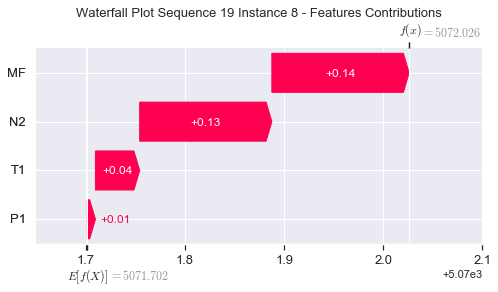

None

Contribution: [-0.00023214  0.05219355  0.1394038   0.15111085]


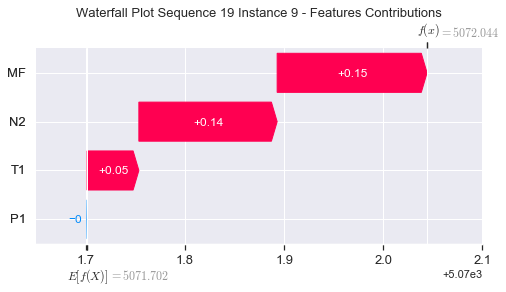

None

Contribution: [-0.00394769  0.05415385  0.13713094  0.14781647]


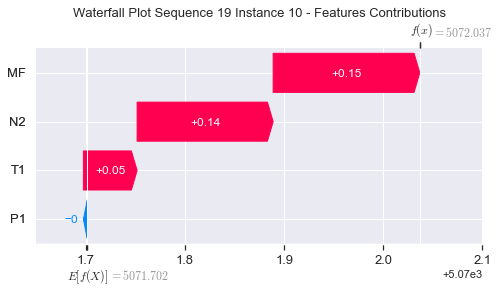

None

Contribution: [-0.00844298  0.05591181  0.13231194  0.13792133]


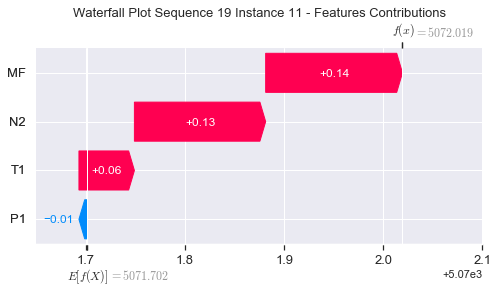

None

Contribution: [-0.00547719  0.0609298   0.13262821  0.14795855]


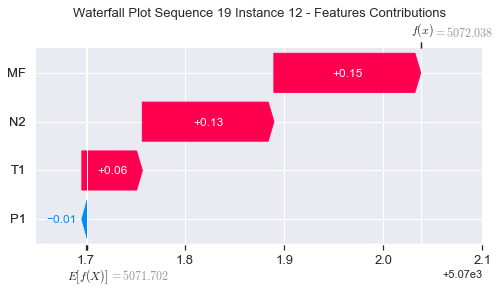

None

Contribution: [-0.00548644  0.05935335  0.12916005  0.14397705]


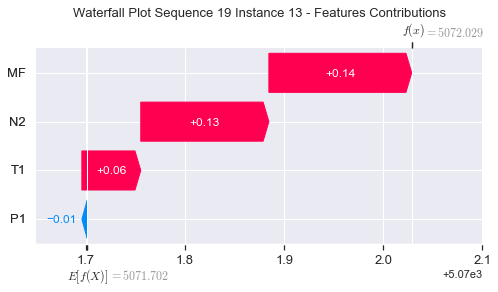

None

Contribution: [-0.0060447   0.05857612  0.12800298  0.1406272 ]


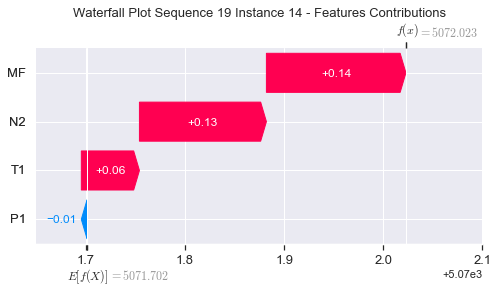

None

Contribution: [-0.00632046  0.05932108  0.12586042  0.14252076]


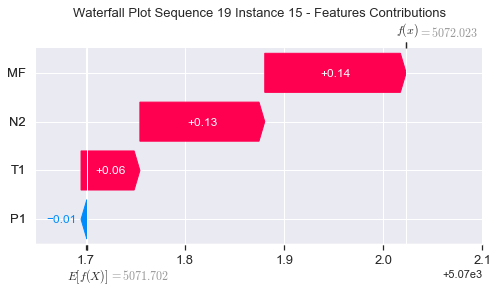

None

Contribution: [-0.01887652  0.0490658   0.11466075  0.10779961]


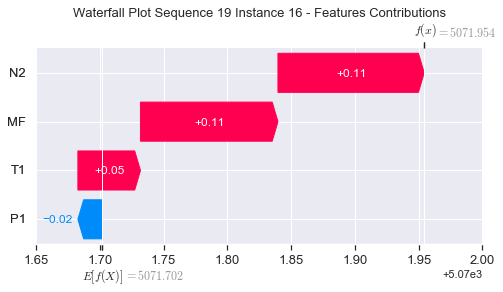

None

Contribution: [-0.0020043   0.05392368  0.11815388  0.13155933]


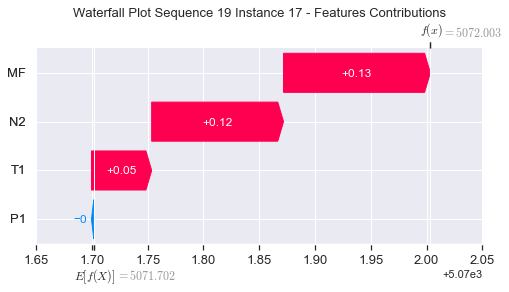

None

Contribution: [0.01128562 0.03751491 0.06463897 0.05947386]


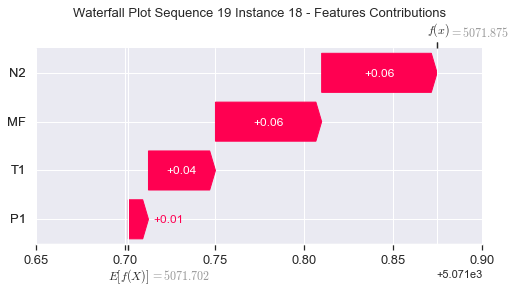

None

Contribution: [0.04341384 0.04197952 0.10986828 0.07145313]


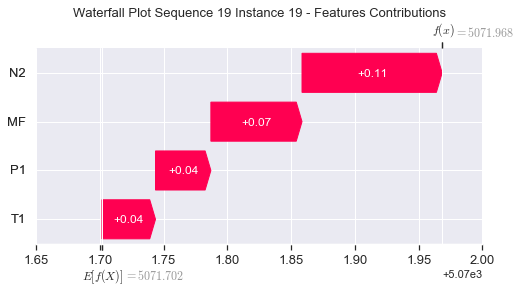

None

Contribution: [-0.10317126  0.16440342  0.51465731  0.69040812]


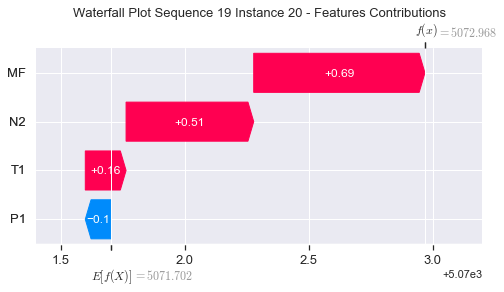

None

Contribution: [-0.15183621 -0.04387226 -0.3507751  -0.28521918]


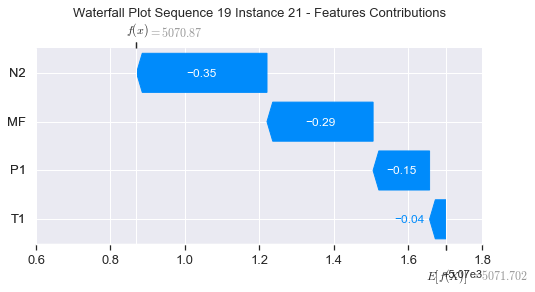

None

Contribution: [ 1.16247483 -0.54146036 -2.84326626 -4.52482324]


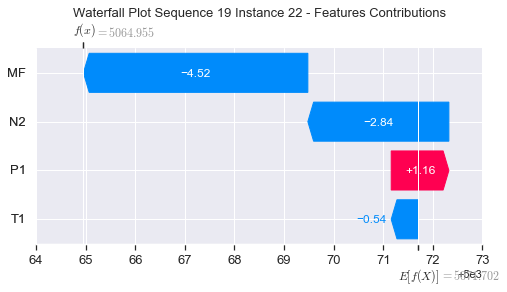

None

Contribution: [0.54275126 1.16796948 3.50501331 3.57921878]


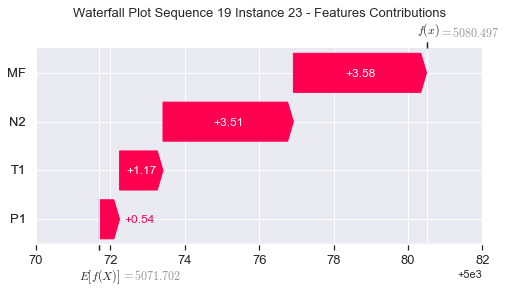

None

Contribution: [ -5.87944952 -15.97515579  18.36894483  32.21330389]


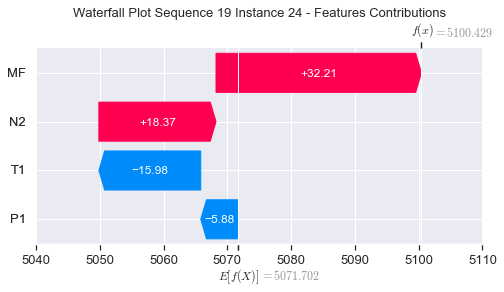

None

Contribution: [ 9.30649243 16.31044791 31.26291574  9.18198192]


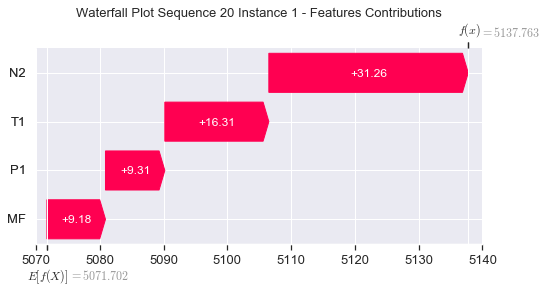

None

Contribution: [0.01867913 0.03492715 0.15178321 0.08135687]


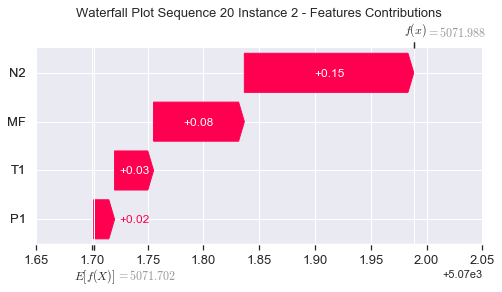

None

Contribution: [-0.0384886   0.04073713  0.17939511  0.24611917]


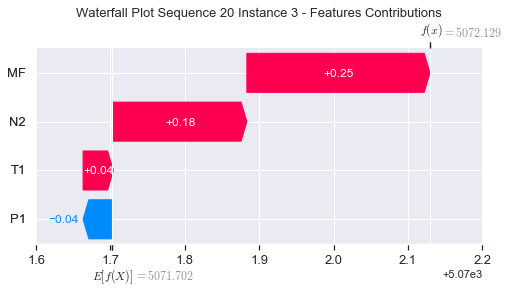

None

Contribution: [-0.05278249  0.02244388  0.06738578  0.12349044]


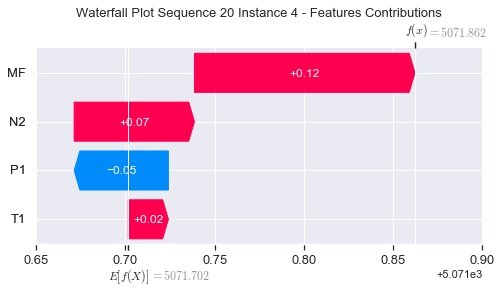

None

Contribution: [-0.01139259  0.04387412  0.15151053  0.18531217]


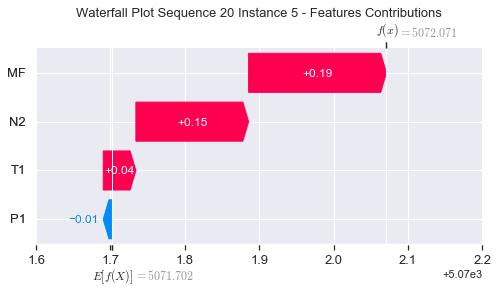

None

Contribution: [0.00311183 0.03308245 0.12607986 0.14053207]


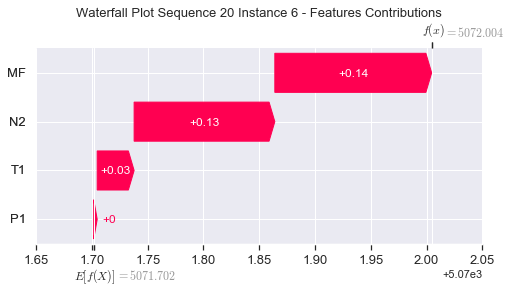

None

Contribution: [0.01203022 0.03288706 0.12293748 0.12663581]


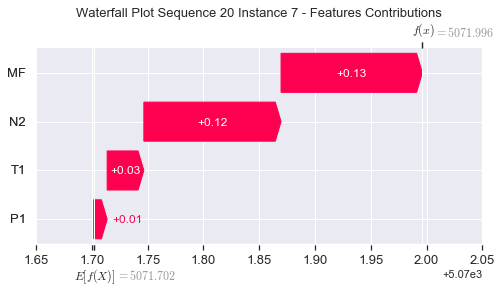

None

Contribution: [0.00841936 0.04337147 0.13332705 0.13870047]


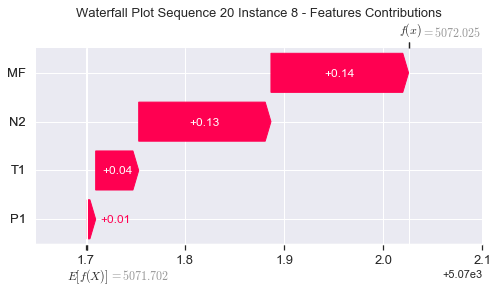

None

Contribution: [-0.000399    0.0519948   0.13976881  0.15228811]


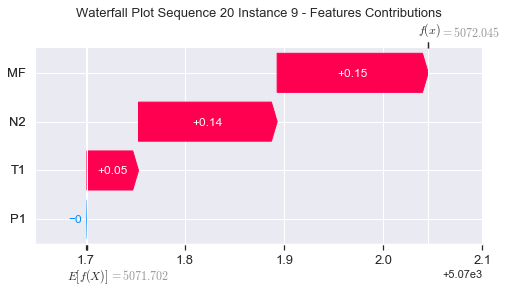

None

Contribution: [-0.00323837  0.05882281  0.13784641  0.14713537]


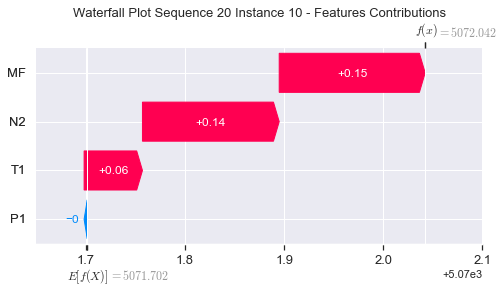

None

Contribution: [-0.00833108  0.05416148  0.13291141  0.13950892]


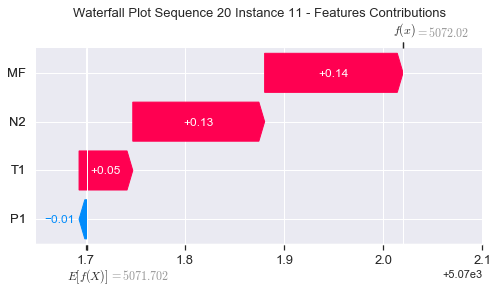

None

Contribution: [-0.0052194   0.05647682  0.13235886  0.14586182]


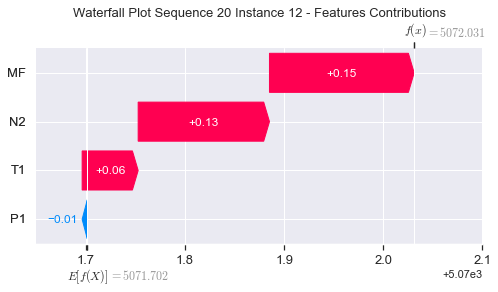

None

Contribution: [-0.00534167  0.05544069  0.1289873   0.1421348 ]


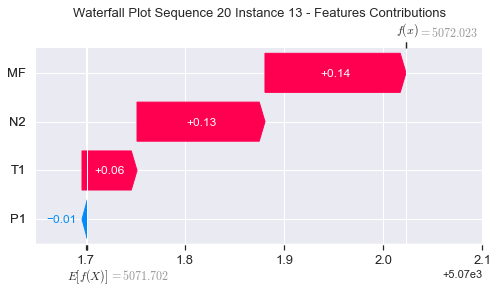

None

Contribution: [-0.00610246  0.05460546  0.12853305  0.14265359]


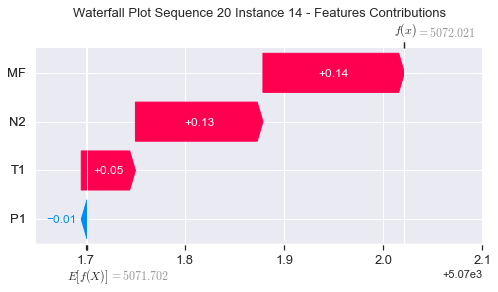

None

Contribution: [-0.00625673  0.05580792  0.12566251  0.14108022]


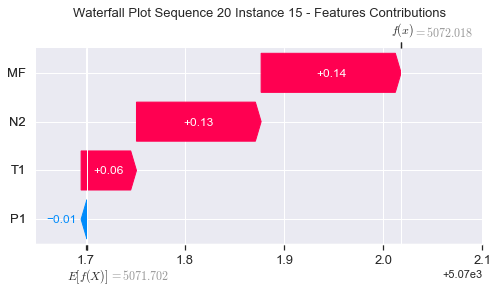

None

Contribution: [-0.01847137  0.05077589  0.1142981   0.10633702]


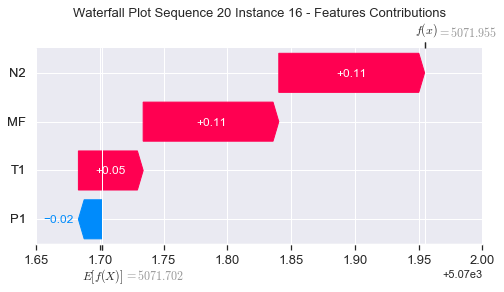

None

Contribution: [-0.00205892  0.05155142  0.11824783  0.13049056]


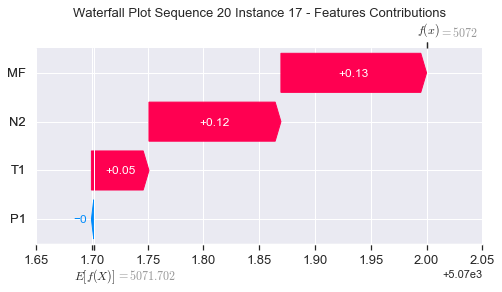

None

Contribution: [0.01092642 0.03535333 0.06508839 0.05886689]


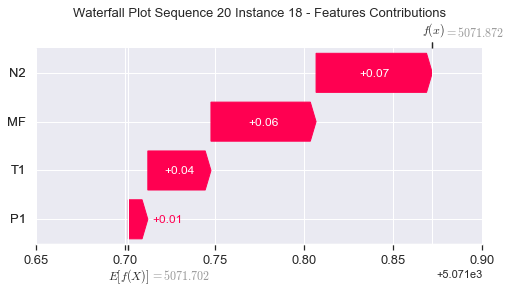

None

Contribution: [0.04475953 0.03917556 0.10766541 0.06630716]


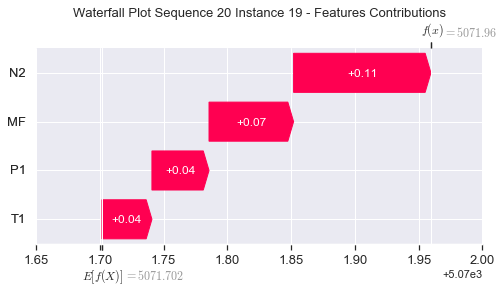

None

Contribution: [-0.10155634  0.16365959  0.51086139  0.6854155 ]


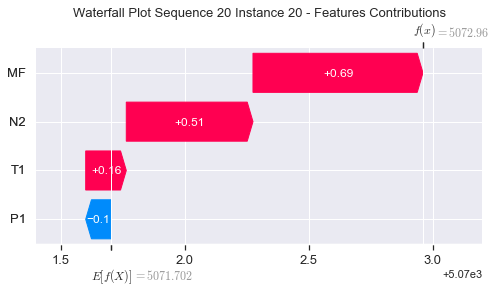

None

Contribution: [-0.15247305 -0.04336804 -0.34121027 -0.27653927]


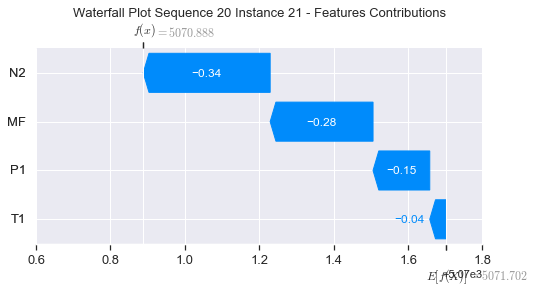

None

Contribution: [ 1.16202612 -0.61178629 -2.82569767 -4.54860285]


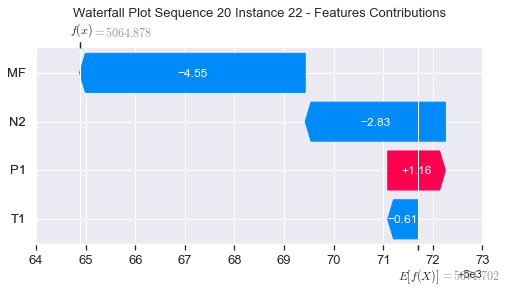

None

Contribution: [0.55769578 1.11671113 3.47786513 3.5391207 ]


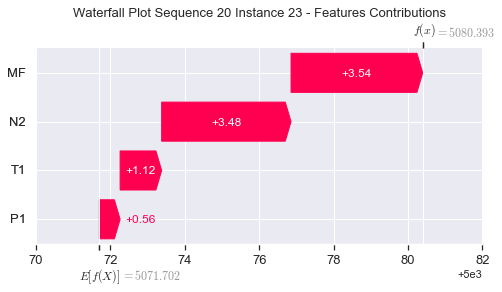

None

Contribution: [ -6.59733907 -14.01632313  18.53731595  35.32580751]


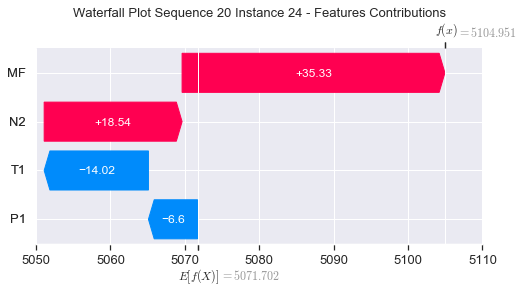

None

Contribution: [10.71960317 14.74199287 31.07684082  9.91237168]


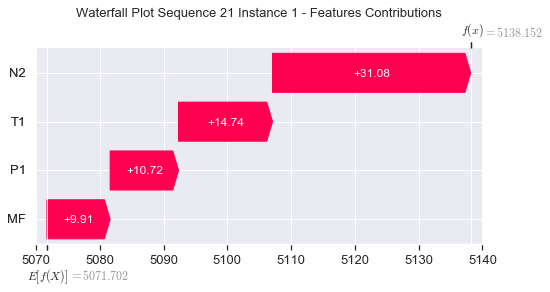

None

Contribution: [0.01832141 0.03606352 0.14702474 0.08051857]


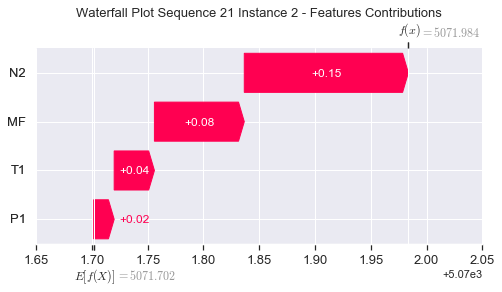

None

Contribution: [-0.03901075  0.04402056  0.17553807  0.24350584]


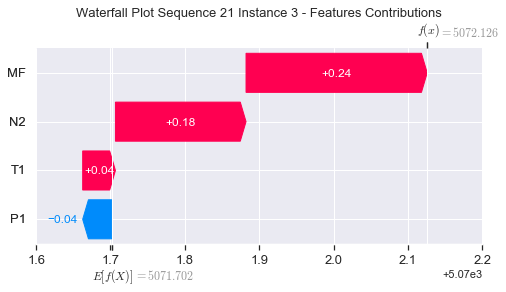

None

Contribution: [-0.05279851  0.02522335  0.06655854  0.12517771]


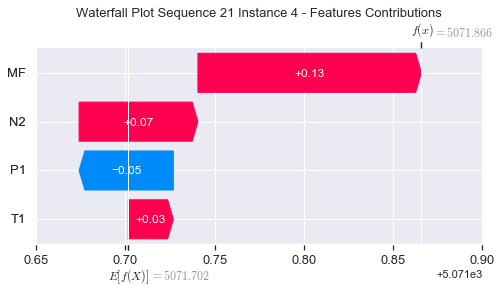

None

Contribution: [-0.01139452  0.04338178  0.150611    0.18511873]


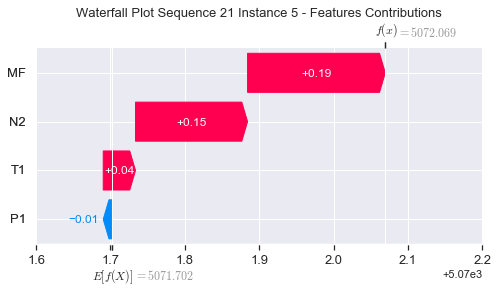

None

Contribution: [0.00309786 0.03340969 0.1260161  0.14115007]


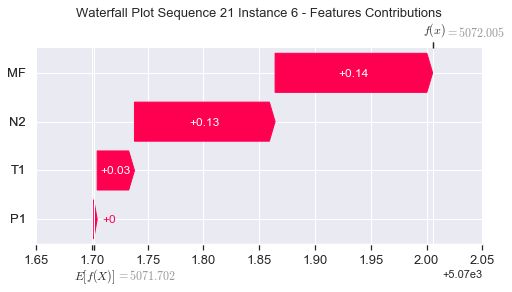

None

Contribution: [0.01219447 0.03283476 0.12279929 0.12610074]


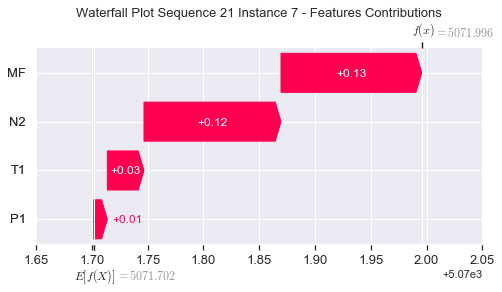

None

Contribution: [0.00904441 0.04299461 0.1328603  0.13628611]


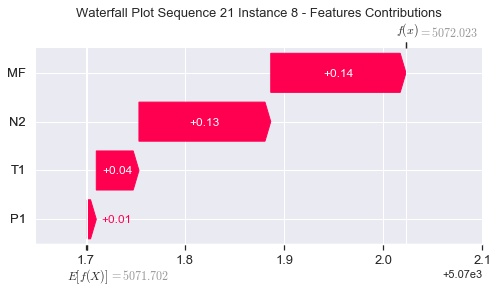

None

Contribution: [0.00044627 0.0516533  0.13934538 0.1492502 ]


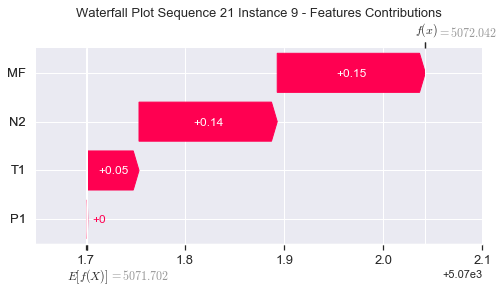

None

Contribution: [-0.00498657  0.05372356  0.13706191  0.14708297]


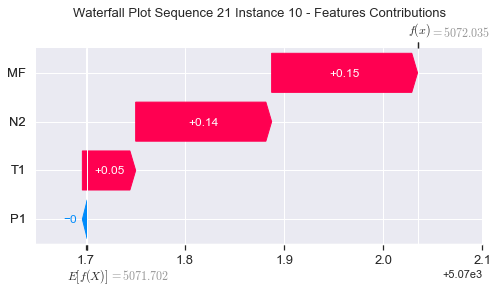

None

Contribution: [-0.00763605  0.05337809  0.13165803  0.1328882 ]


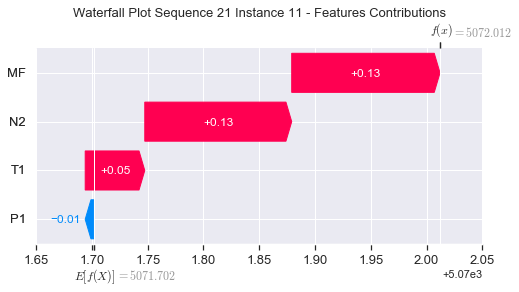

None

Contribution: [-0.00533767  0.05967724  0.13196381  0.14394475]


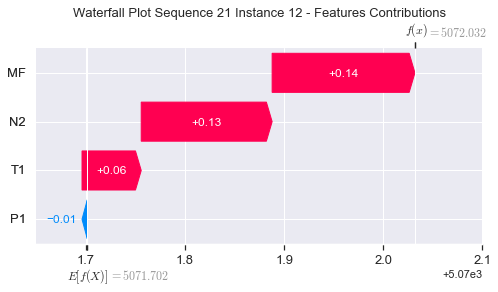

None

Contribution: [-0.00544127  0.05871063  0.12867901  0.14087477]


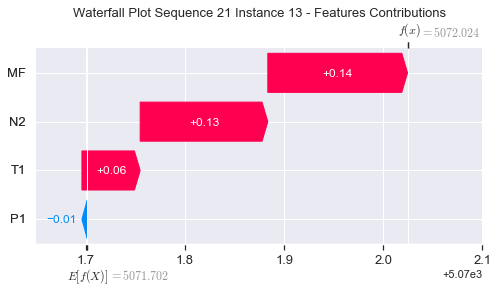

None

Contribution: [-0.0057932   0.05884514  0.12784382  0.14068446]


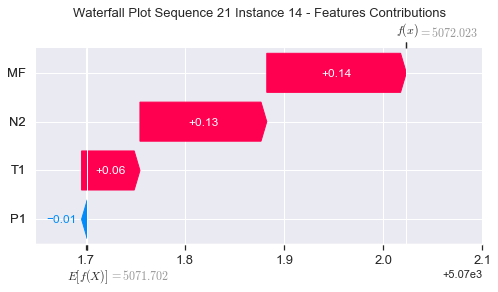

None

Contribution: [-0.00614911  0.05867358  0.12504298  0.13906691]


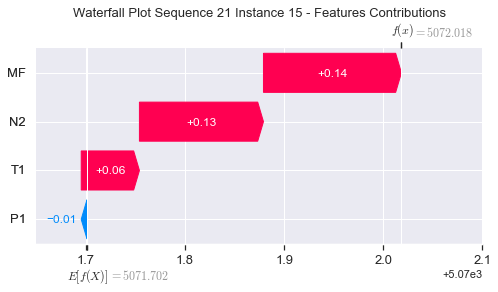

None

Contribution: [-0.01862103  0.04987881  0.11378253  0.10295   ]


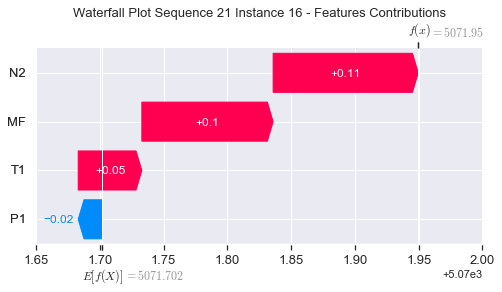

None

Contribution: [-0.00193703  0.05464451  0.11730428  0.12875816]


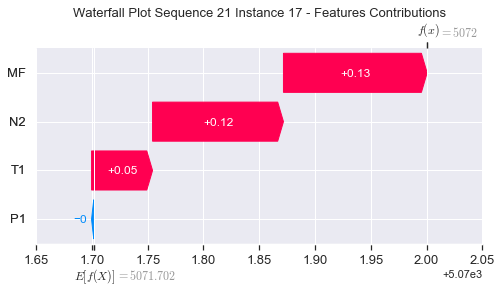

None

Contribution: [0.01161054 0.03849663 0.06307547 0.05537226]


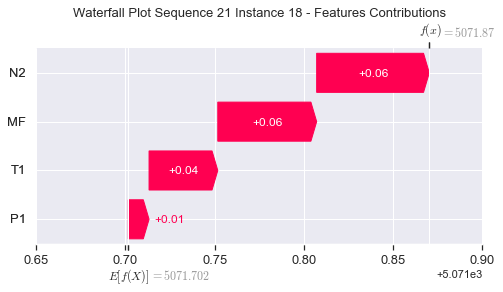

None

Contribution: [0.04538489 0.04442403 0.10804938 0.06290885]


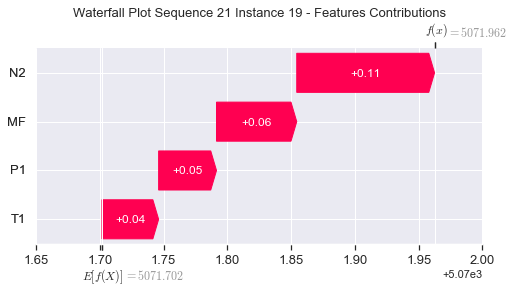

None

Contribution: [-0.10361678  0.16293095  0.51675964  0.69369466]


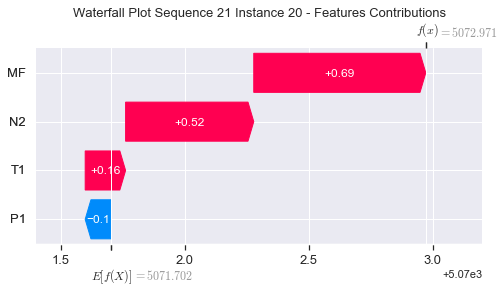

None

Contribution: [-0.15216406 -0.04080916 -0.35490259 -0.28793804]


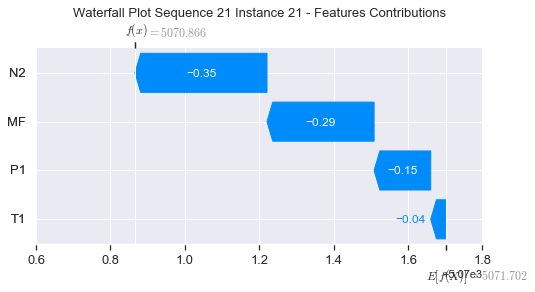

None

Contribution: [ 1.16166944 -0.43782642 -2.87905665 -4.558207  ]


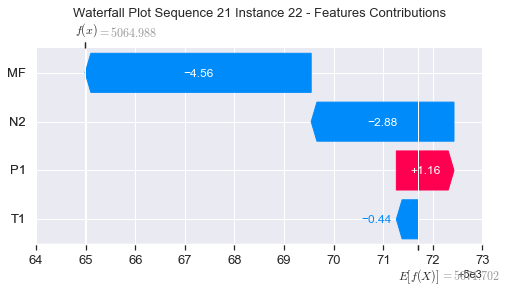

None

Contribution: [0.5663845  1.25081538 3.52734107 3.58007443]


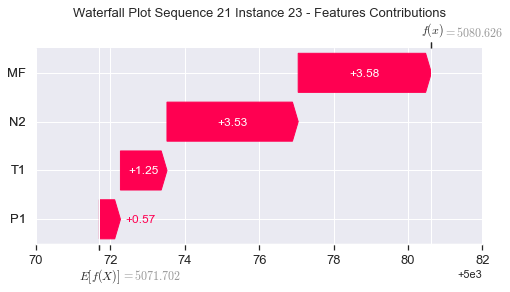

None

Contribution: [ -5.86927606 -18.77898651  19.22569142  32.80877368]


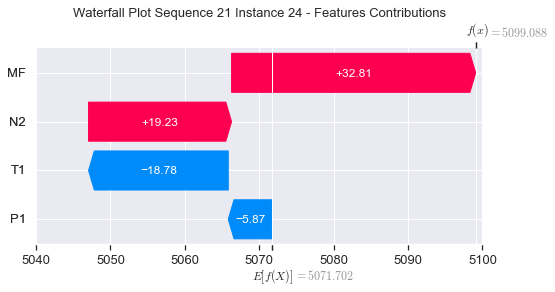

None

Contribution: [ 8.43573525 18.01183758 31.65329185  9.21709635]


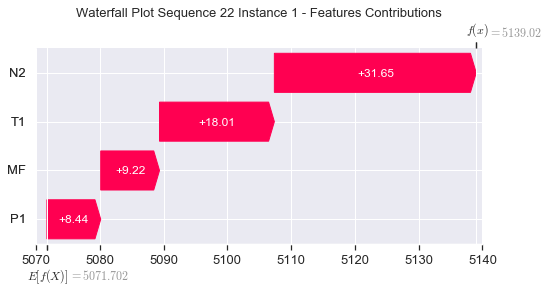

None

Contribution: [0.01790386 0.03050747 0.15505661 0.08224625]


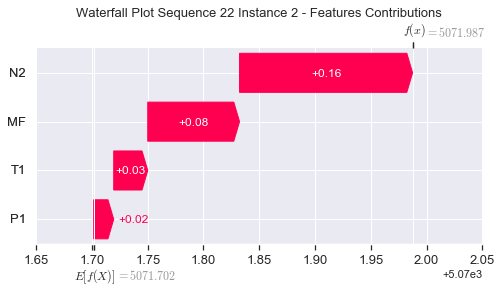

None

Contribution: [-0.03835433  0.03805881  0.18103885  0.24965597]


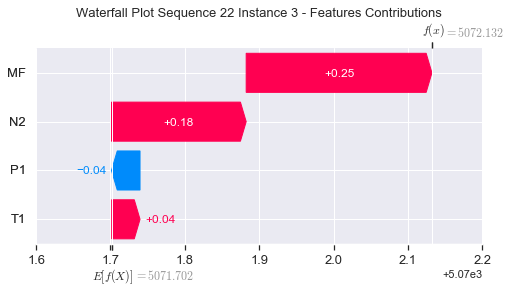

None

Contribution: [-0.0531818   0.01841863  0.06840051  0.1280213 ]


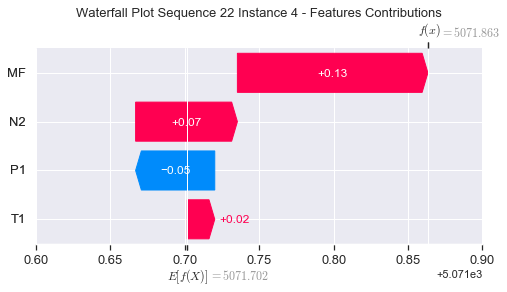

None

Contribution: [-0.0112367   0.03964608  0.1518621   0.18652053]


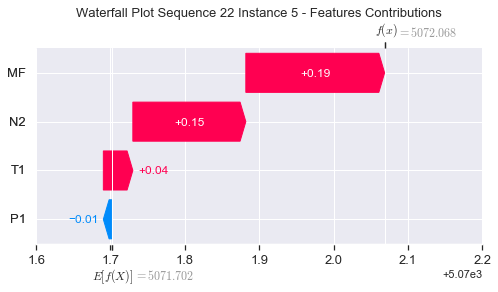

None

Contribution: [0.00323889 0.03203098 0.12610987 0.14126072]


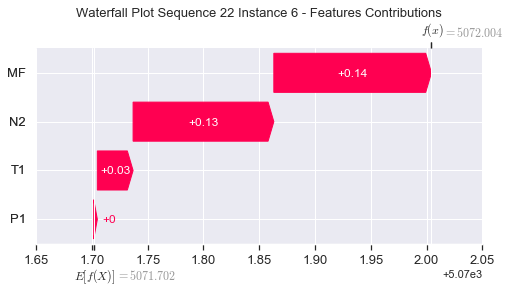

None

Contribution: [0.01224134 0.03354746 0.12320179 0.12640604]


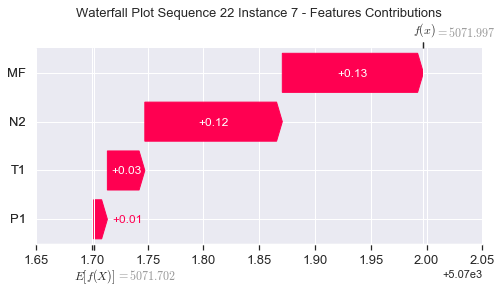

None

Contribution: [0.00857455 0.04578136 0.13396117 0.13755569]


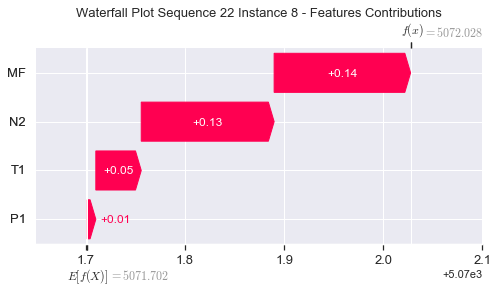

None

Contribution: [-5.44623266e-05  5.49815033e-02  1.41030634e-01  1.52019830e-01]


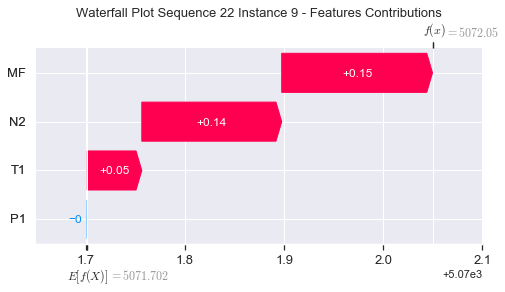

None

Contribution: [-0.00316128  0.05520991  0.13851828  0.15000116]


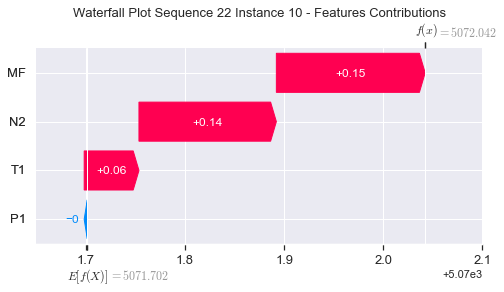

None

Contribution: [-0.00806303  0.05431642  0.13393891  0.13982188]


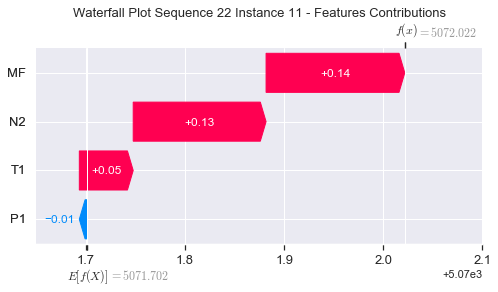

None

Contribution: [-0.00536611  0.05929174  0.13291374  0.14361532]


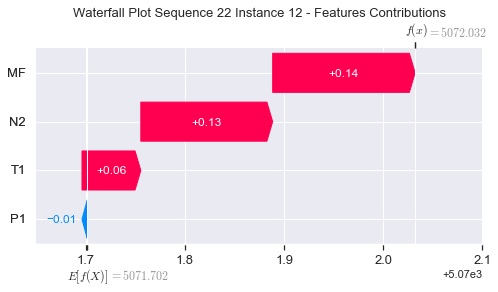

None

Contribution: [-0.0054593   0.05863977  0.12957763  0.13987495]


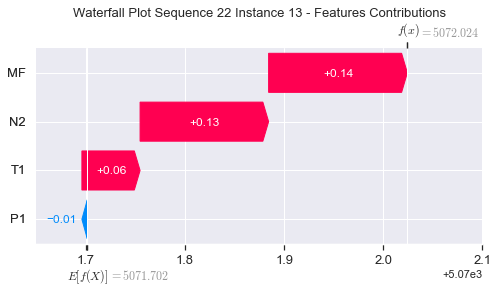

None

Contribution: [-0.00624812  0.05783996  0.1287983   0.139325  ]


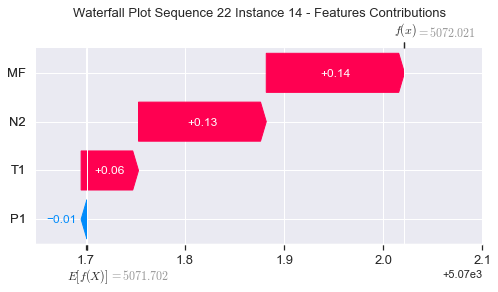

None

Contribution: [-0.00627623  0.05817036  0.12586721  0.1378927 ]


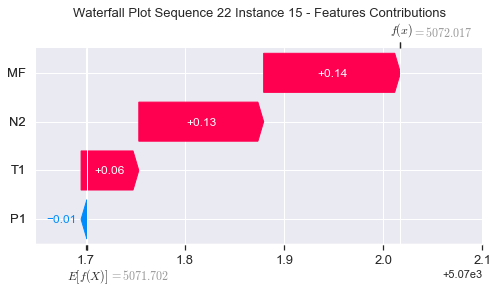

None

Contribution: [-0.01786616  0.05032268  0.11440111  0.10406691]


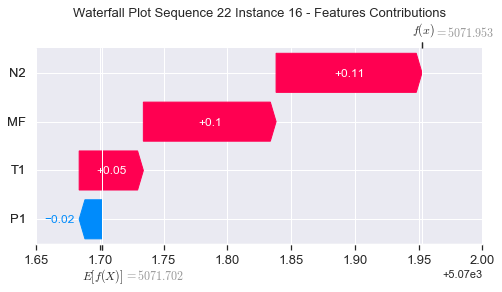

None

Contribution: [-0.00206399  0.05272443  0.11884559  0.12727385]


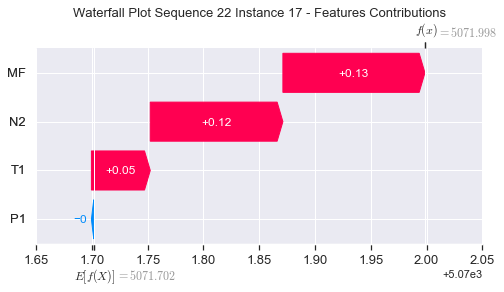

None

Contribution: [0.01049898 0.03557606 0.06671766 0.05642625]


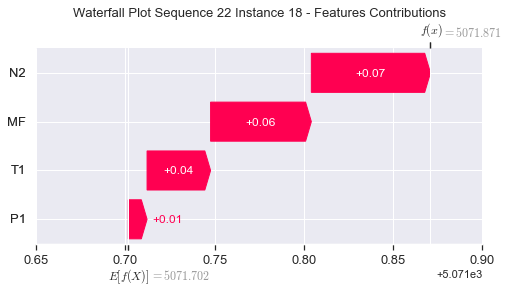

None

Contribution: [0.04329741 0.0396531  0.10656626 0.06504238]


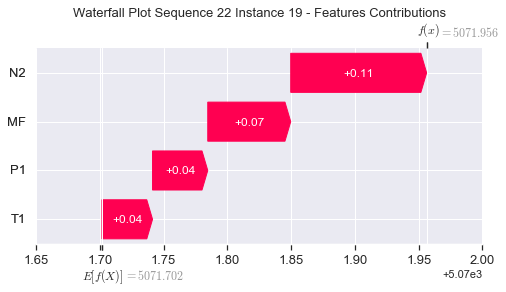

None

Contribution: [-0.09981294  0.16186061  0.50473707  0.67950773]


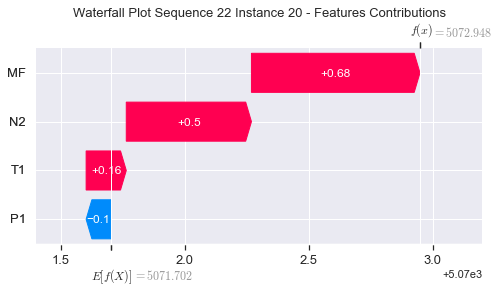

None

Contribution: [-0.15317437 -0.0407558  -0.32887028 -0.26711937]


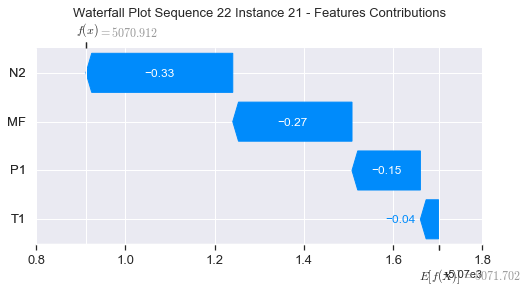

None

Contribution: [ 1.14940142 -0.64148994 -2.80580592 -4.54791802]


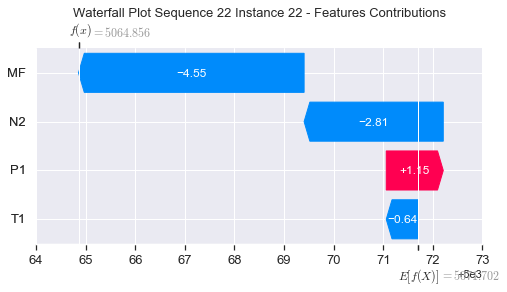

None

Contribution: [0.57218049 1.03757651 3.44137602 3.47758491]


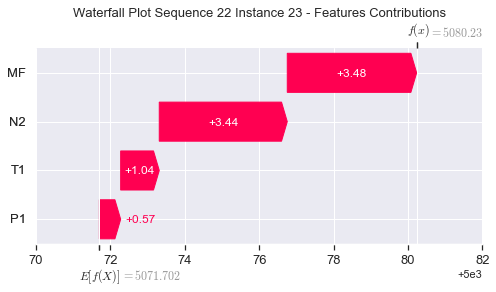

None

Contribution: [ -6.17458834 -12.3257246   19.12212944  35.78837634]


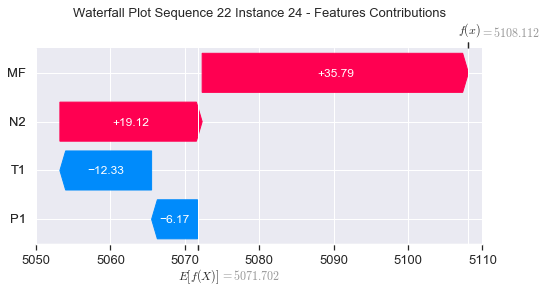

None

Contribution: [ 9.28357768 15.12933766 31.58902836  9.68335624]


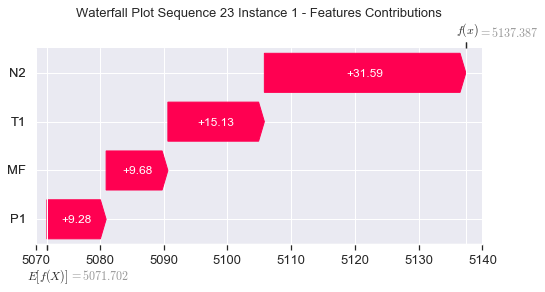

None

Contribution: [0.01778501 0.03888613 0.14930166 0.08064034]


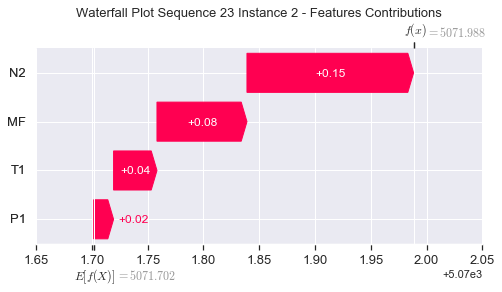

None

Contribution: [-0.03795278  0.0385462   0.1777823   0.24589243]


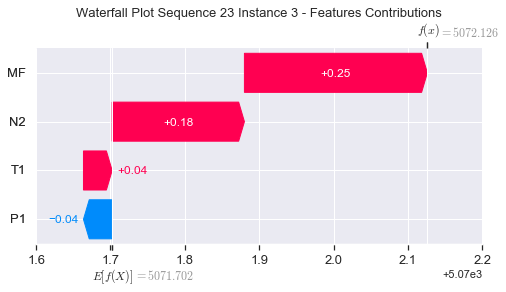

None

Contribution: [-0.05245304  0.01906529  0.06750268  0.12540303]


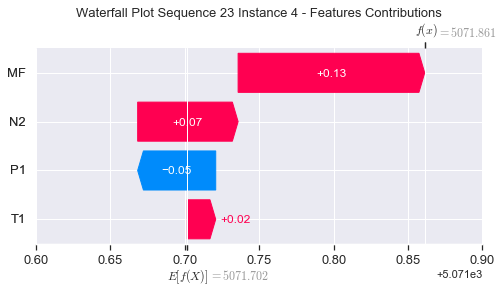

None

Contribution: [-0.01137715  0.04141968  0.15128733  0.18575306]


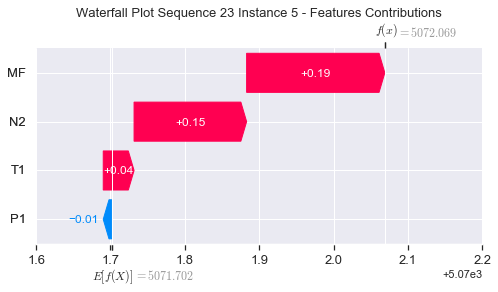

None

Contribution: [0.00310636 0.03276423 0.12607007 0.1410033 ]


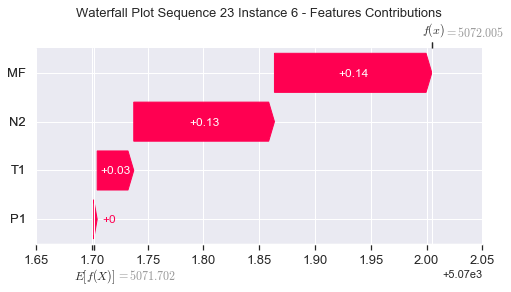

None

Contribution: [0.01222005 0.03322246 0.12282584 0.12623269]


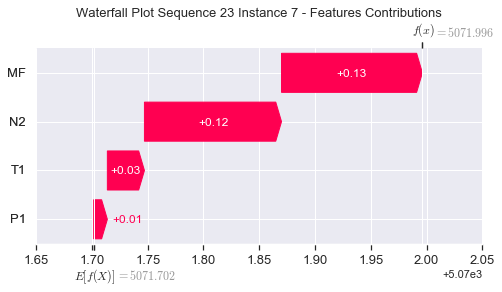

None

Contribution: [0.00883275 0.04456551 0.13294248 0.13714923]


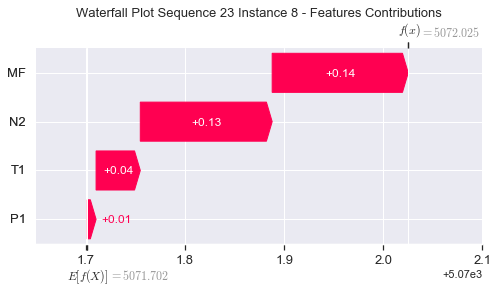

None

Contribution: [0.00038262 0.05267014 0.13915357 0.15014661]


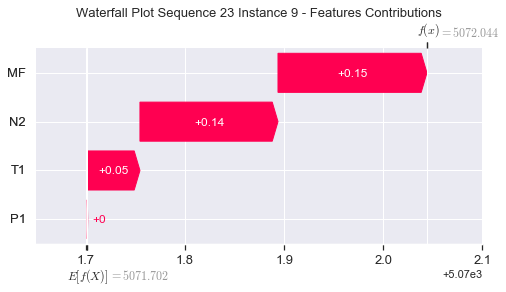

None

Contribution: [-0.00329262  0.05460026  0.13666037  0.14606428]


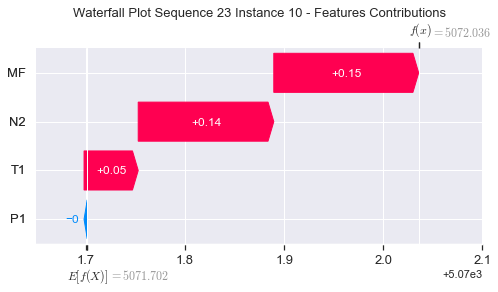

None

Contribution: [-0.00788596  0.05437071  0.13189193  0.13745107]


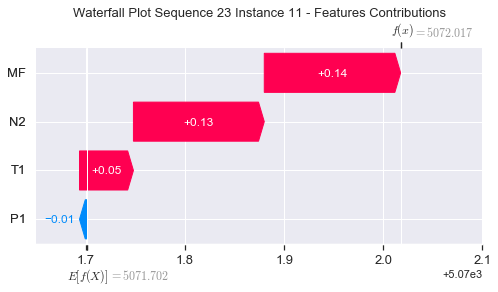

None

Contribution: [-0.00517022  0.05905532  0.13186747  0.14623529]


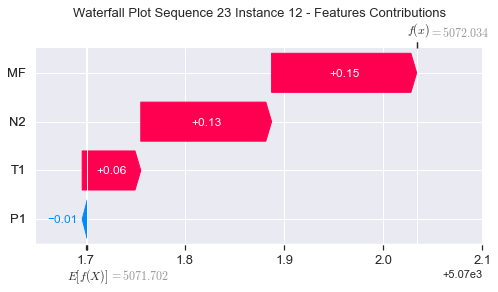

None

Contribution: [-0.00524827  0.05804385  0.12842672  0.14237978]


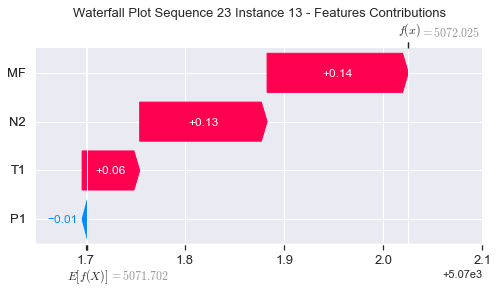

None

Contribution: [-0.00593733  0.05710288  0.12756483  0.13812052]


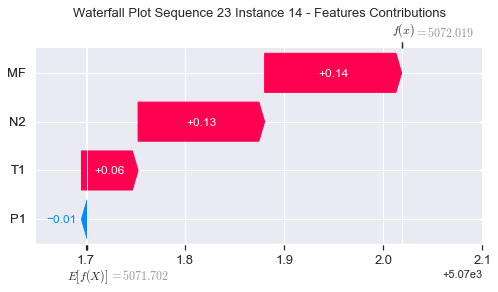

None

Contribution: [-0.00618981  0.05762908  0.12518945  0.14132825]


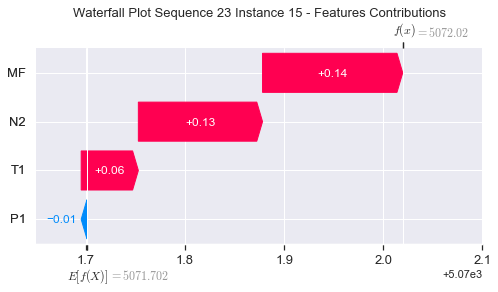

None

Contribution: [-0.01899674  0.05033936  0.11418861  0.10812972]


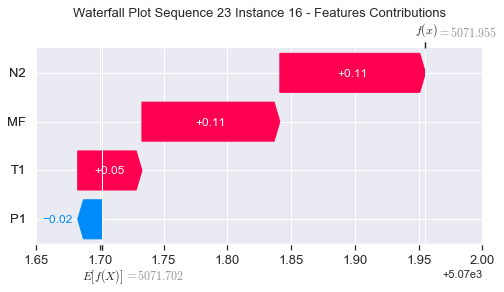

None

Contribution: [-0.00181188  0.05233401  0.11736844  0.13035596]


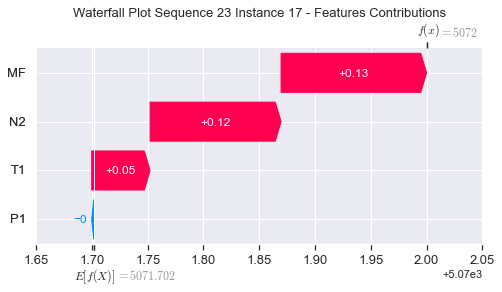

None

Contribution: [0.01149796 0.03540265 0.06362755 0.05831654]


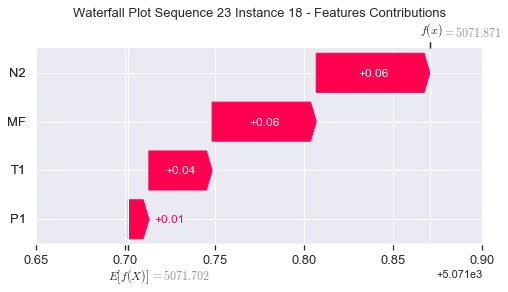

None

Contribution: [0.0448062  0.04166211 0.1089934  0.07200971]


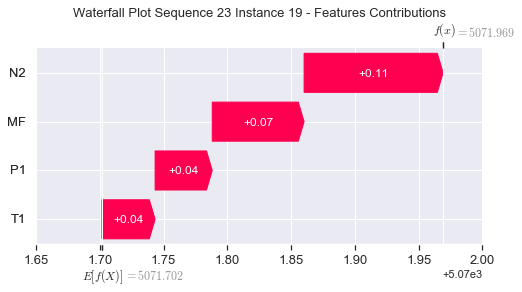

None

Contribution: [-0.103067    0.16438346  0.51495253  0.68963639]


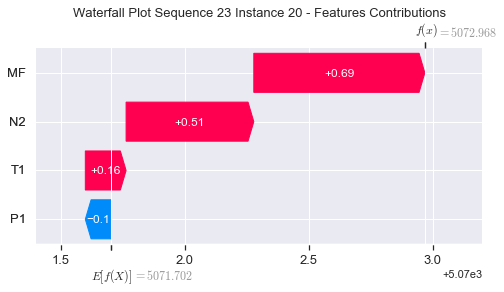

None

Contribution: [-0.15206098 -0.04444681 -0.35094906 -0.28116659]


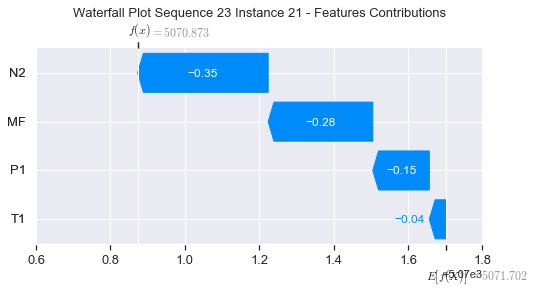

None

Contribution: [ 1.15515833 -0.56815661 -2.86281555 -4.47261711]


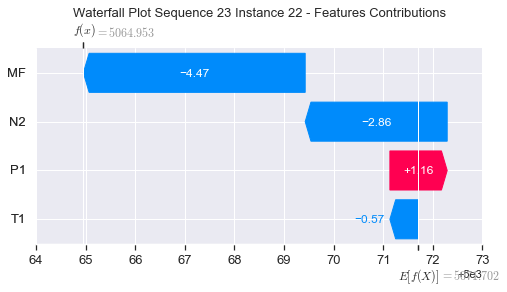

None

Contribution: [0.54733086 1.12608506 3.5135682  3.56751849]


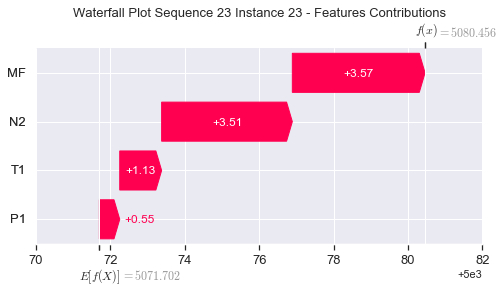

None

Contribution: [ -6.887749   -14.48105351  19.38525412  33.19019253]


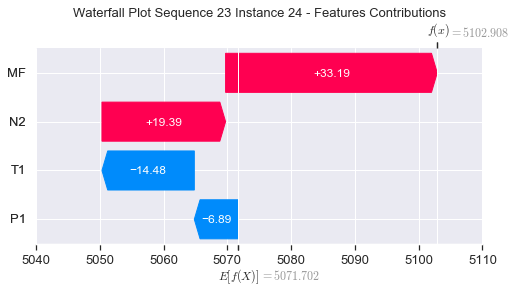

None

Contribution: [11.80277096 14.63043562 31.41401912  9.67777394]


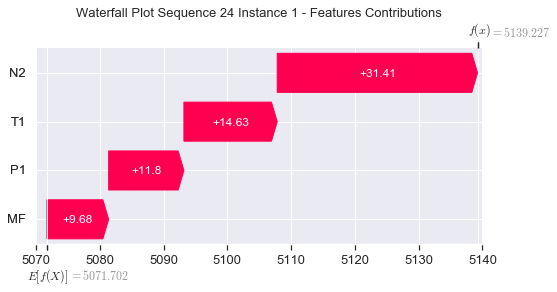

None

Contribution: [0.01667435 0.03370146 0.14700524 0.07621458]


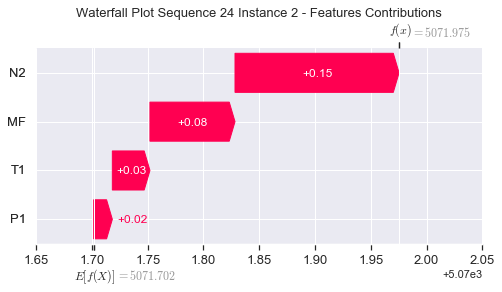

None

Contribution: [-0.03864529  0.04110293  0.17656727  0.24289931]


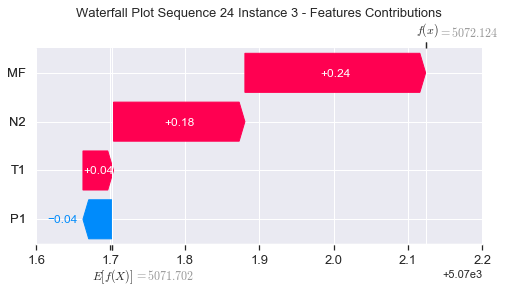

None

Contribution: [-0.05287299  0.01972058  0.06779898  0.12694769]


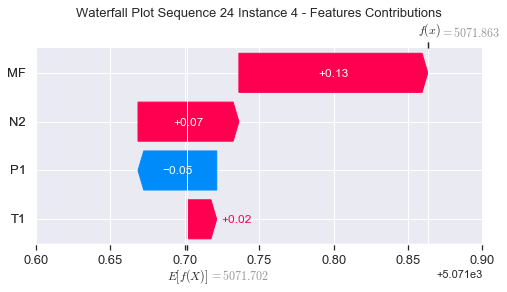

None

Contribution: [-0.01132673  0.04078721  0.15108952  0.18404898]


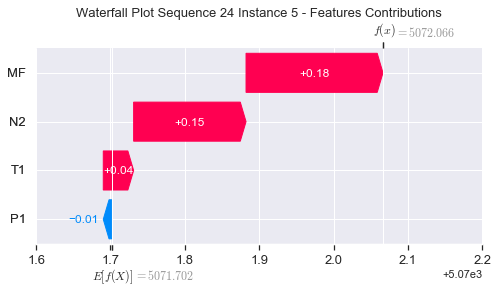

None

Contribution: [0.00323022 0.03230358 0.12587093 0.14045476]


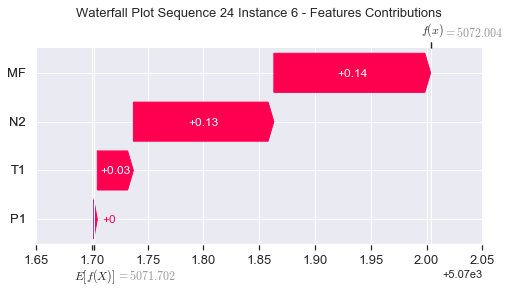

None

Contribution: [0.01232875 0.03325711 0.12270439 0.12623128]


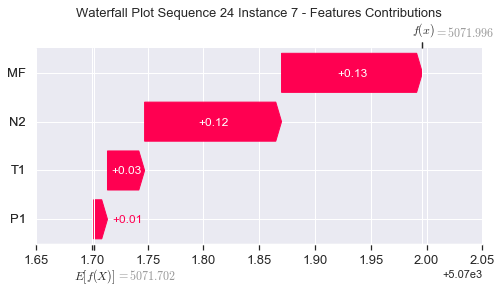

None

Contribution: [0.00887067 0.04489672 0.13299389 0.13805102]


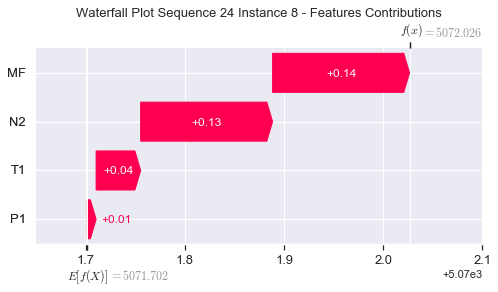

None

Contribution: [-2.59988570e-05  5.36376459e-02  1.39591499e-01  1.54080838e-01]


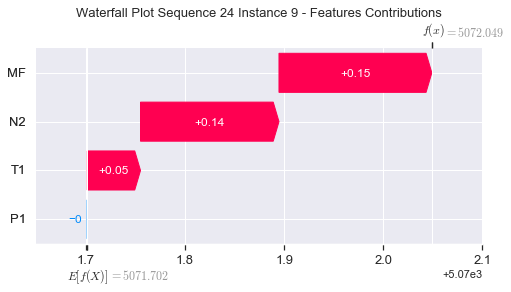

None

Contribution: [-0.00312112  0.05761537  0.13694341  0.14653121]


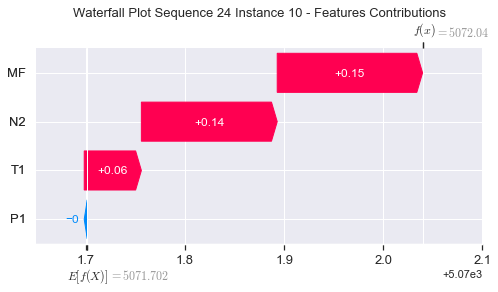

None

Contribution: [-0.00775439  0.05625724  0.1322422   0.13970342]


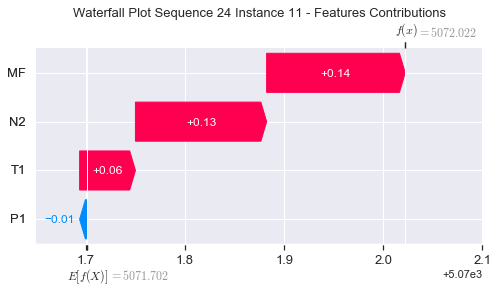

None

Contribution: [-0.0050312   0.06112447  0.13166668  0.14435479]


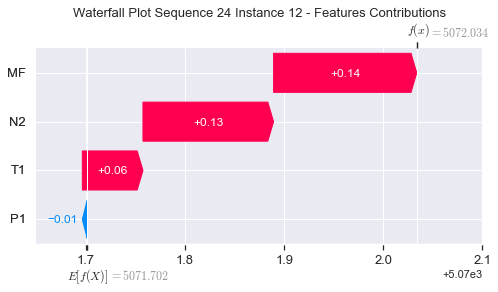

None

Contribution: [-0.00523834  0.05926894  0.12854974  0.14144471]


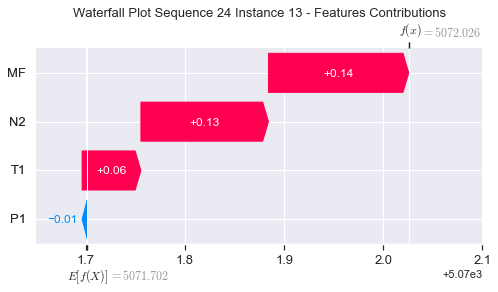

None

Contribution: [-0.00616679  0.06041819  0.12842404  0.14511129]


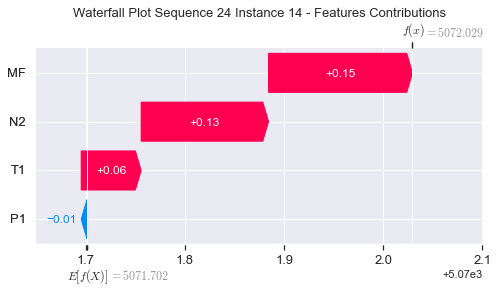

None

Contribution: [-0.00607694  0.05731659  0.12508511  0.13964502]


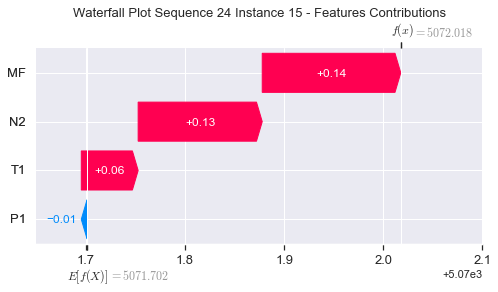

None

Contribution: [-0.01859155  0.05349164  0.11467372  0.10899254]


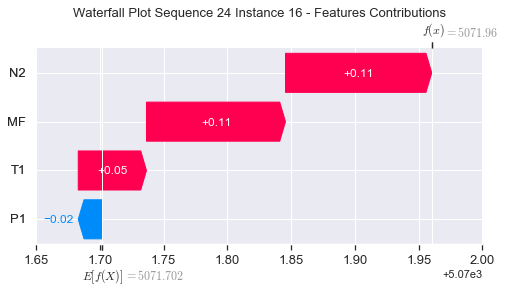

None

Contribution: [-0.00182539  0.05114607  0.11762521  0.12883653]


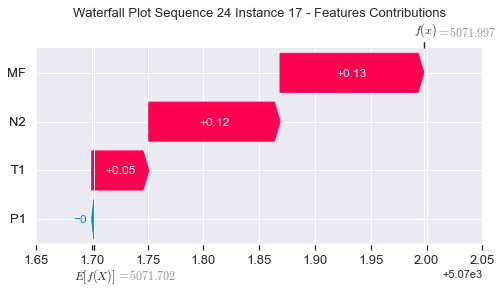

None

Contribution: [0.01114333 0.0336186  0.06520439 0.05763036]


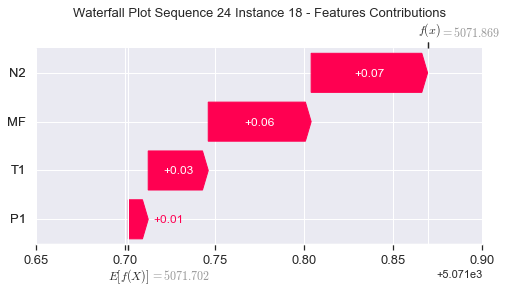

None

Contribution: [0.04388914 0.03602272 0.10689412 0.06601005]


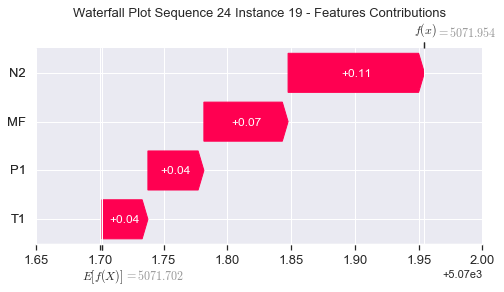

None

Contribution: [-0.10085813  0.16460774  0.50594352  0.67870052]


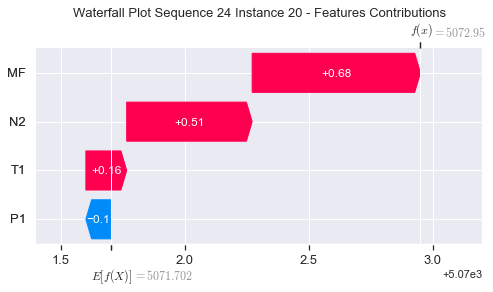

None

Contribution: [-0.15158215 -0.04713545 -0.33673247 -0.27215407]


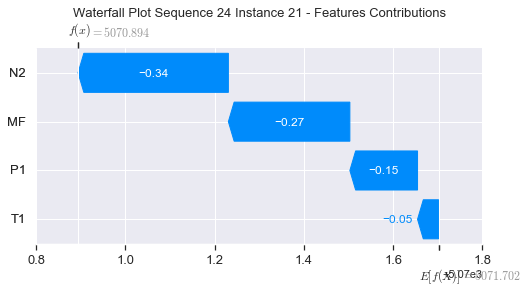

None

Contribution: [ 1.16215462 -0.74090385 -2.81265611 -4.50094407]


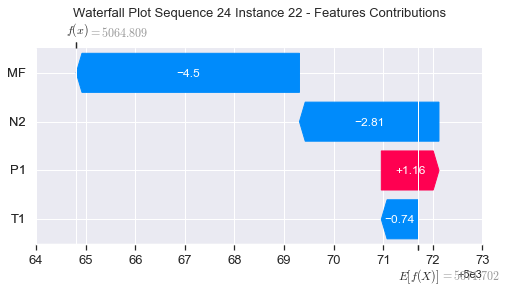

None

Contribution: [0.60333189 0.96041875 3.46496329 3.5148107 ]


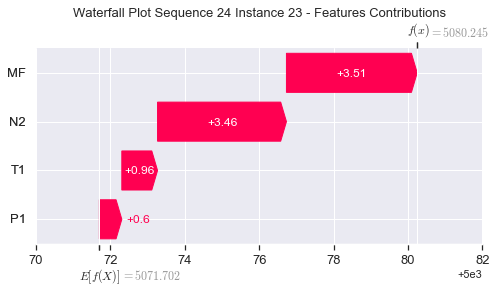

None

Contribution: [-6.89384243 -8.52207957 19.15552389 34.65139399]


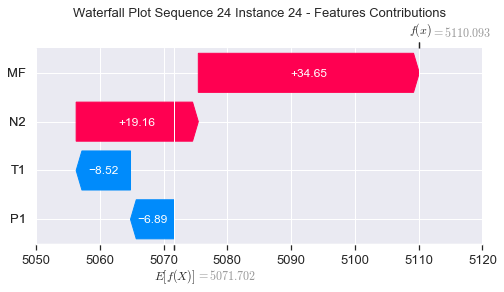

None

Contribution: [10.66117957 12.41418811 31.17404303  9.4170623 ]


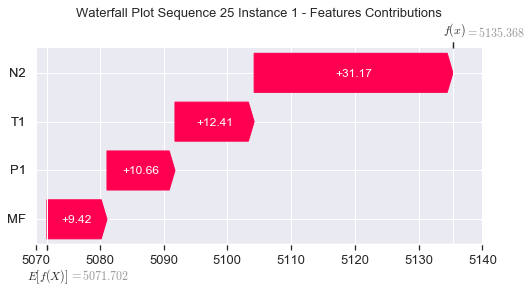

None

Contribution: [0.01828065 0.03846504 0.14731698 0.07956013]


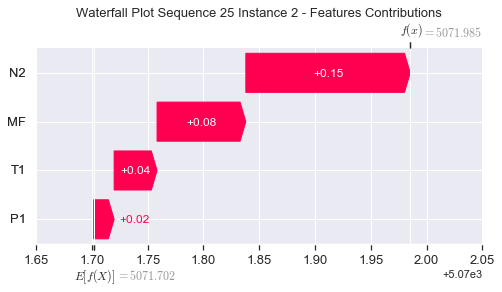

None

Contribution: [-0.03896807  0.04268143  0.17691922  0.24464795]


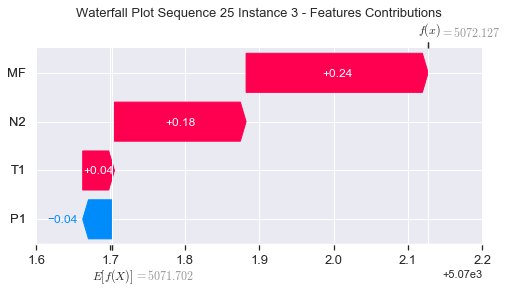

None

Contribution: [-0.05226195  0.02064013  0.06690758  0.12385905]


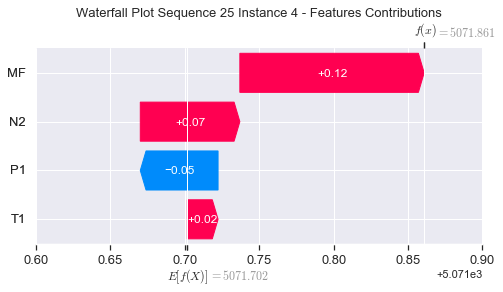

None

Contribution: [-0.0110844   0.04316707  0.15037953  0.18204591]


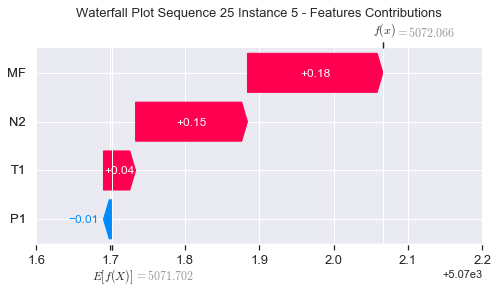

None

Contribution: [0.00322522 0.0328173  0.12517067 0.1392326 ]


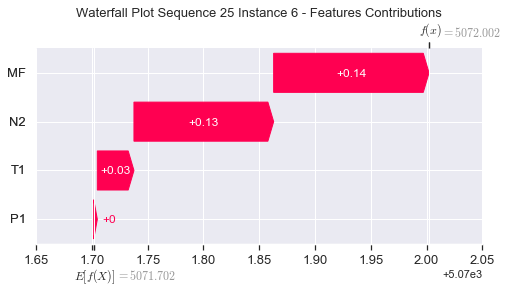

None

Contribution: [0.01210519 0.03252076 0.12142379 0.12478738]


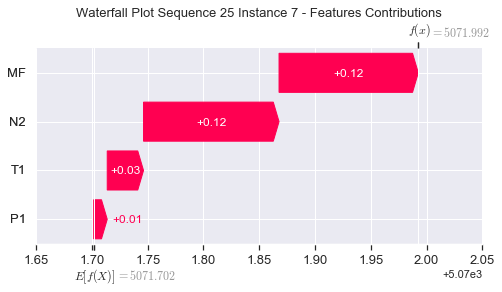

None

Contribution: [0.0086216  0.04267283 0.13161687 0.13674385]


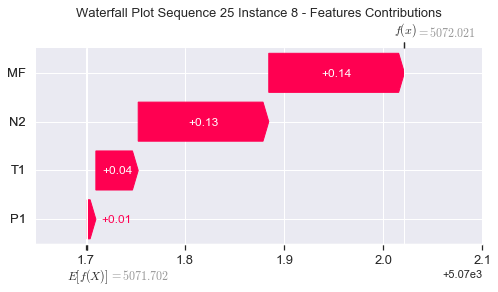

None

Contribution: [0.00087862 0.04997274 0.1378694  0.14785649]


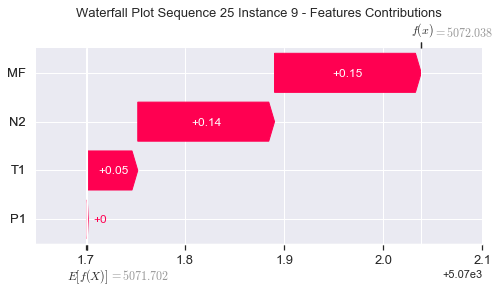

None

Contribution: [-0.00436121  0.05553253  0.13624121  0.15067495]


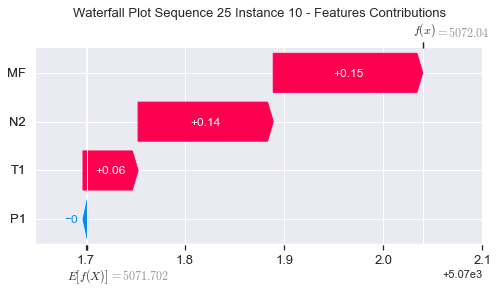

None

Contribution: [-0.00715161  0.04935314  0.13040253  0.13310973]


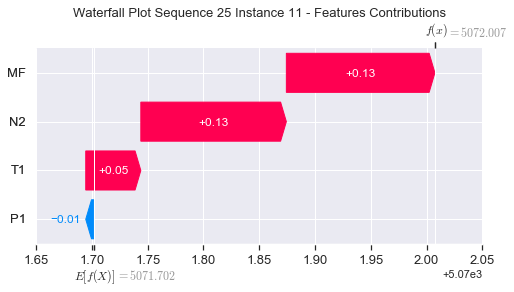

None

Contribution: [-0.00505268  0.0567644   0.1309298   0.14494771]


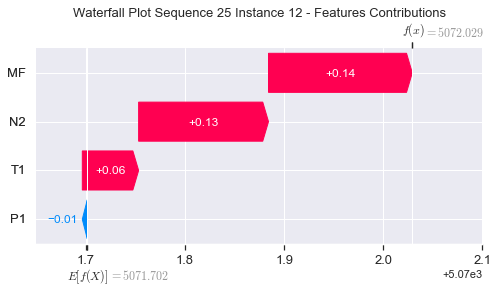

None

Contribution: [-0.00523619  0.0553729   0.12789371  0.14210696]


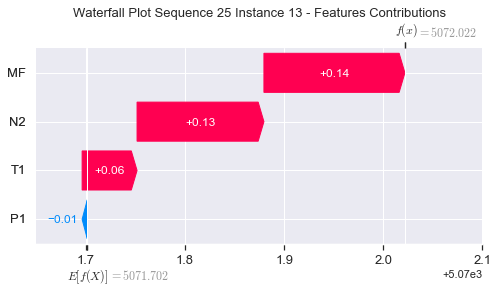

None

Contribution: [-0.00585952  0.05673647  0.12781368  0.14455868]


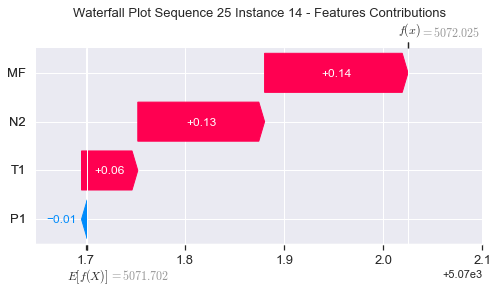

None

Contribution: [-0.00616365  0.05407954  0.12477746  0.14074549]


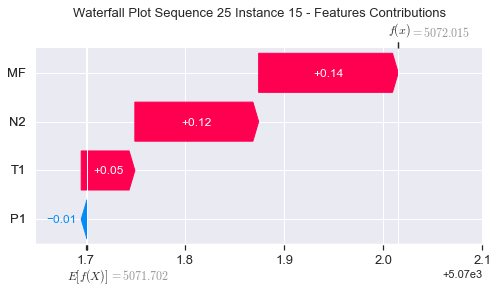

None

Contribution: [-0.01916359  0.05091094  0.11436266  0.1116554 ]


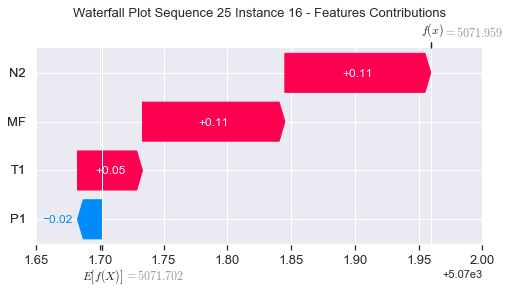

None

Contribution: [-0.00203374  0.04902657  0.11705681  0.12955443]


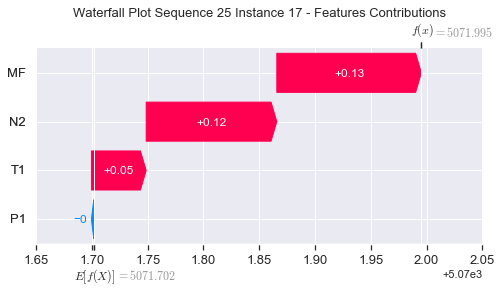

None

Contribution: [0.01119851 0.03110527 0.06385513 0.05747131]


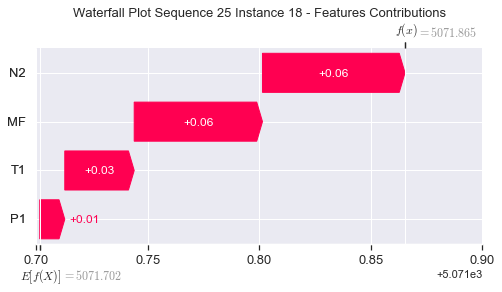

None

Contribution: [0.04479059 0.03559312 0.10876048 0.06657042]


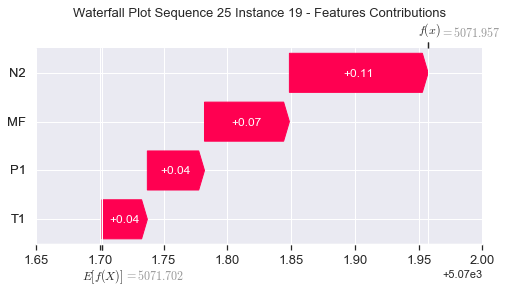

None

Contribution: [-0.10152092  0.16633953  0.50981746  0.68368391]


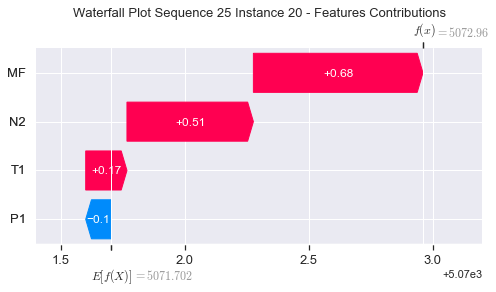

None

Contribution: [-0.1481643  -0.05153661 -0.346633   -0.28236703]


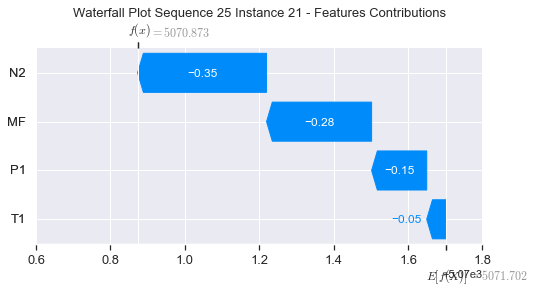

None

Contribution: [ 1.14396612 -0.79955485 -2.82767315 -4.48517843]


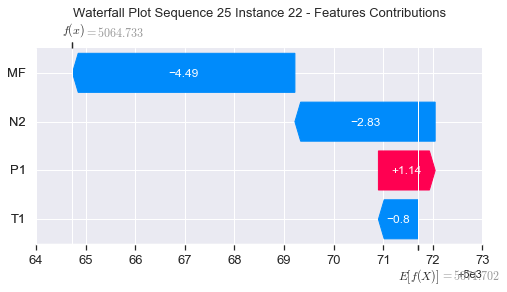

None

Contribution: [0.53575025 0.9157831  3.49522692 3.56229174]


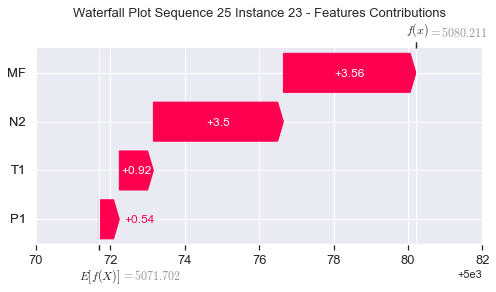

None

Contribution: [-6.2226962  -7.0286307  19.41718289 35.24791224]


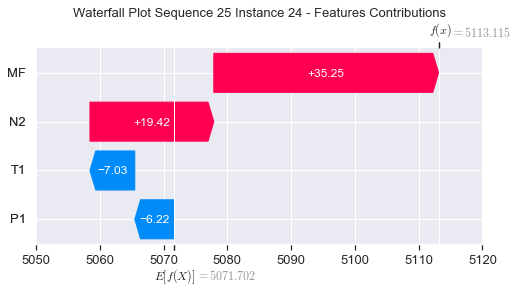

None

Contribution: [10.30947687 11.48753944 31.38579747  9.96180463]


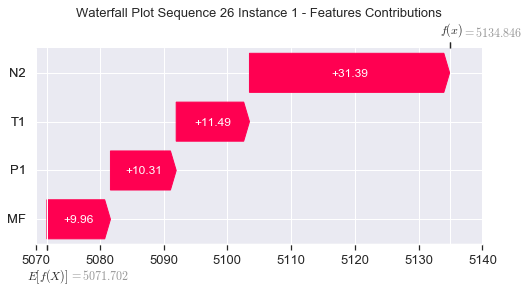

None

Contribution: [0.01705399 0.03987605 0.1454509  0.07765053]


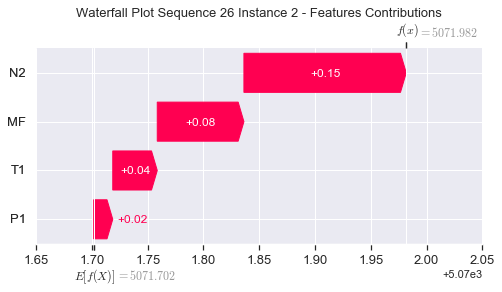

None

Contribution: [-0.03891938  0.04468778  0.17542699  0.24259461]


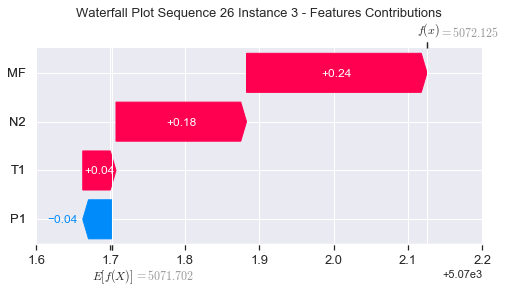

None

Contribution: [-0.05225276  0.02391242  0.06626084  0.12419482]


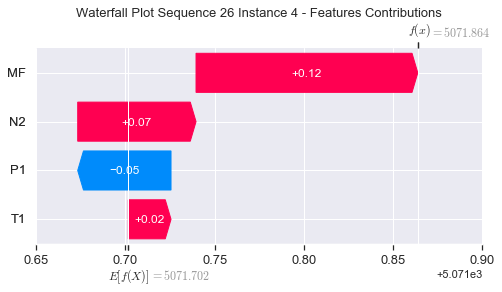

None

Contribution: [-0.01107193  0.04439248  0.14963476  0.18250182]


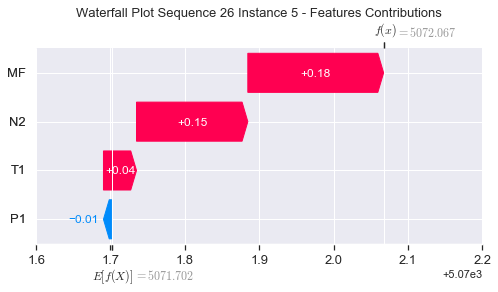

None

Contribution: [0.00323863 0.03322671 0.12482509 0.13908163]


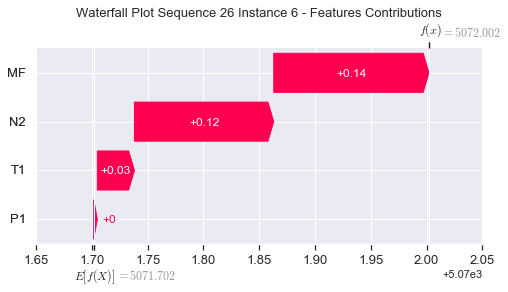

None

Contribution: [0.01217704 0.03191715 0.12092841 0.12391741]


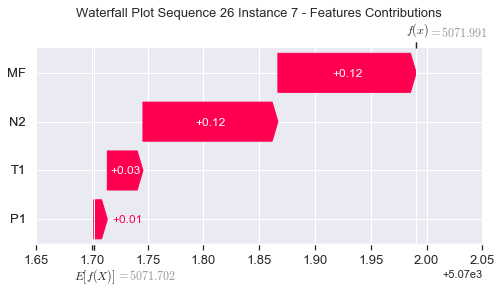

None

Contribution: [0.00887301 0.04065895 0.13068243 0.13475122]


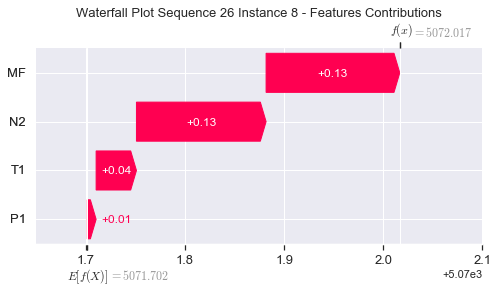

None

Contribution: [0.0006015  0.04742796 0.13727277 0.14908198]


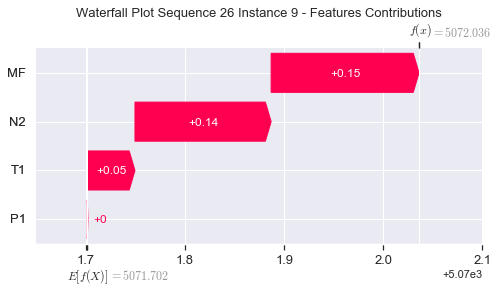

None

Contribution: [-0.0032382   0.04909111  0.13475232  0.1435259 ]


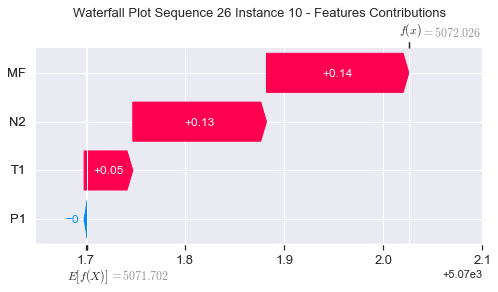

None

Contribution: [-0.00732267  0.04831737  0.13005131  0.1347182 ]


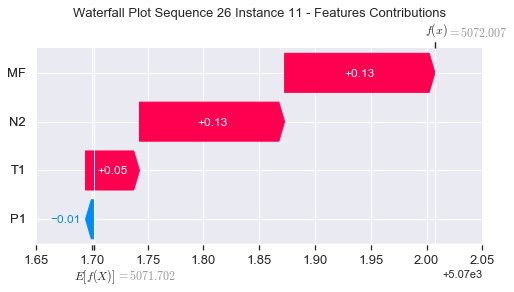

None

Contribution: [-0.00455603  0.05401912  0.12990095  0.14086788]


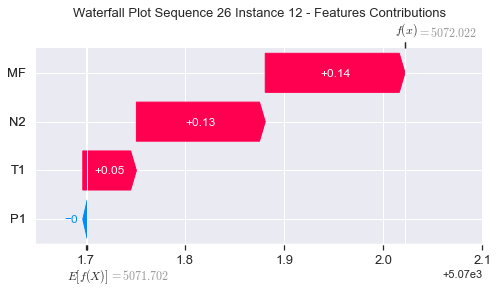

None

Contribution: [-0.00482772  0.05264206  0.12689629  0.13810017]


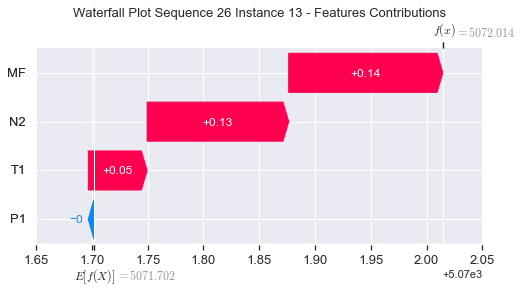

None

Contribution: [-0.00573626  0.05307548  0.12675399  0.13986699]


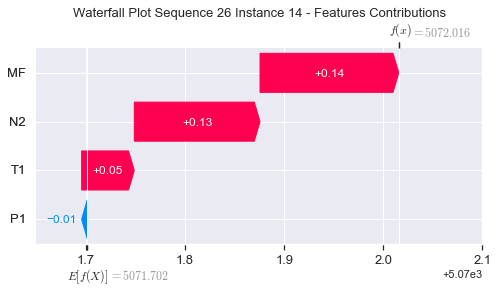

None

Contribution: [-0.0058026   0.05252161  0.12369446  0.13692176]


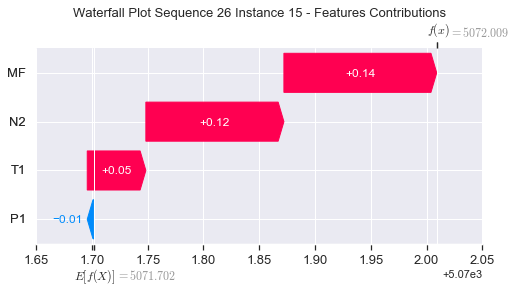

None

Contribution: [-0.01834317  0.0428639   0.1129309   0.10396877]


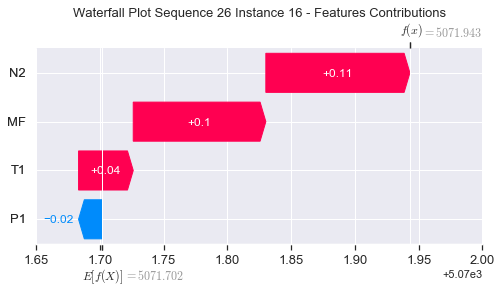

None

Contribution: [-0.00183179  0.04745482  0.11639142  0.12680494]


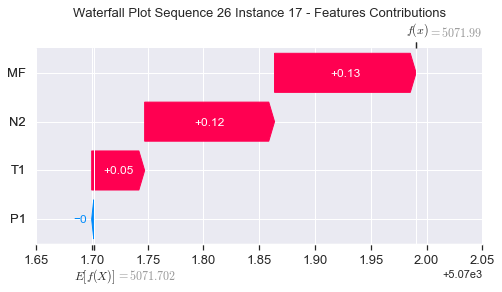

None

Contribution: [0.01150374 0.02964882 0.06330276 0.05464862]


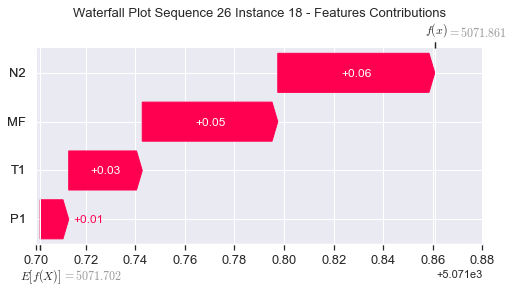

None

Contribution: [0.04385053 0.03302172 0.10950683 0.06728857]


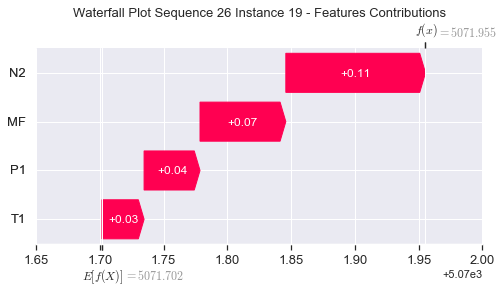

None

Contribution: [-0.10189345  0.16634604  0.51110538  0.68734908]


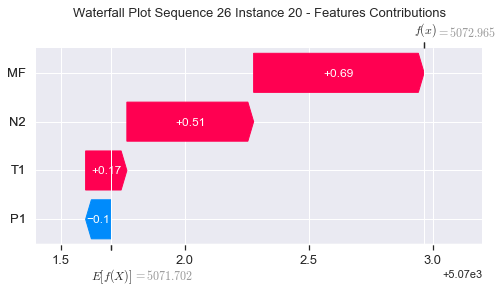

None

Contribution: [-0.14775911 -0.05280941 -0.35175648 -0.29206731]


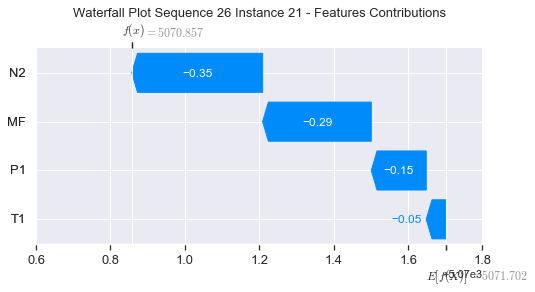

None

Contribution: [ 1.15292685 -0.75484366 -2.8408647  -4.56872519]


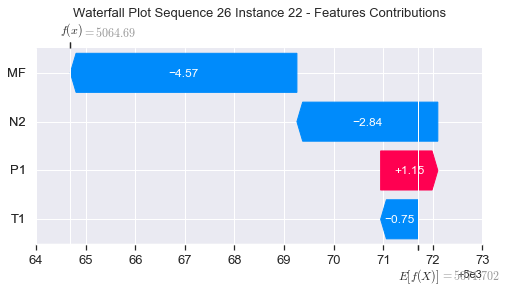

None

Contribution: [0.53186657 0.95951794 3.50864046 3.58714494]


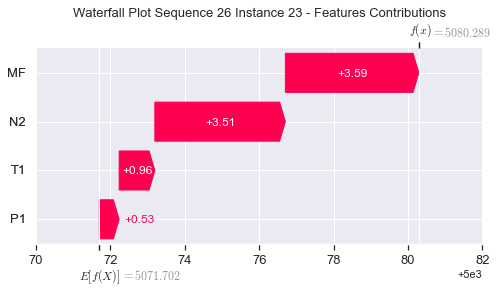

None

Contribution: [-5.82881576 -9.23538019 19.10166066 35.0132072 ]


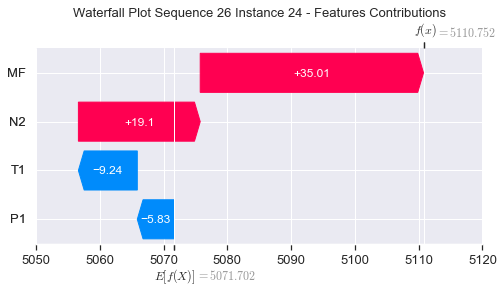

None

Contribution: [ 9.98077455 12.70147567 31.1639545   9.61919141]


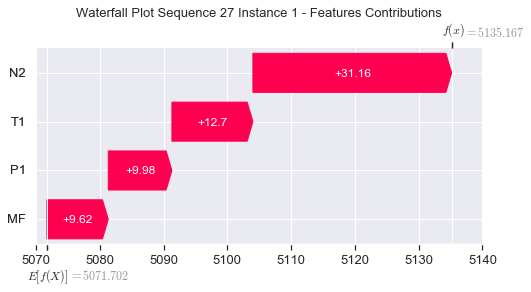

None

Contribution: [0.01887872 0.03873764 0.14802037 0.08113229]


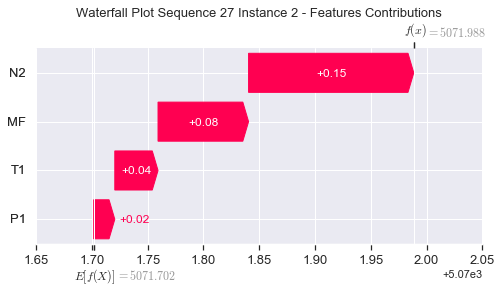

None

Contribution: [-0.03874529  0.04231763  0.17696289  0.24627941]


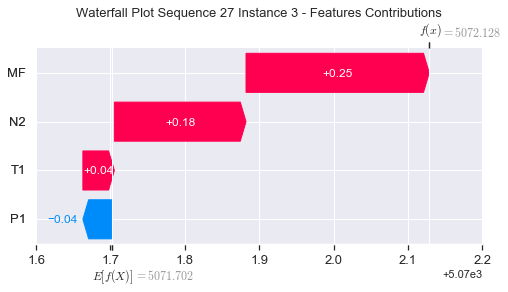

None

Contribution: [-0.05242097  0.02335422  0.06665306  0.12639703]


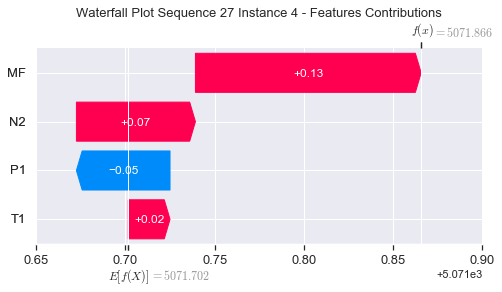

None

Contribution: [-0.01090112  0.04189141  0.15039714  0.18245824]


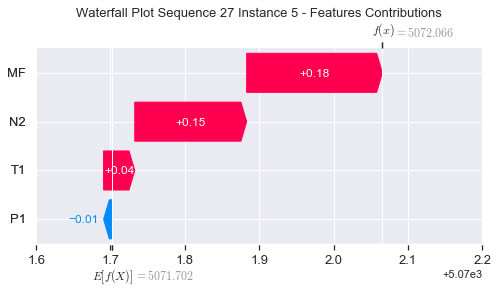

None

Contribution: [0.00327327 0.03287945 0.12525755 0.13971628]


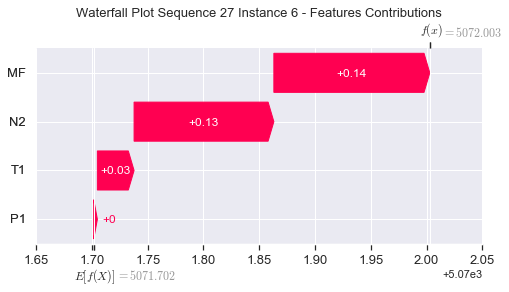

None

Contribution: [0.01226976 0.03240472 0.1213868  0.12443986]


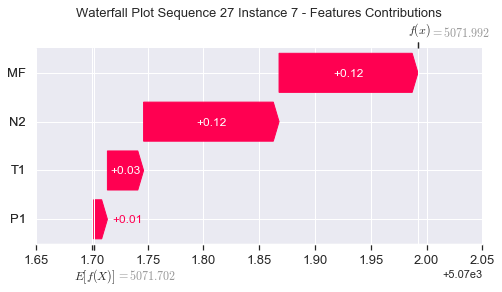

None

Contribution: [0.00878138 0.04242779 0.13147963 0.13569154]


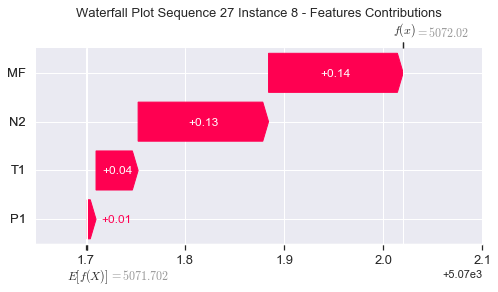

None

Contribution: [1.42520936e-04 4.95222232e-02 1.38293762e-01 1.51453722e-01]


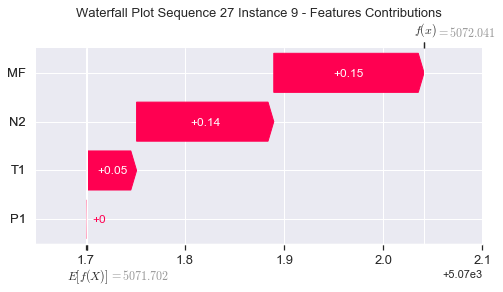

None

Contribution: [-0.00348389  0.05203747  0.13607101  0.1478141 ]


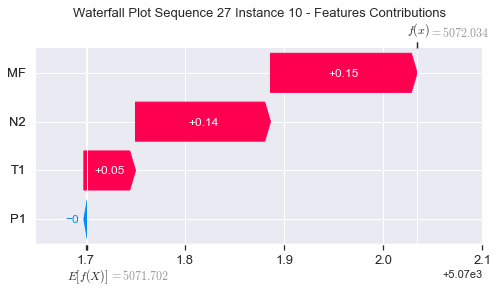

None

Contribution: [-0.00767941  0.05232494  0.13134938  0.13741234]


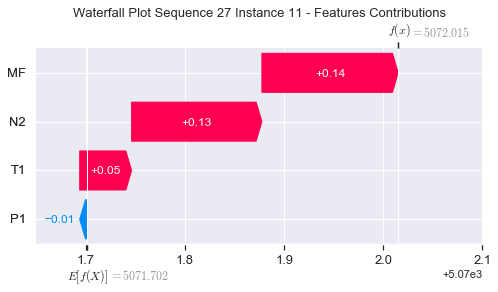

None

Contribution: [-0.00527256  0.05819342  0.1316543   0.14712745]


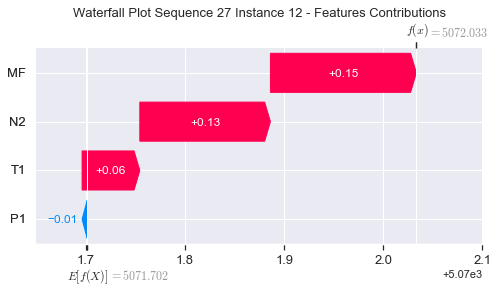

None

Contribution: [-0.00541821  0.05627066  0.12842079  0.14380653]


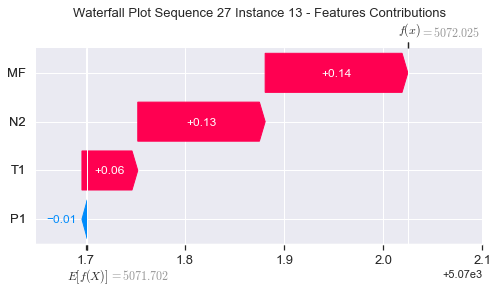

None

Contribution: [-0.00614371  0.05483272  0.12775506  0.14250072]


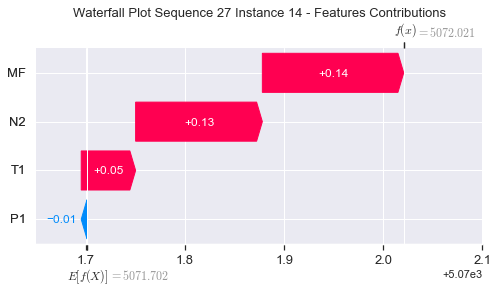

None

Contribution: [-0.00621465  0.05455964  0.1247973   0.14103243]


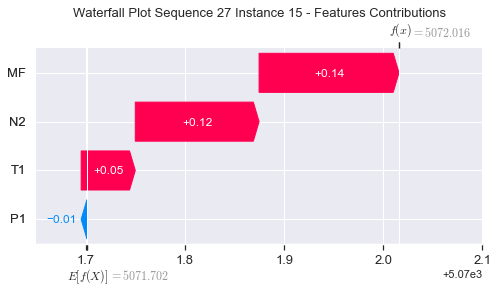

None

Contribution: [-0.01819132  0.04401393  0.11372811  0.10652761]


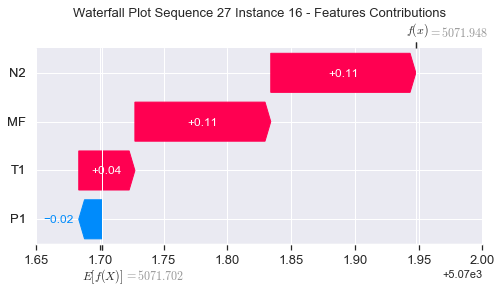

None

Contribution: [-0.00210867  0.04780502  0.11732807  0.12965259]


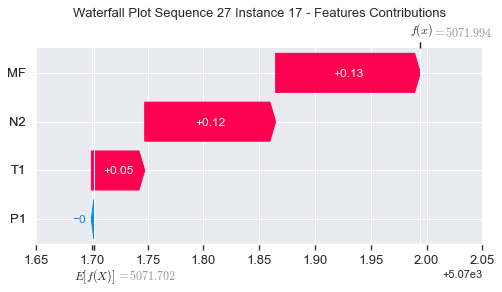

None

Contribution: [0.01108721 0.02915232 0.06454647 0.05734058]


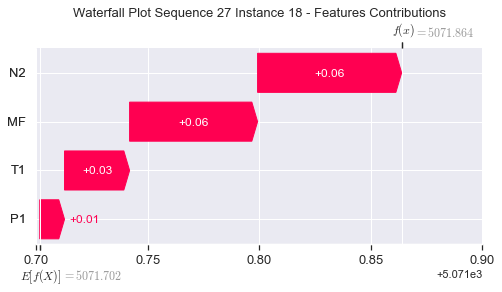

None

Contribution: [0.04352402 0.03415237 0.10974512 0.07077952]


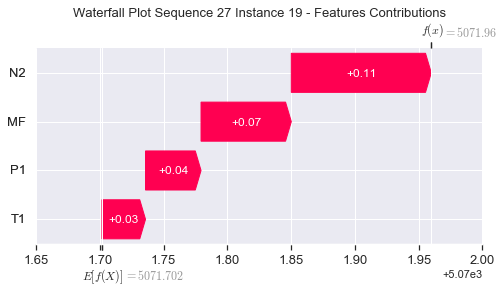

None

Contribution: [-0.10127087  0.16733159  0.50898931  0.68384707]


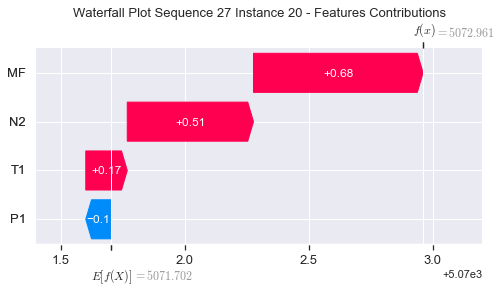

None

Contribution: [-0.1469741  -0.05282361 -0.34526461 -0.2824093 ]


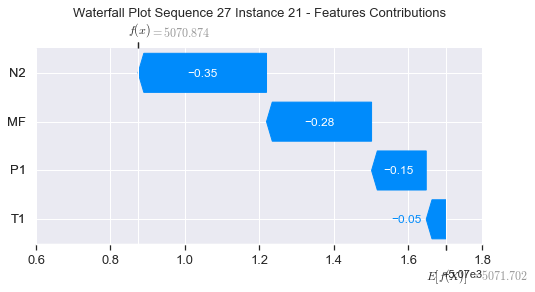

None

Contribution: [ 1.11680244 -0.77947409 -2.81303479 -4.46366615]


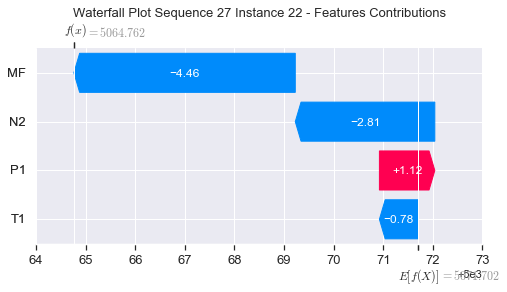

None

Contribution: [0.49378255 0.91547933 3.48465603 3.56109428]


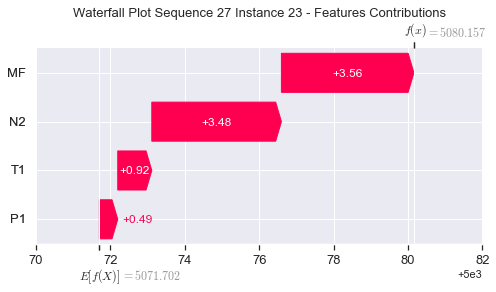

None

Contribution: [-5.62638594 -6.79801659 18.90111626 35.14076202]


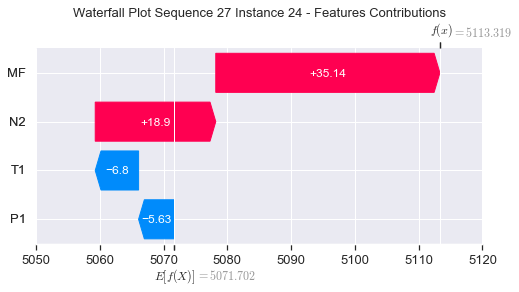

None

Contribution: [ 9.3641516  11.56057941 31.26960474  9.57613203]


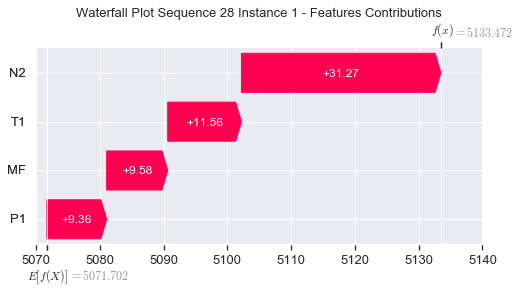

None

Contribution: [0.01496506 0.03630125 0.14628201 0.07592529]


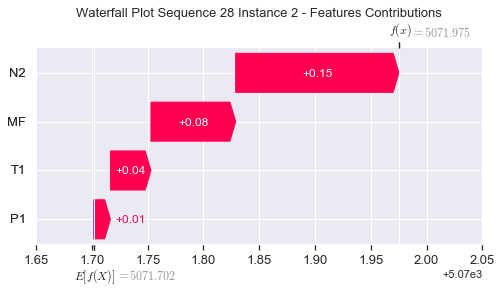

None

Contribution: [-0.03783153  0.0424157   0.17550718  0.24101671]


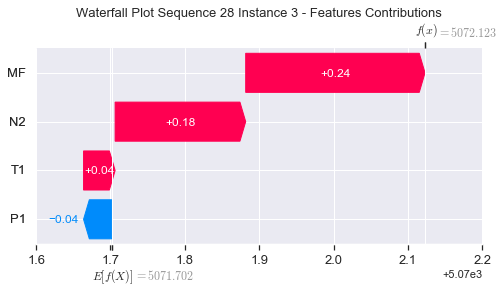

None

Contribution: [-0.05276022  0.02323907  0.06647561  0.12634276]


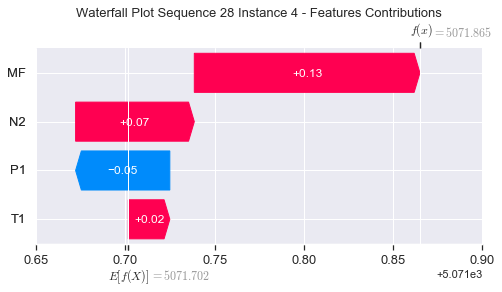

None

Contribution: [-0.01168453  0.04354775  0.15003615  0.18534353]


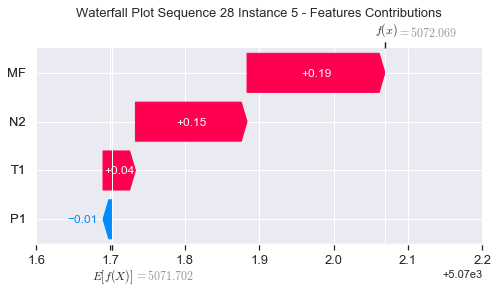

None

Contribution: [0.00296399 0.03394811 0.12544567 0.1404792 ]


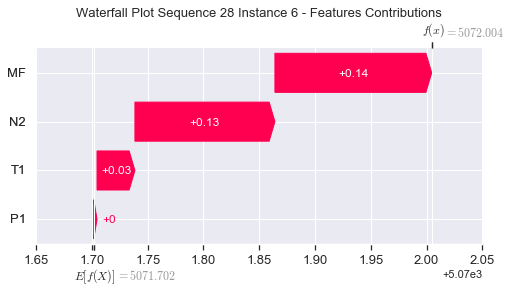

None

Contribution: [0.01185634 0.03171778 0.12179171 0.12480496]


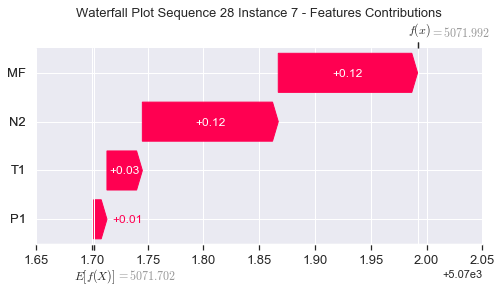

None

Contribution: [0.00928684 0.04041781 0.1310696  0.13367431]


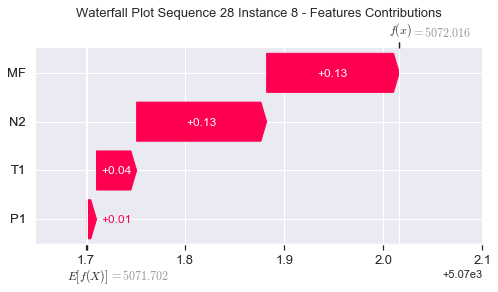

None

Contribution: [0.00017124 0.04156564 0.13665115 0.14547763]


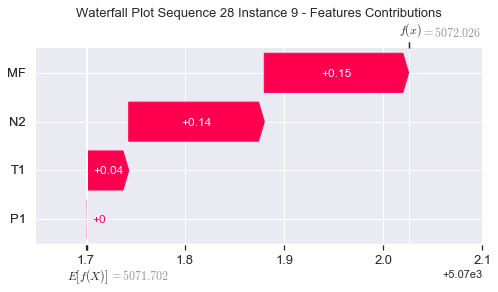

None

Contribution: [-0.00343706  0.04335969  0.13410259  0.1367965 ]


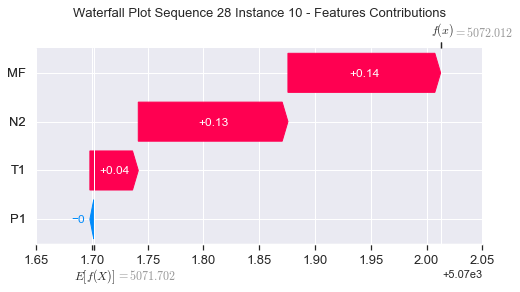

None

Contribution: [-0.00778364  0.04916203  0.13013621  0.13238966]


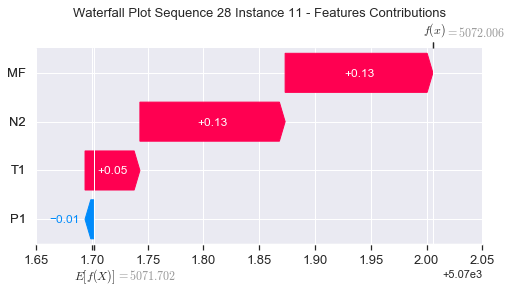

None

Contribution: [-0.0047538   0.05762913  0.13084556  0.14152825]


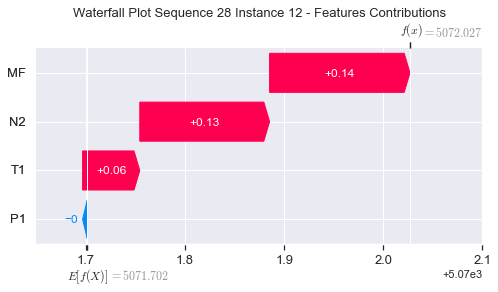

None

Contribution: [-0.00492767  0.05619241  0.12760073  0.13830438]


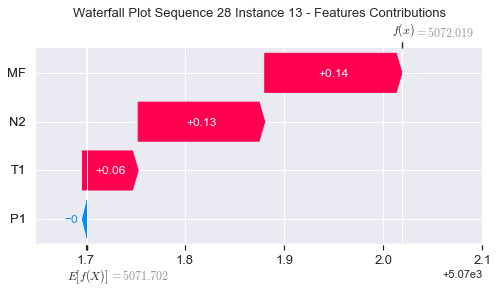

None

Contribution: [-0.00608756  0.05902599  0.12762755  0.1446955 ]


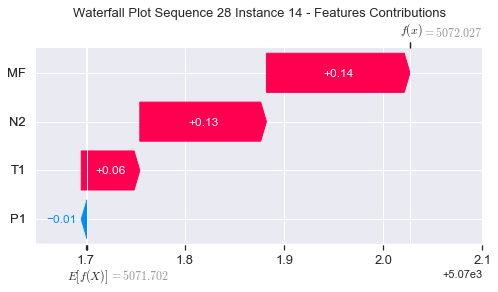

None

Contribution: [-0.00553861  0.05875534  0.12402436  0.13732754]


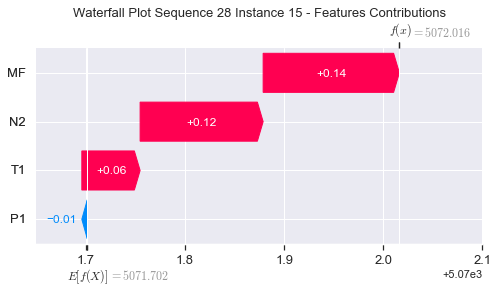

None

Contribution: [-0.01840614  0.04720148  0.1119828   0.0980369 ]


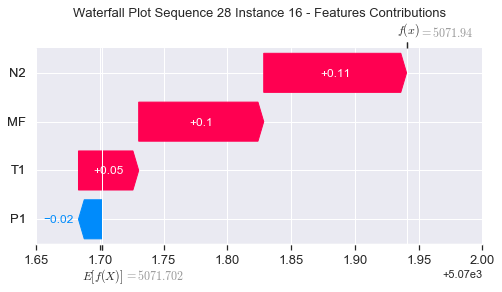

None

Contribution: [-0.0010433   0.05417866  0.1150984   0.12492569]


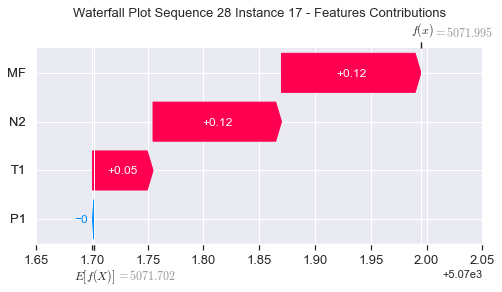

None

Contribution: [0.01393668 0.03962618 0.0584222  0.04784354]


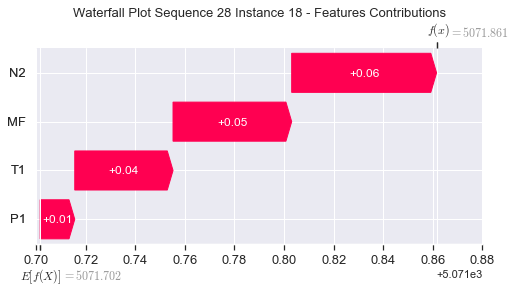

None

Contribution: [0.046243   0.04806847 0.10883295 0.06310868]


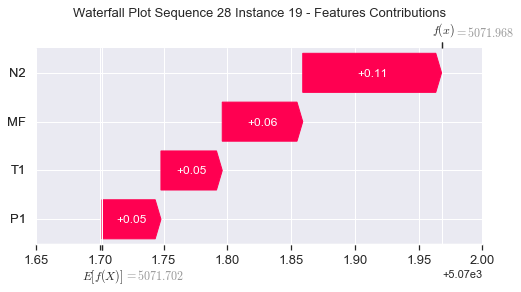

None

Contribution: [-0.11217105  0.16377752  0.53245896  0.71940675]


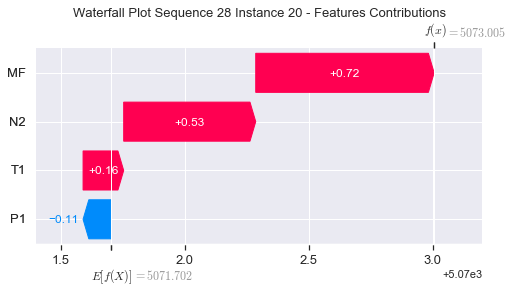

None

Contribution: [-0.16437601 -0.04038895 -0.385801   -0.32584143]


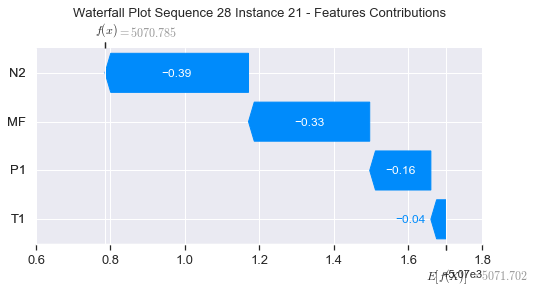

None

Contribution: [ 1.34705877 -0.04717544 -2.99627115 -4.83905774]


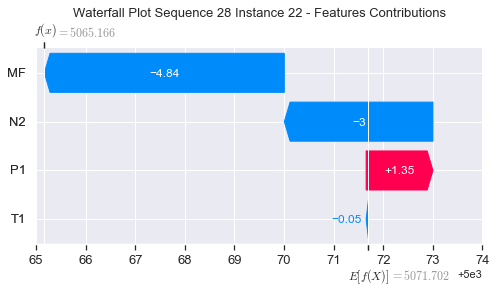

None

Contribution: [0.97102711 1.60685122 3.6234212  3.68735277]


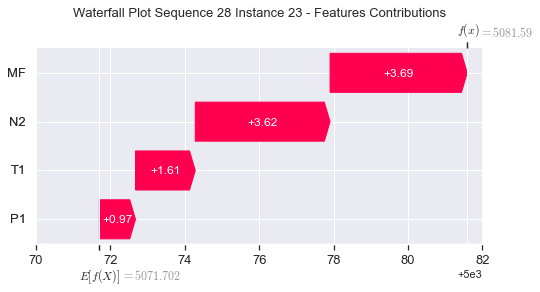

None

Contribution: [-14.40985841 -36.27751407  20.5761386   44.12171993]


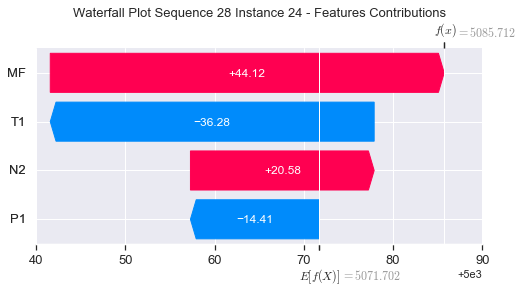

None

Contribution: [19.78077062 29.10531282 32.11440963 11.7388322 ]


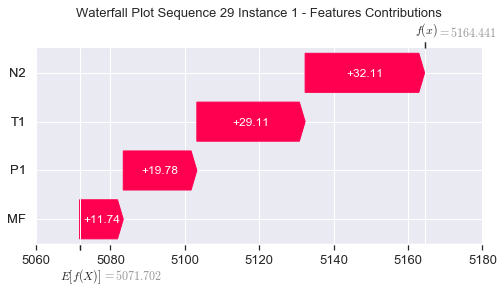

None

Contribution: [0.02059185 0.01805956 0.14384917 0.07684591]


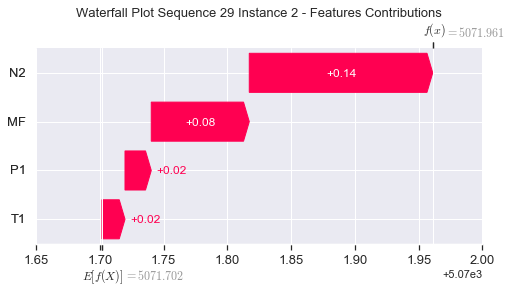

None

Contribution: [-0.04175065  0.02384178  0.17441918  0.24426657]


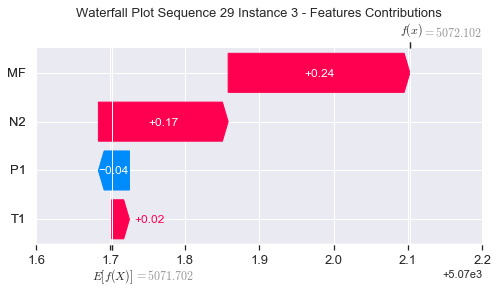

None

Contribution: [-0.05539031  0.00401877  0.07453603  0.14154654]


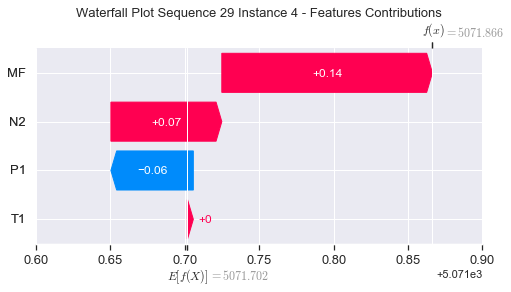

None

Contribution: [-0.01331055  0.0291114   0.15656746  0.19157312]


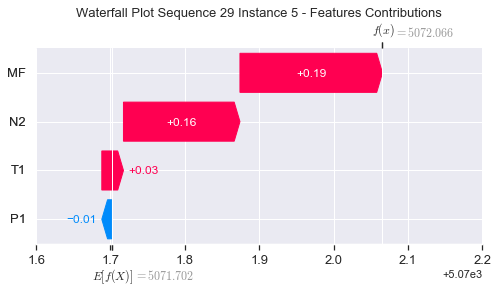

None

Contribution: [0.00327108 0.02792279 0.13128132 0.14892734]


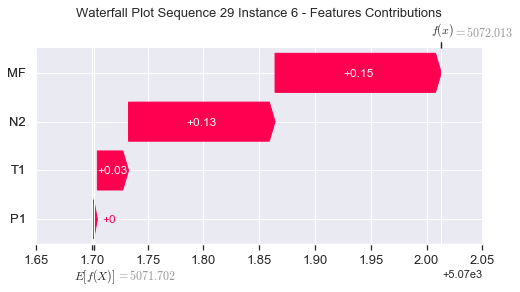

None

Contribution: [0.01422391 0.03826705 0.13235626 0.13895223]


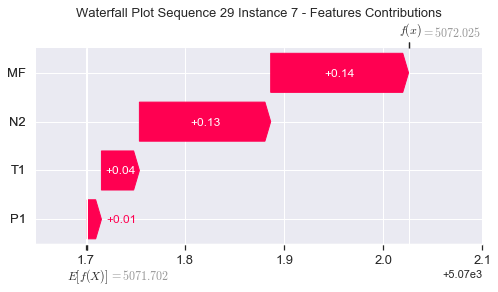

None

Contribution: [0.01170823 0.06139838 0.14393023 0.15127393]


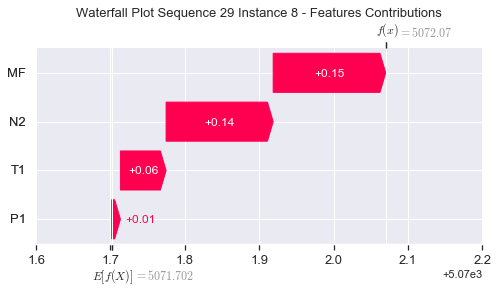

None

Contribution: [0.00178124 0.08003174 0.14895958 0.16427042]


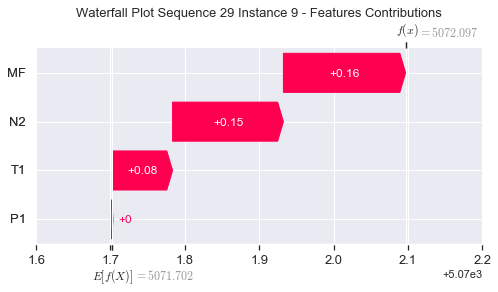

None

Contribution: [-0.00388315  0.08720196  0.14619491  0.16499212]


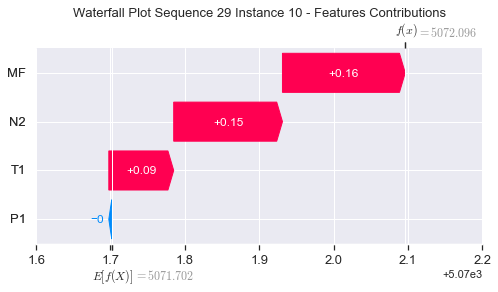

None

Contribution: [-0.00566036  0.0877856   0.1385156   0.14229269]


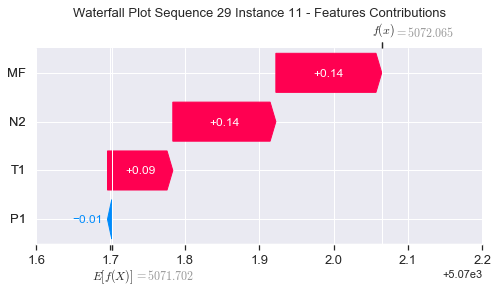

None

Contribution: [-0.00457874  0.09389488  0.13719178  0.144827  ]


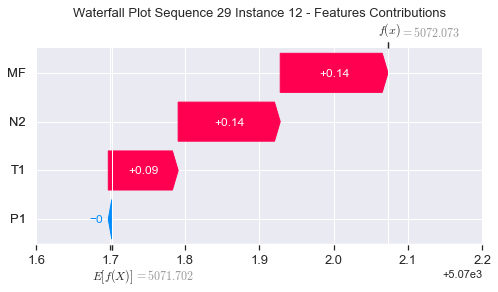

None

Contribution: [-0.00470154  0.09183909  0.13334339  0.14189804]


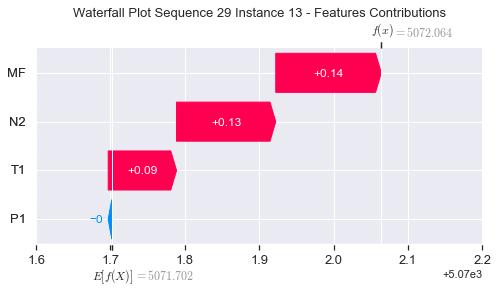

None

Contribution: [-0.00448864  0.08913811  0.13169415  0.13810597]


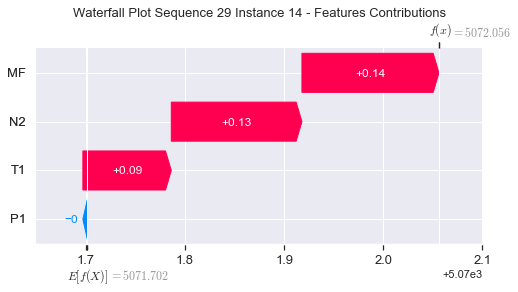

None

Contribution: [-0.00569588  0.08634239  0.12874593  0.13931643]


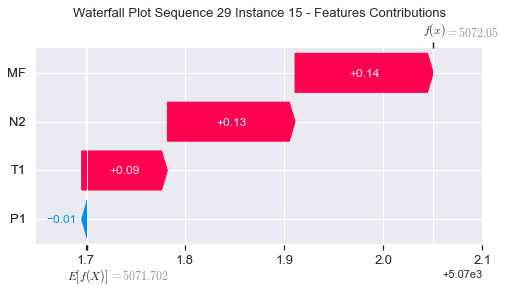

None

Contribution: [-0.01460376  0.08876724  0.1169619   0.10339296]


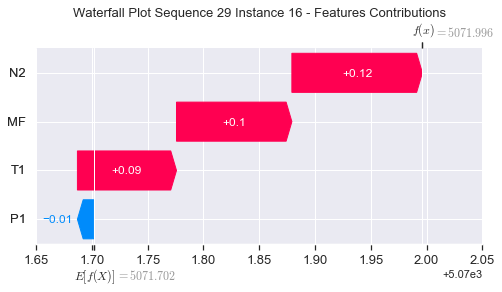

None

Contribution: [-0.00077803  0.07916333  0.12273068  0.13088183]


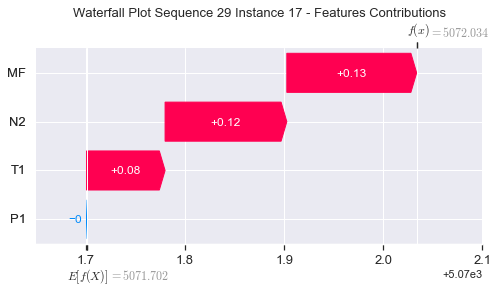

None

Contribution: [0.01024229 0.06603188 0.07444082 0.06585272]


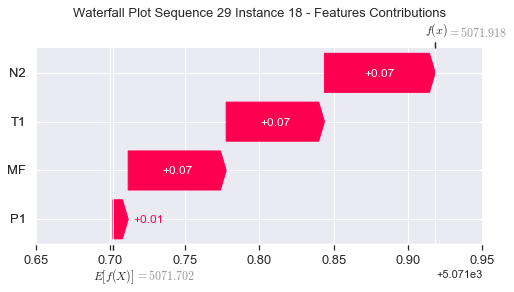

None

Contribution: [0.04512241 0.05126625 0.10204436 0.06239815]


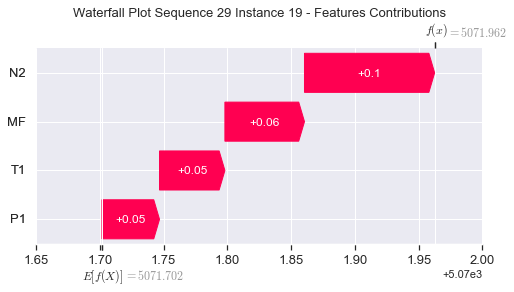

None

Contribution: [-0.0922415   0.1494538   0.48377113  0.64205819]


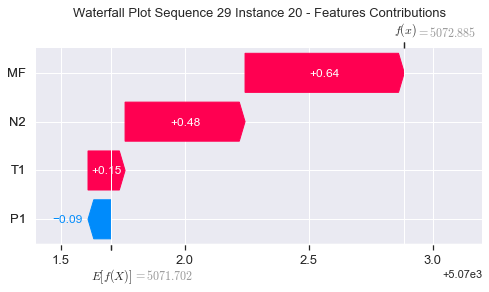

None

Contribution: [-0.16334744 -0.00935199 -0.26849726 -0.18175444]


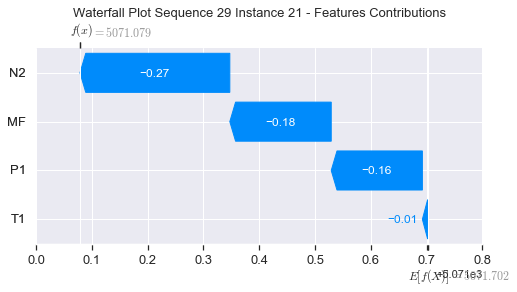

None

Contribution: [ 1.10197622 -0.34795485 -2.67456634 -4.17215185]


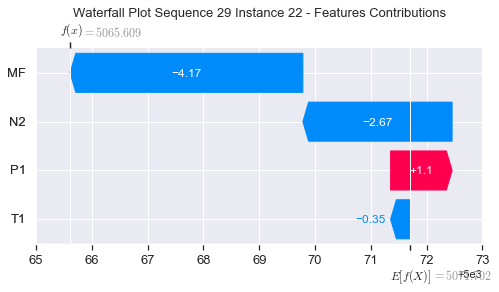

None

Contribution: [0.69342641 1.36952854 3.27108498 3.1993175 ]


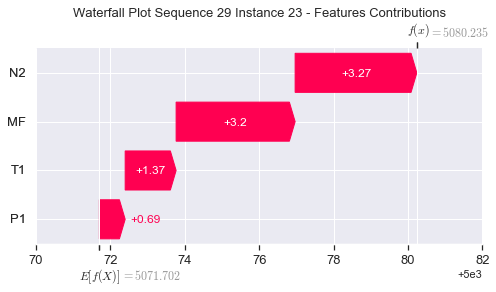

None

Contribution: [ -5.55074271 -14.31153799  19.11275138  32.31304631]


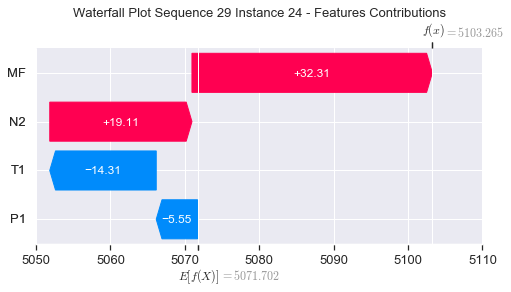

None

Contribution: [ 9.56167006 14.11555885 31.69590771  9.85373943]


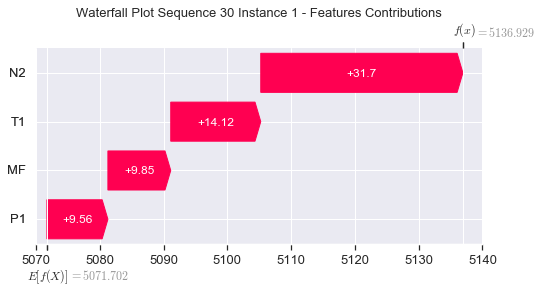

None

Contribution: [0.01501781 0.02903848 0.14803206 0.07658042]


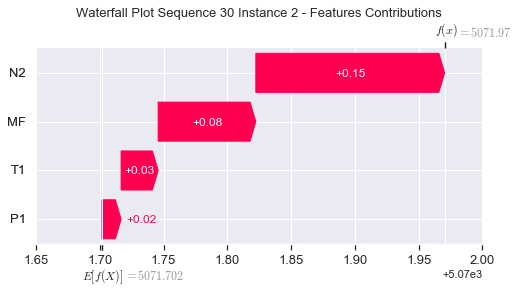

None

Contribution: [-0.03798426  0.03799063  0.17771688  0.24347256]


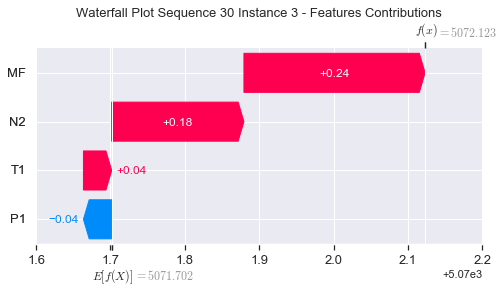

None

Contribution: [-0.05198611  0.01574695  0.06773729  0.12315552]


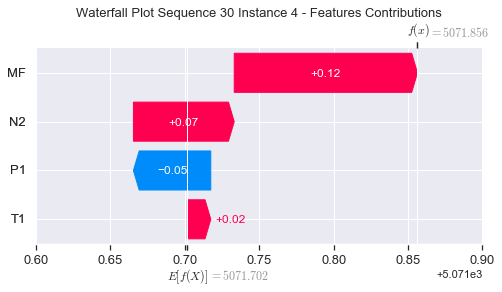

None

Contribution: [-0.01128506  0.04352455  0.15091309  0.1840764 ]


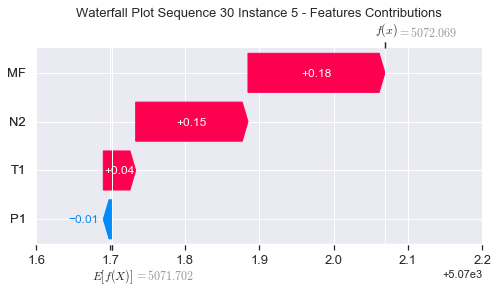

None

Contribution: [0.00307972 0.0331193  0.12583833 0.14032044]


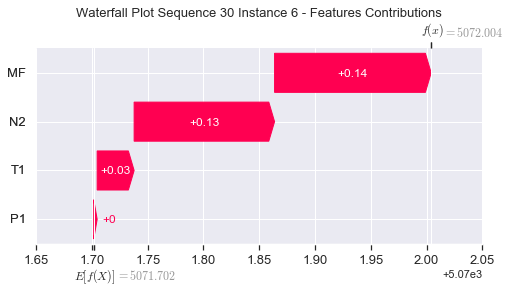

None

Contribution: [0.01188865 0.03281121 0.12242844 0.12603999]


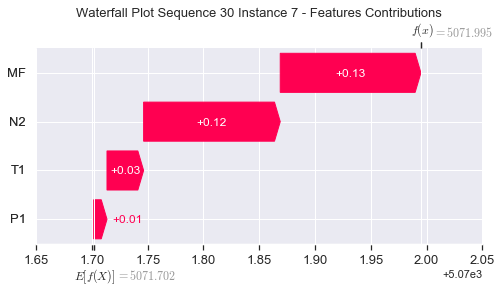

None

Contribution: [0.00832518 0.04293715 0.13252172 0.13774178]


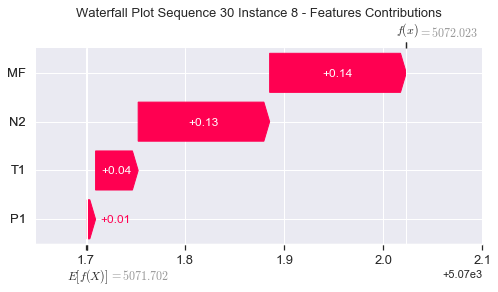

None

Contribution: [3.96609494e-05 4.87536687e-02 1.39028445e-01 1.51456545e-01]


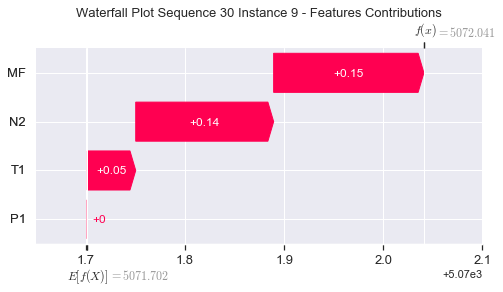

None

Contribution: [-0.00359132  0.052505    0.1364624   0.14862846]


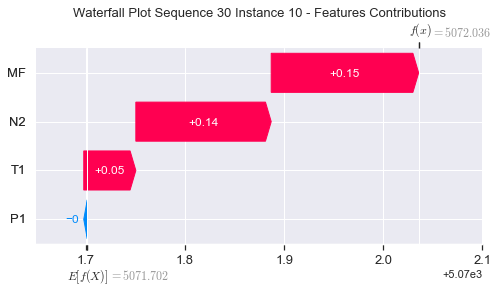

None

Contribution: [-0.00802081  0.05041615  0.1316587   0.13771889]


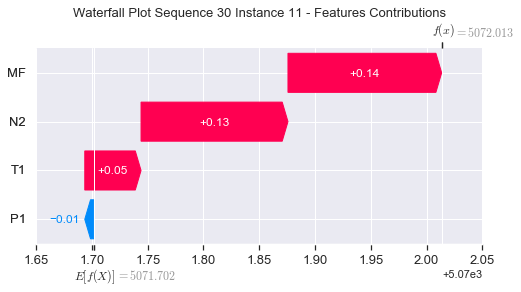

None

Contribution: [-0.00559443  0.05902822  0.13195317  0.14832316]


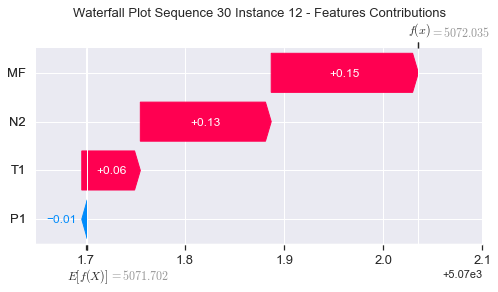

None

Contribution: [-0.00567282  0.05712813  0.1288928   0.14531985]


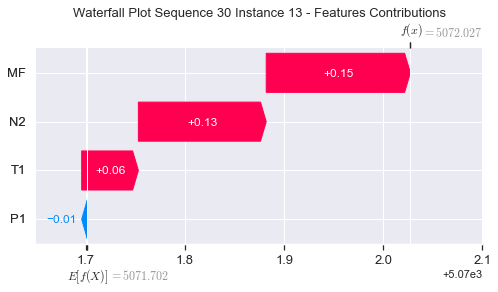

None

Contribution: [-0.00634051  0.06016786  0.12890812  0.14961067]


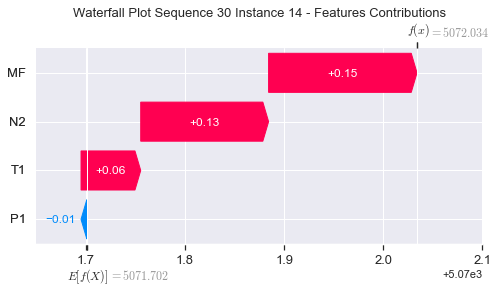

None

Contribution: [-0.00643929  0.05628611  0.12506546  0.14320598]


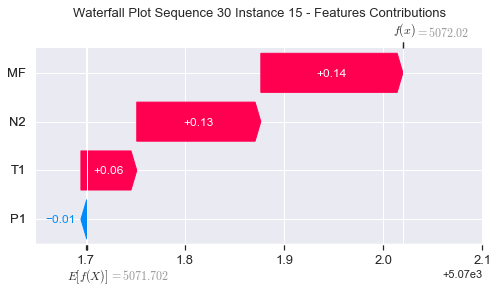

None

Contribution: [-0.0183093   0.04784284  0.11371604  0.1058767 ]


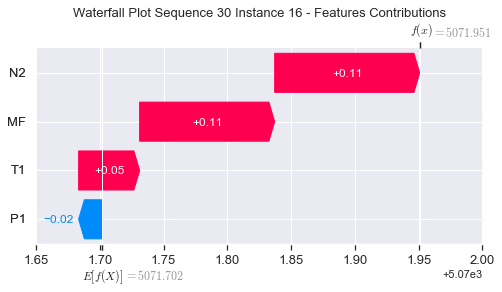

None

Contribution: [-0.00244349  0.05130297  0.11778082  0.13316379]


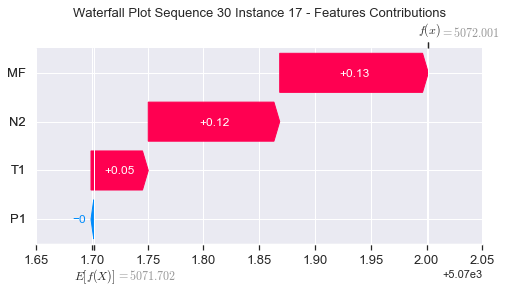

None

Contribution: [0.01068107 0.03398279 0.06428413 0.06155925]


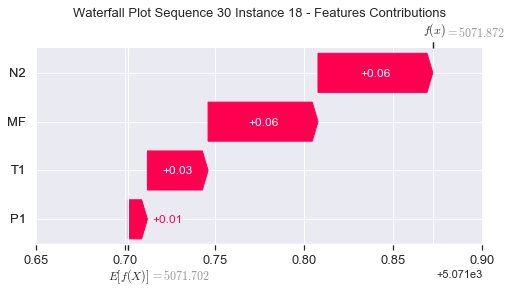

None

Contribution: [0.04395065 0.03482915 0.10936323 0.0696144 ]


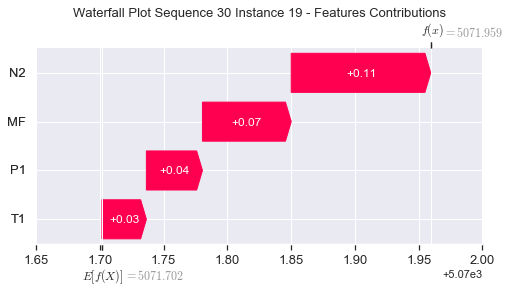

None

Contribution: [-0.10139963  0.16614295  0.51297411  0.68510211]


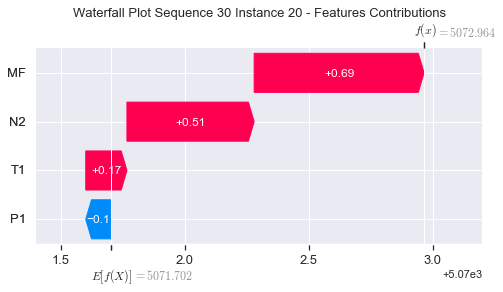

None

Contribution: [-0.14737004 -0.04843956 -0.34877164 -0.27658634]


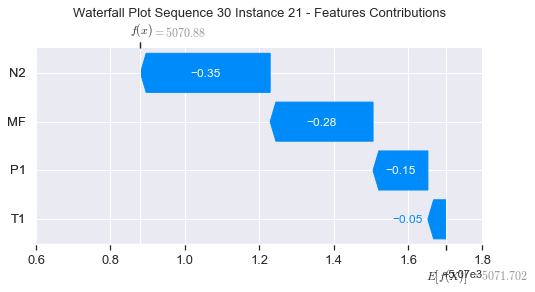

None

Contribution: [ 1.11462009 -0.68233913 -2.83535538 -4.38825012]


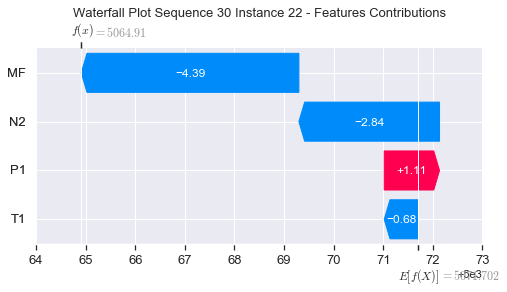

None

Contribution: [0.43693566 1.03042577 3.50509284 3.56927421]


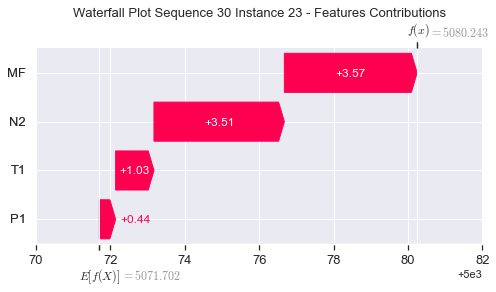

None

Contribution: [-5.98155941 -9.99957381 19.30042014 33.45539361]


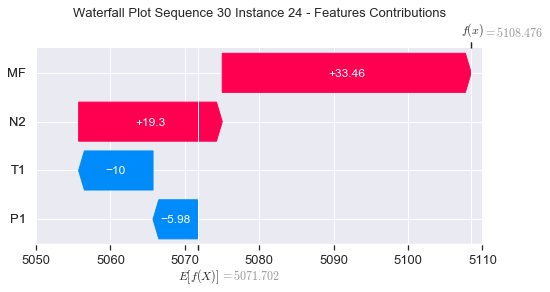

None

Contribution: [11.17122878 12.00173514 31.35094779  9.98137607]


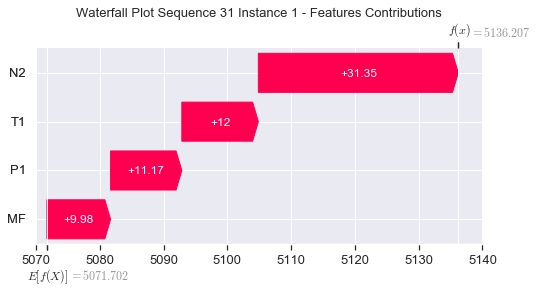

None

Contribution: [0.01511084 0.03440099 0.14476498 0.07442251]


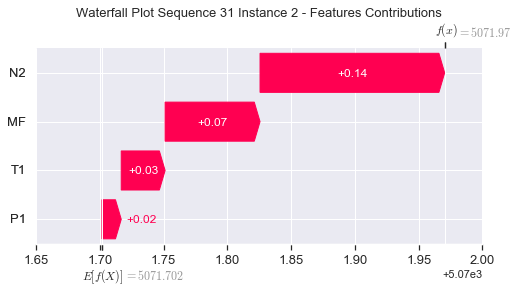

None

Contribution: [-0.03795015  0.04302098  0.17562148  0.24046776]


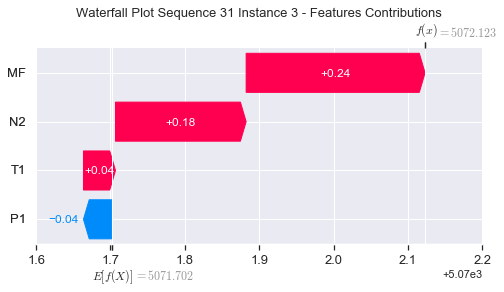

None

Contribution: [-0.05210184  0.02344148  0.06671347  0.12303704]


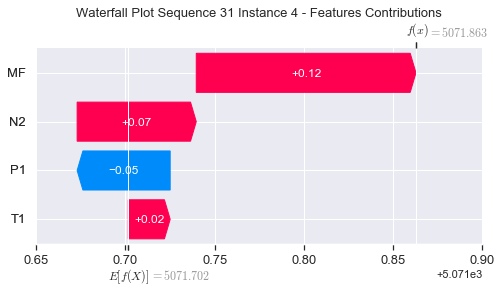

None

Contribution: [-0.01123351  0.04333959  0.15072415  0.18357659]


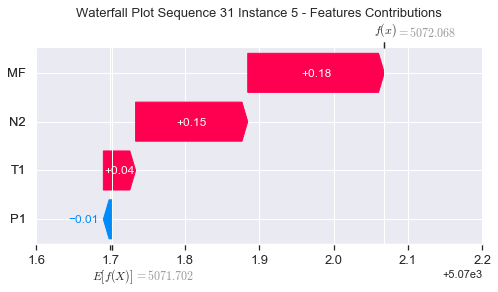

None

Contribution: [0.00301779 0.03314588 0.1254785  0.13956421]


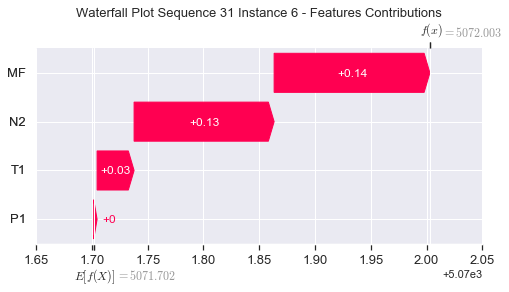

None

Contribution: [0.01178142 0.03241411 0.12153384 0.12510778]


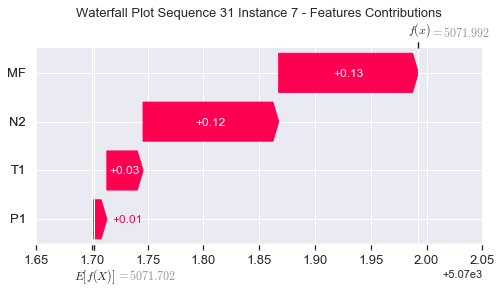

None

Contribution: [0.0084049  0.04221143 0.13122874 0.13646064]


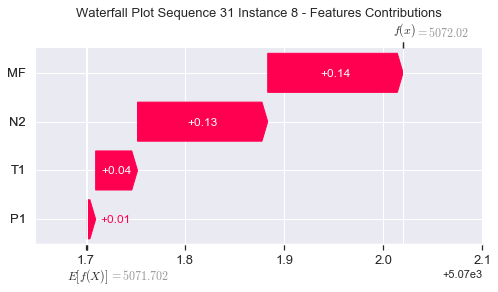

None

Contribution: [0.0014063  0.04959104 0.13740967 0.14700484]


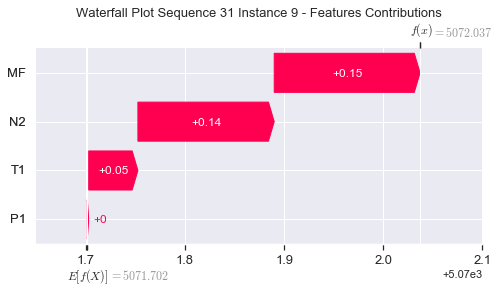

None

Contribution: [-0.00337238  0.04964263  0.13530211  0.14600862]


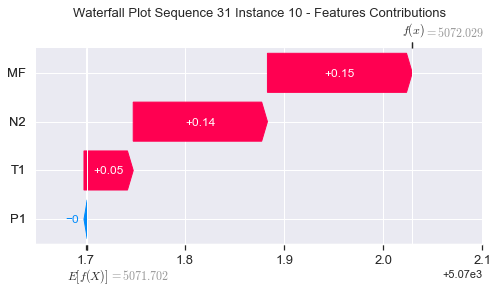

None

Contribution: [-0.00744876  0.05014852  0.13038373  0.13331155]


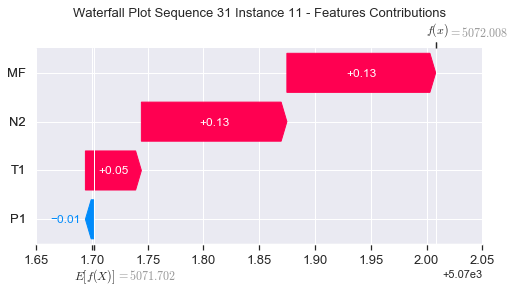

None

Contribution: [-0.00550391  0.05712011  0.13122534  0.14867744]


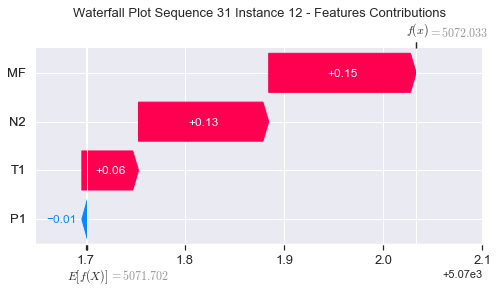

None

Contribution: [-0.00552822  0.05561643  0.12797525  0.14501951]


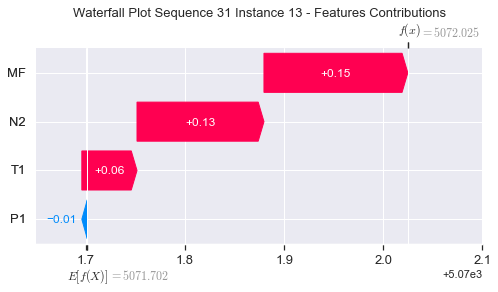

None

Contribution: [-0.00629139  0.05884835  0.12742979  0.14308241]


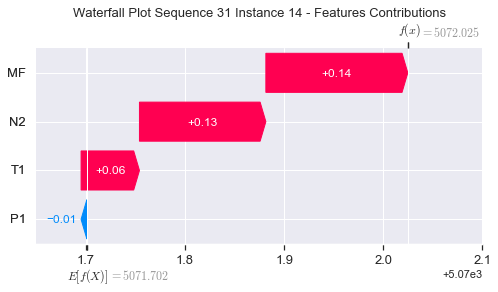

None

Contribution: [-0.00633049  0.05503464  0.12437959  0.14271216]


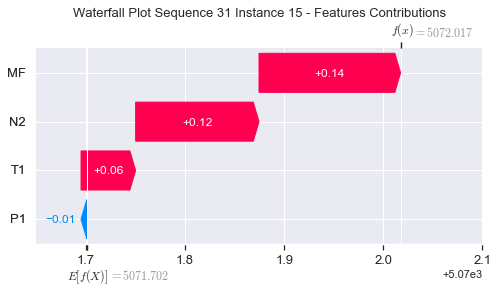

None

Contribution: [-0.01837379  0.04324138  0.11285578  0.10534688]


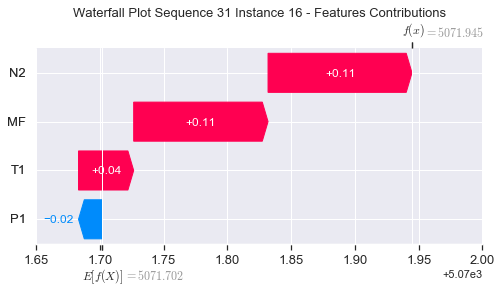

None

Contribution: [-0.0021951   0.04999569  0.11693256  0.13200211]


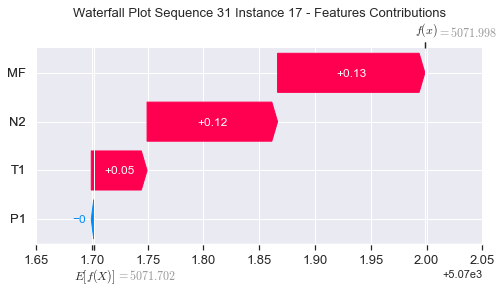

None

Contribution: [0.01110639 0.03220459 0.06353528 0.06012632]


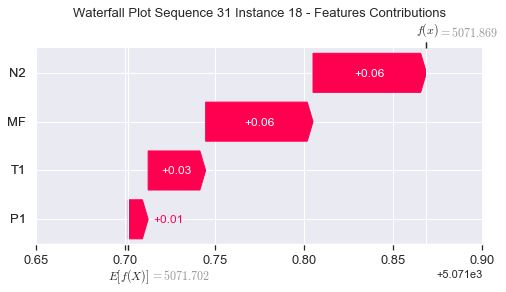

None

Contribution: [0.04288559 0.03730681 0.10945492 0.07466069]


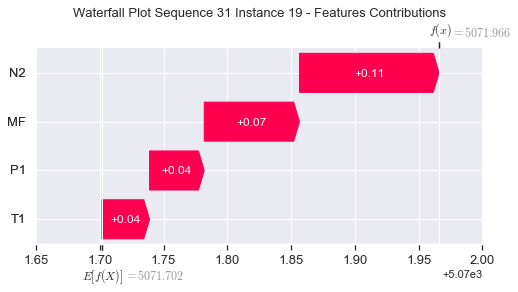

None

Contribution: [-0.1031875   0.16616906  0.51340303  0.68827238]


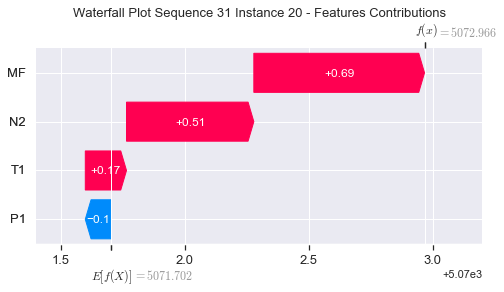

None

Contribution: [-0.14975906 -0.0499353  -0.35429692 -0.2893412 ]


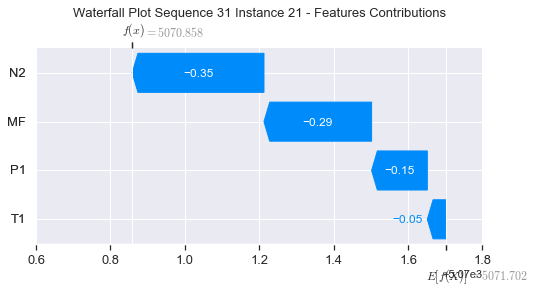

None

Contribution: [ 1.16222237 -0.69293564 -2.85764296 -4.53076851]


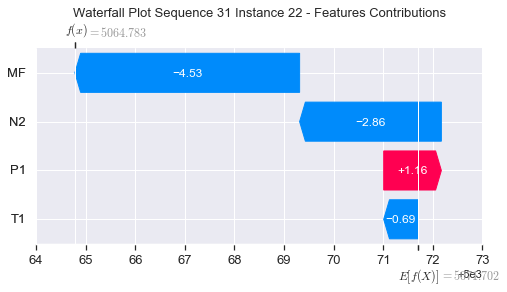

None

Contribution: [0.54044623 1.01211858 3.51928746 3.58861246]


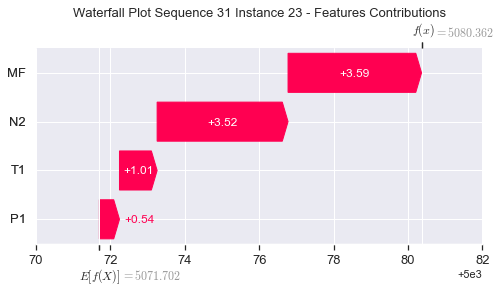

None

Contribution: [ -6.09772769 -11.81215459  19.46797916  34.28073573]


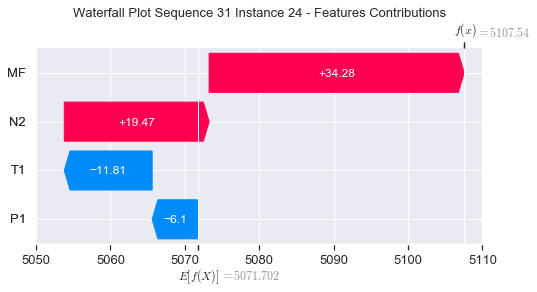

None

Contribution: [ 9.36100478 15.9196066  31.64392135  9.4200866 ]


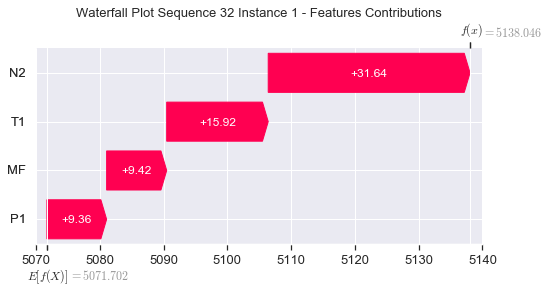

None

Contribution: [0.01849046 0.0384835  0.15069332 0.0805084 ]


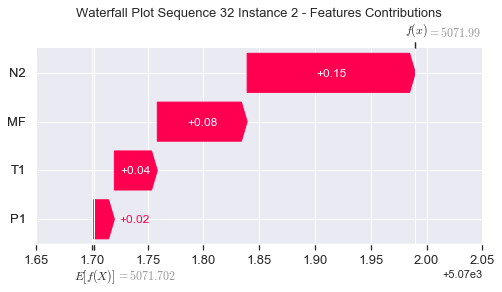

None

Contribution: [-0.03733667  0.04187585  0.17862463  0.24438837]


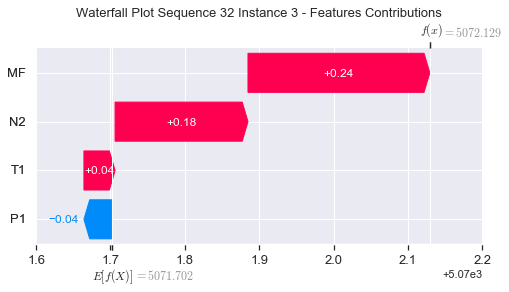

None

Contribution: [-0.0527585   0.02251697  0.06818722  0.12479257]


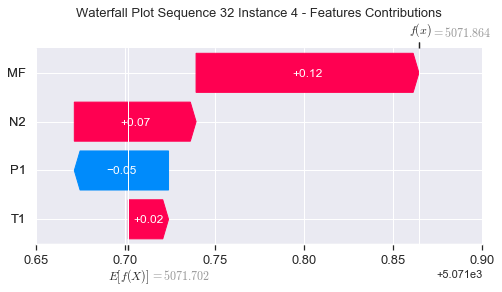

None

Contribution: [-0.01135756  0.04287751  0.15177566  0.18635958]


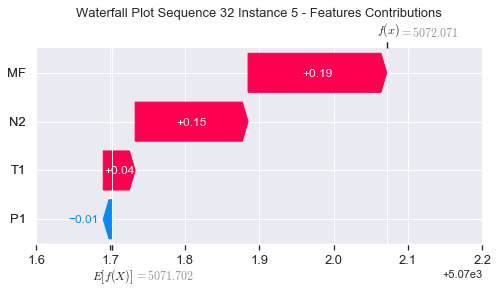

None

Contribution: [0.00332502 0.03293761 0.12613442 0.14087834]


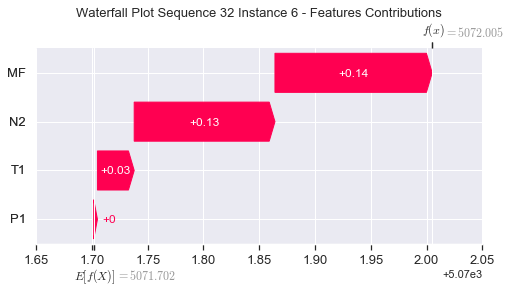

None

Contribution: [0.01246126 0.03293529 0.12263708 0.12562962]


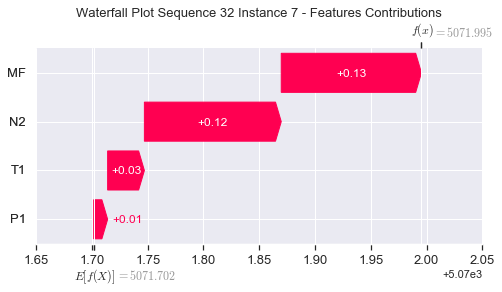

None

Contribution: [0.00911412 0.04324604 0.13204624 0.13568678]


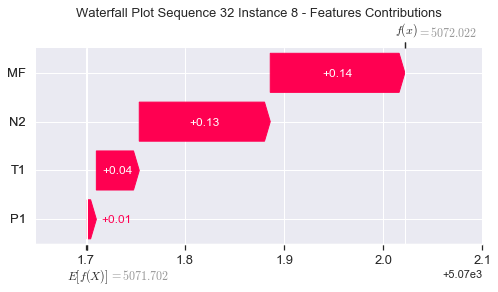

None

Contribution: [-0.00071001  0.04999361  0.13884983  0.15242861]


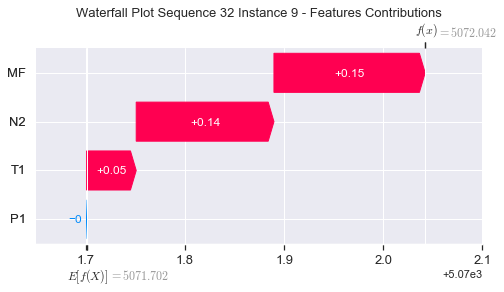

None

Contribution: [-0.00471616  0.05174799  0.13723785  0.15163737]


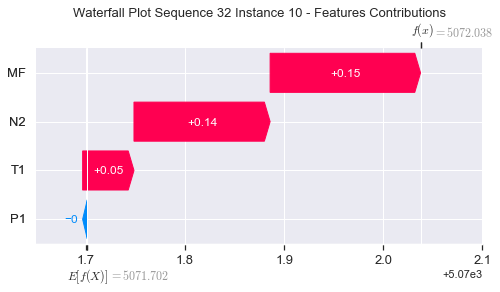

None

Contribution: [-0.00809051  0.05157839  0.13097802  0.13738453]


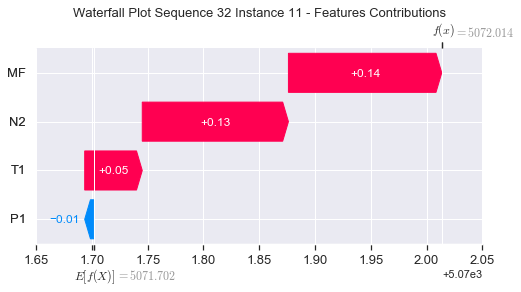

None

Contribution: [-0.00488801  0.05717116  0.12952263  0.1401381 ]


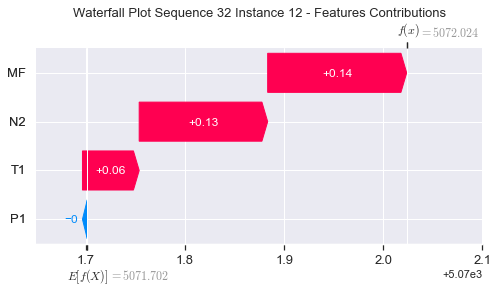

None

Contribution: [-0.00512933  0.05623226  0.12636996  0.13735539]


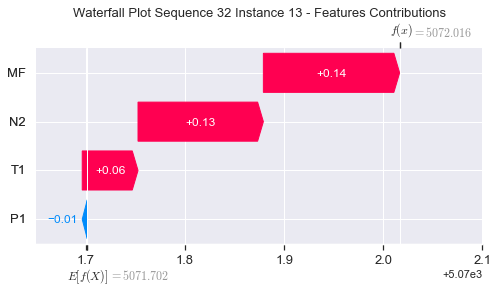

None

Contribution: [-0.00614782  0.05298885  0.12627278  0.14168317]


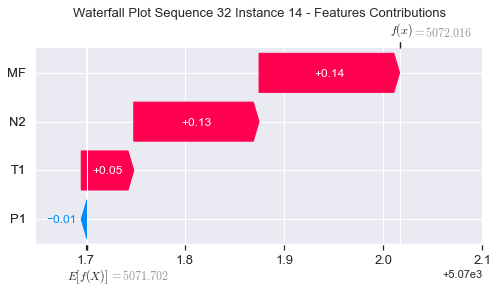

None

Contribution: [-0.00618414  0.05692082  0.12334623  0.13778553]


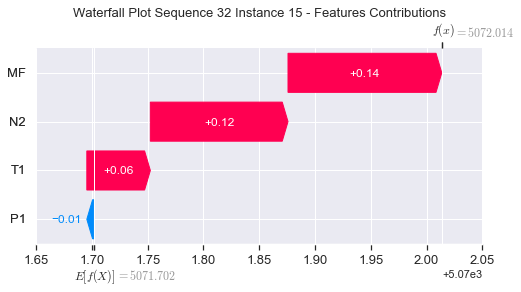

None

Contribution: [-0.01881327  0.05037661  0.11244565  0.1083987 ]


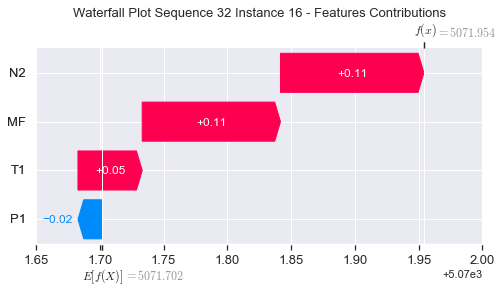

None

Contribution: [-0.0019934   0.05219155  0.11610761  0.12790932]


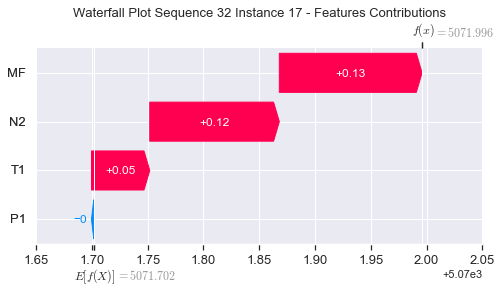

None

Contribution: [0.01075732 0.03609799 0.06318554 0.05712564]


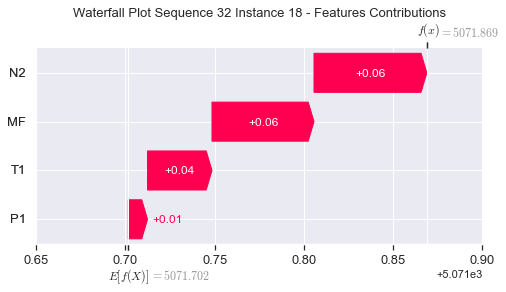

None

Contribution: [0.04067687 0.04622623 0.10772524 0.06948799]


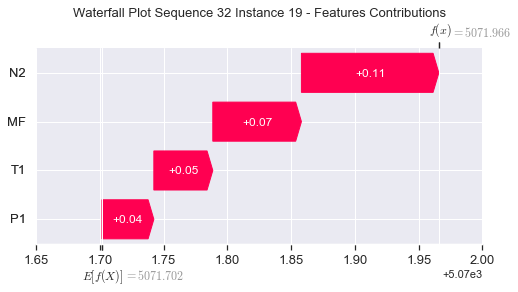

None

Contribution: [-0.10047094  0.16201407  0.51148197  0.68437976]


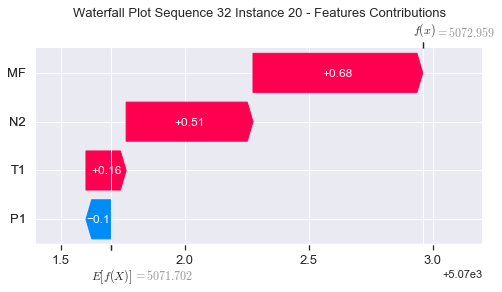

None

Contribution: [-0.15039088 -0.04148239 -0.34666984 -0.27583279]


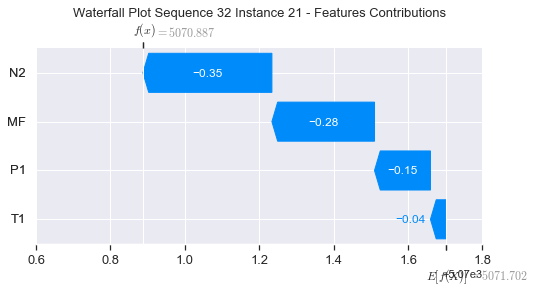

None

Contribution: [ 1.13670179 -0.55076823 -2.89178914 -4.52760017]


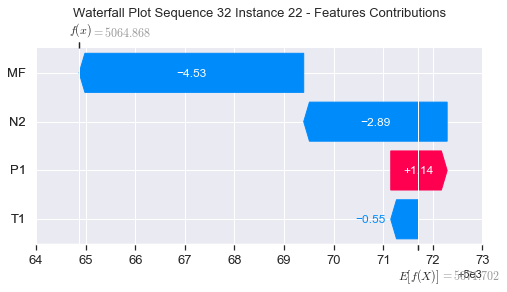

None

Contribution: [0.5090128  1.15205925 3.51573855 3.53387269]


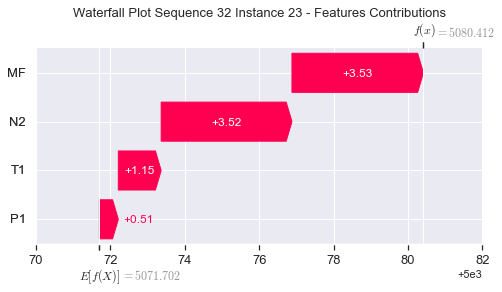

None

Contribution: [ -5.98515484 -15.27341732  20.82896479  34.336559  ]


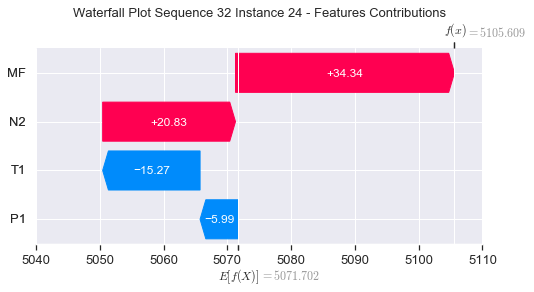

None

Contribution: [10.18656698 15.12709599 32.13016953  9.65568449]


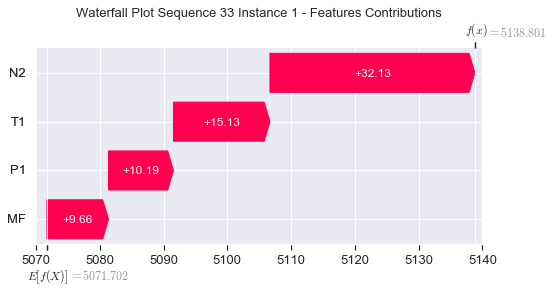

None

Contribution: [0.01661249 0.03318907 0.14900156 0.07866764]


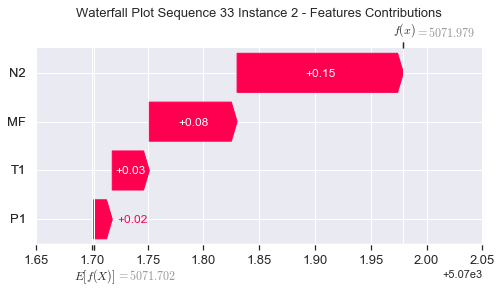

None

Contribution: [-0.03752383  0.03940686  0.17708987  0.24195603]


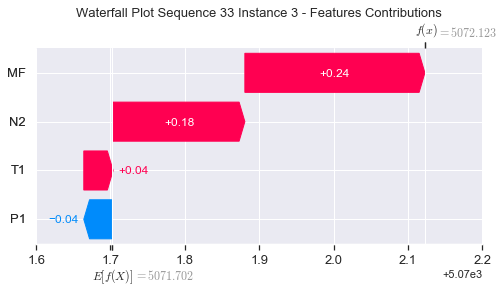

None

Contribution: [-0.05276941  0.02343217  0.06871551  0.12701197]


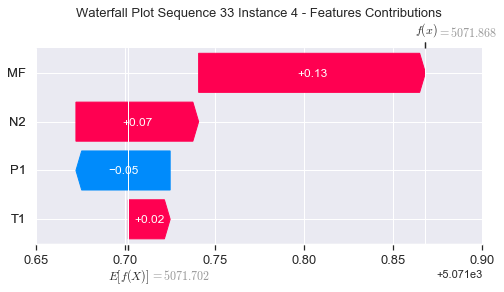

None

Contribution: [-0.01128997  0.04163222  0.15251547  0.18455287]


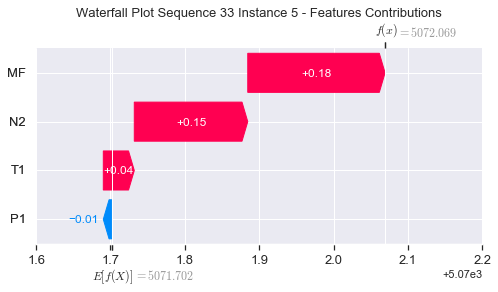

None

Contribution: [0.00286213 0.03303314 0.1270352  0.14192563]


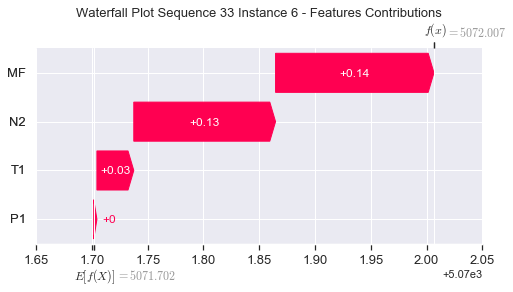

None

Contribution: [0.01155102 0.03380351 0.12335162 0.12723428]


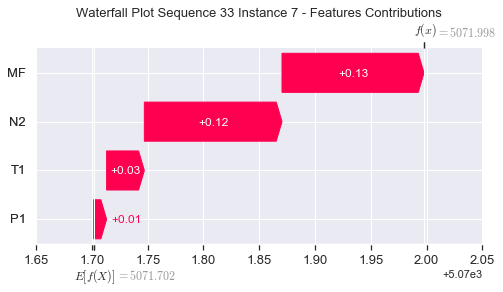

None

Contribution: [0.00777539 0.04565565 0.13309148 0.13843978]


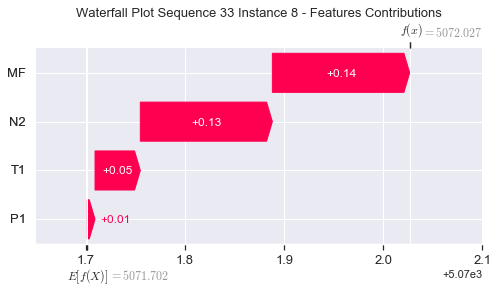

None

Contribution: [-0.00249688  0.05550538  0.13963703  0.15440174]


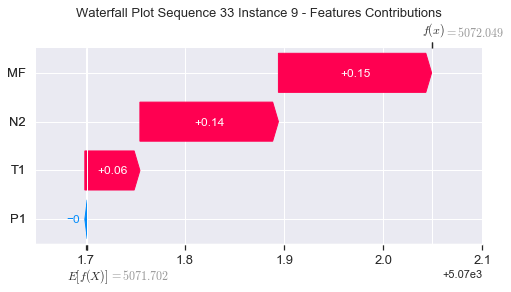

None

Contribution: [-0.00538126  0.05598204  0.13776129  0.15198166]


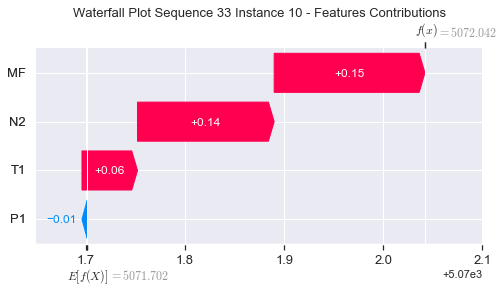

None

Contribution: [-0.00863194  0.05622851  0.13133217  0.13325082]


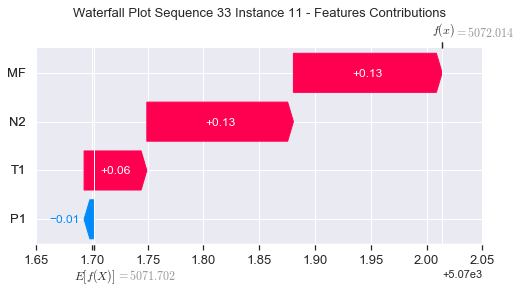

None

Contribution: [-0.00555382  0.06594143  0.1320629   0.14551056]


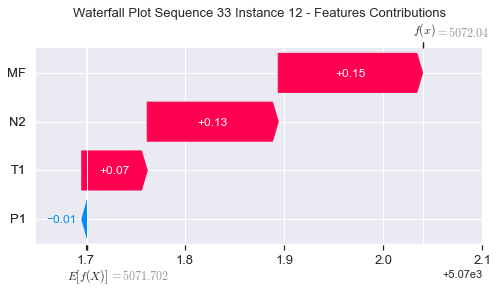

None

Contribution: [-0.00580222  0.06459746  0.12903653  0.14397338]


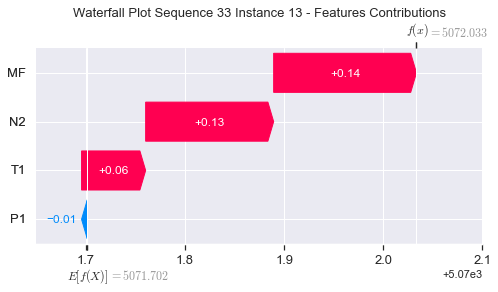

None

Contribution: [-0.00658322  0.06566087  0.12926525  0.14799009]


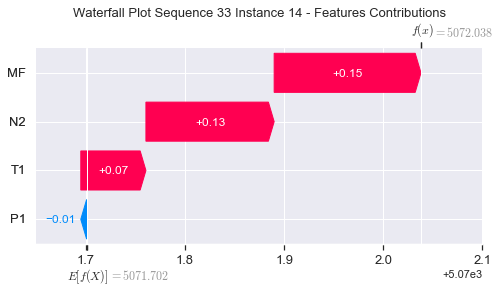

None

Contribution: [-0.00663173  0.06427253  0.12565472  0.14208485]


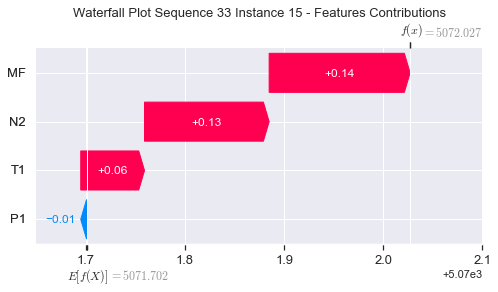

None

Contribution: [-0.01947048  0.05481477  0.11498673  0.11104669]


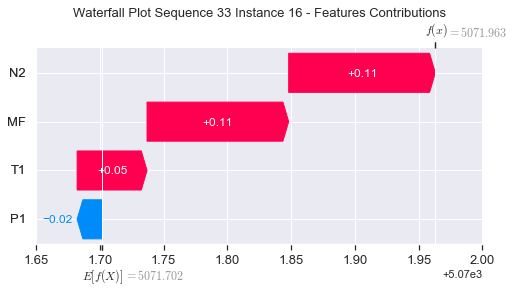

None

Contribution: [-0.00253774  0.06027101  0.11791752  0.13205721]


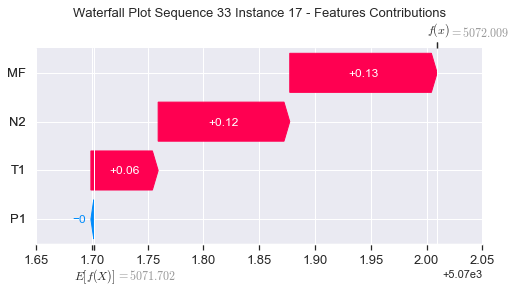

None

Contribution: [0.01061368 0.04449331 0.06398722 0.05896073]


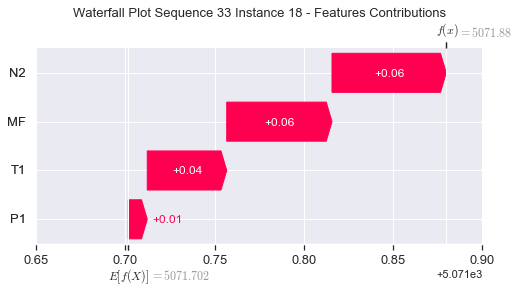

None

Contribution: [0.04157553 0.04966532 0.11108726 0.07564121]


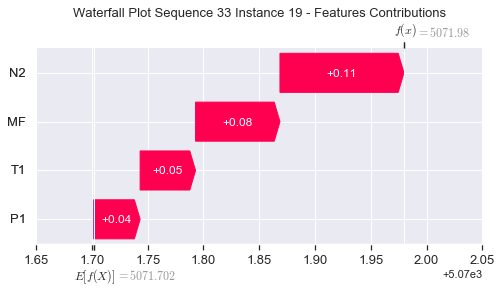

None

Contribution: [-0.10060085  0.1613944   0.51870392  0.69254074]


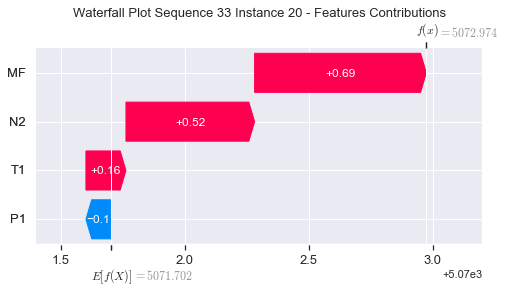

None

Contribution: [-0.14497552 -0.03507843 -0.35525886 -0.28232528]


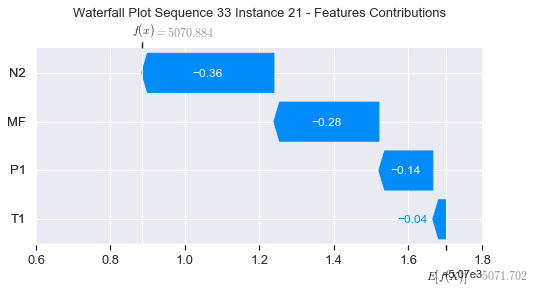

None

Contribution: [ 1.0760542  -0.32326727 -2.85768753 -4.45499191]


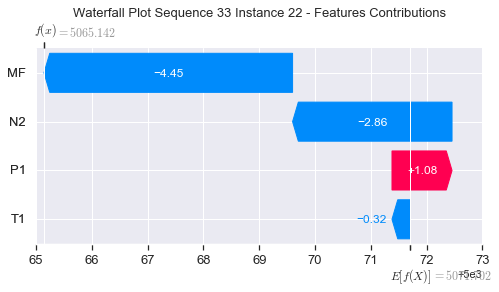

None

Contribution: [0.36469504 1.32149142 3.52140841 3.59072492]


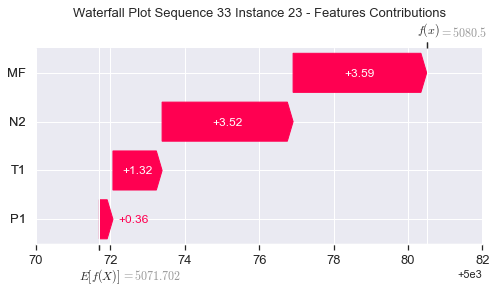

None

Contribution: [ -4.77755555 -19.89502668  19.23034585  34.66119   ]


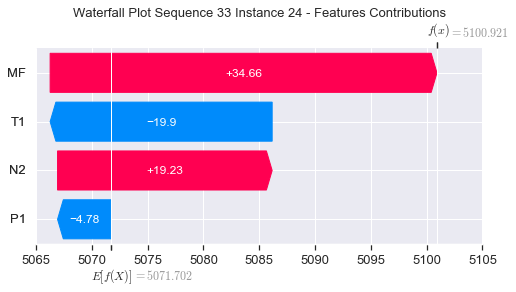

None

Contribution: [10.18686878 17.85438609 31.88781499 10.11834514]


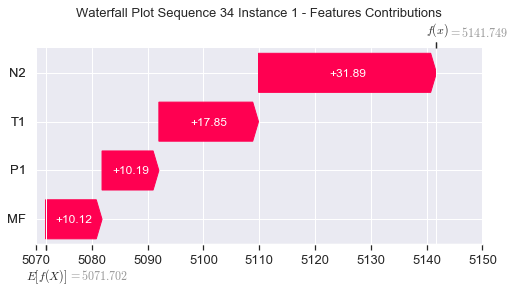

None

Contribution: [0.01421468 0.02483807 0.14838766 0.07698566]


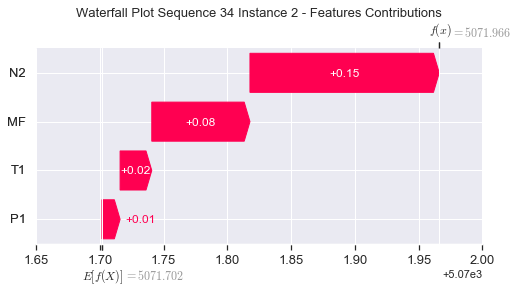

None

Contribution: [-0.03795986  0.03504117  0.17734721  0.24550269]


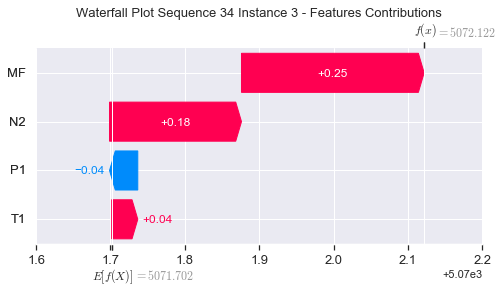

None

Contribution: [-0.05283658  0.01667219  0.06893614  0.12913774]


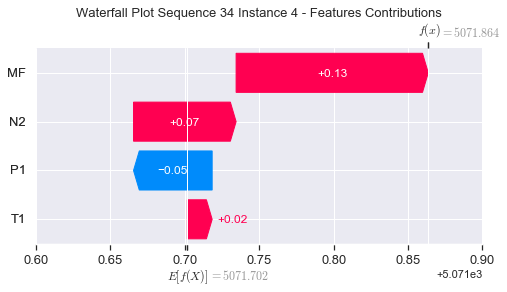

None

Contribution: [-0.01134268  0.03900543  0.15311427  0.18545037]


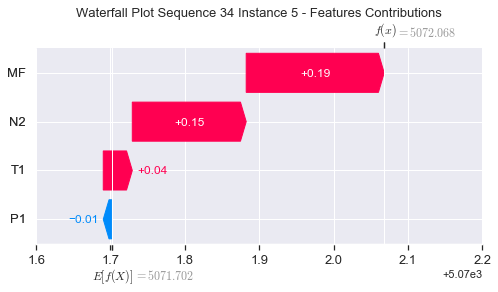

None

Contribution: [0.00255858 0.0322037  0.12763286 0.14260656]


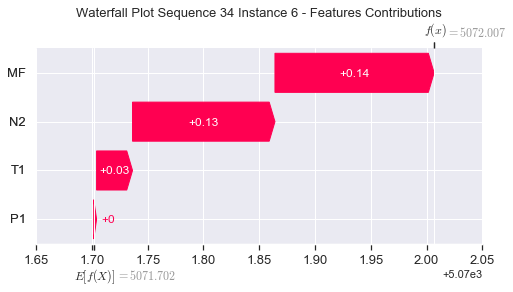

None

Contribution: [0.01061222 0.03481267 0.12469352 0.12914815]


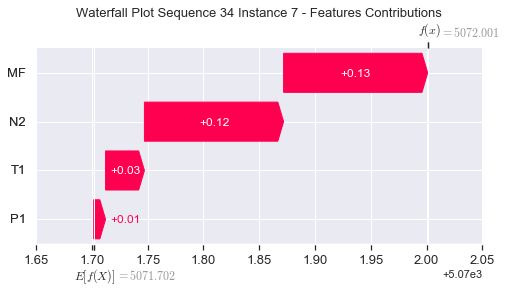

None

Contribution: [0.00592817 0.04946014 0.13533174 0.14205012]


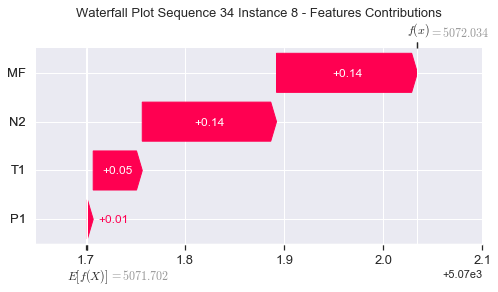

None

Contribution: [-0.00348602  0.06121232  0.14169067  0.15659684]


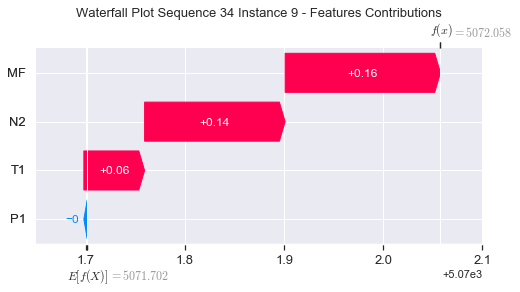

None

Contribution: [-0.0066564   0.06622093  0.13901011  0.1517772 ]


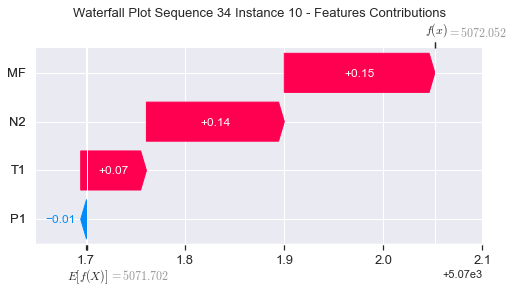

None

Contribution: [-0.01026047  0.06462327  0.1338143   0.14072926]


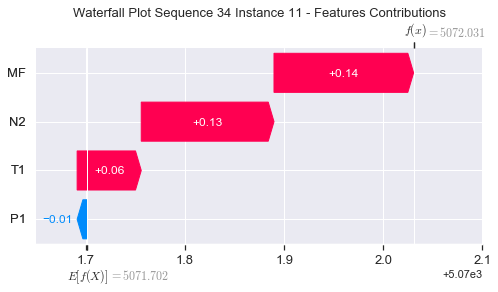

None

Contribution: [-0.00697115  0.06961958  0.13396266  0.15097142]


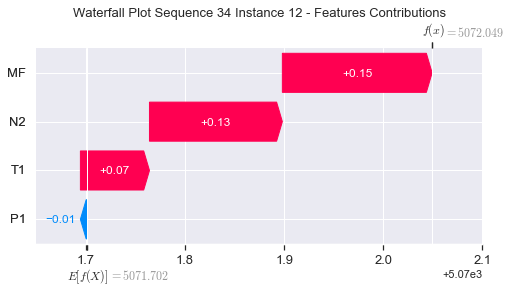

None

Contribution: [-0.00692226  0.06830183  0.13079843  0.14822639]


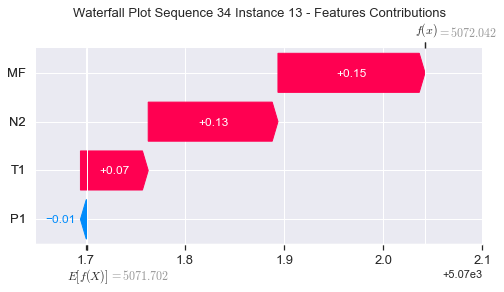

None

Contribution: [-0.00839018  0.07044096  0.13024079  0.15280439]


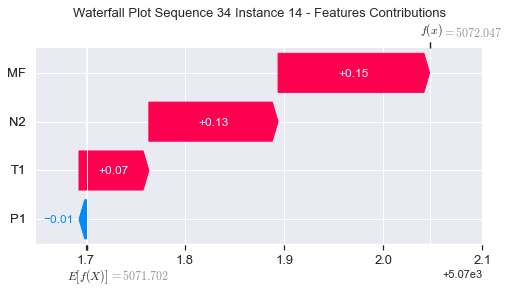

None

Contribution: [-0.00758904  0.06796288  0.12680759  0.1454569 ]


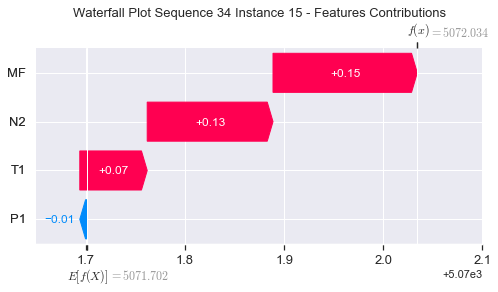

None

Contribution: [-0.01952049  0.06429811  0.11449336  0.10806525]


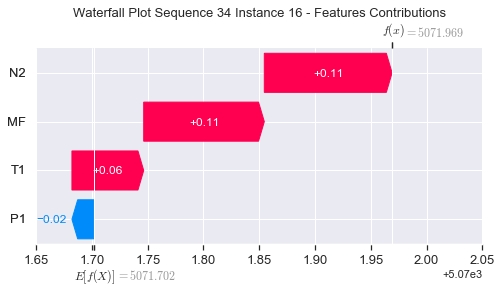

None

Contribution: [-0.00346935  0.06353659  0.11886689  0.13419562]


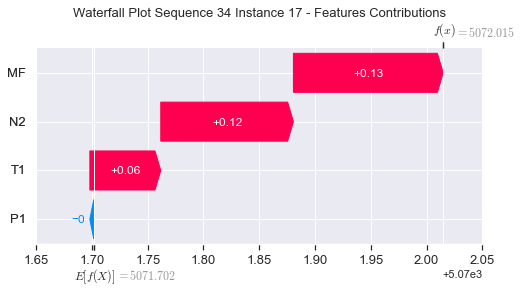

None

Contribution: [0.00891871 0.04875085 0.06532202 0.06247116]


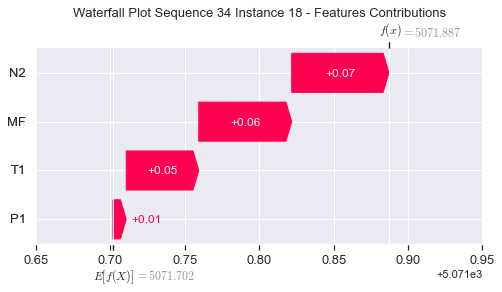

None

Contribution: [0.03935619 0.05638985 0.10978287 0.07443476]


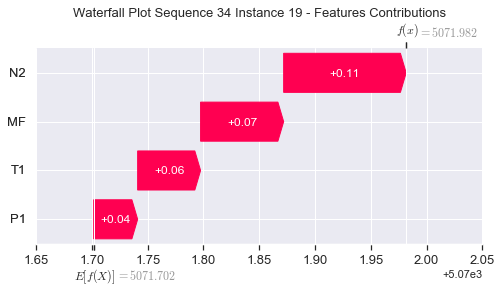

None

Contribution: [-0.09857906  0.16003012  0.51612291  0.68869554]


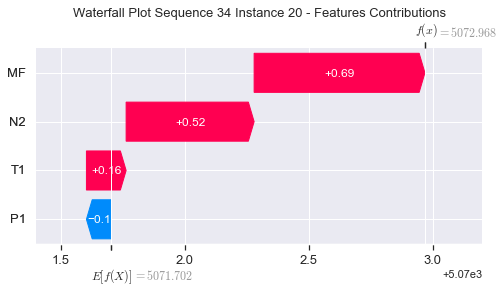

None

Contribution: [-0.1436217  -0.03009308 -0.34909509 -0.27379688]


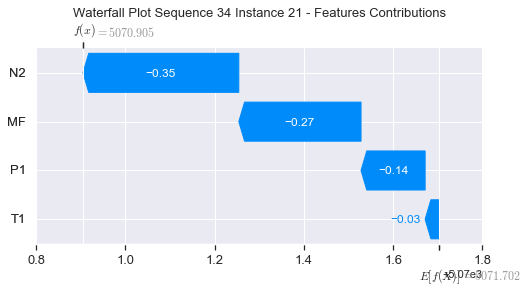

None

Contribution: [ 1.04106416 -0.26526957 -2.855535   -4.41181995]


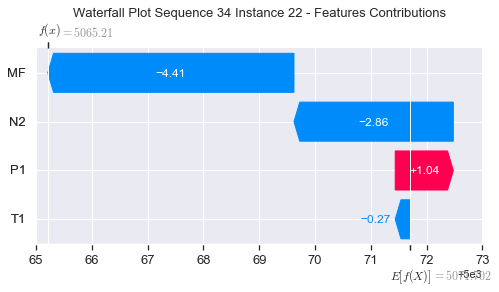

None

Contribution: [0.22395869 1.39219137 3.51183109 3.56186657]


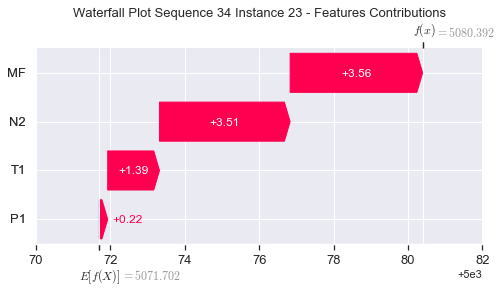

None

Contribution: [ -3.78496717 -22.74743806  19.20837155  32.89099403]


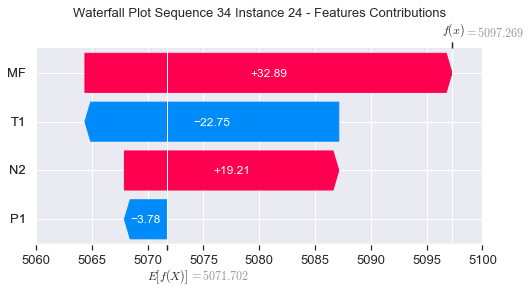

None

In [47]:
#Waterfall Plot for Local Accuracy & Consistency metrics

sns.set()
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [48]:
# calculate variables for control limit c

std.stack().max(),std.stack().mean(),std.stack().std()

(52.07161110099484, 47.91856805748911, 1.5274074757031615)

In [49]:
#calculate control limit

c = (std.stack().max() - std.stack().mean())/std.stack().std()
c

2.7190144801365634

In [29]:
#Load Null anomaly testing data 1

xtest_AD_file = "xNull2.csv"
xtest_AD = pd.read_csv(xtest_AD_file, index_col=False)
xtest_AD = xtest_AD.to_numpy()
xtest_AD = xtest_AD.reshape(1,24,4)

In [30]:
#Load Null anomaly ground truth 1

ytest_AD_file = "yNull2.csv"
ytest_AD = pd.read_csv(ytest_AD_file, index_col=False)

In [31]:
#Prediction

preds_AD = model(xtest_AD)
y_AD = preds_AD[0].sample(1000)
#y1_AD = preds_AD[1]
y_AD = tf.keras.backend.get_value(y_AD)
#y1_AD = tf.keras.backend.get_value(y1_AD)
tens_draw_AD = y_AD
#tens_draw1_AD = y1_AD

#Predicted RUL for each Fleet
mean_Fleet_All_AD = np.zeros(tens_draw_AD.shape[1])
mean_Fleet_AD = np.zeros(tens_draw_AD.shape[0])
for y in range(tens_draw_AD.shape[1]):
    for x in range(tens_draw_AD.shape[0]):
        mean_Fleet_AD[x] = tens_draw_AD[x,y,0]
    mean_Fleet_All_AD[y] = mean_Fleet_AD.mean()
      
mean_Fleet_All_AD, #tens_draw1_AD

(array([5196.1662085]),)

In [35]:
pad=24

In [36]:
#Calculate Mean and Std for predictions with AU

Fleet_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[0])))
mean_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
std_AD = pd.DataFrame(np.zeros((pad,tens_draw_AD.shape[1])))
for z in range(tens_draw_AD.shape[1]):
    for y in range(tens_draw_AD.shape[0]):
        for x in range(pad):
            Fleet_AD[y][x] = tens_draw_AD[y,z,x]
    row_Mean_AD = Fleet_AD.mean(axis=1)
    row_Std_AD = Fleet_AD.std(axis=1)
    for j in range(pad):
        mean_AD[z][j] = row_Mean_AD[j]
    for k in range(pad):
        std_AD[z][k] = row_Std_AD[k]

In [37]:
hour_NUM2 = ['1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am','12pm']

0


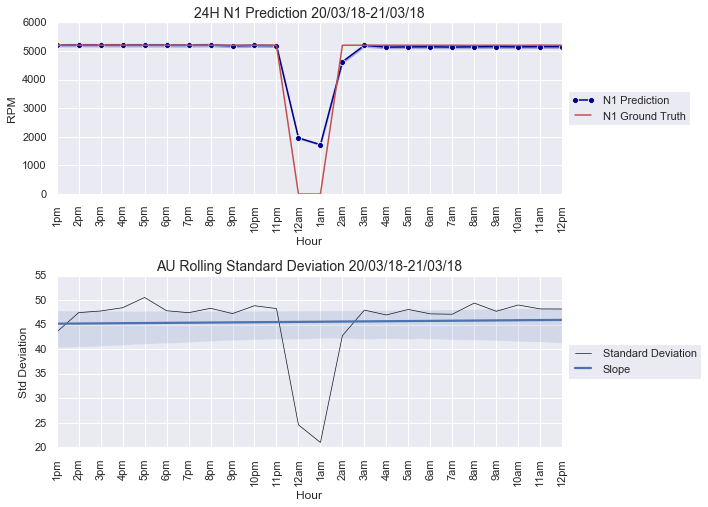

In [55]:
#Visualize prediction

for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD.shape[0])))
    for y in range(tens_draw_AD.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD.shape[0]:
        if(m < (tens_draw_AD.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','RPM']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD['N1'][x]
    max_RUL_Arrange.columns = ['Hour','RPM']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD[B][x]
    min_Std_Arrange.columns = ['Hour','RPM']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange, color='darkblue', ax=ax, label="N1 Prediction")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='r', ax=ax,label="N1 Ground Truth")
    plt.title('24H N1 Prediction 20/03/18-21/03/18',fontsize=14)
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.set_xlabel('Hour')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'RPM', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 20/03/18-21/03/18',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM2, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

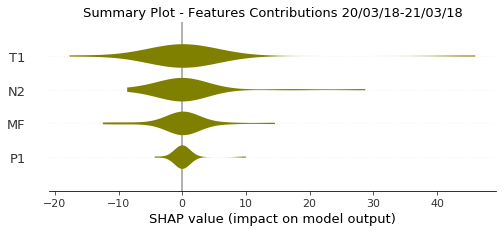

In [43]:
#Summary Plot for anomaly

#sns.set_style("ticks")
instance = xtest_AD
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions 20/03/18-21/03/18",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [57]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [58]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Real Gas Turbine/LSTM-N1/AD1.csv', index = False)

In [59]:
#Load Null anomaly testing data 2

xtest_AD_ALL_file = "xNull1.csv"
xtest_AD_ALL = pd.read_csv(xtest_AD_ALL_file, index_col=False)
xtest_AD_ALL = xtest_AD_ALL.to_numpy()
xtest_AD_ALL = xtest_AD_ALL.reshape(1,24,4)

In [60]:
#Load Null anomaly ground truth 2

ytest_AD_ALL_file = "yNull1.csv"
ytest_AD_ALL = pd.read_csv(ytest_AD_ALL_file, index_col=False)

In [61]:
#Prediction

preds_AD_ALL = model(xtest_AD_ALL)
y_AD_ALL = preds_AD_ALL[0].sample(1000)
#y1_AD_ALL = preds_AD_ALL[2]
y_AD_ALL = tf.keras.backend.get_value(y_AD_ALL)
#y1_AD_ALL = tf.keras.backend.get_value(y1_AD_ALL)
tens_draw_AD_ALL = y_AD_ALL
#tens_draw1_AD_ALL = y1_AD_ALL

#Predicted RUL for each Fleet
mean_Fleet_All_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[1])
mean_Fleet_AD_ALL = np.zeros(tens_draw_AD_ALL.shape[0])
for y in range(tens_draw_AD_ALL.shape[1]):
    for x in range(tens_draw_AD_ALL.shape[0]):
        mean_Fleet_AD_ALL[x] = tens_draw_AD_ALL[x,y,0]
    mean_Fleet_All_AD_ALL[y] = mean_Fleet_AD_ALL.mean()
      
mean_Fleet_All_AD_ALL, #tens_draw1_AD_ALL

(array([5156.0652749]),)

In [62]:
#Calculate Mean and Std for predictions with AU

Fleet_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[0])))
mean_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
std_AD_ALL = pd.DataFrame(np.zeros((pad,tens_draw_AD_ALL.shape[1])))
for z in range(tens_draw_AD_ALL.shape[1]):
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(pad):
            Fleet_AD_ALL[y][x] = tens_draw_AD_ALL[y,z,x]
    row_Mean_AD_ALL = Fleet_AD_ALL.mean(axis=1)
    row_Std_AD_ALL = Fleet_AD_ALL.std(axis=1)
    for j in range(pad):
        mean_AD_ALL[z][j] = row_Mean_AD_ALL[j]
    for k in range(pad):
        std_AD_ALL[z][k] = row_Std_AD_ALL[k]

In [63]:
hour_NUM3 = ['12pm','1pm','2pm','3pm','4pm','5pm','6pm','7pm','8pm','9pm','10pm','11pm','12am','1am','2am','3am','4am','5am','6am','7am','8am','9am','10am','11am']

0


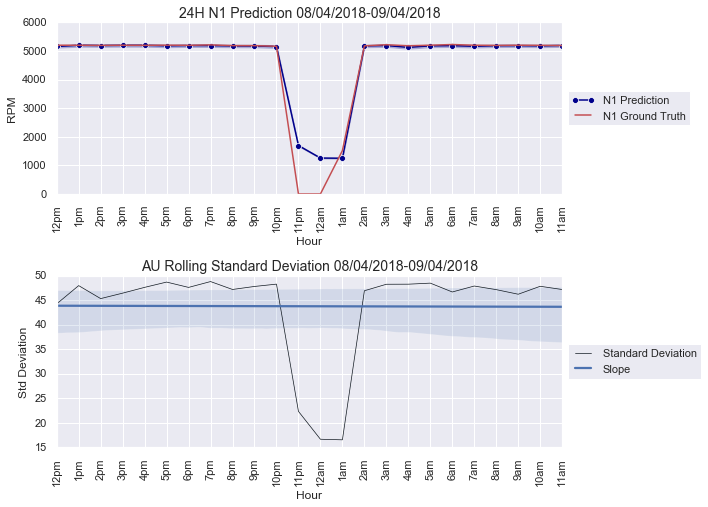

In [64]:
#Visualize anomaly prediction

sns.set()
for B in range(1):
    lim = 24
    lim2 = 24
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw_AD_ALL.shape[0])))
    for y in range(tens_draw_AD_ALL.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw_AD_ALL[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw_AD_ALL.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw_AD_ALL.shape[0]:
        if(m < (tens_draw_AD_ALL.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Hour','RPM']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = ytest_AD_ALL['N1'][x]
    max_RUL_Arrange.columns = ['Hour','RPM']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std_AD_ALL[B][x]
    min_Std_Arrange.columns = ['Hour','RPM']
    
    
    # get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    print(B)
    
    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Hour", y="RPM",ci = "sd", marker='o', data=max_Seq_Arrange,color='darkblue', ax=ax, label="N1 Prediction")
    sns.lineplot(x="Hour", y="RPM", data = max_RUL_Arrange, color='r', ax=ax,label="N1 Ground Truth")
    plt.title('24H N1 Prediction 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Hour', 'RPM', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Hour'],min_Std_Arrange['RPM'],label ='Slope',scatter = False)
    plt.title('AU Rolling Standard Deviation 08/04/2018-09/04/2018',fontsize=14)
    ax.set_xlabel('Hour')
    ax.set_ylabel('Std Deviation')
    ax.set_xticks(fleet_NUM)
    ax.set_xticklabels(hour_NUM3, rotation='vertical')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()

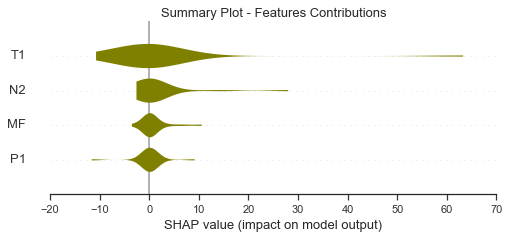

In [65]:
#Summary Plot for anomaly

sns.set_style("ticks")
instance = xtest_AD_ALL
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
shap_values = explainer.shap_values(instance)
plt.title("Summary Plot - Features Contributions",fontsize=13)
shap.summary_plot(shap_values[0][0],feature_names=xtrain.columns,plot_type="violin", color='olive')

In [66]:
#SHAP Force Plot for anomaly

sns.set_style("ticks")
e = explainer.expected_value
for j in range(24):
    print(j+1)
    xtest_df = pd.DataFrame(data = xtest_AD_ALL[0][j].reshape(1,4),columns=features).round(3)
    disp = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(15, 2),text_rotation=15)
    display(disp)

1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


In [67]:
# Export data for anomaly detection with MATLAB cusum

min_Std_Arrange.to_csv(r'C:/Users/Asus/Desktop/Real Gas Turbine/LSTM-N1/AD2.csv', index = False)

In [68]:
#Define f''x

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 24, 890)           3182640   
_________________________________________________________________
dense_4 (Dense)              (None, 24, 33)            29403     
_________________________________________________________________
dense_5 (Dense)              (None, 24, 1)             34        
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 3,212,077
Trainable params: 3,212,077
Non-trainable params: 0
_________________________________________________________________


In [69]:
#Extract only weights for 3 variables excluding mf

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [70]:
#Transfer weights from f'x to f''x

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [71]:
#Load xtest and delete mf

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete mf

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [72]:
#Prediction with features excluding mf 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [73]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [-1.01508664  5.26498338 37.95846968]


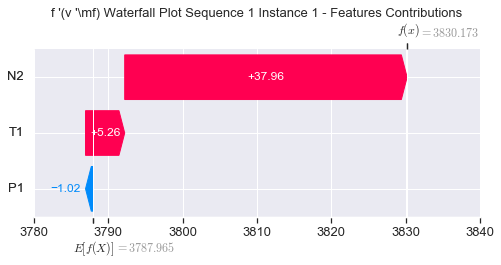

None

Contribution: [-0.08028404 -0.60696425  0.33007146]


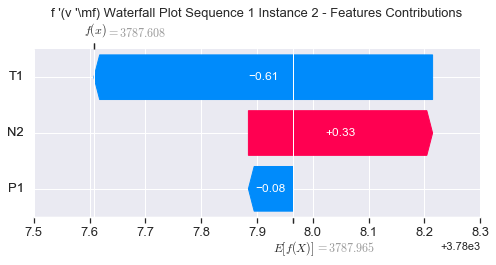

None

Contribution: [-0.04943554  0.03651708  0.14631367]


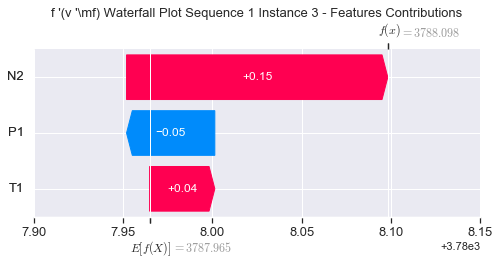

None

Contribution: [-0.0764087   0.05551175  0.30732451]


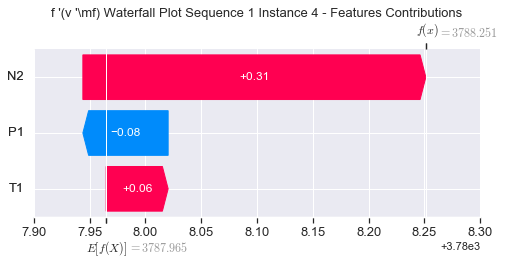

None

Contribution: [-0.05960855  0.03900847  0.234193  ]


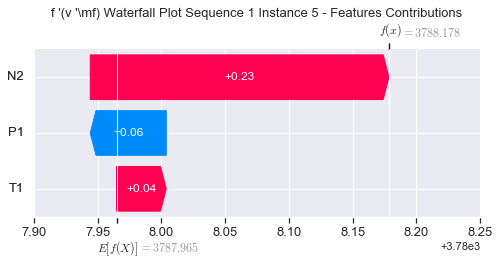

None

Contribution: [-0.0407657   0.14306967  0.19533573]


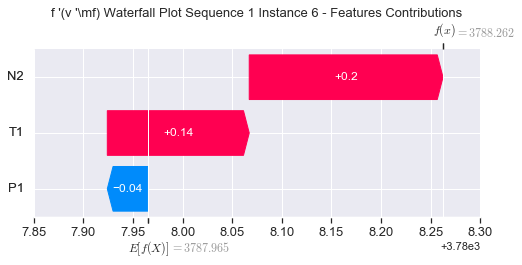

None

Contribution: [-0.04444702  0.15357914  0.21361685]


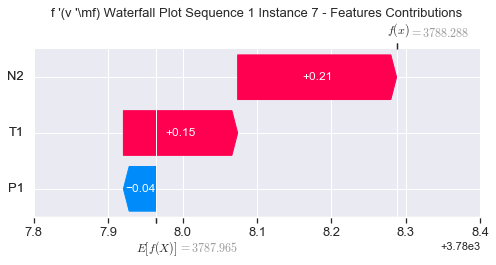

None

Contribution: [-0.04542138  0.16159747  0.21688456]


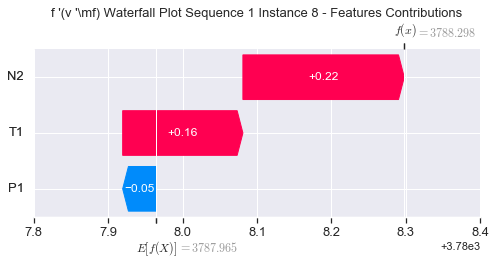

None

Contribution: [-0.05339925  0.12577071  0.21294932]


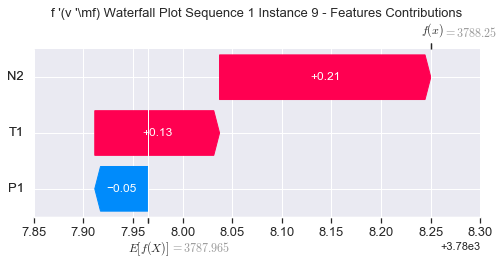

None

Contribution: [-0.09397041  0.15090458  0.20619701]


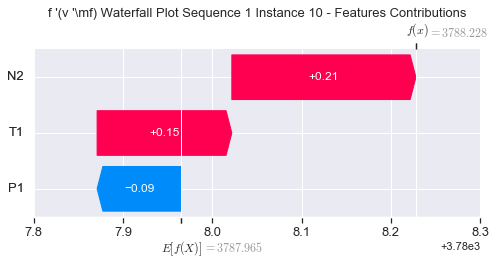

None

Contribution: [-0.06268911  0.14635713  0.20418816]


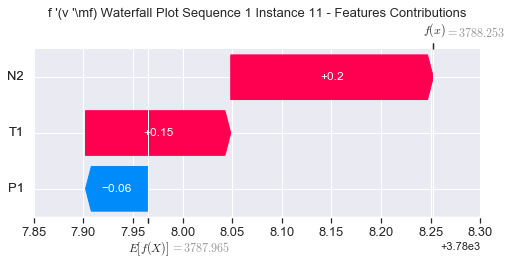

None

Contribution: [-0.08712979  0.1626057   0.20132039]


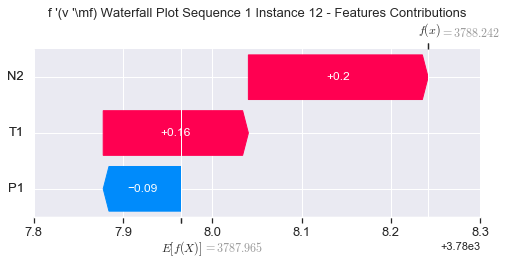

None

Contribution: [-0.08637859  0.14646119  0.19463693]


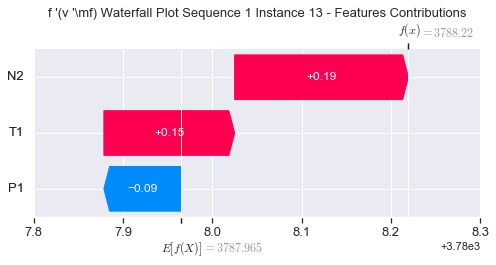

None

Contribution: [-0.04210977  0.11718433  0.18515206]


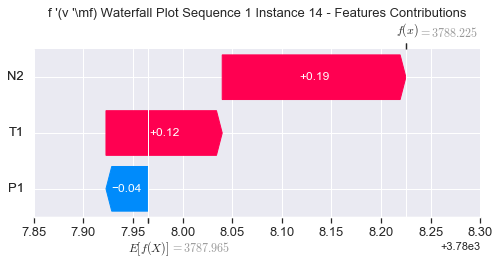

None

Contribution: [-0.06901571  0.11382451  0.17891903]


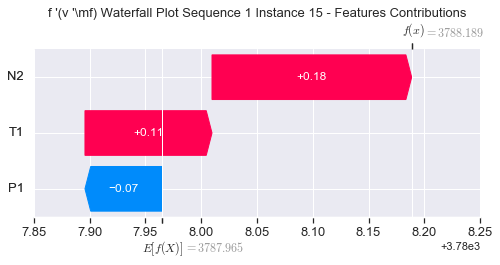

None

Contribution: [-0.12042741  0.23403742  0.17052821]


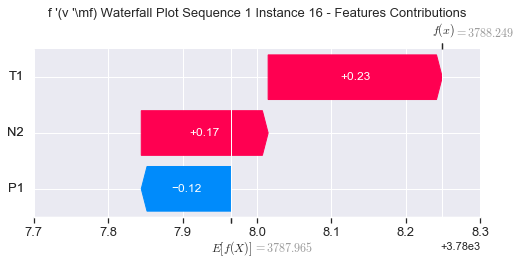

None

Contribution: [-0.13422987  0.36654236  0.17273862]


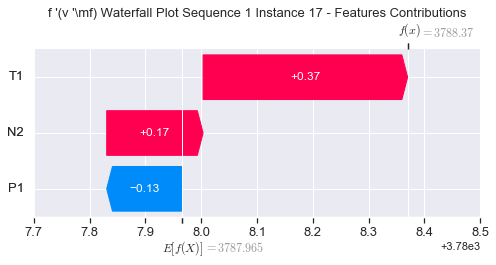

None

Contribution: [-0.09447065 -0.01133463  0.14220193]


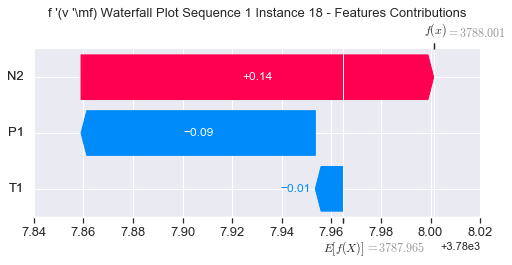

None

Contribution: [ 0.20469478 -0.9538429   0.12626463]


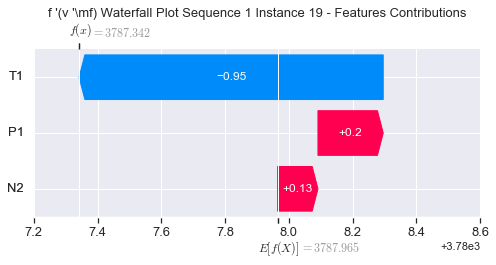

None

Contribution: [ 0.2113909  -0.29921083  0.12909482]


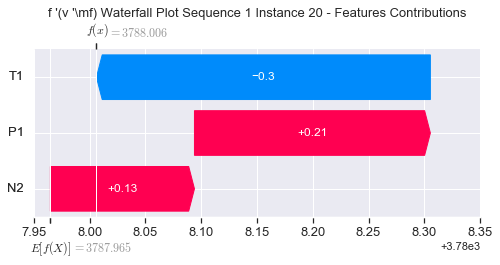

None

Contribution: [-0.61318965  3.57461834 -0.26006465]


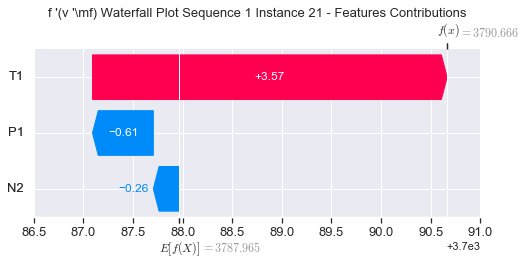

None

Contribution: [-1.62220355  5.67118915 -0.51511338]


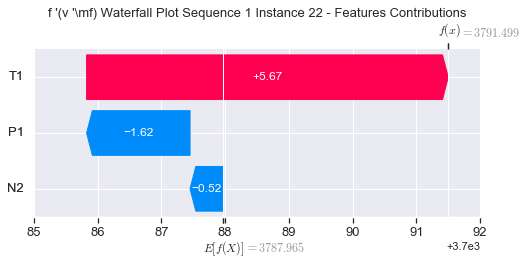

None

Contribution: [ 0.37998638 -5.25082671  3.8623768 ]


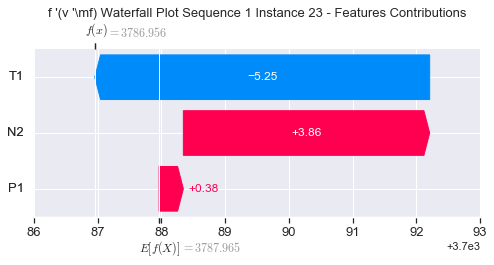

None

Contribution: [  3.07388145 -19.7956709   13.62017228]


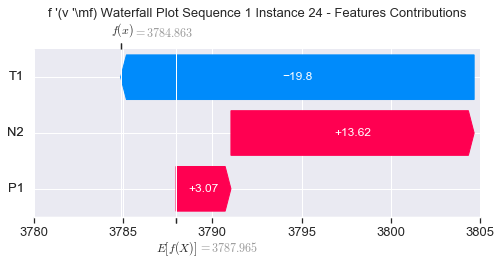

None

Contribution: [ 0.95655305  7.55491278 32.78775447]


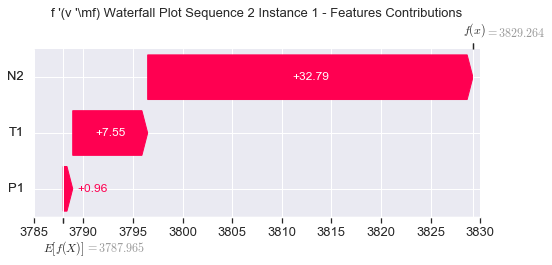

None

Contribution: [-0.13301569 -0.34213197  0.24742147]


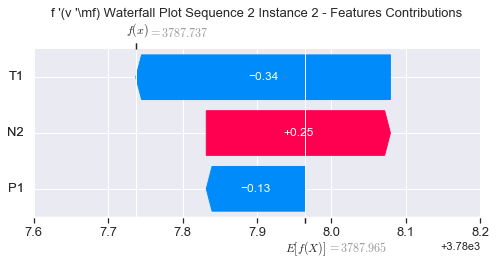

None

Contribution: [-0.04996168  0.04361404  0.13986002]


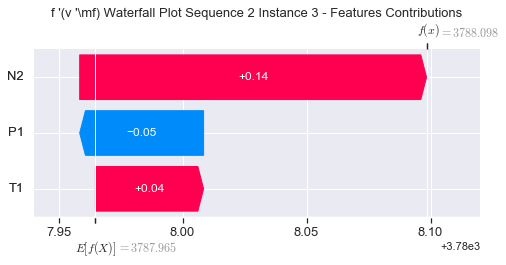

None

Contribution: [-0.07346613  0.06458398  0.30983296]


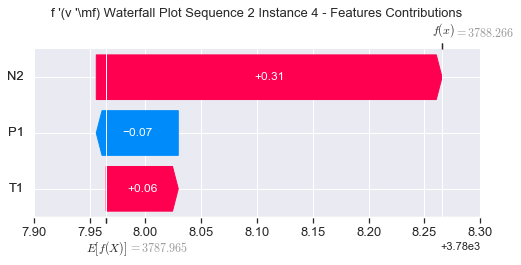

None

Contribution: [-0.05899672 -0.01076893  0.24156403]


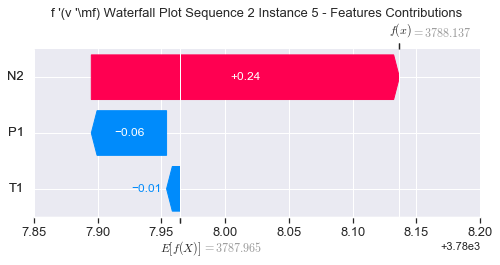

None

Contribution: [-0.04956793  0.23305064  0.21003822]


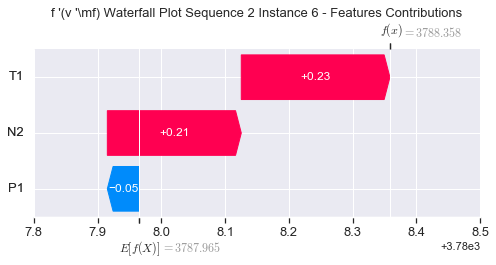

None

Contribution: [-0.05610148  0.27422235  0.2266717 ]


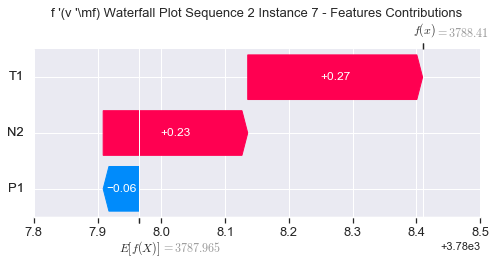

None

Contribution: [-0.06227212  0.29652242  0.22984158]


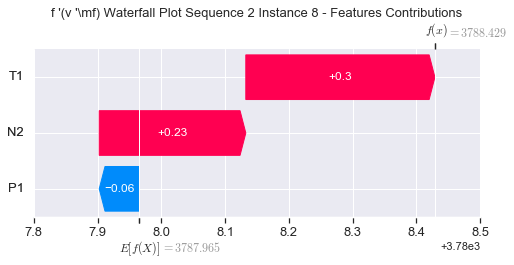

None

Contribution: [-0.07341031  0.35195562  0.21811551]


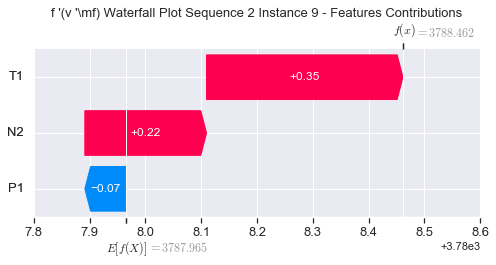

None

Contribution: [-0.11101803  0.37562264  0.20679638]


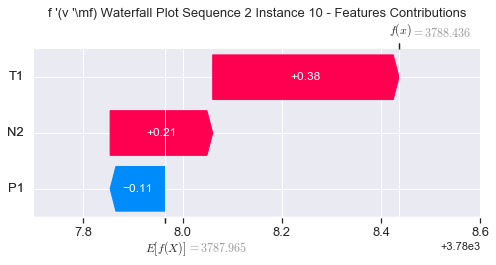

None

Contribution: [-0.10519841  0.35478632  0.21193628]


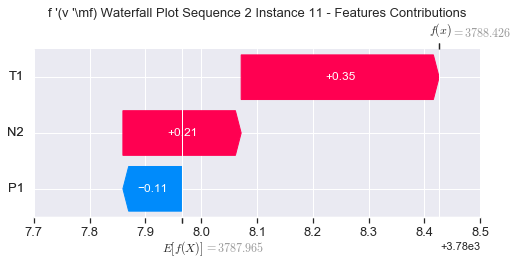

None

Contribution: [-0.10341403  0.32410895  0.21028534]


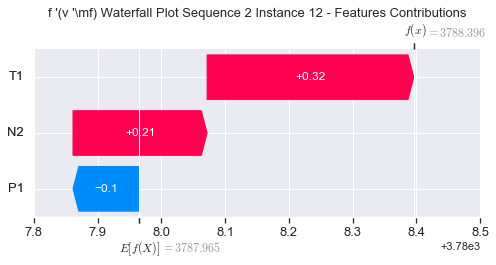

None

Contribution: [-0.10003833  0.30729583  0.20168774]


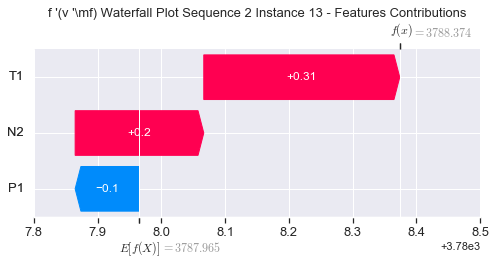

None

Contribution: [-0.08987245  0.25005365  0.1914835 ]


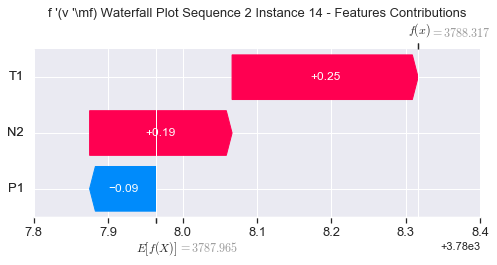

None

Contribution: [-0.0852435   0.21701459  0.18518542]


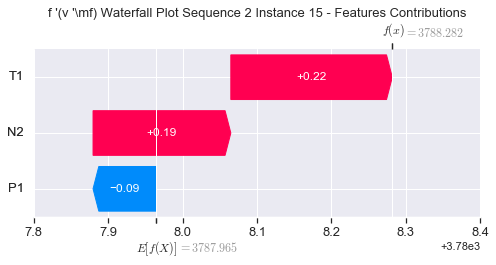

None

Contribution: [-0.13679132  0.52077491  0.17772875]


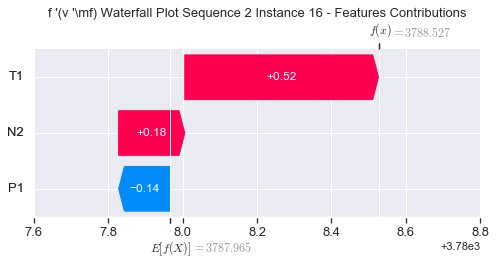

None

Contribution: [-0.1670435   0.9775998   0.17890642]


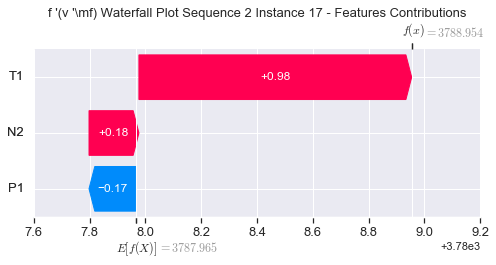

None

Contribution: [-0.12597198  0.06155638  0.14991849]


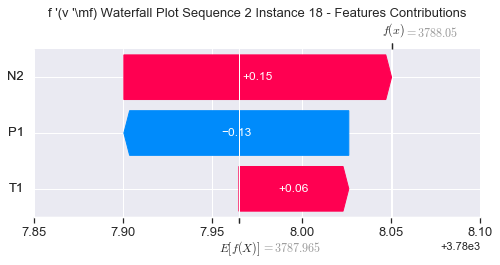

None

Contribution: [ 0.18754665 -2.4630933   0.11853315]


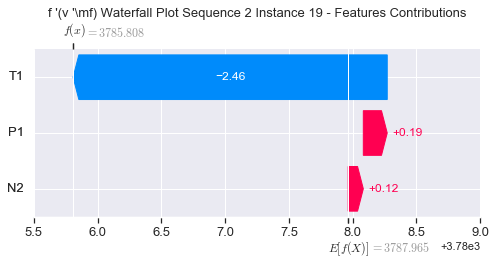

None

Contribution: [ 0.26960746 -1.23462884  0.12960837]


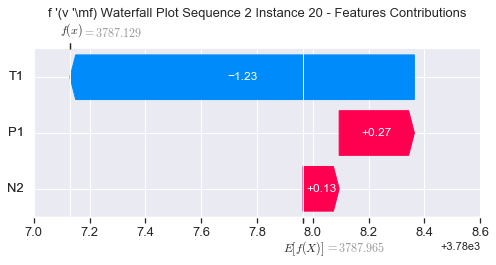

None

Contribution: [-0.76240608 10.29352436 -0.29732688]


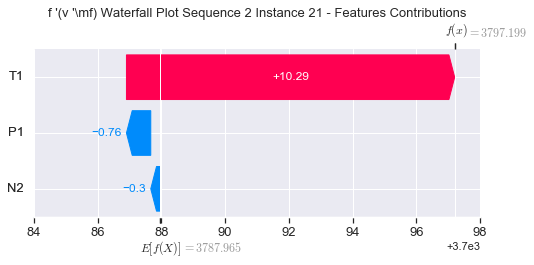

None

Contribution: [-2.10599798 16.85911474 -0.49245271]


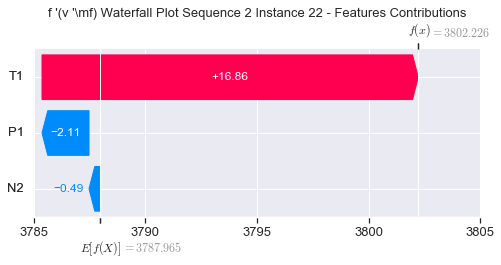

None

Contribution: [  0.56211454 -18.52505091   3.86831738]


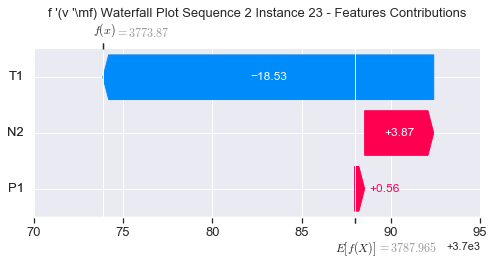

None

Contribution: [  6.64597752 -69.68730447  13.55482488]


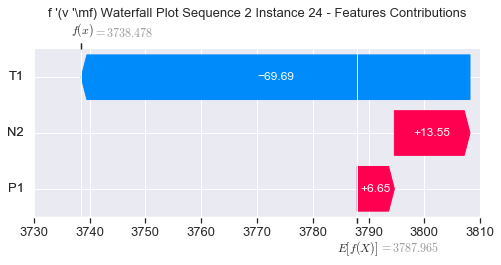

None

Contribution: [-12.25836074 -19.09705255  32.96543521]


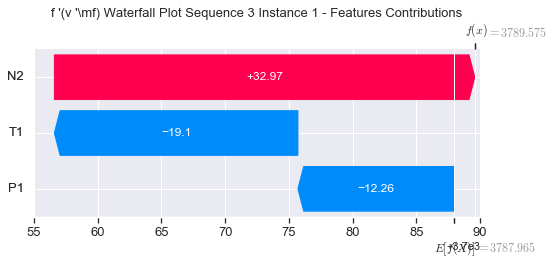

None

Contribution: [-0.17719714 -2.26751845  0.25197381]


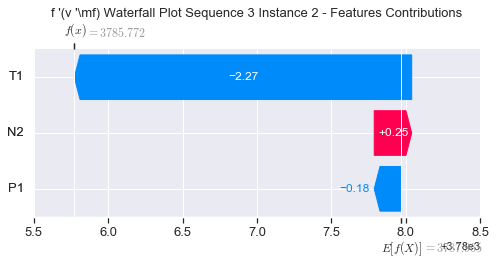

None

Contribution: [-0.04583954 -0.08333585  0.13702099]


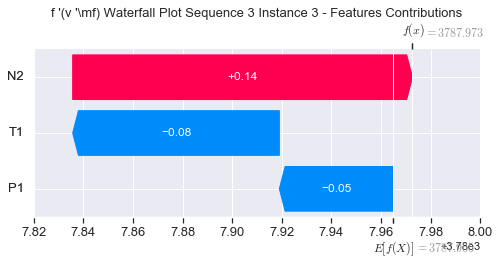

None

Contribution: [-0.0796557  -0.02911294  0.30283201]


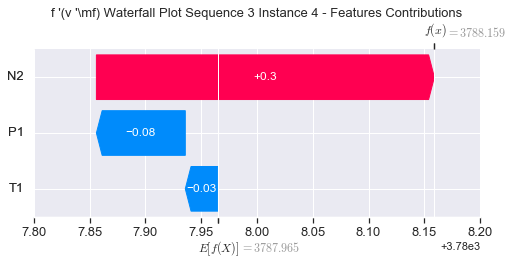

None

Contribution: [-0.05919155 -0.0472574   0.23610851]


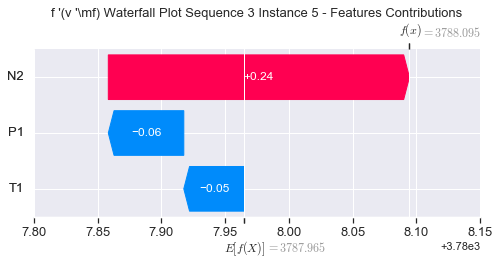

None

Contribution: [-0.0483353  0.2441917  0.2103948]


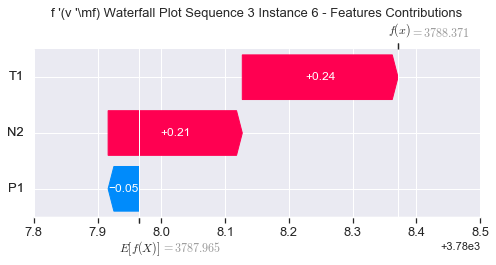

None

Contribution: [-0.05687659  0.29093557  0.22870013]


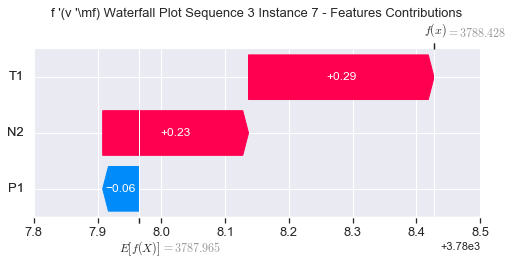

None

Contribution: [-0.06105792  0.30819321  0.23199777]


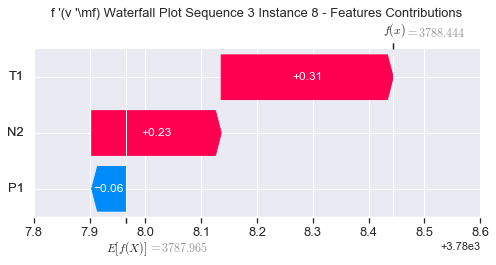

None

Contribution: [-0.07676002  0.31488578  0.22624964]


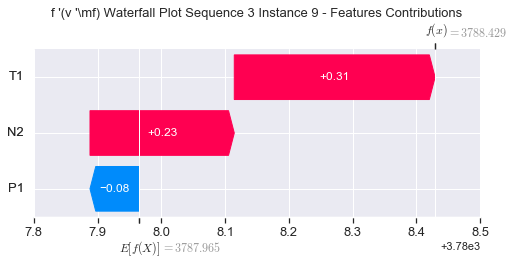

None

Contribution: [-0.09354163  0.29293813  0.21333632]


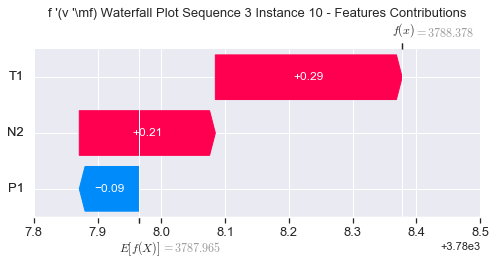

None

Contribution: [-0.08979384  0.31558216  0.21141811]


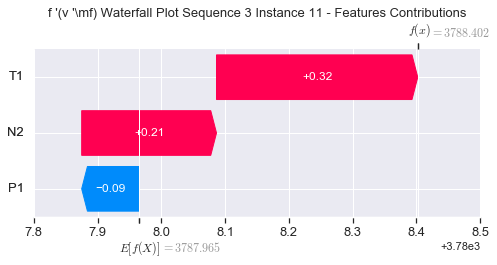

None

Contribution: [-0.08303036  0.31842741  0.20584834]


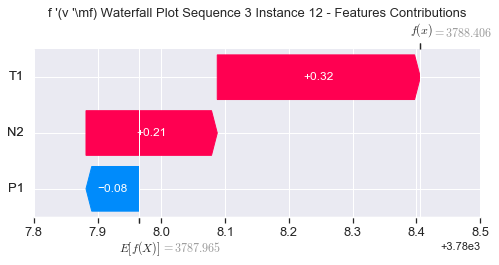

None

Contribution: [-0.08474188  0.30521109  0.19882965]


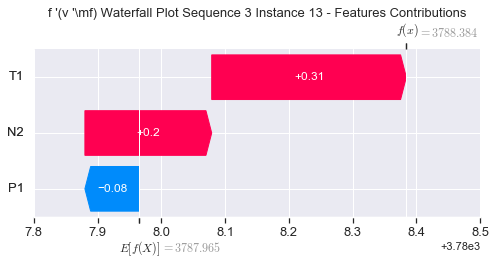

None

Contribution: [-0.10349263  0.2290772   0.18891609]


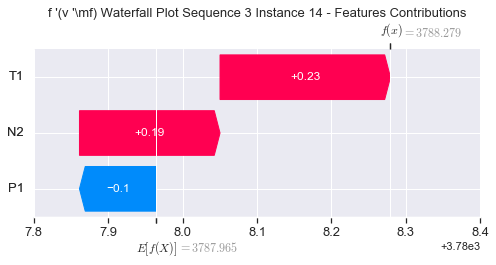

None

Contribution: [-0.075878    0.20982984  0.18098924]


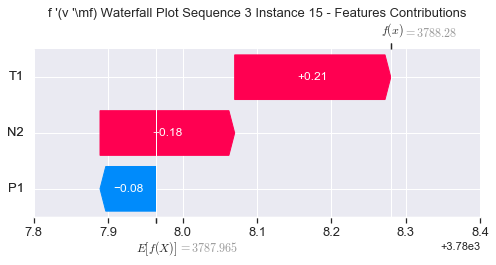

None

Contribution: [-0.0853982   0.46026012  0.16828686]


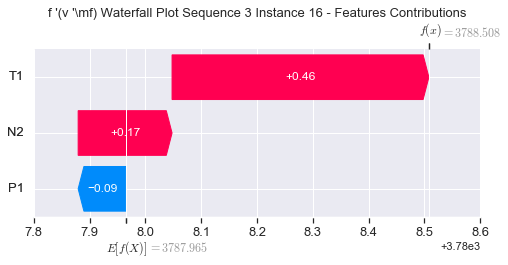

None

Contribution: [-0.14619015  0.89430799  0.17021277]


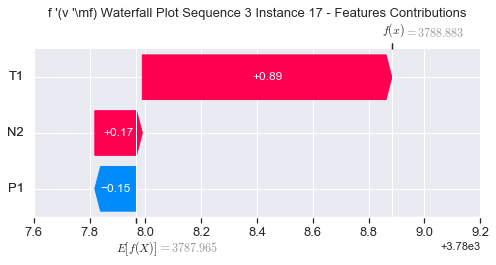

None

Contribution: [-0.11851349  0.1598383   0.14707564]


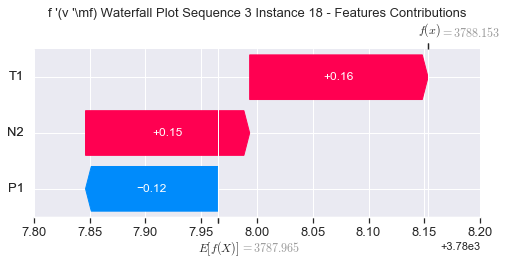

None

Contribution: [ 0.12739487 -2.34610055  0.15458049]


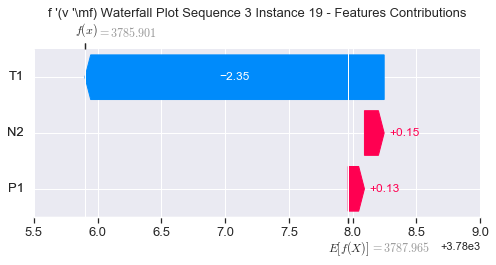

None

Contribution: [ 0.25995667 -1.36539912  0.12049389]


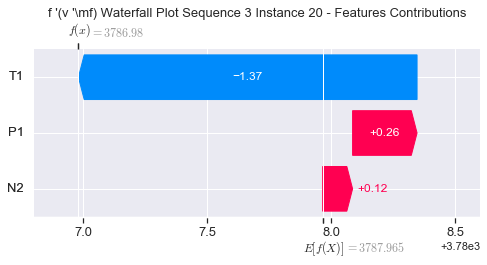

None

Contribution: [-0.65710355  9.86496668 -0.33489598]


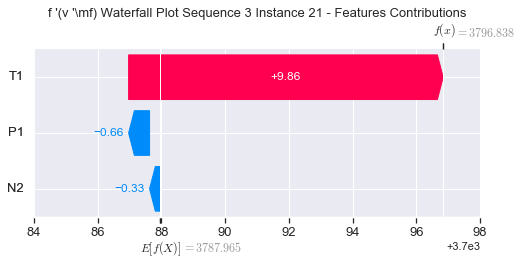

None

Contribution: [-1.81667862 16.93248177 -0.61929396]


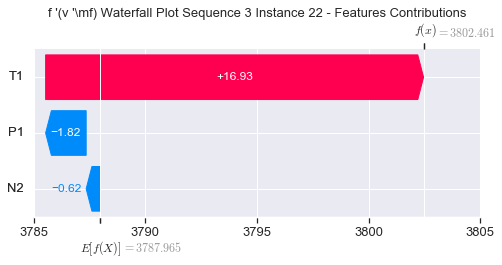

None

Contribution: [  0.52152207 -18.79876376   4.13478646]


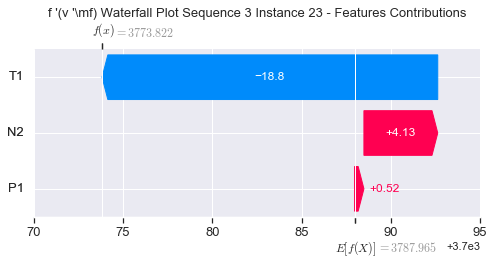

None

Contribution: [  5.03030285 -75.36812903  14.06805626]


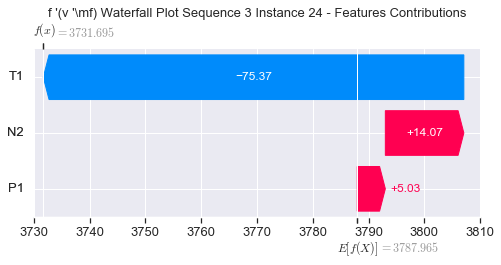

None

Contribution: [ -4.40629563 -22.07435348  32.73628575]


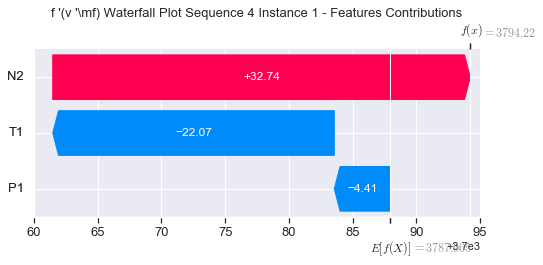

None

Contribution: [-0.13553254 -2.38450109  0.28847593]


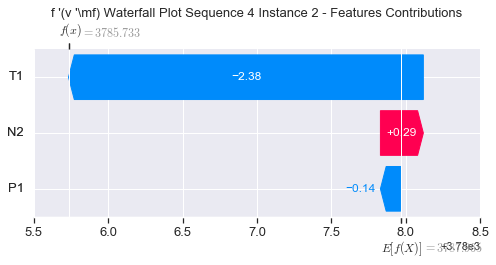

None

Contribution: [-0.04813987 -0.07944049  0.13764606]


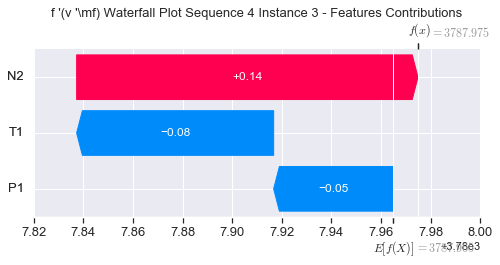

None

Contribution: [-0.08224839 -0.02150906  0.30442777]


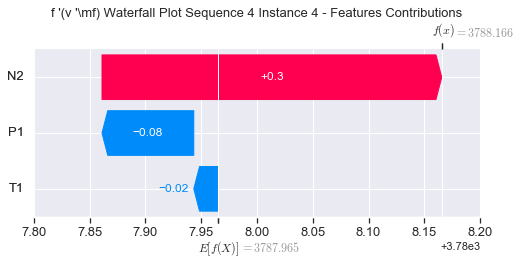

None

Contribution: [-0.06160088 -0.05355803  0.23841323]


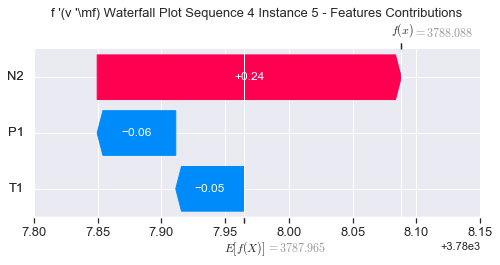

None

Contribution: [-0.04533346  0.26425351  0.20988576]


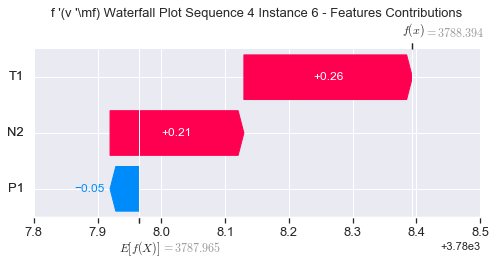

None

Contribution: [-0.04919638  0.31090126  0.22924308]


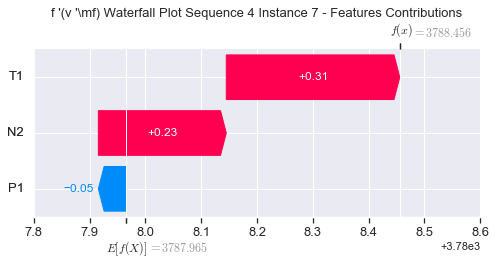

None

Contribution: [-0.05507984  0.32830941  0.23270542]


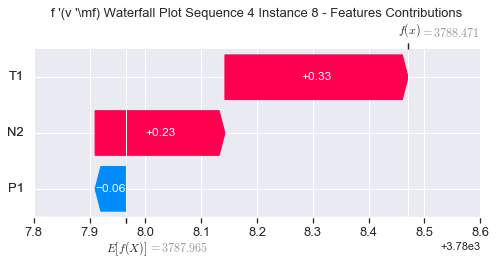

None

Contribution: [-0.08122157  0.35108506  0.22567001]


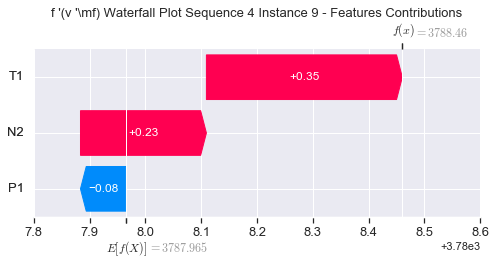

None

Contribution: [-0.08665173  0.39476706  0.21379   ]


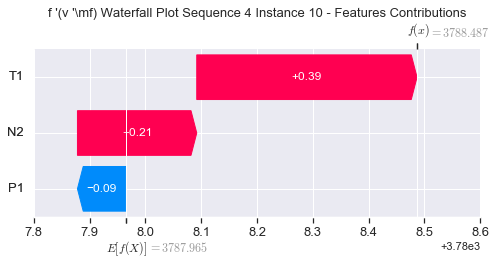

None

Contribution: [-0.10945403  0.37142221  0.21064378]


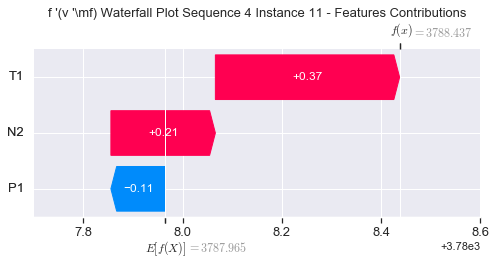

None

Contribution: [-0.08484197  0.33522026  0.20689249]


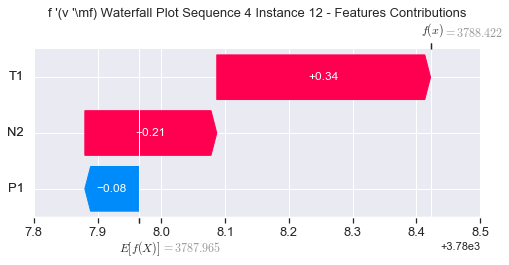

None

Contribution: [-0.08364953  0.32381017  0.19901347]


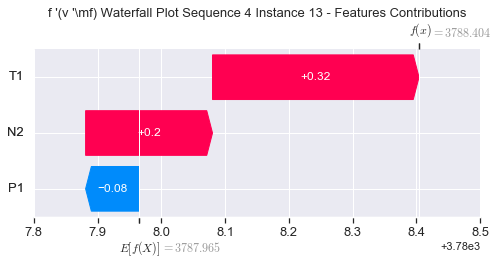

None

Contribution: [-0.08708605  0.24781037  0.18831348]


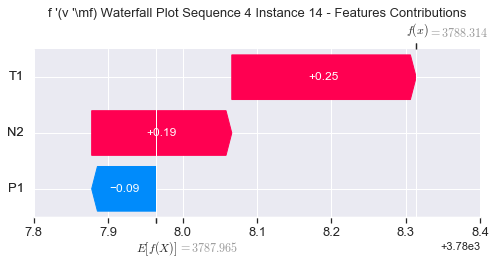

None

Contribution: [-0.07242392  0.22195958  0.18147187]


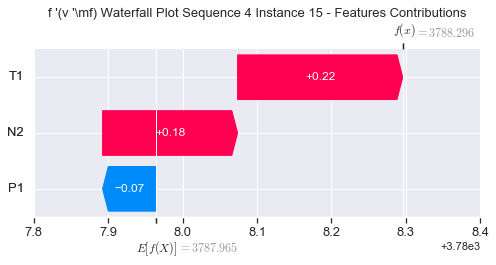

None

Contribution: [-0.11403108  0.49061576  0.17267452]


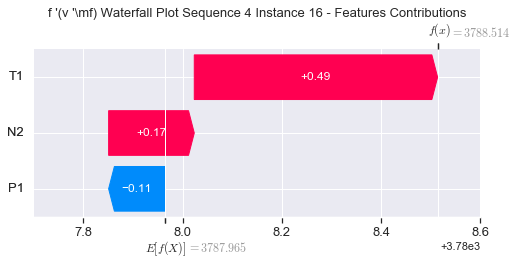

None

Contribution: [-0.13437588  0.95986555  0.16749043]


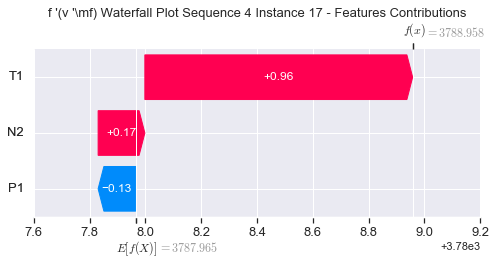

None

Contribution: [-0.10962524  0.17853254  0.14781409]


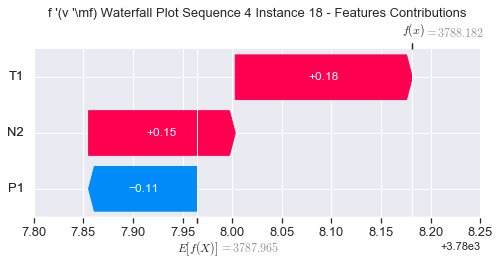

None

Contribution: [ 0.11788758 -2.35045912  0.13606383]


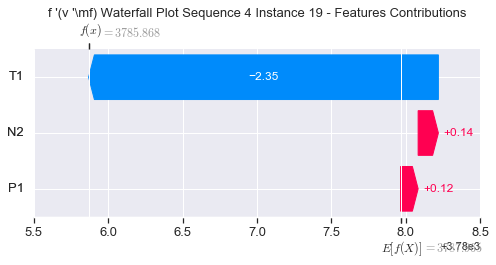

None

Contribution: [ 0.23570599 -1.46138733  0.12459322]


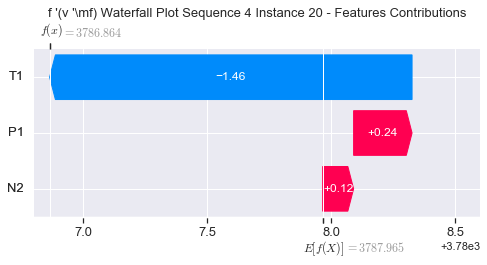

None

Contribution: [-0.62760343 10.40410593 -0.37220402]


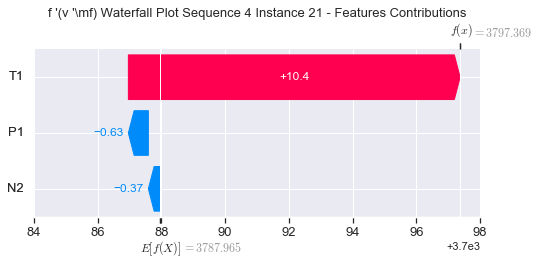

None

Contribution: [-1.84635514 17.87231885 -0.64766771]


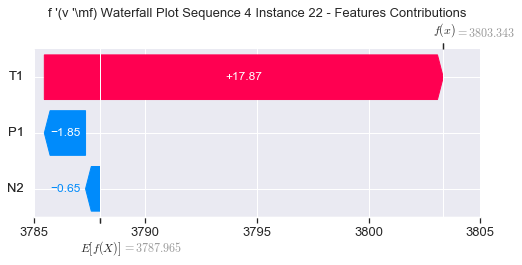

None

Contribution: [  0.53376686 -20.24310235   4.19079147]


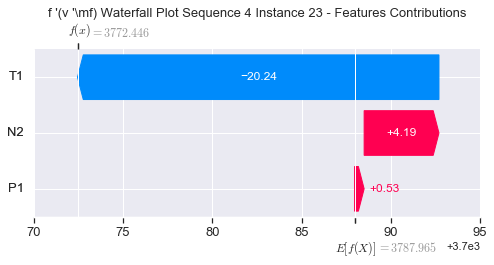

None

Contribution: [  5.80537969 -80.49707403  14.53564113]


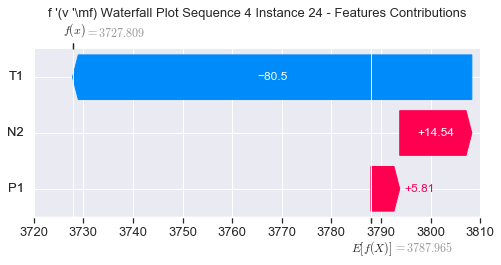

None

Contribution: [-11.13227346 -23.58405252  35.53562025]


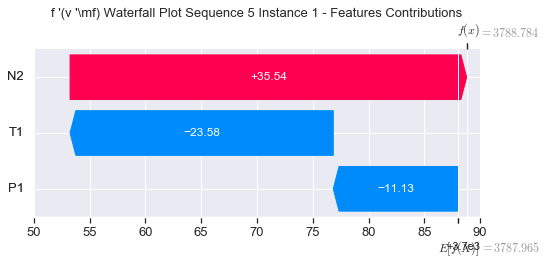

None

Contribution: [-0.17261323 -2.46947941  0.28316957]


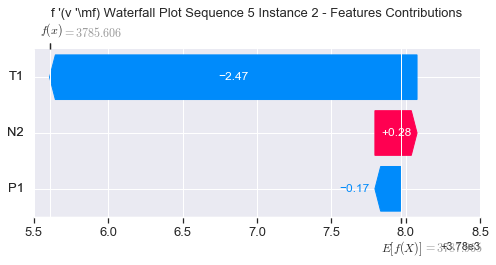

None

Contribution: [-0.0479204  -0.08674226  0.13584953]


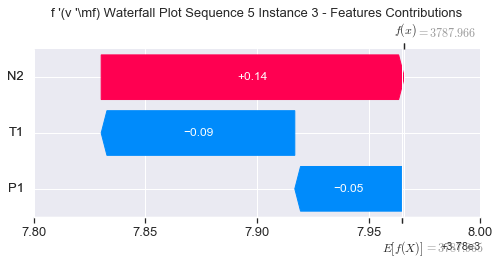

None

Contribution: [-0.07536051 -0.02440905  0.30175985]


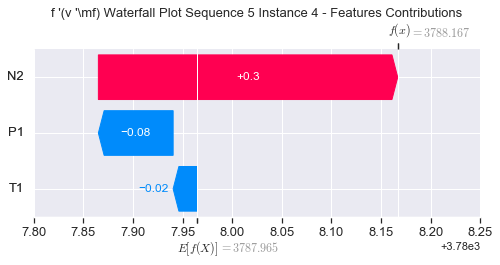

None

Contribution: [-0.05451061 -0.0520535   0.23639934]


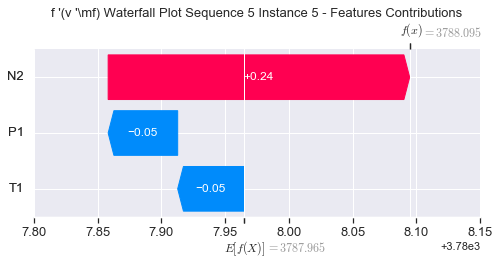

None

Contribution: [-0.05007214  0.249553    0.20856285]


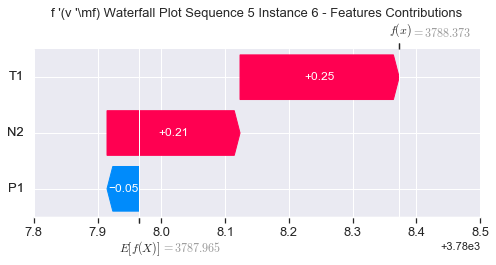

None

Contribution: [-0.05980867  0.29628739  0.22807611]


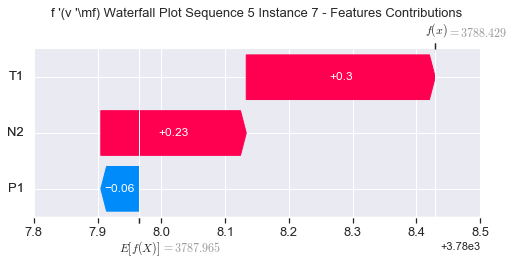

None

Contribution: [-0.06511245  0.31094493  0.2315214 ]


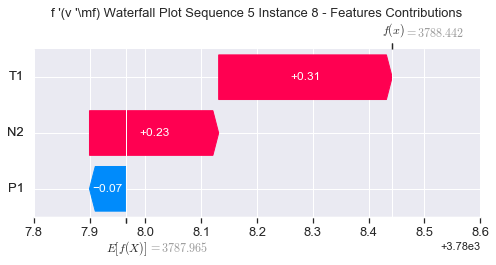

None

Contribution: [-0.07979703  0.32976118  0.22663187]


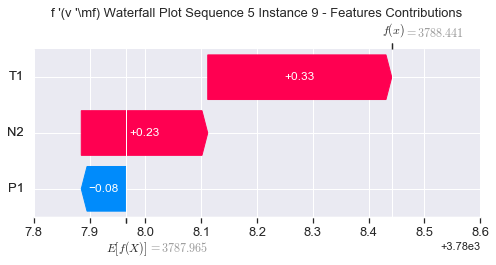

None

Contribution: [-0.12369195  0.34832998  0.21517244]


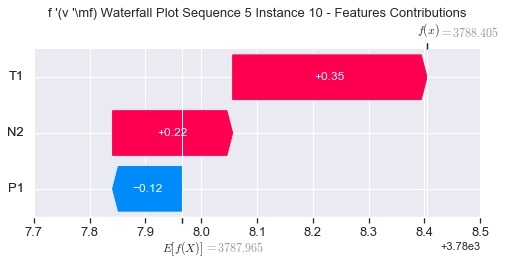

None

Contribution: [-0.10377951  0.32385718  0.21109822]


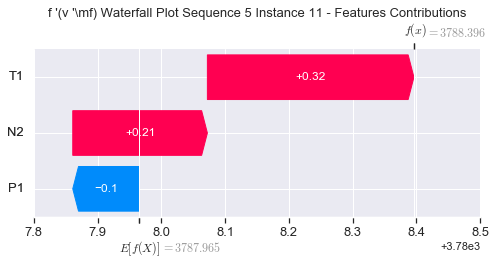

None

Contribution: [-0.09903714  0.31303499  0.20554175]


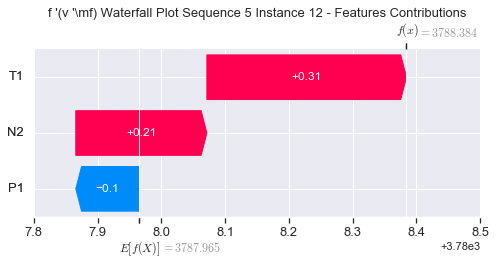

None

Contribution: [-0.09745599  0.3053733   0.19811732]


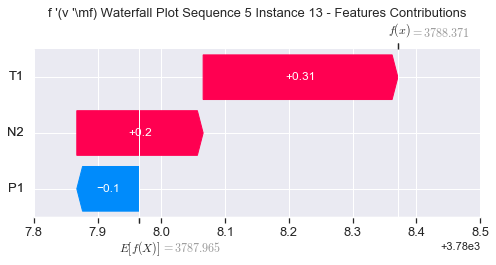

None

Contribution: [-0.07621875  0.23980018  0.18656328]


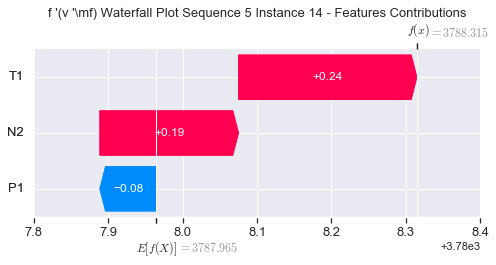

None

Contribution: [-0.07928819  0.20677357  0.1805318 ]


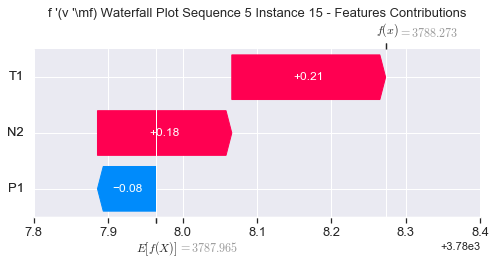

None

Contribution: [-0.08391664  0.46281507  0.16280873]


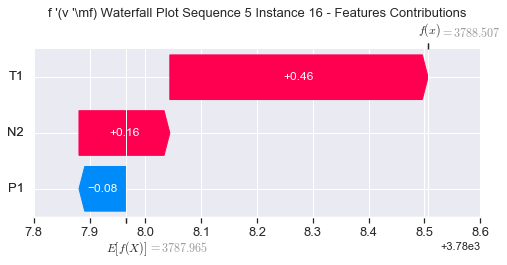

None

Contribution: [-0.14122548  0.86524618  0.16867486]


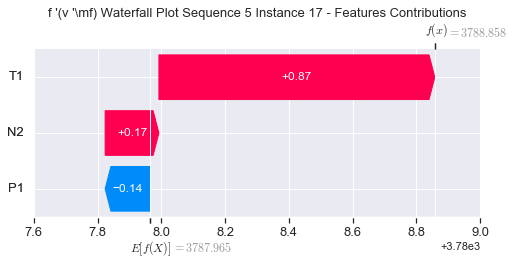

None

Contribution: [-0.11077733  0.15879612  0.14631225]


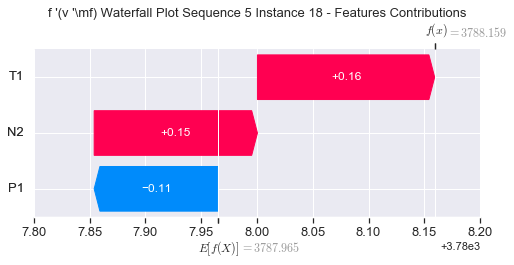

None

Contribution: [ 0.13541017 -2.24675267  0.10095703]


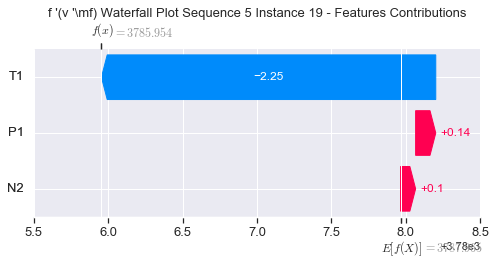

None

Contribution: [ 0.22454954 -1.29056722  0.12169943]


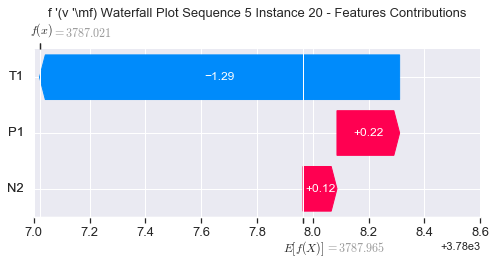

None

Contribution: [-0.58031961  9.30764172 -0.35096751]


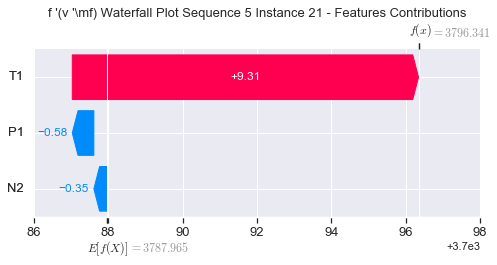

None

Contribution: [-1.66004967 15.77151904 -0.66007616]


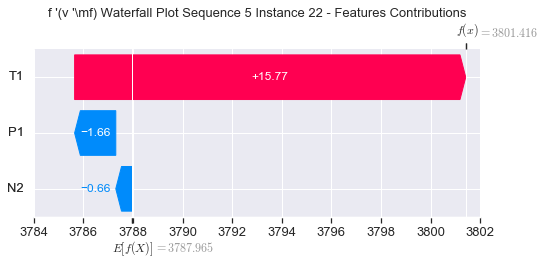

None

Contribution: [  0.45599713 -17.40179449   4.17152616]


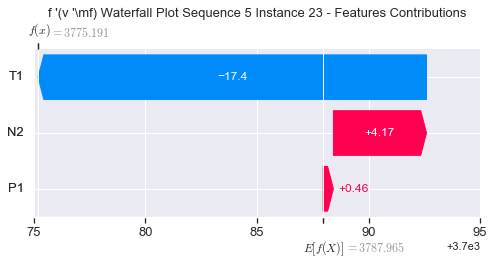

None

Contribution: [  3.98798816 -69.45562465  14.52082583]


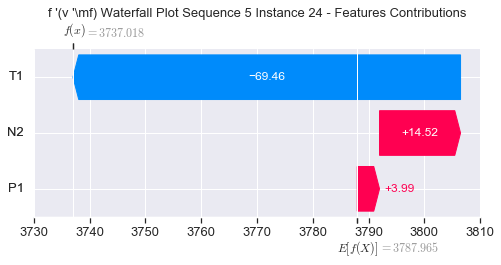

None

Contribution: [ -2.89318724 -18.60957681  34.97542797]


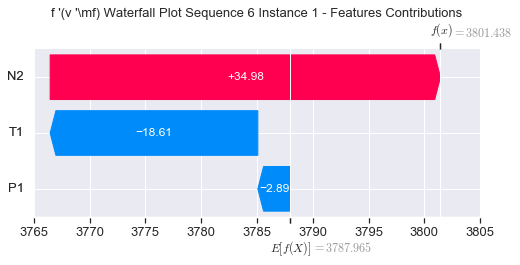

None

Contribution: [-0.14205665 -2.1272462   0.29173971]


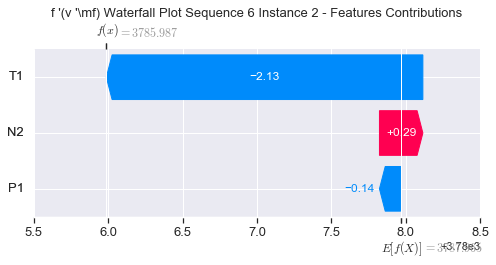

None

Contribution: [-0.04766655 -0.05522705  0.14027171]


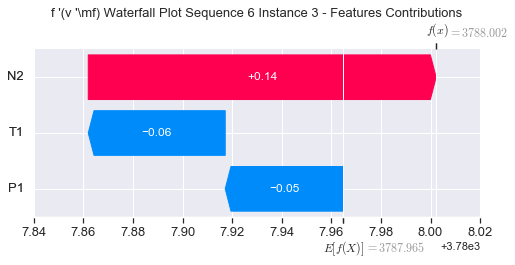

None

Contribution: [-0.07915887 -0.00958157  0.30683793]


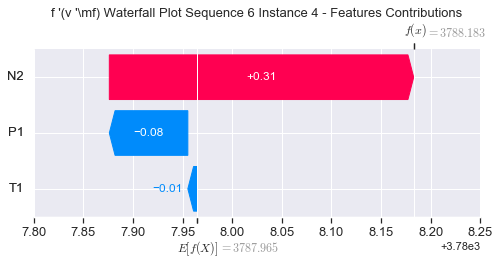

None

Contribution: [-0.06032844 -0.03173665  0.24010329]


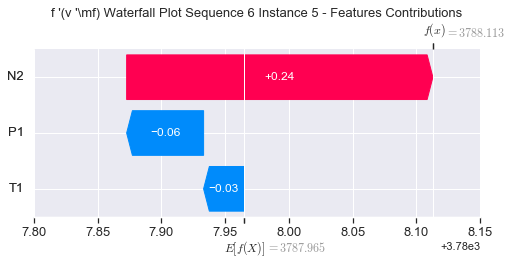

None

Contribution: [-0.04695561  0.24419325  0.21031417]


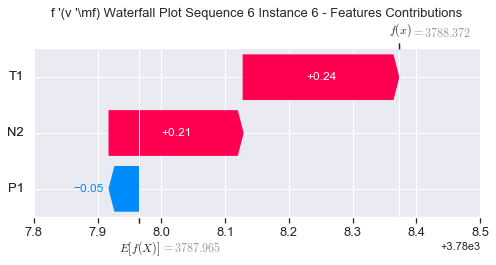

None

Contribution: [-0.05217958  0.29202591  0.23062823]


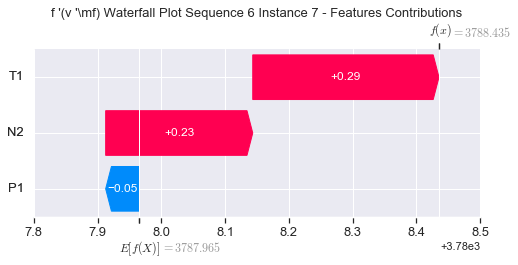

None

Contribution: [-0.05785517  0.31450919  0.23380935]


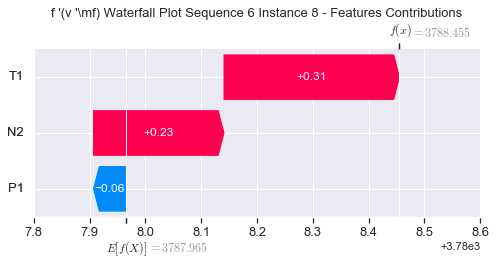

None

Contribution: [-0.07183721  0.35783516  0.22853693]


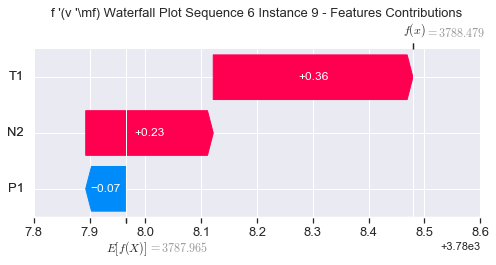

None

Contribution: [-0.1109469   0.36439069  0.21622061]


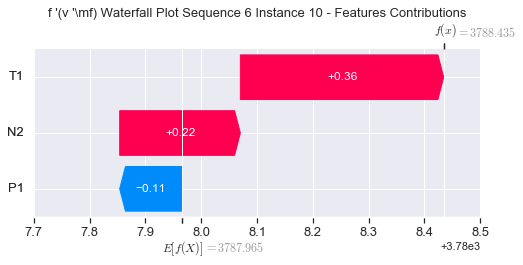

None

Contribution: [-0.09932564  0.37404447  0.2133878 ]


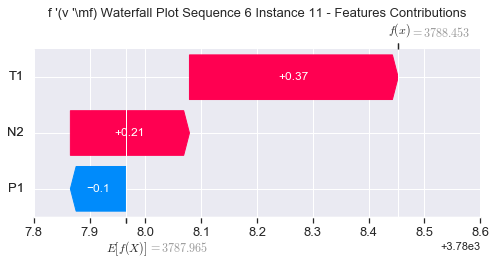

None

Contribution: [-0.09064571  0.34545607  0.21072331]


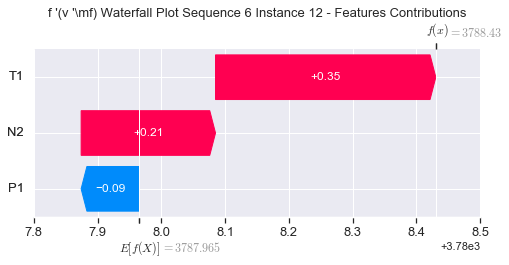

None

Contribution: [-0.08969216  0.33340309  0.20250005]


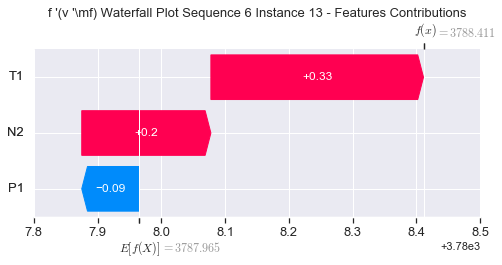

None

Contribution: [-0.08359096  0.2483912   0.19252644]


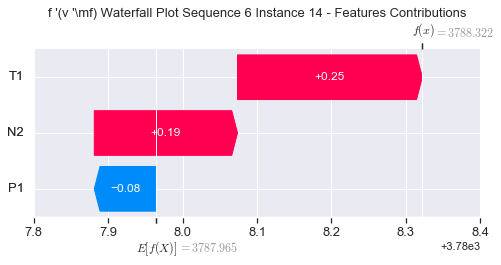

None

Contribution: [-0.07653219  0.22963803  0.18396344]


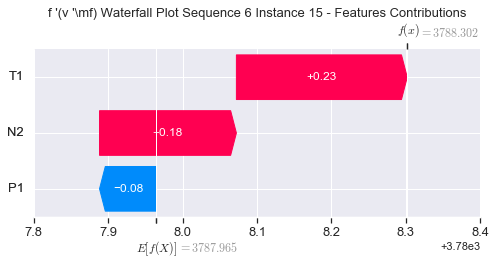

None

Contribution: [-0.10671037  0.56780204  0.1792219 ]


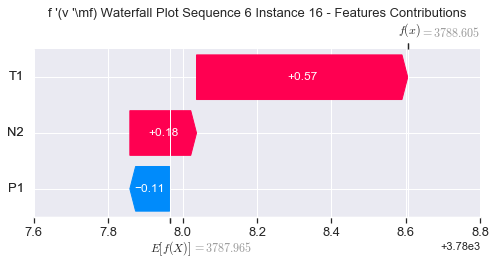

None

Contribution: [-0.1460533   1.0583208   0.17633143]


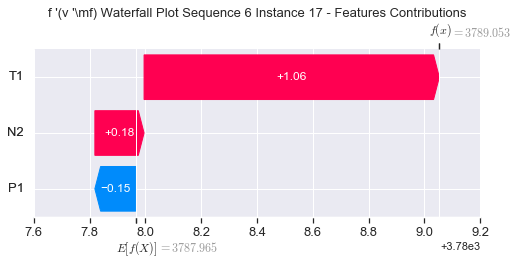

None

Contribution: [-0.11968842  0.195777    0.14943279]


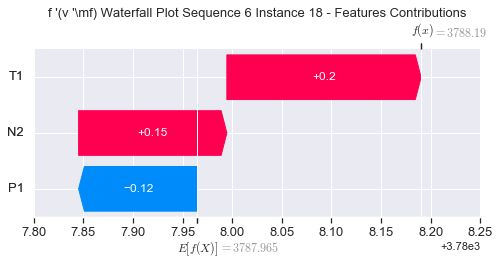

None

Contribution: [ 0.14268304 -2.8035623   0.16848557]


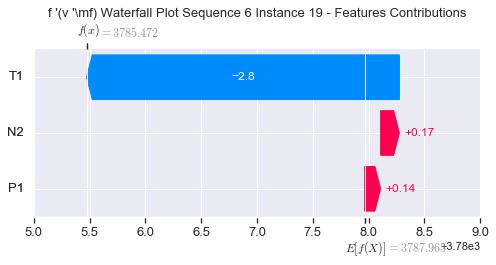

None

Contribution: [ 0.25991229 -1.68003446  0.12796485]


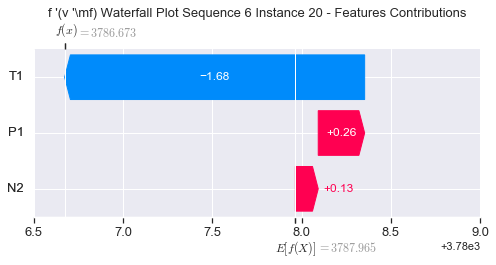

None

Contribution: [-0.69195119 11.92722526 -0.40566823]


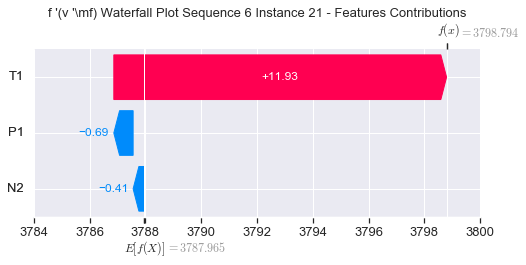

None

Contribution: [-2.03348493 20.52869759 -0.71318216]


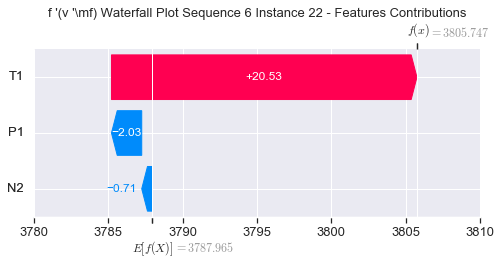

None

Contribution: [  0.59073286 -23.81554181   4.35849153]


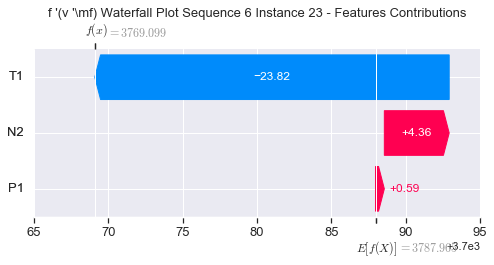

None

Contribution: [  6.26137477 -94.56156645  15.36191954]


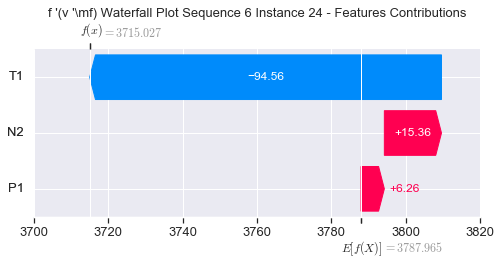

None

Contribution: [ -9.11392555 -32.52036556  35.50079295]


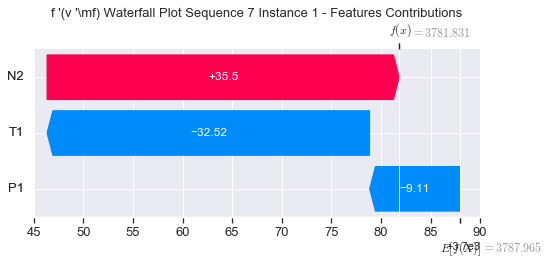

None

Contribution: [-0.19313212 -3.03985224  0.27898567]


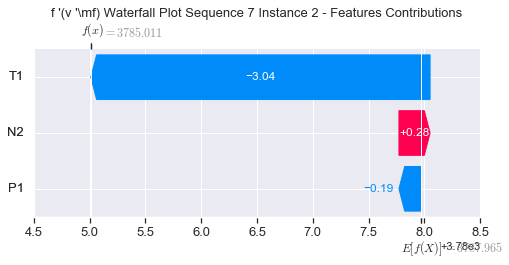

None

Contribution: [-0.0454708  -0.10029571  0.13464022]


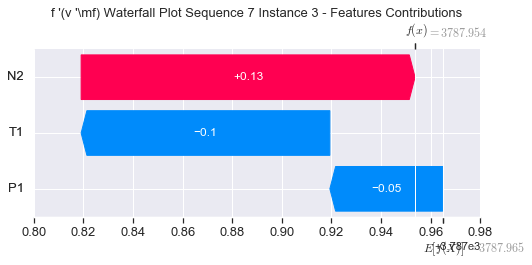

None

Contribution: [-0.08008747 -0.05307571  0.30544016]


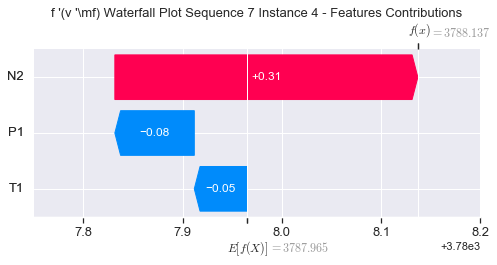

None

Contribution: [-0.06134675 -0.07538798  0.24029664]


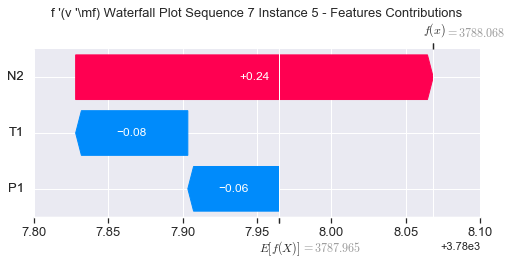

None

Contribution: [-0.0489189   0.2903237   0.21301508]


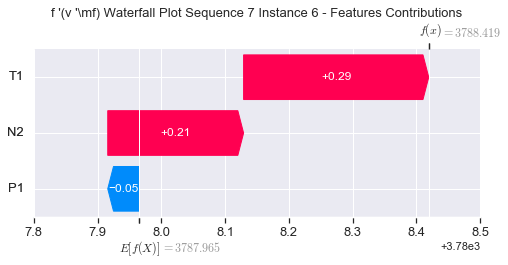

None

Contribution: [-0.05908819  0.34359129  0.23265917]


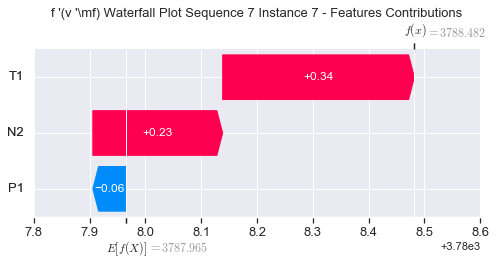

None

Contribution: [-0.06316792  0.36131899  0.23613457]


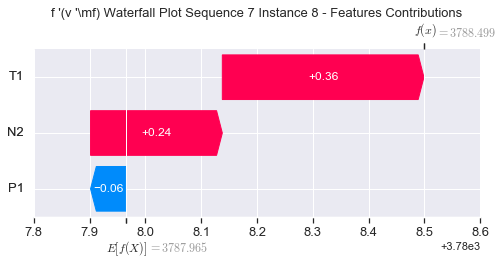

None

Contribution: [-0.08085392  0.37204571  0.23179407]


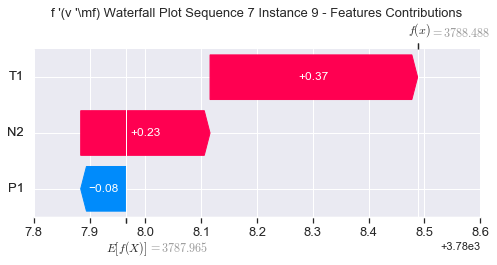

None

Contribution: [-0.09527509  0.38325662  0.2183476 ]


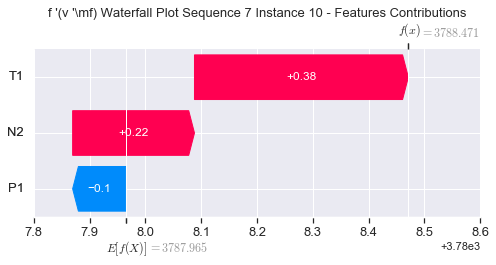

None

Contribution: [-0.09786429  0.40705778  0.2167838 ]


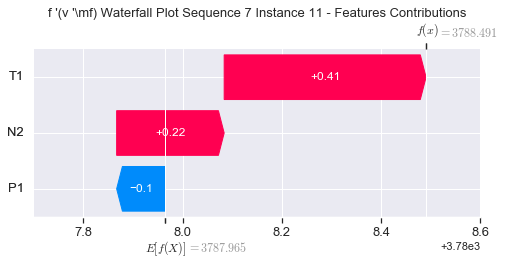

None

Contribution: [-0.10140732  0.37334738  0.20844304]


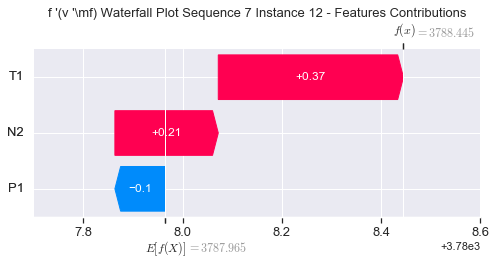

None

Contribution: [-0.10157044  0.35904054  0.20043577]


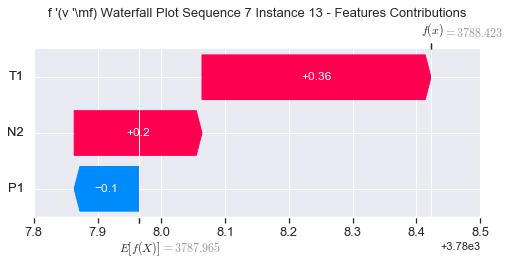

None

Contribution: [-0.09889973  0.26418429  0.19055006]


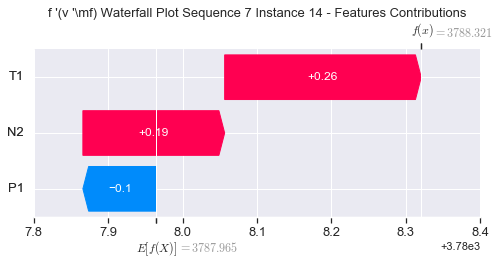

None

Contribution: [-0.08601864  0.2427143   0.18166179]


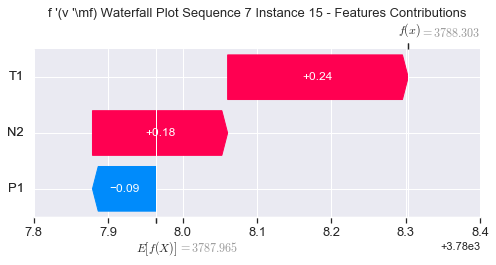

None

Contribution: [-0.0867057   0.54230279  0.16957664]


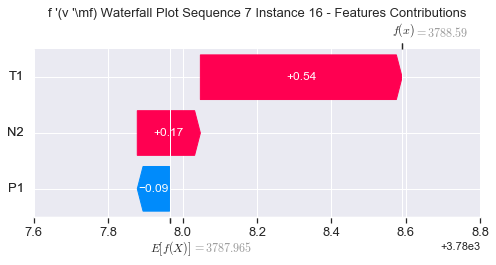

None

Contribution: [-0.17027636  1.04776331  0.17162017]


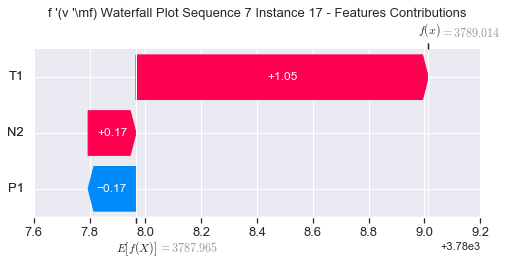

None

Contribution: [-0.1442203   0.27496179  0.14707477]


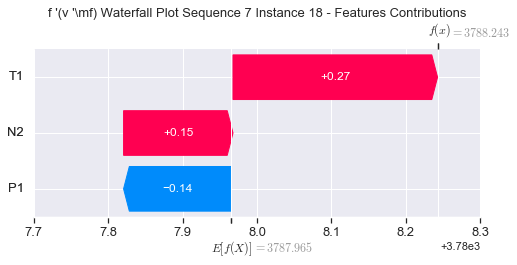

None

Contribution: [ 0.11084308 -2.69464338  0.17111829]


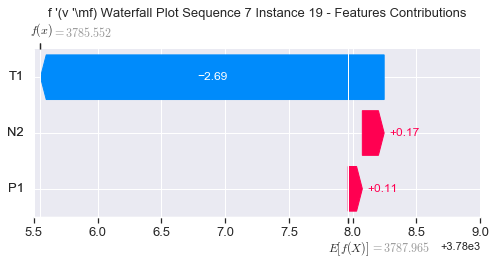

None

Contribution: [ 0.30362067 -1.75617037  0.12084905]


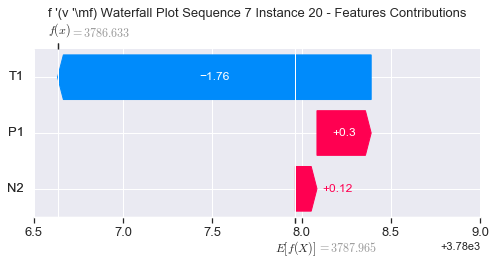

None

Contribution: [-0.75357498 11.19432387 -0.36161094]


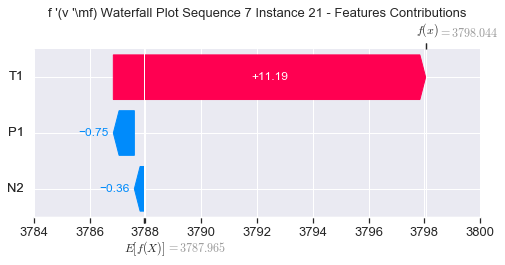

None

Contribution: [-2.14786142 19.77453499 -0.67152706]


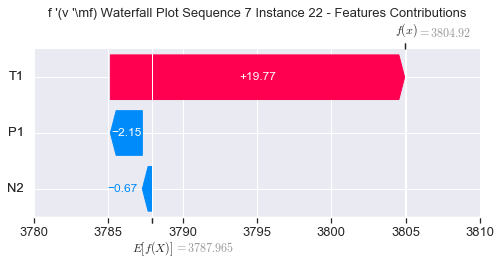

None

Contribution: [  0.66311699 -22.8446666    4.1281402 ]


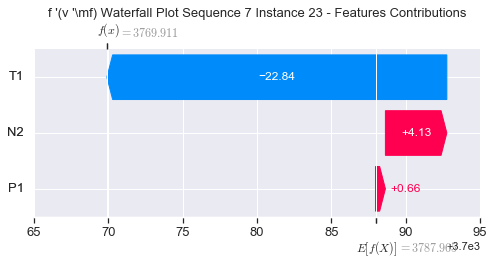

None

Contribution: [  6.55460679 -93.37351191  14.54192223]


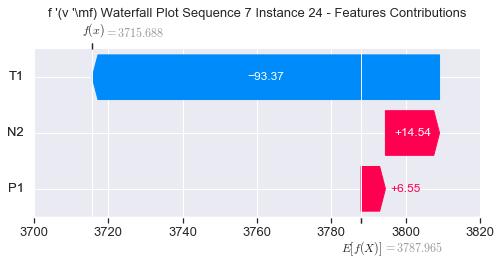

None

Contribution: [-10.9220565  -33.05269679  35.19381112]


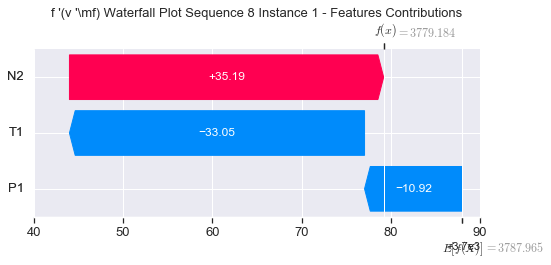

None

Contribution: [-0.19841561 -2.8348074   0.29928815]


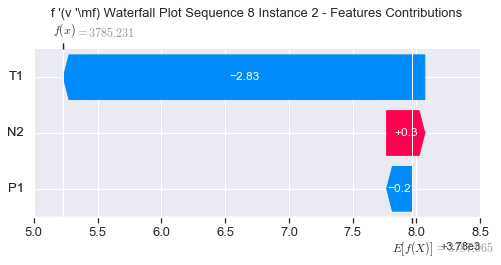

None

Contribution: [-0.04636165 -0.12037856  0.14039706]


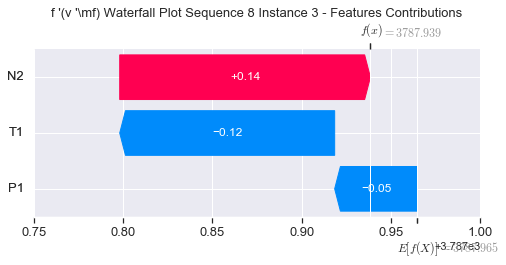

None

Contribution: [-0.0740662  -0.06125838  0.30171148]


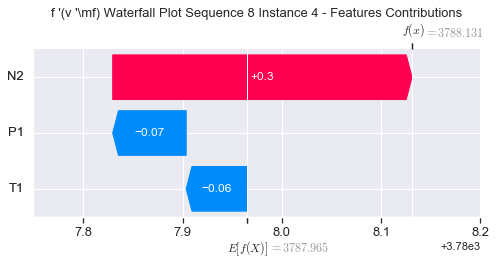

None

Contribution: [-0.0365022  -0.08339926  0.23281315]


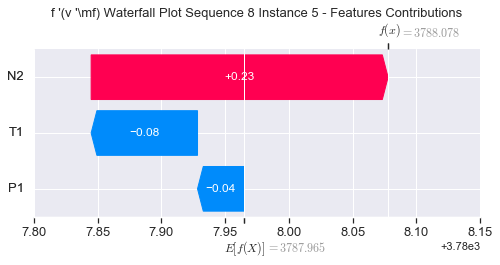

None

Contribution: [-0.05288585  0.27177868  0.20732328]


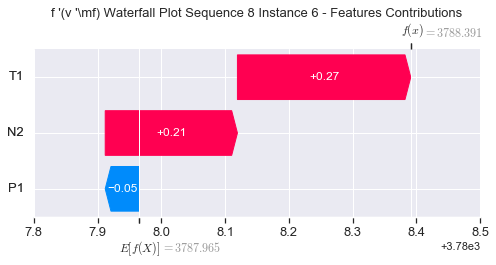

None

Contribution: [-0.06639782  0.32208943  0.22646697]


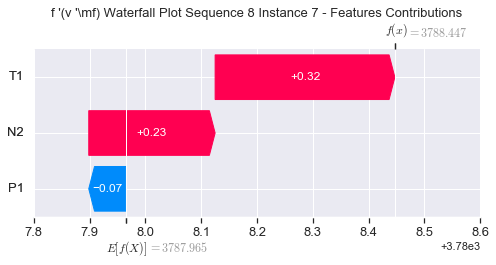

None

Contribution: [-0.07332363  0.32974317  0.23021859]


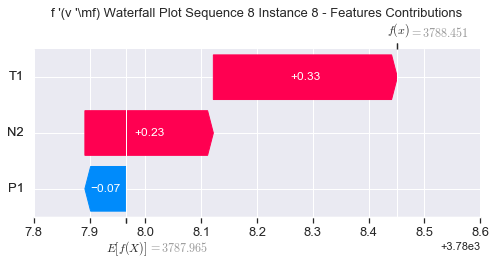

None

Contribution: [-0.10628223  0.38296616  0.21943372]


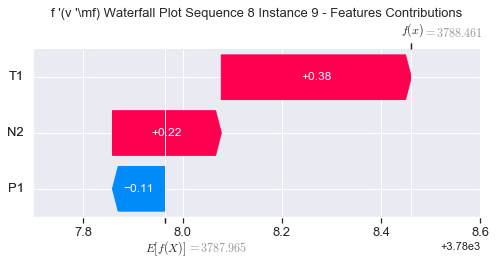

None

Contribution: [-0.18966629  0.43444675  0.2082506 ]


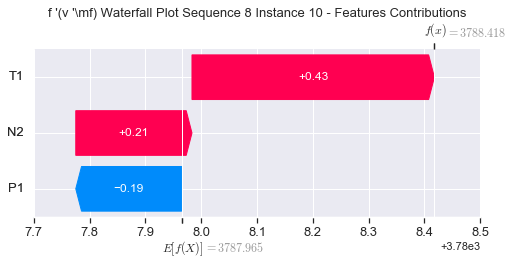

None

Contribution: [-0.09483765  0.33484438  0.20152678]


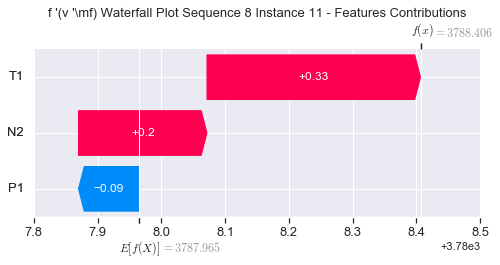

None

Contribution: [-0.0722456   0.27713412  0.20137493]


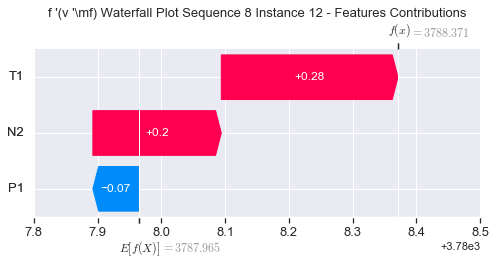

None

Contribution: [-0.0818379   0.28103006  0.19404564]


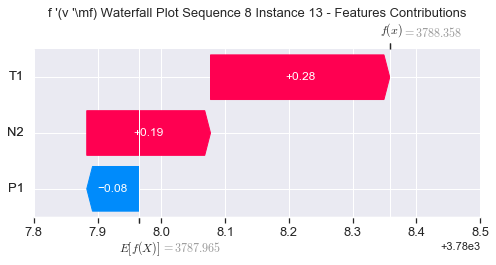

None

Contribution: [-0.07173928  0.22994123  0.18377024]


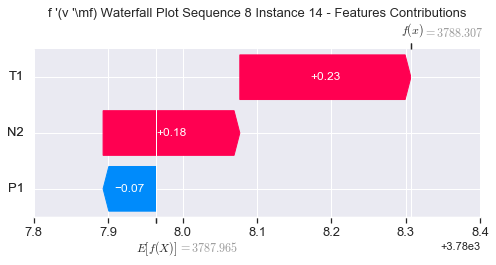

None

Contribution: [-0.05840283  0.19412866  0.17725678]


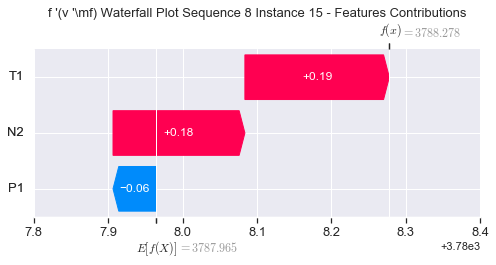

None

Contribution: [-0.08163551  0.42677573  0.15958317]


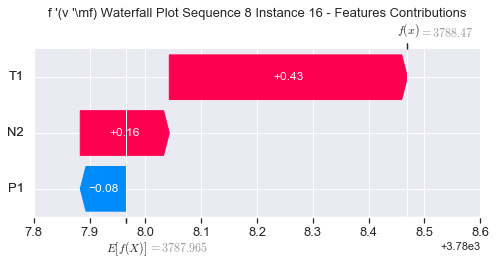

None

Contribution: [-0.09508183  0.76422404  0.14839049]


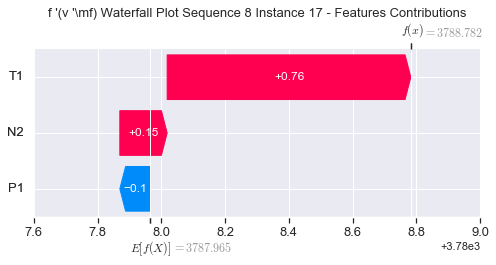

None

Contribution: [-0.06624496  0.15295984  0.14633456]


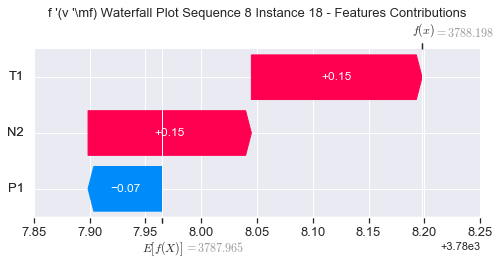

None

Contribution: [ 0.09038248 -2.06050818  0.19229702]


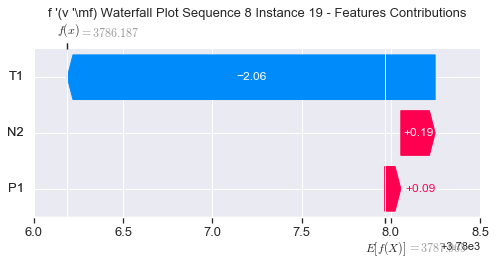

None

Contribution: [ 0.19058317 -1.1744907   0.13719756]


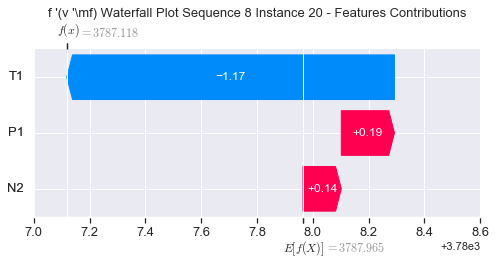

None

Contribution: [-0.47044862  8.06979782 -0.51588795]


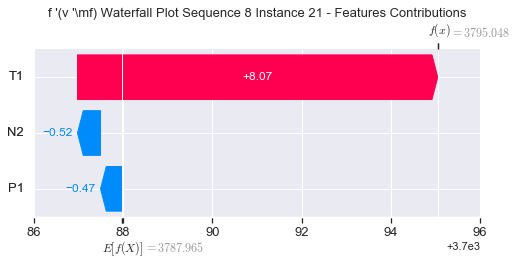

None

Contribution: [-1.31357968 13.37797474 -0.86535154]


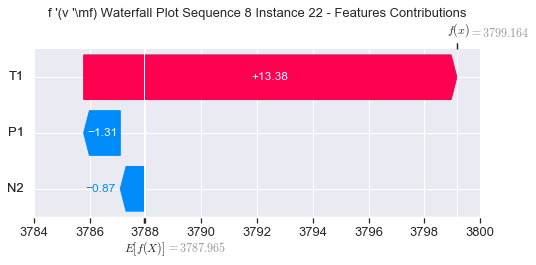

None

Contribution: [  0.20798791 -13.70803315   4.69402426]


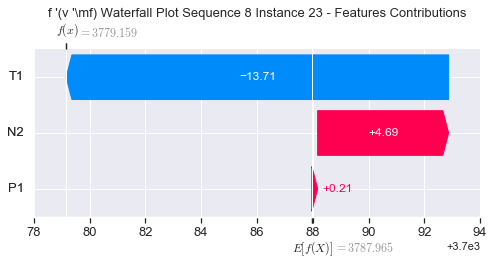

None

Contribution: [  2.60806368 -58.53642964  15.22453572]


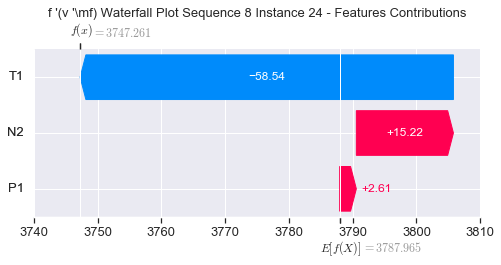

None

Contribution: [ -3.40027928 -13.71847235  35.62958348]


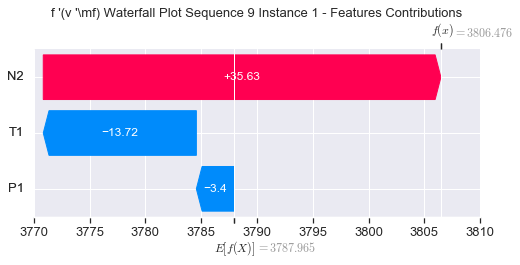

None

Contribution: [-0.10892192 -1.46677156  0.31426055]


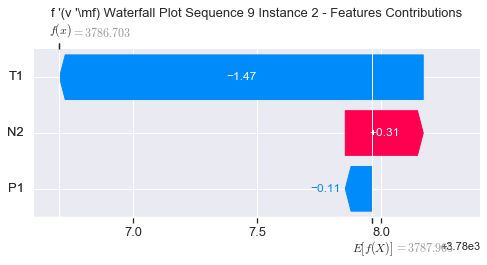

None

Contribution: [-0.0450417  -0.06032204  0.14150273]


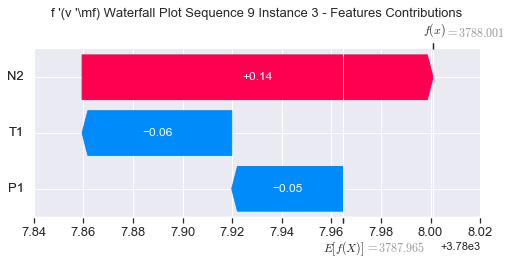

None

Contribution: [-0.07478636  0.01658664  0.30202093]


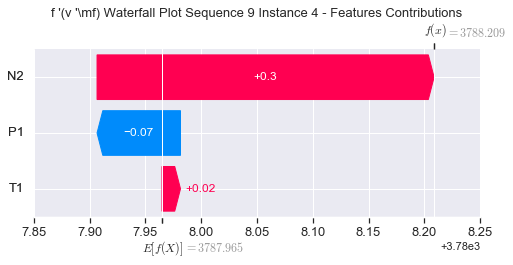

None

Contribution: [-0.05878161 -0.01959626  0.23704994]


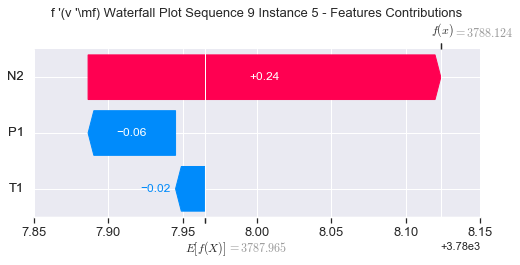

None

Contribution: [-0.04806044  0.22438839  0.20741834]


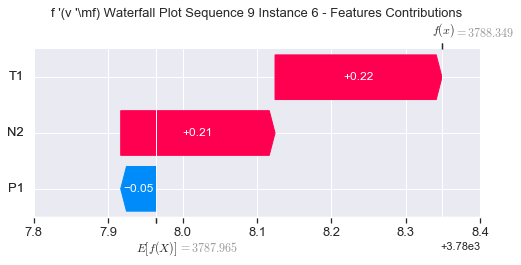

None

Contribution: [-0.05422662  0.26333711  0.22680206]


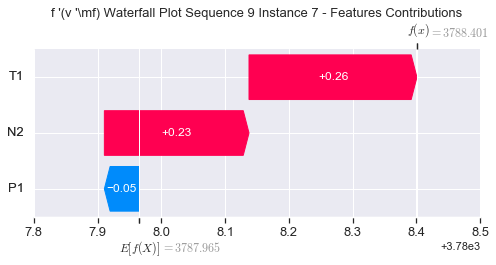

None

Contribution: [-0.05530932  0.28045206  0.22961429]


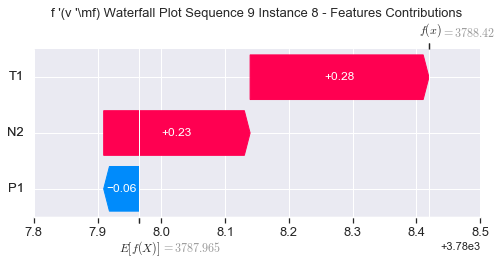

None

Contribution: [-0.05059462  0.28989197  0.22398975]


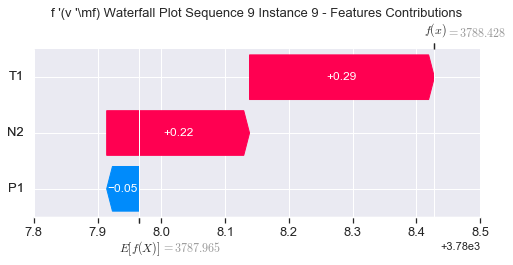

None

Contribution: [-0.09137188  0.30131469  0.21070873]


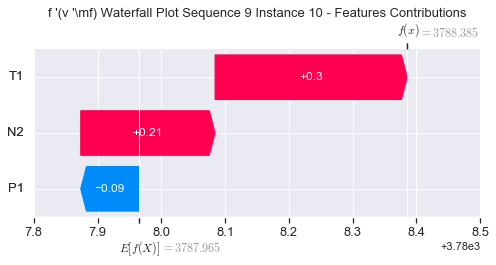

None

Contribution: [-0.06959296  0.29757106  0.20952401]


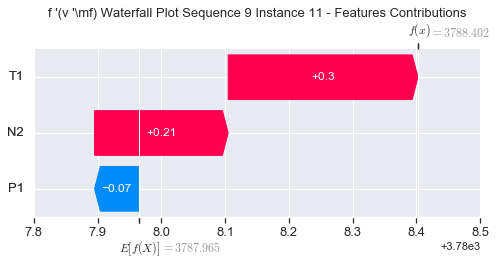

None

Contribution: [-0.07904594  0.29344626  0.20497228]


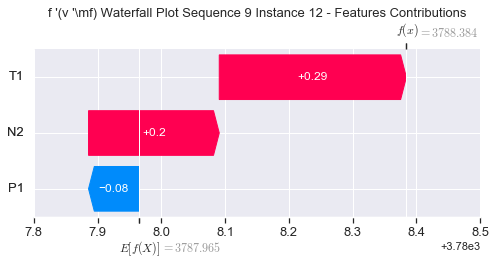

None

Contribution: [-0.07502238  0.28069923  0.19759268]


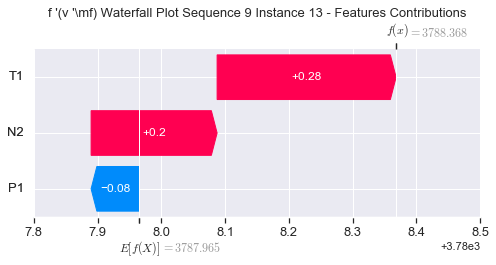

None

Contribution: [-0.04882119  0.22850372  0.18643582]


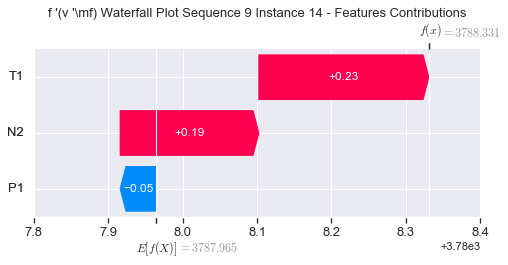

None

Contribution: [-0.0615311   0.19947359  0.1813912 ]


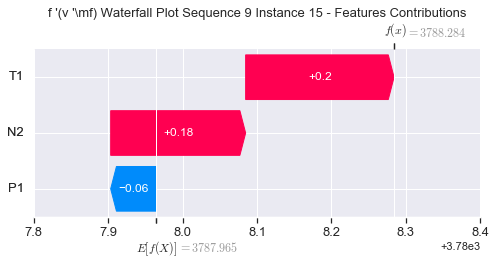

None

Contribution: [-0.07485106  0.51006589  0.16400402]


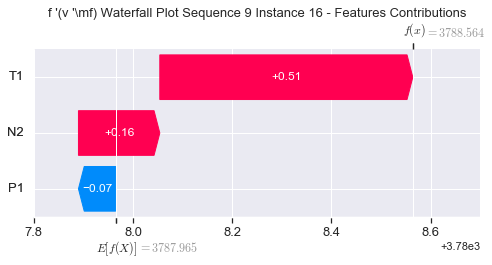

None

Contribution: [-0.09975414  0.85602932  0.16238974]


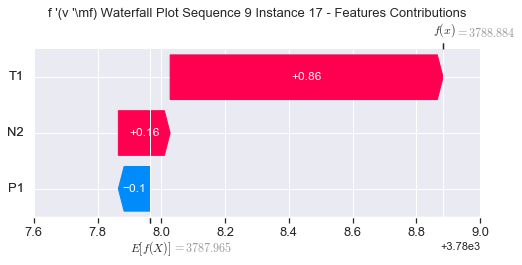

None

Contribution: [-0.07347324  0.10819241  0.15003938]


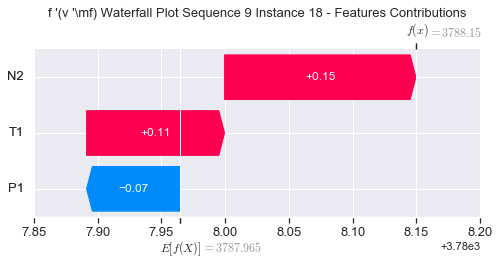

None

Contribution: [ 0.10499907 -2.0832063   0.19952405]


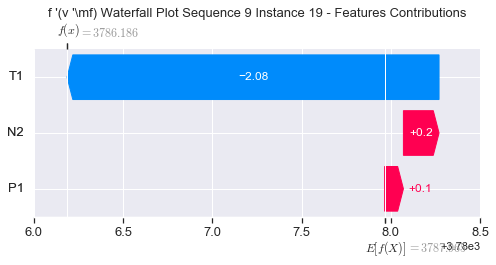

None

Contribution: [ 0.12442704 -1.19872712  0.13612705]


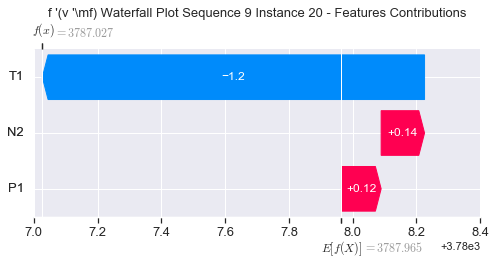

None

Contribution: [-0.28411625  9.4062608  -0.5427844 ]


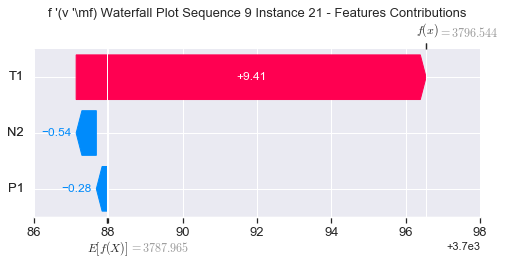

None

Contribution: [-0.72425658 15.8023213  -0.92973761]


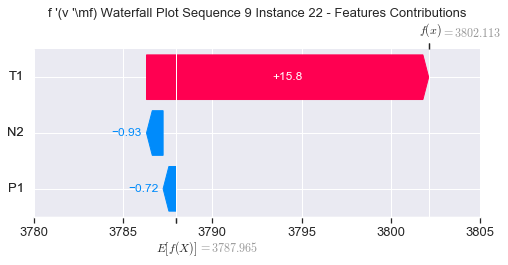

None

Contribution: [  0.15375563 -17.68906089   4.73967844]


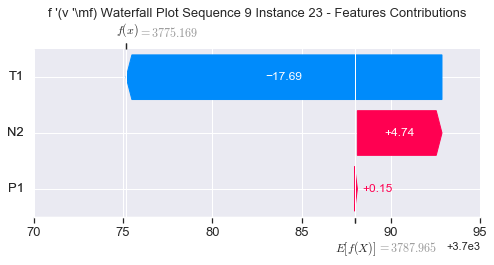

None

Contribution: [  0.27951936 -70.75143232  15.84439547]


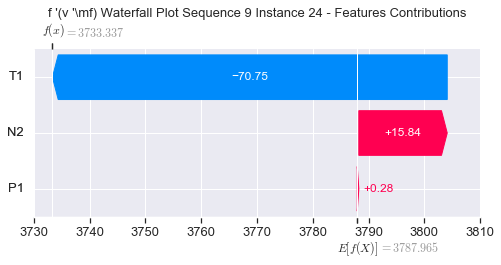

None

Contribution: [  5.54628981 -19.67991454  36.43540823]


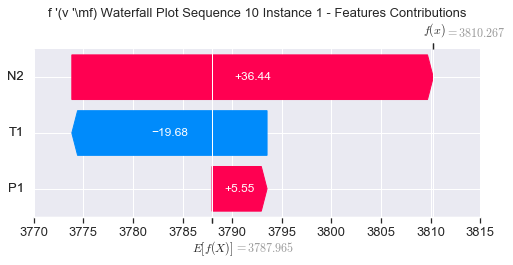

None

Contribution: [-0.02676634 -2.11728645  0.3383941 ]


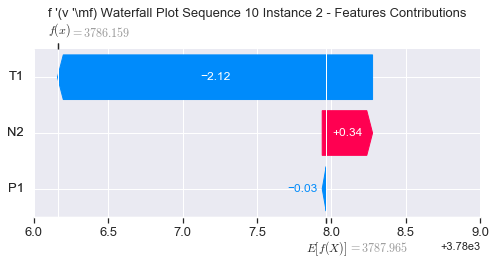

None

Contribution: [-0.04414301 -0.0576335   0.14100516]


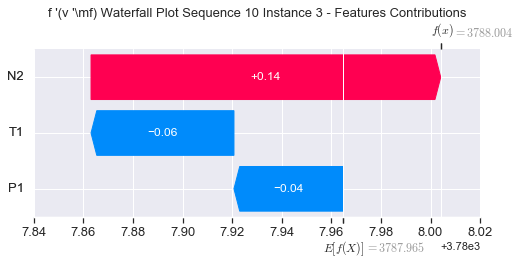

None

Contribution: [-0.08711581 -0.00606888  0.30755541]


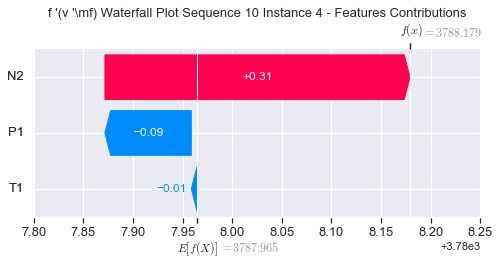

None

Contribution: [-0.07315038 -0.00735603  0.24135884]


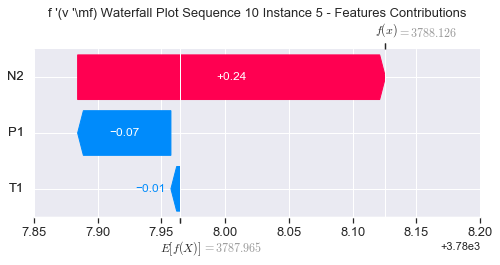

None

Contribution: [-0.03055941  0.24275362  0.20665728]


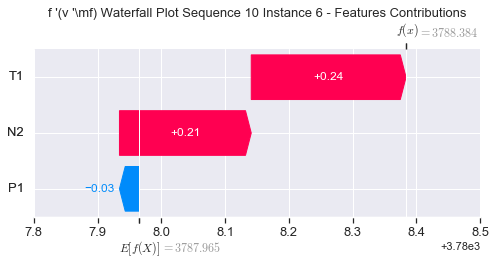

None

Contribution: [-0.02487699  0.3068709   0.22804541]


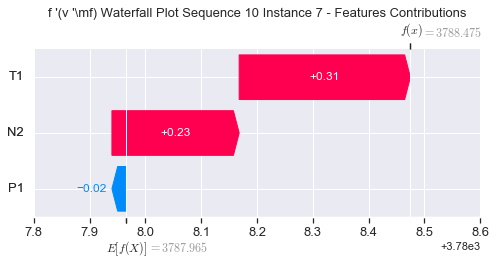

None

Contribution: [-0.01054347  0.30844358  0.23056756]


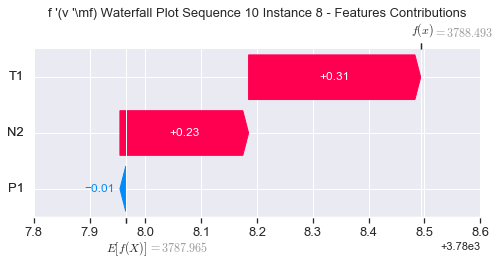

None

Contribution: [0.01618047 0.28705077 0.22557096]


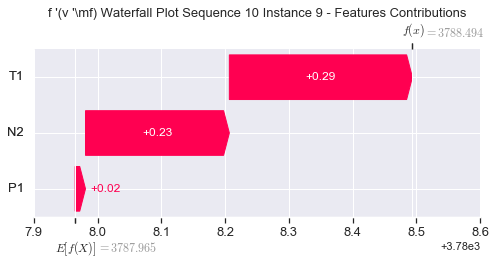

None

Contribution: [-0.00597776  0.27087278  0.21209482]


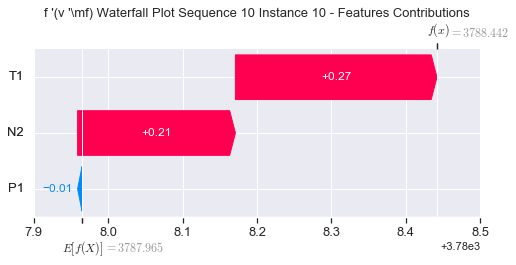

None

Contribution: [0.0760912  0.23191504 0.20651527]


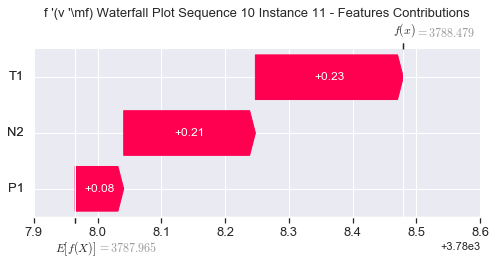

None

Contribution: [-0.00510342  0.32825095  0.20264463]


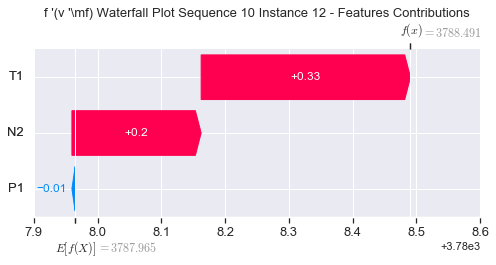

None

Contribution: [-0.01349973  0.32194583  0.19622396]


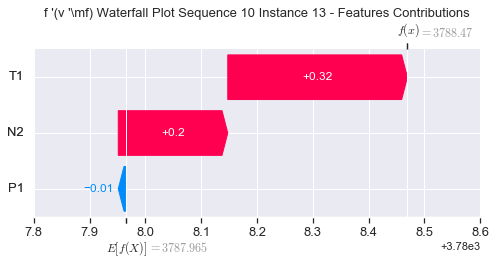

None

Contribution: [-0.00230073  0.19169148  0.1917467 ]


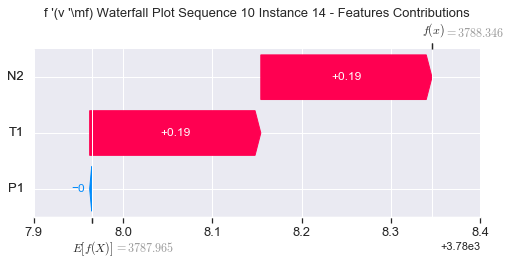

None

Contribution: [-0.00942283  0.21965247  0.18345655]


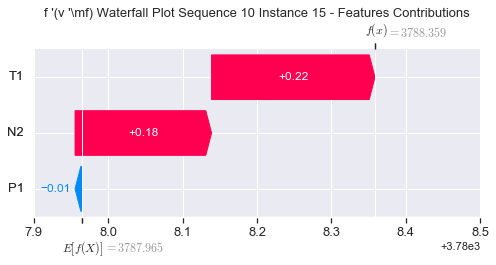

None

Contribution: [-0.08550134  0.81794713  0.16400158]


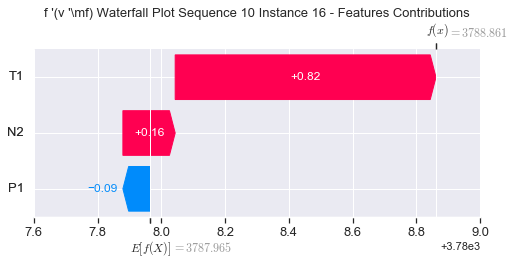

None

Contribution: [-0.0056703   1.1101599   0.15779695]


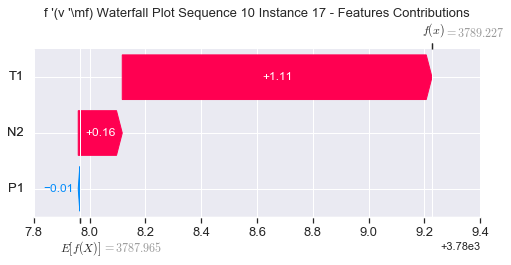

None

Contribution: [0.00555791 0.2095712  0.15683644]


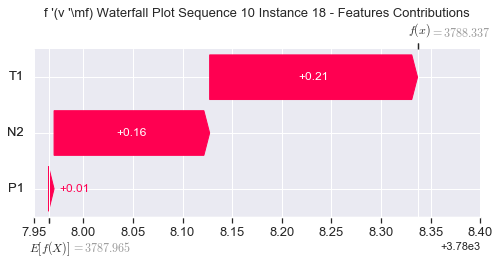

None

Contribution: [ 0.03206722 -3.68106709  0.25962536]


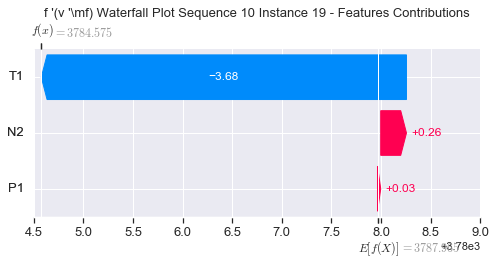

None

Contribution: [-0.00962155 -1.78828842  0.13638056]


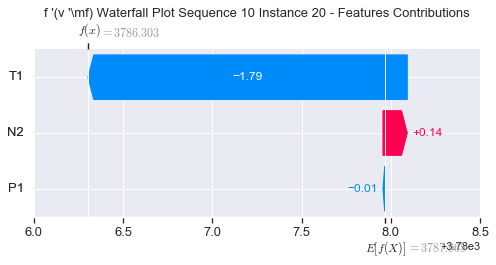

None

Contribution: [ 0.12372073 12.02731749 -0.5148555 ]


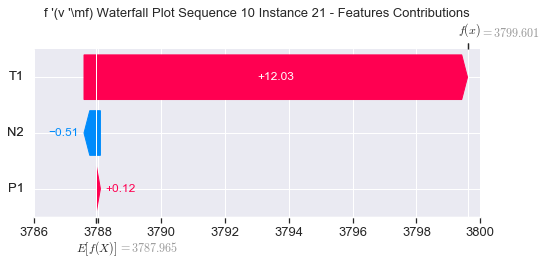

None

Contribution: [ 0.63778153 19.60285109 -0.90041096]


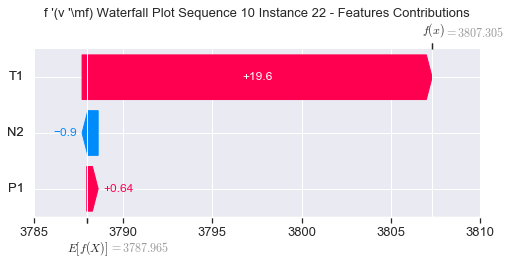

None

Contribution: [ -0.35363147 -23.39707214   4.83744047]


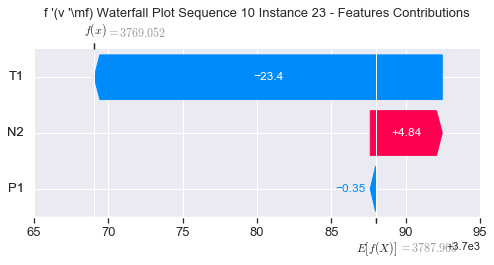

None

Contribution: [ -4.53790309 -87.041727    15.41246343]


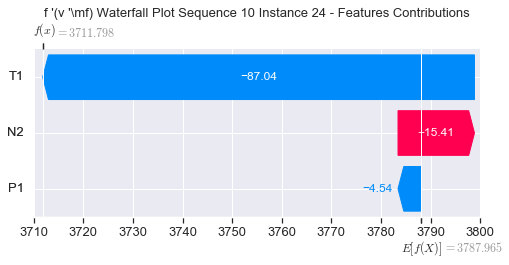

None

Contribution: [  4.95512097 -22.47231093  32.97058728]


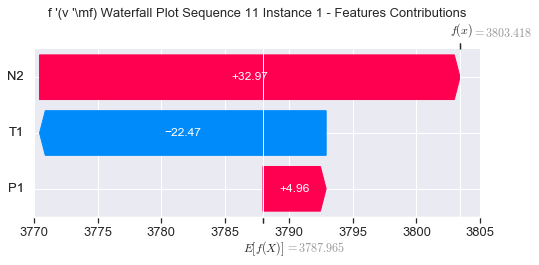

None

Contribution: [ 0.0765928 -2.5071602  0.3268355]


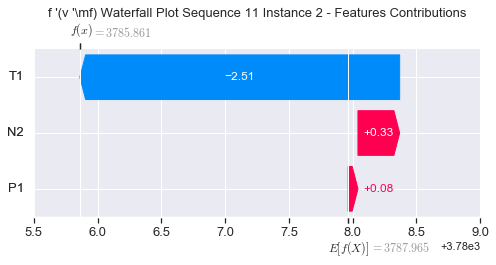

None

Contribution: [-0.03686836 -0.06682103  0.14244993]


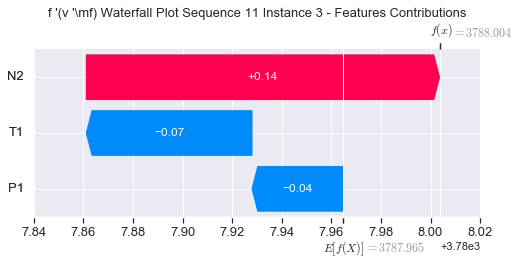

None

Contribution: [-0.10175345  0.01470817  0.30110346]


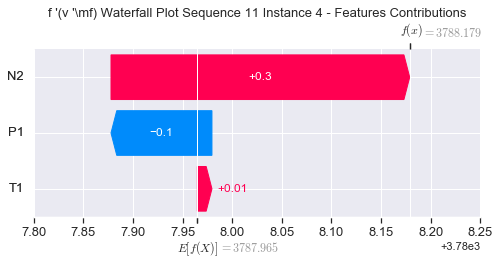

None

Contribution: [-0.08688969 -0.00172165  0.2367385 ]


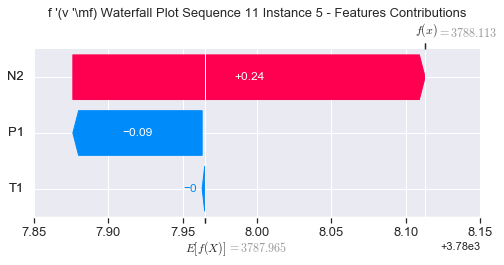

None

Contribution: [-0.01538688  0.18580219  0.19483217]


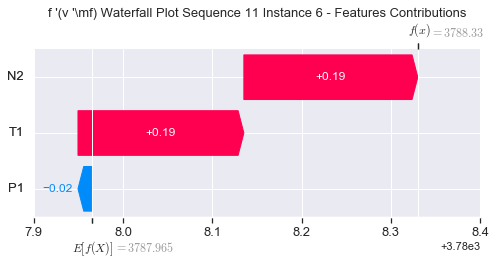

None

Contribution: [0.0033642  0.21206284 0.21668874]


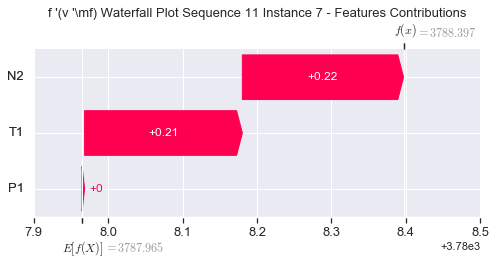

None

Contribution: [0.0158471  0.22186455 0.22070168]


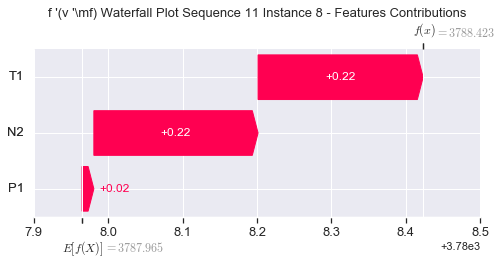

None

Contribution: [-0.01415441  0.23166005  0.21695113]


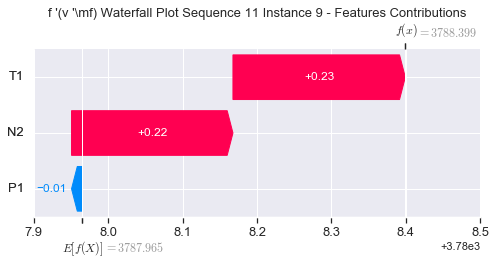

None

Contribution: [-0.04213378  0.24258965  0.20311994]


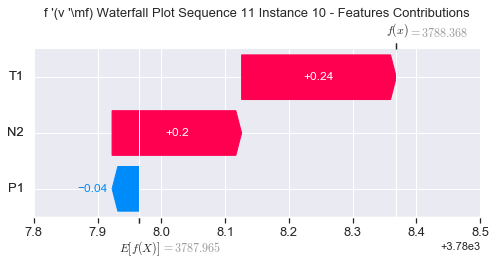

None

Contribution: [0.02577629 0.24709566 0.20021496]


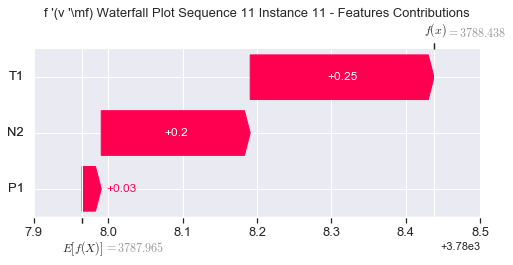

None

Contribution: [0.03971739 0.22538125 0.19806869]


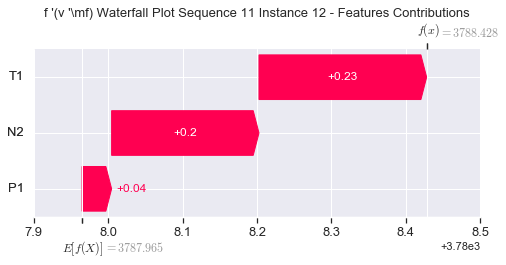

None

Contribution: [0.03165185 0.20729322 0.19213238]


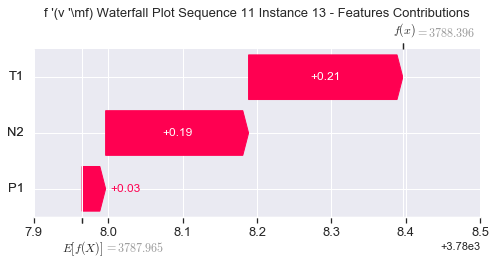

None

Contribution: [0.02901667 0.15543464 0.18364455]


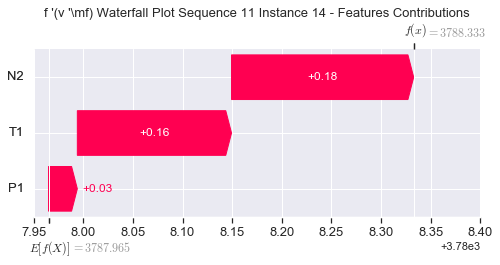

None

Contribution: [0.0273534  0.15068874 0.17669065]


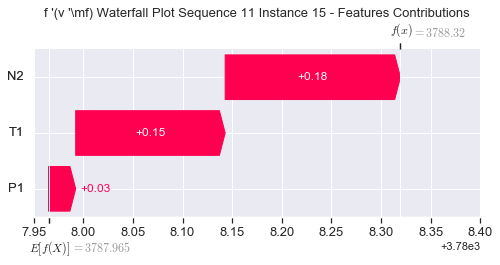

None

Contribution: [0.10249296 0.35989813 0.160356  ]


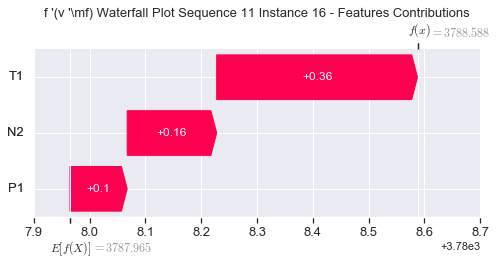

None

Contribution: [0.06114187 0.53304473 0.15560046]


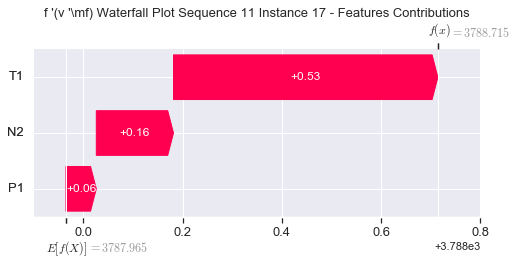

None

Contribution: [0.05583345 0.04625564 0.14590404]


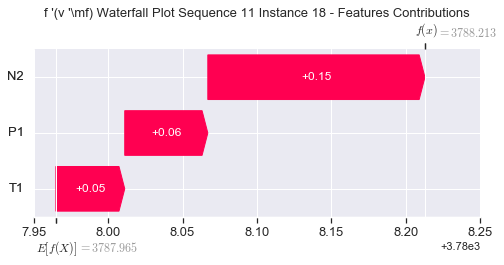

None

Contribution: [-0.12445909 -1.26240519  0.20731277]


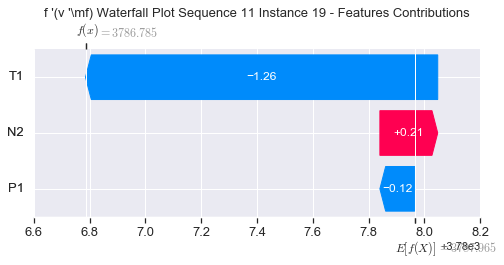

None

Contribution: [-0.10795217 -0.59413945  0.1322759 ]


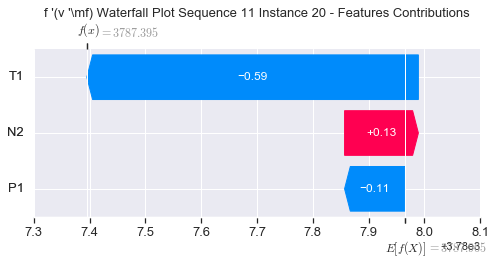

None

Contribution: [ 0.39490268  5.38911892 -0.43917066]


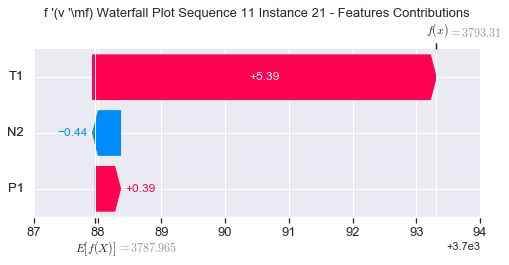

None

Contribution: [ 1.33772768  8.79990575 -0.79283924]


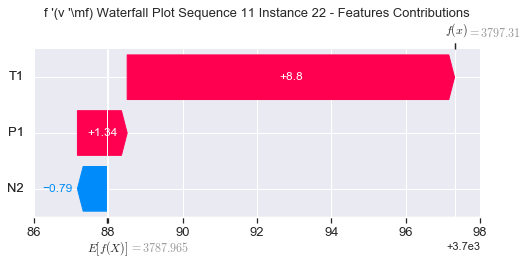

None

Contribution: [-0.54938425 -8.91521035  4.36036967]


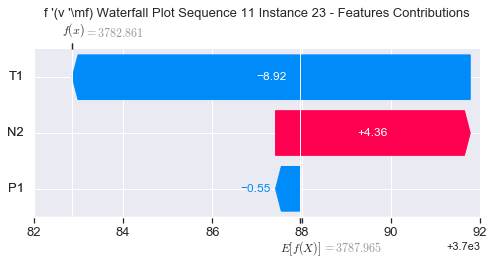

None

Contribution: [ -8.50482527 -34.41226304  14.8358795 ]


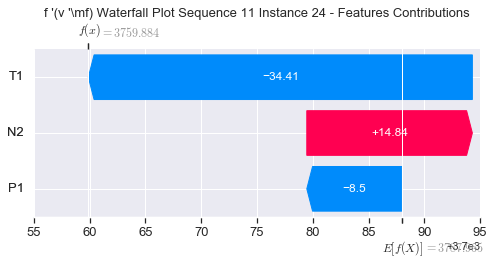

None

Contribution: [20.45729782  1.83156831 34.99618772]


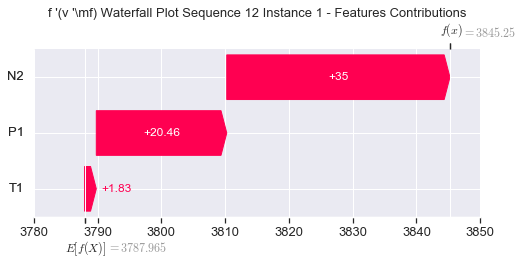

None

Contribution: [ 0.13224181 -0.83062532  0.29827576]


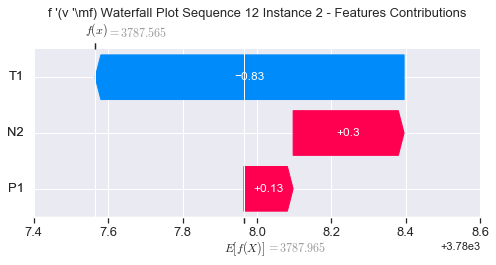

None

Contribution: [-0.03728111  0.01760522  0.13889983]


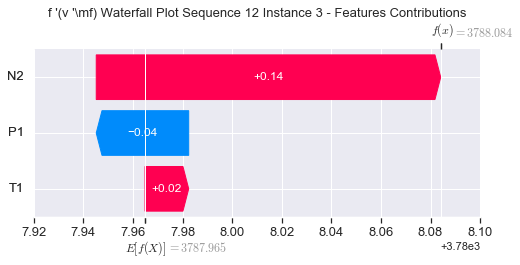

None

Contribution: [-0.10049311  0.04858712  0.308398  ]


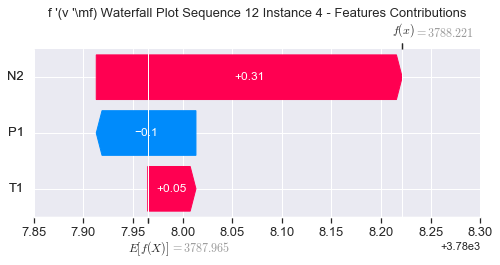

None

Contribution: [-0.08651624  0.02153783  0.2399897 ]


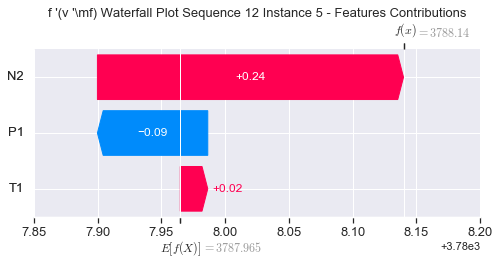

None

Contribution: [-0.01864739  0.18363824  0.20157135]


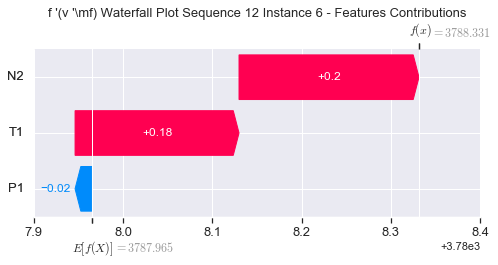

None

Contribution: [0.00263101 0.21504878 0.22050704]


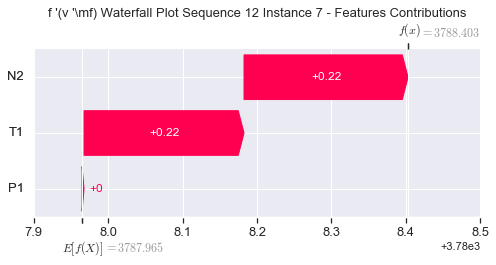

None

Contribution: [0.01175294 0.22833292 0.22354602]


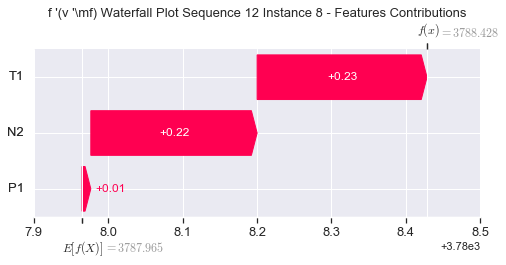

None

Contribution: [0.0058383  0.25980761 0.21916838]


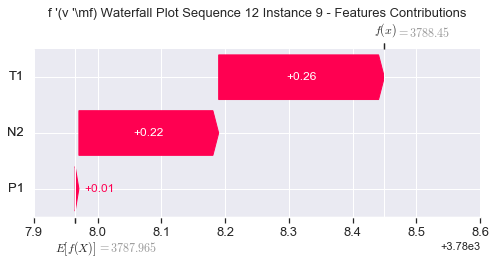

None

Contribution: [0.02040194 0.26105587 0.20336866]


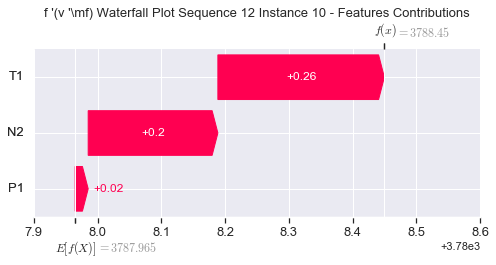

None

Contribution: [0.00230048 0.24239718 0.20833451]


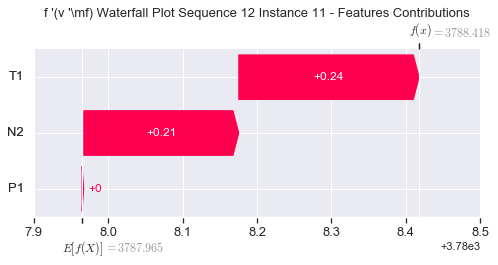

None

Contribution: [0.01055152 0.24221797 0.20435491]


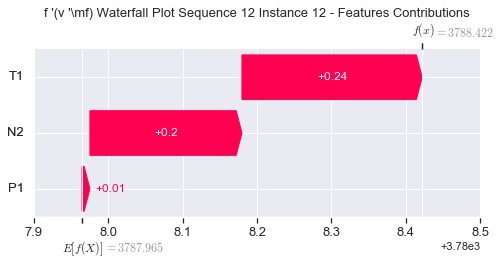

None

Contribution: [0.01419219 0.2313397  0.1964967 ]


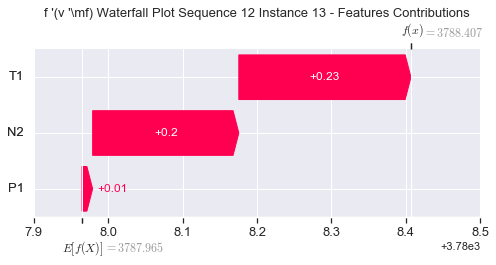

None

Contribution: [0.02631172 0.1976336  0.18670512]


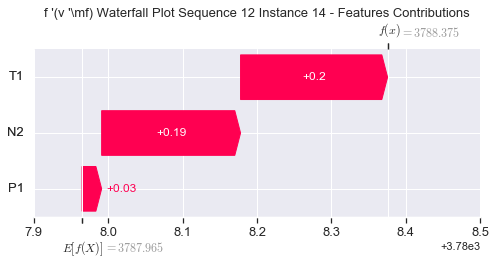

None

Contribution: [0.01290365 0.17111181 0.18149119]


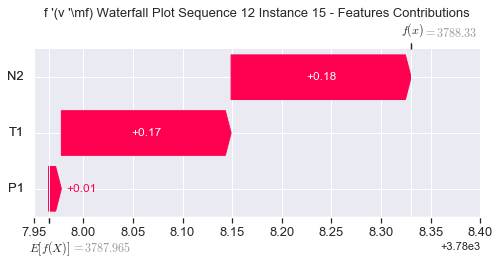

None

Contribution: [0.02232214 0.44466141 0.1632999 ]


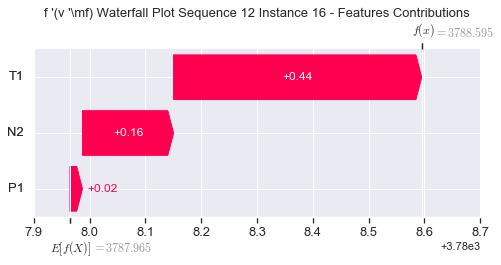

None

Contribution: [0.05468364 0.70776032 0.15652813]


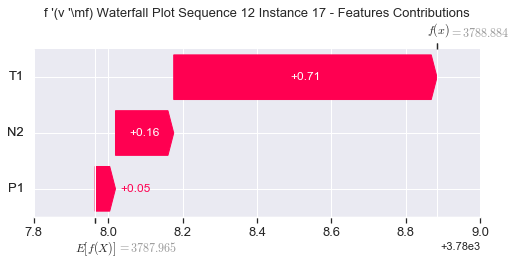

None

Contribution: [0.04347215 0.02677306 0.156245  ]


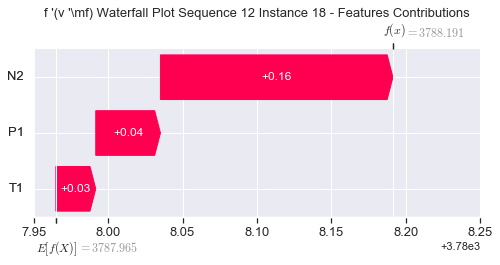

None

Contribution: [-0.01675552 -1.97016826  0.20583122]


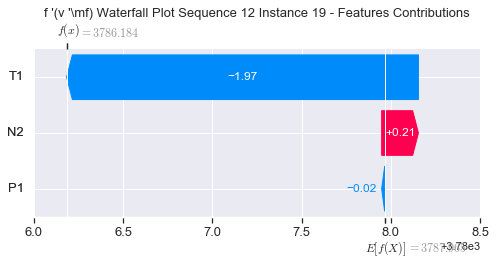

None

Contribution: [-0.12885958 -0.83692039  0.15205202]


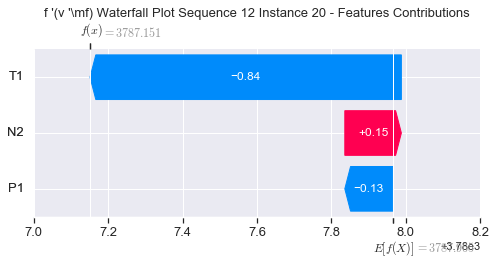

None

Contribution: [ 0.43043002  7.39185799 -0.66718012]


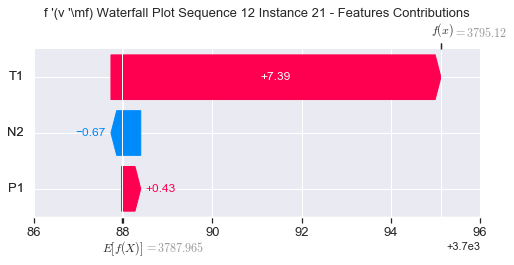

None

Contribution: [ 1.18736678 11.81162372 -1.05478998]


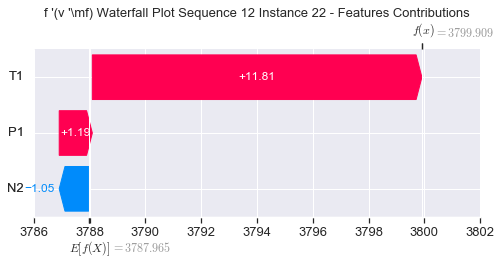

None

Contribution: [ -0.40586353 -12.50485349   5.02024707]


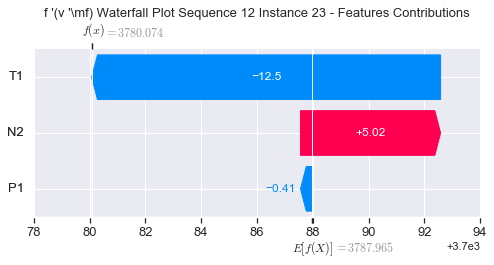

None

Contribution: [ -6.82674687 -44.52352548  17.0246615 ]


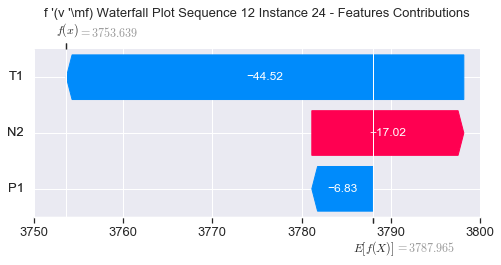

None

Contribution: [15.15417886 -0.54409972 40.22738028]


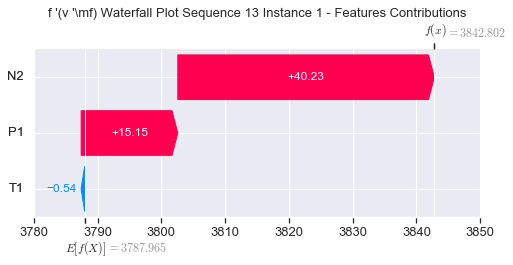

None

Contribution: [ 0.09627541 -1.26755588  0.32134831]


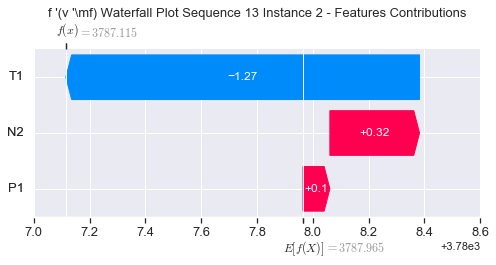

None

Contribution: [-0.04295495  0.00692668  0.140787  ]


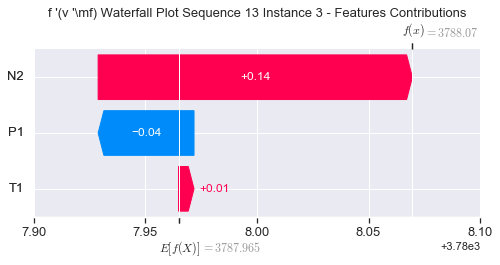

None

Contribution: [-0.08986368  0.04538409  0.30819276]


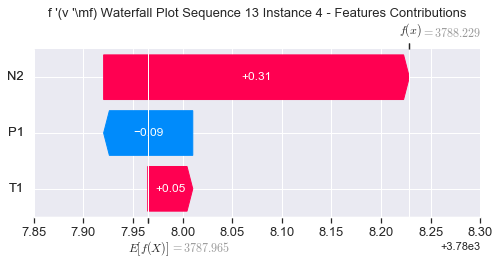

None

Contribution: [-0.07716514  0.00418643  0.23864658]


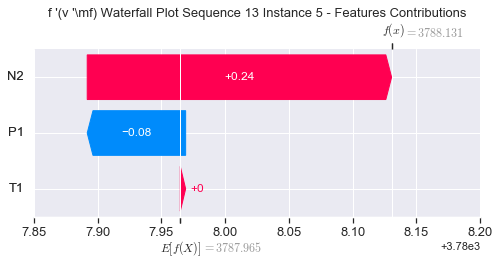

None

Contribution: [-0.02799255  0.19485366  0.198898  ]


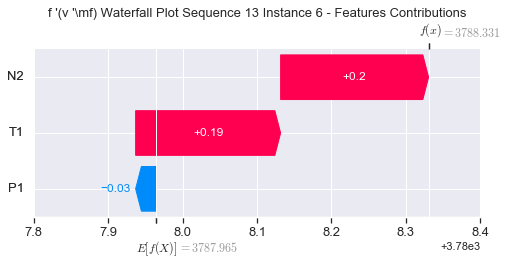

None

Contribution: [-0.0158084   0.22157723  0.21794411]


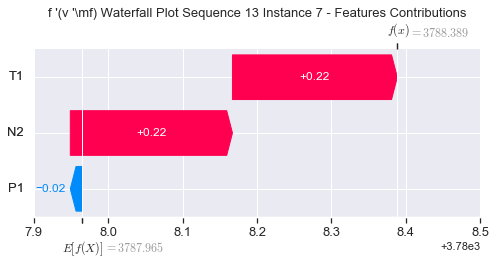

None

Contribution: [-0.00998833  0.23222015  0.22076741]


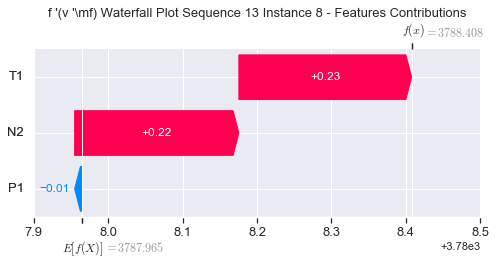

None

Contribution: [-0.00643375  0.2593169   0.21309913]


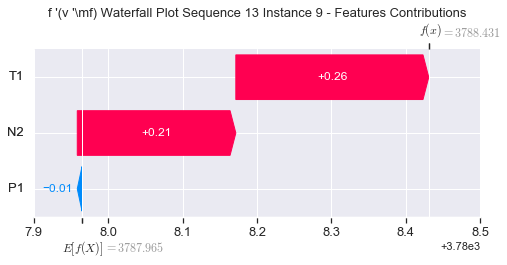

None

Contribution: [-0.04257268  0.35198777  0.20166328]


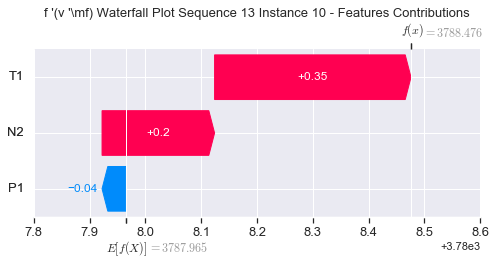

None

Contribution: [-0.0088006   0.23507834  0.20114581]


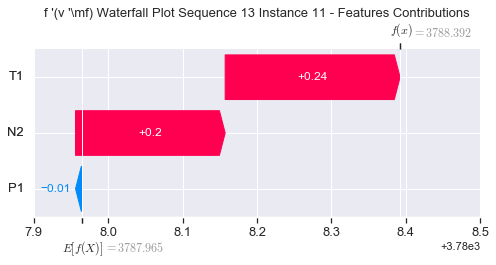

None

Contribution: [-0.01267668  0.20158546  0.20053021]


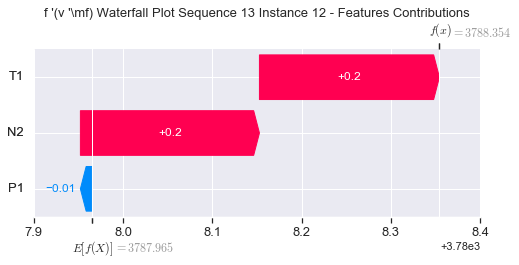

None

Contribution: [-0.01254643  0.19453785  0.19214434]


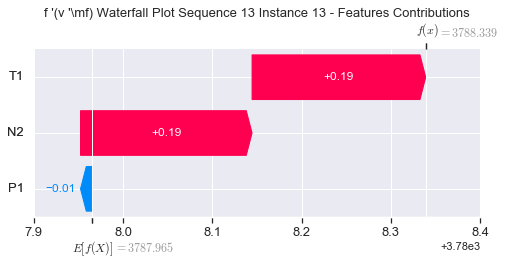

None

Contribution: [-0.00192921  0.13800354  0.18384152]


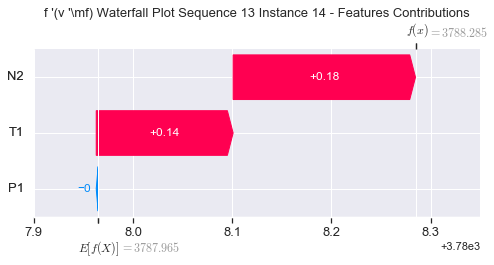

None

Contribution: [-0.0146142   0.14563594  0.1777517 ]


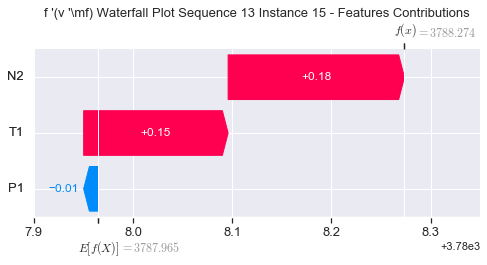

None

Contribution: [-0.0364785   0.34282947  0.16038355]


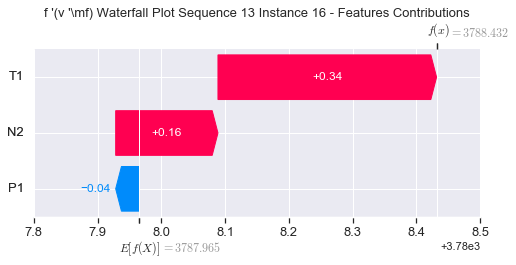

None

Contribution: [-0.01199291  0.54787145  0.14988416]


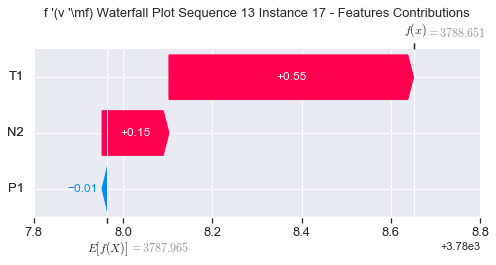

None

Contribution: [-0.00902737  0.00846003  0.15415768]


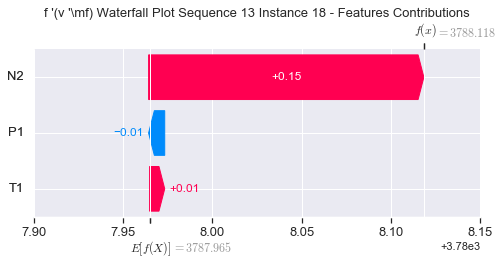

None

Contribution: [ 0.07562427 -1.55808356  0.22605196]


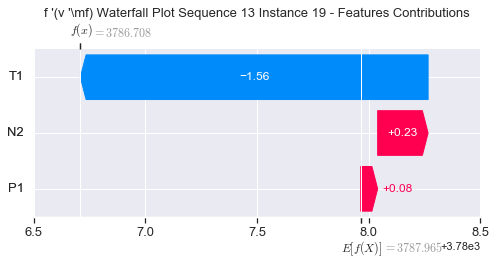

None

Contribution: [ 0.01262195 -0.62128233  0.15150719]


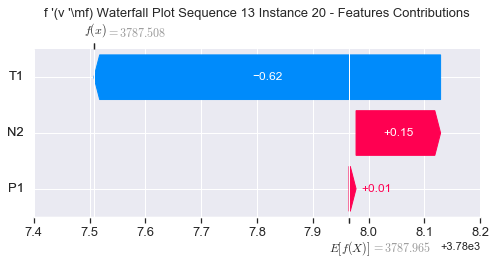

None

Contribution: [ 0.02634501  5.66661737 -0.69026316]


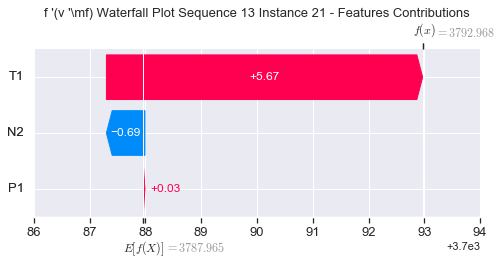

None

Contribution: [ 0.1054685   8.76201655 -1.13327044]


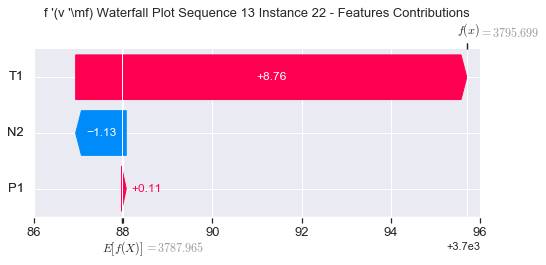

None

Contribution: [-0.08173509 -8.57430499  5.05706552]


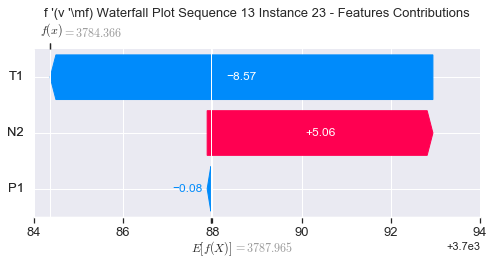

None

Contribution: [ -2.48919034 -31.69199552  16.71612548]


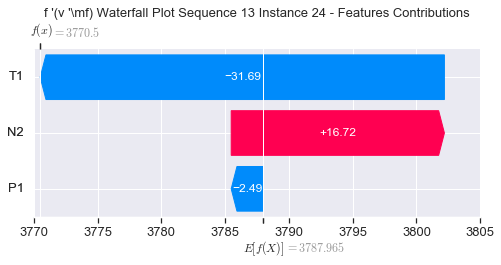

None

Contribution: [10.54026044  6.11814993 39.22743667]


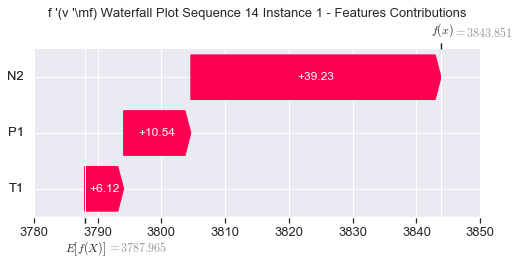

None

Contribution: [ 0.02868172 -0.60345379  0.34790231]


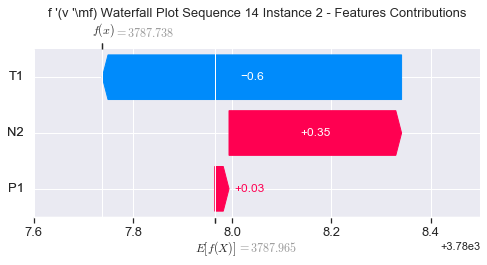

None

Contribution: [-0.04636299  0.05996542  0.14544986]


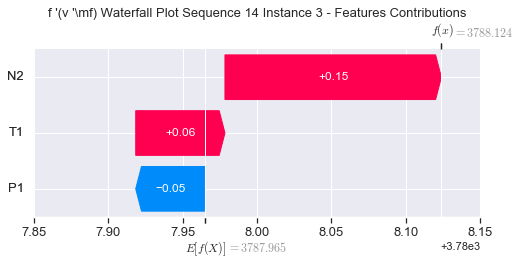

None

Contribution: [-0.09658697  0.07494322  0.31037676]


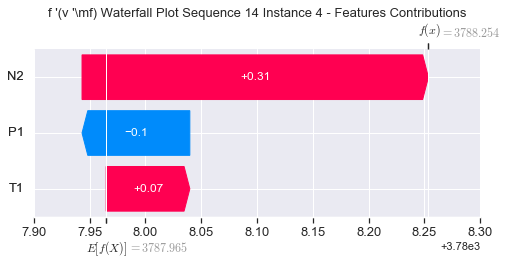

None

Contribution: [-0.07978221  0.04913786  0.23714675]


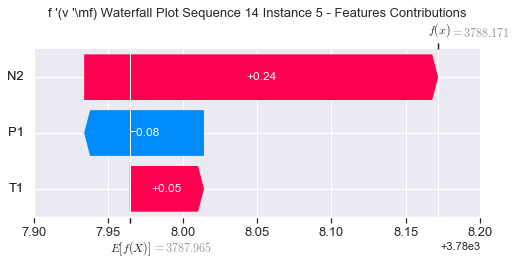

None

Contribution: [-0.02678993  0.14179174  0.19843633]


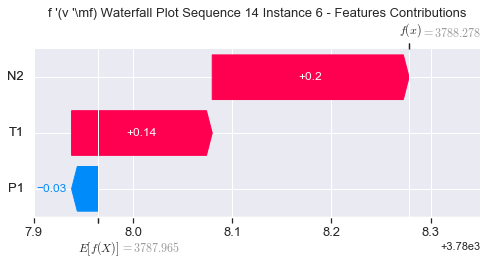

None

Contribution: [-0.01273727  0.16008174  0.21624004]


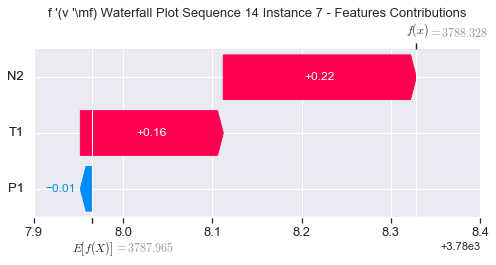

None

Contribution: [-0.00745795  0.16997922  0.2186681 ]


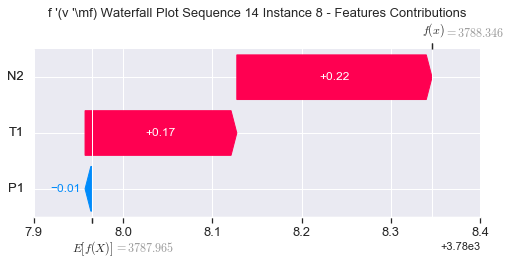

None

Contribution: [-0.00663852  0.15552993  0.21271451]


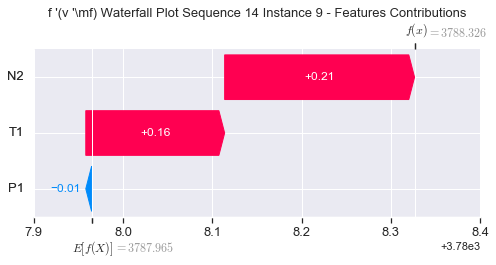

None

Contribution: [-0.02944406  0.1564885   0.20160926]


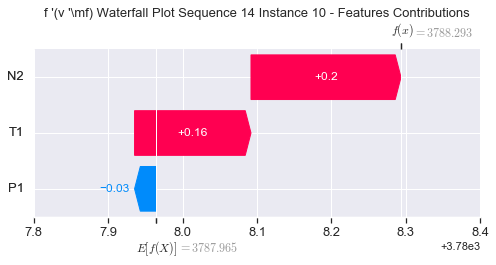

None

Contribution: [-0.02084667  0.15392005  0.20296516]


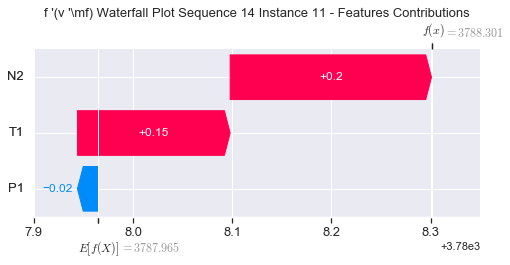

None

Contribution: [-0.01797903  0.18036174  0.20021757]


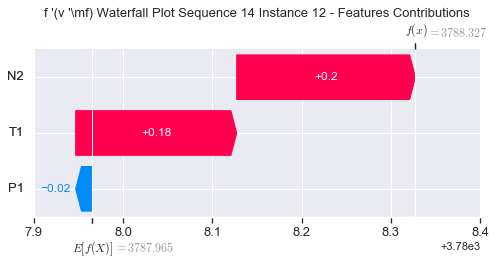

None

Contribution: [-0.01436618  0.16908414  0.19352797]


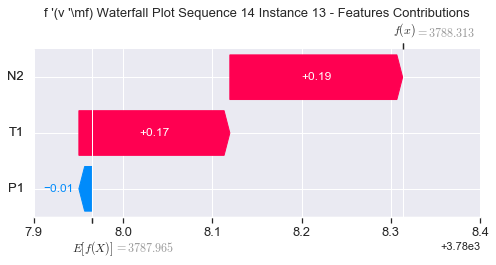

None

Contribution: [-0.01018298  0.13164783  0.18589973]


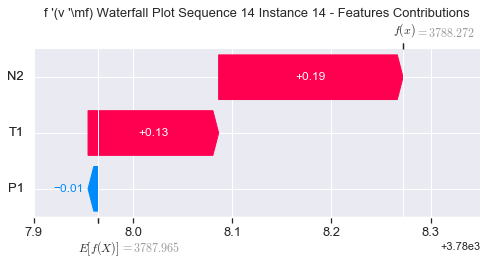

None

Contribution: [-0.01389701  0.13395506  0.17924813]


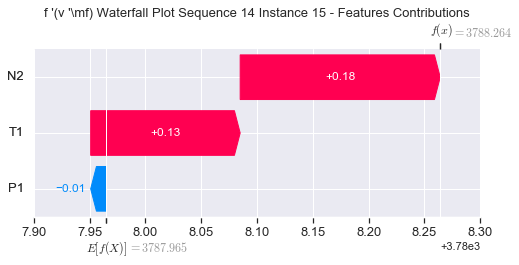

None

Contribution: [-0.03831352  0.36772499  0.16077052]


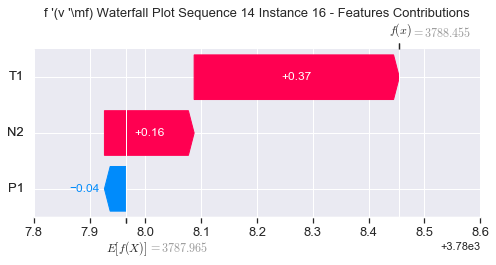

None

Contribution: [-0.01109006  0.52818004  0.15476683]


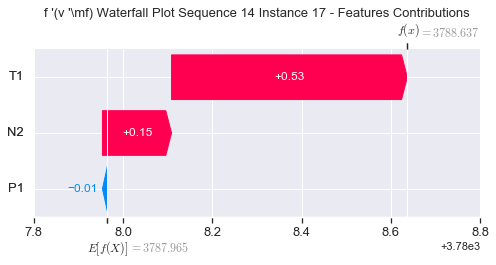

None

Contribution: [-0.00899701  0.00604715  0.15421889]


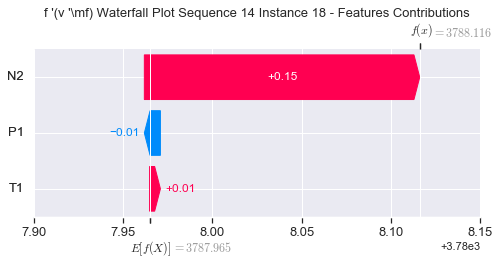

None

Contribution: [ 0.00722157 -1.61731819  0.25138548]


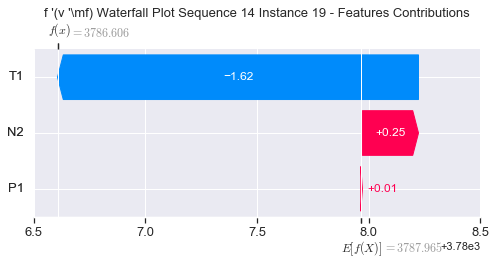

None

Contribution: [-0.0038096  -0.61787394  0.15001172]


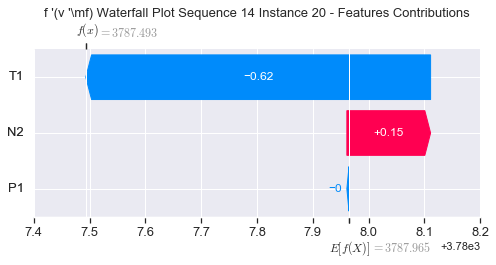

None

Contribution: [ 0.06485042  5.88122743 -0.6613561 ]


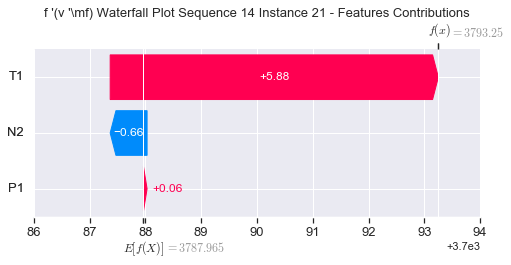

None

Contribution: [ 0.21759052  9.45636207 -1.07015708]


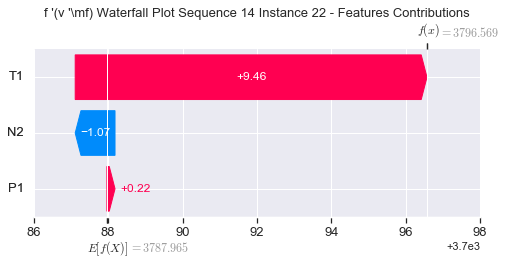

None

Contribution: [-0.09633976 -9.8936667   4.98433957]


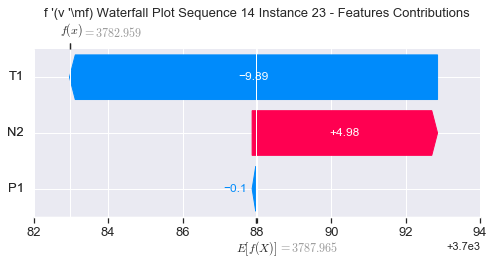

None

Contribution: [ -2.67259668 -36.49637845  16.20287349]


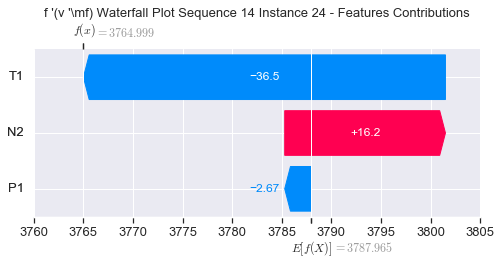

None

Contribution: [ 9.18617514  2.32902523 35.81660907]


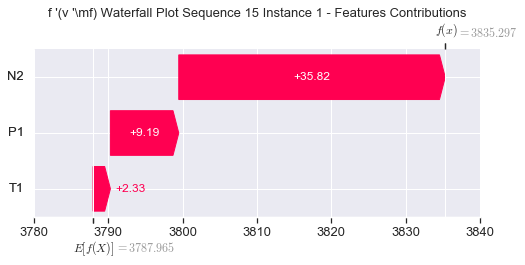

None

Contribution: [ 0.03397903 -0.91433869  0.33361389]


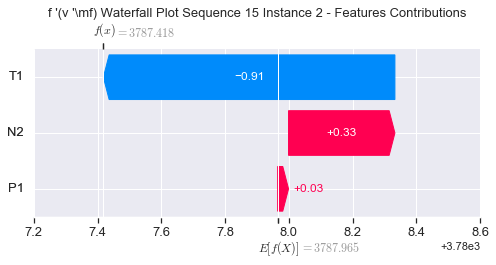

None

Contribution: [-0.04193573  0.02239487  0.14342642]


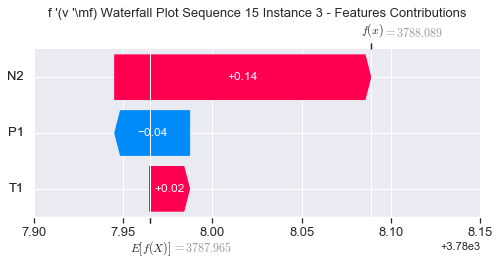

None

Contribution: [-0.08703262  0.04155868  0.30719258]


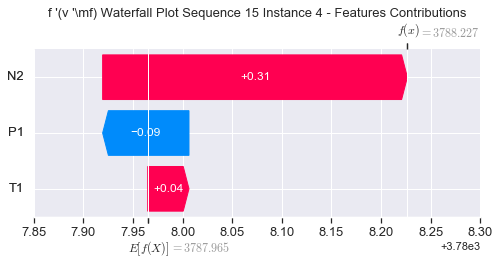

None

Contribution: [-0.07813745  0.02498442  0.23782121]


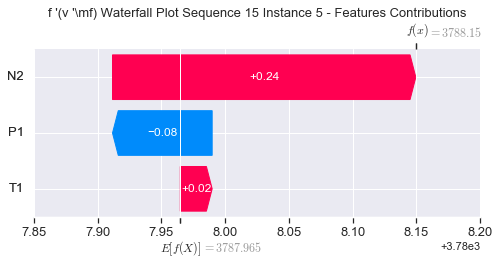

None

Contribution: [-0.0249123   0.1746846   0.19566824]


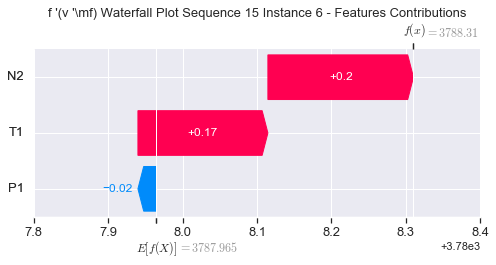

None

Contribution: [-0.01021085  0.19377985  0.21442864]


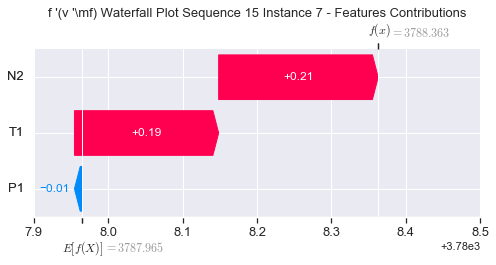

None

Contribution: [-0.00667407  0.2070694   0.21775015]


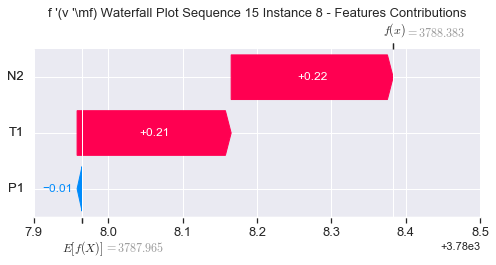

None

Contribution: [-0.02208157  0.20968306  0.21225375]


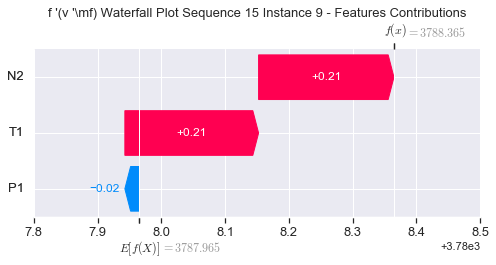

None

Contribution: [-0.0302992   0.21719774  0.19979463]


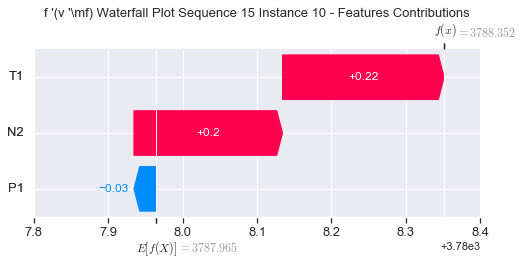

None

Contribution: [-0.0398727   0.21877164  0.20265938]


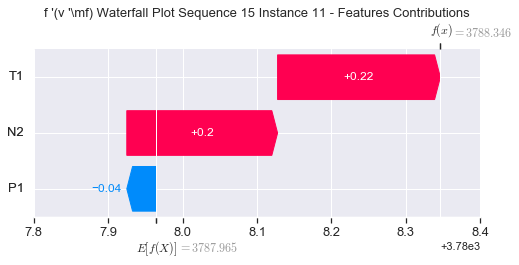

None

Contribution: [-0.01989527  0.18895484  0.20026842]


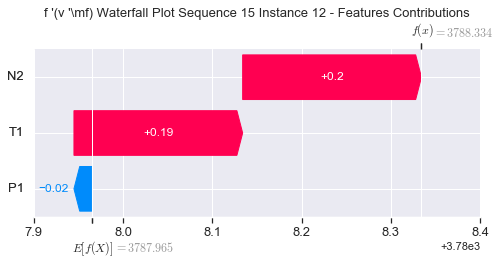

None

Contribution: [-0.01676083  0.17741175  0.19301442]


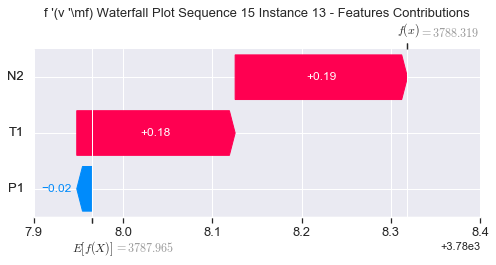

None

Contribution: [0.00617889 0.16112678 0.18240008]


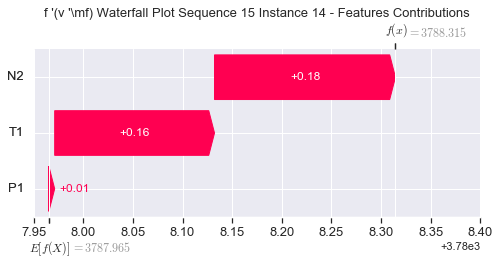

None

Contribution: [-0.01574932  0.13900498  0.1781765 ]


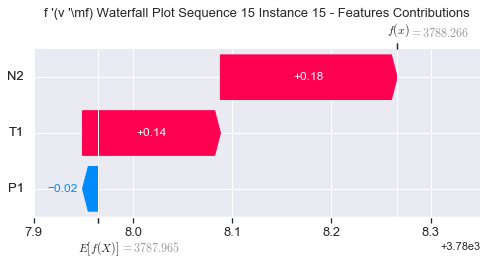

None

Contribution: [-0.02445024  0.29720252  0.15997371]


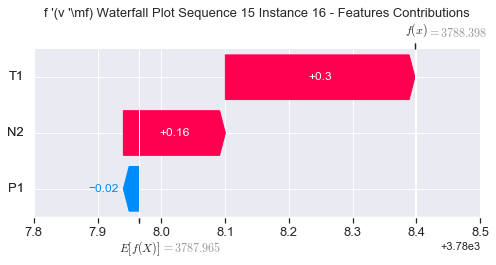

None

Contribution: [-0.01044741  0.52226597  0.14844218]


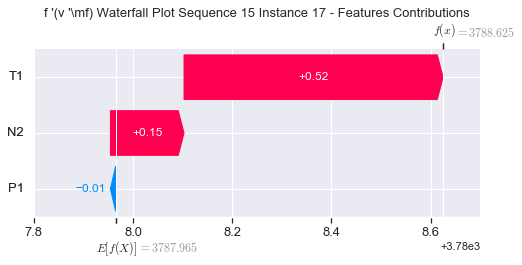

None

Contribution: [-0.00626744  0.00933624  0.15413068]


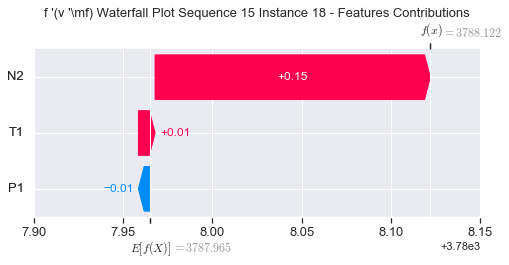

None

Contribution: [ 0.00415281 -1.33901356  0.22691289]


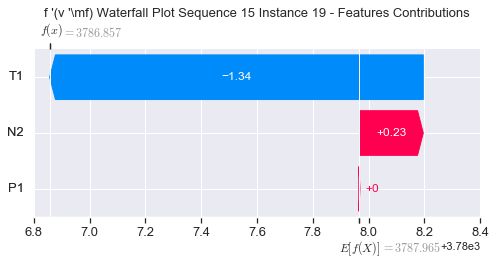

None

Contribution: [ 0.00174941 -0.58998562  0.15151746]


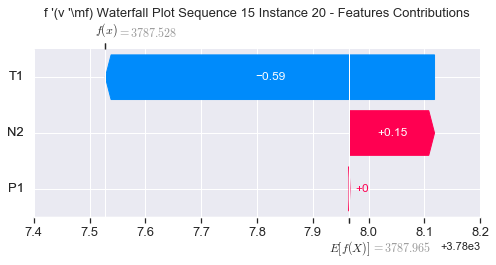

None

Contribution: [ 0.01902142  5.55043796 -0.68312658]


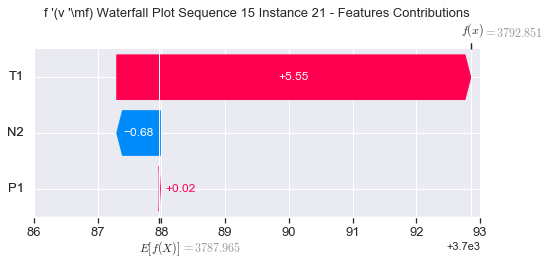

None

Contribution: [-0.01480238  8.81219255 -1.06101093]


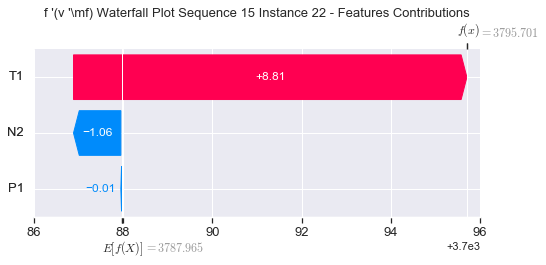

None

Contribution: [-0.0633036  -9.09991181  4.95665703]


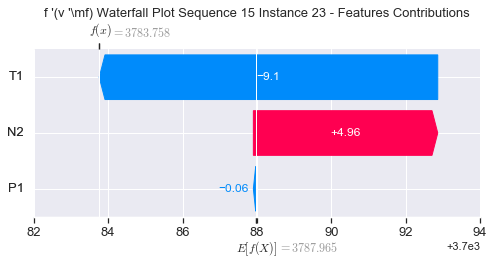

None

Contribution: [ -2.94531114 -34.64352703  16.7246422 ]


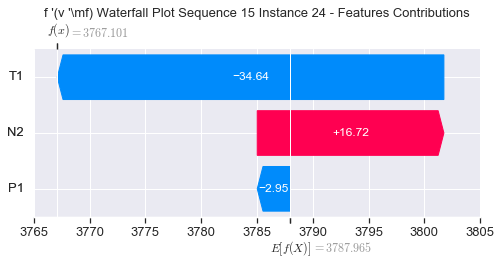

None

Contribution: [13.47840649  4.34585419 39.81973628]


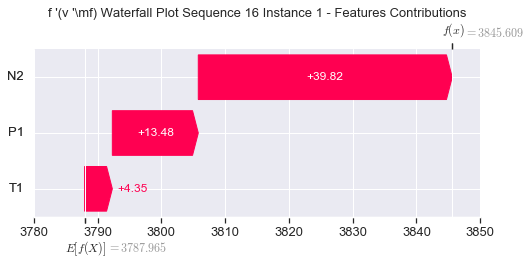

None

Contribution: [-0.00376844 -0.63582265  0.31812201]


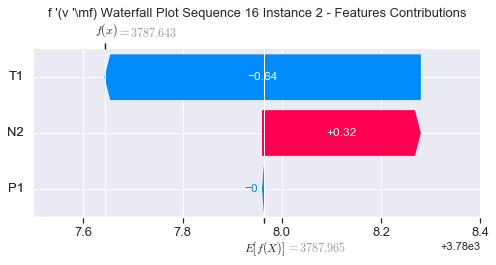

None

Contribution: [-0.04749144  0.04510121  0.14472565]


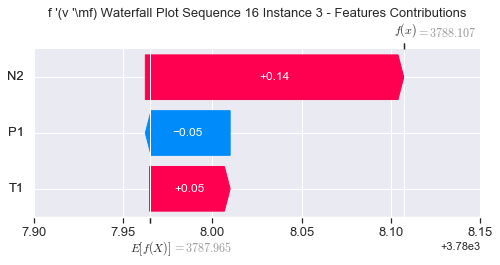

None

Contribution: [-0.09341256  0.06495645  0.31074797]


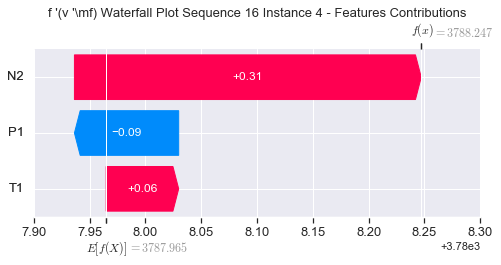

None

Contribution: [-0.08152668  0.02005736  0.23992844]


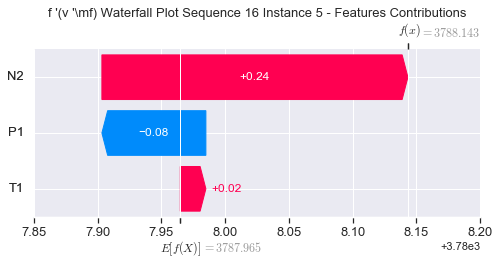

None

Contribution: [-0.0237994   0.18287304  0.19806709]


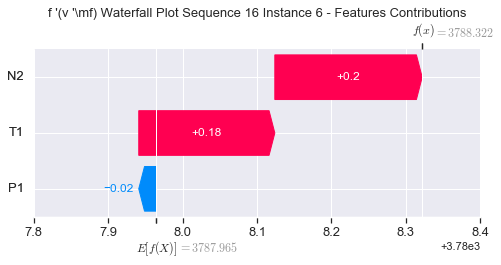

None

Contribution: [-0.00943094  0.20273136  0.21698819]


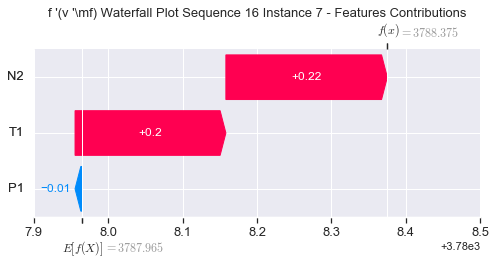

None

Contribution: [-0.00417041  0.22441476  0.2200068 ]


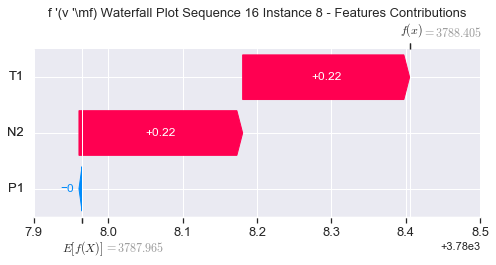

None

Contribution: [-0.01600595  0.26562566  0.21322417]


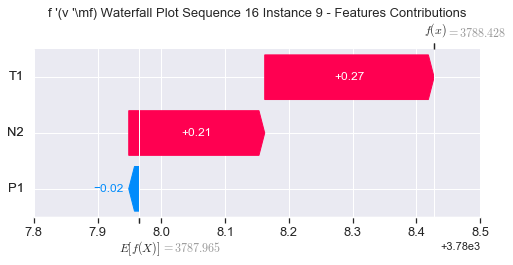

None

Contribution: [-0.03897129  0.23654004  0.20245297]


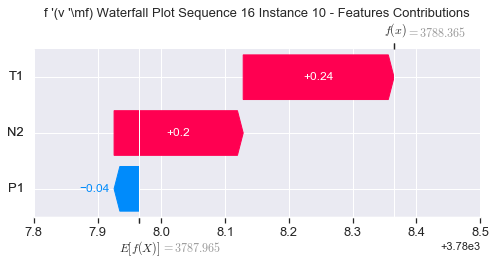

None

Contribution: [-0.02076275  0.29189691  0.20157198]


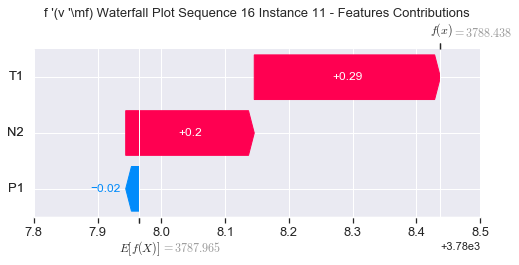

None

Contribution: [-0.01879836  0.21753045  0.20105723]


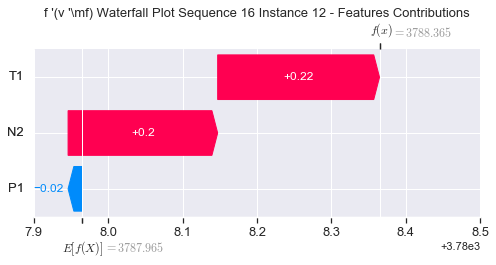

None

Contribution: [-0.01799542  0.19935016  0.19410482]


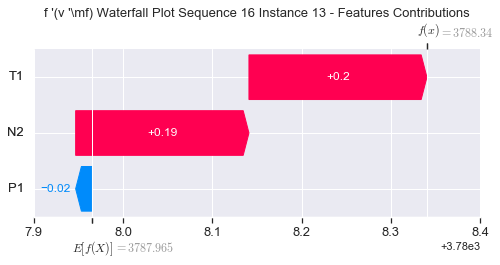

None

Contribution: [-0.02372724  0.16080941  0.18578258]


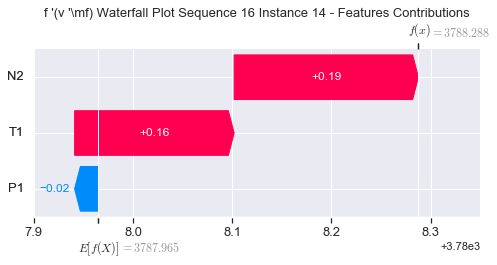

None

Contribution: [-0.015653    0.15639585  0.17931548]


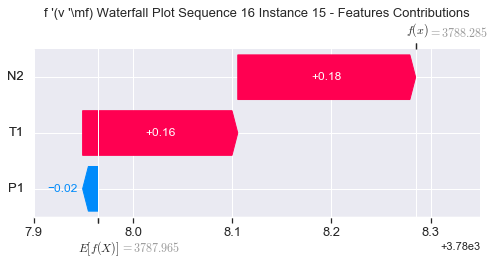

None

Contribution: [-0.0550388   0.40190261  0.16736235]


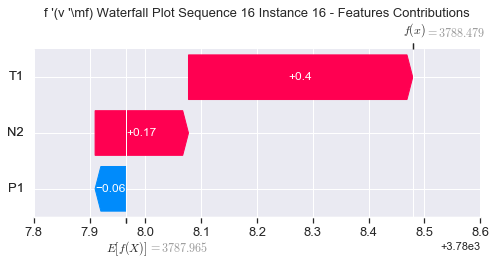

None

Contribution: [-0.0192441   0.60471771  0.15344808]


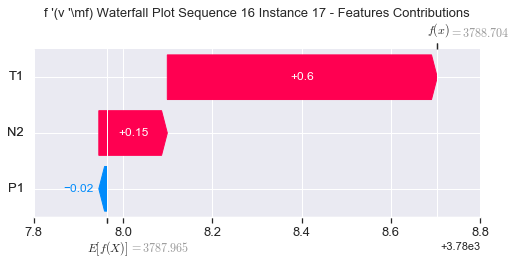

None

Contribution: [-0.0131114   0.0129682   0.15476113]


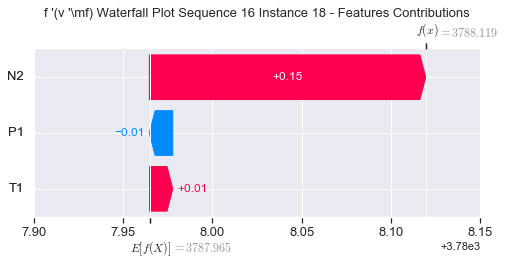

None

Contribution: [ 0.00747664 -1.7090518   0.21268607]


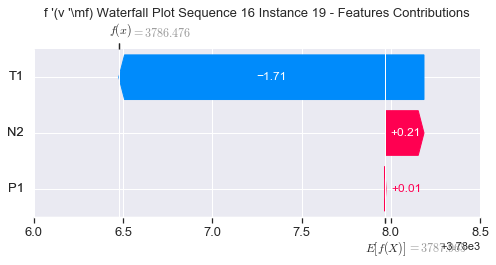

None

Contribution: [ 0.01504709 -0.71320448  0.14655553]


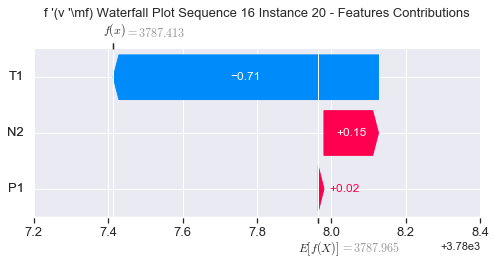

None

Contribution: [-0.00786976  6.58986788 -0.58176718]


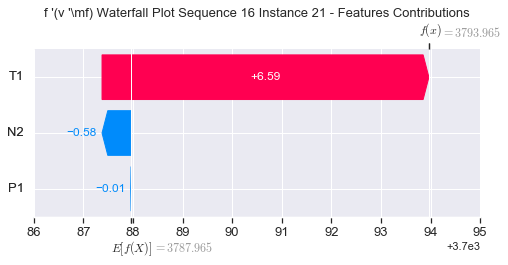

None

Contribution: [ 0.02331896 10.83498683 -0.9371614 ]


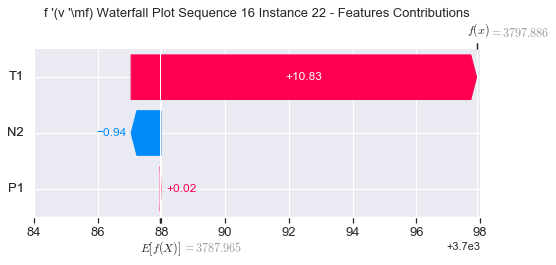

None

Contribution: [ -0.05969713 -11.35530182   4.74654131]


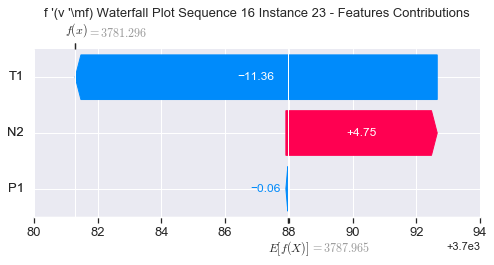

None

Contribution: [ -2.9708807  -41.25066589  15.99999606]


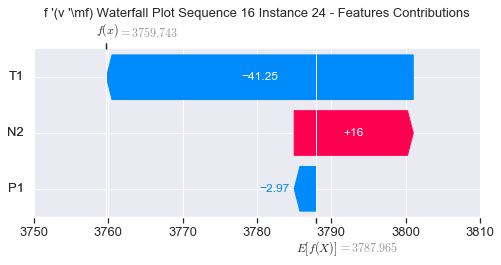

None

Contribution: [12.49764039  3.15626833 39.12594122]


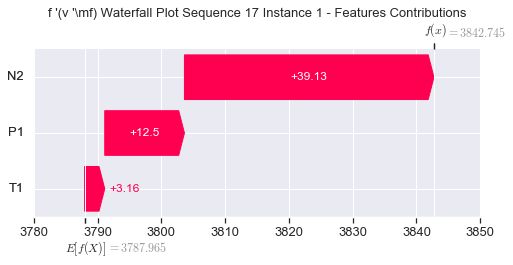

None

Contribution: [-3.32484448e-04 -1.01440491e+00  3.13021993e-01]


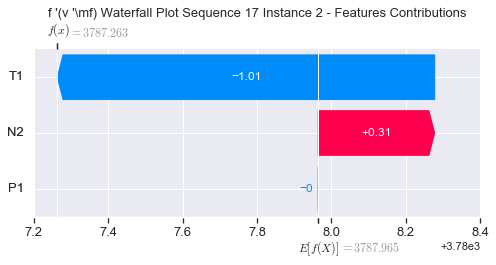

None

Contribution: [-0.03942013  0.01719917  0.14581424]


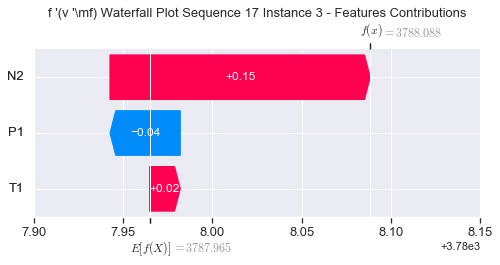

None

Contribution: [-0.09945879  0.04311347  0.31430773]


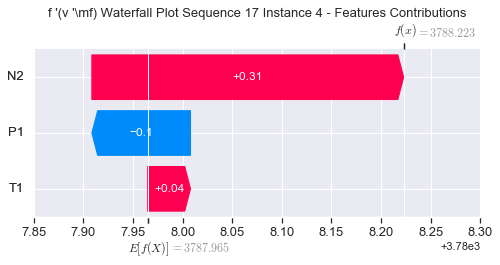

None

Contribution: [-8.13697517e-02 -5.70894478e-05  2.40160257e-01]


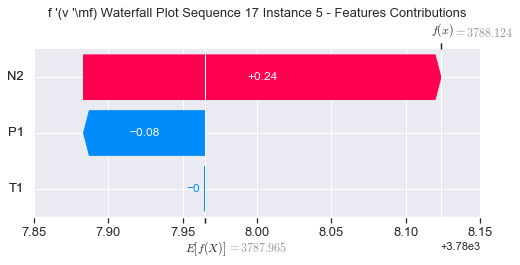

None

Contribution: [-0.02729222  0.20739034  0.20278729]


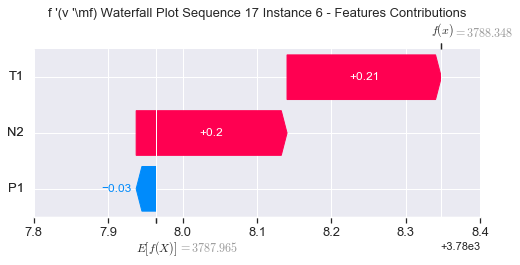

None

Contribution: [-0.01414416  0.23846437  0.22074094]


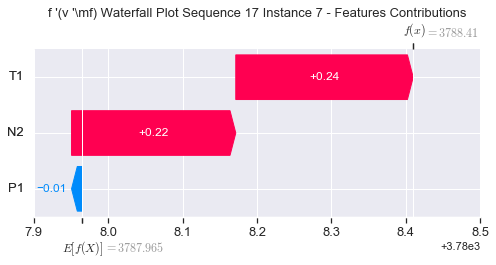

None

Contribution: [-0.00978188  0.25610454  0.22369487]


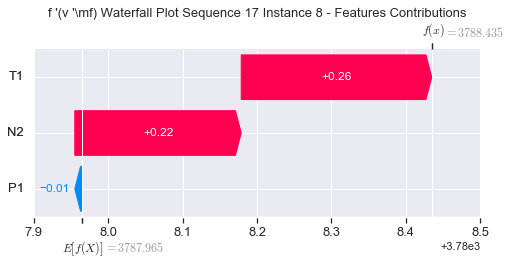

None

Contribution: [-0.01693427  0.28929126  0.21910635]


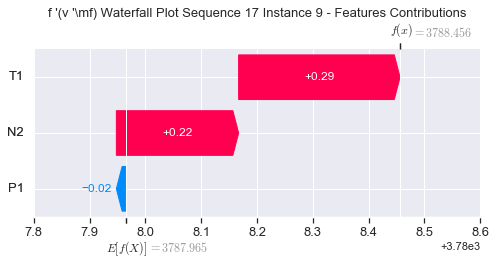

None

Contribution: [-0.0467961   0.27175056  0.20197305]


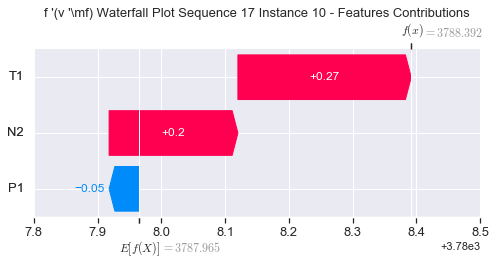

None

Contribution: [-0.03131637  0.27856572  0.20767405]


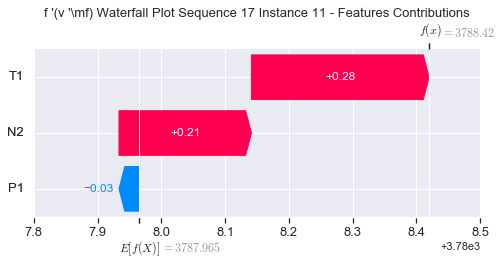

None

Contribution: [-0.01832028  0.24511072  0.20295482]


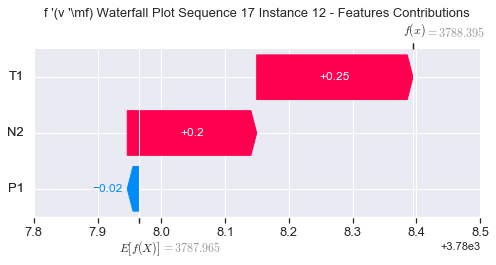

None

Contribution: [-0.01600108  0.23176064  0.19556389]


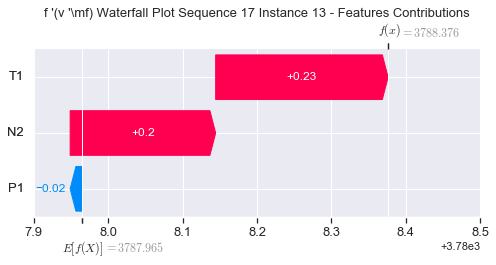

None

Contribution: [-0.03936238  0.19922557  0.18638078]


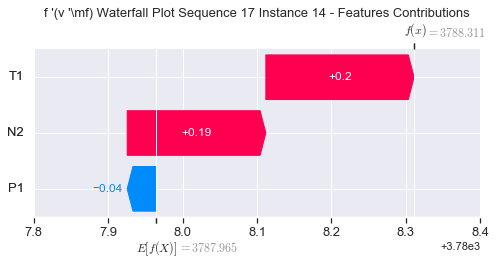

None

Contribution: [-0.01490183  0.17391296  0.17989076]


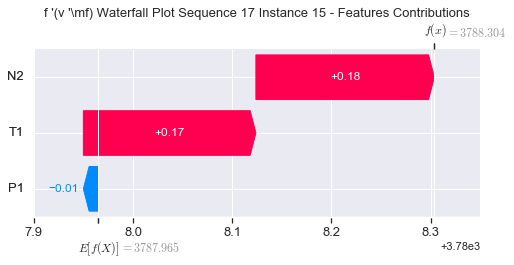

None

Contribution: [-0.00245907  0.3779196   0.16037765]


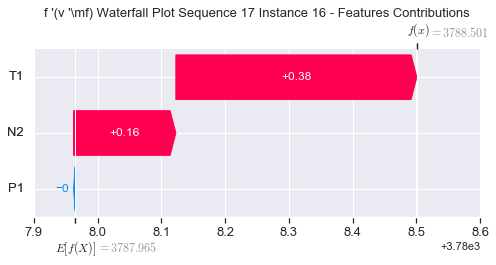

None

Contribution: [-0.0177482   0.70017475  0.15398005]


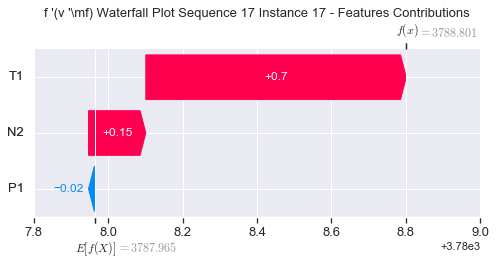

None

Contribution: [-0.01496554  0.02500536  0.1550407 ]


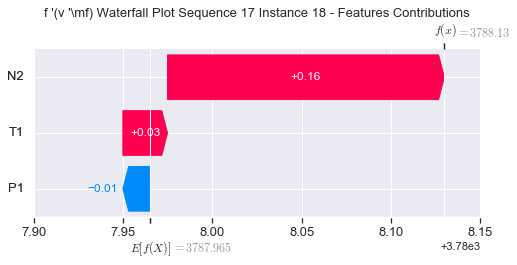

None

Contribution: [ 0.00716755 -1.64405196  0.23658102]


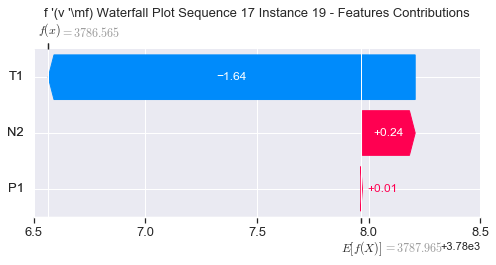

None

Contribution: [ 0.00973028 -0.8410958   0.14998225]


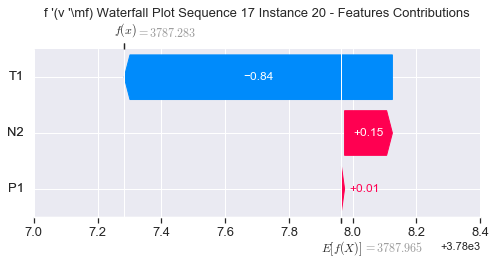

None

Contribution: [ 0.02675277  7.45376202 -0.66899975]


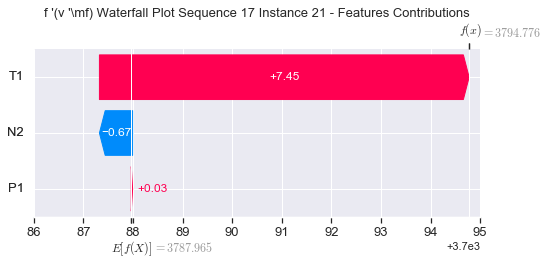

None

Contribution: [ 0.14631968 11.96393153 -1.08468184]


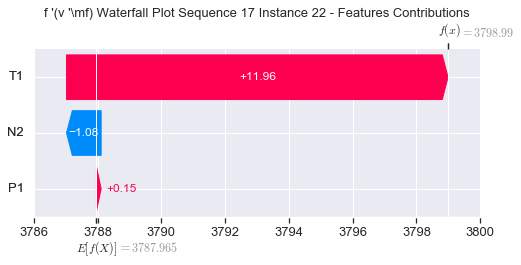

None

Contribution: [ -0.07389051 -12.37132052   5.0162464 ]


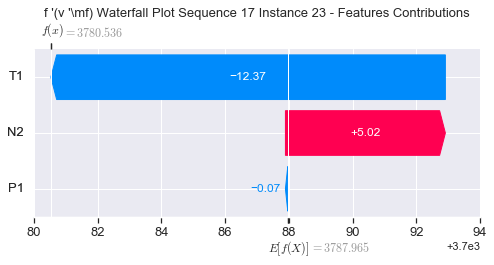

None

Contribution: [ -3.66783848 -46.6552636   16.80721956]


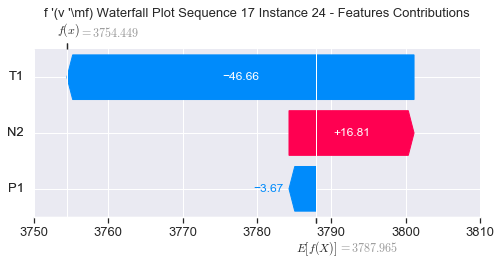

None

Contribution: [18.18680499 -1.54769013 39.82825433]


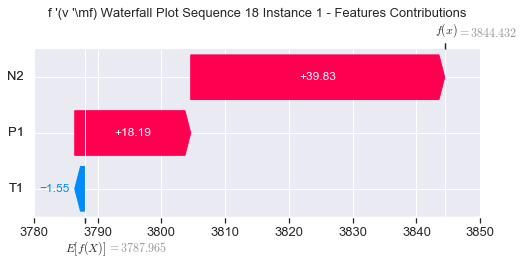

None

Contribution: [ 0.03223154 -1.1855098   0.34196883]


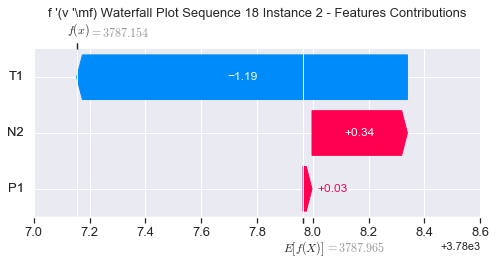

None

Contribution: [-0.0385618   0.00779794  0.14629868]


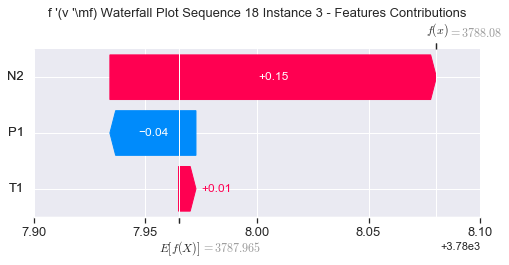

None

Contribution: [-0.09127345  0.0272211   0.31031439]


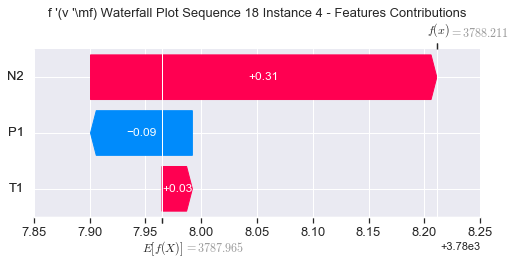

None

Contribution: [-0.08217591  0.00329416  0.24038392]


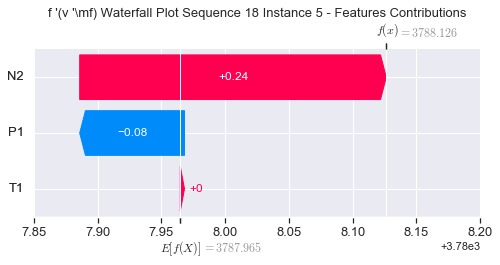

None

Contribution: [-0.02036836  0.19378216  0.19458755]


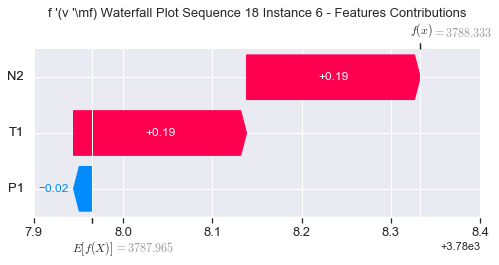

None

Contribution: [0.00195784 0.21830554 0.21395058]


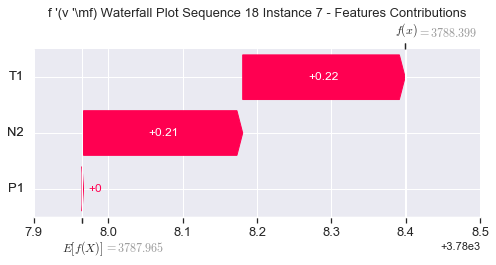

None

Contribution: [0.00650276 0.2330715  0.21758915]


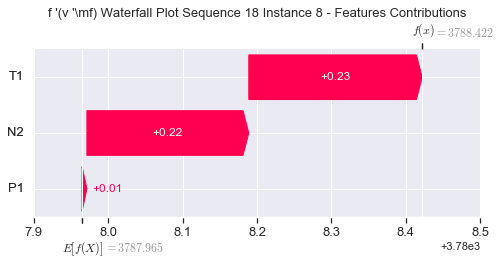

None

Contribution: [-0.00390099  0.24105473  0.2121616 ]


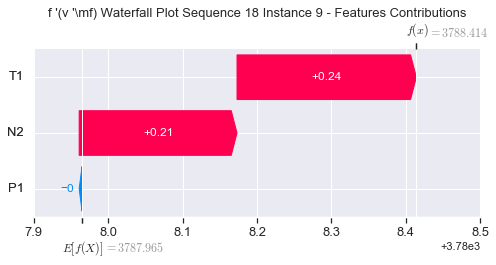

None

Contribution: [-0.00627113  0.25904002  0.20084084]


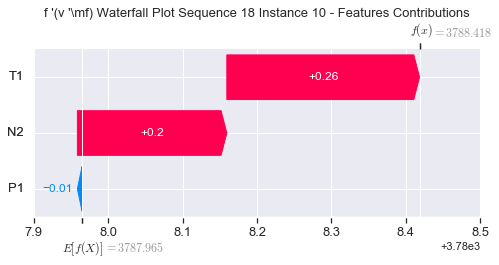

None

Contribution: [-0.01062597  0.23911686  0.20046486]


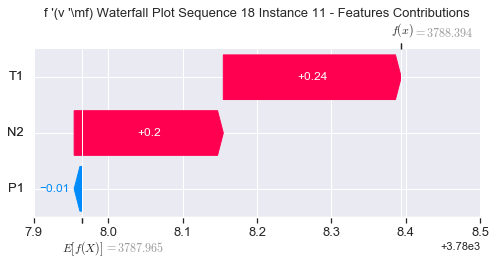

None

Contribution: [0.03599031 0.21155639 0.19761731]


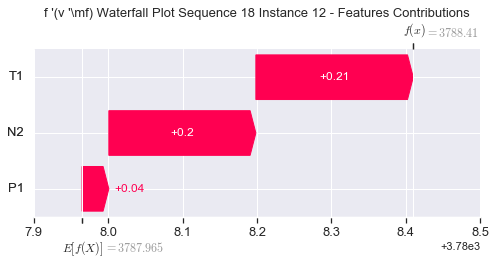

None

Contribution: [0.0329003  0.19972943 0.19095982]


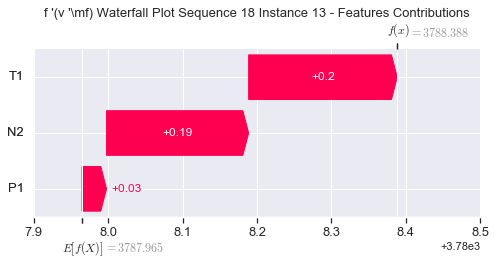

None

Contribution: [-0.00267268  0.14273001  0.18510738]


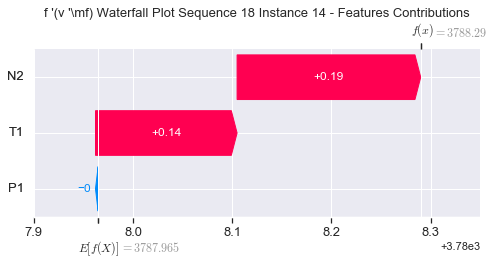

None

Contribution: [0.01655375 0.15332252 0.17696724]


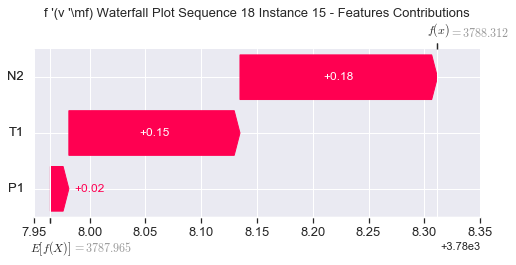

None

Contribution: [-0.02460542  0.3199313   0.16419624]


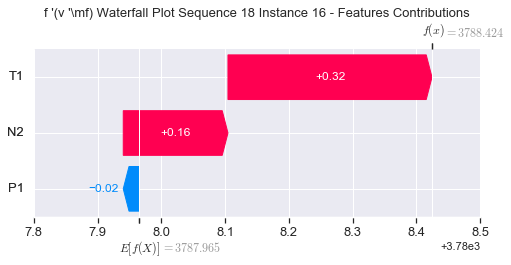

None

Contribution: [0.05426247 0.59109838 0.14038447]


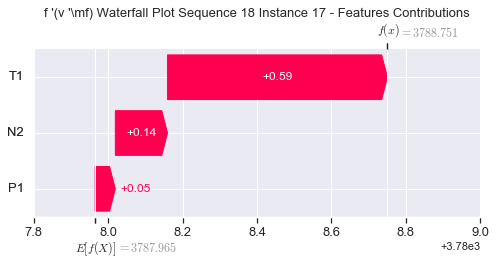

None

Contribution: [0.03493309 0.01859685 0.15741848]


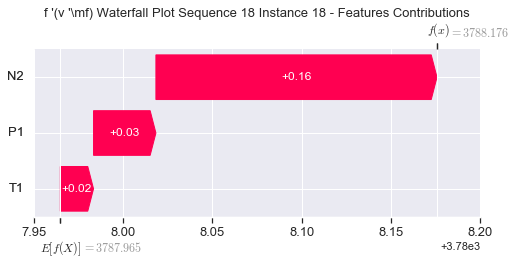

None

Contribution: [-0.03382129 -1.59381318  0.25470045]


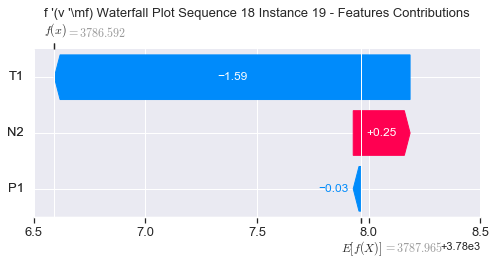

None

Contribution: [-0.0543448  -0.73438147  0.1540086 ]


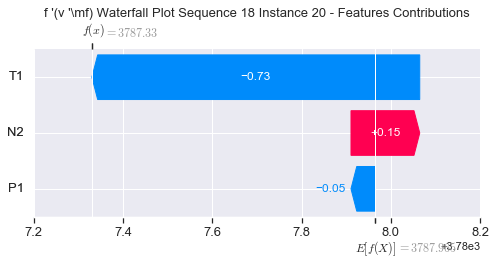

None

Contribution: [ 0.21881635  6.66302213 -0.72327557]


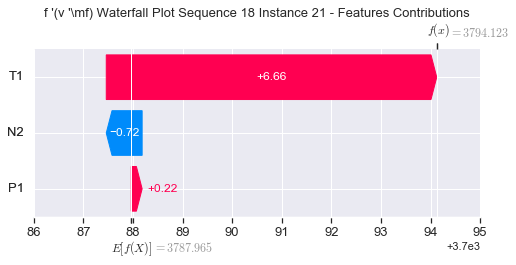

None

Contribution: [ 0.51977865 10.88634844 -1.11015095]


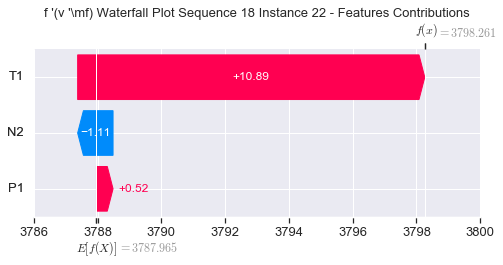

None

Contribution: [ -0.21307618 -11.07842807   5.0689244 ]


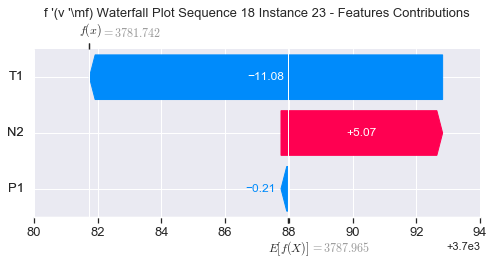

None

Contribution: [ -4.36775651 -43.12691341  16.6249348 ]


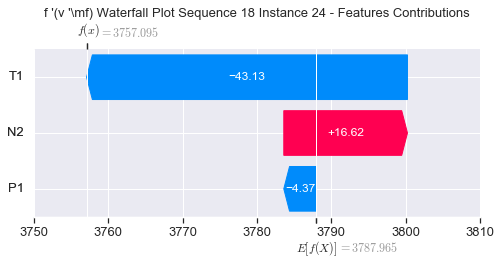

None

Contribution: [20.31219284  1.87196735 39.6246909 ]


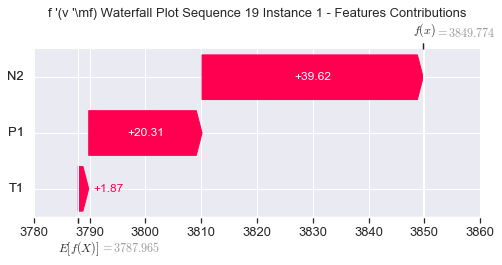

None

Contribution: [ 0.07064523 -0.97322079  0.333333  ]


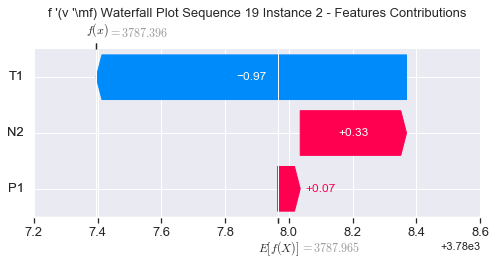

None

Contribution: [-0.045312    0.02213786  0.14320015]


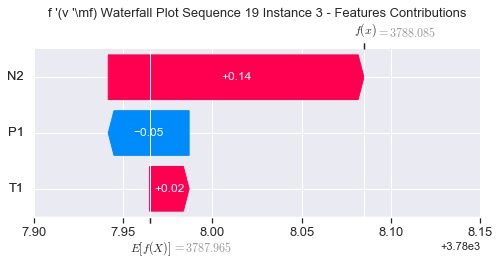

None

Contribution: [-0.09672153  0.03941351  0.31384928]


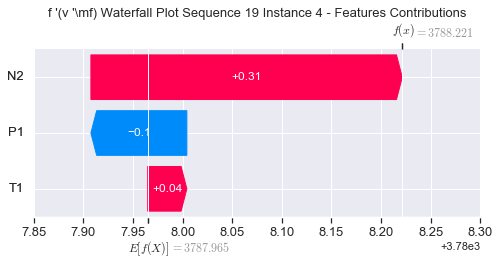

None

Contribution: [-0.08521372  0.00642182  0.24197028]


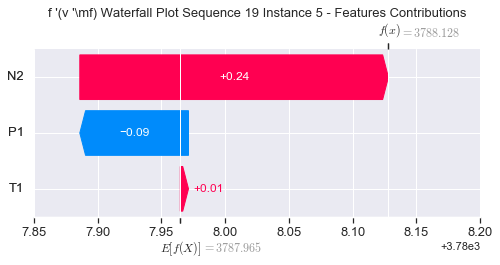

None

Contribution: [-0.02297848  0.20024906  0.19951214]


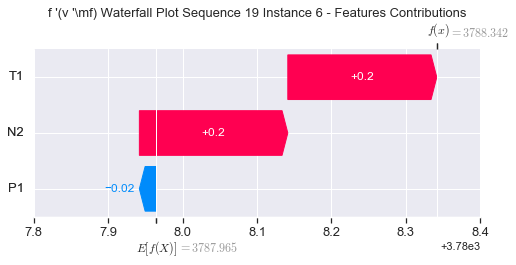

None

Contribution: [-0.0033639   0.22409289  0.21803923]


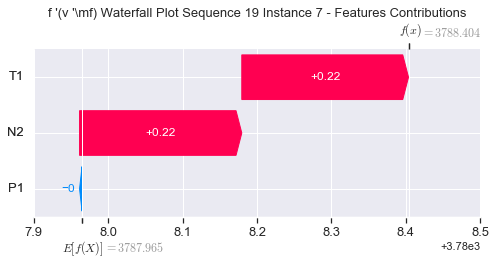

None

Contribution: [0.00214594 0.24259956 0.22093383]


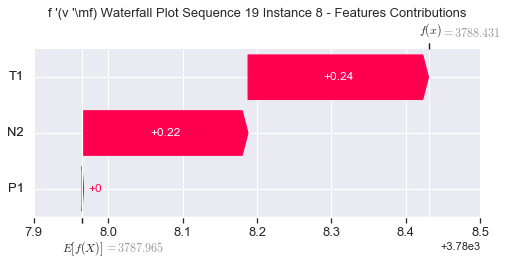

None

Contribution: [-0.00350719  0.25669041  0.21244489]


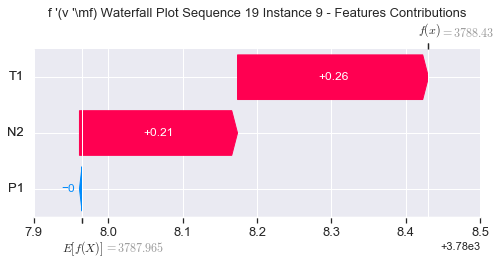

None

Contribution: [-0.01832812  0.26164774  0.20256327]


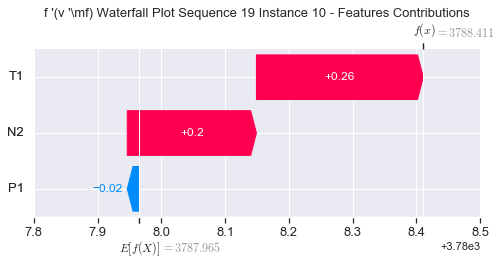

None

Contribution: [-0.02496107  0.27568313  0.20358515]


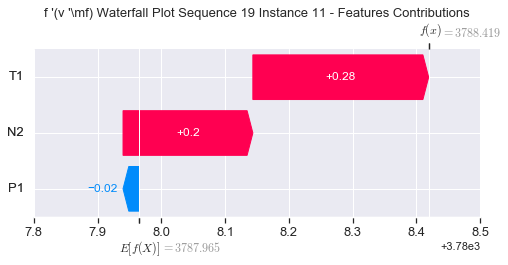

None

Contribution: [0.00226428 0.23463417 0.20234739]


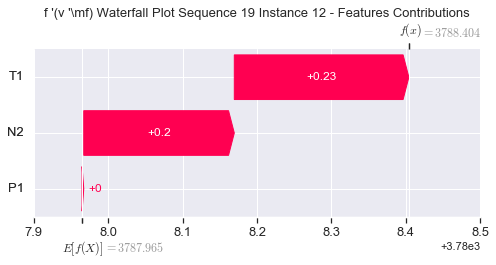

None

Contribution: [0.00755161 0.21814017 0.19466332]


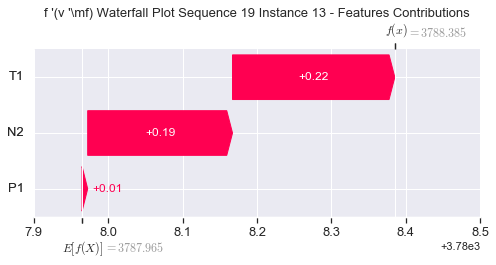

None

Contribution: [0.01523261 0.16568983 0.18484826]


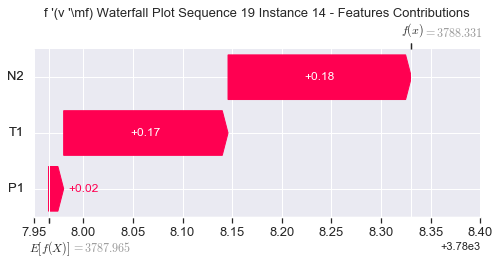

None

Contribution: [0.00573114 0.16547237 0.17968663]


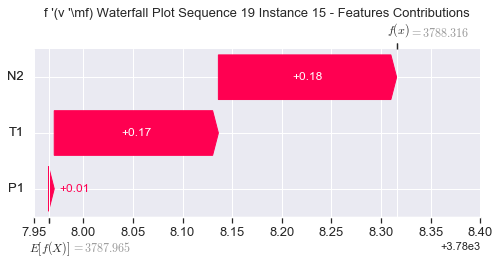

None

Contribution: [-0.01385391  0.34723798  0.1654378 ]


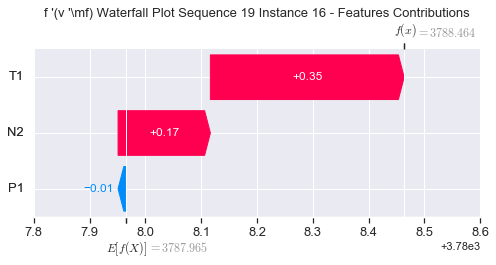

None

Contribution: [0.03708067 0.63949523 0.15725106]


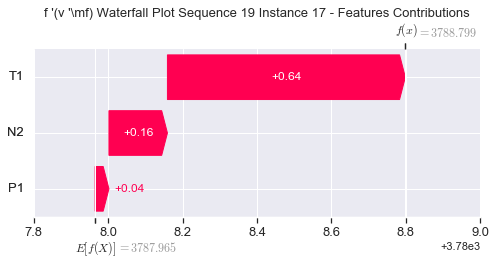

None

Contribution: [0.02560522 0.01979043 0.15280354]


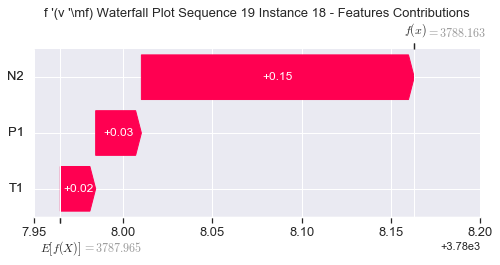

None

Contribution: [ 0.01158508 -1.68561948  0.18788831]


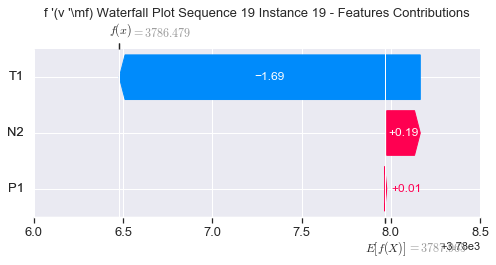

None

Contribution: [-0.09193879 -0.75594146  0.14512542]


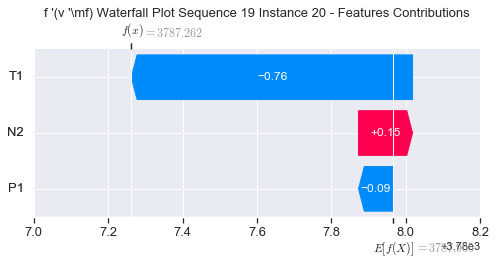

None

Contribution: [ 0.33756407  6.89199205 -0.5560715 ]


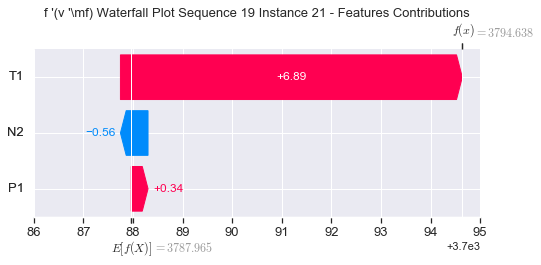

None

Contribution: [ 0.94540366 11.32270942 -0.89927674]


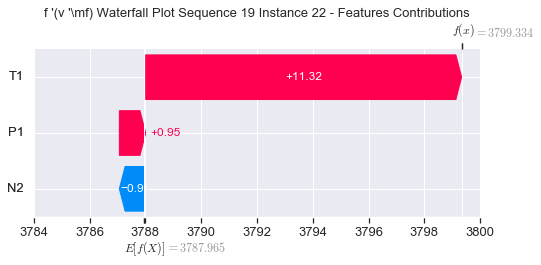

None

Contribution: [ -0.28911125 -11.80918075   4.57660686]


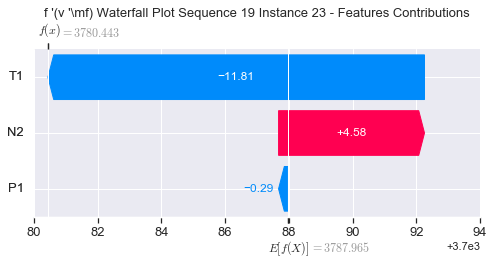

None

Contribution: [ -4.43910385 -46.02010105  14.85928024]


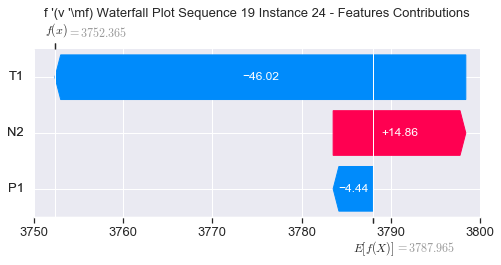

None

Contribution: [ 7.52442917 -4.31505947 32.27364657]


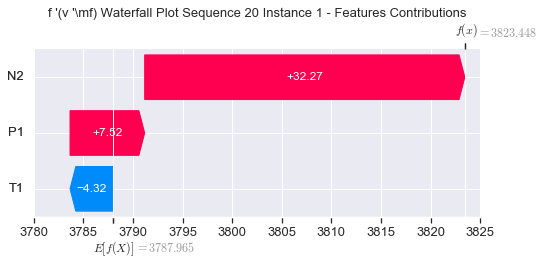

None

Contribution: [ 0.09593733 -1.18524764  0.3104298 ]


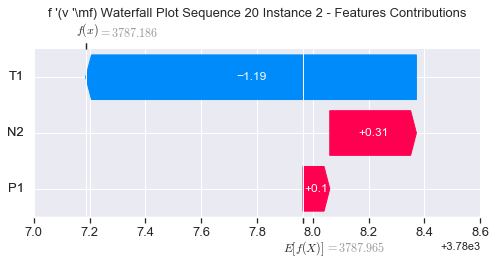

None

Contribution: [-0.03607957 -0.00079787  0.14138748]


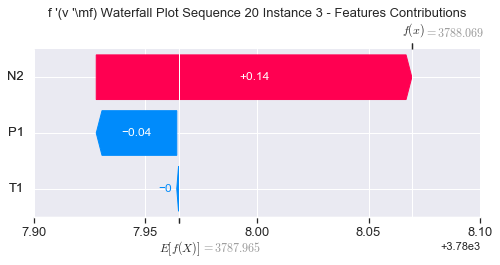

None

Contribution: [-0.09232585  0.04071313  0.30445063]


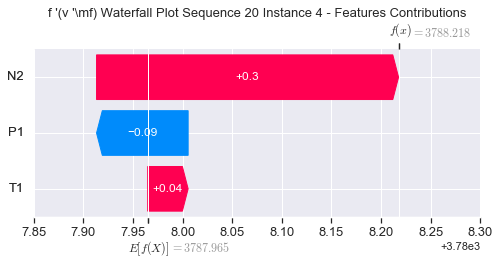

None

Contribution: [-0.0882791   0.01846035  0.23829821]


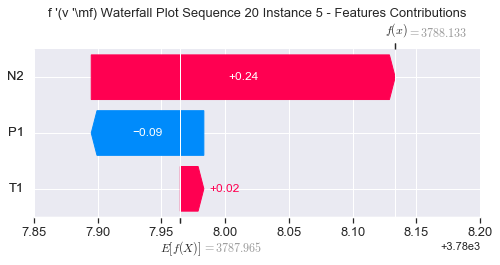

None

Contribution: [-0.02276429  0.18147347  0.19952193]


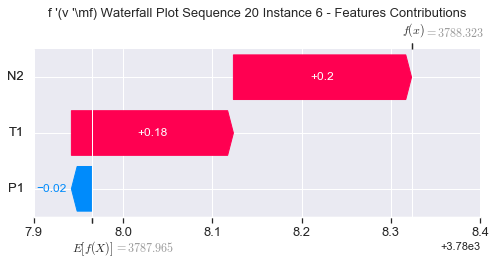

None

Contribution: [-0.00368996  0.20428946  0.21787843]


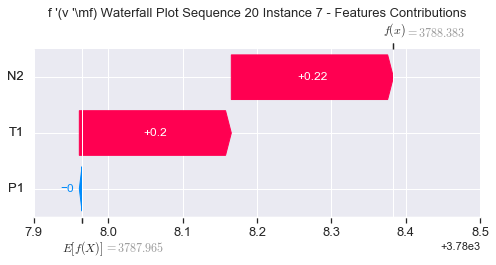

None

Contribution: [0.00189534 0.21902193 0.22211157]


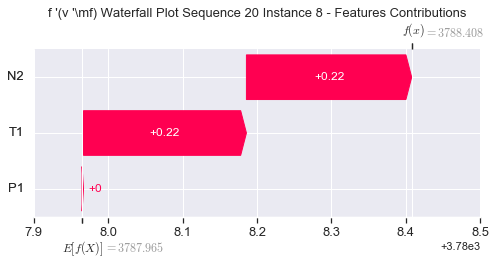

None

Contribution: [-0.01352767  0.24879053  0.21485293]


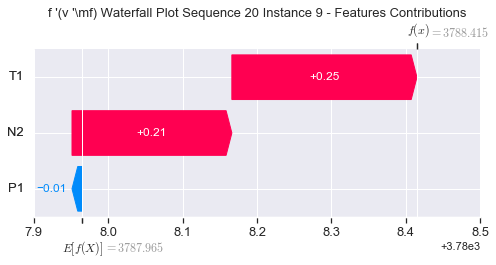

None

Contribution: [-0.00447477  0.30235008  0.20583891]


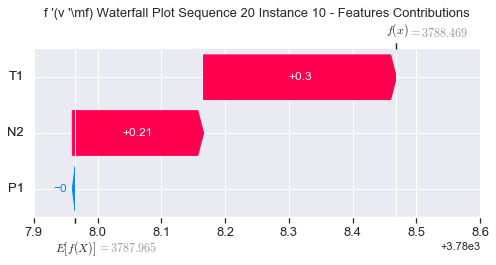

None

Contribution: [-0.03462185  0.2595683   0.20676702]


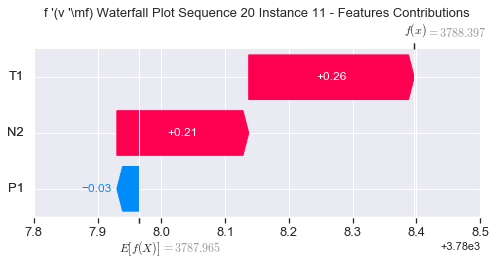

None

Contribution: [0.00966081 0.2022861  0.20176374]


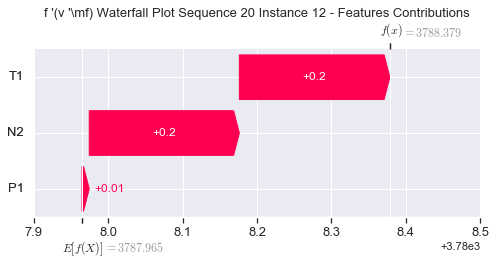

None

Contribution: [0.01390645 0.19085365 0.19359113]


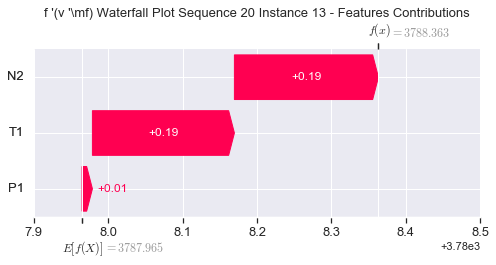

None

Contribution: [0.00570031 0.14336458 0.18519263]


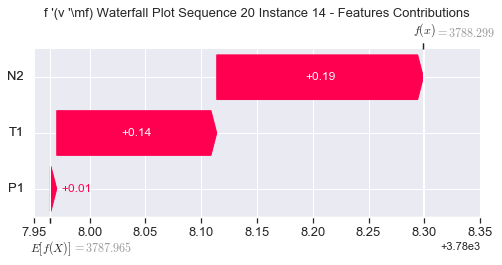

None

Contribution: [0.00592578 0.14670848 0.17853657]


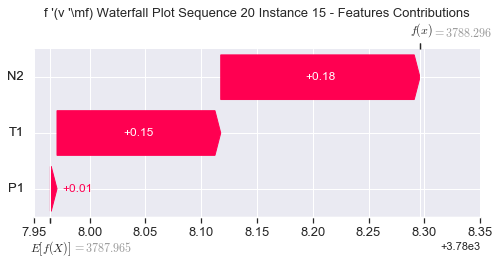

None

Contribution: [-0.00830681  0.35769108  0.16061904]


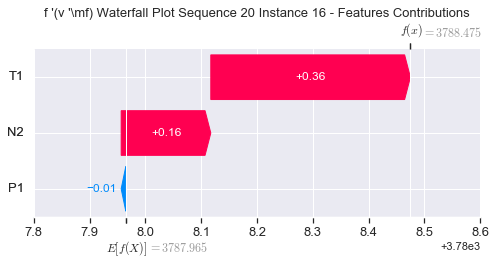

None

Contribution: [0.03535239 0.58183913 0.1518795 ]


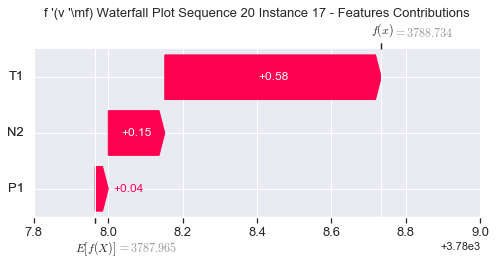

None

Contribution: [0.02402985 0.026942   0.1518591 ]


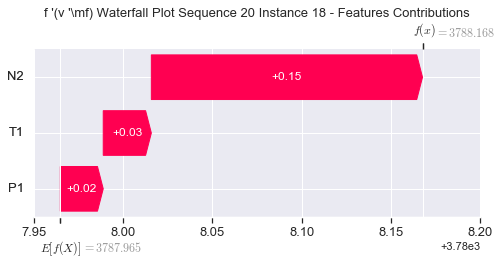

None

Contribution: [-0.03944983 -1.5384393   0.22294221]


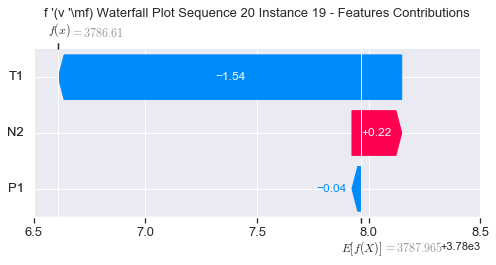

None

Contribution: [-0.09243598 -0.72438623  0.14607293]


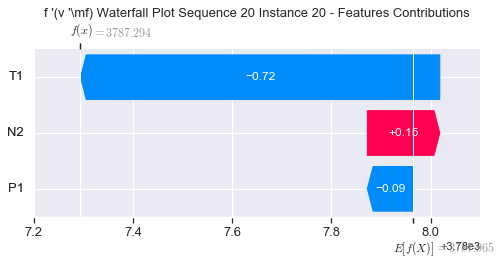

None

Contribution: [ 0.35175663  6.38723705 -0.61948009]


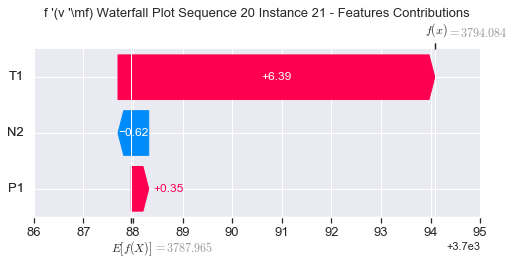

None

Contribution: [ 1.05234745 10.24762307 -0.95951116]


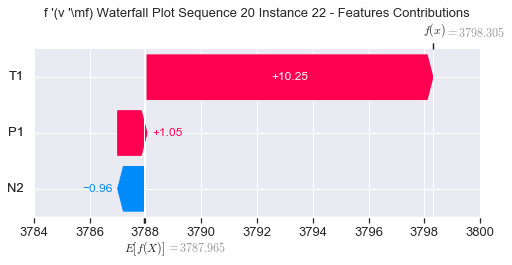

None

Contribution: [ -0.31937603 -10.9596449    4.64272738]


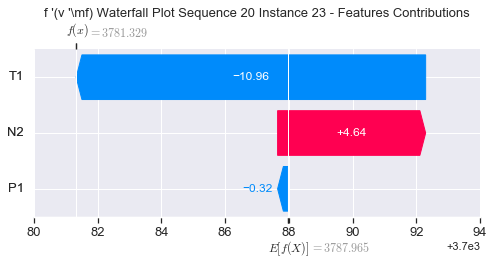

None

Contribution: [ -5.85144243 -42.15800417  15.21944857]


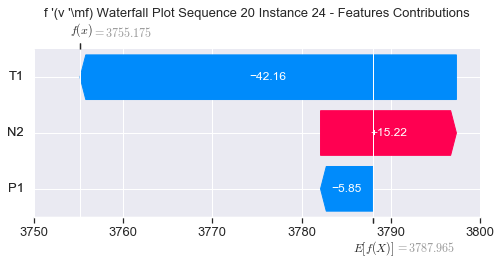

None

Contribution: [16.51395458  0.46255825 34.40705392]


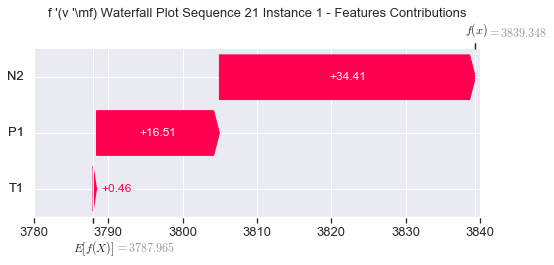

None

Contribution: [ 0.12722208 -0.89431273  0.32098375]


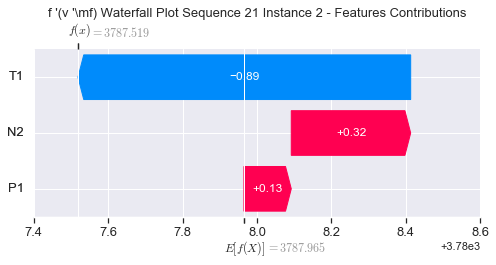

None

Contribution: [-0.03630112  0.03671388  0.1420687 ]


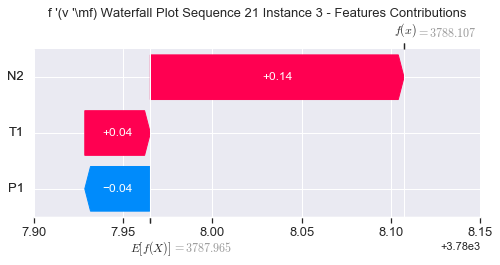

None

Contribution: [-0.10157902  0.06155119  0.30849007]


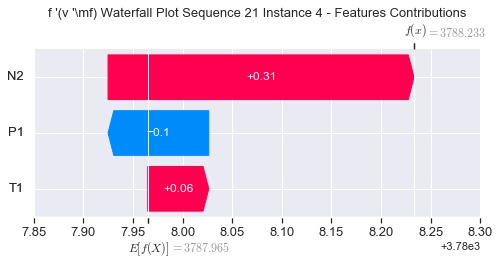

None

Contribution: [-0.08679202  0.01604316  0.23926756]


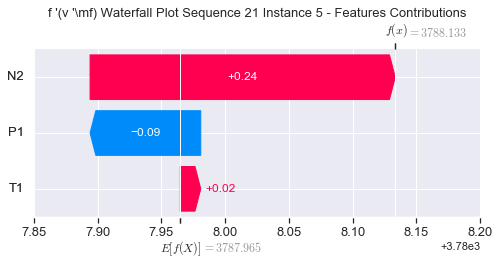

None

Contribution: [-0.01611739  0.17624388  0.19933272]


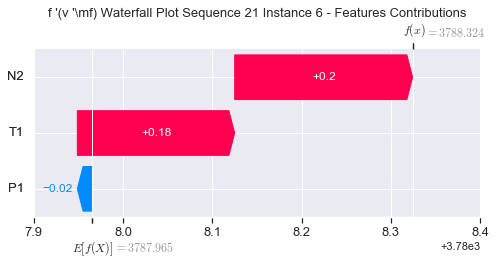

None

Contribution: [0.00496903 0.20080117 0.21840262]


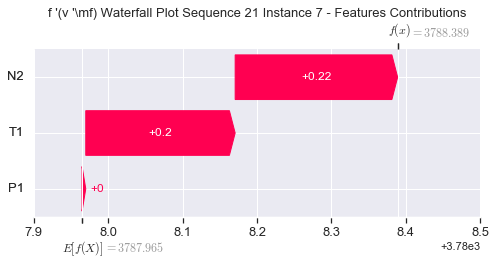

None

Contribution: [0.01479793 0.21891523 0.22142326]


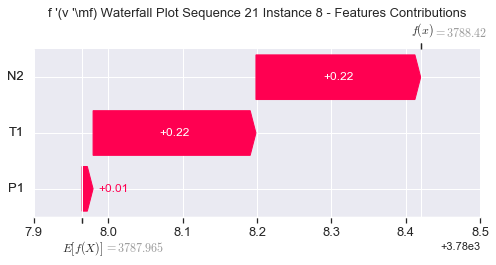

None

Contribution: [0.00951535 0.25070828 0.21536719]


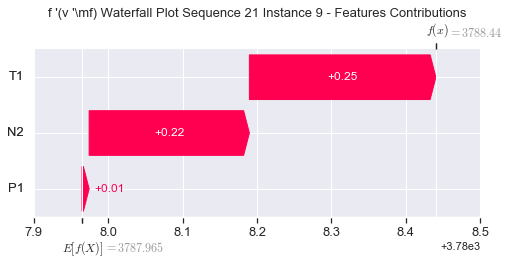

None

Contribution: [-0.05943463  0.25753324  0.20561198]


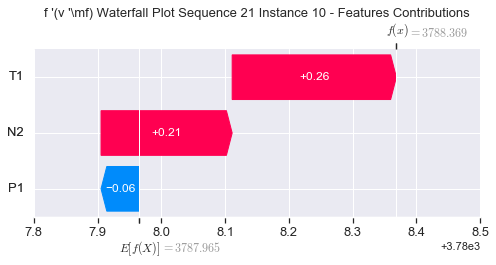

None

Contribution: [0.01750626 0.25252393 0.20257103]


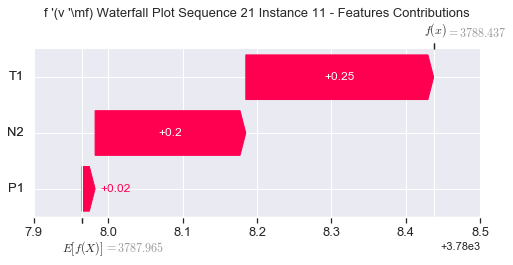

None

Contribution: [0.00554285 0.22470438 0.2012235 ]


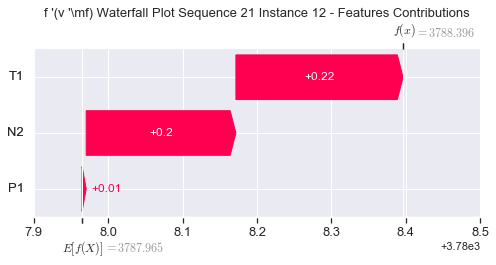

None

Contribution: [0.00581907 0.21391222 0.19380895]


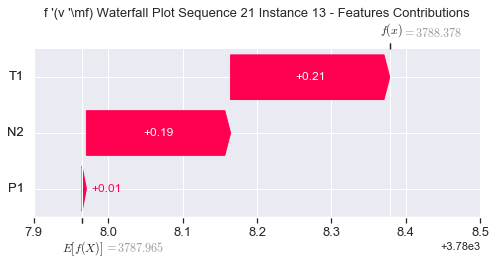

None

Contribution: [0.03032497 0.16774189 0.18460562]


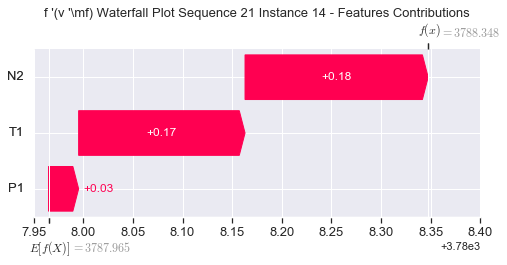

None

Contribution: [0.01016999 0.16123788 0.17895541]


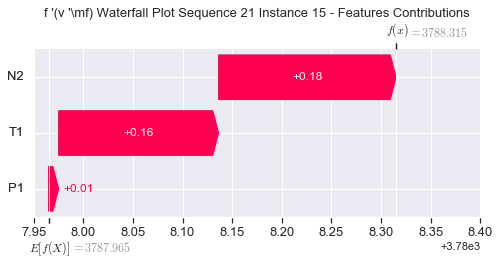

None

Contribution: [0.00129324 0.35385631 0.16014344]


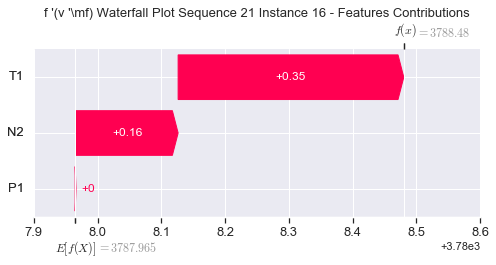

None

Contribution: [0.03879744 0.654214   0.14660654]


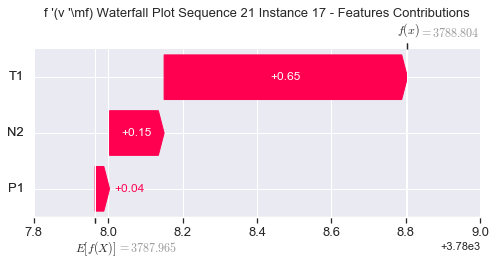

None

Contribution: [0.03285443 0.02648772 0.1572362 ]


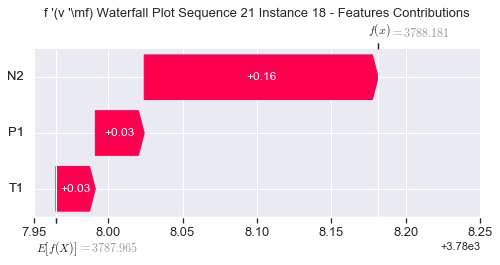

None

Contribution: [-0.05436321 -1.79570359  0.25937779]


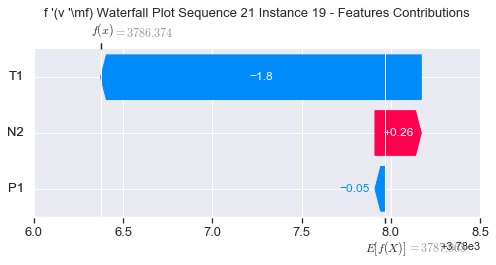

None

Contribution: [-0.09310985 -0.83178452  0.15347218]


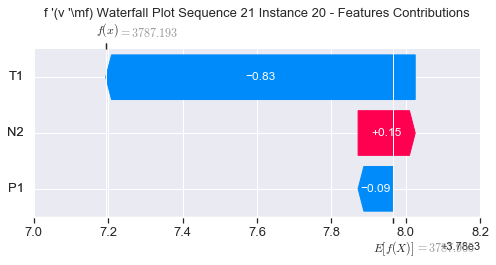

None

Contribution: [ 0.3073355   7.50393128 -0.73786738]


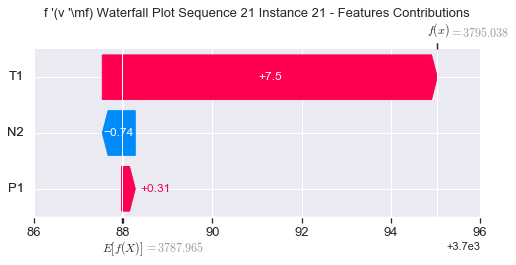

None

Contribution: [ 0.86829392 12.45986953 -1.16146237]


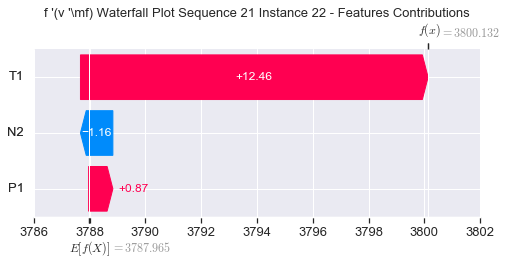

None

Contribution: [ -0.3255472  -13.06685548   5.20863632]


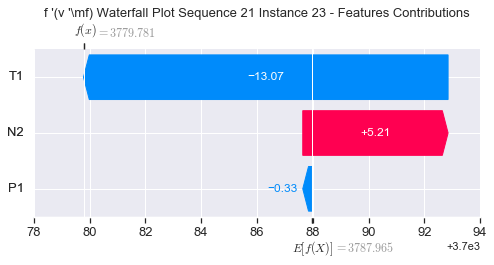

None

Contribution: [ -4.38250928 -51.27957214  16.49163032]


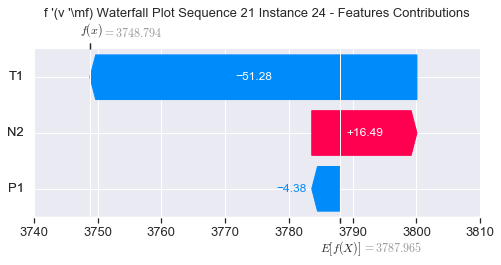

None

Contribution: [ 1.91704761 -8.70915793 34.70822576]


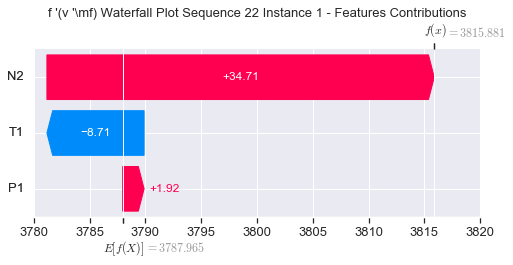

None

Contribution: [ 0.04543946 -1.55185458  0.34529831]


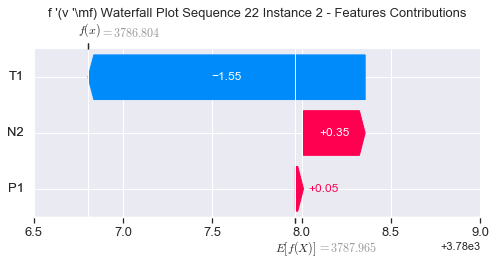

None

Contribution: [-0.03474213 -0.02499681  0.14636735]


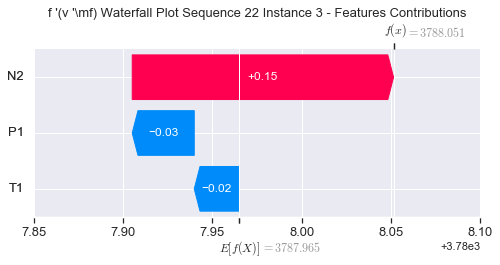

None

Contribution: [-0.10135251  0.01772274  0.30779896]


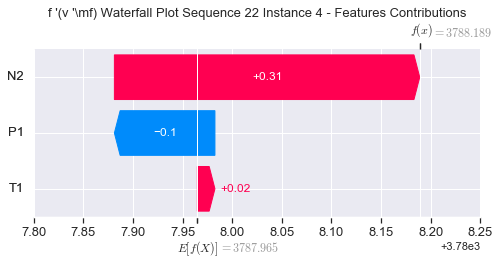

None

Contribution: [-0.08508294 -0.01337105  0.23703229]


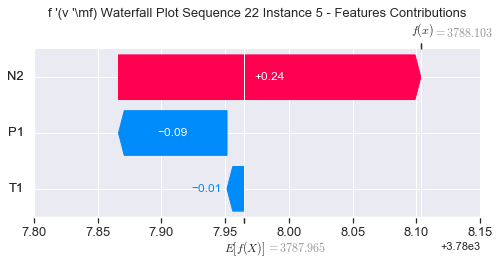

None

Contribution: [-0.02199304  0.20918298  0.20344516]


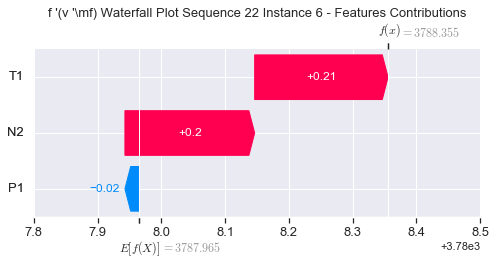

None

Contribution: [-0.00113832  0.24127217  0.22154798]


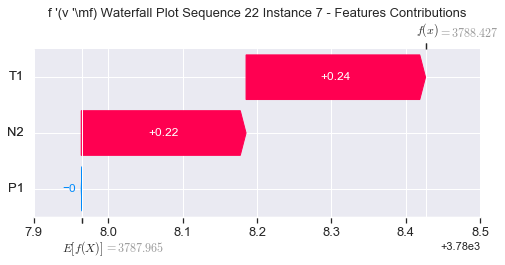

None

Contribution: [0.00394056 0.25224944 0.22533655]


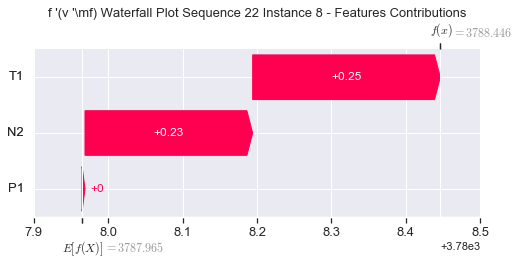

None

Contribution: [-0.00708225  0.27573943  0.22252426]


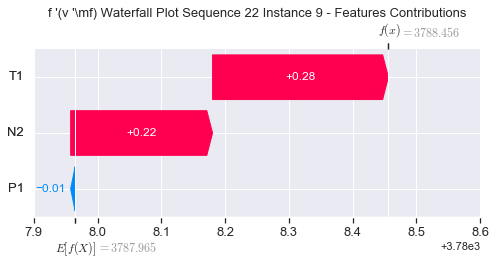

None

Contribution: [-0.01509428  0.26296988  0.20930274]


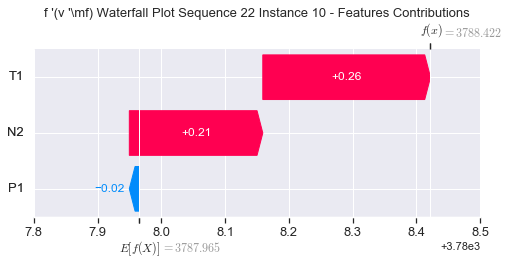

None

Contribution: [-0.03284664  0.25532825  0.21092507]


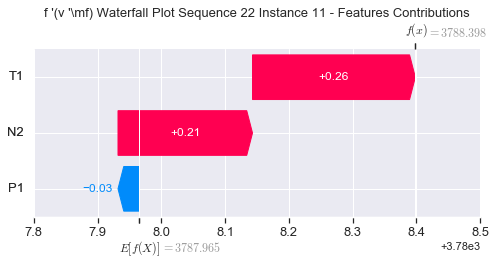

None

Contribution: [0.00128104 0.22279425 0.20220305]


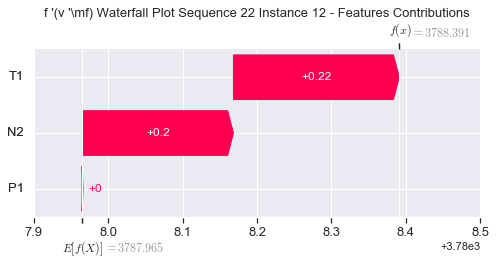

None

Contribution: [0.00761232 0.21238734 0.19434148]


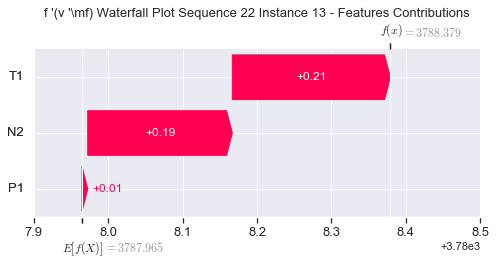

None

Contribution: [0.00030789 0.16102161 0.18517669]


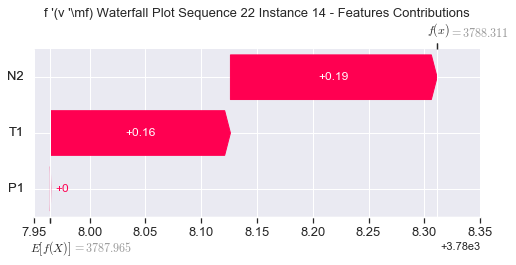

None

Contribution: [0.00570648 0.15636833 0.17843107]


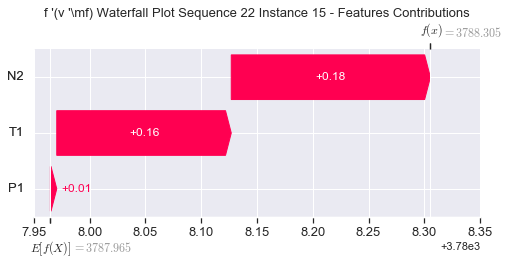

None

Contribution: [0.00703576 0.34564195 0.16041288]


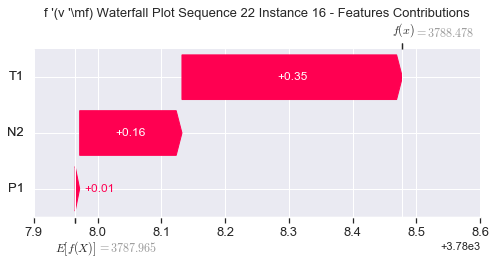

None

Contribution: [0.04360878 0.59614449 0.15373422]


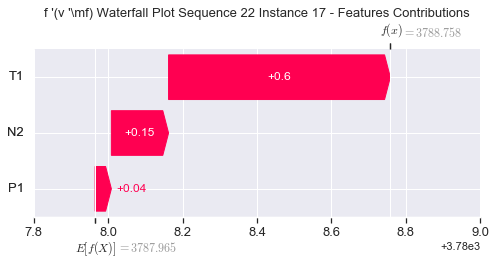

None

Contribution: [0.03255519 0.03348372 0.15102143]


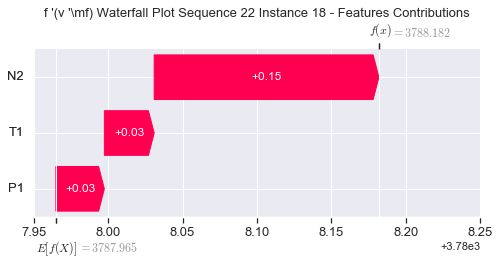

None

Contribution: [ 0.00486524 -1.54966163  0.20790371]


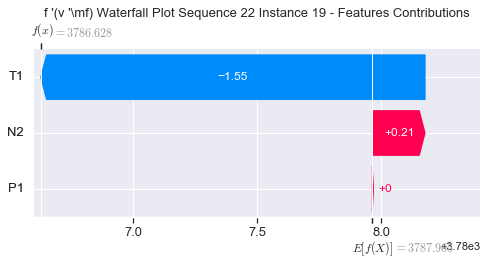

None

Contribution: [-0.11984498 -0.71254072  0.14751965]


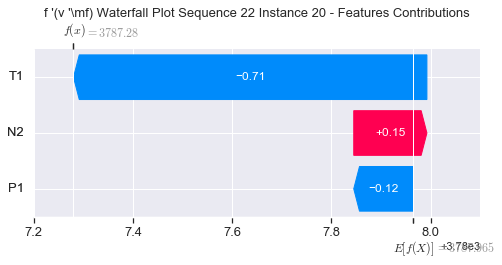

None

Contribution: [ 0.3897802   6.17872383 -0.66617118]


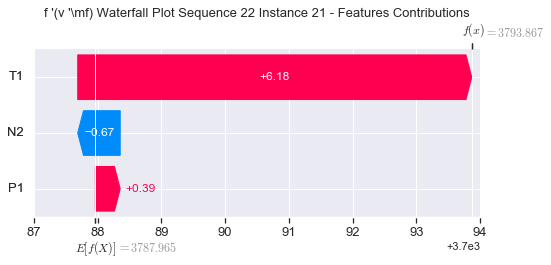

None

Contribution: [ 1.04276317  9.81390168 -1.09234147]


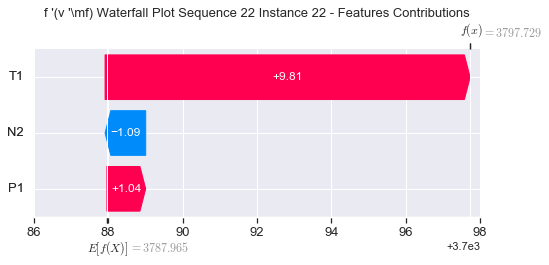

None

Contribution: [-0.34521429 -9.7212024   4.93298737]


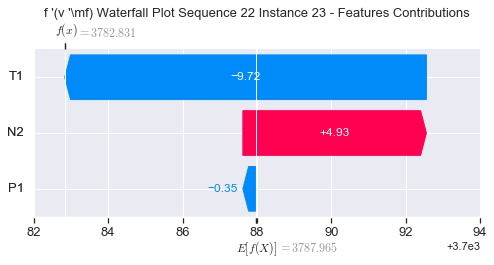

None

Contribution: [ -5.04810651 -39.05543265  16.53344715]


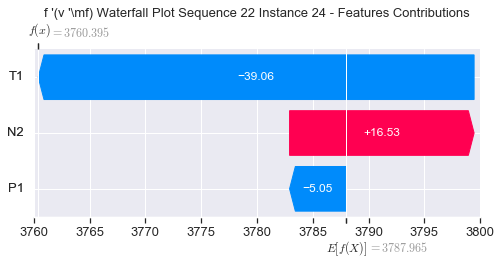

None

Contribution: [ 7.92347385 -0.92992714 38.33864799]


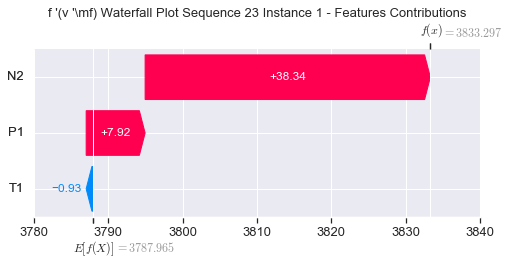

None

Contribution: [ 0.09323747 -0.82898539  0.34965298]


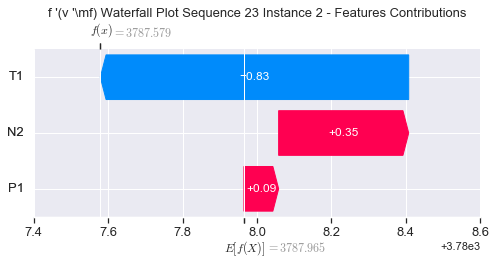

None

Contribution: [-0.04187031 -0.00969074  0.14457214]


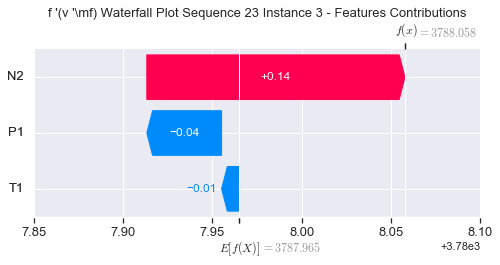

None

Contribution: [-0.08727735  0.0258131   0.30842407]


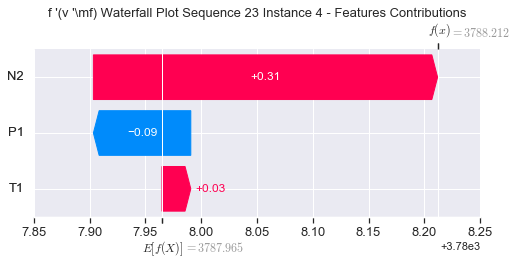

None

Contribution: [-8.56127223e-02  1.74035939e-04  2.39839333e-01]


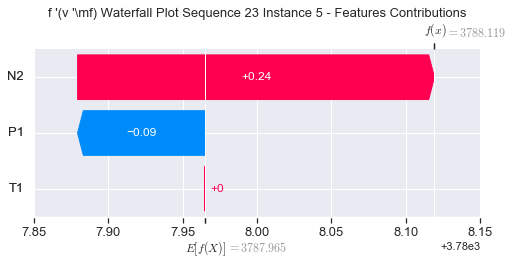

None

Contribution: [-0.01812642  0.19581916  0.19791316]


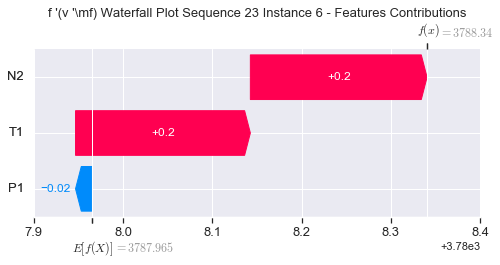

None

Contribution: [0.00434187 0.22103787 0.21645997]


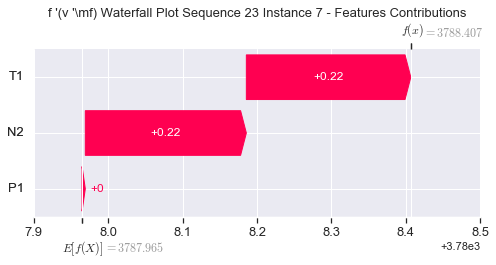

None

Contribution: [0.01139377 0.23809283 0.21980712]


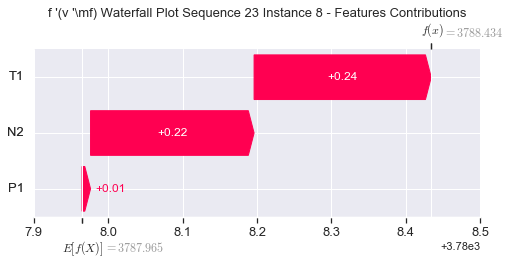

None

Contribution: [0.00875735 0.25749298 0.21201802]


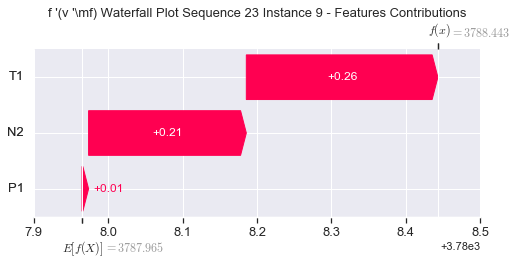

None

Contribution: [0.0019542  0.26288249 0.20056952]


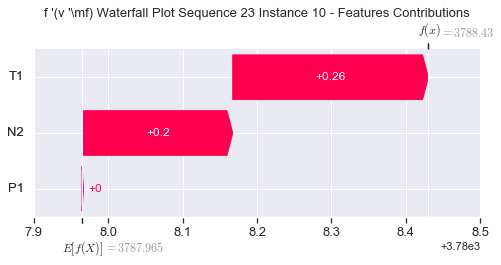

None

Contribution: [-0.00112123  0.25966405  0.20206156]


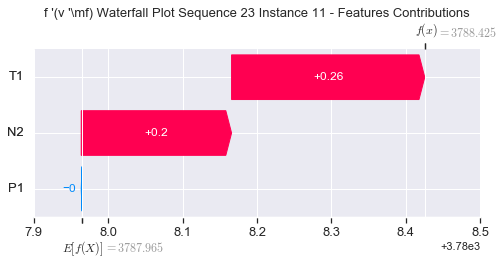

None

Contribution: [0.01689784 0.22076373 0.20004158]


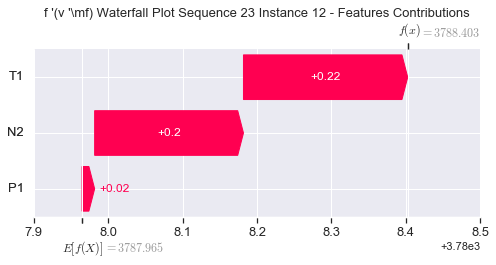

None

Contribution: [0.01864692 0.20834858 0.19247722]


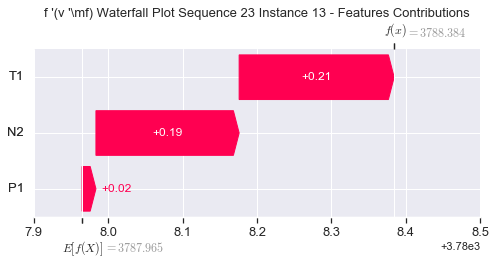

None

Contribution: [0.01638693 0.15628353 0.18406622]


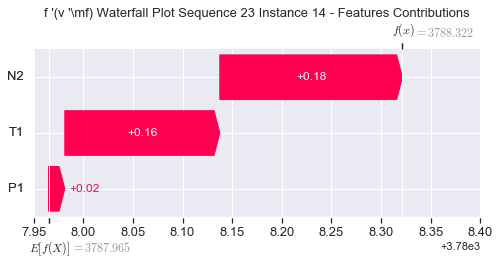

None

Contribution: [0.01252647 0.15411741 0.17827365]


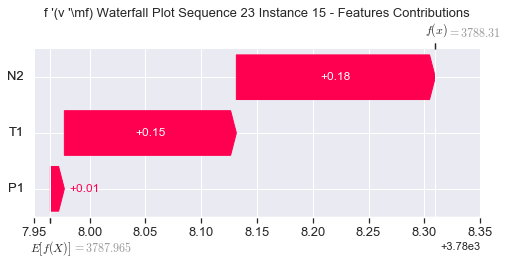

None

Contribution: [-0.0266975   0.35694801  0.16192363]


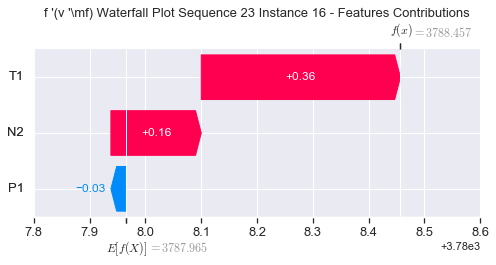

None

Contribution: [0.05158099 0.60334018 0.14404248]


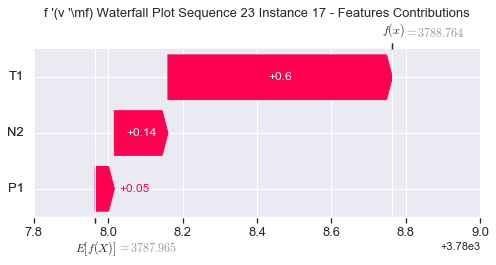

None

Contribution: [0.03727067 0.0215786  0.15654151]


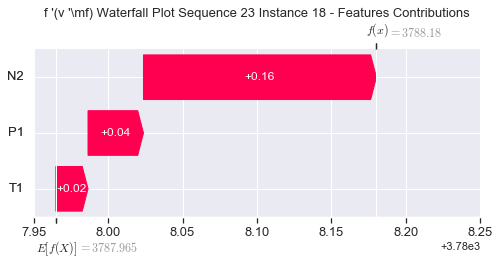

None

Contribution: [-0.03650294 -1.65412899  0.21280976]


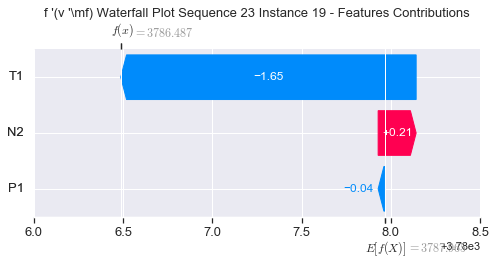

None

Contribution: [-0.09699976 -0.73953735  0.15417938]


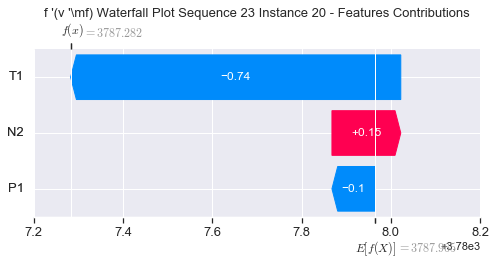

None

Contribution: [ 0.32682468  6.64685183 -0.74482429]


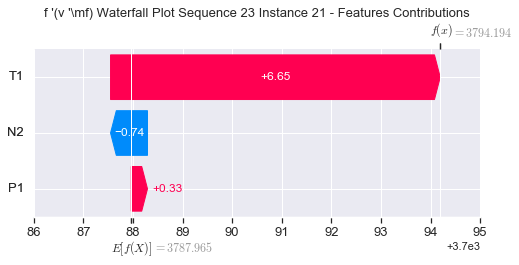

None

Contribution: [ 0.84362065 10.85878395 -1.14781041]


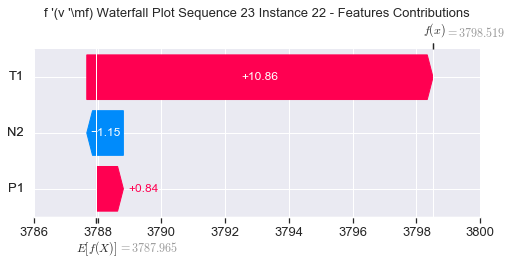

None

Contribution: [ -0.29920781 -11.07885979   5.07546274]


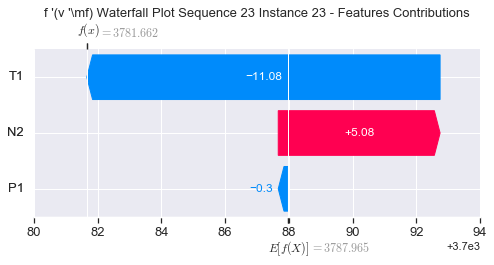

None

Contribution: [ -6.4187649  -42.9734345   16.90731015]


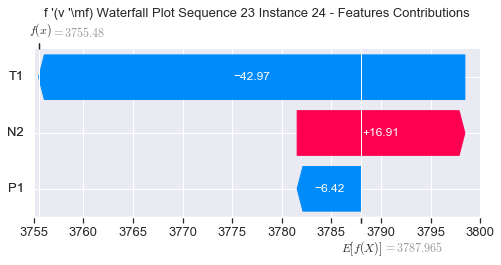

None

Contribution: [23.35770187  1.37086281 40.33772556]


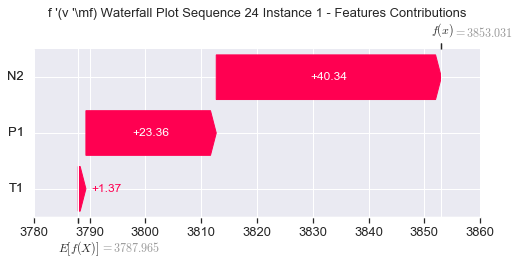

None

Contribution: [ 0.07073477 -0.9982331   0.34073996]


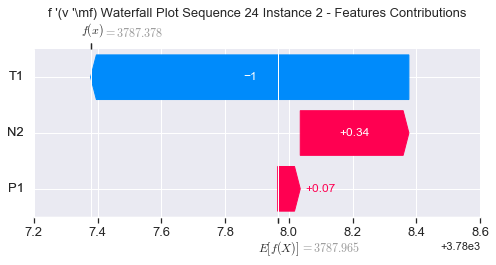

None

Contribution: [-0.03750201  0.02007824  0.14731957]


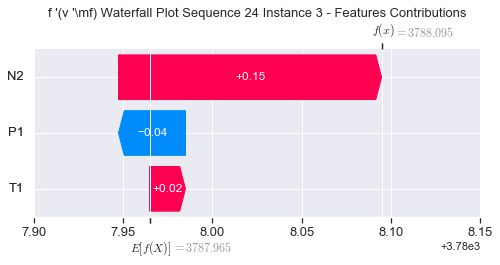

None

Contribution: [-0.10687906  0.03236958  0.31408669]


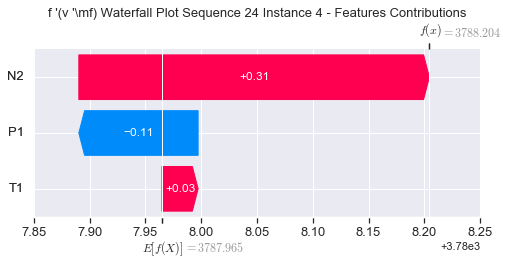

None

Contribution: [-0.08911961 -0.0056631   0.24169236]


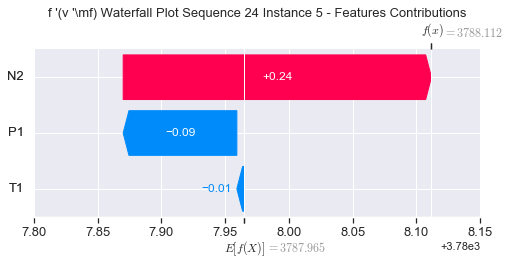

None

Contribution: [-0.01701875  0.21385949  0.19699045]


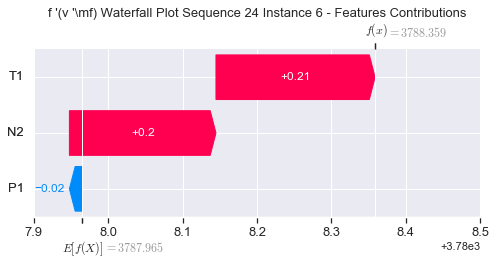

None

Contribution: [0.00653006 0.23962481 0.21541077]


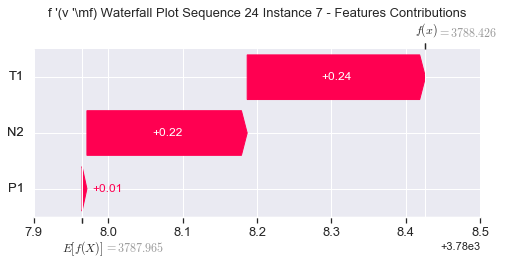

None

Contribution: [0.01348404 0.2544597  0.21908004]


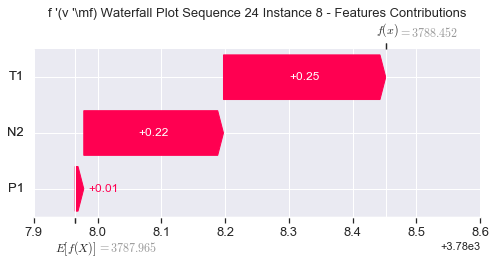

None

Contribution: [-0.00306734  0.28040811  0.21358872]


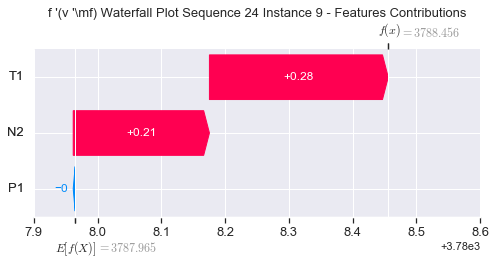

None

Contribution: [-0.00962672  0.3072854   0.20054307]


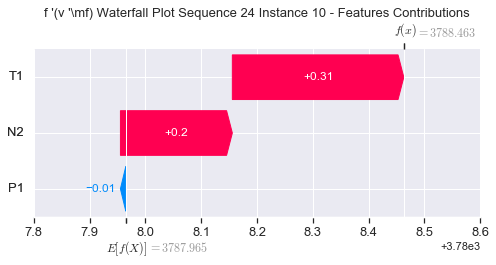

None

Contribution: [-0.00996075  0.28638991  0.20332973]


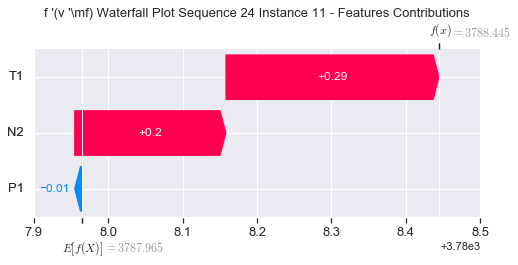

None

Contribution: [0.03002789 0.24008197 0.19947534]


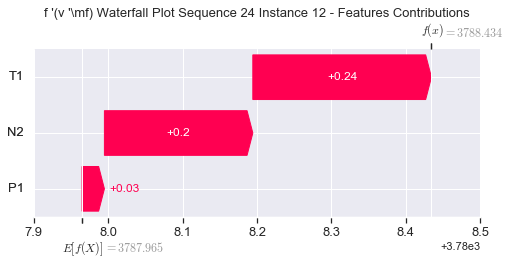

None

Contribution: [0.03061926 0.2216373  0.19214091]


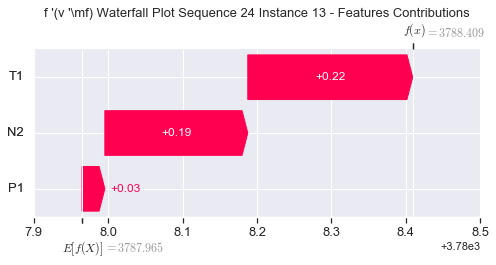

None

Contribution: [0.00935194 0.17960077 0.18479439]


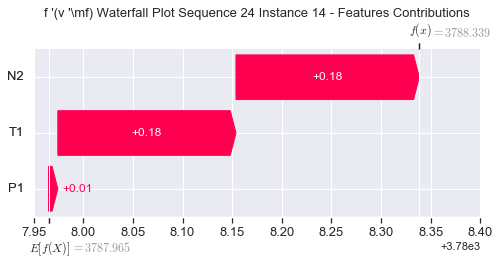

None

Contribution: [0.02409128 0.16013016 0.17829416]


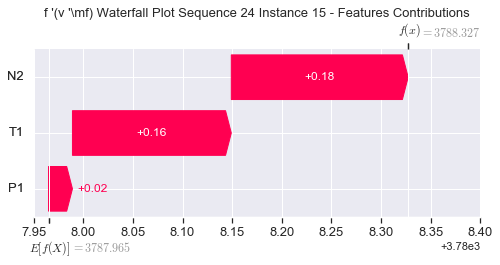

None

Contribution: [-0.02020672  0.40201974  0.16297961]


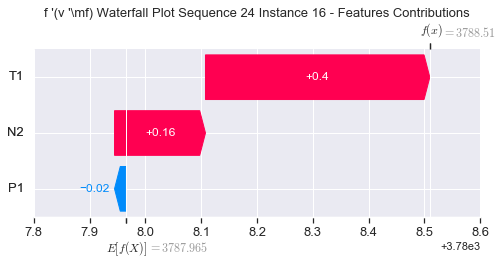

None

Contribution: [0.0681973  0.59006264 0.13995153]


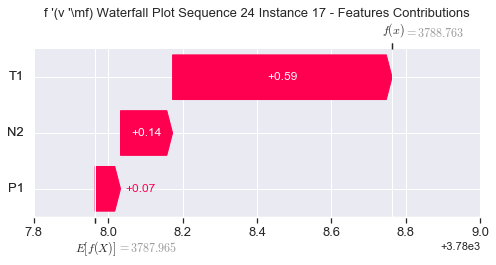

None

Contribution: [0.04861584 0.01132855 0.15889365]


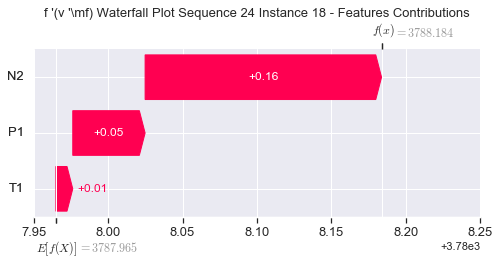

None

Contribution: [-0.0355234  -1.43748414  0.31173993]


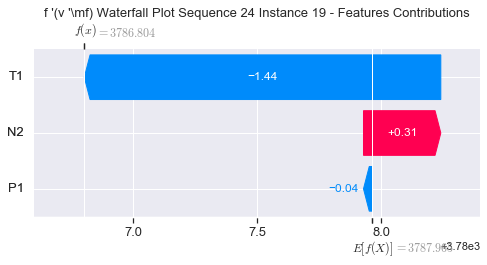

None

Contribution: [-0.12411177 -0.60212839  0.15999084]


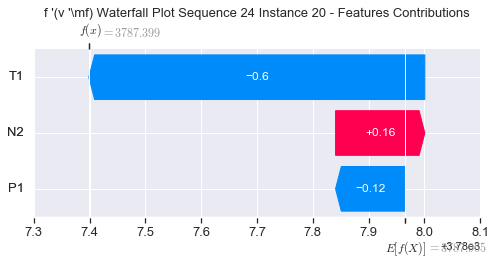

None

Contribution: [ 0.43981984  5.62360559 -0.79861375]


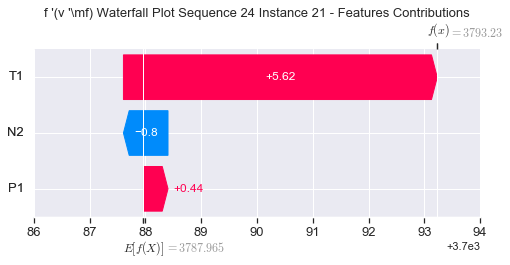

None

Contribution: [ 1.2882849   8.89065122 -1.22998932]


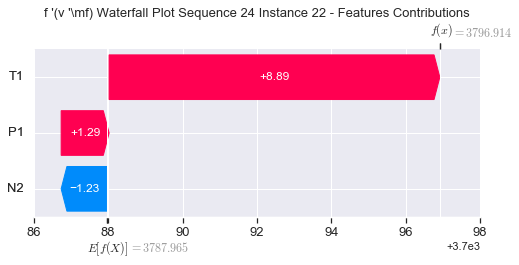

None

Contribution: [-0.38962356 -8.6105731   5.24195994]


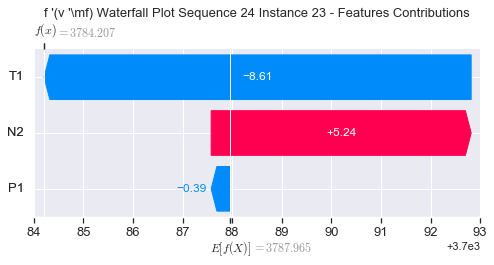

None

Contribution: [ -6.61248412 -31.78463685  16.82940065]


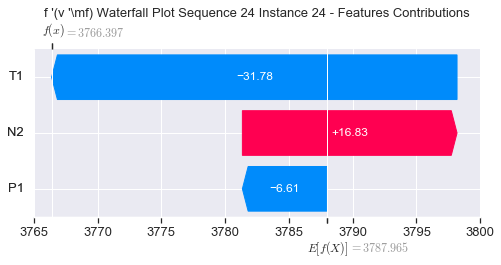

None

Contribution: [16.60817036  4.56590145 37.77736825]


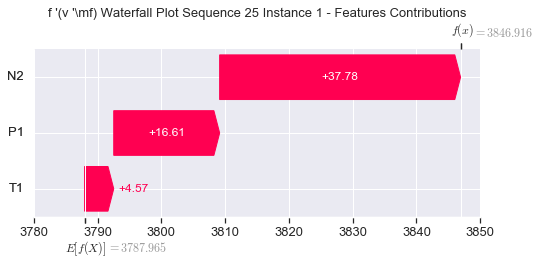

None

Contribution: [ 0.12327893 -0.68773329  0.34610948]


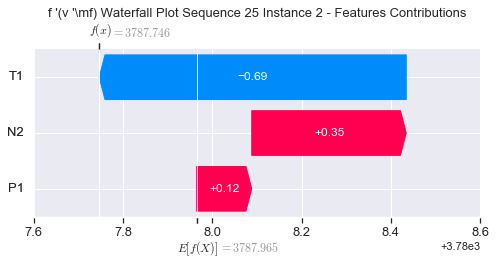

None

Contribution: [-0.03423004  0.03017093  0.14829999]


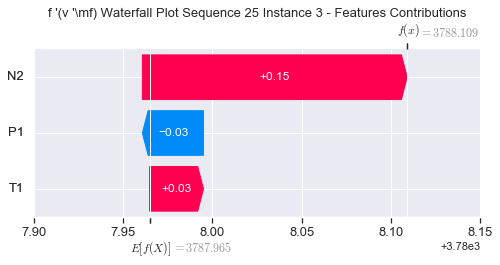

None

Contribution: [-0.09190217  0.03690532  0.31060554]


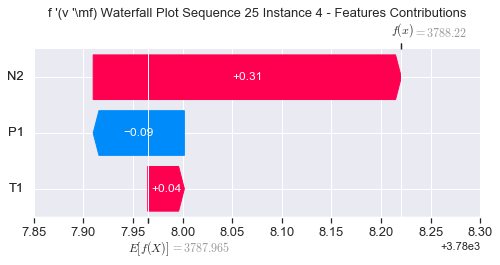

None

Contribution: [-0.08335687  0.01369315  0.23914721]


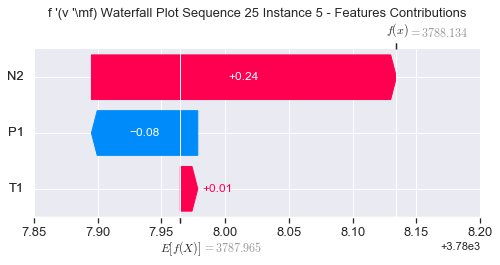

None

Contribution: [-0.02289607  0.19037081  0.19813758]


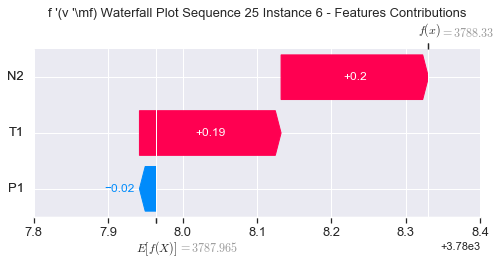

None

Contribution: [-0.00597937  0.21713986  0.21592937]


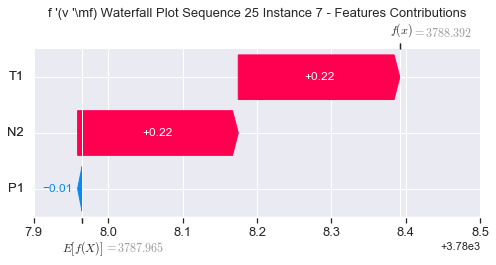

None

Contribution: [0.00227729 0.2267575  0.21880446]


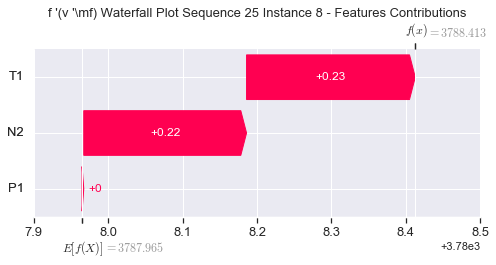

None

Contribution: [0.00653576 0.24753173 0.20970493]


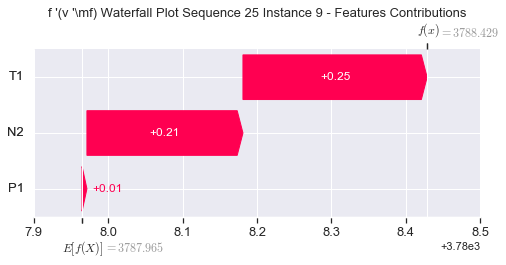

None

Contribution: [-0.06187214  0.28603509  0.20244286]


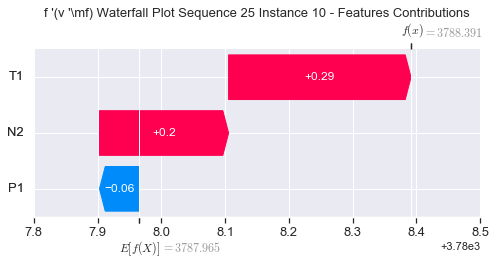

None

Contribution: [0.00701334 0.22728156 0.19941926]


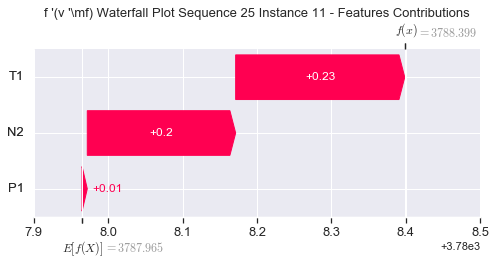

None

Contribution: [0.0089896  0.20874736 0.19920874]


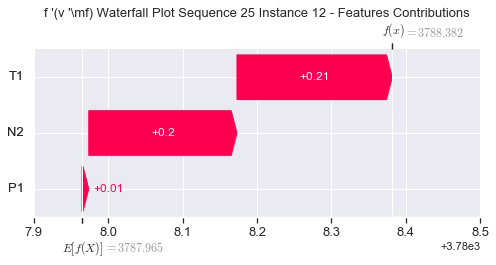

None

Contribution: [0.00953154 0.19793792 0.19175005]


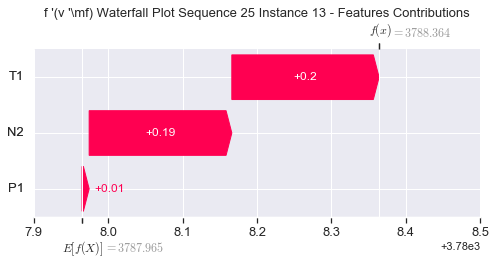

None

Contribution: [0.01701863 0.1610637  0.18423007]


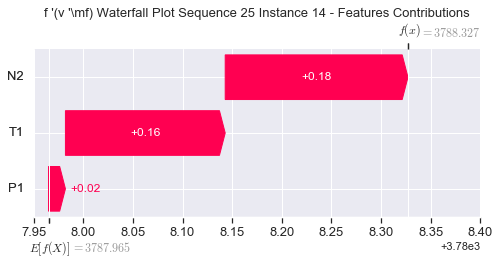

None

Contribution: [0.00666787 0.14457308 0.17858775]


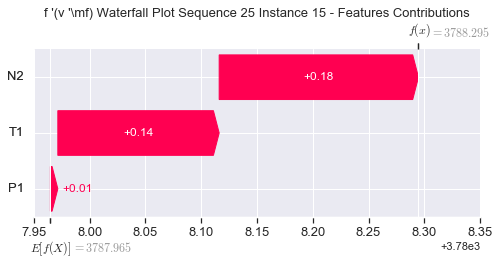

None

Contribution: [-0.05161462  0.37706123  0.16374995]


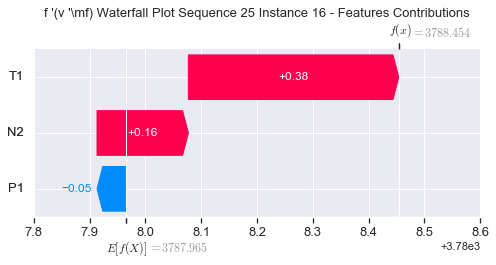

None

Contribution: [0.03080109 0.55537074 0.1421569 ]


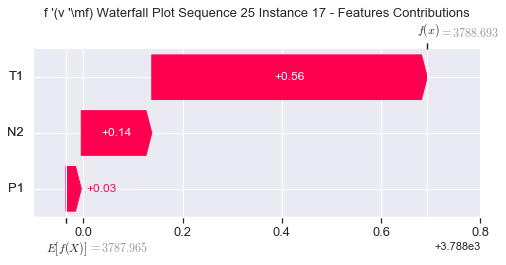

None

Contribution: [0.02298314 0.00764881 0.1580508 ]


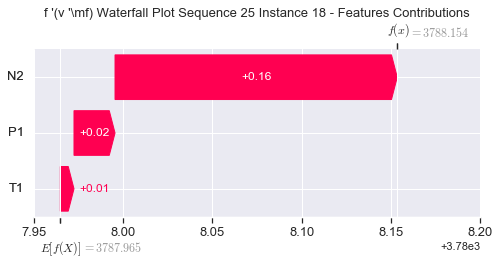

None

Contribution: [-0.06747117 -1.40844235  0.27807186]


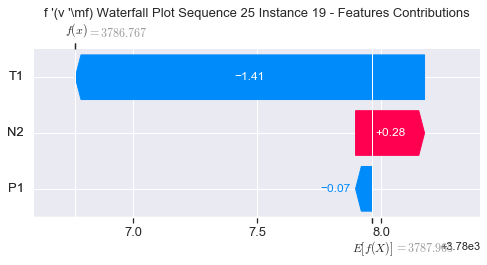

None

Contribution: [-0.06960181 -0.58176496  0.15834308]


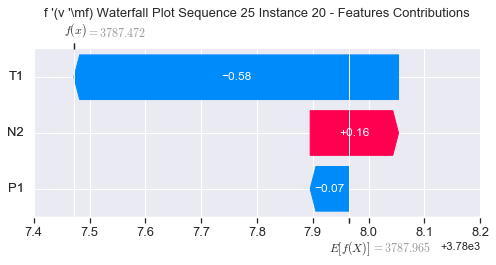

None

Contribution: [ 0.2844178   5.36338276 -0.78984779]


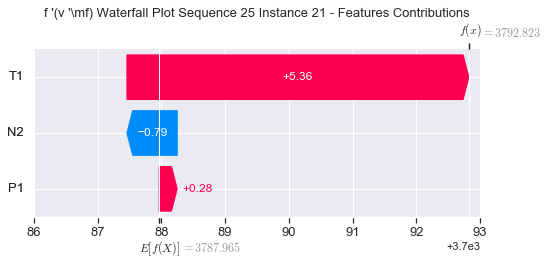

None

Contribution: [ 0.8945327   8.15677761 -1.23510612]


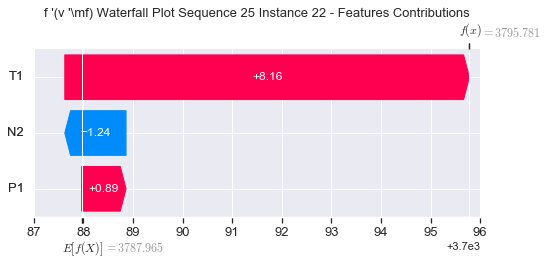

None

Contribution: [-0.28829255 -7.91914331  5.2762475 ]


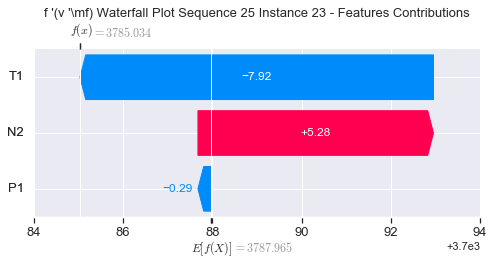

None

Contribution: [ -5.23759491 -28.65548346  17.34043752]


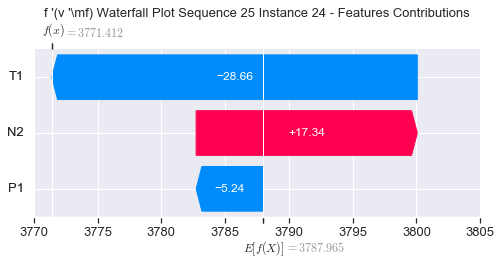

None

Contribution: [14.78607658  6.66235359 41.37881003]


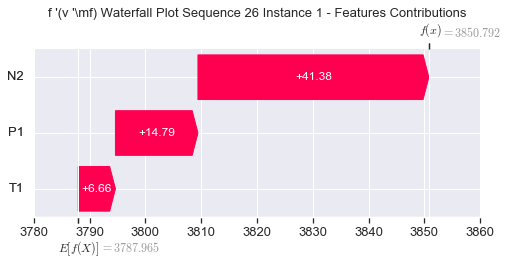

None

Contribution: [ 0.09700636 -0.51261561  0.35129401]


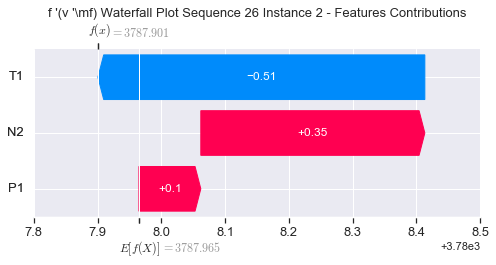

None

Contribution: [-0.03569253  0.0535768   0.14962252]


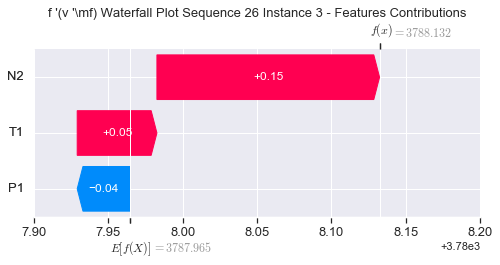

None

Contribution: [-0.09953868  0.05857897  0.31368891]


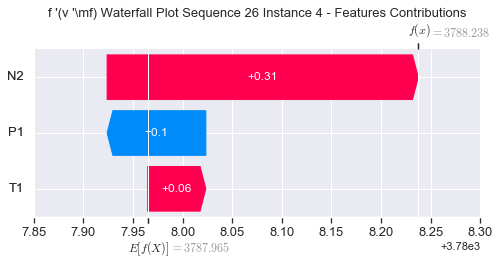

None

Contribution: [-0.0867931   0.02567057  0.24071646]


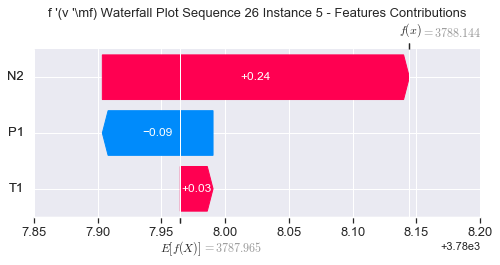

None

Contribution: [-0.02248812  0.17361379  0.19540059]


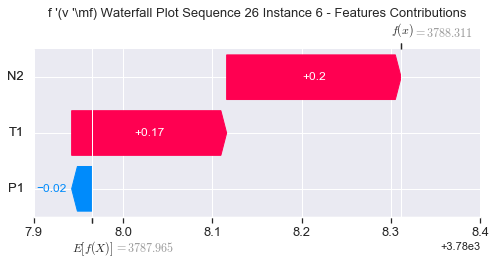

None

Contribution: [-0.00418367  0.19399704  0.21348922]


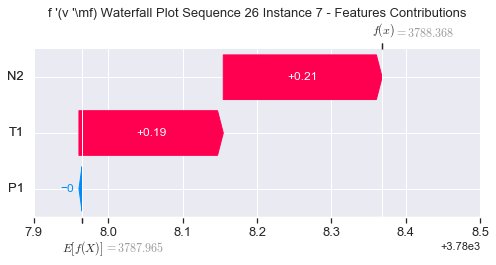

None

Contribution: [0.00375079 0.20697552 0.21642421]


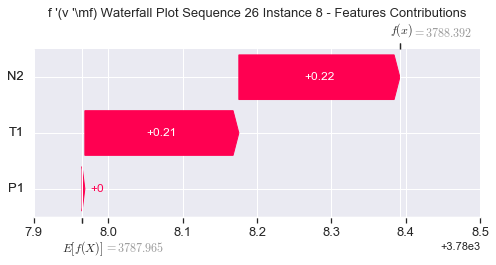

None

Contribution: [-0.00169485  0.2246404   0.2101091 ]


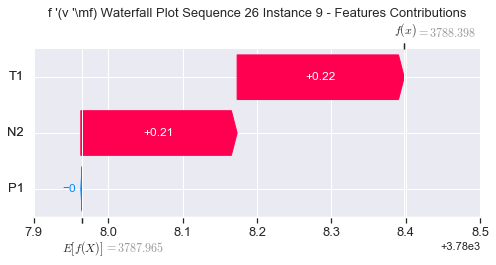

None

Contribution: [-0.02304067  0.23065589  0.19778117]


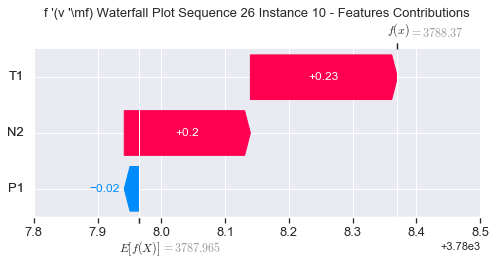

None

Contribution: [0.00263628 0.22380255 0.19994527]


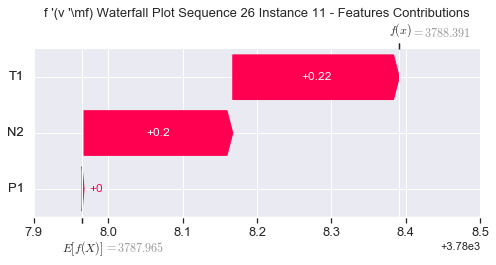

None

Contribution: [0.03537479 0.19646119 0.19752481]


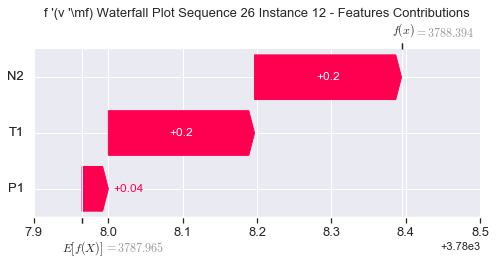

None

Contribution: [0.0322844  0.18312867 0.19079636]


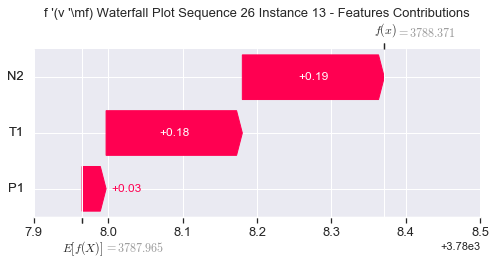

None

Contribution: [0.01601402 0.1452086  0.18364962]


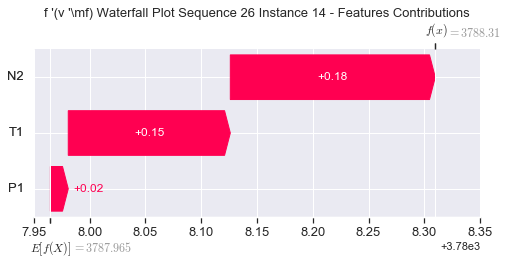

None

Contribution: [0.0174762  0.14192701 0.17704195]


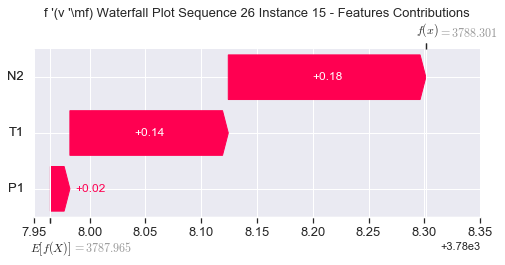

None

Contribution: [-0.00689141  0.29412711  0.15613998]


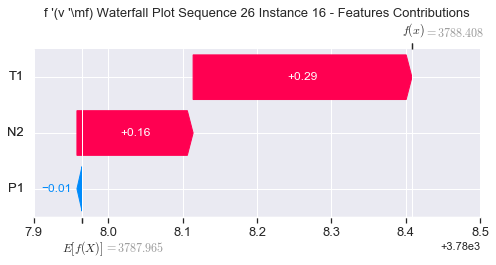

None

Contribution: [0.04388138 0.53296834 0.14015116]


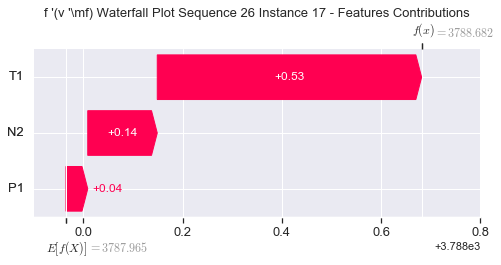

None

Contribution: [0.02680002 0.00528512 0.15833474]


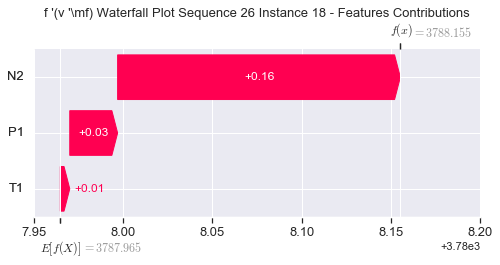

None

Contribution: [-0.03061755 -1.31901299  0.25552939]


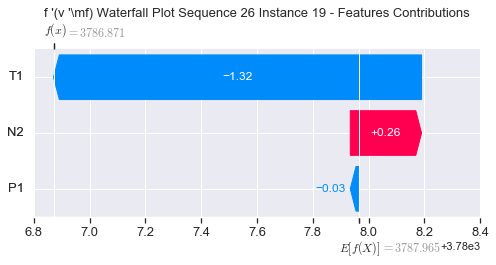

None

Contribution: [-0.0554017  -0.58421442  0.15680564]


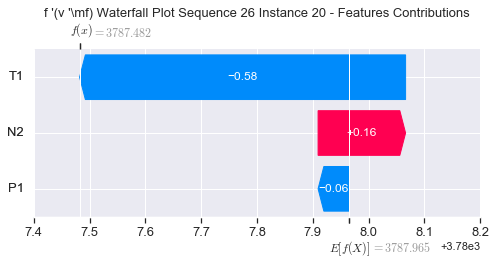

None

Contribution: [ 0.28498657  5.52538143 -0.77942926]


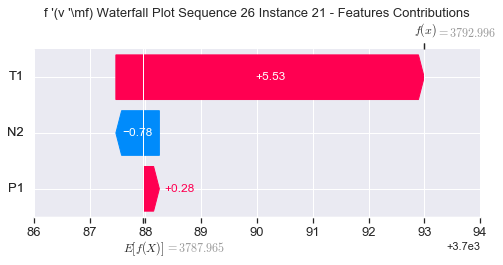

None

Contribution: [ 0.95476556  8.80660747 -1.21819007]


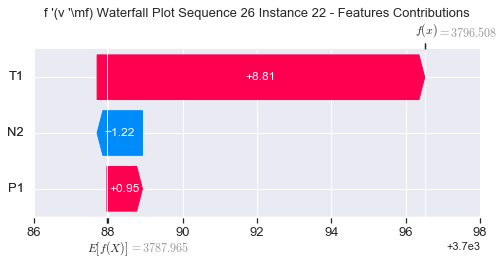

None

Contribution: [-0.28001094 -8.71879848  5.20454164]


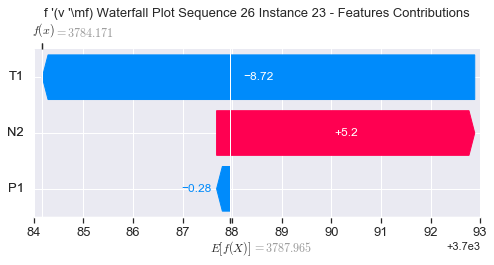

None

Contribution: [ -4.41504053 -33.01896992  16.59545999]


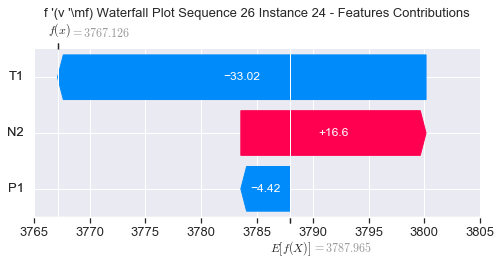

None

Contribution: [12.54690148  3.48709173 37.0711283 ]


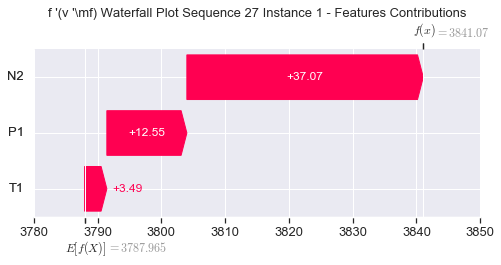

None

Contribution: [ 0.14034153 -0.70503691  0.35422116]


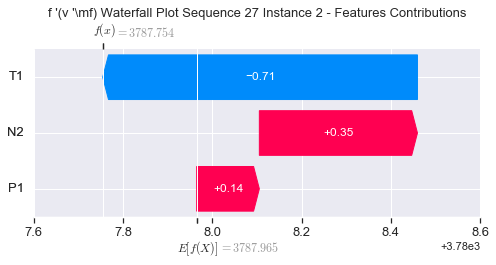

None

Contribution: [-0.03536656  0.02277664  0.14878604]


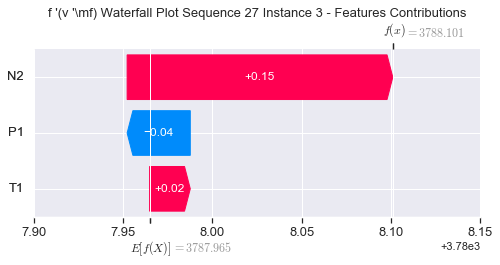

None

Contribution: [-0.10075146  0.051306    0.31180077]


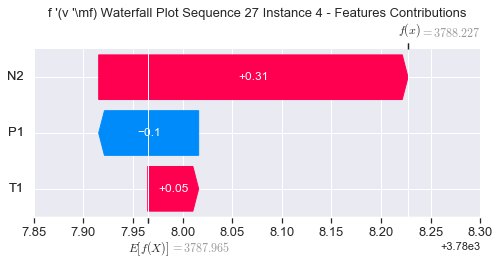

None

Contribution: [-0.07833699  0.00377842  0.23821644]


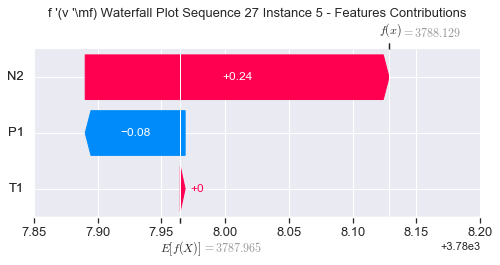

None

Contribution: [-0.02118318  0.18809421  0.19711843]


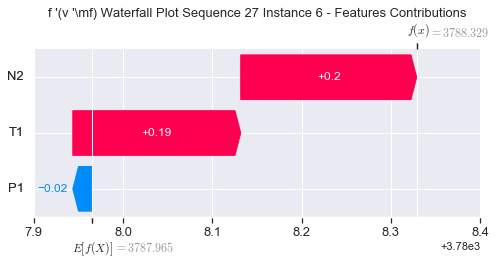

None

Contribution: [-0.00308722  0.20958494  0.21554528]


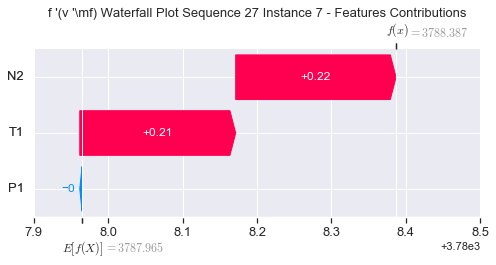

None

Contribution: [0.00224395 0.22460551 0.21880168]


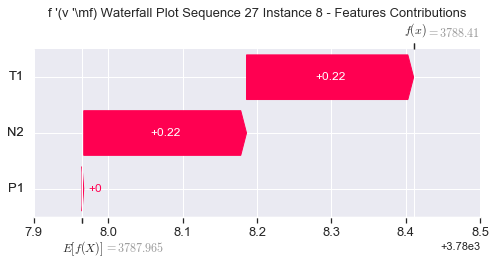

None

Contribution: [-0.01271381  0.23873098  0.2131241 ]


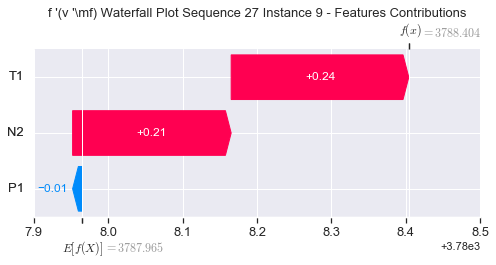

None

Contribution: [-0.0335925   0.25091133  0.20180107]


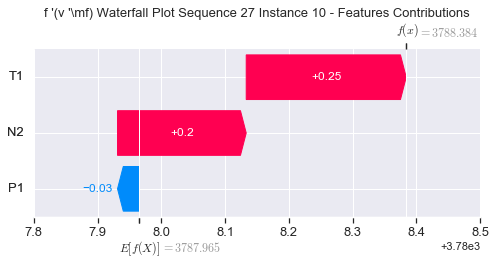

None

Contribution: [-0.01956426  0.25397228  0.20268863]


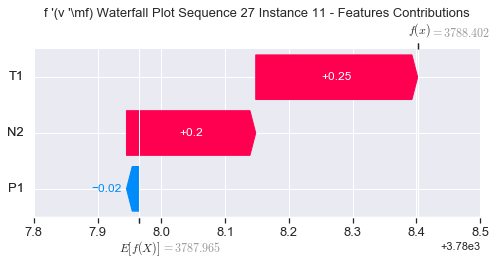

None

Contribution: [-0.0073933   0.22386897  0.20095173]


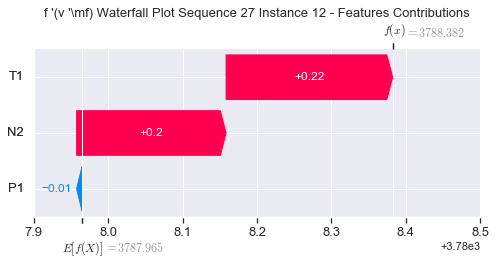

None

Contribution: [-0.00562836  0.20441692  0.19363775]


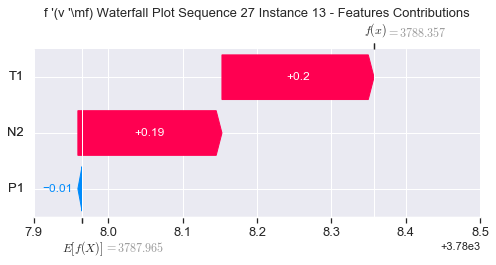

None

Contribution: [-0.00678063  0.15102647  0.18477121]


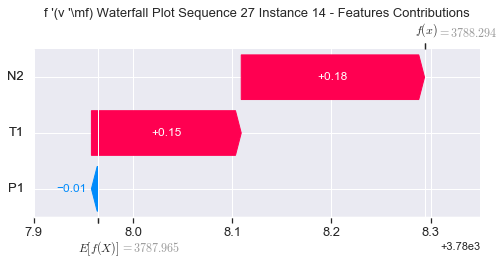

None

Contribution: [-0.00406108  0.14858328  0.17801243]


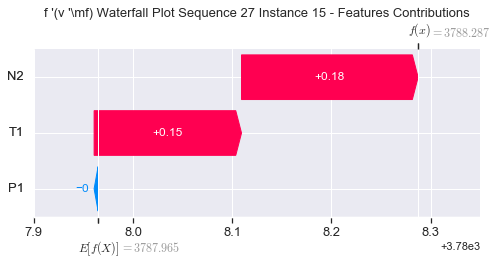

None

Contribution: [-0.0062215   0.29928665  0.15976402]


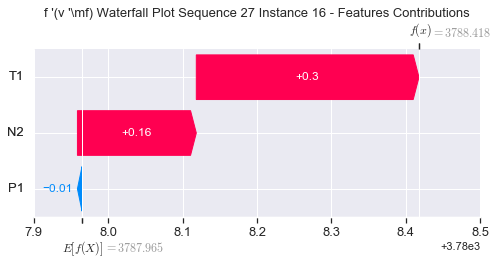

None

Contribution: [0.02211805 0.52362433 0.14936789]


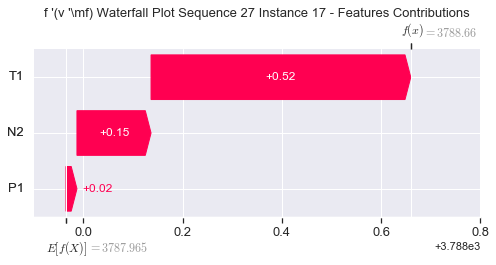

None

Contribution: [0.02111902 0.00490773 0.15479656]


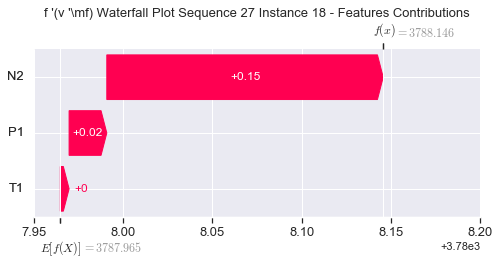

None

Contribution: [-0.01854134 -1.33565332  0.21428826]


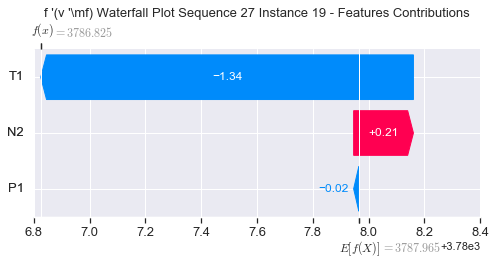

None

Contribution: [-0.06371232 -0.51662179  0.15318015]


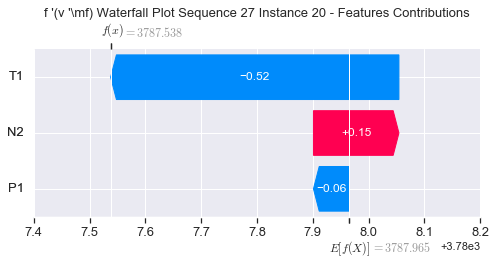

None

Contribution: [ 0.20220697  5.14819746 -0.67500332]


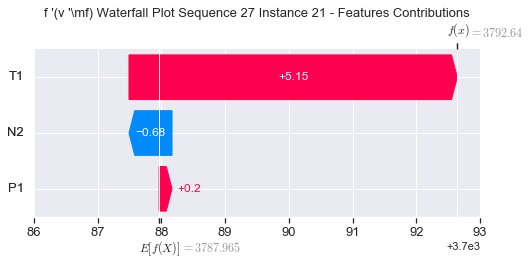

None

Contribution: [ 0.45653438  8.37359903 -1.04419984]


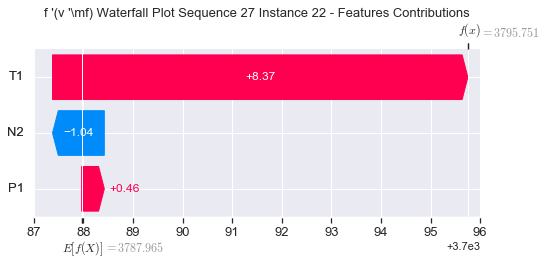

None

Contribution: [-0.22314534 -7.91985875  4.9593542 ]


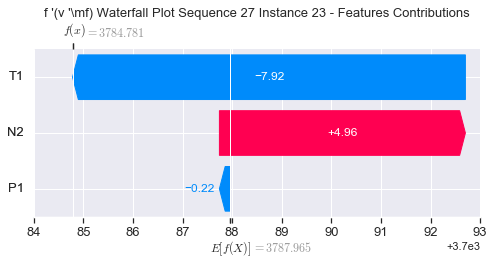

None

Contribution: [ -4.01609434 -28.13826336  16.24187559]


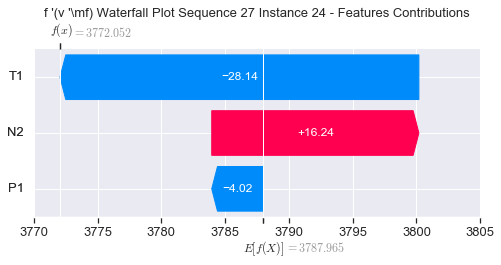

None

Contribution: [ 8.67101013  6.68906293 35.96120326]


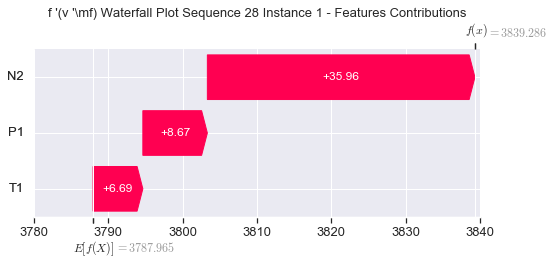

None

Contribution: [ 0.01584825 -0.7108004   0.31086011]


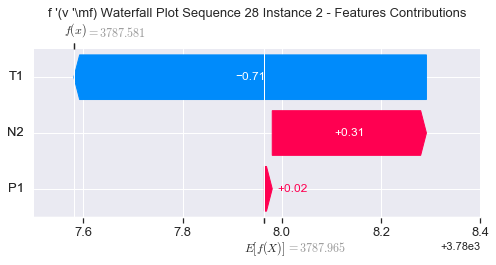

None

Contribution: [-0.04863415  0.03794963  0.14315368]


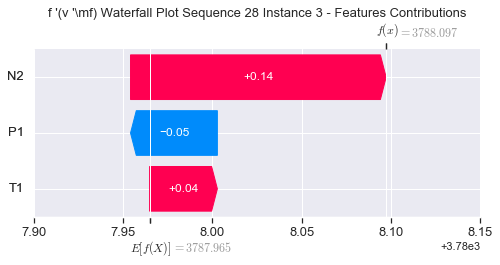

None

Contribution: [-0.10124164  0.05828742  0.31259673]


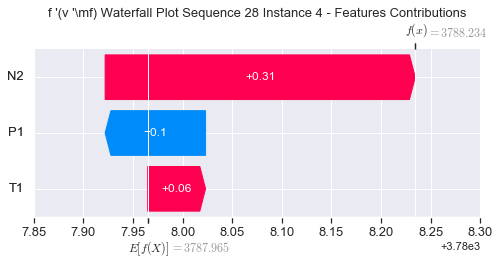

None

Contribution: [-0.09413489  0.02085381  0.24080583]


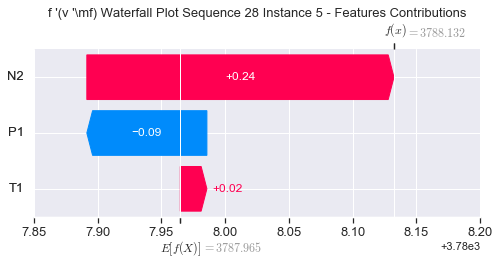

None

Contribution: [-0.01762047  0.15347697  0.20152604]


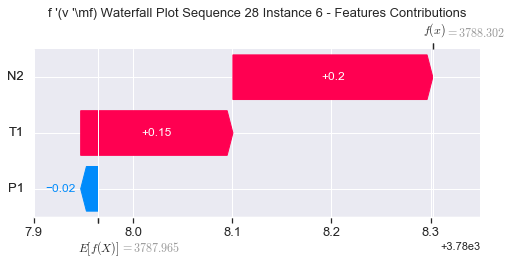

None

Contribution: [-0.00320584  0.15856296  0.21825026]


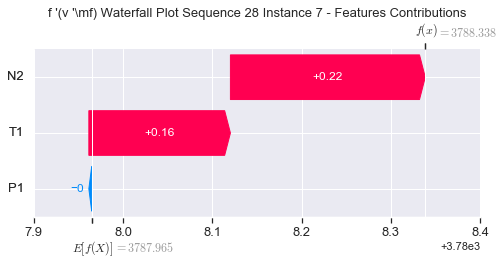

None

Contribution: [0.01433339 0.18857632 0.22006135]


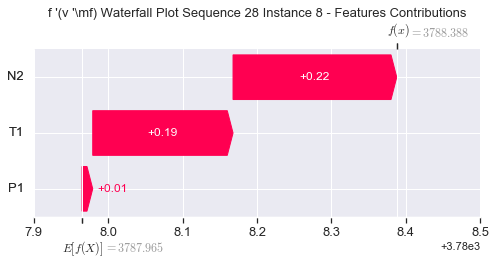

None

Contribution: [0.00076415 0.15465894 0.20931391]


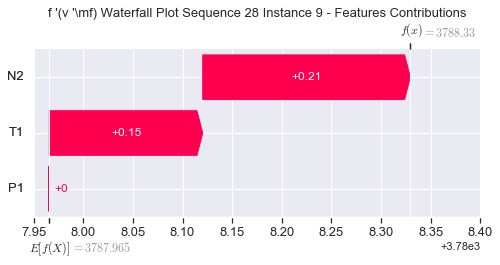

None

Contribution: [0.01673851 0.16579188 0.19817724]


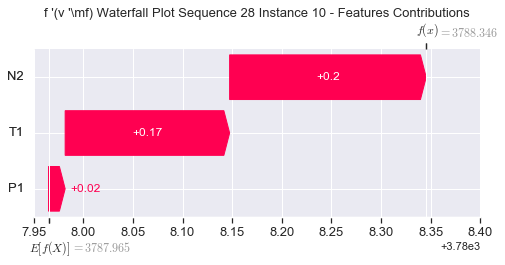

None

Contribution: [0.03679402 0.21954632 0.20089701]


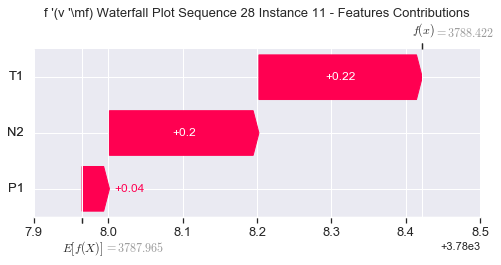

None

Contribution: [0.03155206 0.21297853 0.20113574]


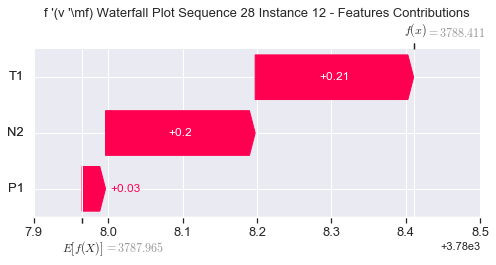

None

Contribution: [0.03055242 0.19551787 0.19497901]


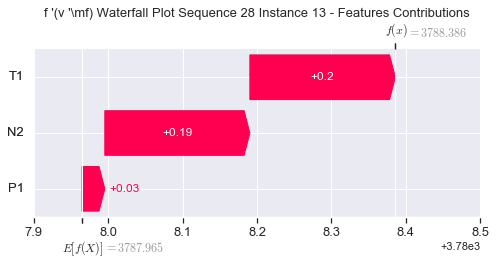

None

Contribution: [-0.00571169  0.16576923  0.18720484]


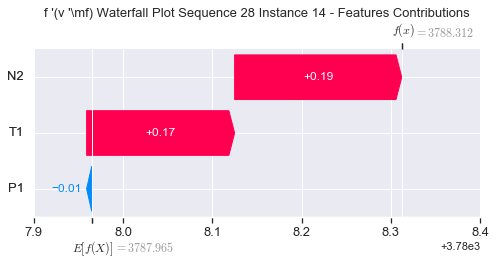

None

Contribution: [0.02877137 0.16289353 0.17940574]


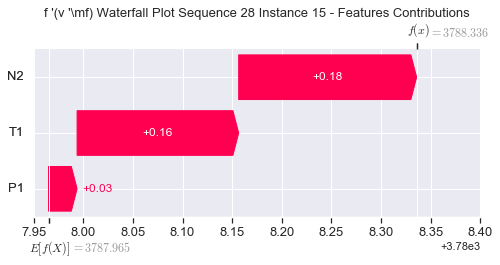

None

Contribution: [0.05096836 0.33427029 0.15739154]


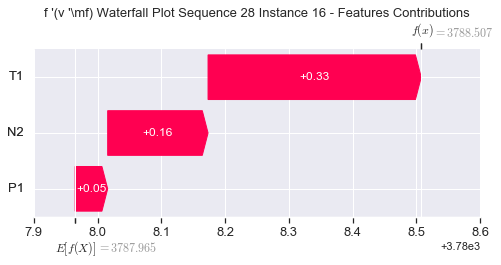

None

Contribution: [0.08219678 0.66049961 0.14412272]


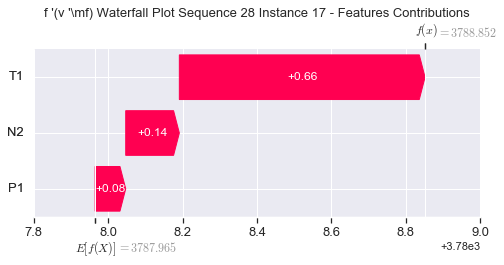

None

Contribution: [0.07368664 0.02808112 0.15996013]


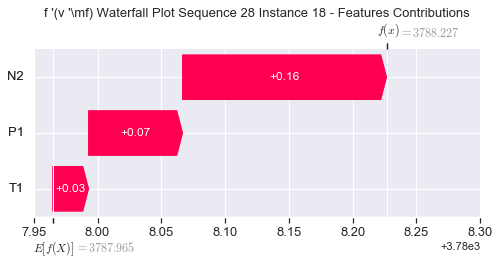

None

Contribution: [-0.03559503 -1.98833364  0.25367917]


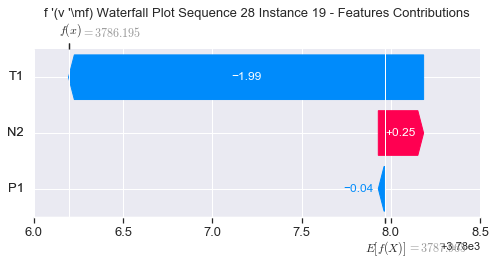

None

Contribution: [-0.23271032 -0.99644053  0.15239307]


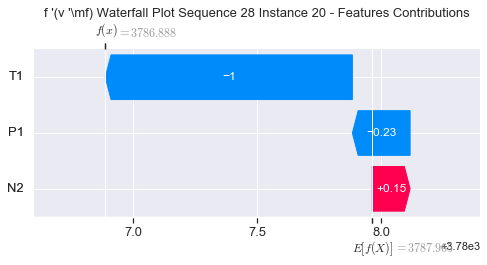

None

Contribution: [ 0.87955201  9.13598563 -0.84496268]


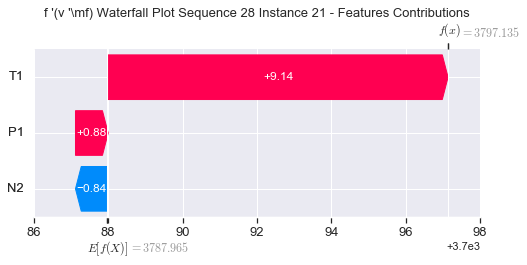

None

Contribution: [ 2.91651864 16.68898673 -1.24698584]


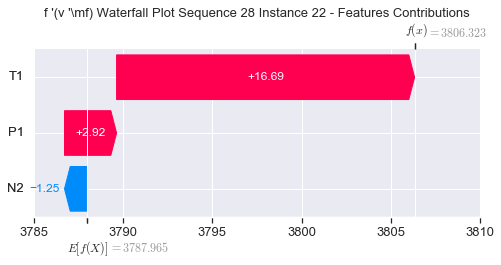

None

Contribution: [ -0.88410414 -17.82916515   5.32000666]


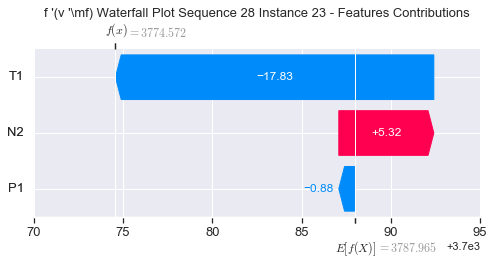

None

Contribution: [-20.38250316 -83.26344633  18.61745779]


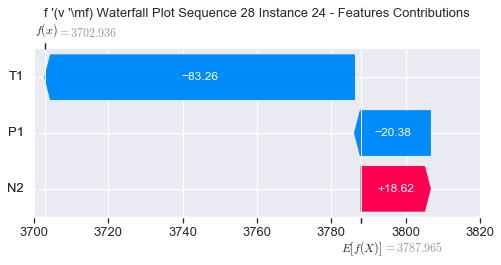

None

Contribution: [ 75.70527155 -27.54009043  51.30765564]


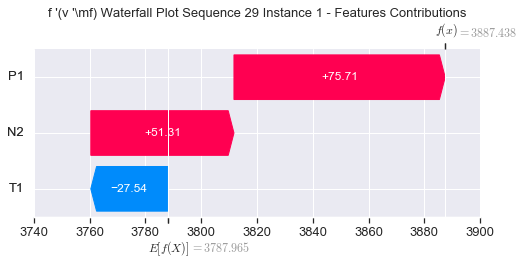

None

Contribution: [ 0.31708032 -2.39799448  0.37429155]


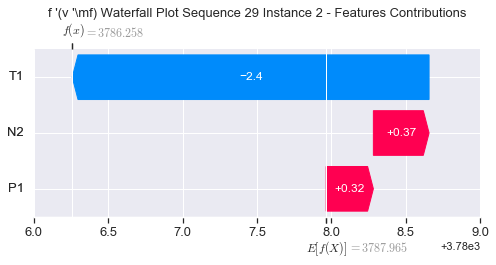

None

Contribution: [-0.02091005 -0.10290021  0.14711088]


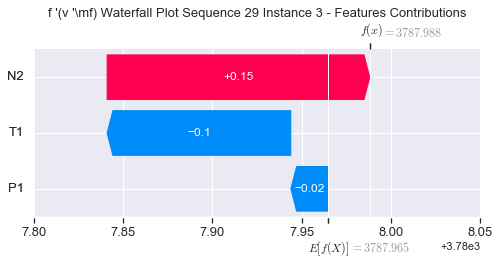

None

Contribution: [-0.14739134 -0.05724887  0.32954925]


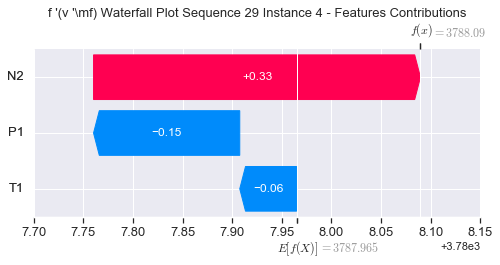

None

Contribution: [-0.12071988 -0.09903237  0.25419859]


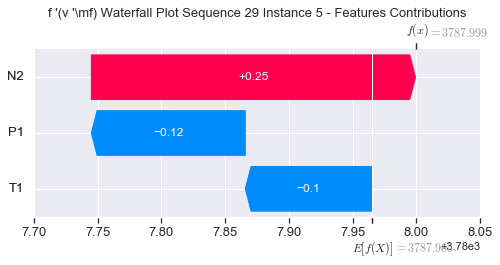

None

Contribution: [0.03783665 0.37732649 0.1981024 ]


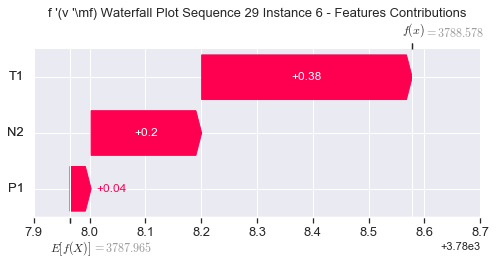

None

Contribution: [0.11053973 0.44450561 0.22281933]


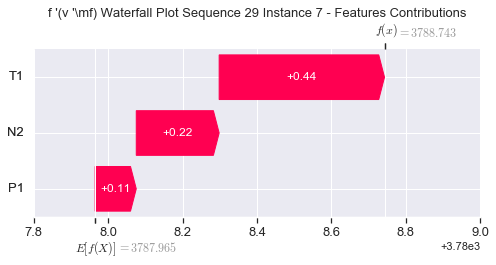

None

Contribution: [0.1293126  0.45102253 0.22771919]


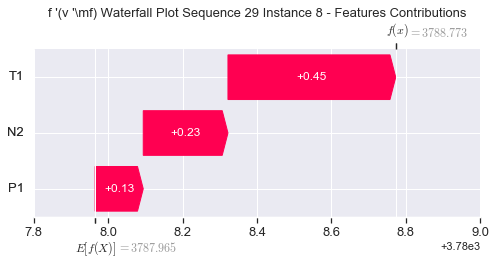

None

Contribution: [0.12971798 0.54356089 0.22025662]


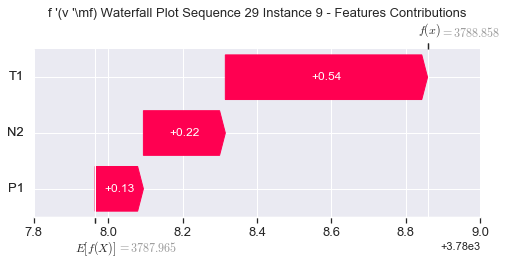

None

Contribution: [0.03262164 0.58074459 0.21075017]


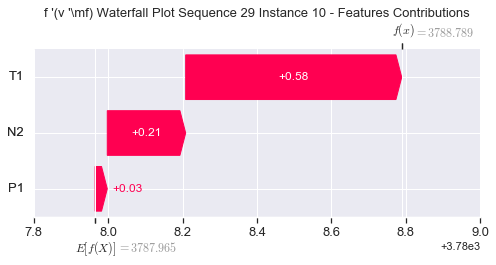

None

Contribution: [0.19141945 0.53398626 0.20232013]


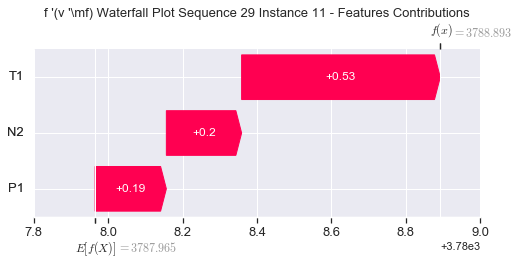

None

Contribution: [0.23821343 0.4559441  0.20102082]


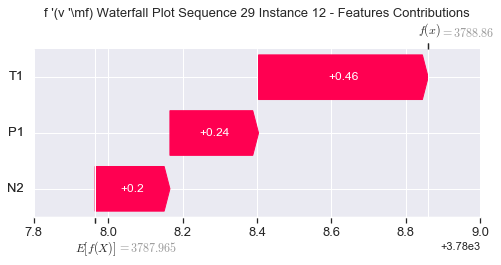

None

Contribution: [0.21435815 0.4325586  0.192521  ]


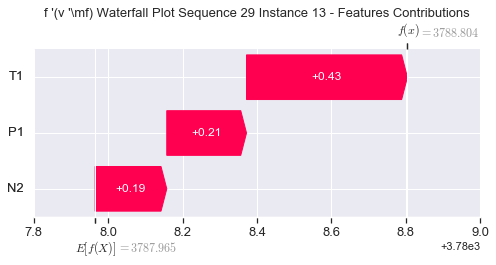

None

Contribution: [0.27579886 0.32738117 0.18533439]


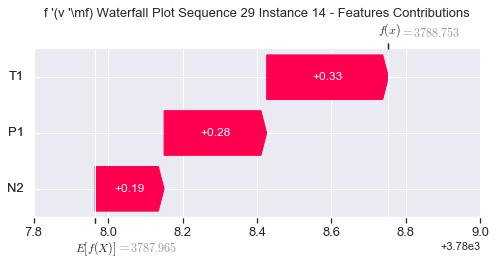

None

Contribution: [0.16545027 0.28083548 0.18095278]


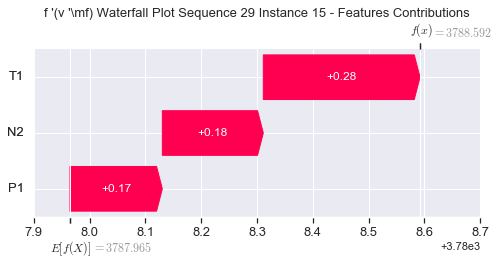

None

Contribution: [0.23422076 0.73447922 0.14344834]


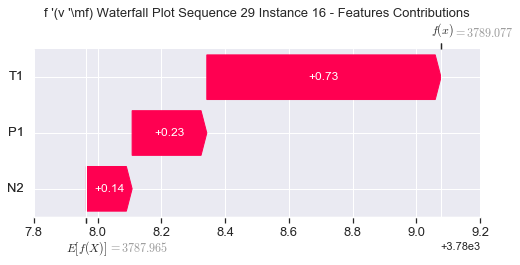

None

Contribution: [0.31310766 1.08237123 0.12613622]


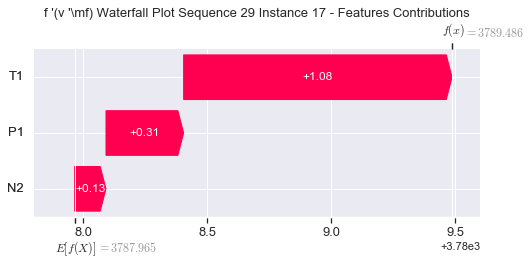

None

Contribution: [0.21287434 0.07933911 0.16730288]


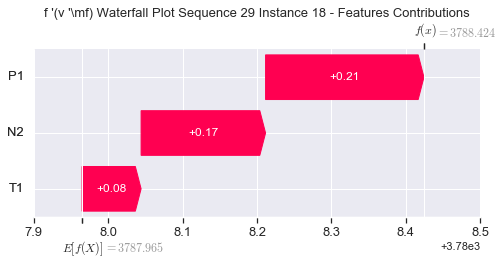

None

Contribution: [-0.12990484 -2.06929431  0.24906348]


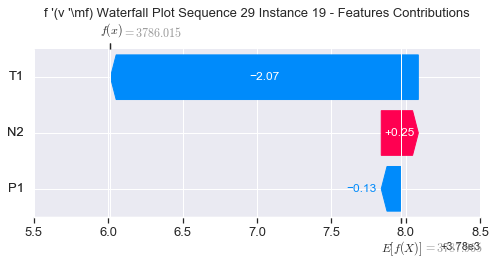

None

Contribution: [-0.26211823 -1.13848517  0.17314204]


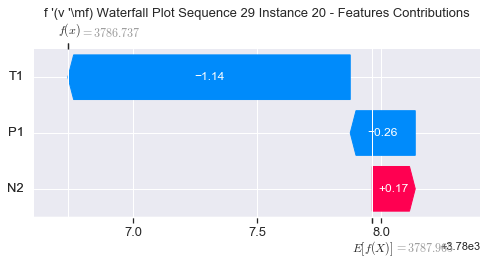

None

Contribution: [ 0.68241891  9.06900445 -0.84907457]


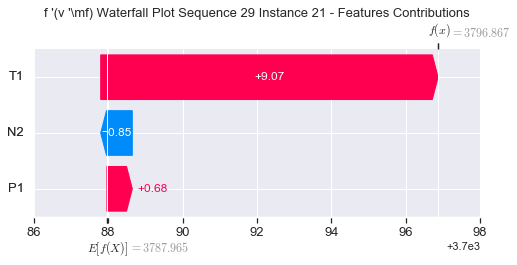

None

Contribution: [ 1.23968352 13.89068425 -1.27079129]


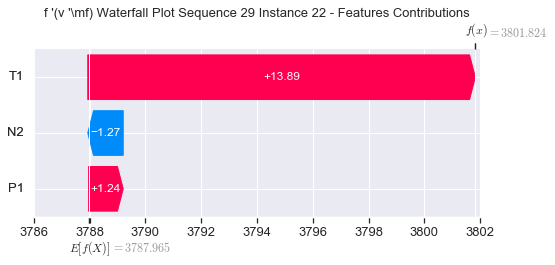

None

Contribution: [ -0.52255909 -14.41934071   5.46876961]


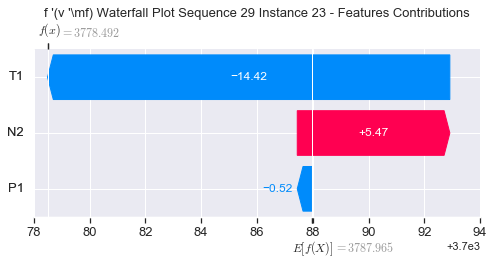

None

Contribution: [ -4.0492227  -45.63050263  17.49885115]


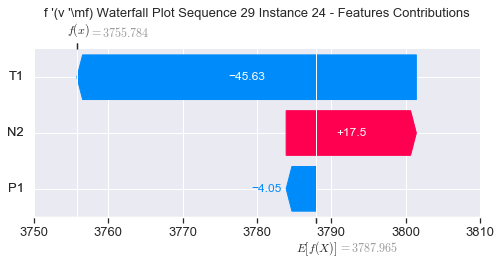

None

Contribution: [ 9.95988782  1.21764692 41.63002629]


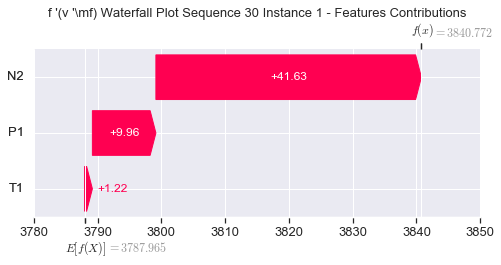

None

Contribution: [-0.00215503 -1.26263564  0.3298431 ]


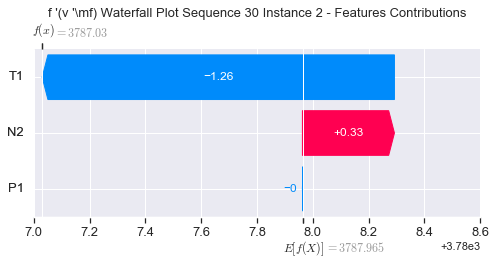

None

Contribution: [-0.04186847 -0.01118099  0.14559829]


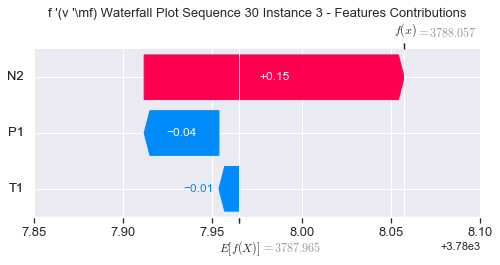

None

Contribution: [-0.07546446  0.0070684   0.30882825]


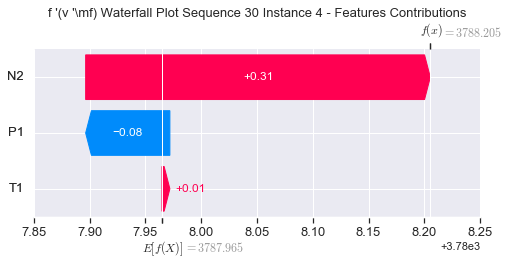

None

Contribution: [-0.08526098  0.01610317  0.23987924]


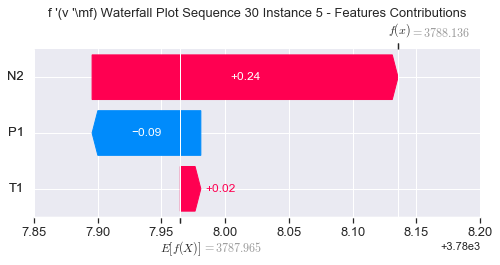

None

Contribution: [-0.02205565  0.1851606   0.195762  ]


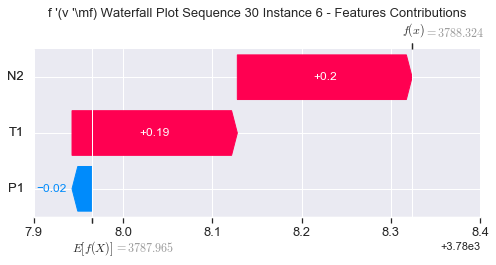

None

Contribution: [-0.00507103  0.2100452   0.21488462]


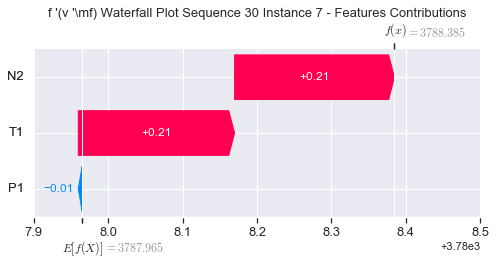

None

Contribution: [0.00158505 0.22254859 0.21799169]


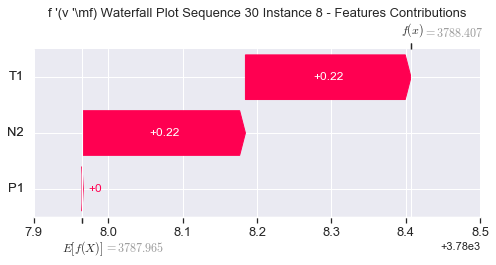

None

Contribution: [-0.00395858  0.22484405  0.21326982]


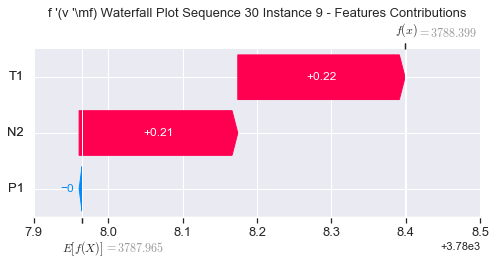

None

Contribution: [-0.01644643  0.24781077  0.19959196]


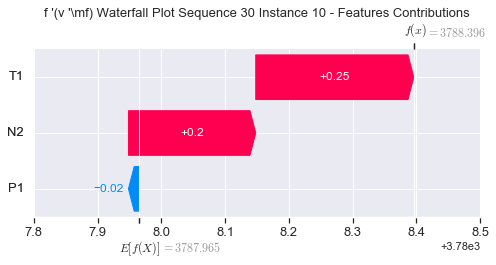

None

Contribution: [-0.0199045   0.23040434  0.20125115]


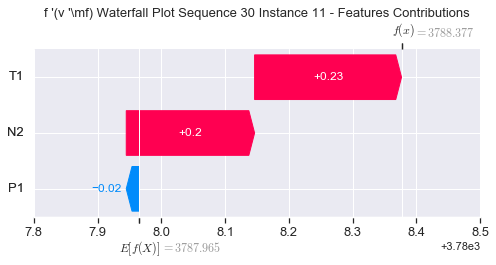

None

Contribution: [-0.01286186  0.22198705  0.19941082]


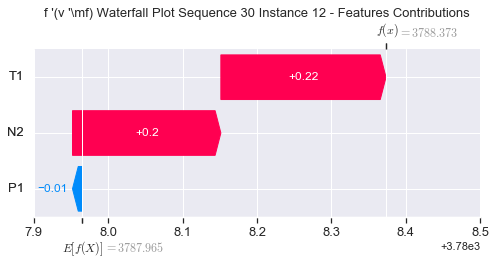

None

Contribution: [-0.008424    0.20735881  0.19268805]


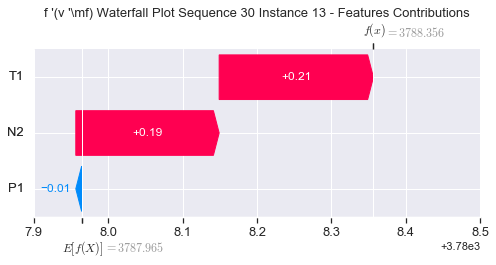

None

Contribution: [-0.0031917   0.18107934  0.18476991]


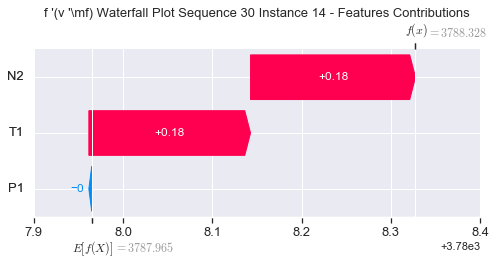

None

Contribution: [-0.00909996  0.15523658  0.17814922]


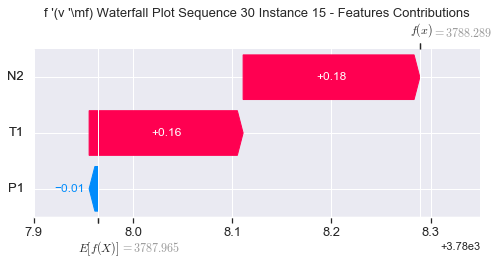

None

Contribution: [0.00149499 0.33429404 0.15540798]


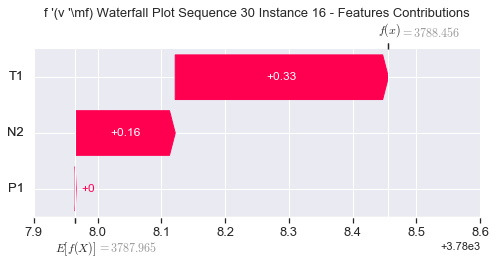

None

Contribution: [-0.0015537   0.5886493   0.14893972]


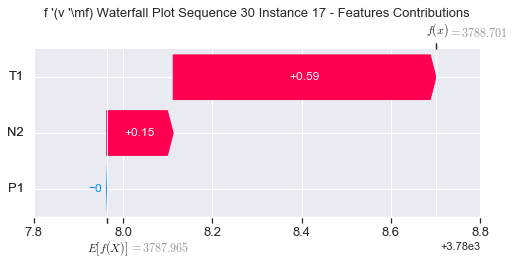

None

Contribution: [-0.00107927  0.01566608  0.15430948]


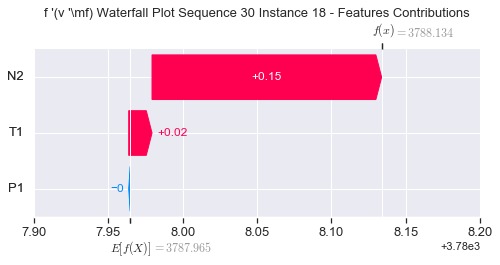

None

Contribution: [-0.02151636 -1.36132849  0.2407305 ]


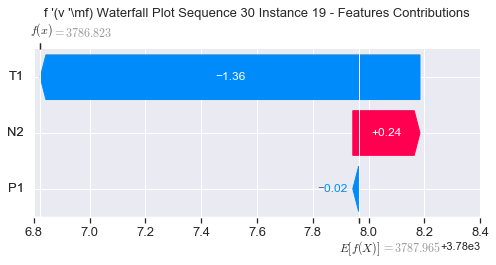

None

Contribution: [-0.02658948 -0.6379333   0.15014672]


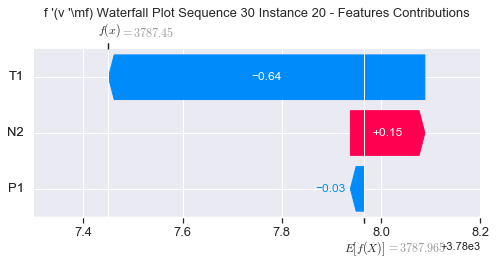

None

Contribution: [ 0.11775672  5.97821434 -0.66102323]


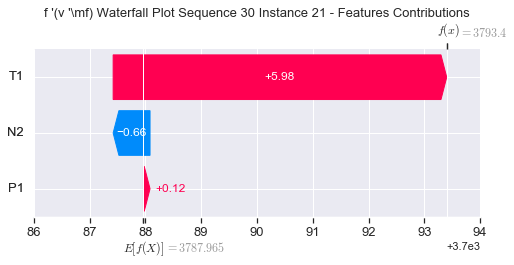

None

Contribution: [ 0.33154768  9.53682944 -1.08964132]


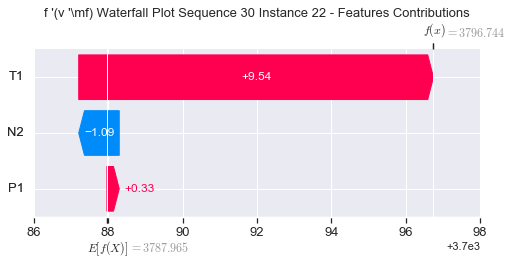

None

Contribution: [-0.13089661 -9.74217352  4.97424858]


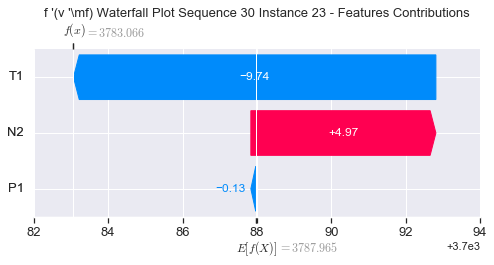

None

Contribution: [ -4.69633421 -34.4399923   16.94740105]


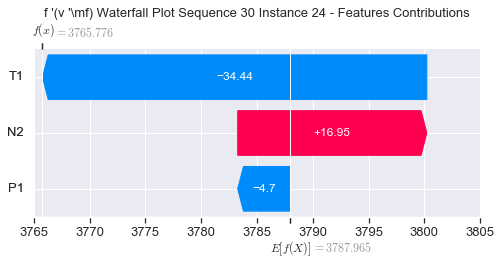

None

Contribution: [19.70052194  6.35030037 41.16663364]


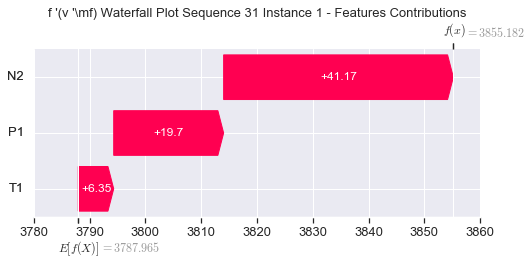

None

Contribution: [ 0.03244764 -0.78321985  0.3319588 ]


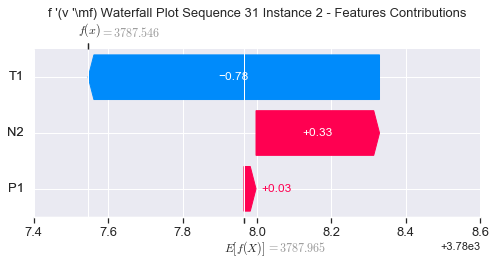

None

Contribution: [-0.04527576  0.04579821  0.15175598]


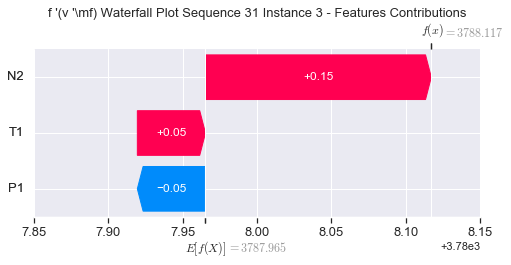

None

Contribution: [-0.09020693  0.05582899  0.31387901]


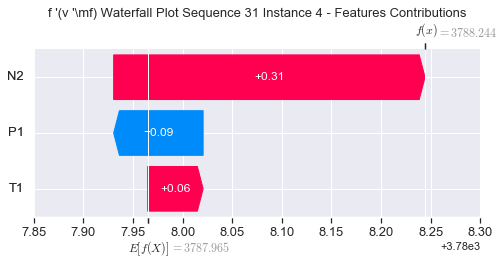

None

Contribution: [-0.08610453  0.01557784  0.24474725]


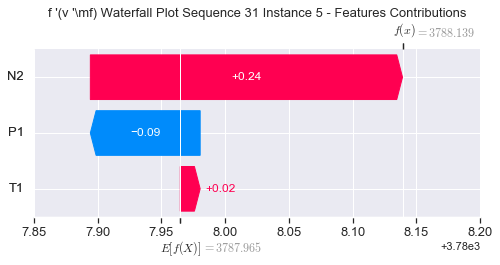

None

Contribution: [-0.02613459  0.18411339  0.19159509]


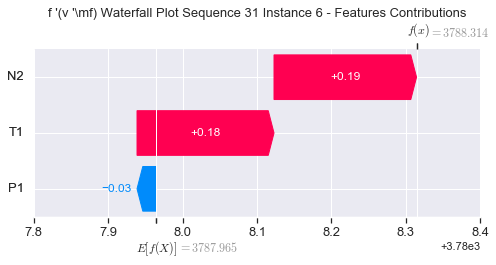

None

Contribution: [-0.0100597   0.20653937  0.21125643]


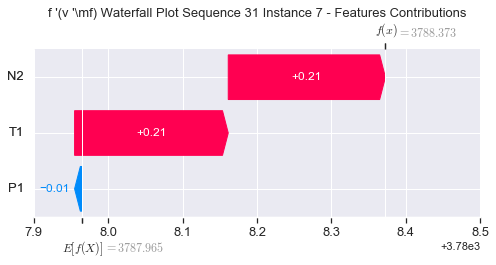

None

Contribution: [3.14363166e-05 2.22744157e-01 2.13353949e-01]


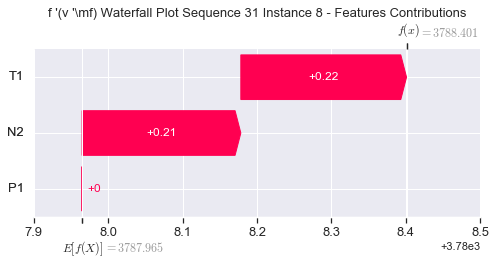

None

Contribution: [0.02650418 0.24392271 0.2056437 ]


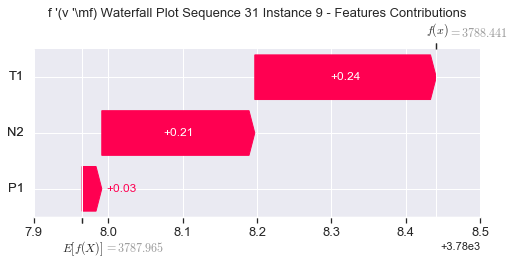

None

Contribution: [-0.01235327  0.22964554  0.19735674]


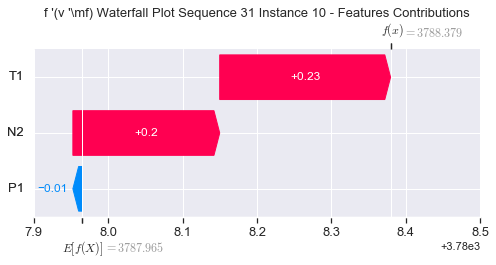

None

Contribution: [0.00829563 0.23265211 0.19842802]


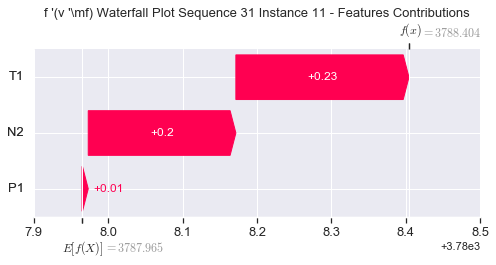

None

Contribution: [-0.01732581  0.20998551  0.19965324]


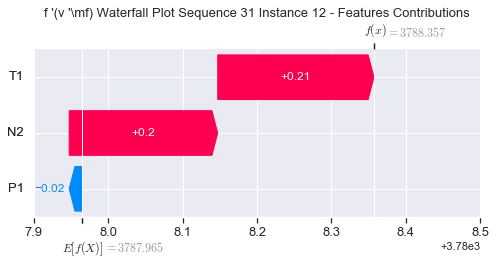

None

Contribution: [-0.00812854  0.1996201   0.19182868]


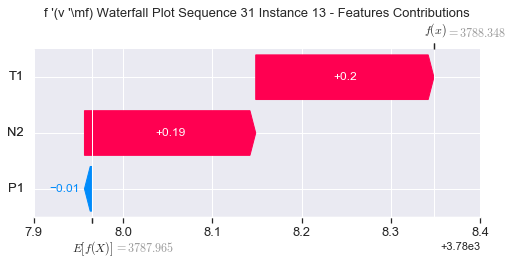

None

Contribution: [-0.01307223  0.17795173  0.18281299]


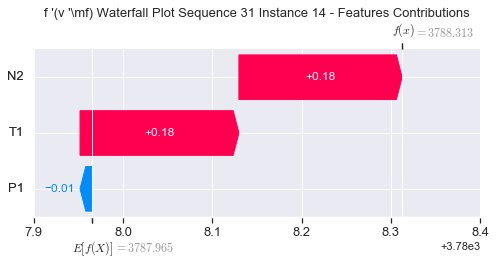

None

Contribution: [-0.01038234  0.15194857  0.17775146]


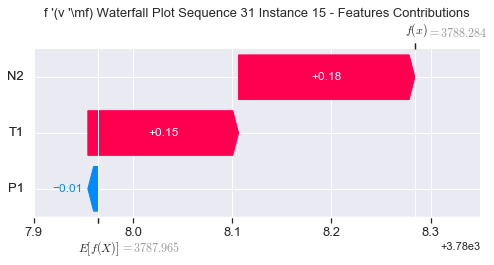

None

Contribution: [-0.00533775  0.29098442  0.15150142]


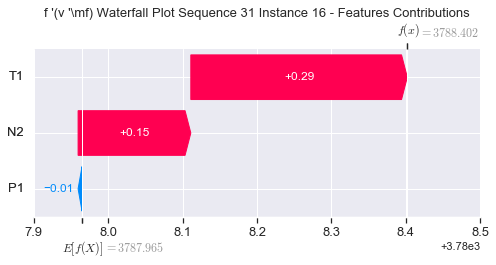

None

Contribution: [0.011361   0.57402499 0.14376463]


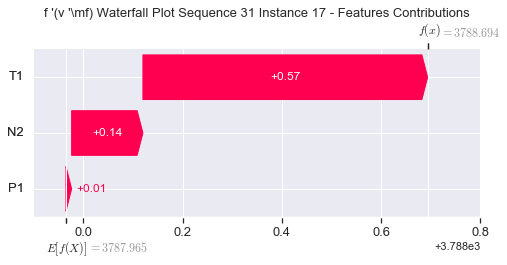

None

Contribution: [0.00924981 0.00934402 0.15752026]


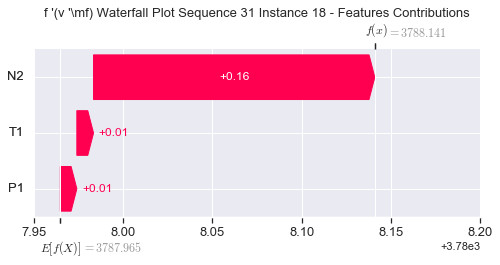

None

Contribution: [ 0.01685671 -1.49951414  0.28783313]


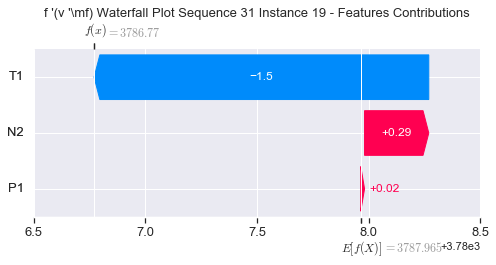

None

Contribution: [-0.09588227 -0.63862797  0.16036882]


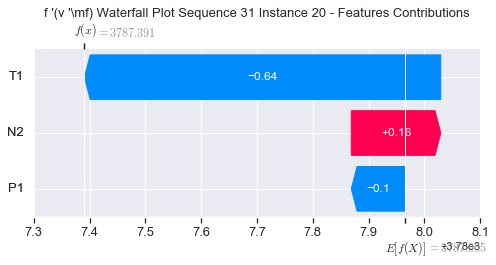

None

Contribution: [ 0.36088695  5.98989528 -0.83102782]


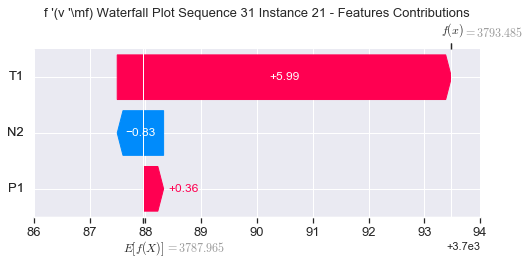

None

Contribution: [ 1.0455393   9.59548103 -1.28849989]


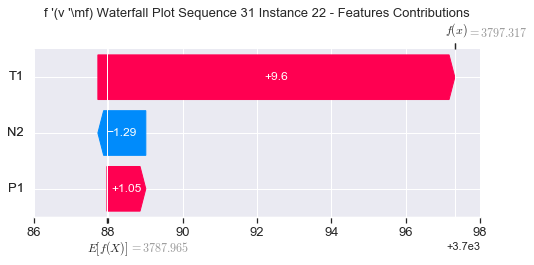

None

Contribution: [-0.28977317 -9.51298371  5.25721532]


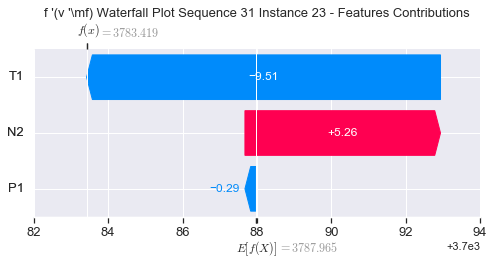

None

Contribution: [ -4.94225951 -38.15090591  17.29657134]


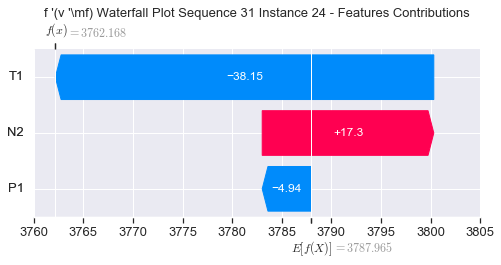

None

Contribution: [ 8.21839809 -2.7824426  38.04873934]


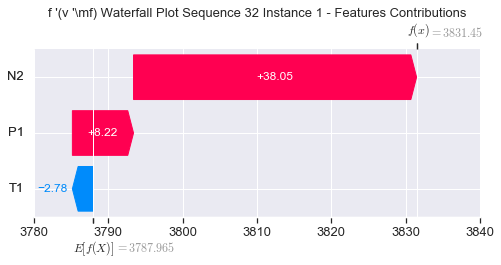

None

Contribution: [ 0.10709355 -0.92231245  0.34694895]


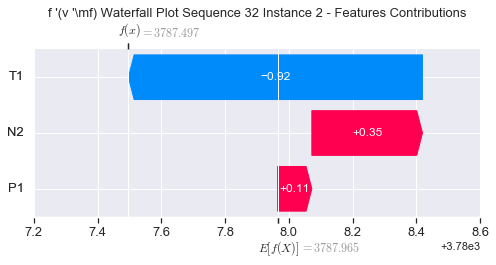

None

Contribution: [-0.04546364  0.01189915  0.14677804]


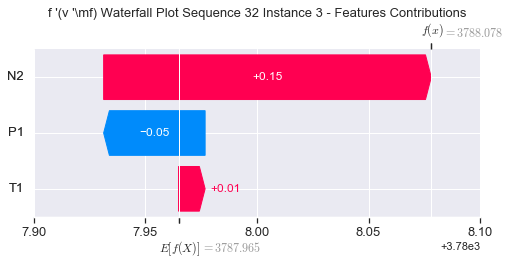

None

Contribution: [-0.09809814  0.04376734  0.31440142]


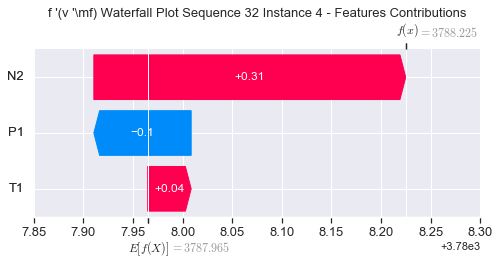

None

Contribution: [-0.09245532  0.0122463   0.24535907]


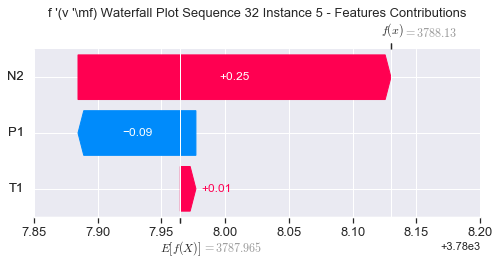

None

Contribution: [-0.01485402  0.18709701  0.18226558]


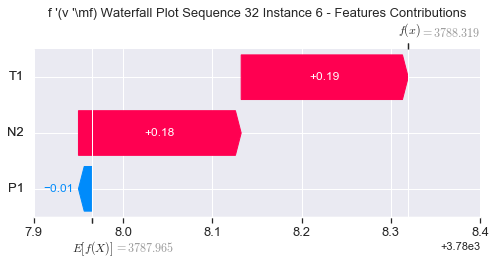

None

Contribution: [0.0079335  0.21198395 0.20425212]


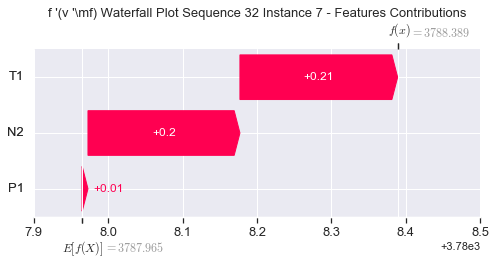

None

Contribution: [0.01435612 0.22429268 0.20873289]


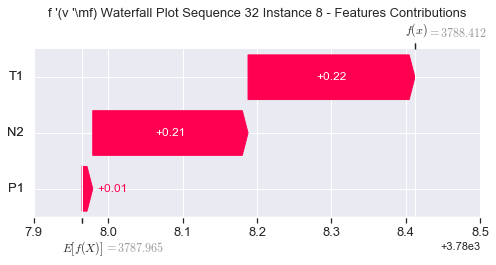

None

Contribution: [-0.02538251  0.23380434  0.20968643]


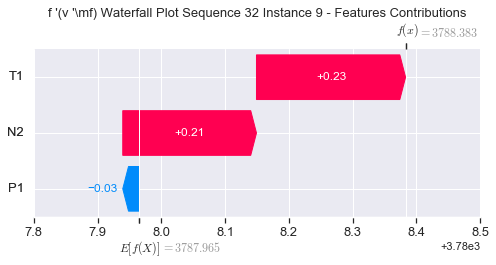

None

Contribution: [-0.06855042  0.24083742  0.20446582]


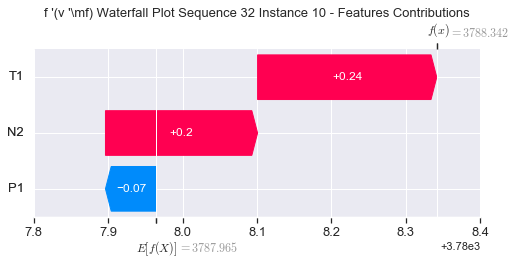

None

Contribution: [-0.02891643  0.24394613  0.19678293]


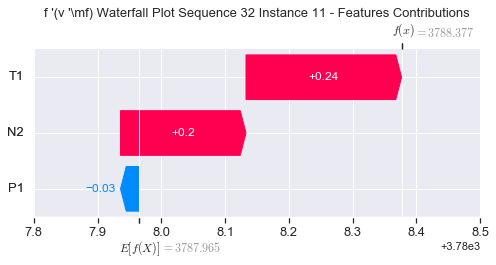

None

Contribution: [0.02780526 0.21503811 0.19069207]


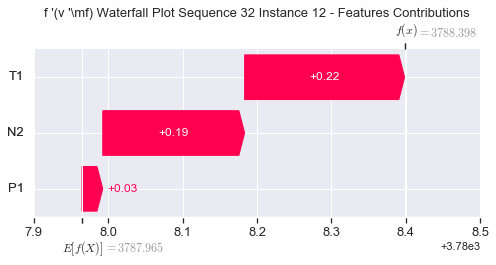

None

Contribution: [0.02539145 0.19922414 0.18534449]


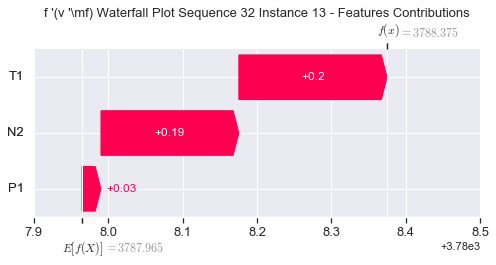

None

Contribution: [0.00053011 0.13576679 0.18159767]


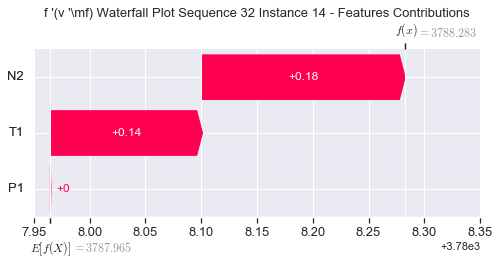

None

Contribution: [0.01064387 0.15629521 0.17306814]


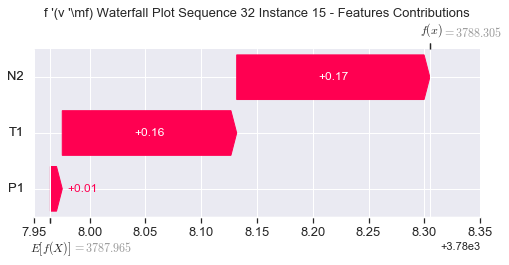

None

Contribution: [-0.02793532  0.36311918  0.14365862]


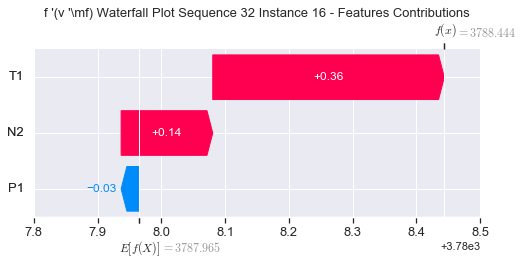

None

Contribution: [0.03569012 0.60590656 0.11440618]


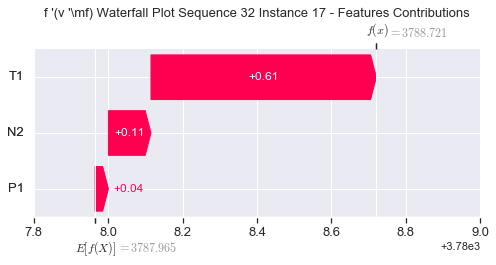

None

Contribution: [0.02465576 0.02209067 0.16675395]


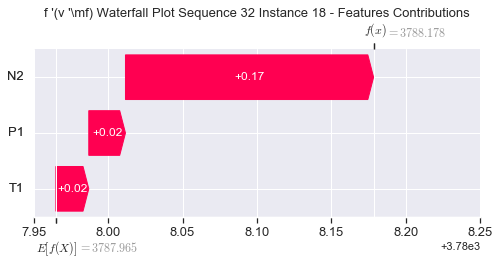

None

Contribution: [ 0.10682618 -1.87597144  0.25524087]


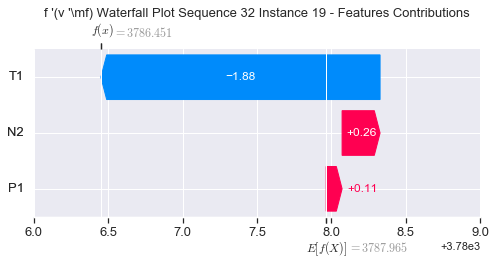

None

Contribution: [-0.05629796 -0.75830555  0.17629262]


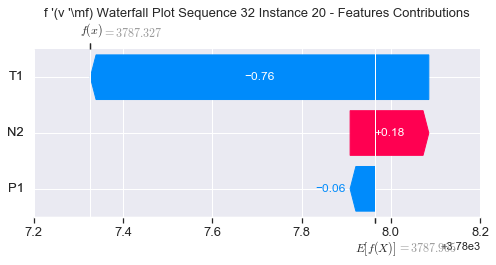

None

Contribution: [ 0.24721007  6.76205114 -1.18317632]


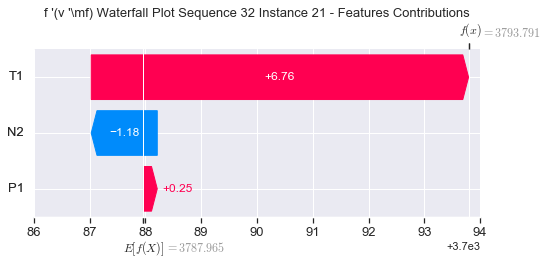

None

Contribution: [ 0.70675687 11.09897767 -1.76526097]


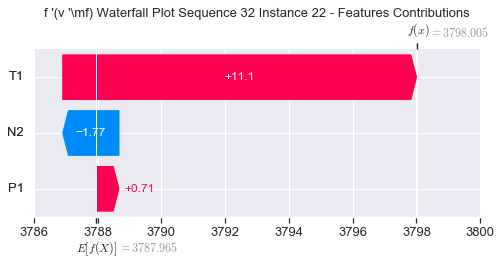

None

Contribution: [ -0.24114781 -11.65703956   6.14356896]


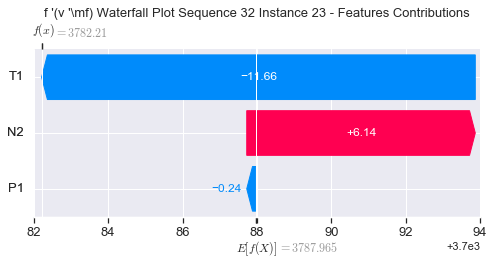

None

Contribution: [ -4.66472278 -44.88431693  19.97524538]


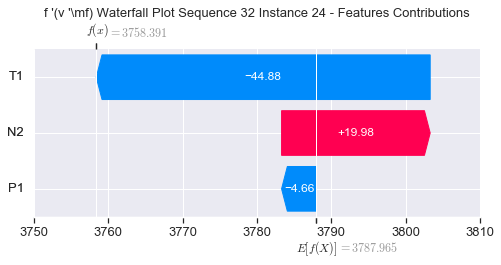

None

Contribution: [13.57655178  0.83765139 45.59663752]


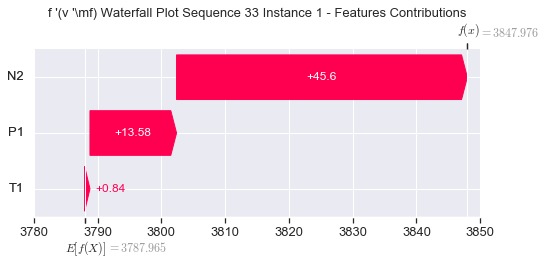

None

Contribution: [ 0.07071516 -1.02162626  0.41512016]


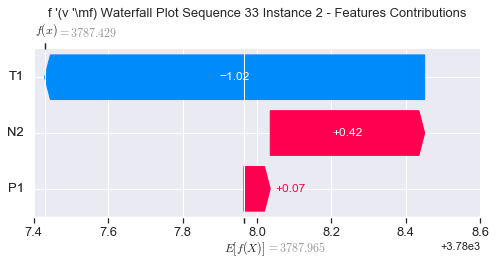

None

Contribution: [-0.04879958  0.01061781  0.15325807]


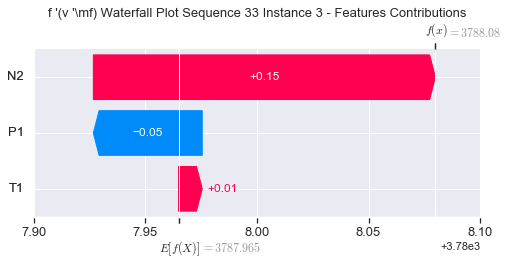

None

Contribution: [-0.10044009  0.05211035  0.32020262]


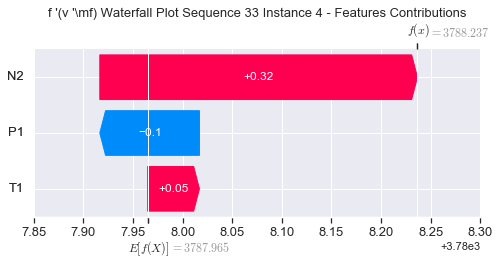

None

Contribution: [-0.07729934 -0.00084357  0.24610282]


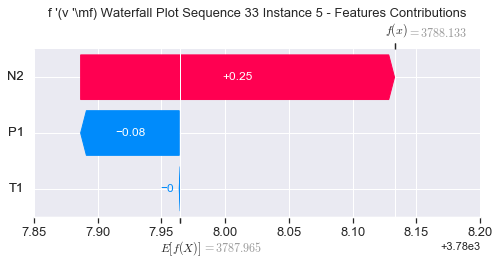

None

Contribution: [-0.02117834  0.20212989  0.18849373]


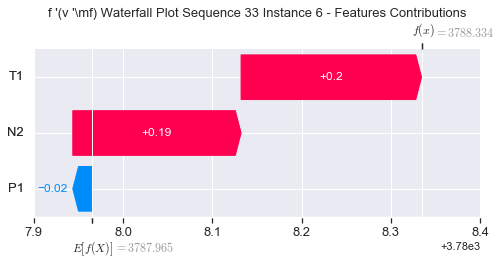

None

Contribution: [-0.0078811   0.23496288  0.2109292 ]


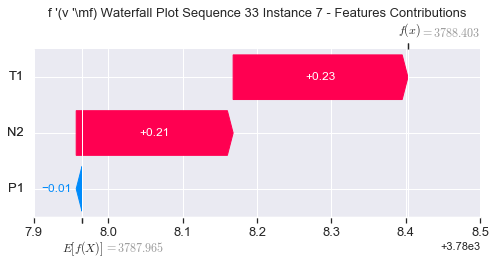

None

Contribution: [-0.00484531  0.25057258  0.21432414]


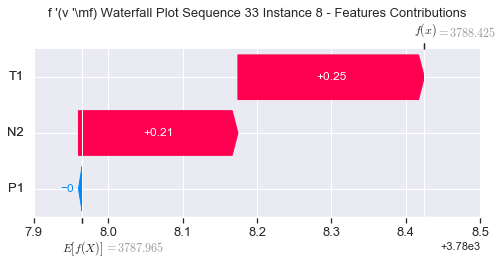

None

Contribution: [-0.06012773  0.28378063  0.21100781]


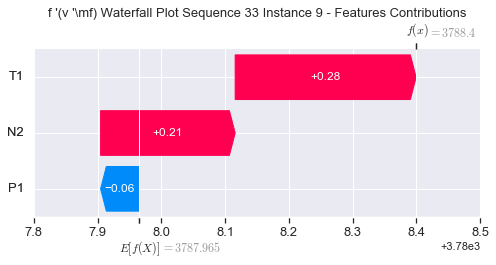

None

Contribution: [-0.06677406  0.27121844  0.20531704]


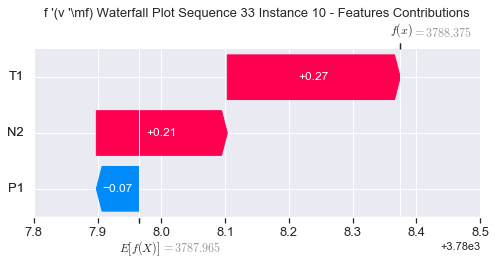

None

Contribution: [-0.03887666  0.27086532  0.19762247]


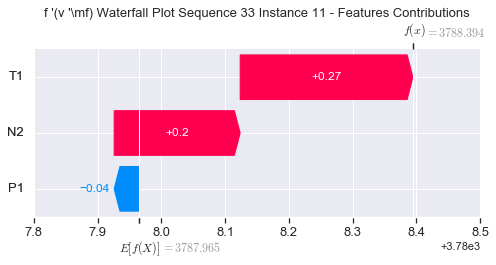

None

Contribution: [0.00280209 0.26132495 0.19844733]


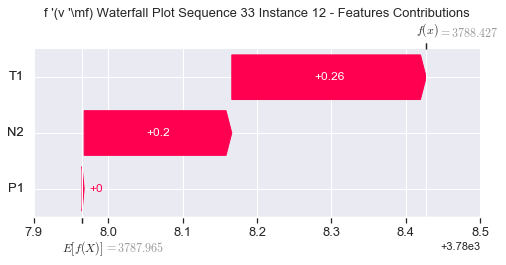

None

Contribution: [-0.00675828  0.24898113  0.1922739 ]


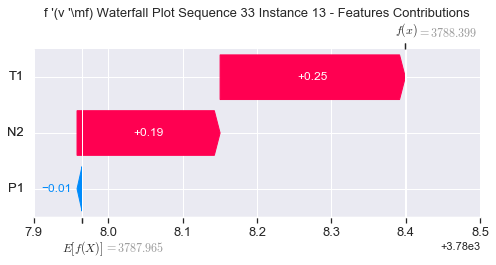

None

Contribution: [-0.01169808  0.20185985  0.18607298]


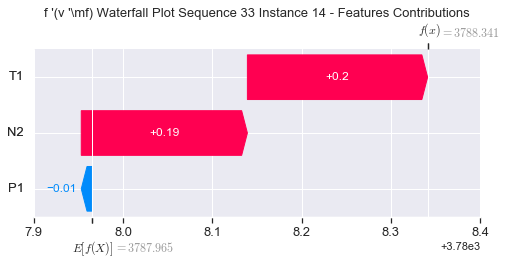

None

Contribution: [-0.00724469  0.18556838  0.17883697]


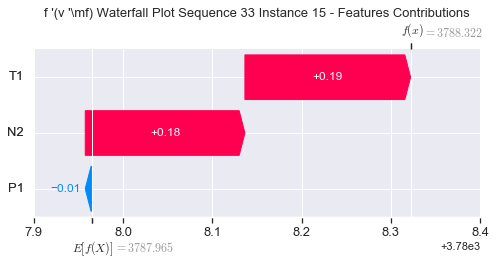

None

Contribution: [-0.04195111  0.39932174  0.16510376]


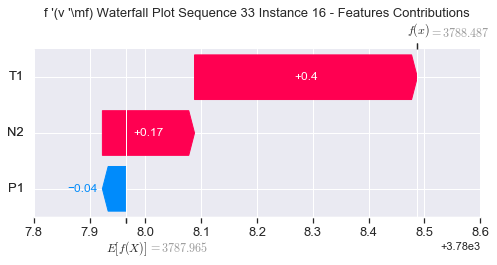

None

Contribution: [-0.01505926  0.7568797   0.14808284]


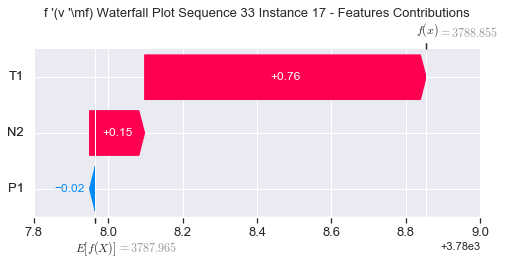

None

Contribution: [-0.00744532  0.03250047  0.15744339]


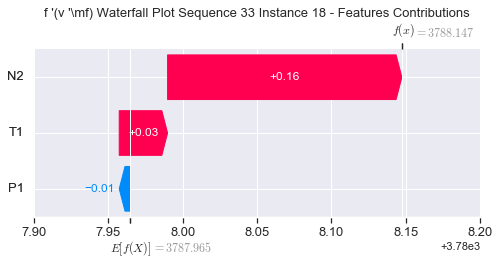

None

Contribution: [ 0.08680963 -1.99031059  0.1905147 ]


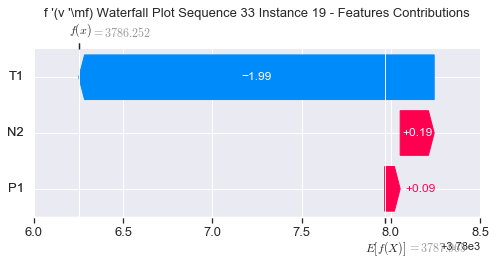

None

Contribution: [ 0.06797253 -0.94253836  0.1486774 ]


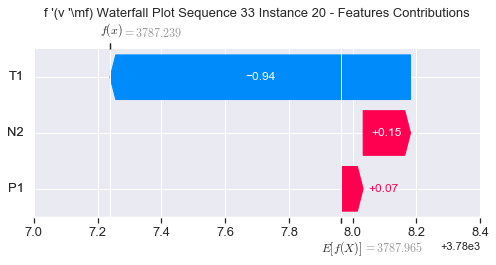

None

Contribution: [-0.15952459  8.38918765 -0.61225489]


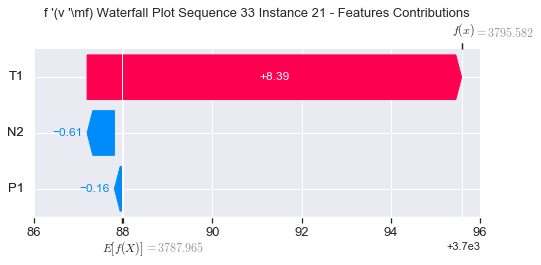

None

Contribution: [-0.38686646 13.83149768 -0.98471143]


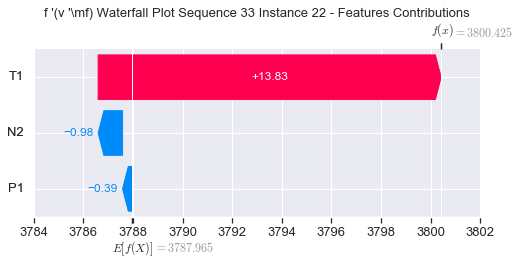

None

Contribution: [ -0.01958398 -14.38287261   4.81532243]


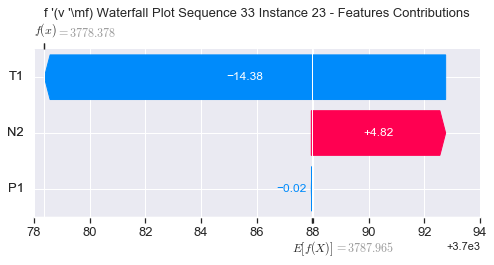

None

Contribution: [ -2.25431532 -53.98231456  16.63176305]


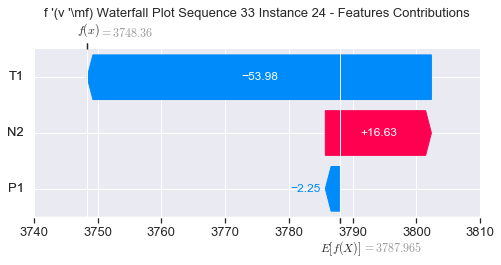

None

Contribution: [13.14969946 -5.39099492 40.78379796]


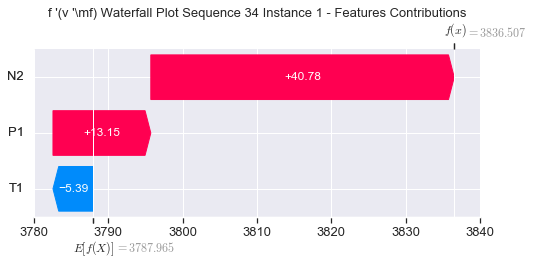

None

Contribution: [-0.04238718 -1.65214607  0.29910429]


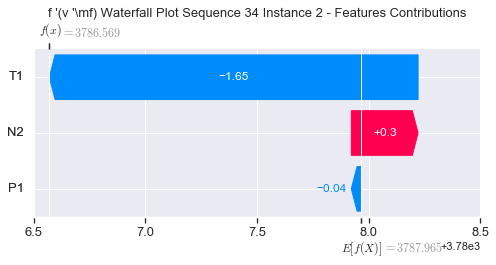

None

Contribution: [-0.04404998 -0.03420201  0.14304126]


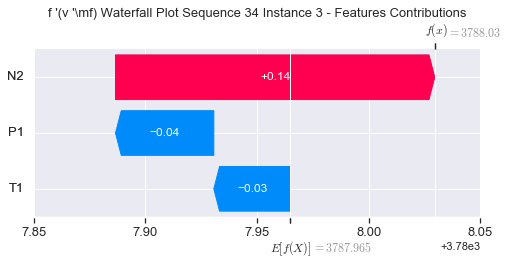

None

Contribution: [-0.08919249  0.01066723  0.31115735]


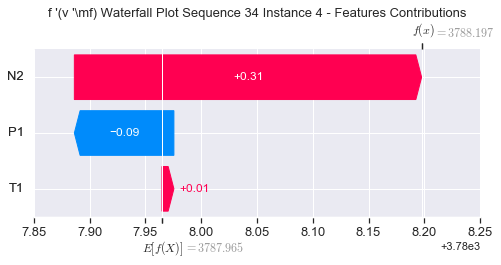

None

Contribution: [-0.07169292 -0.02294184  0.23974857]


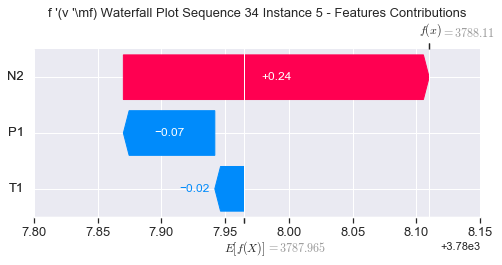

None

Contribution: [-0.03472864  0.23218897  0.2013468 ]


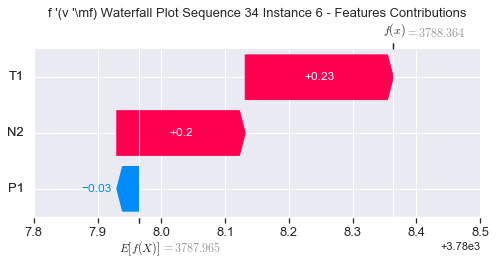

None

Contribution: [-0.02900489  0.26721949  0.22038344]


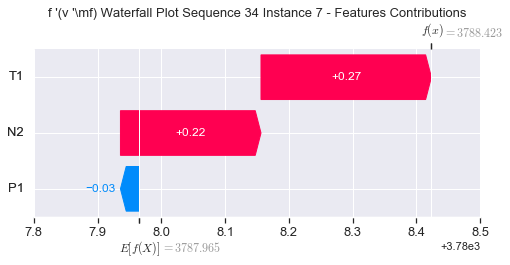

None

Contribution: [-0.03297979  0.28769705  0.22380122]


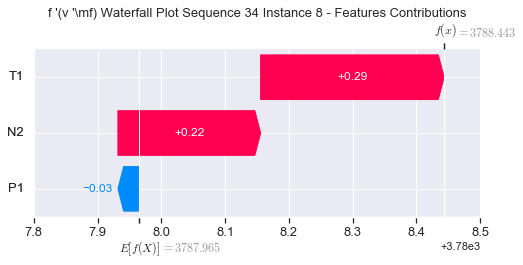

None

Contribution: [-0.07206046  0.32750546  0.21596366]


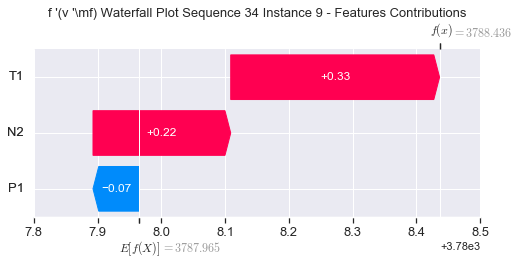

None

Contribution: [-0.11100785  0.35458735  0.20336868]


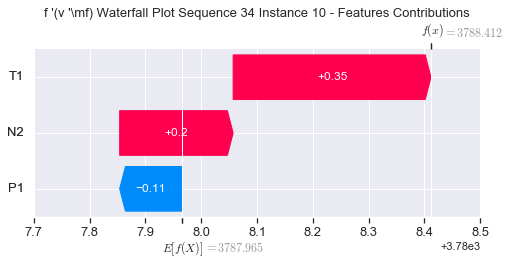

None

Contribution: [-0.11262894  0.3317226   0.20301079]


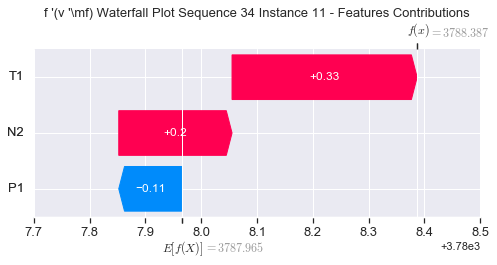

None

Contribution: [-0.08158897  0.27815474  0.20168539]


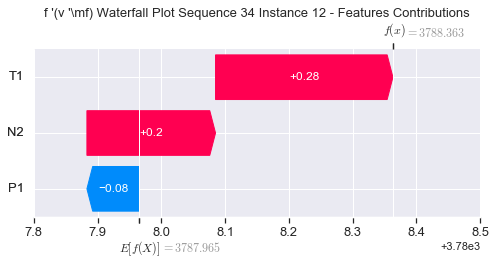

None

Contribution: [-0.07464316  0.26169588  0.19474537]


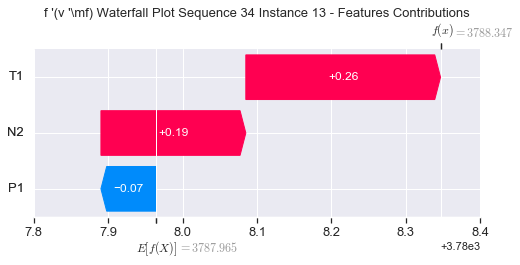

None

Contribution: [-0.1178897   0.21757647  0.18588461]


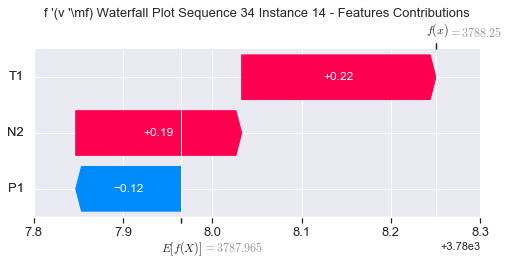

None

Contribution: [-0.05698187  0.19903076  0.17888183]


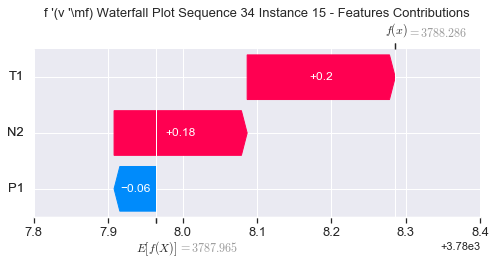

None

Contribution: [-0.04668345  0.48361118  0.15221803]


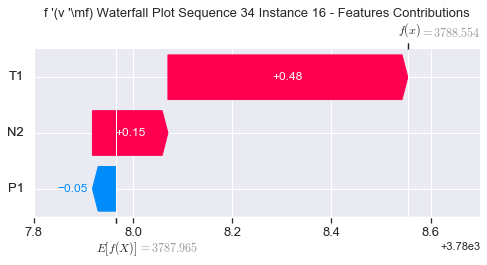

None

Contribution: [-0.09384131  0.78830971  0.14877316]


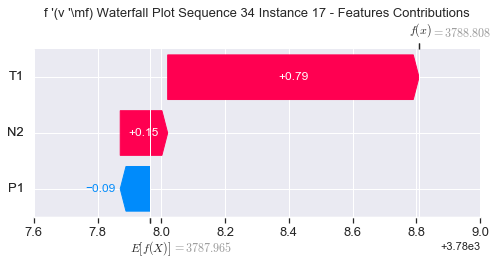

None

Contribution: [-0.06646763  0.04660278  0.15642726]


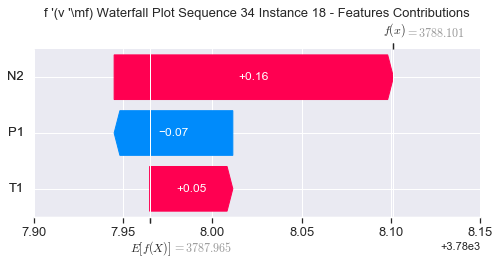

None

Contribution: [ 0.16373173 -2.19759783  0.21315332]


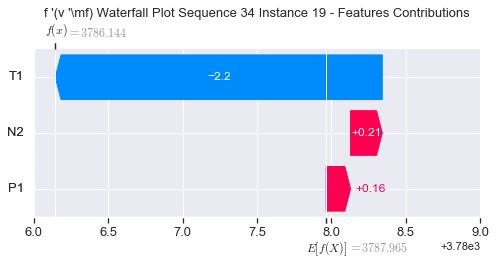

None

Contribution: [ 0.0977842  -1.0054185   0.14869424]


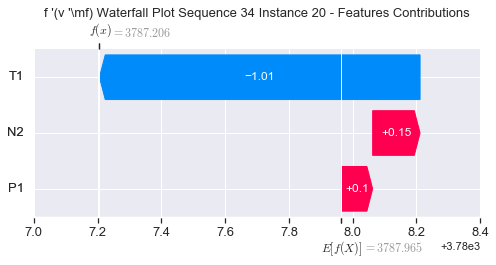

None

Contribution: [-0.29492961  8.68661461 -0.66077779]


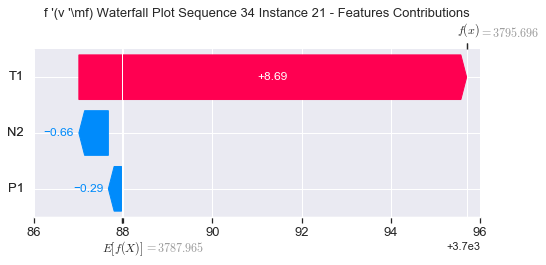

None

Contribution: [-0.85190609 14.32161916 -1.03568502]


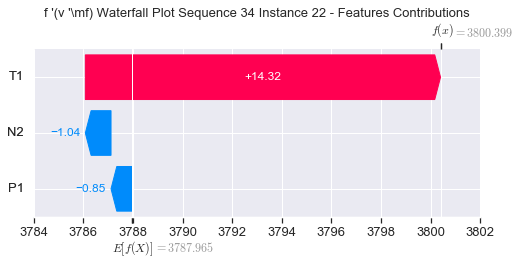

None

Contribution: [  0.20366696 -15.2521189    4.97907303]


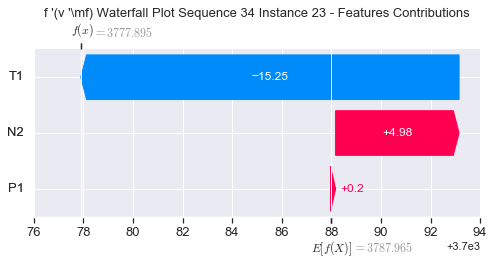

None

Contribution: [ -0.28466438 -59.33597793  16.48950797]


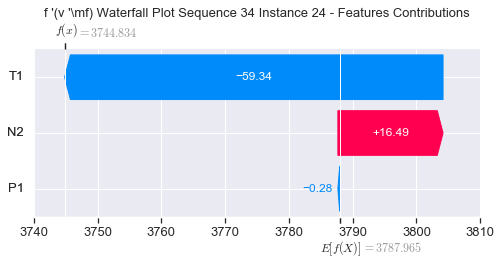

None

In [78]:
#Waterfall Plot for Consistency metric

sns.set()
instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("f '(v '\mf) Waterfall Plot Sequence %s " %(s+1)+"Instance %i - Features Contributions" %(j+1),fontsize=13)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)